In [1]:
from environments import ZeroDCleanupEnv
import numpy as np
import torch
from agents import ZeroDUCoordinator
from tqdm import tqdm

2023-11-29 00:55:43,019	WARNING deprecation.py:50 -- DeprecationWarning: `DirectStepOptimizer` has been deprecated. This will raise an error in the future!


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"cuda available: {torch.cuda.is_available()}")
np.set_printoptions(threshold=np.inf)

cuda available: False


In [3]:
num_agents = 10
reward_multiplier = 10

# for printing options
pp = False
verbose = False
verbose_episode = 200  # start printing at which epoch

In [4]:
thresholdDepletion = 0.4
thresholdRestoration = 0.0
wasteSpawnProbability = 0.5
appleRespawnProbability = 0.05
dirt_multiplier = 10
division_ep = 1e-7

In [5]:
gamma = 0.999
epsilon = 1.0
epsilon_decay = 0.99995
epsilon_min = 0.1
lr = 0.0001
batch_size = 8

In [6]:
num_agents = 10
agent_ids = [str(i) for i in range(num_agents)]

In [7]:
state_dim = 4
action_dim = 2

In [8]:
env = ZeroDCleanupEnv(agent_ids=agent_ids, 
                      num_agents=num_agents, 
                      thresholdDepletion=thresholdDepletion,
                        thresholdRestoration=thresholdRestoration,
                        wasteSpawnProbability=wasteSpawnProbability,
                        appleRespawnProbability=appleRespawnProbability,
                        dirt_multiplier=dirt_multiplier,
                        area=150)

agentCoordinator = ZeroDUCoordinator(device=device,
                          num_action_outputs=num_agents,
                          action_size=action_dim,
                          buffer_size=4000,
                          batch_size=batch_size,
                          lr=lr,
                          gamma=gamma,
                          epsilon=epsilon,
                          epsilon_decay=epsilon_decay,
                          epsilon_min=epsilon_min,
                          u_layers=[
                              (state_dim, 64),
                              (64, 32),
                              (32, 1)
                          ])

In [9]:
ending_ep_rewards = []
num_episodes = 1000
num_steps_per_epsiode = 1000

In [10]:
max_reward = 0
for episode in range(num_episodes):
    print(f"========= Episode {episode} =========")

    states, info = env.reset()
    #states = np.concatenate(list(states.values()), axis=0)
    state = states[agent_ids[0]]
    #num_apples, num_dirt, _, _ = state
    #state = np.array([num_apples, num_dirt])

    print(f"info: {info}")

    for step in tqdm(range(num_steps_per_epsiode)):
        actions_list = agentCoordinator.act(env)[0]
        actions = {agent_id: actions_list[i] for i, agent_id in enumerate(agent_ids)}
        next_states, reward, dones, _, info = env.step(actions)
        #next_states = np.concatenate(list(next_states.values()), axis=0)
        next_state = next_states[agent_ids[0]]
        #num_apples, num_dirt, _, _ = next_state
        #next_state = np.array([num_apples, num_dirt])
        #reward_graph.append(reward)
        agentCoordinator.step(state, reward, next_state)

        if episode > verbose_episode:
            print(f"========= Step {step} =========")
            print(f"info: {info}")

        state = next_state

        if dones["__all__"]:
            break 

    ending_reward = info["total_apple_consumed"]

    

    print(f"ending reward: {ending_reward}")
    #print(f"reward graph: {reward_graph}")
    print(f"========= End of Episode {episode} =========")

    ending_ep_rewards.append(ending_reward)

    agentCoordinator.scheduler.step()

    # if ending_ep_rewards[-1] > 2700 and ending_ep_rewards[-2] > 2700 and agentCoordinator.epsilon < 0.1 and ending_ep_rewards[-1] > max_reward:
    #     break

    if ending_reward > max_reward:
        max_reward = ending_reward

    

#torch.save(agentCoordinator.q_network.state_dict(), "results/q_simple_" + str(test_id) + "/q_network.pt")

        

========= Episode 0 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

100%|█████████▉| 999/1000 [00:00<00:00, 1672.71it/s]


ending reward: 2631.0446840322284
========= End of Episode 0 =========
========= Episode 1 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1632.79it/s]


ending reward: 2623.0690407232614
========= End of Episode 1 =========
========= Episode 2 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 2022.78it/s]


ending reward: 2687.462086654123
========= End of Episode 2 =========
========= Episode 3 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1881.76it/s]


ending reward: 2686.7341236980333
========= End of Episode 3 =========
========= Episode 4 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1994.35it/s]


ending reward: 2677.2742803469996
========= End of Episode 4 =========
========= Episode 5 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1975.48it/s]


ending reward: 2644.1569156273604
========= End of Episode 5 =========
========= Episode 6 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1878.74it/s]


ending reward: 2268.8598141902903
========= End of Episode 6 =========
========= Episode 7 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1968.98it/s]


ending reward: 2162.842593738078
========= End of Episode 7 =========
========= Episode 8 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1944.65it/s]


ending reward: 2242.7044458567075
========= End of Episode 8 =========
========= Episode 9 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1662.30it/s]


ending reward: 2633.4026779124088
========= End of Episode 9 =========
========= Episode 10 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1896.22it/s]


ending reward: 2082.040282071813
========= End of Episode 10 =========
========= Episode 11 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1913.00it/s]


ending reward: 2662.8296859483266
========= End of Episode 11 =========
========= Episode 12 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1806.05it/s]


ending reward: 1991.711913544992
========= End of Episode 12 =========
========= Episode 13 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1882.01it/s]


ending reward: 2427.1964158366536
========= End of Episode 13 =========
========= Episode 14 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1896.50it/s]


ending reward: 2325.213223585212
========= End of Episode 14 =========
========= Episode 15 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1816.64it/s]


ending reward: 2328.3330751130216
========= End of Episode 15 =========
========= Episode 16 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1885.54it/s]


ending reward: 2169.29095502787
========= End of Episode 16 =========
========= Episode 17 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1835.02it/s]


ending reward: 2043.0756313657575
========= End of Episode 17 =========
========= Episode 18 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1799.83it/s]


ending reward: 1646.8637215976855
========= End of Episode 18 =========
========= Episode 19 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1864.96it/s]


ending reward: 1793.0993098776867
========= End of Episode 19 =========
========= Episode 20 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1770.15it/s]


ending reward: 2112.8134657004666
========= End of Episode 20 =========
========= Episode 21 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1753.23it/s]


ending reward: 1654.1142422671135
========= End of Episode 21 =========
========= Episode 22 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1849.12it/s]


ending reward: 1748.4099072684944
========= End of Episode 22 =========
========= Episode 23 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1843.46it/s]


ending reward: 1743.2935611128496
========= End of Episode 23 =========
========= Episode 24 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1764.40it/s]


ending reward: 1899.8577224015758
========= End of Episode 24 =========
========= Episode 25 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1816.29it/s]


ending reward: 1728.7062132641506
========= End of Episode 25 =========
========= Episode 26 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1804.08it/s]


ending reward: 1654.196746222415
========= End of Episode 26 =========
========= Episode 27 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1538.90it/s]


ending reward: 1370.4724792498798
========= End of Episode 27 =========
========= Episode 28 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1682.93it/s]


ending reward: 1021.4377401234353
========= End of Episode 28 =========
========= Episode 29 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1763.03it/s]


ending reward: 1866.2223967086434
========= End of Episode 29 =========
========= Episode 30 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1761.83it/s]


ending reward: 1895.1687013482313
========= End of Episode 30 =========
========= Episode 31 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1811.17it/s]


ending reward: 326.0081490282816
========= End of Episode 31 =========
========= Episode 32 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1700.43it/s]


ending reward: 1257.119343740293
========= End of Episode 32 =========
========= Episode 33 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1758.76it/s]


ending reward: 2307.2242439315487
========= End of Episode 33 =========
========= Episode 34 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1778.68it/s]


ending reward: 636.2533200932909
========= End of Episode 34 =========
========= Episode 35 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1776.57it/s]


ending reward: 2046.4019166501485
========= End of Episode 35 =========
========= Episode 36 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1725.36it/s]


ending reward: 193.98773737387452
========= End of Episode 36 =========
========= Episode 37 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1774.16it/s]


ending reward: 751.3262784461366
========= End of Episode 37 =========
========= Episode 38 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1792.41it/s]


ending reward: 2354.765544690615
========= End of Episode 38 =========
========= Episode 39 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1769.33it/s]


ending reward: 99.98402563806762
========= End of Episode 39 =========
========= Episode 40 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1712.36it/s]


ending reward: 2044.3800167638008
========= End of Episode 40 =========
========= Episode 41 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1740.94it/s]


ending reward: 936.9475305131899
========= End of Episode 41 =========
========= Episode 42 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1712.29it/s]


ending reward: 664.2064111394614
========= End of Episode 42 =========
========= Episode 43 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1761.34it/s]


ending reward: 1444.8553771249747
========= End of Episode 43 =========
========= Episode 44 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1739.67it/s]


ending reward: 94.17948210685336
========= End of Episode 44 =========
========= Episode 45 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1664.13it/s]


ending reward: 1649.2546425267817
========= End of Episode 45 =========
========= Episode 46 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1733.75it/s]


ending reward: 1011.4399553142707
========= End of Episode 46 =========
========= Episode 47 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1739.46it/s]


ending reward: 578.4981496436342
========= End of Episode 47 =========
========= Episode 48 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1600.18it/s]


ending reward: 1411.9588139930088
========= End of Episode 48 =========
========= Episode 49 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1703.42it/s]


ending reward: 651.8050257776925
========= End of Episode 49 =========
========= Episode 50 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1700.63it/s]


ending reward: 2055.4724291252187
========= End of Episode 50 =========
========= Episode 51 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1711.49it/s]


ending reward: 715.54882315537
========= End of Episode 51 =========
========= Episode 52 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1668.54it/s]


ending reward: 949.0850208895132
========= End of Episode 52 =========
========= Episode 53 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1715.29it/s]


ending reward: 1550.9545516254132
========= End of Episode 53 =========
========= Episode 54 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1349.99it/s]


ending reward: 1468.487440374296
========= End of Episode 54 =========
========= Episode 55 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1638.30it/s]


ending reward: 1809.9119655553634
========= End of Episode 55 =========
========= Episode 56 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1492.74it/s]


ending reward: 1740.6840911335328
========= End of Episode 56 =========
========= Episode 57 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1758.01it/s]


ending reward: 1283.7760832178192
========= End of Episode 57 =========
========= Episode 58 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1772.11it/s]


ending reward: 791.7783168623608
========= End of Episode 58 =========
========= Episode 59 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1740.05it/s]


ending reward: 1697.6904205682195
========= End of Episode 59 =========
========= Episode 60 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1703.10it/s]


ending reward: 2011.6138032463293
========= End of Episode 60 =========
========= Episode 61 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1773.70it/s]


ending reward: 2504.966193104753
========= End of Episode 61 =========
========= Episode 62 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1739.65it/s]


ending reward: 2222.8760939569356
========= End of Episode 62 =========
========= Episode 63 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1728.10it/s]


ending reward: 1655.8653411095127
========= End of Episode 63 =========
========= Episode 64 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1681.31it/s]


ending reward: 1312.4912527283052
========= End of Episode 64 =========
========= Episode 65 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1712.11it/s]


ending reward: 1494.4953329923053
========= End of Episode 65 =========
========= Episode 66 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1779.43it/s]


ending reward: 1586.2024211382018
========= End of Episode 66 =========
========= Episode 67 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1760.64it/s]


ending reward: 864.3719854208215
========= End of Episode 67 =========
========= Episode 68 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1703.73it/s]


ending reward: 1023.6944994762889
========= End of Episode 68 =========
========= Episode 69 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1764.10it/s]


ending reward: 1103.6750522548075
========= End of Episode 69 =========
========= Episode 70 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1759.61it/s]


ending reward: 1244.19817040032
========= End of Episode 70 =========
========= Episode 71 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1695.07it/s]


ending reward: 1011.985578666883
========= End of Episode 71 =========
========= Episode 72 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1771.76it/s]


ending reward: 2501.376258902098
========= End of Episode 72 =========
========= Episode 73 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1772.68it/s]


ending reward: 2089.7688063306437
========= End of Episode 73 =========
========= Episode 74 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1711.96it/s]


ending reward: 1162.0558646202264
========= End of Episode 74 =========
========= Episode 75 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1765.57it/s]


ending reward: 2151.1510430253143
========= End of Episode 75 =========
========= Episode 76 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1756.01it/s]


ending reward: 2367.0928410979154
========= End of Episode 76 =========
========= Episode 77 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1738.63it/s]


ending reward: 2181.916752831542
========= End of Episode 77 =========
========= Episode 78 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1764.44it/s]


ending reward: 1966.211519032545
========= End of Episode 78 =========
========= Episode 79 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1655.49it/s]


ending reward: 510.86267811516717
========= End of Episode 79 =========
========= Episode 80 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1711.11it/s]


ending reward: 2225.1195944909114
========= End of Episode 80 =========
========= Episode 81 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1767.97it/s]


ending reward: 1989.3119647250212
========= End of Episode 81 =========
========= Episode 82 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1774.37it/s]


ending reward: 905.6472811912496
========= End of Episode 82 =========
========= Episode 83 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1702.95it/s]


ending reward: 948.2341566322959
========= End of Episode 83 =========
========= Episode 84 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1752.00it/s]


ending reward: 852.6808251041157
========= End of Episode 84 =========
========= Episode 85 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1764.35it/s]


ending reward: 1050.1721363406557
========= End of Episode 85 =========
========= Episode 86 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1718.61it/s]


ending reward: 1182.6156110634272
========= End of Episode 86 =========
========= Episode 87 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1760.60it/s]


ending reward: 1118.919204637516
========= End of Episode 87 =========
========= Episode 88 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1770.00it/s]


ending reward: 1272.3455749084678
========= End of Episode 88 =========
========= Episode 89 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1709.33it/s]


ending reward: 1685.2335985590591
========= End of Episode 89 =========
========= Episode 90 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1766.90it/s]


ending reward: 1743.8395282948486
========= End of Episode 90 =========
========= Episode 91 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1718.43it/s]


ending reward: 1263.744937152043
========= End of Episode 91 =========
========= Episode 92 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1625.17it/s]


ending reward: 1211.3207018554024
========= End of Episode 92 =========
========= Episode 93 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1767.48it/s]


ending reward: 2393.4188552241935
========= End of Episode 93 =========
========= Episode 94 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1770.07it/s]


ending reward: 2416.5039014967306
========= End of Episode 94 =========
========= Episode 95 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1729.98it/s]


ending reward: 2425.2645771024395
========= End of Episode 95 =========
========= Episode 96 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1777.14it/s]


ending reward: 2042.7406096536029
========= End of Episode 96 =========
========= Episode 97 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1771.98it/s]


ending reward: 1595.07871043447
========= End of Episode 97 =========
========= Episode 98 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1695.46it/s]


ending reward: 940.1077809989735
========= End of Episode 98 =========
========= Episode 99 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1758.73it/s]


ending reward: 1600.7427056457875
========= End of Episode 99 =========
========= Episode 100 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1778.30it/s]


ending reward: 1640.7244509820898
========= End of Episode 100 =========
========= Episode 101 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1728.84it/s]


ending reward: 1862.852828583471
========= End of Episode 101 =========
========= Episode 102 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1768.50it/s]


ending reward: 2072.323833515344
========= End of Episode 102 =========
========= Episode 103 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1772.25it/s]


ending reward: 2131.3267372761943
========= End of Episode 103 =========
========= Episode 104 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1720.61it/s]


ending reward: 2156.15857994188
========= End of Episode 104 =========
========= Episode 105 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1774.16it/s]


ending reward: 1678.9250228155793
========= End of Episode 105 =========
========= Episode 106 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1750.21it/s]


ending reward: 2256.8014357866
========= End of Episode 106 =========
========= Episode 107 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1717.37it/s]


ending reward: 610.046784965023
========= End of Episode 107 =========
========= Episode 108 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1787.33it/s]


ending reward: 70.52773667905208
========= End of Episode 108 =========
========= Episode 109 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1788.15it/s]


ending reward: 583.2161488839283
========= End of Episode 109 =========
========= Episode 110 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1724.03it/s]


ending reward: 844.796721670396
========= End of Episode 110 =========
========= Episode 111 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1790.52it/s]


ending reward: 980.0798709049251
========= End of Episode 111 =========
========= Episode 112 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1778.81it/s]


ending reward: 1126.5551821860079
========= End of Episode 112 =========
========= Episode 113 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1782.45it/s]


ending reward: 1370.2796796700509
========= End of Episode 113 =========
========= Episode 114 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1725.01it/s]


ending reward: 1718.847220310951
========= End of Episode 114 =========
========= Episode 115 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1723.04it/s]


ending reward: 1681.5716854121185
========= End of Episode 115 =========
========= Episode 116 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1761.65it/s]


ending reward: 1696.3591116157309
========= End of Episode 116 =========
========= Episode 117 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1796.04it/s]


ending reward: 1946.609569098182
========= End of Episode 117 =========
========= Episode 118 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1714.39it/s]


ending reward: 1919.35590299659
========= End of Episode 118 =========
========= Episode 119 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1759.65it/s]


ending reward: 661.1183843908514
========= End of Episode 119 =========
========= Episode 120 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1761.35it/s]


ending reward: 1191.9668399248835
========= End of Episode 120 =========
========= Episode 121 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1731.28it/s]


ending reward: 1682.6992093143613
========= End of Episode 121 =========
========= Episode 122 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1625.11it/s]


ending reward: 2083.788361731574
========= End of Episode 122 =========
========= Episode 123 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1737.40it/s]


ending reward: 2111.086049325791
========= End of Episode 123 =========
========= Episode 124 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1704.78it/s]


ending reward: 2231.4617833453703
========= End of Episode 124 =========
========= Episode 125 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1613.47it/s]


ending reward: 2247.595526769593
========= End of Episode 125 =========
========= Episode 126 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1691.56it/s]


ending reward: 2301.330161448119
========= End of Episode 126 =========
========= Episode 127 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1652.37it/s]


ending reward: 1799.2164785745858
========= End of Episode 127 =========
========= Episode 128 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1699.38it/s]


ending reward: 734.2339662120165
========= End of Episode 128 =========
========= Episode 129 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1675.79it/s]


ending reward: 1793.4424753291407
========= End of Episode 129 =========
========= Episode 130 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1493.46it/s]


ending reward: 318.192392785481
========= End of Episode 130 =========
========= Episode 131 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1668.68it/s]


ending reward: 2281.0236472526594
========= End of Episode 131 =========
========= Episode 132 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1719.10it/s]


ending reward: 2039.8316346372378
========= End of Episode 132 =========
========= Episode 133 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1661.91it/s]


ending reward: 2098.629946341416
========= End of Episode 133 =========
========= Episode 134 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1716.21it/s]


ending reward: 1858.8116565656403
========= End of Episode 134 =========
========= Episode 135 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1707.74it/s]


ending reward: 1748.5325515543104
========= End of Episode 135 =========
========= Episode 136 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1622.47it/s]


ending reward: 2186.7900031708546
========= End of Episode 136 =========
========= Episode 137 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1752.42it/s]


ending reward: 2159.2819166154827
========= End of Episode 137 =========
========= Episode 138 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1653.36it/s]


ending reward: 1428.016416870625
========= End of Episode 138 =========
========= Episode 139 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1674.44it/s]


ending reward: 1437.247083460681
========= End of Episode 139 =========
========= Episode 140 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1714.10it/s]


ending reward: 1757.0328062372582
========= End of Episode 140 =========
========= Episode 141 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1490.88it/s]


ending reward: 2169.004187042077
========= End of Episode 141 =========
========= Episode 142 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1687.73it/s]


ending reward: 2009.7620133727985
========= End of Episode 142 =========
========= Episode 143 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1727.06it/s]


ending reward: 2199.1398771557883
========= End of Episode 143 =========
========= Episode 144 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1733.73it/s]


ending reward: 2183.7317606374963
========= End of Episode 144 =========
========= Episode 145 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1622.46it/s]


ending reward: 1467.840773154502
========= End of Episode 145 =========
========= Episode 146 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1741.34it/s]


ending reward: 1842.072341899304
========= End of Episode 146 =========
========= Episode 147 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1691.56it/s]


ending reward: 2202.59577106744
========= End of Episode 147 =========
========= Episode 148 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1705.24it/s]


ending reward: 1978.3194341147857
========= End of Episode 148 =========
========= Episode 149 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1740.28it/s]


ending reward: 1882.5425877650791
========= End of Episode 149 =========
========= Episode 150 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1698.08it/s]


ending reward: 1906.7946477724722
========= End of Episode 150 =========
========= Episode 151 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1670.79it/s]


ending reward: 2183.0785541640676
========= End of Episode 151 =========
========= Episode 152 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1709.54it/s]


ending reward: 2138.605245152593
========= End of Episode 152 =========
========= Episode 153 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1724.77it/s]


ending reward: 2461.588487136469
========= End of Episode 153 =========
========= Episode 154 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1747.03it/s]


ending reward: 1802.5457750441142
========= End of Episode 154 =========
========= Episode 155 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1752.02it/s]


ending reward: 1326.9578201990857
========= End of Episode 155 =========
========= Episode 156 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1194.66it/s]


ending reward: 2485.7723678726334
========= End of Episode 156 =========
========= Episode 157 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1642.28it/s]


ending reward: 2075.054301035994
========= End of Episode 157 =========
========= Episode 158 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1480.62it/s]


ending reward: 2034.3037499541313
========= End of Episode 158 =========
========= Episode 159 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1456.20it/s]


ending reward: 2225.8043557325573
========= End of Episode 159 =========
========= Episode 160 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1569.51it/s]


ending reward: 1910.4558829334053
========= End of Episode 160 =========
========= Episode 161 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1502.16it/s]


ending reward: 1624.1735629492339
========= End of Episode 161 =========
========= Episode 162 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1479.02it/s]


ending reward: 2281.86139517936
========= End of Episode 162 =========
========= Episode 163 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1663.58it/s]


ending reward: 2175.9934277926773
========= End of Episode 163 =========
========= Episode 164 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1665.28it/s]


ending reward: 1993.1520948213858
========= End of Episode 164 =========
========= Episode 165 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1617.81it/s]


ending reward: 1969.987027207779
========= End of Episode 165 =========
========= Episode 166 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1680.41it/s]


ending reward: 1879.1397886178877
========= End of Episode 166 =========
========= Episode 167 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1660.01it/s]


ending reward: 2344.2969461786565
========= End of Episode 167 =========
========= Episode 168 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1722.75it/s]


ending reward: 2274.346160630497
========= End of Episode 168 =========
========= Episode 169 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1772.81it/s]


ending reward: 2277.5008167460305
========= End of Episode 169 =========
========= Episode 170 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1739.71it/s]


ending reward: 1850.274817853657
========= End of Episode 170 =========
========= Episode 171 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1701.44it/s]


ending reward: 1902.1138672075765
========= End of Episode 171 =========
========= Episode 172 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1756.40it/s]


ending reward: 2115.554875285614
========= End of Episode 172 =========
========= Episode 173 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1710.87it/s]


ending reward: 2532.790242655305
========= End of Episode 173 =========
========= Episode 174 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1722.09it/s]


ending reward: 2360.9785900099046
========= End of Episode 174 =========
========= Episode 175 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1762.38it/s]


ending reward: 2258.830675597324
========= End of Episode 175 =========
========= Episode 176 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1726.98it/s]


ending reward: 2443.5006212080348
========= End of Episode 176 =========
========= Episode 177 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1730.66it/s]


ending reward: 2076.3433327054267
========= End of Episode 177 =========
========= Episode 178 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1741.02it/s]


ending reward: 1920.5166206850492
========= End of Episode 178 =========
========= Episode 179 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1707.35it/s]


ending reward: 2456.75803015218
========= End of Episode 179 =========
========= Episode 180 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1780.32it/s]


ending reward: 2290.1213516021635
========= End of Episode 180 =========
========= Episode 181 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1523.47it/s]


ending reward: 2409.3818207767363
========= End of Episode 181 =========
========= Episode 182 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1690.56it/s]


ending reward: 2047.5735547456234
========= End of Episode 182 =========
========= Episode 183 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1737.67it/s]


ending reward: 2214.8792592264376
========= End of Episode 183 =========
========= Episode 184 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1777.28it/s]


ending reward: 2136.179855320162
========= End of Episode 184 =========
========= Episode 185 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1733.32it/s]


ending reward: 2316.2523835753436
========= End of Episode 185 =========
========= Episode 186 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1699.01it/s]


ending reward: 2392.09168455546
========= End of Episode 186 =========
========= Episode 187 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1771.56it/s]


ending reward: 2393.2829287517816
========= End of Episode 187 =========
========= Episode 188 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1712.52it/s]


ending reward: 2067.044845313965
========= End of Episode 188 =========
========= Episode 189 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1695.04it/s]


ending reward: 2360.678004148875
========= End of Episode 189 =========
========= Episode 190 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1776.28it/s]


ending reward: 2074.7360070529458
========= End of Episode 190 =========
========= Episode 191 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1655.18it/s]


ending reward: 2465.42724930983
========= End of Episode 191 =========
========= Episode 192 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1773.72it/s]


ending reward: 2525.4562169341543
========= End of Episode 192 =========
========= Episode 193 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1737.96it/s]


ending reward: 2411.3045211772032
========= End of Episode 193 =========
========= Episode 194 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1731.52it/s]


ending reward: 2512.961843598495
========= End of Episode 194 =========
========= Episode 195 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1749.48it/s]


ending reward: 2170.6832144460423
========= End of Episode 195 =========
========= Episode 196 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1743.51it/s]


ending reward: 2296.2626956265544
========= End of Episode 196 =========
========= Episode 197 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1728.04it/s]


ending reward: 2548.053788288669
========= End of Episode 197 =========
========= Episode 198 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1737.98it/s]


ending reward: 2464.0314951765226
========= End of Episode 198 =========
========= Episode 199 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1556.40it/s]


ending reward: 2582.9820455780864
========= End of Episode 199 =========
========= Episode 200 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1741.24it/s]


ending reward: 2471.9522221922284
========= End of Episode 200 =========
========= Episode 201 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


 14%|█▍        | 141/1000 [00:00<00:00, 1402.21it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.0346548148148, 'picker': 2, 'cleaner': 8}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.49595693827160725, 'dirt': 56.532344493827146, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4005167473251072, 'dirt': 53.263521527572, 'picker': 0, 'cleaner': 10}
========= Step 6 ========

 30%|██▉       | 297/1000 [00:00<00:00, 1491.41it/s]

========= Step 296 =========
info: {'total_apple_consumed': 543.9188277608255, 'step_apple_consumed': 5.505081385743171, 'apple': 79.88234568753879, 'dirt': 14.28838980053077, 'picker': 10, 'cleaner': 0}
========= Step 297 =========
info: {'total_apple_consumed': 545.5164746745762, 'step_apple_consumed': 1.5976469137507758, 'apple': 81.06740287719765, 'dirt': 14.121598276505999, 'picker': 3, 'cleaner': 7}
========= Step 298 =========
info: {'total_apple_consumed': 550.9209681997228, 'step_apple_consumed': 5.40449352514651, 'apple': 78.53030945976953, 'dirt': 14.621598276505999, 'picker': 10, 'cleaner': 0}


 63%|██████▎   | 634/1000 [00:00<00:00, 1622.57it/s]

========= Step 299 =========
info: {'total_apple_consumed': 556.1563221637074, 'step_apple_consumed': 5.235353963984635, 'apple': 76.20673627304242, 'dirt': 15.121598276505999, 'picker': 10, 'cleaner': 0}
========= Step 300 =========
info: {'total_apple_consumed': 561.2367712485769, 'step_apple_consumed': 5.080449084869495, 'apple': 74.08078196830294, 'dirt': 15.621598276505999, 'picker': 10, 'cleaner': 0}
========= Step 301 =========
info: {'total_apple_consumed': 566.1754900464638, 'step_apple_consumed': 4.938718797886863, 'apple': 72.13760528675192, 'dirt': 16.121598276506, 'picker': 10, 'cleaner': 0}
========= Step 302 =========
info: {'total_apple_consumed': 570.9846637322472, 'step_apple_consumed': 4.8091736857834615, 'apple': 70.36335438684345, 'dirt': 16.621598276506, 'picker': 10, 'cleaner': 0}
========= Step 303 =========
info: {'total_apple_consumed': 575.6755540247034, 'step_apple_consumed': 4.69089029245623, 'apple': 68.74510088313471, 'dirt': 17.121598276506, 'picker': 10

 97%|█████████▋| 968/1000 [00:00<00:00, 1648.56it/s]

========= Step 635 =========
info: {'total_apple_consumed': 1517.4402079355382, 'step_apple_consumed': 2.9450902111132735, 'apple': 73.52048238481025, 'dirt': 17.925240228624702, 'picker': 6, 'cleaner': 4}
========= Step 636 =========
info: {'total_apple_consumed': 1522.341573427859, 'step_apple_consumed': 4.901365492320683, 'apple': 71.49422547686689, 'dirt': 18.425240228624702, 'picker': 10, 'cleaner': 0}
========= Step 637 =========
info: {'total_apple_consumed': 1527.1078551263167, 'step_apple_consumed': 4.766281698457792, 'apple': 69.63817696240537, 'dirt': 18.925240228624702, 'picker': 10, 'cleaner': 0}
========= Step 638 =========
info: {'total_apple_consumed': 1531.7504002571438, 'step_apple_consumed': 4.642545130827025, 'apple': 67.9393229485269, 'dirt': 19.425240228624702, 'picker': 10, 'cleaner': 0}
========= Step 639 =========
info: {'total_apple_consumed': 1536.2796884537122, 'step_apple_consumed': 4.5292881965684595, 'apple': 66.35170483538315, 'dirt': 19.925240228624702,

100%|█████████▉| 999/1000 [00:00<00:00, 1604.48it/s]


========= Step 973 =========
info: {'total_apple_consumed': 2368.857145908474, 'step_apple_consumed': 2.0329370628097148, 'apple': 101.7228050373837, 'dirt': 10.879083300996456, 'picker': 3, 'cleaner': 7}
========= Step 974 =========
info: {'total_apple_consumed': 2370.891602009222, 'step_apple_consumed': 2.034456100747674, 'apple': 101.79756474489065, 'dirt': 10.871392746949954, 'picker': 3, 'cleaner': 7}
========= Step 975 =========
info: {'total_apple_consumed': 2372.9275533041196, 'step_apple_consumed': 2.0359512948978127, 'apple': 101.87114085386224, 'dirt': 10.864061085425623, 'picker': 3, 'cleaner': 7}
========= Step 976 =========
info: {'total_apple_consumed': 2374.9649761211967, 'step_apple_consumed': 2.037422817077245, 'apple': 101.9435424951405, 'dirt': 10.857071568105761, 'picker': 3, 'cleaner': 7}
========= Step 977 =========
info: {'total_apple_consumed': 2379.7223414376367, 'step_apple_consumed': 4.75736531643989, 'apple': 99.36624693099444, 'dirt': 11.139930136743645, '

 12%|█▏        | 117/1000 [00:00<00:00, 1162.10it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.92

 24%|██▍       | 240/1000 [00:00<00:00, 1200.56it/s]

========= Step 212 =========
info: {'total_apple_consumed': 402.23638549112457, 'step_apple_consumed': 3.4883623434696696, 'apple': 103.16527191636357, 'dirt': 11.452719451187768, 'picker': 5, 'cleaner': 5}
========= Step 213 =========
info: {'total_apple_consumed': 403.6119224500094, 'step_apple_consumed': 1.3755369588848476, 'apple': 103.79702372447113, 'dirt': 11.34190774712442, 'picker': 2, 'cleaner': 8}
========= Step 214 =========
info: {'total_apple_consumed': 407.7638033989882, 'step_apple_consumed': 4.151880948978845, 'apple': 101.72596585835291, 'dirt': 11.539456873867769, 'picker': 6, 'cleaner': 4}
========= Step 215 =========
info: {'total_apple_consumed': 409.1201496104329, 'step_apple_consumed': 1.3563462114447054, 'apple': 102.41445218132786, 'dirt': 11.424019173928155, 'picker': 2, 'cleaner': 8}
========= Step 216 =========
info: {'total_apple_consumed': 410.4856756395173, 'step_apple_consumed': 1.3655260290843714, 'apple': 103.05732434439798, 'dirt': 11.314738151318654

 36%|███▌      | 361/1000 [00:00<00:00, 1093.68it/s]

========= Step 240 =========
info: {'total_apple_consumed': 490.6916967092609, 'step_apple_consumed': 5.26318655766222, 'apple': 76.60920331324965, 'dirt': 14.921950556177839, 'picker': 10, 'cleaner': 0}
========= Step 241 =========
info: {'total_apple_consumed': 495.7989769301442, 'step_apple_consumed': 5.10728022088331, 'apple': 74.46956134741797, 'dirt': 15.421950556177839, 'picker': 10, 'cleaner': 0}
========= Step 242 =========
info: {'total_apple_consumed': 498.7777593840409, 'step_apple_consumed': 2.9787824538967187, 'apple': 74.45257457288261, 'dirt': 15.51069854134643, 'picker': 6, 'cleaner': 4}
========= Step 243 =========
info: {'total_apple_consumed': 503.7412643555664, 'step_apple_consumed': 4.9635049715255075, 'apple': 72.49209744981621, 'dirt': 16.01069854134643, 'picker': 10, 'cleaner': 0}
========= Step 244 =========
info: {'total_apple_consumed': 505.67438695422817, 'step_apple_consumed': 1.9331225986617657, 'apple': 73.53429014450828, 'dirt': 15.87027059969257, 'pick

 68%|██████▊   | 681/1000 [00:00<00:00, 1397.83it/s]

========= Step 483 =========
info: {'total_apple_consumed': 1139.2241547893068, 'step_apple_consumed': 2.9959811900987794, 'apple': 74.76044576373006, 'dirt': 17.104093143908653, 'picker': 6, 'cleaner': 4}
========= Step 484 =========
info: {'total_apple_consumed': 1142.214572619856, 'step_apple_consumed': 2.9904178305492026, 'apple': 74.62403565361507, 'dirt': 17.147983993404424, 'picker': 6, 'cleaner': 4}
========= Step 485 =========
info: {'total_apple_consumed': 1145.1995340460005, 'step_apple_consumed': 2.9849614261446025, 'apple': 74.4902695198042, 'dirt': 17.190704420246973, 'picker': 6, 'cleaner': 4}
========= Step 486 =========
info: {'total_apple_consumed': 1150.1655520139875, 'step_apple_consumed': 4.9660179679869465, 'apple': 72.41387900345059, 'dirt': 17.690704420246973, 'picker': 10, 'cleaner': 0}
========= Step 487 =========
info: {'total_apple_consumed': 1154.9931439475508, 'step_apple_consumed': 4.827591933563372, 'apple': 70.51268001415347, 'dirt': 18.190704420246973,

100%|█████████▉| 999/1000 [00:00<00:00, 1371.12it/s]


========= Step 822 =========
info: {'total_apple_consumed': 2039.1267838328445, 'step_apple_consumed': 3.0004030027963617, 'apple': 64.14229137705145, 'dirt': 22.095357484146884, 'picker': 7, 'cleaner': 3}
========= Step 823 =========
info: {'total_apple_consumed': 2041.6924754879265, 'step_apple_consumed': 2.565691655082058, 'apple': 64.43156041558603, 'dirt': 22.0061479512363, 'picker': 6, 'cleaner': 4}
========= Step 824 =========
info: {'total_apple_consumed': 2044.699281640654, 'step_apple_consumed': 3.006806152727348, 'apple': 64.27527407593632, 'dirt': 22.066024992211574, 'picker': 7, 'cleaner': 3}
========= Step 825 =========
info: {'total_apple_consumed': 2047.2702926036914, 'step_apple_consumed': 2.571010963037453, 'apple': 64.56134128651667, 'dirt': 21.97759765908593, 'picker': 6, 'cleaner': 4}
========= Step 826 =========
info: {'total_apple_consumed': 2048.561519429422, 'step_apple_consumed': 1.2912268257303332, 'apple': 66.10109616924917, 'dirt': 21.451976434995252, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.84, 'picker': 2, 'cleaner': 8}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.91733333333333, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.32284444444444, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.034654814814814, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.49595693827160564, 'dirt': 56.53234449382716, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4005167473251041, 'dirt': 53.26352152757202, 'picker': 0, 'cleaner': 10}
========= Step 6 ====

 33%|███▎      | 326/1000 [00:00<00:00, 1629.90it/s]

========= Step 124 =========
info: {'total_apple_consumed': 289.24079074472604, 'step_apple_consumed': 2.9027970928984104, 'apple': 42.934463220640694, 'dirt': 35.46032087204057, 'picker': 10, 'cleaner': 0}
========= Step 125 =========
info: {'total_apple_consumed': 292.10308829276875, 'step_apple_consumed': 2.862297548042713, 'apple': 42.3216362593276, 'dirt': 35.96032087204057, 'picker': 10, 'cleaner': 0}
========= Step 126 =========
info: {'total_apple_consumed': 294.92453071005724, 'step_apple_consumed': 2.821442417288506, 'apple': 41.72386416137534, 'dirt': 36.46032087204057, 'picker': 10, 'cleaner': 0}
========= Step 127 =========
info: {'total_apple_consumed': 297.70612165414894, 'step_apple_consumed': 2.7815909440916893, 'apple': 41.139309935893195, 'dirt': 36.96032087204057, 'picker': 10, 'cleaner': 0}
========= Step 128 =========
info: {'total_apple_consumed': 300.4487423165418, 'step_apple_consumed': 2.7426206623928797, 'apple': 40.54705932544319, 'dirt': 37.46032087204057, 

 49%|████▉     | 489/1000 [00:00<00:00, 1551.39it/s]

========= Step 451 =========
info: {'total_apple_consumed': 625.0535320286298, 'step_apple_consumed': 1.0447551848440797, 'apple': 17.35823883263499, 'dirt': 51.6306781784083, 'picker': 9, 'cleaner': 1}
========= Step 452 =========
info: {'total_apple_consumed': 626.0950263585879, 'step_apple_consumed': 1.0414943299580992, 'apple': 17.289754944287445, 'dirt': 51.78647365721891, 'picker': 9, 'cleaner': 1}
========= Step 453 =========
info: {'total_apple_consumed': 627.0171466222832, 'step_apple_consumed': 0.9221202636953304, 'apple': 17.361916094092308, 'dirt': 51.595987341789325, 'picker': 8, 'cleaner': 2}
========= Step 454 =========
info: {'total_apple_consumed': 628.0588615879287, 'step_apple_consumed': 1.0417149656455384, 'apple': 17.29705955474585, 'dirt': 51.752014092844064, 'picker': 9, 'cleaner': 1}
========= Step 455 =========
info: {'total_apple_consumed': 629.0966851612135, 'step_apple_consumed': 1.037823573284751, 'apple': 17.218787573807074, 'dirt': 51.907000665558435, 'pi

 64%|██████▍   | 645/1000 [00:00<00:00, 1501.57it/s]

========= Step 618 =========
info: {'total_apple_consumed': 788.639114788434, 'step_apple_consumed': 4.164130766756033, 'apple': 76.77564687981203, 'dirt': 15.892325664014049, 'picker': 8, 'cleaner': 2}
========= Step 619 =========
info: {'total_apple_consumed': 792.2219783094919, 'step_apple_consumed': 3.5828635210578947, 'apple': 76.04342094658206, 'dirt': 16.074479150733765, 'picker': 7, 'cleaner': 3}
========= Step 620 =========
info: {'total_apple_consumed': 797.2915397059306, 'step_apple_consumed': 5.069561396438804, 'apple': 73.902227606761, 'dirt': 16.574479150733765, 'picker': 10, 'cleaner': 0}
========= Step 621 =========
info: {'total_apple_consumed': 802.2183548797148, 'step_apple_consumed': 4.926815173784067, 'apple': 71.94282302434347, 'dirt': 17.074479150733765, 'picker': 10, 'cleaner': 0}
========= Step 622 =========
info: {'total_apple_consumed': 807.0145430813377, 'step_apple_consumed': 4.796188201622898, 'apple': 70.11565001479482, 'dirt': 17.574479150733765, 'picker

 80%|███████▉  | 796/1000 [00:00<00:00, 1349.96it/s]

========= Step 720 =========
info: {'total_apple_consumed': 1091.885269684527, 'step_apple_consumed': 3.036166250331856, 'apple': 64.88956167400684, 'dirt': 21.431510544300448, 'picker': 7, 'cleaner': 3}
========= Step 721 =========
info: {'total_apple_consumed': 1091.885269684527, 'step_apple_consumed': 0.0, 'apple': 67.75603174648808, 'dirt': 20.50274317468042, 'picker': 0, 'cleaner': 10}
========= Step 722 =========
info: {'total_apple_consumed': 1091.885269684527, 'step_apple_consumed': 0.0, 'apple': 70.58246577043371, 'dirt': 19.635893629701723, 'picker': 0, 'cleaner': 10}
========= Step 723 =========
info: {'total_apple_consumed': 1092.3558194563298, 'step_apple_consumed': 0.4705497718028914, 'apple': 72.88139999783618, 'dirt': 18.95774001191962, 'picker': 1, 'cleaner': 9}
========= Step 724 =========
info: {'total_apple_consumed': 1093.3275714563008, 'step_apple_consumed': 0.9717519999711491, 'apple': 74.67815951201106, 'dirt': 18.446660544617238, 'picker': 2, 'cleaner': 8}
====

 96%|█████████▌| 961/1000 [00:00<00:00, 1439.27it/s]

========= Step 880 =========
info: {'total_apple_consumed': 1549.4748369670706, 'step_apple_consumed': 2.0738876328873923, 'apple': 38.89940004047786, 'dirt': 38.522162560772145, 'picker': 8, 'cleaner': 2}
========= Step 881 =========
info: {'total_apple_consumed': 1551.549471635896, 'step_apple_consumed': 2.0746346688254858, 'apple': 38.91395466762266, 'dirt': 38.508533726628514, 'picker': 8, 'cleaner': 2}
========= Step 882 =========
info: {'total_apple_consumed': 1553.6248825515027, 'step_apple_consumed': 2.075410915606542, 'apple': 38.929010524040145, 'dirt': 38.49508661027347, 'picker': 8, 'cleaner': 2}
========= Step 883 =========
info: {'total_apple_consumed': 1555.701096446118, 'step_apple_consumed': 2.0762138946154742, 'apple': 38.94452384448837, 'dirt': 38.48181878880315, 'picker': 8, 'cleaner': 2}
========= Step 884 =========
info: {'total_apple_consumed': 1557.7781377178242, 'step_apple_consumed': 2.0770412717060465, 'apple': 38.96045342497851, 'dirt': 38.46872787161911, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1470.12it/s]


========= Step 992 =========
info: {'total_apple_consumed': 1767.970829733308, 'step_apple_consumed': 1.3694878906235044, 'apple': 19.942335190044098, 'dirt': 53.45110178948061, 'picker': 10, 'cleaner': 0}
========= Step 993 =========
info: {'total_apple_consumed': 1769.3003187459776, 'step_apple_consumed': 1.3294890126696066, 'apple': 19.33322498053162, 'dirt': 53.95110178948061, 'picker': 10, 'cleaner': 0}
========= Step 994 =========
info: {'total_apple_consumed': 1770.5892004113464, 'step_apple_consumed': 1.288881665368775, 'apple': 18.70972211831998, 'dirt': 54.45110178948061, 'picker': 10, 'cleaner': 0}
========= Step 995 =========
info: {'total_apple_consumed': 1771.8365152192343, 'step_apple_consumed': 1.2473148078879985, 'apple': 18.077410195431213, 'dirt': 54.95110178948061, 'picker': 10, 'cleaner': 0}
========= Step 996 =========
info: {'total_apple_consumed': 1773.0416758989297, 'step_apple_consumed': 1.2051606796954142, 'apple': 17.436043149243798, 'dirt': 55.4511017894806

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_con

 16%|█▌        | 158/1000 [00:00<00:00, 1575.62it/s]

========= Step 21 =========
info: {'total_apple_consumed': 7.970057765723413, 'step_apple_consumed': 1.2448669333490574, 'apple': 24.428049684295686, 'dirt': 38.64067233734449, 'picker': 8, 'cleaner': 2}
========= Step 22 =========
info: {'total_apple_consumed': 9.598594411343125, 'step_apple_consumed': 1.6285366456197123, 'apple': 25.077841322692564, 'dirt': 39.14067233734449, 'picker': 10, 'cleaner': 0}
========= Step 23 =========
info: {'total_apple_consumed': 11.27045049952263, 'step_apple_consumed': 1.6718560881795042, 'apple': 25.613597412144102, 'dirt': 39.64067233734449, 'picker': 10, 'cleaner': 0}
========= Step 24 =========
info: {'total_apple_consumed': 12.978023660332237, 'step_apple_consumed': 1.7075731608096065, 'apple': 26.060719762298874, 'dirt': 40.14067233734449, 'picker': 10, 'cleaner': 0}
========= Step 25 =========
info: {'total_apple_consumed': 14.715404977818828, 'step_apple_consumed': 1.7373813174865915, 'apple': 26.408567849391112, 'dirt': 40.64067233734449, 'p

 48%|████▊     | 475/1000 [00:00<00:00, 1423.38it/s]

========= Step 297 =========
info: {'total_apple_consumed': 630.4000958669701, 'step_apple_consumed': 6.47636229564389, 'apple': 93.05603486916984, 'dirt': 12.760745396892169, 'picker': 10, 'cleaner': 0}
========= Step 298 =========
info: {'total_apple_consumed': 632.881590130148, 'step_apple_consumed': 2.4814942631778623, 'apple': 92.96202482694115, 'dirt': 12.750315581016482, 'picker': 4, 'cleaner': 6}
========= Step 299 =========
info: {'total_apple_consumed': 639.0790584519441, 'step_apple_consumed': 6.197468321796077, 'apple': 89.28453967415751, 'dirt': 13.250315581016482, 'picker': 10, 'cleaner': 0}
========= Step 300 =========
info: {'total_apple_consumed': 645.031361096888, 'step_apple_consumed': 5.952302644943834, 'apple': 85.94242774260694, 'dirt': 13.750315581016482, 'picker': 10, 'cleaner': 0}
========= Step 301 =========
info: {'total_apple_consumed': 650.7608562797284, 'step_apple_consumed': 5.729495182840463, 'apple': 82.91083081754051, 'dirt': 14.250315581016482, 'picke

 62%|██████▏   | 621/1000 [00:00<00:00, 1377.31it/s]

========= Step 579 =========
info: {'total_apple_consumed': 1363.541511254823, 'step_apple_consumed': 2.075717850666406, 'apple': 103.7283975434672, 'dirt': 11.074134020898434, 'picker': 3, 'cleaner': 7}
========= Step 580 =========
info: {'total_apple_consumed': 1365.6160792056924, 'step_apple_consumed': 2.074567950869344, 'apple': 103.67273816435099, 'dirt': 11.057341099923175, 'picker': 3, 'cleaner': 7}
========= Step 581 =========
info: {'total_apple_consumed': 1367.6895339689793, 'step_apple_consumed': 2.0734547632870197, 'apple': 103.61884568391308, 'dirt': 11.041331848593426, 'picker': 3, 'cleaner': 7}
========= Step 582 =========
info: {'total_apple_consumed': 1369.7619108826575, 'step_apple_consumed': 2.0723769136782617, 'apple': 103.56665425766208, 'dirt': 11.026069695659066, 'picker': 3, 'cleaner': 7}
========= Step 583 =========
info: {'total_apple_consumed': 1371.8332439678106, 'step_apple_consumed': 2.0713330851532414, 'apple': 103.51610078163394, 'dirt': 11.0115197765283

 77%|███████▋  | 770/1000 [00:00<00:00, 1412.62it/s]

========= Step 754 =========
info: {'total_apple_consumed': 1853.8654222711014, 'step_apple_consumed': 0.6085885634266285, 'apple': 93.03176377092481, 'dirt': 13.458643592856847, 'picker': 1, 'cleaner': 9}
========= Step 755 =========
info: {'total_apple_consumed': 1855.105845788047, 'step_apple_consumed': 1.240423516945664, 'apple': 94.11491516497384, 'dirt': 13.240849267904482, 'picker': 2, 'cleaner': 8}
========= Step 756 =========
info: {'total_apple_consumed': 1856.3607113235798, 'step_apple_consumed': 1.2548655355329845, 'apple': 95.15420721516051, 'dirt': 13.03467064028291, 'picker': 2, 'cleaner': 8}
========= Step 757 =========
info: {'total_apple_consumed': 1857.6294340864486, 'step_apple_consumed': 1.268722762868807, 'apple': 96.14935876250031, 'dirt': 12.839488206134488, 'picker': 2, 'cleaner': 8}
========= Step 758 =========
info: {'total_apple_consumed': 1858.9114255366153, 'step_apple_consumed': 1.281991450166671, 'apple': 97.10014725558263, 'dirt': 12.654715501807315, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1352.58it/s]


========= Step 891 =========
info: {'total_apple_consumed': 2131.6923604321837, 'step_apple_consumed': 0.0, 'apple': 82.63950606683579, 'dirt': 16.31509396983227, 'picker': 0, 'cleaner': 10}
========= Step 892 =========
info: {'total_apple_consumed': 2131.6923604321837, 'step_apple_consumed': 0.0, 'apple': 85.17661887465356, 'dirt': 15.727421038510117, 'picker': 0, 'cleaner': 10}
========= Step 893 =========
info: {'total_apple_consumed': 2136.235113438832, 'step_apple_consumed': 4.54275300664819, 'apple': 83.22866541267778, 'dirt': 16.017722091329983, 'picker': 8, 'cleaner': 2}
========= Step 894 =========
info: {'total_apple_consumed': 2140.673975594175, 'step_apple_consumed': 4.438862155342815, 'apple': 81.44155410952823, 'dirt': 16.304152463445583, 'picker': 8, 'cleaner': 2}
========= Step 895 =========
info: {'total_apple_consumed': 2144.4745814526195, 'step_apple_consumed': 3.800605858444651, 'apple': 80.31894902838782, 'dirt': 16.478069414176673, 'picker': 7, 'cleaner': 3}
=====

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 15%|█▌        | 152/1000 [00:00<00:00, 1519.88it/s]

========= Step 101 =========
info: {'total_apple_consumed': 146.7664619545262, 'step_apple_consumed': 1.3000251428609888, 'apple': 98.34187729681028, 'dirt': 12.944072775619624, 'picker': 2, 'cleaner': 8}
========= Step 102 =========
info: {'total_apple_consumed': 148.07768698515034, 'step_apple_consumed': 1.311225030624137, 'apple': 99.1394462011344, 'dirt': 12.753722227586577, 'picker': 2, 'cleaner': 8}
========= Step 103 =========
info: {'total_apple_consumed': 150.06047590917302, 'step_apple_consumed': 1.982788924022688, 'apple': 99.26965471731795, 'dirt': 12.658548523632536, 'picker': 3, 'cleaner': 7}
========= Step 104 =========
info: {'total_apple_consumed': 152.04586900351939, 'step_apple_consumed': 1.985393094346359, 'apple': 99.40126640485708, 'dirt': 12.56781625919635, 'picker': 3, 'cleaner': 7}
========= Step 105 =========
info: {'total_apple_consumed': 154.03389433161652, 'step_apple_consumed': 1.9880253280971416, 'apple': 99.53406619104634, 'dirt': 12.48131816710052, 'pic

 31%|███       | 310/1000 [00:00<00:00, 1554.47it/s]

========= Step 158 =========
info: {'total_apple_consumed': 346.4924732744927, 'step_apple_consumed': 3.8012415905346044, 'apple': 56.122210425134405, 'dirt': 24.563981554846055, 'picker': 10, 'cleaner': 0}
========= Step 159 =========
info: {'total_apple_consumed': 350.23395396950167, 'step_apple_consumed': 3.7414806950089603, 'apple': 55.27467123647968, 'dirt': 25.063981554846055, 'picker': 10, 'cleaner': 0}
========= Step 160 =========
info: {'total_apple_consumed': 353.91893205193367, 'step_apple_consumed': 3.684978082431979, 'apple': 54.4719146757729, 'dirt': 25.563981554846055, 'picker': 10, 'cleaner': 0}
========= Step 161 =========
info: {'total_apple_consumed': 357.5503930303185, 'step_apple_consumed': 3.6314609783848604, 'apple': 53.71012190115087, 'dirt': 26.063981554846055, 'picker': 10, 'cleaner': 0}
========= Step 162 =========
info: {'total_apple_consumed': 361.1310678237286, 'step_apple_consumed': 3.580674793410058, 'apple': 52.95744864483698, 'dirt': 26.563981554846055

 47%|████▋     | 472/1000 [00:00<00:00, 1581.51it/s]

========= Step 416 =========
info: {'total_apple_consumed': 1058.976347536929, 'step_apple_consumed': 2.958327505904827, 'apple': 63.34741231030137, 'dirt': 21.659899375772767, 'picker': 7, 'cleaner': 3}
========= Step 417 =========
info: {'total_apple_consumed': 1061.9325601114099, 'step_apple_consumed': 2.956212574480731, 'apple': 63.29919713170135, 'dirt': 21.72670138825731, 'picker': 7, 'cleaner': 3}
========= Step 418 =========
info: {'total_apple_consumed': 1064.464527996678, 'step_apple_consumed': 2.531967885268054, 'apple': 63.681180045090514, 'dirt': 21.64732268457045, 'picker': 6, 'cleaner': 4}
========= Step 419 =========
info: {'total_apple_consumed': 1067.4363163987823, 'step_apple_consumed': 2.971788402104224, 'apple': 63.618313425670365, 'dirt': 21.714376230879044, 'picker': 7, 'cleaner': 3}
========= Step 420 =========
info: {'total_apple_consumed': 1070.4051710253136, 'step_apple_consumed': 2.9688546265312836, 'apple': 63.55345214616948, 'dirt': 21.780088706261463, 'pi

 63%|██████▎   | 631/1000 [00:00<00:00, 1389.38it/s]

========= Step 583 =========
info: {'total_apple_consumed': 1480.2156915388211, 'step_apple_consumed': 5.263054801159331, 'apple': 76.59381096506522, 'dirt': 15.133084433747023, 'picker': 10, 'cleaner': 0}
========= Step 584 =========
info: {'total_apple_consumed': 1485.3219456031588, 'step_apple_consumed': 5.106254064337682, 'apple': 74.44129550883919, 'dirt': 15.633084433747023, 'picker': 10, 'cleaner': 0}
========= Step 585 =========
info: {'total_apple_consumed': 1490.2846986370814, 'step_apple_consumed': 4.9627530339226125, 'apple': 72.47330927563866, 'dirt': 16.133084433747023, 'picker': 10, 'cleaner': 0}
========= Step 586 =========
info: {'total_apple_consumed': 1495.1162525887908, 'step_apple_consumed': 4.831553951709243, 'apple': 70.67588365059525, 'dirt': 16.633084433747023, 'picker': 10, 'cleaner': 0}
========= Step 587 =========
info: {'total_apple_consumed': 1497.9432879348146, 'step_apple_consumed': 2.82703534602381, 'apple': 70.87907209808175, 'dirt': 16.689535515513768

 77%|███████▋  | 773/1000 [00:00<00:00, 1359.17it/s]

========= Step 730 =========
info: {'total_apple_consumed': 1902.2056949189835, 'step_apple_consumed': 0.9595390078513926, 'apple': 73.75021525755454, 'dirt': 18.813994786559654, 'picker': 2, 'cleaner': 8}
========= Step 731 =========
info: {'total_apple_consumed': 1903.6806992241345, 'step_apple_consumed': 1.4750043051510908, 'apple': 75.00937040879631, 'dirt': 18.436008363186872, 'picker': 3, 'cleaner': 7}
========= Step 732 =========
info: {'total_apple_consumed': 1905.6809491017025, 'step_apple_consumed': 2.0002498775679016, 'apple': 75.72346241605611, 'dirt': 18.1985680286594, 'picker': 4, 'cleaner': 6}
========= Step 733 =========
info: {'total_apple_consumed': 1907.7002414327974, 'step_apple_consumed': 2.0192923310948294, 'apple': 76.43313829439586, 'dirt': 17.97062530751302, 'picker': 4, 'cleaner': 6}
========= Step 734 =========
info: {'total_apple_consumed': 1910.7575669645732, 'step_apple_consumed': 3.0573255317758345, 'apple': 76.10344737535857, 'dirt': 17.991408632646007, 

 93%|█████████▎| 932/1000 [00:00<00:00, 1430.46it/s]

========= Step 870 =========
info: {'total_apple_consumed': 2300.576967025432, 'step_apple_consumed': 1.4486939397511716, 'apple': 73.74963717707868, 'dirt': 19.045488060931064, 'picker': 3, 'cleaner': 7}
========= Step 871 =========
info: {'total_apple_consumed': 2302.543624016821, 'step_apple_consumed': 1.9666569913887648, 'apple': 74.52930534023908, 'dirt': 18.78366853849382, 'picker': 4, 'cleaner': 6}
========= Step 872 =========
info: {'total_apple_consumed': 2305.027934194829, 'step_apple_consumed': 2.4843101780079695, 'apple': 74.76475465572908, 'dirt': 18.65754625387736, 'picker': 5, 'cleaner': 5}
========= Step 873 =========
info: {'total_apple_consumed': 2307.520092683353, 'step_apple_consumed': 2.4921584885243027, 'apple': 75.00028034425281, 'dirt': 18.535628045414782, 'picker': 5, 'cleaner': 5}
========= Step 874 =========
info: {'total_apple_consumed': 2310.0201020281615, 'step_apple_consumed': 2.500009344808427, 'apple': 75.23561570392415, 'dirt': 18.417773777234288, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1443.05it/s]


========= Step 967 =========
info: {'total_apple_consumed': 2551.22938066496, 'step_apple_consumed': 0.0, 'apple': 86.6651526351351, 'dirt': 15.458975095920438, 'picker': 0, 'cleaner': 10}
========= Step 968 =========
info: {'total_apple_consumed': 2551.8071483491944, 'step_apple_consumed': 0.577767684234234, 'apple': 88.51237499942539, 'dirt': 15.031436590165212, 'picker': 1, 'cleaner': 9}
========= Step 969 =========
info: {'total_apple_consumed': 2552.3972308491907, 'step_apple_consumed': 0.5900824999961692, 'apple': 90.33049110370456, 'dirt': 14.629550394755299, 'picker': 1, 'cleaner': 9}
========= Step 970 =========
info: {'total_apple_consumed': 2552.9994341232155, 'step_apple_consumed': 0.6022032740246971, 'apple': 92.07923914665047, 'dirt': 14.25177737106998, 'picker': 1, 'cleaner': 9}
========= Step 971 =========
info: {'total_apple_consumed': 2553.6132957175264, 'step_apple_consumed': 0.6138615943110031, 'apple': 93.75670790817318, 'dirt': 13.896670728805782, 'picker': 1, 'cl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 5, 'cleaner': 5}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263385, 'dirt': 54.36838465843621, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 10%|▉         | 98/1000 [00:00<00:00, 973.41it/s]

========= Step 79 =========
info: {'total_apple_consumed': 145.68582038342558, 'step_apple_consumed': 2.980038556015962, 'apple': 63.751943413085066, 'dirt': 22.179827845118304, 'picker': 7, 'cleaner': 3}
========= Step 80 =========
info: {'total_apple_consumed': 148.23589811994898, 'step_apple_consumed': 2.5500777365234026, 'apple': 64.05072854867574, 'dirt': 22.088365769248483, 'picker': 6, 'cleaner': 4}
========= Step 81 =========
info: {'total_apple_consumed': 151.22493211888718, 'step_apple_consumed': 2.989033998938201, 'apple': 63.906238497742656, 'dirt': 22.146598453863515, 'picker': 7, 'cleaner': 3}
========= Step 82 =========
info: {'total_apple_consumed': 154.20722324878184, 'step_apple_consumed': 2.9822911298946573, 'apple': 63.79617238148903, 'dirt': 22.203666484786243, 'picker': 7, 'cleaner': 3}
========= Step 83 =========
info: {'total_apple_consumed': 156.7590701440414, 'step_apple_consumed': 2.551846895259561, 'apple': 64.0914674734333, 'dirt': 22.11156871185861, 'picke

 25%|██▌       | 251/1000 [00:00<00:00, 1298.85it/s]

========= Step 167 =========
info: {'total_apple_consumed': 391.32182626685324, 'step_apple_consumed': 1.344073195623184, 'apple': 68.68951194893484, 'dirt': 20.54811251672265, 'picker': 3, 'cleaner': 7}
========= Step 168 =========
info: {'total_apple_consumed': 392.69561650583194, 'step_apple_consumed': 1.3737902389786967, 'apple': 70.11080200183957, 'dirt': 20.089200599275593, 'picker': 3, 'cleaner': 7}
========= Step 169 =========
info: {'total_apple_consumed': 394.56523789254766, 'step_apple_consumed': 1.8696213867157219, 'apple': 71.02332905581137, 'dirt': 19.785632575304568, 'picker': 4, 'cleaner': 6}
========= Step 170 =========
info: {'total_apple_consumed': 396.932682194408, 'step_apple_consumed': 2.3674443018603792, 'apple': 71.44893380217115, 'dirt': 19.62611148946108, 'picker': 5, 'cleaner': 5}
========= Step 171 =========
info: {'total_apple_consumed': 398.36166087045143, 'step_apple_consumed': 1.428978676043423, 'apple': 72.77260670701976, 'dirt': 19.210226286619566, 'pi

 38%|███▊      | 381/1000 [00:00<00:00, 1286.76it/s]

========= Step 373 =========
info: {'total_apple_consumed': 954.154533804194, 'step_apple_consumed': 2.9081644094561776, 'apple': 62.39416395471229, 'dirt': 21.143697712867933, 'picker': 7, 'cleaner': 3}
========= Step 374 =========
info: {'total_apple_consumed': 956.6503003623825, 'step_apple_consumed': 2.4957665581884916, 'apple': 62.887757575339556, 'dirt': 21.07986577385812, 'picker': 6, 'cleaner': 4}
========= Step 375 =========
info: {'total_apple_consumed': 959.585062382565, 'step_apple_consumed': 2.9347620201825126, 'apple': 62.936410197063154, 'dirt': 21.15826845838096, 'picker': 7, 'cleaner': 3}
========= Step 376 =========
info: {'total_apple_consumed': 962.5220948584279, 'step_apple_consumed': 2.937032475862947, 'apple': 62.97696573693486, 'dirt': 21.23510308921334, 'picker': 7, 'cleaner': 3}
========= Step 377 =========
info: {'total_apple_consumed': 965.4610199261515, 'step_apple_consumed': 2.9389250677236265, 'apple': 62.97726059215405, 'dirt': 21.310401027429073, 'picke

 52%|█████▏    | 518/1000 [00:00<00:00, 1317.39it/s]

========= Step 439 =========
info: {'total_apple_consumed': 1140.839035027122, 'step_apple_consumed': 2.9820083759674003, 'apple': 63.833804252163155, 'dirt': 21.624891425135463, 'picker': 7, 'cleaner': 3}
========= Step 440 =========
info: {'total_apple_consumed': 1143.3923871972086, 'step_apple_consumed': 2.553352170086526, 'apple': 64.16937519775324, 'dirt': 21.548227653798516, 'picker': 6, 'cleaner': 4}
========= Step 441 =========
info: {'total_apple_consumed': 1146.3869580397704, 'step_apple_consumed': 2.9945708425618176, 'apple': 64.05860734188784, 'dirt': 21.617263100722546, 'picker': 7, 'cleaner': 3}
========= Step 442 =========
info: {'total_apple_consumed': 1149.3763597157251, 'step_apple_consumed': 2.9894016759547655, 'apple': 63.94799092622888, 'dirt': 21.684917838708095, 'picker': 7, 'cleaner': 3}
========= Step 443 =========
info: {'total_apple_consumed': 1151.9342793527742, 'step_apple_consumed': 2.5579196370491553, 'apple': 64.27466116475655, 'dirt': 21.60665336300921,

 67%|██████▋   | 671/1000 [00:00<00:00, 1393.48it/s]

========= Step 665 =========
info: {'total_apple_consumed': 1714.553634026266, 'step_apple_consumed': 1.2176244230349365, 'apple': 92.47493334057359, 'dirt': 13.085479280234347, 'picker': 2, 'cleaner': 8}
========= Step 666 =========
info: {'total_apple_consumed': 1715.7866331374737, 'step_apple_consumed': 1.2329991112076477, 'apple': 93.58287786597815, 'dirt': 12.887587051955181, 'picker': 2, 'cleaner': 8}
========= Step 667 =========
info: {'total_apple_consumed': 1717.0344048423533, 'step_apple_consumed': 1.2477717048797086, 'apple': 94.64542745576564, 'dirt': 12.700249075850905, 'picker': 2, 'cleaner': 8}
========= Step 668 =========
info: {'total_apple_consumed': 1718.296343875097, 'step_apple_consumed': 1.2619390327435418, 'apple': 95.66240055624468, 'dirt': 12.52290245847219, 'picker': 2, 'cleaner': 8}
========= Step 669 =========
info: {'total_apple_consumed': 1719.5718425491802, 'step_apple_consumed': 1.2754986740832623, 'apple': 96.63366788021824, 'dirt': 12.355014327353674, 

 82%|████████▏ | 824/1000 [00:00<00:00, 1438.80it/s]

========= Step 751 =========
info: {'total_apple_consumed': 1877.5048513247289, 'step_apple_consumed': 4.2196081506950955, 'apple': 123.5709626563056, 'dirt': 8.971730593664436, 'picker': 5, 'cleaner': 5}
========= Step 752 =========
info: {'total_apple_consumed': 1877.5048513247289, 'step_apple_consumed': 0.0, 'apple': 124.73255631383864, 'dirt': 8.873615220753473, 'picker': 0, 'cleaner': 10}
========= Step 753 =========
info: {'total_apple_consumed': 1881.6626032018569, 'step_apple_consumed': 4.1577518771279545, 'apple': 121.86035873554249, 'dirt': 9.077828046728358, 'picker': 5, 'cleaner': 5}
========= Step 754 =========
info: {'total_apple_consumed': 1885.7246151597083, 'step_apple_consumed': 4.062011957851416, 'apple': 119.20702784878222, 'dirt': 9.275233778504079, 'picker': 5, 'cleaner': 5}
========= Step 755 =========
info: {'total_apple_consumed': 1888.9034692356759, 'step_apple_consumed': 3.178854075967526, 'apple': 117.47588741403939, 'dirt': 9.404224427363916, 'picker': 4, '

100%|█████████▉| 999/1000 [00:00<00:00, 1322.74it/s]

========= Step 917 =========
info: {'total_apple_consumed': 2340.0366949860604, 'step_apple_consumed': 2.618751273050222, 'apple': 65.71895041590084, 'dirt': 21.378365508697705, 'picker': 6, 'cleaner': 4}
========= Step 918 =========
info: {'total_apple_consumed': 2343.1035793388023, 'step_apple_consumed': 3.066884352742039, 'apple': 65.51567419526705, 'dirt': 21.45079819852375, 'picker': 7, 'cleaner': 3}
========= Step 919 =========
info: {'total_apple_consumed': 2345.724206306613, 'step_apple_consumed': 2.620626967810682, 'apple': 65.76393692048619, 'dirt': 21.378776913229782, 'picker': 6, 'cleaner': 4}
========= Step 920 =========
info: {'total_apple_consumed': 2348.793190029569, 'step_apple_consumed': 3.0689837229560224, 'apple': 65.55853176336605, 'dirt': 21.451201374965187, 'picker': 7, 'cleaner': 3}
========= Step 921 =========
info: {'total_apple_consumed': 2351.852588178526, 'step_apple_consumed': 3.0593981489570825, 'apple': 65.3575072755948, 'dirt': 21.522177347465885, 'pick

ending reward: 2560.6078749737762
========= End of Episode 206 =========
========= Episode 207 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.92, 'picker': 6, 'cleaner': 4}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8832, 'picker': 4, 'cleaner': 6}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.02432, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.48936533333334, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.09290737777777781, 'dirt': 59.75674097777778, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6212875970370377, 'dirt': 56.27295824592593, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_a

 15%|█▌        | 154/1000 [00:00<00:00, 1538.66it/s]

========= Step 103 =========
info: {'total_apple_consumed': 58.898604671189254, 'step_apple_consumed': 0.0, 'apple': 53.29203418284669, 'dirt': 23.777338470950998, 'picker': 0, 'cleaner': 10}
========= Step 104 =========
info: {'total_apple_consumed': 58.898604671189254, 'step_apple_consumed': 0.0, 'apple': 56.348166091538275, 'dirt': 22.6921825728876, 'picker': 0, 'cleaner': 10}
========= Step 105 =========
info: {'total_apple_consumed': 58.898604671189254, 'step_apple_consumed': 0.0, 'apple': 59.38911541009827, 'dirt': 21.67937040136176, 'picker': 0, 'cleaner': 10}
========= Step 106 =========
info: {'total_apple_consumed': 58.898604671189254, 'step_apple_consumed': 0.0, 'apple': 62.40469774946855, 'dirt': 20.734079041270974, 'picker': 0, 'cleaner': 10}
========= Step 107 =========
info: {'total_apple_consumed': 58.898604671189254, 'step_apple_consumed': 0.0, 'apple': 65.38556522842157, 'dirt': 19.851807105186243, 'picker': 0, 'cleaner': 10}
========= Step 108 =========
info: {'total

 31%|███       | 308/1000 [00:00<00:00, 1412.60it/s]

========= Step 298 =========
info: {'total_apple_consumed': 585.3910524664201, 'step_apple_consumed': 2.5800721170805234, 'apple': 77.54871573899868, 'dirt': 17.44803667899725, 'picker': 5, 'cleaner': 5}
========= Step 299 =========
info: {'total_apple_consumed': 585.3910524664201, 'step_apple_consumed': 0.0, 'apple': 80.20805498978005, 'dirt': 16.784834233730766, 'picker': 0, 'cleaner': 10}
========= Step 300 =========
info: {'total_apple_consumed': 585.3910524664201, 'step_apple_consumed': 0.0, 'apple': 82.79421401483249, 'dirt': 16.165845284815383, 'picker': 0, 'cleaner': 10}
========= Step 301 =========
info: {'total_apple_consumed': 585.3910524664201, 'step_apple_consumed': 0.0, 'apple': 85.33922041976892, 'dirt': 15.58812226582769, 'picker': 0, 'cleaner': 10}
========= Step 302 =========
info: {'total_apple_consumed': 585.3910524664201, 'step_apple_consumed': 0.0, 'apple': 87.80115423855207, 'dirt': 15.048914114772511, 'picker': 0, 'cleaner': 10}
========= Step 303 =========
info

 45%|████▌     | 451/1000 [00:00<00:00, 1416.65it/s]

========= Step 394 =========
info: {'total_apple_consumed': 845.6055819261393, 'step_apple_consumed': 2.5530198343260917, 'apple': 64.17665119832206, 'dirt': 21.342581916909765, 'picker': 6, 'cleaner': 4}
========= Step 395 =========
info: {'total_apple_consumed': 847.7448036327501, 'step_apple_consumed': 2.1392217066107353, 'apple': 64.92447757360151, 'dirt': 21.13116251967944, 'picker': 5, 'cleaner': 5}
========= Step 396 =========
info: {'total_apple_consumed': 850.7746125861848, 'step_apple_consumed': 3.029808953434737, 'apple': 64.80878529102807, 'dirt': 21.20853926928585, 'picker': 7, 'cleaner': 3}
========= Step 397 =========
info: {'total_apple_consumed': 853.7990225664328, 'step_apple_consumed': 3.024409980247977, 'apple': 64.69286798155751, 'dirt': 21.284368483900135, 'picker': 7, 'cleaner': 3}
========= Step 398 =========
info: {'total_apple_consumed': 856.8180230722388, 'step_apple_consumed': 3.019000505806017, 'apple': 64.57684862644669, 'dirt': 21.358681114222133, 'picker

 60%|█████▉    | 596/1000 [00:00<00:00, 1424.45it/s]

========= Step 586 =========
info: {'total_apple_consumed': 1329.2822412804555, 'step_apple_consumed': 2.9052419156883773, 'apple': 62.36642198030366, 'dirt': 20.72224191142046, 'picker': 7, 'cleaner': 3}
========= Step 587 =========
info: {'total_apple_consumed': 1332.1926743062031, 'step_apple_consumed': 2.9104330257475044, 'apple': 62.4659810098391, 'dirt': 20.807797073192052, 'picker': 7, 'cleaner': 3}
========= Step 588 =========
info: {'total_apple_consumed': 1335.1077534199956, 'step_apple_consumed': 2.9150791137924914, 'apple': 62.554535776890546, 'dirt': 20.89164113172821, 'picker': 7, 'cleaner': 3}
========= Step 589 =========
info: {'total_apple_consumed': 1338.0269650895839, 'step_apple_consumed': 2.9192116695882255, 'apple': 62.63272697719606, 'dirt': 20.973808309093645, 'picker': 7, 'cleaner': 3}
========= Step 590 =========
info: {'total_apple_consumed': 1340.949825681853, 'step_apple_consumed': 2.9228605922691493, 'apple': 62.70116286408943, 'dirt': 21.054332142911772, 

 74%|███████▍  | 739/1000 [00:00<00:00, 1171.99it/s]

========= Step 705 =========
info: {'total_apple_consumed': 1631.6600093755803, 'step_apple_consumed': 4.429476775122901, 'apple': 65.09981692938815, 'dirt': 18.402608031806423, 'picker': 10, 'cleaner': 0}
========= Step 706 =========
info: {'total_apple_consumed': 1631.6600093755803, 'step_apple_consumed': 0.0, 'apple': 68.13320006506318, 'dirt': 17.675767496352663, 'picker': 0, 'cleaner': 10}
========= Step 707 =========
info: {'total_apple_consumed': 1631.6600093755803, 'step_apple_consumed': 0.0, 'apple': 71.10587889362913, 'dirt': 16.997382996595817, 'picker': 0, 'cleaner': 10}
========= Step 708 =========
info: {'total_apple_consumed': 1631.6600093755803, 'step_apple_consumed': 0.0, 'apple': 74.01148413839385, 'dirt': 16.364224130156096, 'picker': 0, 'cleaner': 10}
========= Step 709 =========
info: {'total_apple_consumed': 1635.113878635372, 'step_apple_consumed': 3.4538692597917136, 'apple': 73.48848556876527, 'dirt': 16.536939647552973, 'picker': 7, 'cleaner': 3}
========= Ste

 90%|████████▉ | 895/1000 [00:00<00:00, 1284.26it/s]

========= Step 790 =========
info: {'total_apple_consumed': 1839.9176417176707, 'step_apple_consumed': 1.2198285542783838, 'apple': 92.63301520124585, 'dirt': 13.18595630709123, 'picker': 2, 'cleaner': 8}
========= Step 791 =========
info: {'total_apple_consumed': 1841.1527485870206, 'step_apple_consumed': 1.2351068693499447, 'apple': 93.73417532111363, 'dirt': 12.982705304046364, 'picker': 2, 'cleaner': 8}
========= Step 792 =========
info: {'total_apple_consumed': 1842.402537591302, 'step_apple_consumed': 1.249789004281515, 'apple': 94.79035542303141, 'dirt': 12.790294354497226, 'picker': 2, 'cleaner': 8}
========= Step 793 =========
info: {'total_apple_consumed': 1843.6664089969424, 'step_apple_consumed': 1.2638714056404188, 'apple': 95.80134711458378, 'dirt': 12.608145322257373, 'picker': 2, 'cleaner': 8}
========= Step 794 =========
info: {'total_apple_consumed': 1844.9437602918035, 'step_apple_consumed': 1.277351294861117, 'apple': 96.76699597748605, 'dirt': 12.435710905070314, '

100%|█████████▉| 999/1000 [00:00<00:00, 1331.03it/s]


========= Step 929 =========
info: {'total_apple_consumed': 2253.274534080822, 'step_apple_consumed': 3.0411841142593943, 'apple': 64.97165200538726, 'dirt': 21.709930457238812, 'picker': 7, 'cleaner': 3}
========= Step 930 =========
info: {'total_apple_consumed': 2255.8734001610374, 'step_apple_consumed': 2.5988660802154904, 'apple': 65.22317933342397, 'dirt': 21.63099897837911, 'picker': 6, 'cleaner': 4}
========= Step 931 =========
info: {'total_apple_consumed': 2258.4823273343745, 'step_apple_consumed': 2.608927173336959, 'apple': 65.47027952189693, 'dirt': 21.554172338955667, 'picker': 6, 'cleaner': 4}
========= Step 932 =========
info: {'total_apple_consumed': 2261.5376070453963, 'step_apple_consumed': 3.0552797110218566, 'apple': 65.26597329211546, 'dirt': 21.623088892176554, 'picker': 7, 'cleaner': 3}
========= Step 933 =========
info: {'total_apple_consumed': 2264.583352465695, 'step_apple_consumed': 3.0457454202987218, 'apple': 65.06624855009899, 'dirt': 21.690627114333022, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.36, 'picker': 3, 'cleaner': 7}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.3051565366255162, 'dirt': 53.631809237860075, 'picker': 0, 'cleaner': 10}
========= Step 6 ======

 12%|█▏        | 116/1000 [00:00<00:00, 1158.85it/s]

========= Step 80 =========
info: {'total_apple_consumed': 58.61844956671579, 'step_apple_consumed': 0.6205585453890663, 'apple': 9.187837464732475, 'dirt': 56.27449721730524, 'picker': 10, 'cleaner': 0}
========= Step 81 =========
info: {'total_apple_consumed': 59.23097206436462, 'step_apple_consumed': 0.6125224976488316, 'apple': 9.016166129702524, 'dirt': 56.77449721730524, 'picker': 10, 'cleaner': 0}
========= Step 82 =========
info: {'total_apple_consumed': 59.83204980634479, 'step_apple_consumed': 0.6010777419801683, 'apple': 8.79677288367457, 'dirt': 57.27449721730524, 'picker': 10, 'cleaner': 0}
========= Step 83 =========
info: {'total_apple_consumed': 60.418501331923096, 'step_apple_consumed': 0.5864515255783047, 'apple': 8.532839187381812, 'dirt': 57.77449721730524, 'picker': 10, 'cleaner': 0}
========= Step 84 =========
info: {'total_apple_consumed': 60.98735727774855, 'step_apple_consumed': 0.5688559458254542, 'apple': 8.229188989827485, 'dirt': 58.27449721730524, 'picker'

 28%|██▊       | 277/1000 [00:00<00:00, 1421.23it/s]

========= Step 195 =========
info: {'total_apple_consumed': 130.21377103835812, 'step_apple_consumed': 0.4358260456654698, 'apple': 7.256440534189231, 'dirt': 56.92917373252608, 'picker': 9, 'cleaner': 1}
========= Step 196 =========
info: {'total_apple_consumed': 130.64915747040948, 'step_apple_consumed': 0.4353864320513539, 'apple': 7.235096593220768, 'dirt': 57.04964590764257, 'picker': 9, 'cleaner': 1}
========= Step 197 =========
info: {'total_apple_consumed': 131.03502928871458, 'step_apple_consumed': 0.38587181830510764, 'apple': 7.2945466994507795, 'dirt': 56.78898396220734, 'picker': 8, 'cleaner': 2}
========= Step 198 =========
info: {'total_apple_consumed': 131.47270209068162, 'step_apple_consumed': 0.4376728019670468, 'apple': 7.287627009188618, 'dirt': 56.910390735792625, 'picker': 9, 'cleaner': 1}
========= Step 199 =========
info: {'total_apple_consumed': 131.90995971123294, 'step_apple_consumed': 0.43725762055131706, 'apple': 7.266650812930822, 'dirt': 57.03098813088734

 44%|████▍     | 443/1000 [00:00<00:00, 1528.32it/s]

========= Step 396 =========
info: {'total_apple_consumed': 360.3368766452652, 'step_apple_consumed': 2.1660750020891246, 'apple': 65.80374839475199, 'dirt': 19.76036362499032, 'picker': 5, 'cleaner': 5}
========= Step 397 =========
info: {'total_apple_consumed': 364.72379320491535, 'step_apple_consumed': 4.386916559650133, 'apple': 64.40127153291508, 'dirt': 20.26036362499032, 'picker': 10, 'cleaner': 0}
========= Step 398 =========
info: {'total_apple_consumed': 369.0172113071097, 'step_apple_consumed': 4.293418102194338, 'apple': 63.08832615884646, 'dirt': 20.76036362499032, 'picker': 10, 'cleaner': 0}
========= Step 399 =========
info: {'total_apple_consumed': 372.3819220355815, 'step_apple_consumed': 3.3647107284718114, 'apple': 62.72027888981149, 'dirt': 20.983558776657116, 'picker': 8, 'cleaner': 2}
========= Step 400 =========
info: {'total_apple_consumed': 375.72700357637143, 'step_apple_consumed': 3.345081540789946, 'apple': 62.35516085122144, 'dirt': 21.203777992968355, 'pic

 61%|██████    | 607/1000 [00:00<00:00, 1568.81it/s]

========= Step 531 =========
info: {'total_apple_consumed': 665.2900909460385, 'step_apple_consumed': 6.07936958831911, 'apple': 87.67643404715922, 'dirt': 13.141357341076489, 'picker': 10, 'cleaner': 0}
========= Step 532 =========
info: {'total_apple_consumed': 671.1351865491824, 'step_apple_consumed': 5.845095603143948, 'apple': 84.52571039690338, 'dirt': 13.641357341076489, 'picker': 10, 'cleaner': 0}
========= Step 533 =========
info: {'total_apple_consumed': 676.770233908976, 'step_apple_consumed': 5.635047359793559, 'apple': 81.67218159664523, 'dirt': 14.141357341076489, 'picker': 10, 'cleaner': 0}
========= Step 534 =========
info: {'total_apple_consumed': 682.215046015419, 'step_apple_consumed': 5.444812106443016, 'apple': 79.05531912083583, 'dirt': 14.641357341076489, 'picker': 10, 'cleaner': 0}
========= Step 535 =========
info: {'total_apple_consumed': 687.4854006234748, 'step_apple_consumed': 5.270354608055722, 'apple': 76.6954774167277, 'dirt': 15.141357341076489, 'picker

 76%|███████▋  | 764/1000 [00:00<00:00, 1411.60it/s]

========= Step 700 =========
info: {'total_apple_consumed': 1160.980641234937, 'step_apple_consumed': 2.5557751914075113, 'apple': 64.21136811912805, 'dirt': 21.76610977059181, 'picker': 6, 'cleaner': 4}
========= Step 701 =========
info: {'total_apple_consumed': 1163.9771717471629, 'step_apple_consumed': 2.9965305122259758, 'apple': 64.08280419507624, 'dirt': 21.830787575179976, 'picker': 7, 'cleaner': 3}
========= Step 702 =========
info: {'total_apple_consumed': 1166.540483914966, 'step_apple_consumed': 2.5633121678030495, 'apple': 64.39355172865159, 'dirt': 21.748633239841844, 'picker': 6, 'cleaner': 4}
========= Step 703 =========
info: {'total_apple_consumed': 1169.5455163289698, 'step_apple_consumed': 3.005032414003741, 'apple': 64.257756155332, 'dirt': 21.813660575045006, 'picker': 7, 'cleaner': 3}
========= Step 704 =========
info: {'total_apple_consumed': 1172.5442116162187, 'step_apple_consumed': 2.998695287248827, 'apple': 64.12357130528699, 'dirt': 21.877387363544106, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1475.47it/s]


========= Step 887 =========
info: {'total_apple_consumed': 1652.9560760898523, 'step_apple_consumed': 1.2983983575348006, 'apple': 98.22789237685444, 'dirt': 12.801912904906416, 'picker': 2, 'cleaner': 8}
========= Step 888 =========
info: {'total_apple_consumed': 1654.2657813215437, 'step_apple_consumed': 1.3097052316913926, 'apple': 99.07282565541404, 'dirt': 12.61914421664474, 'picker': 2, 'cleaner': 8}
========= Step 889 =========
info: {'total_apple_consumed': 1655.5867523302825, 'step_apple_consumed': 1.3209710087388538, 'apple': 99.87423420570592, 'dirt': 12.446123191757021, 'picker': 2, 'cleaner': 8}
========= Step 890 =========
info: {'total_apple_consumed': 1659.5817216985108, 'step_apple_consumed': 3.9949693682282366, 'apple': 98.07402945286763, 'dirt': 12.614226573310168, 'picker': 6, 'cleaner': 4}
========= Step 891 =========
info: {'total_apple_consumed': 1660.8893754245491, 'step_apple_consumed': 1.307653726038235, 'apple': 98.92900967480638, 'dirt': 12.441467822733625,

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 13%|█▎        | 132/1000 [00:00<00:00, 1317.68it/s]

========= Step 110 =========
info: {'total_apple_consumed': 164.23760497688363, 'step_apple_consumed': 1.7601616374217615, 'apple': 53.83846895772343, 'dirt': 26.63598215160802, 'picker': 5, 'cleaner': 5}
========= Step 111 =========
info: {'total_apple_consumed': 167.82683624073186, 'step_apple_consumed': 3.589231263848229, 'apple': 53.02957251457453, 'dirt': 27.13598215160802, 'picker': 10, 'cleaner': 0}
========= Step 112 =========
info: {'total_apple_consumed': 171.36214107503685, 'step_apple_consumed': 3.535304834304969, 'apple': 52.26032251584256, 'dirt': 27.63598215160802, 'picker': 10, 'cleaner': 0}
========= Step 113 =========
info: {'total_apple_consumed': 174.846162576093, 'step_apple_consumed': 3.484021501056171, 'apple': 51.52724253189971, 'dirt': 28.13598215160802, 'picker': 10, 'cleaner': 0}
========= Step 114 =========
info: {'total_apple_consumed': 178.28131207821966, 'step_apple_consumed': 3.4351495021266474, 'apple': 50.80053454688638, 'dirt': 28.63598215160802, 'pic

 29%|██▊       | 286/1000 [00:00<00:00, 1445.03it/s]

========= Step 170 =========
info: {'total_apple_consumed': 304.42414087361703, 'step_apple_consumed': 4.476760922833873, 'apple': 65.50837613458026, 'dirt': 21.85831979673585, 'picker': 10, 'cleaner': 0}
========= Step 171 =========
info: {'total_apple_consumed': 307.917920934128, 'step_apple_consumed': 3.493780060510947, 'apple': 64.83302520166549, 'dirt': 22.06687553277937, 'picker': 8, 'cleaner': 2}
========= Step 172 =========
info: {'total_apple_consumed': 310.9434621102057, 'step_apple_consumed': 3.025541176077723, 'apple': 64.65358995561358, 'dirt': 22.125538022123784, 'picker': 7, 'cleaner': 3}
========= Step 173 =========
info: {'total_apple_consumed': 313.9606296414677, 'step_apple_consumed': 3.017167531261967, 'apple': 64.47826456911025, 'dirt': 22.183027261681307, 'picker': 7, 'cleaner': 3}
========= Step 174 =========
info: {'total_apple_consumed': 316.96961532135947, 'step_apple_consumed': 3.0089856798918118, 'apple': 64.30694252441523, 'dirt': 22.23936671644768, 'picker

 45%|████▌     | 451/1000 [00:00<00:00, 1537.15it/s]

========= Step 429 =========
info: {'total_apple_consumed': 959.5608984138054, 'step_apple_consumed': 2.9901437671047106, 'apple': 63.918724235298306, 'dirt': 22.283927541994444, 'picker': 7, 'cleaner': 3}
========= Step 430 =========
info: {'total_apple_consumed': 962.1176473832173, 'step_apple_consumed': 2.5567489694119323, 'apple': 64.20332329654929, 'dirt': 22.189689474207924, 'picker': 6, 'cleaner': 4}
========= Step 431 =========
info: {'total_apple_consumed': 962.1176473832173, 'step_apple_consumed': 0.0, 'apple': 67.01907962283005, 'dirt': 21.210376842594062, 'picker': 0, 'cleaner': 10}
========= Step 432 =========
info: {'total_apple_consumed': 962.1176473832173, 'step_apple_consumed': 0.0, 'apple': 69.7998319622137, 'dirt': 20.29635171975446, 'picker': 0, 'cleaner': 10}
========= Step 433 =========
info: {'total_apple_consumed': 963.9789762355431, 'step_apple_consumed': 1.8613288523256988, 'apple': 70.7408253556963, 'dirt': 19.98449765096428, 'picker': 4, 'cleaner': 6}
======

 60%|██████    | 605/1000 [00:00<00:00, 1397.43it/s]

========= Step 585 =========
info: {'total_apple_consumed': 1397.9701790494614, 'step_apple_consumed': 3.0376260119023057, 'apple': 64.83902211954842, 'dirt': 22.52733415296923, 'picker': 7, 'cleaner': 3}
========= Step 586 =========
info: {'total_apple_consumed': 1400.996000081707, 'step_apple_consumed': 3.025821032245593, 'apple': 64.62583934995118, 'dirt': 22.576787469909846, 'picker': 7, 'cleaner': 3}
========= Step 587 =========
info: {'total_apple_consumed': 1403.5810336557051, 'step_apple_consumed': 2.585033573998047, 'apple': 64.82932485698979, 'dirt': 22.474739804045583, 'picker': 6, 'cleaner': 4}
========= Step 588 =========
info: {'total_apple_consumed': 1406.6064021490313, 'step_apple_consumed': 3.02536849332619, 'apple': 64.62041735890621, 'dirt': 22.52524500796467, 'picker': 7, 'cleaner': 3}
========= Step 589 =========
info: {'total_apple_consumed': 1409.6220216257802, 'step_apple_consumed': 3.0156194767489564, 'apple': 64.41758799082835, 'dirt': 22.574740107805376, 'pic

 77%|███████▋  | 766/1000 [00:00<00:00, 1467.25it/s]

========= Step 701 =========
info: {'total_apple_consumed': 1722.4371013957527, 'step_apple_consumed': 2.979482199476188, 'apple': 63.738508168473636, 'dirt': 22.207423515770294, 'picker': 7, 'cleaner': 3}
========= Step 702 =========
info: {'total_apple_consumed': 1725.4115651102816, 'step_apple_consumed': 2.9744637145287696, 'apple': 63.63179882553575, 'dirt': 22.26327504545489, 'picker': 7, 'cleaner': 3}
========= Step 703 =========
info: {'total_apple_consumed': 1727.956837063303, 'step_apple_consumed': 2.5452719530214303, 'apple': 63.92936578395521, 'dirt': 22.169587710909425, 'picker': 6, 'cleaner': 4}
========= Step 704 =========
info: {'total_apple_consumed': 1730.9402074665543, 'step_apple_consumed': 2.983370403251243, 'apple': 63.816530683952124, 'dirt': 22.226195956691235, 'picker': 7, 'cleaner': 3}
========= Step 705 =========
info: {'total_apple_consumed': 1732.6419816181262, 'step_apple_consumed': 1.7017741515720566, 'apple': 64.95003233702901, 'dirt': 21.837148118423585,

100%|█████████▉| 999/1000 [00:00<00:00, 1478.50it/s]


========= Step 901 =========
info: {'total_apple_consumed': 2231.5718948019726, 'step_apple_consumed': 1.2578153604821183, 'apple': 95.35690355925698, 'dirt': 12.530170871995551, 'picker': 2, 'cleaner': 8}
========= Step 902 =========
info: {'total_apple_consumed': 2232.8433201827625, 'step_apple_consumed': 1.271425380790093, 'apple': 96.33192307416628, 'dirt': 12.36189509215579, 'picker': 2, 'cleaner': 8}
========= Step 903 =========
info: {'total_apple_consumed': 2234.1277458237514, 'step_apple_consumed': 1.2844256409888837, 'apple': 97.26112854056775, 'dirt': 12.202594020574146, 'picker': 2, 'cleaner': 8}
========= Step 904 =========
info: {'total_apple_consumed': 2235.424560870959, 'step_apple_consumed': 1.2968150472075701, 'apple': 98.18485649724526, 'dirt': 12.051789006143526, 'picker': 2, 'cleaner': 8}
========= Step 905 =========
info: {'total_apple_consumed': 2236.733692290922, 'step_apple_consumed': 1.3091314199632702, 'apple': 99.06231886562028, 'dirt': 11.909026925815871, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.021254502057613287, 'step_apple_consumed': 0.021254502057613287, 'apple': 1.3243602551440383, 'dirt': 54.83616243621398, 

 14%|█▍        | 142/1000 [00:00<00:00, 1412.02it/s]

========= Step 36 =========
info: {'total_apple_consumed': 16.21863470641996, 'step_apple_consumed': 0.0, 'apple': 65.30801405859414, 'dirt': 20.32208161767885, 'picker': 0, 'cleaner': 10}
========= Step 37 =========
info: {'total_apple_consumed': 16.21863470641996, 'step_apple_consumed': 0.0, 'apple': 68.2144986627587, 'dirt': 19.46727617650026, 'picker': 0, 'cleaner': 10}
========= Step 38 =========
info: {'total_apple_consumed': 16.21863470641996, 'step_apple_consumed': 0.0, 'apple': 71.07291904883525, 'dirt': 18.669457764733576, 'picker': 0, 'cleaner': 10}
========= Step 39 =========
info: {'total_apple_consumed': 16.21863470641996, 'step_apple_consumed': 0.0, 'apple': 73.87578458840217, 'dirt': 17.92482724708467, 'picker': 0, 'cleaner': 10}
========= Step 40 =========
info: {'total_apple_consumed': 16.21863470641996, 'step_apple_consumed': 0.0, 'apple': 76.65228660104898, 'dirt': 17.229838763945693, 'picker': 0, 'cleaner': 10}
========= Step 41 =========
info: {'total_apple_consum

 31%|███       | 306/1000 [00:00<00:00, 1545.75it/s]

========= Step 147 =========
info: {'total_apple_consumed': 312.1608622958933, 'step_apple_consumed': 4.606114704293971, 'apple': 67.50249058023127, 'dirt': 18.403934137920988, 'picker': 10, 'cleaner': 0}
========= Step 148 =========
info: {'total_apple_consumed': 316.6610283345754, 'step_apple_consumed': 4.500166038682084, 'apple': 66.01803931654992, 'dirt': 18.903934137920988, 'picker': 10, 'cleaner': 0}
========= Step 149 =========
info: {'total_apple_consumed': 321.06223095567873, 'step_apple_consumed': 4.4012026211033275, 'apple': 64.66479491355078, 'dirt': 19.403934137920988, 'picker': 10, 'cleaner': 0}
========= Step 150 =========
info: {'total_apple_consumed': 325.3732172832488, 'step_apple_consumed': 4.310986327570052, 'apple': 63.39851352563666, 'dirt': 19.903934137920988, 'picker': 10, 'cleaner': 0}
========= Step 151 =========
info: {'total_apple_consumed': 329.5997848516246, 'step_apple_consumed': 4.226567568375777, 'apple': 62.21256428513521, 'dirt': 20.403934137920988, '

 47%|████▋     | 470/1000 [00:00<00:00, 1584.59it/s]

========= Step 357 =========
info: {'total_apple_consumed': 896.2399610801839, 'step_apple_consumed': 0.0, 'apple': 69.17120349197957, 'dirt': 19.494006421890234, 'picker': 0, 'cleaner': 10}
========= Step 358 =========
info: {'total_apple_consumed': 896.2399610801839, 'step_apple_consumed': 0.0, 'apple': 71.99308108740048, 'dirt': 18.694405993764217, 'picker': 0, 'cleaner': 10}
========= Step 359 =========
info: {'total_apple_consumed': 896.2399610801839, 'step_apple_consumed': 0.0, 'apple': 74.79441369689475, 'dirt': 17.948112260846603, 'picker': 0, 'cleaner': 10}
========= Step 360 =========
info: {'total_apple_consumed': 898.7331082034137, 'step_apple_consumed': 2.493147123229825, 'apple': 75.07352685327506, 'dirt': 17.849841852151716, 'picker': 5, 'cleaner': 5}
========= Step 361 =========
info: {'total_apple_consumed': 900.2345787404793, 'step_apple_consumed': 1.5014705370655013, 'apple': 76.3301418237982, 'dirt': 17.516849232384637, 'picker': 3, 'cleaner': 7}
========= Step 362 

 64%|██████▍   | 639/1000 [00:00<00:00, 1625.17it/s]

========= Step 475 =========
info: {'total_apple_consumed': 1230.9019598932, 'step_apple_consumed': 3.011165424733684, 'apple': 64.40352298764614, 'dirt': 21.537550221625402, 'picker': 7, 'cleaner': 3}
========= Step 476 =========
info: {'total_apple_consumed': 1233.9074576326234, 'step_apple_consumed': 3.0054977394234865, 'apple': 64.28260430628085, 'dirt': 21.606799217192894, 'picker': 7, 'cleaner': 3}
========= Step 477 =========
info: {'total_apple_consumed': 1236.9073125002499, 'step_apple_consumed': 2.999854867626439, 'apple': 64.16229524888477, 'dirt': 21.674663232849035, 'picker': 7, 'cleaner': 3}
========= Step 478 =========
info: {'total_apple_consumed': 1239.4738043102052, 'step_apple_consumed': 2.566491809955391, 'apple': 64.48113358310916, 'dirt': 21.596672213306395, 'picker': 6, 'cleaner': 4}
========= Step 479 =========
info: {'total_apple_consumed': 1242.4829238774169, 'step_apple_consumed': 3.0091195672117603, 'apple': 64.3522958905269, 'dirt': 21.664738769040266, 'pic

 80%|████████  | 802/1000 [00:00<00:00, 1461.79it/s]

========= Step 758 =========
info: {'total_apple_consumed': 1976.7754950263704, 'step_apple_consumed': 5.11015295950101, 'apple': 74.4492496432928, 'dirt': 16.34139427424821, 'picker': 10, 'cleaner': 0}
========= Step 759 =========
info: {'total_apple_consumed': 1981.7387783359234, 'step_apple_consumed': 4.963283309552853, 'apple': 72.43292222022819, 'dirt': 16.84139427424821, 'picker': 10, 'cleaner': 0}
========= Step 760 =========
info: {'total_apple_consumed': 1986.5676398172718, 'step_apple_consumed': 4.828861481348546, 'apple': 70.58919763491082, 'dirt': 17.34139427424821, 'picker': 10, 'cleaner': 0}
========= Step 761 =========
info: {'total_apple_consumed': 1991.2735863262658, 'step_apple_consumed': 4.705946508994055, 'apple': 68.90490236482418, 'dirt': 17.84139427424821, 'picker': 10, 'cleaner': 0}
========= Step 762 =========
info: {'total_apple_consumed': 1995.8672464839208, 'step_apple_consumed': 4.593660157654946, 'apple': 67.33260895084811, 'dirt': 18.34139427424821, 'pick

 96%|█████████▋| 964/1000 [00:00<00:00, 1511.51it/s]

========= Step 918 =========
info: {'total_apple_consumed': 2327.9830165134294, 'step_apple_consumed': 2.011403951704821, 'apple': 100.698506207247, 'dirt': 11.122017529751233, 'picker': 3, 'cleaner': 7}
========= Step 919 =========
info: {'total_apple_consumed': 2334.0249268858643, 'step_apple_consumed': 6.0419103724348195, 'apple': 96.94102853332194, 'dirt': 11.547870746219559, 'picker': 9, 'cleaner': 1}
========= Step 920 =========
info: {'total_apple_consumed': 2340.487662121419, 'step_apple_consumed': 6.4627352355547965, 'apple': 92.90089976045616, 'dirt': 12.047870746219559, 'picker': 10, 'cleaner': 0}
========= Step 921 =========
info: {'total_apple_consumed': 2346.6810554387826, 'step_apple_consumed': 6.193393317363744, 'apple': 89.26495333662737, 'dirt': 12.547870746219559, 'picker': 10, 'cleaner': 0}
========= Step 922 =========
info: {'total_apple_consumed': 2352.632052327891, 'step_apple_consumed': 5.950996889108492, 'apple': 85.96336699752162, 'dirt': 13.047870746219559, '

100%|█████████▉| 999/1000 [00:00<00:00, 1522.15it/s]


========= Step 979 =========
info: {'total_apple_consumed': 2515.7338869773603, 'step_apple_consumed': 3.843716329723965, 'apple': 81.24986517250524, 'dirt': 15.02947367378648, 'picker': 7, 'cleaner': 3}
========= Step 980 =========
info: {'total_apple_consumed': 2515.7338869773603, 'step_apple_consumed': 0.0, 'apple': 83.89328341867869, 'dirt': 14.527508762200714, 'picker': 0, 'cleaner': 10}
========= Step 981 =========
info: {'total_apple_consumed': 2517.9710412018585, 'step_apple_consumed': 2.2371542244980986, 'apple': 84.30421071050712, 'dirt': 14.446408411712685, 'picker': 4, 'cleaner': 6}
========= Step 982 =========
info: {'total_apple_consumed': 2521.9052377016824, 'step_apple_consumed': 3.934196499823665, 'apple': 83.04416119648054, 'dirt': 14.657480243478432, 'picker': 7, 'cleaner': 3}
========= Step 983 =========
info: {'total_apple_consumed': 2525.7806318908515, 'step_apple_consumed': 3.875394189169092, 'apple': 81.8688774445271, 'dirt': 14.864330638608863, 'picker': 7, 'cl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.06335999999999, 'picker': 7, 'cleaner': 3}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 62.59246933333333, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.19754524444444505, 'dirt': 58.91963804444444, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.8235874725925942, 'dirt': 55.49166217481481, 'picker': 0, 'cleaner': 10}
========= Step 6 ======

 11%|█         | 107/1000 [00:00<00:00, 1064.75it/s]

========= Step 60 =========
info: {'total_apple_consumed': 63.503285728233294, 'step_apple_consumed': 4.574979466881597, 'apple': 83.82033532855083, 'dirt': 15.031307975609085, 'picker': 8, 'cleaner': 2}
========= Step 61 =========
info: {'total_apple_consumed': 63.503285728233294, 'step_apple_consumed': 0.0, 'apple': 86.38703716848853, 'dirt': 14.529220777235146, 'picker': 0, 'cleaner': 10}
========= Step 62 =========
info: {'total_apple_consumed': 68.11059437721934, 'step_apple_consumed': 4.607308648986055, 'apple': 84.40543739407401, 'dirt': 14.835497833538678, 'picker': 8, 'cleaner': 2}
========= Step 63 =========
info: {'total_apple_consumed': 72.0495147889428, 'step_apple_consumed': 3.9389204117234535, 'apple': 83.1184210228666, 'dirt': 15.038787876867906, 'picker': 7, 'cleaner': 3}
========= Step 64 =========
info: {'total_apple_consumed': 72.0495147889428, 'step_apple_consumed': 0.0, 'apple': 85.68473307683871, 'dirt': 14.536202018410044, 'picker': 0, 'cleaner': 10}
========= S

 22%|██▏       | 219/1000 [00:00<00:00, 1096.14it/s]

========= Step 199 =========
info: {'total_apple_consumed': 471.85384665878786, 'step_apple_consumed': 2.544402806795278, 'apple': 63.89324476843617, 'dirt': 22.375360826748427, 'picker': 6, 'cleaner': 4}
========= Step 200 =========
info: {'total_apple_consumed': 474.8355314146482, 'step_apple_consumed': 2.9816847558603548, 'apple': 63.766970991809806, 'dirt': 22.427853610213457, 'picker': 7, 'cleaner': 3}
========= Step 201 =========
info: {'total_apple_consumed': 476.1108708344844, 'step_apple_consumed': 1.275339419836196, 'apple': 65.32367540624625, 'dirt': 21.88122044173683, 'picker': 3, 'cleaner': 7}
========= Step 202 =========
info: {'total_apple_consumed': 479.5948001894842, 'step_apple_consumed': 3.4839293549998, 'apple': 64.68852696425446, 'dirt': 22.089470835847006, 'picker': 8, 'cleaner': 2}
========= Step 203 =========
info: {'total_apple_consumed': 483.0448549609111, 'step_apple_consumed': 3.4500547714269048, 'apple': 64.07201380477325, 'dirt': 22.294944558035713, 'picke

 38%|███▊      | 379/1000 [00:00<00:00, 1323.71it/s]

========= Step 309 =========
info: {'total_apple_consumed': 760.3348437603606, 'step_apple_consumed': 3.1308141753622554, 'apple': 77.91169963103088, 'dirt': 16.14544924261186, 'picker': 6, 'cleaner': 4}
========= Step 310 =========
info: {'total_apple_consumed': 762.9319004147284, 'step_apple_consumed': 2.5970566543676963, 'apple': 78.08918875158872, 'dirt': 16.107267601191467, 'picker': 5, 'cleaner': 5}
========= Step 311 =========
info: {'total_apple_consumed': 766.0554679647919, 'step_apple_consumed': 3.123567550063549, 'apple': 77.77269763873171, 'dirt': 16.177740465159694, 'picker': 6, 'cleaner': 4}
========= Step 312 =========
info: {'total_apple_consumed': 768.6478912194162, 'step_apple_consumed': 2.59242325462439, 'apple': 77.95286923100392, 'dirt': 16.13848244965437, 'picker': 5, 'cleaner': 5}
========= Step 313 =========
info: {'total_apple_consumed': 771.246320193783, 'step_apple_consumed': 2.598428974366797, 'apple': 78.1294069419705, 'dirt': 16.10053303466589, 'picker': 5

 54%|█████▍    | 538/1000 [00:00<00:00, 1427.83it/s]

========= Step 521 =========
info: {'total_apple_consumed': 1311.7652500153572, 'step_apple_consumed': 0.0, 'apple': 91.09464642431634, 'dirt': 14.70901735375696, 'picker': 0, 'cleaner': 10}
========= Step 522 =========
info: {'total_apple_consumed': 1312.372547658186, 'step_apple_consumed': 0.6072976428287756, 'apple': 92.796024965861, 'dirt': 14.326476312531543, 'picker': 1, 'cleaner': 9}
========= Step 523 =========
info: {'total_apple_consumed': 1312.991187824625, 'step_apple_consumed': 0.6186401664390733, 'apple': 94.42648522562257, 'dirt': 13.96688773377965, 'picker': 1, 'cleaner': 9}
========= Step 524 =========
info: {'total_apple_consumed': 1313.6206977261293, 'step_apple_consumed': 0.6295099015041504, 'apple': 96.02335378680516, 'dirt': 13.628874469752871, 'picker': 1, 'cleaner': 9}
========= Step 525 =========
info: {'total_apple_consumed': 1314.2608534180413, 'step_apple_consumed': 0.6401556919120344, 'apple': 97.54602075315461, 'dirt': 13.311142001567699, 'picker': 1, 'cle

 68%|██████▊   | 681/1000 [00:00<00:00, 1266.02it/s]

========= Step 574 =========
info: {'total_apple_consumed': 1442.5265210313498, 'step_apple_consumed': 1.2910764316001295, 'apple': 97.74095765549781, 'dirt': 12.471598899893307, 'picker': 2, 'cleaner': 8}
========= Step 575 =========
info: {'total_apple_consumed': 1443.8297338000898, 'step_apple_consumed': 1.3032127687399708, 'apple': 98.60645477362239, 'dirt': 12.306446958565664, 'picker': 2, 'cleaner': 8}
========= Step 576 =========
info: {'total_apple_consumed': 1445.1444865304047, 'step_apple_consumed': 1.314752730314965, 'apple': 99.42715582213984, 'dirt': 12.150103120775494, 'picker': 2, 'cleaner': 8}
========= Step 577 =========
info: {'total_apple_consumed': 1449.7844204687713, 'step_apple_consumed': 4.639933938366526, 'apple': 97.03155716771651, 'dirt': 12.407101058359984, 'picker': 7, 'cleaner': 3}
========= Step 578 =========
info: {'total_apple_consumed': 1451.0781745643408, 'step_apple_consumed': 1.2937540955695535, 'apple': 97.94947274289257, 'dirt': 12.245389001914118,

 83%|████████▎ | 830/1000 [00:00<00:00, 1334.27it/s]

========= Step 813 =========
info: {'total_apple_consumed': 2067.9353034325136, 'step_apple_consumed': 2.0589059818408066, 'apple': 77.84298480735937, 'dirt': 17.413336477280964, 'picker': 4, 'cleaner': 6}
========= Step 814 =========
info: {'total_apple_consumed': 2067.9353034325136, 'step_apple_consumed': 0.0, 'apple': 80.50429425848264, 'dirt': 16.752447378795566, 'picker': 0, 'cleaner': 10}
========= Step 815 =========
info: {'total_apple_consumed': 2067.9353034325136, 'step_apple_consumed': 0.0, 'apple': 83.09221656785932, 'dirt': 16.135617553542527, 'picker': 0, 'cleaner': 10}
========= Step 816 =========
info: {'total_apple_consumed': 2067.9353034325136, 'step_apple_consumed': 0.0, 'apple': 85.60137160868028, 'dirt': 15.559909716639693, 'picker': 0, 'cleaner': 10}
========= Step 817 =========
info: {'total_apple_consumed': 2067.9353034325136, 'step_apple_consumed': 0.0, 'apple': 88.06473172856127, 'dirt': 15.022582402197047, 'picker': 0, 'cleaner': 10}
========= Step 818 =======

 97%|█████████▋| 971/1000 [00:00<00:00, 1355.78it/s]

========= Step 857 =========
info: {'total_apple_consumed': 2215.200517485094, 'step_apple_consumed': 3.5252532461726247, 'apple': 52.18105228591289, 'dirt': 26.905859332719064, 'picker': 10, 'cleaner': 0}
========= Step 858 =========
info: {'total_apple_consumed': 2218.679254304155, 'step_apple_consumed': 3.4787368190608596, 'apple': 51.515317423570906, 'dirt': 27.405859332719064, 'picker': 10, 'cleaner': 0}
========= Step 859 =========
info: {'total_apple_consumed': 2222.11360879906, 'step_apple_consumed': 3.434354494904727, 'apple': 50.85146488538506, 'dirt': 27.905859332719064, 'picker': 10, 'cleaner': 0}
========= Step 860 =========
info: {'total_apple_consumed': 2225.5037064580856, 'step_apple_consumed': 3.390097659025671, 'apple': 50.21611430030101, 'dirt': 28.405859332719064, 'picker': 10, 'cleaner': 0}
========= Step 861 =========
info: {'total_apple_consumed': 2228.851447411439, 'step_apple_consumed': 3.3477409533534006, 'apple': 49.606532204778624, 'dirt': 28.905859332719064

100%|█████████▉| 999/1000 [00:00<00:00, 1316.49it/s]


========= Step 996 =========
info: {'total_apple_consumed': 2532.189237623155, 'step_apple_consumed': 1.3653822384826024, 'apple': 103.00328367798205, 'dirt': 12.377599258707022, 'picker': 2, 'cleaner': 8}
========= Step 997 =========
info: {'total_apple_consumed': 2533.562614738861, 'step_apple_consumed': 1.3733771157064274, 'apple': 103.60144358648627, 'dirt': 12.217460631575982, 'picker': 2, 'cleaner': 8}
========= Step 998 =========
info: {'total_apple_consumed': 2533.562614738861, 'step_apple_consumed': 0.0, 'apple': 105.50482752562088, 'dirt': 11.902963256137584, 'picker': 0, 'cleaner': 10}
========= Step 999 =========
info: {'total_apple_consumed': 2533.562614738861, 'step_apple_consumed': 0.0, 'apple': 107.33822381165606, 'dirt': 11.609432372395078, 'picker': 0, 'cleaner': 10}
ending reward: 2533.562614738861
========= End of Episode 211 =========
========= Episode 212 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 10%|█         | 102/1000 [00:00<00:00, 993.78it/s]

========= Step 65 =========
info: {'total_apple_consumed': 111.60440428584582, 'step_apple_consumed': 2.965959766706473, 'apple': 63.489493587959, 'dirt': 21.84436480630986, 'picker': 7, 'cleaner': 3}
========= Step 66 =========
info: {'total_apple_consumed': 114.14398402936418, 'step_apple_consumed': 2.5395797435183596, 'apple': 63.855275213580015, 'dirt': 21.76184841147493, 'picker': 6, 'cleaner': 4}
========= Step 67 =========
info: {'total_apple_consumed': 117.12389687266457, 'step_apple_consumed': 2.9799128433004007, 'apple': 63.77586651203621, 'dirt': 21.82661144324543, 'picker': 7, 'cleaner': 3}
========= Step 68 =========
info: {'total_apple_consumed': 120.1001039765596, 'step_apple_consumed': 2.9762071038950233, 'apple': 63.69540346706265, 'dirt': 21.89007921438052, 'picker': 7, 'cleaner': 3}
========= Step 69 =========
info: {'total_apple_consumed': 122.6479201152421, 'step_apple_consumed': 2.547816138682506, 'apple': 64.01736683220425, 'dirt': 21.806343768663705, 'picker': 6

 26%|██▌       | 262/1000 [00:00<00:00, 1345.81it/s]

========= Step 261 =========
info: {'total_apple_consumed': 612.6777515283513, 'step_apple_consumed': 3.9635214062541544, 'apple': 58.34861081948179, 'dirt': 24.382385702017338, 'picker': 10, 'cleaner': 0}
========= Step 262 =========
info: {'total_apple_consumed': 616.5676589163168, 'step_apple_consumed': 3.8899073879654527, 'apple': 57.308112575354954, 'dirt': 24.882385702017338, 'picker': 10, 'cleaner': 0}
========= Step 263 =========
info: {'total_apple_consumed': 620.3881997546738, 'step_apple_consumed': 3.8205408383569965, 'apple': 56.326245559418226, 'dirt': 25.382385702017338, 'picker': 10, 'cleaner': 0}
========= Step 264 =========
info: {'total_apple_consumed': 624.1432827919683, 'step_apple_consumed': 3.7550830372945483, 'apple': 55.39826768979226, 'dirt': 25.882385702017338, 'picker': 10, 'cleaner': 0}
========= Step 265 =========
info: {'total_apple_consumed': 627.8365006379545, 'step_apple_consumed': 3.6932178459861507, 'apple': 54.51975302338968, 'dirt': 26.3823857020173

 42%|████▏     | 422/1000 [00:00<00:00, 1461.02it/s]

========= Step 376 =========
info: {'total_apple_consumed': 880.6214104162417, 'step_apple_consumed': 2.526154731252572, 'apple': 76.06211071097549, 'dirt': 16.807166161284666, 'picker': 5, 'cleaner': 5}
========= Step 377 =========
info: {'total_apple_consumed': 883.1568141066075, 'step_apple_consumed': 2.53540369036585, 'apple': 76.33419585288328, 'dirt': 16.746927289241842, 'picker': 5, 'cleaner': 5}
========= Step 378 =========
info: {'total_apple_consumed': 885.7012873017036, 'step_apple_consumed': 2.5444731950961095, 'apple': 76.60094797342948, 'dirt': 16.688696379600447, 'picker': 5, 'cleaner': 5}
========= Step 379 =========
info: {'total_apple_consumed': 888.2546522341512, 'step_apple_consumed': 2.5533649324476495, 'apple': 76.82586396263073, 'dirt': 16.63240650028043, 'picker': 5, 'cleaner': 5}
========= Step 380 =========
info: {'total_apple_consumed': 890.8155143662389, 'step_apple_consumed': 2.5608621320876908, 'apple': 77.04672894369254, 'dirt': 16.577992950271085, 'picke

 57%|█████▋    | 569/1000 [00:00<00:00, 1339.31it/s]

========= Step 532 =========
info: {'total_apple_consumed': 1325.5547762751498, 'step_apple_consumed': 2.163056125143634, 'apple': 65.63488515089132, 'dirt': 20.869215612828324, 'picker': 5, 'cleaner': 5}
========= Step 533 =========
info: {'total_apple_consumed': 1329.4928693842032, 'step_apple_consumed': 3.9380931090534794, 'apple': 64.60931055160609, 'dirt': 21.230087508742802, 'picker': 9, 'cleaner': 1}
========= Step 534 =========
info: {'total_apple_consumed': 1332.9386992802888, 'step_apple_consumed': 3.445829896085658, 'apple': 64.05991002960288, 'dirt': 21.447019675292896, 'picker': 8, 'cleaner': 2}
========= Step 535 =========
info: {'total_apple_consumed': 1335.9281617483368, 'step_apple_consumed': 2.989462468048134, 'apple': 63.961606681488874, 'dirt': 21.51807928178704, 'picker': 7, 'cleaner': 3}
========= Step 536 =========
info: {'total_apple_consumed': 1338.9130367268062, 'step_apple_consumed': 2.9848749784694806, 'apple': 63.89515287580805, 'dirt': 21.587717696151298, 

 73%|███████▎  | 731/1000 [00:00<00:00, 1433.86it/s]

========= Step 697 =========
info: {'total_apple_consumed': 1753.348113280791, 'step_apple_consumed': 2.975702005800371, 'apple': 63.69343507530411, 'dirt': 21.77874533776059, 'picker': 7, 'cleaner': 3}
========= Step 698 =========
info: {'total_apple_consumed': 1756.3204735843053, 'step_apple_consumed': 2.9723603035141917, 'apple': 63.62033698946451, 'dirt': 21.84317043100538, 'picker': 7, 'cleaner': 3}
========= Step 699 =========
info: {'total_apple_consumed': 1758.865287063884, 'step_apple_consumed': 2.5448134795785804, 'apple': 63.948689306661024, 'dirt': 21.76068588617857, 'picker': 6, 'cleaner': 4}
========= Step 700 =========
info: {'total_apple_consumed': 1761.849559231528, 'step_apple_consumed': 2.984272167644181, 'apple': 63.86500672638272, 'dirt': 21.825472168455, 'picker': 7, 'cleaner': 3}
========= Step 701 =========
info: {'total_apple_consumed': 1764.8299262120925, 'step_apple_consumed': 2.980366980564527, 'apple': 63.78046754143675, 'dirt': 21.8889627250859, 'picker': 

 89%|████████▉ | 890/1000 [00:00<00:00, 1482.68it/s]

========= Step 853 =========
info: {'total_apple_consumed': 2079.730247030004, 'step_apple_consumed': 0.0, 'apple': 112.65767386723681, 'dirt': 9.730124957728158, 'picker': 0, 'cleaner': 10}
========= Step 854 =========
info: {'total_apple_consumed': 2079.730247030004, 'step_apple_consumed': 0.0, 'apple': 114.27009461848618, 'dirt': 9.581449960546282, 'picker': 0, 'cleaner': 10}
========= Step 855 =========
info: {'total_apple_consumed': 2079.730247030004, 'step_apple_consumed': 0.0, 'apple': 115.80181401959089, 'dirt': 9.442686629843196, 'picker': 0, 'cleaner': 10}
========= Step 856 =========
info: {'total_apple_consumed': 2079.730247030004, 'step_apple_consumed': 0.0, 'apple': 117.2947631057785, 'dirt': 9.313174187853651, 'picker': 0, 'cleaner': 10}
========= Step 857 =========
info: {'total_apple_consumed': 2079.730247030004, 'step_apple_consumed': 0.0, 'apple': 118.70572496829026, 'dirt': 9.192295908663407, 'picker': 0, 'cleaner': 10}
========= Step 858 =========
info: {'total_app

100%|█████████▉| 999/1000 [00:00<00:00, 1352.56it/s]


========= Step 966 =========
info: {'total_apple_consumed': 2416.6898599118144, 'step_apple_consumed': 1.7747622381818458, 'apple': 45.00223086898139, 'dirt': 33.74514274869892, 'picker': 6, 'cleaner': 4}
========= Step 967 =========
info: {'total_apple_consumed': 2418.7899640190335, 'step_apple_consumed': 2.1001041072191318, 'apple': 45.32580517132702, 'dirt': 33.57023989372494, 'picker': 7, 'cleaner': 3}
========= Step 968 =========
info: {'total_apple_consumed': 2420.905168260362, 'step_apple_consumed': 2.1152042413285943, 'apple': 45.6271214672851, 'dirt': 33.39883509585044, 'picker': 7, 'cleaner': 3}
========= Step 969 =========
info: {'total_apple_consumed': 2423.0344339288354, 'step_apple_consumed': 2.1292656684733045, 'apple': 45.92935425868607, 'dirt': 33.23085839393343, 'picker': 7, 'cleaner': 3}
========= Step 970 =========
info: {'total_apple_consumed': 2425.177803794241, 'step_apple_consumed': 2.14336986540535, 'apple': 46.23216121729084, 'dirt': 33.066241226054764, 'picke

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.14364088888888876, 'dirt': 59.350872888888894, 'picker': 4, 'cleaner': 6}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.7193723851851852, 'dirt': 55.89414802962963, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 14%|█▍        | 140/1000 [00:00<00:00, 1394.81it/s]

========= Step 94 =========
info: {'total_apple_consumed': 82.19157713593613, 'step_apple_consumed': 1.049562084420137, 'apple': 15.499744218384416, 'dirt': 53.38933791321328, 'picker': 10, 'cleaner': 0}
========= Step 95 =========
info: {'total_apple_consumed': 83.22489341716175, 'step_apple_consumed': 1.0333162812256278, 'apple': 15.215636306994615, 'dirt': 53.88933791321328, 'picker': 10, 'cleaner': 0}
========= Step 96 =========
info: {'total_apple_consumed': 83.52920614330165, 'step_apple_consumed': 0.3043127261398923, 'apple': 15.888880004542656, 'dirt': 51.874502143929995, 'picker': 3, 'cleaner': 7}
========= Step 97 =========
info: {'total_apple_consumed': 84.58846481027116, 'step_apple_consumed': 1.0592586669695103, 'apple': 15.750511094594414, 'dirt': 52.374502143929995, 'picker': 10, 'cleaner': 0}
========= Step 98 =========
info: {'total_apple_consumed': 85.63849888324413, 'step_apple_consumed': 1.050034072972961, 'apple': 15.564700111976054, 'dirt': 52.874502143929995, 'pi

 28%|██▊       | 280/1000 [00:00<00:00, 1110.00it/s]

========= Step 234 =========
info: {'total_apple_consumed': 341.83134134341816, 'step_apple_consumed': 2.582271262450748, 'apple': 64.84493059572311, 'dirt': 21.797703861952773, 'picker': 6, 'cleaner': 4}
========= Step 235 =========
info: {'total_apple_consumed': 345.28973764185673, 'step_apple_consumed': 3.458396298438566, 'apple': 64.24142676800876, 'dirt': 22.007067810460068, 'picker': 8, 'cleaner': 2}
========= Step 236 =========
info: {'total_apple_consumed': 345.28973764185673, 'step_apple_consumed': 0.0, 'apple': 67.06939845446466, 'dirt': 21.039929956429397, 'picker': 0, 'cleaner': 10}
========= Step 237 =========
info: {'total_apple_consumed': 345.7368669648865, 'step_apple_consumed': 0.4471293230297644, 'apple': 69.43784174030183, 'dirt': 20.277534159043633, 'picker': 1, 'cleaner': 9}
========= Step 238 =========
info: {'total_apple_consumed': 349.44021852436924, 'step_apple_consumed': 3.7033515594827646, 'apple': 68.56731584903702, 'dirt': 20.50716703692305, 'picker': 8, 'c

 40%|███▉      | 395/1000 [00:00<00:00, 1122.50it/s]

========= Step 368 =========
info: {'total_apple_consumed': 705.3607543984491, 'step_apple_consumed': 3.002639007012834, 'apple': 64.20461904264157, 'dirt': 21.87087262474026, 'picker': 7, 'cleaner': 3}
========= Step 369 =========
info: {'total_apple_consumed': 708.3569699537724, 'step_apple_consumed': 2.996215555323273, 'apple': 64.06875556204342, 'dirt': 21.933455172245456, 'picker': 7, 'cleaner': 3}
========= Step 370 =========
info: {'total_apple_consumed': 710.4925951391738, 'step_apple_consumed': 2.135625185401447, 'apple': 64.81062349332072, 'dirt': 21.702339999837275, 'picker': 5, 'cleaner': 5}
========= Step 371 =========
info: {'total_apple_consumed': 713.5170909021954, 'step_apple_consumed': 3.024495763021634, 'apple': 64.65872931797757, 'dirt': 21.768293199840528, 'picker': 7, 'cleaner': 3}
========= Step 372 =========
info: {'total_apple_consumed': 716.5344982703676, 'step_apple_consumed': 3.017407368172287, 'apple': 64.50912983906355, 'dirt': 21.832927335843717, 'picker'

 53%|█████▎    | 529/1000 [00:00<00:00, 1200.00it/s]

========= Step 474 =========
info: {'total_apple_consumed': 994.7416031294077, 'step_apple_consumed': 0.0, 'apple': 54.93940135778176, 'dirt': 25.363366845022885, 'picker': 0, 'cleaner': 10}
========= Step 475 =========
info: {'total_apple_consumed': 994.7416031294077, 'step_apple_consumed': 0.0, 'apple': 57.84560330002005, 'dirt': 24.17247572202136, 'picker': 0, 'cleaner': 10}
========= Step 476 =========
info: {'total_apple_consumed': 994.7416031294077, 'step_apple_consumed': 0.0, 'apple': 60.747127556127175, 'dirt': 23.06097734055327, 'picker': 0, 'cleaner': 10}
========= Step 477 =========
info: {'total_apple_consumed': 995.9565456805303, 'step_apple_consumed': 1.2149425511225436, 'apple': 62.415004459823415, 'dirt': 22.484798397994116, 'picker': 3, 'cleaner': 7}
========= Step 478 =========
info: {'total_apple_consumed': 995.9565456805303, 'step_apple_consumed': 0.0, 'apple': 65.27604492502738, 'dirt': 21.48581183812784, 'picker': 0, 'cleaner': 10}
========= Step 479 =========
inf

 65%|██████▌   | 651/1000 [00:00<00:00, 1064.81it/s]

========= Step 621 =========
info: {'total_apple_consumed': 1377.8174623982427, 'step_apple_consumed': 4.8252678345454605, 'apple': 70.51703942263461, 'dirt': 17.65725678556878, 'picker': 10, 'cleaner': 0}
========= Step 622 =========
info: {'total_apple_consumed': 1382.5185983597516, 'step_apple_consumed': 4.7011359615089745, 'apple': 68.81518110548117, 'dirt': 18.15725678556878, 'picker': 10, 'cleaner': 0}
========= Step 623 =========
info: {'total_apple_consumed': 1387.106277100117, 'step_apple_consumed': 4.587678740365412, 'apple': 67.22623229548333, 'dirt': 18.65725678556878, 'picker': 10, 'cleaner': 0}
========= Step 624 =========
info: {'total_apple_consumed': 1391.588025919816, 'step_apple_consumed': 4.481748819698889, 'apple': 65.77628464484273, 'dirt': 19.15725678556878, 'picker': 10, 'cleaner': 0}
========= Step 625 =========
info: {'total_apple_consumed': 1395.9731115628053, 'step_apple_consumed': 4.385085642989516, 'apple': 64.4203691235902, 'dirt': 19.65725678556878, 'pic

 80%|████████  | 800/1000 [00:00<00:00, 1191.61it/s]

========= Step 787 =========
info: {'total_apple_consumed': 1853.4221850514787, 'step_apple_consumed': 4.8822509468441, 'apple': 71.16168434908437, 'dirt': 19.3755449765808, 'picker': 10, 'cleaner': 0}
========= Step 788 =========
info: {'total_apple_consumed': 1858.1662973414177, 'step_apple_consumed': 4.744112289938958, 'apple': 69.26128391078475, 'dirt': 19.8755449765808, 'picker': 10, 'cleaner': 0}
========= Step 789 =========
info: {'total_apple_consumed': 1862.7837162688033, 'step_apple_consumed': 4.617418927385651, 'apple': 67.51945092674414, 'dirt': 20.3755449765808, 'picker': 10, 'cleaner': 0}
========= Step 790 =========
info: {'total_apple_consumed': 1867.285012997253, 'step_apple_consumed': 4.501296728449609, 'apple': 65.89092718749242, 'dirt': 20.8755449765808, 'picker': 10, 'cleaner': 0}
========= Step 791 =========
info: {'total_apple_consumed': 1871.2384686285027, 'step_apple_consumed': 3.953455631249546, 'apple': 64.84952376771822, 'dirt': 21.23637467673693, 'picker': 

 95%|█████████▌| 951/1000 [00:00<00:00, 1285.25it/s]

========= Step 915 =========
info: {'total_apple_consumed': 2194.648118875631, 'step_apple_consumed': 4.064835830454764, 'apple': 60.0018173771858, 'dirt': 21.000649989543444, 'picker': 10, 'cleaner': 0}
========= Step 916 =========
info: {'total_apple_consumed': 2198.64824003411, 'step_apple_consumed': 4.000121158479054, 'apple': 59.05664530285918, 'dirt': 21.500649989543444, 'picker': 10, 'cleaner': 0}
========= Step 917 =========
info: {'total_apple_consumed': 2202.5853497209673, 'step_apple_consumed': 3.9371096868572786, 'apple': 58.16740082516305, 'dirt': 22.000649989543444, 'picker': 10, 'cleaner': 0}
========= Step 918 =========
info: {'total_apple_consumed': 2206.463176442645, 'step_apple_consumed': 3.877826721677537, 'apple': 57.32952210432204, 'dirt': 22.500649989543444, 'picker': 10, 'cleaner': 0}
========= Step 919 =========
info: {'total_apple_consumed': 2210.285144582933, 'step_apple_consumed': 3.8219681402881363, 'apple': 56.538751423212474, 'dirt': 23.000649989543444, '

100%|█████████▉| 999/1000 [00:00<00:00, 1156.75it/s]


========= Step 984 =========
info: {'total_apple_consumed': 2374.28728384653, 'step_apple_consumed': 0.0, 'apple': 53.27594827877393, 'dirt': 28.490441992766176, 'picker': 0, 'cleaner': 10}
========= Step 985 =========
info: {'total_apple_consumed': 2374.28728384653, 'step_apple_consumed': 0.0, 'apple': 55.976502710653016, 'dirt': 27.09107919324843, 'picker': 0, 'cleaner': 10}
========= Step 986 =========
info: {'total_apple_consumed': 2374.28728384653, 'step_apple_consumed': 0.0, 'apple': 58.72477297026299, 'dirt': 25.785007247031867, 'picker': 0, 'cleaner': 10}
========= Step 987 =========
info: {'total_apple_consumed': 2374.28728384653, 'step_apple_consumed': 0.0, 'apple': 61.4797124516976, 'dirt': 24.56600676389641, 'picker': 0, 'cleaner': 10}
========= Step 988 =========
info: {'total_apple_consumed': 2374.28728384653, 'step_apple_consumed': 0.0, 'apple': 64.22919887237455, 'dirt': 23.42827297963665, 'picker': 0, 'cleaner': 10}
========= Step 989 =========
info: {'total_apple_cons

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 12%|█▏        | 121/1000 [00:00<00:00, 1209.90it/s]

========= Step 111 =========
info: {'total_apple_consumed': 85.82072142249811, 'step_apple_consumed': 0.9549795492576201, 'apple': 14.896037355175205, 'dirt': 47.130741615458184, 'picker': 10, 'cleaner': 0}
========= Step 112 =========
info: {'total_apple_consumed': 86.81379057950979, 'step_apple_consumed': 0.9930691570116803, 'apple': 15.372208530398716, 'dirt': 47.630741615458184, 'picker': 10, 'cleaner': 0}
========= Step 113 =========
info: {'total_apple_consumed': 87.42867892072573, 'step_apple_consumed': 0.6148883412159486, 'apple': 16.303120158535336, 'dirt': 46.860588505712634, 'picker': 6, 'cleaner': 4}
========= Step 114 =========
info: {'total_apple_consumed': 88.51555359796141, 'step_apple_consumed': 1.086874677235689, 'apple': 16.694429274406975, 'dirt': 47.360588505712634, 'picker': 10, 'cleaner': 0}
========= Step 115 =========
info: {'total_apple_consumed': 88.51555359796141, 'step_apple_consumed': 0.0, 'apple': 18.45840349458937, 'dirt': 44.703215938665124, 'picker': 0

 27%|██▋       | 268/1000 [00:00<00:00, 1358.18it/s]

========= Step 201 =========
info: {'total_apple_consumed': 147.7343415533969, 'step_apple_consumed': 0.0, 'apple': 136.35874088561812, 'dirt': 8.056289346989493, 'picker': 0, 'cleaner': 10}
========= Step 202 =========
info: {'total_apple_consumed': 147.7343415533969, 'step_apple_consumed': 0.0, 'apple': 136.971016846062, 'dirt': 8.019203390523526, 'picker': 0, 'cleaner': 10}
========= Step 203 =========
info: {'total_apple_consumed': 147.7343415533969, 'step_apple_consumed': 0.0, 'apple': 137.5836966313652, 'dirt': 7.98458983115529, 'picker': 0, 'cleaner': 10}
========= Step 204 =========
info: {'total_apple_consumed': 152.3204647744424, 'step_apple_consumed': 4.586123221045507, 'apple': 133.78179685776794, 'dirt': 8.218436836783447, 'picker': 5, 'cleaner': 5}
========= Step 205 =========
info: {'total_apple_consumed': 152.3204647744424, 'step_apple_consumed': 0.0, 'apple': 134.5231308595927, 'dirt': 8.17054104766455, 'picker': 0, 'cleaner': 10}
========= Step 206 =========
info: {'t

 40%|████      | 404/1000 [00:00<00:00, 1319.71it/s]

========= Step 395 =========
info: {'total_apple_consumed': 735.7609929209682, 'step_apple_consumed': 4.218778346034433, 'apple': 62.097312707927415, 'dirt': 20.485724877643744, 'picker': 10, 'cleaner': 0}
========= Step 396 =========
info: {'total_apple_consumed': 739.9008137681634, 'step_apple_consumed': 4.139820847195161, 'apple': 61.01984818271487, 'dirt': 20.985724877643744, 'picker': 10, 'cleaner': 0}
========= Step 397 =========
info: {'total_apple_consumed': 743.9688036470111, 'step_apple_consumed': 4.0679898788476585, 'apple': 60.00797652178512, 'dirt': 21.485724877643744, 'picker': 10, 'cleaner': 0}
========= Step 398 =========
info: {'total_apple_consumed': 747.9693354151301, 'step_apple_consumed': 4.000531768119008, 'apple': 59.024396304917346, 'dirt': 21.985724877643744, 'picker': 10, 'cleaner': 0}
========= Step 399 =========
info: {'total_apple_consumed': 751.9042951687912, 'step_apple_consumed': 3.9349597536611562, 'apple': 58.09889999844273, 'dirt': 22.485724877643744,

 56%|█████▋    | 564/1000 [00:00<00:00, 1427.19it/s]

========= Step 562 =========
info: {'total_apple_consumed': 1190.838644875853, 'step_apple_consumed': 3.5896769112072873, 'apple': 53.00905050925185, 'dirt': 27.457114971802078, 'picker': 10, 'cleaner': 0}
========= Step 563 =========
info: {'total_apple_consumed': 1194.3725815764699, 'step_apple_consumed': 3.5339367006167897, 'apple': 52.21413996517505, 'dirt': 27.957114971802078, 'picker': 10, 'cleaner': 0}
========= Step 564 =========
info: {'total_apple_consumed': 1194.3725815764699, 'step_apple_consumed': 0.0, 'apple': 54.983186535102135, 'dirt': 26.593307307015273, 'picker': 0, 'cleaner': 10}
========= Step 565 =========
info: {'total_apple_consumed': 1194.3725815764699, 'step_apple_consumed': 0.0, 'apple': 57.79755292284499, 'dirt': 25.320420153214254, 'picker': 0, 'cleaner': 10}
========= Step 566 =========
info: {'total_apple_consumed': 1194.3725815764699, 'step_apple_consumed': 0.0, 'apple': 60.616042531762496, 'dirt': 24.13239214299997, 'picker': 0, 'cleaner': 10}
========= 

 71%|███████   | 709/1000 [00:00<00:00, 1432.59it/s]

========= Step 700 =========
info: {'total_apple_consumed': 1488.797323346675, 'step_apple_consumed': 0.6703158427838583, 'apple': 101.91152482349975, 'dirt': 12.630252971649803, 'picker': 1, 'cleaner': 9}
========= Step 701 =========
info: {'total_apple_consumed': 1490.156143677655, 'step_apple_consumed': 1.3588203309799967, 'apple': 102.55451118086023, 'dirt': 12.45663947982848, 'picker': 2, 'cleaner': 8}
========= Step 702 =========
info: {'total_apple_consumed': 1490.8398404188608, 'step_apple_consumed': 0.6836967412057349, 'apple': 103.84268709428707, 'dirt': 12.209241111038772, 'picker': 1, 'cleaner': 9}
========= Step 703 =========
info: {'total_apple_consumed': 1491.5321249994895, 'step_apple_consumed': 0.6922845806285804, 'apple': 105.05089895342041, 'dirt': 11.976686644376445, 'picker': 1, 'cleaner': 9}
========= Step 704 =========
info: {'total_apple_consumed': 1492.2324643258457, 'step_apple_consumed': 0.700339326356136, 'apple': 106.21899968497858, 'dirt': 11.7580854457138

 85%|████████▌ | 853/1000 [00:00<00:00, 1272.62it/s]

========= Step 839 =========
info: {'total_apple_consumed': 1845.6945600693375, 'step_apple_consumed': 2.806270061240864, 'apple': 70.27722094047027, 'dirt': 18.185694399669334, 'picker': 6, 'cleaner': 4}
========= Step 840 =========
info: {'total_apple_consumed': 1848.5056489069564, 'step_apple_consumed': 2.811088837618811, 'apple': 70.3918307432115, 'dirt': 18.200742549011483, 'picker': 6, 'cleaner': 4}
========= Step 841 =========
info: {'total_apple_consumed': 1851.3213221366848, 'step_apple_consumed': 2.81567322972846, 'apple': 70.50084307898904, 'dirt': 18.215389414371177, 'picker': 6, 'cleaner': 4}
========= Step 842 =========
info: {'total_apple_consumed': 1854.1413558598445, 'step_apple_consumed': 2.8200337231595616, 'apple': 70.60450886181086, 'dirt': 18.22964569665461, 'picker': 6, 'cleaner': 4}
========= Step 843 =========
info: {'total_apple_consumed': 1857.4362329400624, 'step_apple_consumed': 3.29487708021784, 'apple': 70.2239656307881, 'dirt': 18.36505278272152, 'picker

100%|█████████▉| 999/1000 [00:00<00:00, 1322.10it/s]


========= Step 962 =========
info: {'total_apple_consumed': 2147.5007360151726, 'step_apple_consumed': 6.326797817759424, 'apple': 91.05202457171637, 'dirt': 12.560868585462273, 'picker': 10, 'cleaner': 0}
========= Step 963 =========
info: {'total_apple_consumed': 2153.5708709866203, 'step_apple_consumed': 6.070134971447758, 'apple': 87.59104182806819, 'dirt': 13.060868585462273, 'picker': 10, 'cleaner': 0}
========= Step 964 =========
info: {'total_apple_consumed': 2159.410273775158, 'step_apple_consumed': 5.839402788537879, 'apple': 84.45063909586622, 'dirt': 13.560868585462273, 'picker': 10, 'cleaner': 0}
========= Step 965 =========
info: {'total_apple_consumed': 2165.0403163815495, 'step_apple_consumed': 5.630042606391082, 'apple': 81.60694437434739, 'dirt': 14.060868585462273, 'picker': 10, 'cleaner': 0}
========= Step 966 =========
info: {'total_apple_consumed': 2170.4807793398395, 'step_apple_consumed': 5.440462958289826, 'apple': 78.99939451995405, 'dirt': 14.560868585462273,

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.003378765432098835, 'step_apple_consumed': 0.003378765432098835, 'apple': 0.3855517283950652, 'dirt': 58.19945975308641, 'picker': 5, 'cleaner': 5}
========= Step 5 =========
info: {'total_apple_consumed': 0.003378765432098835, 'step_apple_consumed': 0.0, 'apple': 1.0956147572016517, 'dirt': 54.

  9%|▉         | 90/1000 [00:00<00:01, 898.94it/s]

========= Step 75 =========
info: {'total_apple_consumed': 48.04346915435492, 'step_apple_consumed': 1.3165022013334529, 'apple': 19.461990895647872, 'dirt': 51.127635663822446, 'picker': 10, 'cleaner': 0}
========= Step 76 =========
info: {'total_apple_consumed': 49.34093521406478, 'step_apple_consumed': 1.2974660597098582, 'apple': 19.140484912917547, 'dirt': 51.627635663822446, 'picker': 10, 'cleaner': 0}
========= Step 77 =========
info: {'total_apple_consumed': 50.616967541592615, 'step_apple_consumed': 1.2760323275278365, 'apple': 18.79238963264939, 'dirt': 52.127635663822446, 'picker': 10, 'cleaner': 0}
========= Step 78 =========
info: {'total_apple_consumed': 51.86979351710257, 'step_apple_consumed': 1.2528259755099593, 'apple': 18.41208403773244, 'dirt': 52.627635663822446, 'picker': 10, 'cleaner': 0}
========= Step 79 =========
info: {'total_apple_consumed': 53.09726578628474, 'step_apple_consumed': 1.2274722691821627, 'apple': 18.001715482476627, 'dirt': 53.127635663822446,

 25%|██▌       | 251/1000 [00:00<00:00, 1313.74it/s]

========= Step 213 =========
info: {'total_apple_consumed': 330.35153532301246, 'step_apple_consumed': 1.6889083562460765, 'apple': 64.5789358668331, 'dirt': 20.943404082903673, 'picker': 4, 'cleaner': 6}
========= Step 214 =========
info: {'total_apple_consumed': 334.65679771413465, 'step_apple_consumed': 4.3052623911222065, 'apple': 63.202918169493124, 'dirt': 21.443404082903673, 'picker': 10, 'cleaner': 0}
========= Step 215 =========
info: {'total_apple_consumed': 336.76356165311773, 'step_apple_consumed': 2.106763938983104, 'apple': 64.00878128778851, 'dirt': 21.228623946806884, 'picker': 5, 'cleaner': 5}
========= Step 216 =========
info: {'total_apple_consumed': 339.7506381132145, 'step_apple_consumed': 2.987076460096797, 'apple': 63.92873767715797, 'dirt': 21.304051467870746, 'picker': 7, 'cleaner': 3}
========= Step 217 =========
info: {'total_apple_consumed': 342.7339792048152, 'step_apple_consumed': 2.983341091600705, 'apple': 63.879548802668765, 'dirt': 21.37797043851333, '

 41%|████▏     | 414/1000 [00:00<00:00, 1456.85it/s]

========= Step 385 =========
info: {'total_apple_consumed': 785.3547413479076, 'step_apple_consumed': 0.0, 'apple': 86.83034407386224, 'dirt': 15.414783574776834, 'picker': 0, 'cleaner': 10}
========= Step 386 =========
info: {'total_apple_consumed': 785.3547413479076, 'step_apple_consumed': 0.0, 'apple': 89.26303040258446, 'dirt': 14.887131336458378, 'picker': 0, 'cleaner': 10}
========= Step 387 =========
info: {'total_apple_consumed': 785.3547413479076, 'step_apple_consumed': 0.0, 'apple': 91.60671872695471, 'dirt': 14.394655914027819, 'picker': 0, 'cleaner': 10}
========= Step 388 =========
info: {'total_apple_consumed': 785.3547413479076, 'step_apple_consumed': 0.0, 'apple': 93.8961639611221, 'dirt': 13.935012186425965, 'picker': 0, 'cleaner': 10}
========= Step 389 =========
info: {'total_apple_consumed': 785.9807157743151, 'step_apple_consumed': 0.6259744264074807, 'apple': 95.4979912405907, 'dirt': 13.598911455240406, 'picker': 1, 'cleaner': 9}
========= Step 390 =========
info

 56%|█████▌    | 560/1000 [00:00<00:00, 1315.11it/s]

========= Step 549 =========
info: {'total_apple_consumed': 1218.1639054318716, 'step_apple_consumed': 2.8877515160925897, 'apple': 42.8240532453253, 'dirt': 34.36692341786491, 'picker': 10, 'cleaner': 0}
========= Step 550 =========
info: {'total_apple_consumed': 1221.0188423148934, 'step_apple_consumed': 2.854936883021687, 'apple': 42.34017594615111, 'dirt': 34.86692341786491, 'picker': 10, 'cleaner': 0}
========= Step 551 =========
info: {'total_apple_consumed': 1223.8415207113035, 'step_apple_consumed': 2.8226783964100743, 'apple': 41.842307133588534, 'dirt': 35.36692341786491, 'picker': 10, 'cleaner': 0}
========= Step 552 =========
info: {'total_apple_consumed': 1226.6310078535428, 'step_apple_consumed': 2.7894871422392353, 'apple': 41.33137957519679, 'dirt': 35.86692341786491, 'picker': 10, 'cleaner': 0}
========= Step 553 =========
info: {'total_apple_consumed': 1229.386433158556, 'step_apple_consumed': 2.7554253050131194, 'apple': 40.82837475118295, 'dirt': 36.36692341786491, 

 73%|███████▎  | 727/1000 [00:00<00:00, 1432.50it/s]

========= Step 709 =========
info: {'total_apple_consumed': 1564.7288726371457, 'step_apple_consumed': 2.9220049786763784, 'apple': 62.67914021950099, 'dirt': 21.114248817987892, 'picker': 7, 'cleaner': 3}
========= Step 710 =========
info: {'total_apple_consumed': 1567.6538991807224, 'step_apple_consumed': 2.925026543576713, 'apple': 62.73497308460081, 'dirt': 21.191963841628134, 'picker': 7, 'cleaner': 3}
========= Step 711 =========
info: {'total_apple_consumed': 1570.5815312580037, 'step_apple_consumed': 2.927632077281371, 'apple': 62.782424894489104, 'dirt': 21.26812456479557, 'picker': 7, 'cleaner': 3}
========= Step 712 =========
info: {'total_apple_consumed': 1573.0928282537832, 'step_apple_consumed': 2.511296995779564, 'apple': 63.21855480547946, 'dirt': 21.200974576401023, 'picker': 6, 'cleaner': 4}
========= Step 713 =========
info: {'total_apple_consumed': 1573.5142852858198, 'step_apple_consumed': 0.42145703203652973, 'apple': 65.73564392597635, 'dirt': 20.428916101816963,

 87%|████████▋ | 873/1000 [00:00<00:00, 1322.31it/s]

========= Step 832 =========
info: {'total_apple_consumed': 1898.2694267159575, 'step_apple_consumed': 2.4495559174484476, 'apple': 73.77733539807085, 'dirt': 18.876499361025036, 'picker': 5, 'cleaner': 5}
========= Step 833 =========
info: {'total_apple_consumed': 1900.7286712292266, 'step_apple_consumed': 2.459244513269028, 'apple': 74.06681143935437, 'dirt': 18.747282715657533, 'picker': 5, 'cleaner': 5}
========= Step 834 =========
info: {'total_apple_consumed': 1903.1975649438718, 'step_apple_consumed': 2.4688937146451453, 'apple': 74.3548614829989, 'dirt': 18.622373291802283, 'picker': 5, 'cleaner': 5}
========= Step 835 =========
info: {'total_apple_consumed': 1905.6760603266384, 'step_apple_consumed': 2.47849538276663, 'apple': 74.64125895546786, 'dirt': 18.501627515408874, 'picker': 5, 'cleaner': 5}
========= Step 836 =========
info: {'total_apple_consumed': 1907.6664938987842, 'step_apple_consumed': 1.9904335721458097, 'apple': 75.39632382636054, 'dirt': 18.261562414792518, '

100%|█████████▉| 999/1000 [00:00<00:00, 1362.09it/s]


========= Step 977 =========
info: {'total_apple_consumed': 2304.1733659050583, 'step_apple_consumed': 3.193843822734074, 'apple': 68.1062171536361, 'dirt': 20.11575779936789, 'picker': 7, 'cleaner': 3}
========= Step 978 =========
info: {'total_apple_consumed': 2308.7137803819674, 'step_apple_consumed': 4.540414476909072, 'apple': 66.45741023627285, 'dirt': 20.61575779936789, 'picker': 10, 'cleaner': 0}
========= Step 979 =========
info: {'total_apple_consumed': 2310.0429285866926, 'step_apple_consumed': 1.329148204725457, 'apple': 67.9861257201512, 'dirt': 20.153689102064057, 'picker': 3, 'cleaner': 7}
========= Step 980 =========
info: {'total_apple_consumed': 2314.575336968036, 'step_apple_consumed': 4.532408381343413, 'apple': 66.34257487890814, 'dirt': 20.653689102064057, 'picker': 10, 'cleaner': 0}
========= Step 981 =========
info: {'total_apple_consumed': 2318.9981752932968, 'step_apple_consumed': 4.4228383252605425, 'apple': 64.83792127857784, 'dirt': 21.153689102064057, 'pic

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 14%|█▍        | 140/1000 [00:00<00:00, 1368.72it/s]

========= Step 139 =========
info: {'total_apple_consumed': 108.80537340968141, 'step_apple_consumed': 1.4509315212686418, 'apple': 109.16813880485904, 'dirt': 10.289593554058913, 'picker': 2, 'cleaner': 8}
========= Step 140 =========
info: {'total_apple_consumed': 110.26094859374619, 'step_apple_consumed': 1.4555751840647873, 'apple': 109.51351774167712, 'dirt': 10.24081523117577, 'picker': 2, 'cleaner': 8}
========= Step 141 =========
info: {'total_apple_consumed': 111.7211288303019, 'step_apple_consumed': 1.4601802365556948, 'apple': 109.8140251604618, 'dirt': 10.194638418846395, 'picker': 2, 'cleaner': 8}
========= Step 142 =========
info: {'total_apple_consumed': 113.18531583244139, 'step_apple_consumed': 1.4641870021394907, 'apple': 110.11205580537785, 'dirt': 10.150924369841254, 'picker': 2, 'cleaner': 8}
========= Step 143 =========
info: {'total_apple_consumed': 115.38755694854895, 'step_apple_consumed': 2.202241116107557, 'apple': 109.71304783399165, 'dirt': 10.1772145659153

 28%|██▊       | 277/1000 [00:00<00:00, 1215.74it/s]

========= Step 241 =========
info: {'total_apple_consumed': 393.7145455209873, 'step_apple_consumed': 0.42657936805132013, 'apple': 66.45040782520985, 'dirt': 20.636800199128906, 'picker': 1, 'cleaner': 9}
========= Step 242 =========
info: {'total_apple_consumed': 398.1445727093346, 'step_apple_consumed': 4.4300271883473235, 'apple': 64.9070152889264, 'dirt': 21.136800199128906, 'picker': 10, 'cleaner': 0}
========= Step 243 =========
info: {'total_apple_consumed': 399.0099995798536, 'step_apple_consumed': 0.8654268705190187, 'apple': 66.90757395156426, 'dirt': 20.509504188508696, 'picker': 2, 'cleaner': 8}
========= Step 244 =========
info: {'total_apple_consumed': 403.4705045099579, 'step_apple_consumed': 4.460504930104284, 'apple': 65.34303871430266, 'dirt': 21.009504188508696, 'picker': 10, 'cleaner': 0}
========= Step 245 =========
info: {'total_apple_consumed': 406.5198463166254, 'step_apple_consumed': 3.049341806667458, 'apple': 65.18381387328772, 'dirt': 21.089314104738524, 'p

 44%|████▍     | 445/1000 [00:00<00:00, 1411.73it/s]

========= Step 415 =========
info: {'total_apple_consumed': 870.8909106846467, 'step_apple_consumed': 1.6676195300830858, 'apple': 63.88371661882158, 'dirt': 20.291949722814017, 'picker': 4, 'cleaner': 6}
========= Step 416 =========
info: {'total_apple_consumed': 874.723933681776, 'step_apple_consumed': 3.833022997129295, 'apple': 63.03894336734264, 'dirt': 20.656670057995257, 'picker': 9, 'cleaner': 1}
========= Step 417 =========
info: {'total_apple_consumed': 878.0860106613676, 'step_apple_consumed': 3.3620769795916075, 'apple': 62.68128843030059, 'dirt': 20.88124779055532, 'picker': 8, 'cleaner': 2}
========= Step 418 =========
info: {'total_apple_consumed': 881.0111374547816, 'step_apple_consumed': 2.9251267934140275, 'apple': 62.75433690525179, 'dirt': 20.963622834744214, 'picker': 7, 'cleaner': 3}
========= Step 419 =========
info: {'total_apple_consumed': 883.9396731770267, 'step_apple_consumed': 2.928535722245084, 'apple': 62.8178546126713, 'dirt': 21.04435037804933, 'picker'

 59%|█████▉    | 589/1000 [00:00<00:00, 1312.28it/s]

========= Step 569 =========
info: {'total_apple_consumed': 1312.140035129283, 'step_apple_consumed': 3.0097302910506567, 'apple': 64.33988631266686, 'dirt': 22.000277556807475, 'picker': 7, 'cleaner': 3}
========= Step 570 =========
info: {'total_apple_consumed': 1315.1425631572074, 'step_apple_consumed': 3.0025280279244537, 'apple': 64.18830477765512, 'dirt': 22.060272005671326, 'picker': 7, 'cleaner': 3}
========= Step 571 =========
info: {'total_apple_consumed': 1317.7100953483136, 'step_apple_consumed': 2.567532191106205, 'apple': 64.47826606187284, 'dirt': 21.97199808552009, 'picker': 6, 'cleaner': 4}
========= Step 572 =========
info: {'total_apple_consumed': 1320.7190810978677, 'step_apple_consumed': 3.008985749554066, 'apple': 64.32228225146956, 'dirt': 22.03255812380969, 'picker': 7, 'cleaner': 3}
========= Step 573 =========
info: {'total_apple_consumed': 1323.7207876029363, 'step_apple_consumed': 3.0017065050685794, 'apple': 64.16917598010208, 'dirt': 22.091906961333496, 'p

 75%|███████▌  | 754/1000 [00:00<00:00, 1423.61it/s]

========= Step 749 =========
info: {'total_apple_consumed': 1732.9095855987935, 'step_apple_consumed': 1.3242941649257152, 'apple': 100.14630898848736, 'dirt': 11.85379357016369, 'picker': 2, 'cleaner': 8}
========= Step 750 =========
info: {'total_apple_consumed': 1734.2448697186398, 'step_apple_consumed': 1.3352841198464982, 'apple': 100.92475591462927, 'dirt': 11.721591246421626, 'picker': 2, 'cleaner': 8}
========= Step 751 =========
info: {'total_apple_consumed': 1735.590533130835, 'step_apple_consumed': 1.345663412195057, 'apple': 101.65749381461985, 'dirt': 11.596439713279139, 'picker': 2, 'cleaner': 8}
========= Step 752 =========
info: {'total_apple_consumed': 1736.9459663816965, 'step_apple_consumed': 1.355433250861598, 'apple': 102.34464544173447, 'dirt': 11.477962928570918, 'picker': 2, 'cleaner': 8}
========= Step 753 =========
info: {'total_apple_consumed': 1743.7689427444789, 'step_apple_consumed': 6.822976362782298, 'apple': 97.74559577805934, 'dirt': 11.977962928570918

 90%|████████▉ | 899/1000 [00:00<00:00, 1336.75it/s]

========= Step 869 =========
info: {'total_apple_consumed': 2070.762791605647, 'step_apple_consumed': 0.0, 'apple': 90.6150847738141, 'dirt': 14.389166244978728, 'picker': 0, 'cleaner': 10}
========= Step 870 =========
info: {'total_apple_consumed': 2070.762791605647, 'step_apple_consumed': 0.0, 'apple': 92.94359034904843, 'dirt': 13.92988849531348, 'picker': 0, 'cleaner': 10}
========= Step 871 =========
info: {'total_apple_consumed': 2070.762791605647, 'step_apple_consumed': 0.0, 'apple': 95.21519760137096, 'dirt': 13.501229262292581, 'picker': 0, 'cleaner': 10}
========= Step 872 =========
info: {'total_apple_consumed': 2071.3975595896563, 'step_apple_consumed': 0.6347679840091397, 'apple': 96.78817569372258, 'dirt': 13.191155506555026, 'picker': 1, 'cleaner': 9}
========= Step 873 =========
info: {'total_apple_consumed': 2072.0428140942813, 'step_apple_consumed': 0.6452545046248171, 'apple': 98.28493531117049, 'dirt': 12.899686176161724, 'picker': 1, 'cleaner': 9}
========= Step 87

100%|█████████▉| 999/1000 [00:00<00:00, 1347.50it/s]

========= Step 945 =========
info: {'total_apple_consumed': 2291.37056758911, 'step_apple_consumed': 2.55146361173136, 'apple': 64.12522270880929, 'dirt': 21.532413115640768, 'picker': 6, 'cleaner': 4}
========= Step 946 =========
info: {'total_apple_consumed': 2294.363077982188, 'step_apple_consumed': 2.9925103930777666, 'apple': 64.01766475577637, 'dirt': 21.601764853327953, 'picker': 7, 'cleaner': 3}
========= Step 947 =========
info: {'total_apple_consumed': 2296.9237845724188, 'step_apple_consumed': 2.560706590231055, 'apple': 64.34755076274452, 'dirt': 21.525717790572543, 'picker': 6, 'cleaner': 4}
========= Step 948 =========
info: {'total_apple_consumed': 2299.92667027468, 'step_apple_consumed': 3.002885702261411, 'apple': 64.23010413907166, 'dirt': 21.595203434761093, 'picker': 7, 'cleaner': 3}
========= Step 949 =========
info: {'total_apple_consumed': 2302.9240751345033, 'step_apple_consumed': 2.997404859823344, 'apple': 64.11308790959843, 'dirt': 21.66329936606587, 'picker'

ending reward: 2439.0527529030837
========= End of Episode 216 =========
========= Episode 217 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.5354634074074107, 'dirt': 56.60441718518517, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4316147358024751, 'dirt': 53.33078937283949, 'picker': 0, 'cleaner': 10}
=======

 15%|█▌        | 150/1000 [00:00<00:00, 1499.43it/s]

========= Step 133 =========
info: {'total_apple_consumed': 245.54060085856156, 'step_apple_consumed': 2.780664243420772, 'apple': 41.101224709904315, 'dirt': 37.22937176414099, 'picker': 10, 'cleaner': 0}
========= Step 134 =========
info: {'total_apple_consumed': 248.2806825058885, 'step_apple_consumed': 2.7400816473269547, 'apple': 40.4864016979242, 'dirt': 37.72937176414099, 'picker': 10, 'cleaner': 0}
========= Step 135 =========
info: {'total_apple_consumed': 250.9797759524168, 'step_apple_consumed': 2.69909344652828, 'apple': 39.88445907693931, 'dirt': 38.22937176414099, 'picker': 10, 'cleaner': 0}
========= Step 136 =========
info: {'total_apple_consumed': 253.6387398908794, 'step_apple_consumed': 2.658963938462621, 'apple': 39.27556263068674, 'dirt': 38.72937176414099, 'picker': 10, 'cleaner': 0}
========= Step 137 =========
info: {'total_apple_consumed': 255.9952736487206, 'step_apple_consumed': 2.3565337578412047, 'apple': 38.964267157369434, 'dirt': 38.97117595238005, 'pick

 32%|███▏      | 315/1000 [00:00<00:00, 1582.55it/s]

========= Step 314 =========
info: {'total_apple_consumed': 659.7042427520645, 'step_apple_consumed': 0.0, 'apple': 89.70592610916876, 'dirt': 15.4274739329938, 'picker': 0, 'cleaner': 10}
========= Step 315 =========
info: {'total_apple_consumed': 659.7042427520645, 'step_apple_consumed': 0.0, 'apple': 92.02397817923672, 'dirt': 14.898975670794213, 'picker': 0, 'cleaner': 10}
========= Step 316 =========
info: {'total_apple_consumed': 659.7042427520645, 'step_apple_consumed': 0.0, 'apple': 94.25186883230978, 'dirt': 14.4057106260746, 'picker': 0, 'cleaner': 10}
========= Step 317 =========
info: {'total_apple_consumed': 659.7042427520645, 'step_apple_consumed': 0.0, 'apple': 96.42442010281853, 'dirt': 13.945329917669627, 'picker': 0, 'cleaner': 10}
========= Step 318 =========
info: {'total_apple_consumed': 659.7042427520645, 'step_apple_consumed': 0.0, 'apple': 98.53871624627641, 'dirt': 13.515641256491651, 'picker': 0, 'cleaner': 10}
========= Step 319 =========
info: {'total_apple_

 47%|████▋     | 474/1000 [00:00<00:00, 1447.53it/s]

========= Step 446 =========
info: {'total_apple_consumed': 971.9454494045332, 'step_apple_consumed': 4.388940370939668, 'apple': 64.421283846623, 'dirt': 20.372557481335285, 'picker': 10, 'cleaner': 0}
========= Step 447 =========
info: {'total_apple_consumed': 975.8107264353306, 'step_apple_consumed': 3.86527703079738, 'apple': 63.53825128346614, 'dirt': 20.736740431459715, 'picker': 9, 'cleaner': 1}
========= Step 448 =========
info: {'total_apple_consumed': 979.1994331704487, 'step_apple_consumed': 3.388706735118194, 'apple': 63.115025756419925, 'dirt': 20.96025055904025, 'picker': 8, 'cleaner': 2}
========= Step 449 =========
info: {'total_apple_consumed': 982.1448010390817, 'step_apple_consumed': 2.9453678686329297, 'apple': 63.12907947169754, 'dirt': 21.041045547859447, 'picker': 7, 'cleaner': 3}
========= Step 450 =========
info: {'total_apple_consumed': 985.090824747761, 'step_apple_consumed': 2.9460237086792183, 'apple': 63.13653891525065, 'dirt': 21.120224636902257, 'picker'

 64%|██████▍   | 638/1000 [00:00<00:00, 1518.75it/s]

========= Step 606 =========
info: {'total_apple_consumed': 1420.8291924154335, 'step_apple_consumed': 2.655852608910708, 'apple': 66.5829003435012, 'dirt': 21.293962349735132, 'picker': 6, 'cleaner': 4}
========= Step 607 =========
info: {'total_apple_consumed': 1422.1608504223034, 'step_apple_consumed': 1.331658006870024, 'apple': 68.06330837906988, 'dirt': 20.800244106747492, 'picker': 3, 'cleaner': 7}
========= Step 608 =========
info: {'total_apple_consumed': 1423.9758719790786, 'step_apple_consumed': 1.8150215567751968, 'apple': 69.05051041832125, 'dirt': 20.468234342477594, 'picker': 4, 'cleaner': 6}
========= Step 609 =========
info: {'total_apple_consumed': 1426.2775556596894, 'step_apple_consumed': 2.3016836806107084, 'apple': 69.5638095472029, 'dirt': 20.285959864395007, 'picker': 5, 'cleaner': 5}
========= Step 610 =========
info: {'total_apple_consumed': 1428.5963493112629, 'step_apple_consumed': 2.3187936515734298, 'apple': 70.0386740791406, 'dirt': 20.109761202248507, 'p

 79%|███████▉  | 792/1000 [00:00<00:00, 1404.03it/s]

========= Step 791 =========
info: {'total_apple_consumed': 1950.6839252002858, 'step_apple_consumed': 3.0063682262989504, 'apple': 64.27809068929605, 'dirt': 21.907425108849274, 'picker': 7, 'cleaner': 3}
========= Step 792 =========
info: {'total_apple_consumed': 1953.683569432453, 'step_apple_consumed': 2.999644232167149, 'apple': 64.13614177546738, 'dirt': 21.969276606672288, 'picker': 7, 'cleaner': 3}
========= Step 793 =========
info: {'total_apple_consumed': 1956.6765893819747, 'step_apple_consumed': 2.9930199495218113, 'apple': 63.996321571250604, 'dirt': 22.029891074538842, 'picker': 7, 'cleaner': 3}
========= Step 794 =========
info: {'total_apple_consumed': 1959.2364422448247, 'step_apple_consumed': 2.559852862850024, 'apple': 64.29615534938637, 'dirt': 21.94242731255114, 'picker': 6, 'cleaner': 4}
========= Step 795 =========
info: {'total_apple_consumed': 1962.2369294944629, 'step_apple_consumed': 3.0004872496380304, 'apple': 64.15081934124775, 'dirt': 22.003578766300116, 

 94%|█████████▎| 935/1000 [00:00<00:00, 1384.48it/s]

========= Step 929 =========
info: {'total_apple_consumed': 2340.3727491798936, 'step_apple_consumed': 0.0, 'apple': 67.66185900979501, 'dirt': 21.040438762414013, 'picker': 0, 'cleaner': 10}
========= Step 930 =========
info: {'total_apple_consumed': 2341.274907300024, 'step_apple_consumed': 0.9021581201306001, 'apple': 69.56542114767511, 'dirt': 20.4182820284186, 'picker': 2, 'cleaner': 8}
========= Step 931 =========
info: {'total_apple_consumed': 2342.6662157229775, 'step_apple_consumed': 1.3913084229535022, 'apple': 70.9439750854703, 'dirt': 19.9654288670924, 'picker': 3, 'cleaner': 7}
========= Step 932 =========
info: {'total_apple_consumed': 2344.55805505859, 'step_apple_consumed': 1.8918393356125414, 'apple': 71.80837595927017, 'dirt': 19.666811712408702, 'picker': 4, 'cleaner': 6}
========= Step 933 =========
info: {'total_apple_consumed': 2346.9516675905656, 'step_apple_consumed': 2.393612531975672, 'apple': 72.18150396305982, 'dirt': 19.51125132199508, 'picker': 5, 'cleaner

100%|█████████▉| 999/1000 [00:00<00:00, 1389.54it/s]


========= Step 986 =========
info: {'total_apple_consumed': 2505.5174801838975, 'step_apple_consumed': 3.4878266282539045, 'apple': 64.76896989873373, 'dirt': 21.937565205929207, 'picker': 8, 'cleaner': 2}
========= Step 987 =========
info: {'total_apple_consumed': 2508.5400321125053, 'step_apple_consumed': 3.022551928607574, 'apple': 64.60192260574186, 'dirt': 21.998813901810625, 'picker': 7, 'cleaner': 3}
========= Step 988 =========
info: {'total_apple_consumed': 2511.554788500773, 'step_apple_consumed': 3.0147563882679536, 'apple': 64.43821909371064, 'dirt': 22.058837623774412, 'picker': 7, 'cleaner': 3}
========= Step 989 =========
info: {'total_apple_consumed': 2514.561905391813, 'step_apple_consumed': 3.00711689103983, 'apple': 64.27779235471614, 'dirt': 22.117660871298924, 'picker': 7, 'cleaner': 3}
========= Step 990 =========
info: {'total_apple_consumed': 2517.5615357017, 'step_apple_consumed': 2.999630309886753, 'apple': 64.12057672716715, 'dirt': 22.175307653872945, 'picke

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 13%|█▎        | 133/1000 [00:00<00:00, 1323.98it/s]

========= Step 116 =========
info: {'total_apple_consumed': 131.09801612816503, 'step_apple_consumed': 3.0652759670122753, 'apple': 76.3074755456888, 'dirt': 17.785418118532082, 'picker': 6, 'cleaner': 4}
========= Step 117 =========
info: {'total_apple_consumed': 133.64159864635465, 'step_apple_consumed': 2.543582518189627, 'apple': 76.510703064758, 'dirt': 17.692570847914347, 'picker': 5, 'cleaner': 5}
========= Step 118 =========
info: {'total_apple_consumed': 136.70202676894496, 'step_apple_consumed': 3.0604281225903205, 'apple': 76.19527560065517, 'dirt': 17.72076895863663, 'picker': 6, 'cleaner': 4}
========= Step 119 =========
info: {'total_apple_consumed': 139.74983779297116, 'step_apple_consumed': 3.0478110240262066, 'apple': 75.89070410644567, 'dirt': 17.74821511973965, 'picker': 6, 'cleaner': 4}
========= Step 120 =========
info: {'total_apple_consumed': 142.2795279298527, 'step_apple_consumed': 2.5296901368815226, 'apple': 76.11013162616473, 'dirt': 17.656607949081664, 'pic

 27%|██▋       | 266/1000 [00:00<00:00, 1186.75it/s]

========= Step 243 =========
info: {'total_apple_consumed': 501.2445291606074, 'step_apple_consumed': 4.52353623510208, 'apple': 66.2579673683064, 'dirt': 20.10744721548579, 'picker': 10, 'cleaner': 0}
========= Step 244 =========
info: {'total_apple_consumed': 505.6617269851611, 'step_apple_consumed': 4.417197824553759, 'apple': 64.7994672086041, 'dirt': 20.60744721548579, 'picker': 10, 'cleaner': 0}
========= Step 245 =========
info: {'total_apple_consumed': 509.98169146573474, 'step_apple_consumed': 4.319964480573606, 'apple': 63.43394418686906, 'dirt': 21.10744721548579, 'picker': 10, 'cleaner': 0}
========= Step 246 =========
info: {'total_apple_consumed': 513.7877281169469, 'step_apple_consumed': 3.8060366512121435, 'apple': 62.58793044235263, 'dirt': 21.466730900715888, 'picker': 9, 'cleaner': 1}
========= Step 247 =========
info: {'total_apple_consumed': 516.7084982042567, 'step_apple_consumed': 2.9207700873097893, 'apple': 62.62182447027131, 'dirt': 21.53739628270157, 'picker'

 43%|████▎     | 426/1000 [00:00<00:00, 1361.69it/s]

========= Step 373 =========
info: {'total_apple_consumed': 760.777628843362, 'step_apple_consumed': 2.108396856825702, 'apple': 105.27008896870872, 'dirt': 10.492094019166219, 'picker': 3, 'cleaner': 7}
========= Step 374 =========
info: {'total_apple_consumed': 762.8830306227361, 'step_apple_consumed': 2.1054017793741746, 'apple': 105.12292405654112, 'dirt': 10.502462964938461, 'picker': 3, 'cleaner': 7}
========= Step 375 =========
info: {'total_apple_consumed': 764.2846696101567, 'step_apple_consumed': 1.4016389874205484, 'apple': 105.68187708118724, 'dirt': 10.442331606808409, 'picker': 2, 'cleaner': 8}
========= Step 376 =========
info: {'total_apple_consumed': 766.3983071517804, 'step_apple_consumed': 2.1136375416237447, 'apple': 105.52833447995594, 'dirt': 10.455022798490683, 'picker': 3, 'cleaner': 7}
========= Step 377 =========
info: {'total_apple_consumed': 769.9159183011122, 'step_apple_consumed': 3.5176111493318647, 'apple': 104.00646244908243, 'dirt': 10.606522038540994,

 56%|█████▋    | 564/1000 [00:00<00:00, 1311.41it/s]

========= Step 561 =========
info: {'total_apple_consumed': 1288.7958902125324, 'step_apple_consumed': 2.8938066293143074, 'apple': 62.050839912965074, 'dirt': 21.803237553263113, 'picker': 7, 'cleaner': 3}
========= Step 562 =========
info: {'total_apple_consumed': 1291.6915960751373, 'step_apple_consumed': 2.8957058626050367, 'apple': 62.084790112860034, 'dirt': 21.86717280219785, 'picker': 7, 'cleaner': 3}
========= Step 563 =========
info: {'total_apple_consumed': 1294.588886280404, 'step_apple_consumed': 2.8972902052668017, 'apple': 62.1124045155099, 'dirt': 21.92982934615389, 'picker': 7, 'cleaner': 3}
========= Step 564 =========
info: {'total_apple_consumed': 1297.0733824610245, 'step_apple_consumed': 2.484496180620396, 'apple': 62.55924326437283, 'dirt': 21.84503389692312, 'picker': 6, 'cleaner': 4}
========= Step 565 =========
info: {'total_apple_consumed': 1299.9928138133619, 'step_apple_consumed': 2.919431352337399, 'apple': 62.56636180959576, 'dirt': 21.90813321898466, 'pi

 73%|███████▎  | 733/1000 [00:00<00:00, 1438.01it/s]

========= Step 662 =========
info: {'total_apple_consumed': 1569.2625692956742, 'step_apple_consumed': 3.2917360785240204, 'apple': 48.78237831055091, 'dirt': 29.36838602444661, 'picker': 10, 'cleaner': 0}
========= Step 663 =========
info: {'total_apple_consumed': 1570.5634327172888, 'step_apple_consumed': 1.300863421614691, 'apple': 50.21155988052182, 'dirt': 28.693650583468745, 'picker': 4, 'cleaner': 6}
========= Step 664 =========
info: {'total_apple_consumed': 1570.5634327172888, 'step_apple_consumed': 0.0, 'apple': 52.97983150180758, 'dirt': 27.28074054457083, 'picker': 0, 'cleaner': 10}
========= Step 665 =========
info: {'total_apple_consumed': 1570.5634327172888, 'step_apple_consumed': 0.0, 'apple': 55.80043283363251, 'dirt': 25.962024508266108, 'picker': 0, 'cleaner': 10}
========= Step 666 =========
info: {'total_apple_consumed': 1570.5634327172888, 'step_apple_consumed': 0.0, 'apple': 58.63212768941063, 'dirt': 24.7312228743817, 'picker': 0, 'cleaner': 10}
========= Step 6

 90%|████████▉ | 898/1000 [00:00<00:00, 1500.81it/s]

========= Step 895 =========
info: {'total_apple_consumed': 2083.07912735811, 'step_apple_consumed': 1.4476954352960811, 'apple': 108.92601976016802, 'dirt': 10.36351028117178, 'picker': 2, 'cleaner': 8}
========= Step 896 =========
info: {'total_apple_consumed': 2084.5314742882456, 'step_apple_consumed': 1.4523469301355736, 'apple': 109.27211953127225, 'dirt': 10.310789732842618, 'picker': 2, 'cleaner': 8}
========= Step 897 =========
info: {'total_apple_consumed': 2085.988435881996, 'step_apple_consumed': 1.4569615937502967, 'apple': 109.61539303691787, 'dirt': 10.260880947091012, 'picker': 2, 'cleaner': 8}
========= Step 898 =========
info: {'total_apple_consumed': 2087.4499744558216, 'step_apple_consumed': 1.4615385738255715, 'apple': 109.91387727437868, 'dirt': 10.213633963246158, 'picker': 2, 'cleaner': 8}
========= Step 899 =========
info: {'total_apple_consumed': 2088.91549281948, 'step_apple_consumed': 1.4655183636583824, 'apple': 110.20994717207141, 'dirt': 10.168906818539696

100%|█████████▉| 999/1000 [00:00<00:00, 1372.38it/s]


========= Step 954 =========
info: {'total_apple_consumed': 2180.078912918539, 'step_apple_consumed': 1.5191330574076414, 'apple': 114.02953200557792, 'dirt': 9.541502397501523, 'picker': 2, 'cleaner': 8}
========= Step 955 =========
info: {'total_apple_consumed': 2181.5993066786136, 'step_apple_consumed': 1.5203937600743722, 'apple': 114.12310520696512, 'dirt': 9.532622269634775, 'picker': 2, 'cleaner': 8}
========= Step 956 =========
info: {'total_apple_consumed': 2183.120948081373, 'step_apple_consumed': 1.5216414027595349, 'apple': 114.21569697216698, 'dirt': 9.524215748587586, 'picker': 2, 'cleaner': 8}
========= Step 957 =========
info: {'total_apple_consumed': 2184.643824041002, 'step_apple_consumed': 1.522875959628893, 'apple': 114.30730618931932, 'dirt': 9.516257575329583, 'picker': 2, 'cleaner': 8}
========= Step 958 =========
info: {'total_apple_consumed': 2186.16792145686, 'step_apple_consumed': 1.5240974158575908, 'apple': 114.3979325185924, 'dirt': 9.508723837978671, 'pic

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 76.44, 'picker': 7, 'cleaner': 3}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 71.34

 16%|█▋        | 165/1000 [00:00<00:00, 1649.24it/s]

========= Step 126 =========
info: {'total_apple_consumed': 80.73387340831131, 'step_apple_consumed': 0.0, 'apple': 83.48531754444717, 'dirt': 15.54604063199654, 'picker': 0, 'cleaner': 10}
========= Step 127 =========
info: {'total_apple_consumed': 80.73387340831131, 'step_apple_consumed': 0.0, 'apple': 86.02519609373535, 'dirt': 15.00963792319677, 'picker': 0, 'cleaner': 10}
========= Step 128 =========
info: {'total_apple_consumed': 80.73387340831131, 'step_apple_consumed': 0.0, 'apple': 88.47804967266956, 'dirt': 14.508995394983652, 'picker': 0, 'cleaner': 10}
========= Step 129 =========
info: {'total_apple_consumed': 80.73387340831131, 'step_apple_consumed': 0.0, 'apple': 90.87839367251145, 'dirt': 14.041729035318076, 'picker': 0, 'cleaner': 10}
========= Step 130 =========
info: {'total_apple_consumed': 83.76315319739503, 'step_apple_consumed': 3.029279789083715, 'apple': 90.28649613488534, 'dirt': 14.073671400807473, 'picker': 5, 'cleaner': 5}
========= Step 131 =========
info:

 33%|███▎      | 330/1000 [00:00<00:00, 1517.52it/s]

========= Step 316 =========
info: {'total_apple_consumed': 566.7212523656791, 'step_apple_consumed': 0.0, 'apple': 65.20076851524861, 'dirt': 23.112247503496036, 'picker': 0, 'cleaner': 10}
========= Step 317 =========
info: {'total_apple_consumed': 566.7212523656791, 'step_apple_consumed': 0.0, 'apple': 67.92279215251749, 'dirt': 22.071431003262965, 'picker': 0, 'cleaner': 10}
========= Step 318 =========
info: {'total_apple_consumed': 566.7212523656791, 'step_apple_consumed': 0.0, 'apple': 70.64795866219573, 'dirt': 21.1000022697121, 'picker': 0, 'cleaner': 10}
========= Step 319 =========
info: {'total_apple_consumed': 566.7212523656791, 'step_apple_consumed': 0.0, 'apple': 73.33506963208032, 'dirt': 20.193335451731294, 'picker': 0, 'cleaner': 10}
========= Step 320 =========
info: {'total_apple_consumed': 566.7212523656791, 'step_apple_consumed': 0.0, 'apple': 75.97571320891552, 'dirt': 19.34711308828254, 'picker': 0, 'cleaner': 10}
========= Step 321 =========
info: {'total_apple

 49%|████▉     | 494/1000 [00:00<00:00, 1570.88it/s]

========= Step 476 =========
info: {'total_apple_consumed': 1002.3548700709823, 'step_apple_consumed': 2.6747217677642547, 'apple': 80.22208374146737, 'dirt': 16.85365792377013, 'picker': 5, 'cleaner': 5}
========= Step 477 =========
info: {'total_apple_consumed': 1004.4941256374215, 'step_apple_consumed': 2.1392555664391297, 'apple': 80.71205747861909, 'dirt': 16.679511606819325, 'picker': 4, 'cleaner': 6}
========= Step 478 =========
info: {'total_apple_consumed': 1007.1845275533755, 'step_apple_consumed': 2.6904019159539696, 'apple': 80.6542438894696, 'dirt': 16.623527886592015, 'picker': 5, 'cleaner': 5}
========= Step 479 =========
info: {'total_apple_consumed': 1009.8730023496911, 'step_apple_consumed': 2.6884747963156532, 'apple': 80.63821330048962, 'dirt': 16.569410290372282, 'picker': 5, 'cleaner': 5}
========= Step 480 =========
info: {'total_apple_consumed': 1012.5609427930408, 'step_apple_consumed': 2.687940443349654, 'apple': 80.62589947978668, 'dirt': 16.51709661402654, '

 65%|██████▌   | 652/1000 [00:00<00:00, 1319.34it/s]

========= Step 617 =========
info: {'total_apple_consumed': 1395.5076761712348, 'step_apple_consumed': 2.059754979442117, 'apple': 38.60699225664979, 'dirt': 38.95956450997669, 'picker': 8, 'cleaner': 2}
========= Step 618 =========
info: {'total_apple_consumed': 1397.5667157582561, 'step_apple_consumed': 2.059039587021322, 'apple': 38.59614282289332, 'dirt': 38.940103649843664, 'picker': 8, 'cleaner': 2}
========= Step 619 =========
info: {'total_apple_consumed': 1399.6251767088104, 'step_apple_consumed': 2.0584609505543106, 'apple': 38.587696156893664, 'dirt': 38.92090226784575, 'picker': 8, 'cleaner': 2}
========= Step 620 =========
info: {'total_apple_consumed': 1400.654181939661, 'step_apple_consumed': 1.0290052308504978, 'apple': 39.690241361029905, 'dirt': 37.86406617713192, 'picker': 4, 'cleaner': 6}
========= Step 621 =========
info: {'total_apple_consumed': 1403.3001980303964, 'step_apple_consumed': 2.646016090735327, 'apple': 39.128692371947984, 'dirt': 38.36406617713192, 'p

 82%|████████▏ | 820/1000 [00:00<00:00, 1430.94it/s]

========= Step 791 =========
info: {'total_apple_consumed': 1775.6690397236491, 'step_apple_consumed': 6.52867411854148, 'apple': 93.73464689296357, 'dirt': 13.04489694814581, 'picker': 10, 'cleaner': 0}
========= Step 792 =========
info: {'total_apple_consumed': 1781.91801618318, 'step_apple_consumed': 6.248976459530905, 'apple': 89.950813343655, 'dirt': 13.54489694814581, 'picker': 10, 'cleaner': 0}
========= Step 793 =========
info: {'total_apple_consumed': 1787.9147370727571, 'step_apple_consumed': 5.996720889577, 'apple': 86.54783570780651, 'dirt': 14.04489694814581, 'picker': 10, 'cleaner': 0}
========= Step 794 =========
info: {'total_apple_consumed': 1793.1076072152255, 'step_apple_consumed': 5.192870142468391, 'apple': 84.0027678679832, 'dirt': 14.451264301824839, 'picker': 9, 'cleaner': 1}
========= Step 795 =========
info: {'total_apple_consumed': 1797.5877548348512, 'step_apple_consumed': 4.480147619625771, 'apple': 82.22898755233756, 'dirt': 14.758580777800507, 'picker': 8

100%|█████████▉| 999/1000 [00:00<00:00, 1424.13it/s]


========= Step 967 =========
info: {'total_apple_consumed': 2305.6564115825877, 'step_apple_consumed': 2.048572889263582, 'apple': 38.41724548527396, 'dirt': 38.86761367531178, 'picker': 8, 'cleaner': 2}
========= Step 968 =========
info: {'total_apple_consumed': 2307.7053313418023, 'step_apple_consumed': 2.0489197592146113, 'apple': 38.42513473756012, 'dirt': 38.84937882630762, 'picker': 8, 'cleaner': 2}
========= Step 969 =========
info: {'total_apple_consumed': 2309.754671861139, 'step_apple_consumed': 2.04934051933654, 'apple': 38.43431244290435, 'dirt': 38.83138710862352, 'picker': 8, 'cleaner': 2}
========= Step 970 =========
info: {'total_apple_consumed': 2311.8045018580938, 'step_apple_consumed': 2.0498299969548985, 'apple': 38.444687094301145, 'dirt': 38.813635280508535, 'picker': 8, 'cleaner': 2}
========= Step 971 =========
info: {'total_apple_consumed': 2313.8548851697897, 'step_apple_consumed': 2.050383311696061, 'apple': 38.456172368978756, 'dirt': 38.79612014343509, 'pic

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263385, 'dirt': 54.36838465843621, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 15%|█▌        | 152/1000 [00:00<00:00, 1511.02it/s]

========= Step 143 =========
info: {'total_apple_consumed': 275.62834832582155, 'step_apple_consumed': 2.976881226219564, 'apple': 63.67853058666496, 'dirt': 22.298669033796134, 'picker': 7, 'cleaner': 3}
========= Step 144 =========
info: {'total_apple_consumed': 278.17548954928816, 'step_apple_consumed': 2.5471412234665984, 'apple': 63.97167322194755, 'dirt': 22.20403785956157, 'picker': 6, 'cleaner': 4}
========= Step 145 =========
info: {'total_apple_consumed': 281.1608342996457, 'step_apple_consumed': 2.9853447503575525, 'apple': 63.85433168891222, 'dirt': 22.25995710237034, 'picker': 7, 'cleaner': 3}
========= Step 146 =========
info: {'total_apple_consumed': 284.14070311179495, 'step_apple_consumed': 2.979868812149237, 'apple': 63.73835602973877, 'dirt': 22.314757960322932, 'picker': 7, 'cleaner': 3}
========= Step 147 =========
info: {'total_apple_consumed': 286.6902373529845, 'step_apple_consumed': 2.5495342411895505, 'apple': 64.02794420556901, 'dirt': 22.219697748047654, 'pi

 30%|███       | 304/1000 [00:00<00:00, 1278.65it/s]

========= Step 252 =========
info: {'total_apple_consumed': 564.5078353568905, 'step_apple_consumed': 4.857208160289773, 'apple': 70.96880819625686, 'dirt': 17.067405577560542, 'picker': 10, 'cleaner': 0}
========= Step 253 =========
info: {'total_apple_consumed': 569.239089236641, 'step_apple_consumed': 4.731253879750457, 'apple': 69.24283592607716, 'dirt': 17.567405577560542, 'picker': 10, 'cleaner': 0}
========= Step 254 =========
info: {'total_apple_consumed': 573.8552782983795, 'step_apple_consumed': 4.616189061738478, 'apple': 67.6676494646135, 'dirt': 18.067405577560542, 'picker': 10, 'cleaner': 0}
========= Step 255 =========
info: {'total_apple_consumed': 578.3664549293537, 'step_apple_consumed': 4.511176630974234, 'apple': 66.19658592926613, 'dirt': 18.567405577560542, 'picker': 10, 'cleaner': 0}
========= Step 256 =========
info: {'total_apple_consumed': 582.7795606579715, 'step_apple_consumed': 4.413105728617742, 'apple': 64.85639762031265, 'dirt': 19.067405577560542, 'pick

 46%|████▌     | 458/1000 [00:00<00:00, 1386.63it/s]

========= Step 442 =========
info: {'total_apple_consumed': 1010.0708596186939, 'step_apple_consumed': 3.8040857708611453, 'apple': 56.26529093615668, 'dirt': 23.286513681229156, 'picker': 10, 'cleaner': 0}
========= Step 443 =========
info: {'total_apple_consumed': 1012.3214712561402, 'step_apple_consumed': 2.2506116374462675, 'apple': 57.00143610006537, 'dirt': 23.165539983063045, 'picker': 6, 'cleaner': 4}
========= Step 444 =========
info: {'total_apple_consumed': 1014.2215191261423, 'step_apple_consumed': 1.900047870002179, 'apple': 58.07858093413712, 'dirt': 22.893355316960943, 'picker': 5, 'cleaner': 5}
========= Step 445 =========
info: {'total_apple_consumed': 1018.0934245217514, 'step_apple_consumed': 3.8719053956091414, 'apple': 57.175207113171105, 'dirt': 23.393355316960943, 'picker': 10, 'cleaner': 0}
========= Step 446 =========
info: {'total_apple_consumed': 1018.8557606165937, 'step_apple_consumed': 0.7623360948422814, 'apple': 59.37812375849107, 'dirt': 22.645709700056

 60%|█████▉    | 599/1000 [00:00<00:00, 1352.74it/s]

========= Step 562 =========
info: {'total_apple_consumed': 1319.724335640527, 'step_apple_consumed': 1.6857642594161313, 'apple': 64.42621486860183, 'dirt': 21.455244046116352, 'picker': 4, 'cleaner': 6}
========= Step 563 =========
info: {'total_apple_consumed': 1323.589908532643, 'step_apple_consumed': 3.86557289211611, 'apple': 63.46222629505005, 'dirt': 21.81220908580891, 'picker': 9, 'cleaner': 1}
========= Step 564 =========
info: {'total_apple_consumed': 1323.589908532643, 'step_apple_consumed': 0.0, 'apple': 66.33626681357698, 'dirt': 20.85806181342165, 'picker': 0, 'cleaner': 10}
========= Step 565 =========
info: {'total_apple_consumed': 1323.589908532643, 'step_apple_consumed': 0.0, 'apple': 69.17354010843344, 'dirt': 19.96752435919354, 'picker': 0, 'cleaner': 10}
========= Step 566 =========
info: {'total_apple_consumed': 1324.9733793348116, 'step_apple_consumed': 1.383470802168669, 'apple': 70.62343293615773, 'dirt': 19.53570655576451, 'picker': 3, 'cleaner': 7}
=========

 75%|███████▌  | 751/1000 [00:00<00:00, 1407.09it/s]

========= Step 723 =========
info: {'total_apple_consumed': 1706.0117226349107, 'step_apple_consumed': 5.073248551026774, 'apple': 73.9828052322214, 'dirt': 15.57859972891279, 'picker': 10, 'cleaner': 0}
========= Step 724 =========
info: {'total_apple_consumed': 1710.9439096503922, 'step_apple_consumed': 4.932187015481426, 'apple': 72.04906273503835, 'dirt': 16.078599728912792, 'picker': 10, 'cleaner': 0}
========= Step 725 =========
info: {'total_apple_consumed': 1715.7471804993947, 'step_apple_consumed': 4.803270849002556, 'apple': 70.28368873811932, 'dirt': 16.578599728912792, 'picker': 10, 'cleaner': 0}
========= Step 726 =========
info: {'total_apple_consumed': 1720.4327597486026, 'step_apple_consumed': 4.685579249207955, 'apple': 68.67379200811337, 'dirt': 17.078599728912792, 'picker': 10, 'cleaner': 0}
========= Step 727 =========
info: {'total_apple_consumed': 1725.0110125491435, 'step_apple_consumed': 4.578252800540891, 'apple': 67.17157289366706, 'dirt': 17.578599728912792, 

 92%|█████████▏| 920/1000 [00:00<00:00, 1498.46it/s]

========= Step 872 =========
info: {'total_apple_consumed': 2143.8830710597467, 'step_apple_consumed': 1.2847905128241766, 'apple': 65.79760509405435, 'dirt': 21.73359137723147, 'picker': 3, 'cleaner': 7}
========= Step 873 =========
info: {'total_apple_consumed': 2143.8830710597467, 'step_apple_consumed': 0.0, 'apple': 68.6107732196707, 'dirt': 20.78468528541604, 'picker': 0, 'cleaner': 10}
========= Step 874 =========
info: {'total_apple_consumed': 2143.8830710597467, 'step_apple_consumed': 0.0, 'apple': 71.38517218035639, 'dirt': 19.899039599721636, 'picker': 0, 'cleaner': 10}
========= Step 875 =========
info: {'total_apple_consumed': 2144.358972207616, 'step_apple_consumed': 0.47590114786904264, 'apple': 73.6622645509048, 'dirt': 19.20509722373834, 'picker': 1, 'cleaner': 9}
========= Step 876 =========
info: {'total_apple_consumed': 2145.3411357349614, 'step_apple_consumed': 0.9821635273453972, 'apple': 75.39834737439203, 'dirt': 18.68082537180563, 'picker': 2, 'cleaner': 8}
====

100%|█████████▉| 999/1000 [00:00<00:00, 1447.31it/s]


========= Step 938 =========
info: {'total_apple_consumed': 2347.034735463137, 'step_apple_consumed': 2.414221939490142, 'apple': 45.34129562243581, 'dirt': 32.846042261269034, 'picker': 8, 'cleaner': 2}
========= Step 939 =========
info: {'total_apple_consumed': 2349.452937896334, 'step_apple_consumed': 2.4182024331965764, 'apple': 45.40636463643854, 'dirt': 32.90809503111878, 'picker': 8, 'cleaner': 2}
========= Step 940 =========
info: {'total_apple_consumed': 2351.874610676944, 'step_apple_consumed': 2.4216727806100553, 'apple': 45.46245301706514, 'dirt': 32.96932043070387, 'picker': 8, 'cleaner': 2}
========= Step 941 =========
info: {'total_apple_consumed': 2354.9054408780817, 'step_apple_consumed': 3.0308302011376758, 'apple': 44.86438397716412, 'dirt': 33.46932043070387, 'picker': 10, 'cleaner': 0}
========= Step 942 =========
info: {'total_apple_consumed': 2357.8963998098925, 'step_apple_consumed': 2.9909589318109413, 'apple': 44.28329510623091, 'dirt': 33.96932043070387, 'pic

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 11%|█         | 110/1000 [00:00<00:00, 1097.48it/s]

========= Step 87 =========
info: {'total_apple_consumed': 168.6533104847798, 'step_apple_consumed': 3.629032636751242, 'apple': 53.60116385346845, 'dirt': 26.96351673258728, 'picker': 10, 'cleaner': 0}
========= Step 88 =========
info: {'total_apple_consumed': 172.22672140834436, 'step_apple_consumed': 3.5734109235645635, 'apple': 52.78079320218828, 'dirt': 27.46351673258728, 'picker': 10, 'cleaner': 0}
========= Step 89 =========
info: {'total_apple_consumed': 175.7454409551569, 'step_apple_consumed': 3.518719546812552, 'apple': 52.000560997049625, 'dirt': 27.96351673258728, 'picker': 10, 'cleaner': 0}
========= Step 90 =========
info: {'total_apple_consumed': 179.2121450216269, 'step_apple_consumed': 3.4667040664699753, 'apple': 51.25695800830973, 'dirt': 28.46351673258728, 'picker': 10, 'cleaner': 0}
========= Step 91 =========
info: {'total_apple_consumed': 182.6292755555142, 'step_apple_consumed': 3.4171305338873155, 'apple': 50.54670895487534, 'dirt': 28.96351673258728, 'picker'

 27%|██▋       | 271/1000 [00:00<00:00, 1393.92it/s]

========= Step 212 =========
info: {'total_apple_consumed': 486.8466217551946, 'step_apple_consumed': 3.072296301615967, 'apple': 76.54209298596236, 'dirt': 16.75482991409128, 'picker': 6, 'cleaner': 4}
========= Step 213 =========
info: {'total_apple_consumed': 491.94942795425874, 'step_apple_consumed': 5.102806199064157, 'apple': 74.28626048422052, 'dirt': 17.25482991409128, 'picker': 10, 'cleaner': 0}
========= Step 214 =========
info: {'total_apple_consumed': 496.9018453198734, 'step_apple_consumed': 4.952417365614702, 'apple': 72.21914209940465, 'dirt': 17.75482991409128, 'picker': 10, 'cleaner': 0}
========= Step 215 =========
info: {'total_apple_consumed': 501.71645479316703, 'step_apple_consumed': 4.814609473293643, 'apple': 70.32649022371969, 'dirt': 18.25482991409128, 'picker': 10, 'cleaner': 0}
========= Step 216 =========
info: {'total_apple_consumed': 504.99835767027395, 'step_apple_consumed': 3.2819028771069187, 'apple': 69.95721412560262, 'dirt': 18.389733315809455, 'pic

 41%|████      | 411/1000 [00:00<00:00, 1330.37it/s]

========= Step 411 =========
info: {'total_apple_consumed': 1026.5437073866315, 'step_apple_consumed': 1.728503478942188, 'apple': 65.98131514852764, 'dirt': 20.624990798099542, 'picker': 4, 'cleaner': 6}
========= Step 412 =========
info: {'total_apple_consumed': 1026.5437073866315, 'step_apple_consumed': 0.0, 'apple': 68.86777409020884, 'dirt': 19.749991411559574, 'picker': 0, 'cleaner': 10}
========= Step 413 =========
info: {'total_apple_consumed': 1026.5437073866315, 'step_apple_consumed': 0.0, 'apple': 71.70816352684938, 'dirt': 18.9333253174556, 'picker': 0, 'cleaner': 10}
========= Step 414 =========
info: {'total_apple_consumed': 1027.0217618101437, 'step_apple_consumed': 0.4780544235123292, 'apple': 74.0084518216085, 'dirt': 18.297325798408266, 'picker': 1, 'cleaner': 9}
========= Step 415 =========
info: {'total_apple_consumed': 1028.008541167765, 'step_apple_consumed': 0.9867793576214468, 'apple': 75.76021157354374, 'dirt': 17.821468422493158, 'picker': 2, 'cleaner': 8}
===

 55%|█████▍    | 545/1000 [00:00<00:00, 1280.93it/s]

========= Step 541 =========
info: {'total_apple_consumed': 1398.1490886402605, 'step_apple_consumed': 2.488207702285964, 'apple': 62.62221500551616, 'dirt': 22.189272738641478, 'picker': 6, 'cleaner': 4}
========= Step 542 =========
info: {'total_apple_consumed': 1401.0714586738513, 'step_apple_consumed': 2.922370033590754, 'apple': 62.600812186232034, 'dirt': 22.24548728386865, 'picker': 7, 'cleaner': 3}
========= Step 543 =========
info: {'total_apple_consumed': 1403.5754911613005, 'step_apple_consumed': 2.5040324874492814, 'apple': 62.972859127060346, 'dirt': 22.15227428963215, 'picker': 6, 'cleaner': 4}
========= Step 544 =========
info: {'total_apple_consumed': 1406.51422458723, 'step_apple_consumed': 2.938733425929483, 'apple': 62.905933540842895, 'dirt': 22.20922880383951, 'picker': 7, 'cleaner': 3}
========= Step 545 =========
info: {'total_apple_consumed': 1409.449834819136, 'step_apple_consumed': 2.9356102319060016, 'apple': 62.86980745499822, 'dirt': 22.26504422776272, 'pic

 69%|██████▉   | 688/1000 [00:00<00:00, 1330.31it/s]

========= Step 684 =========
info: {'total_apple_consumed': 1724.322720869012, 'step_apple_consumed': 3.1460703089859106, 'apple': 78.327341451302, 'dirt': 15.35353542975766, 'picker': 6, 'cleaner': 4}
========= Step 685 =========
info: {'total_apple_consumed': 1726.9336322507222, 'step_apple_consumed': 2.610911381710067, 'apple': 78.53882063737741, 'dirt': 15.341750915432405, 'picker': 5, 'cleaner': 5}
========= Step 686 =========
info: {'total_apple_consumed': 1730.0751850762174, 'step_apple_consumed': 3.1415528254950966, 'apple': 78.21397796452685, 'dirt': 15.43263755768754, 'picker': 6, 'cleaner': 4}
========= Step 687 =========
info: {'total_apple_consumed': 1732.1608911552714, 'step_apple_consumed': 2.085706079054049, 'apple': 78.9146597420577, 'dirt': 15.315332055380038, 'picker': 4, 'cleaner': 6}
========= Step 688 =========
info: {'total_apple_consumed': 1735.3174775449538, 'step_apple_consumed': 3.1565863896823076, 'apple': 78.57639065233977, 'dirt': 15.406923200569903, 'pick

 84%|████████▍ | 841/1000 [00:00<00:00, 1395.03it/s]

========= Step 838 =========
info: {'total_apple_consumed': 2046.9693987780213, 'step_apple_consumed': 2.555068934799183, 'apple': 76.96990479272038, 'dirt': 15.138331312462041, 'picker': 5, 'cleaner': 5}
========= Step 839 =========
info: {'total_apple_consumed': 2050.04819496973, 'step_apple_consumed': 3.078796191708815, 'apple': 76.79563570870769, 'dirt': 15.234642477463053, 'picker': 6, 'cleaner': 4}
========= Step 840 =========
info: {'total_apple_consumed': 2052.6080494933535, 'step_apple_consumed': 2.5598545236235895, 'apple': 77.10308251785276, 'dirt': 15.226821061547618, 'picker': 5, 'cleaner': 5}
========= Step 841 =========
info: {'total_apple_consumed': 2056.7202138943057, 'step_apple_consumed': 4.112164400952147, 'apple': 75.91437132615334, 'dirt': 15.523796780726983, 'picker': 8, 'cleaner': 2}
========= Step 842 =========
info: {'total_apple_consumed': 2061.781171982716, 'step_apple_consumed': 5.0609580884102225, 'apple': 73.81849345236132, 'dirt': 16.023796780726983, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1392.93it/s]


========= Step 967 =========
info: {'total_apple_consumed': 2412.6530330830474, 'step_apple_consumed': 2.534794579225189, 'apple': 63.713735877119504, 'dirt': 22.117786990467046, 'picker': 6, 'cleaner': 4}
========= Step 968 =========
info: {'total_apple_consumed': 2415.626340757313, 'step_apple_consumed': 2.973307674265577, 'apple': 63.6147708590546, 'dirt': 22.175431250657706, 'picker': 7, 'cleaner': 3}
========= Step 969 =========
info: {'total_apple_consumed': 2418.595030064069, 'step_apple_consumed': 2.9686893067558815, 'apple': 63.51618735537538, 'dirt': 22.23192262564455, 'picker': 7, 'cleaner': 3}
========= Step 970 =========
info: {'total_apple_consumed': 2421.135677558284, 'step_apple_consumed': 2.540647494215015, 'apple': 63.85260950948831, 'dirt': 22.13907135562736, 'picker': 6, 'cleaner': 4}
========= Step 971 =========
info: {'total_apple_consumed': 2424.11546600206, 'step_apple_consumed': 2.979788443776121, 'apple': 63.74559932107358, 'dirt': 22.196289928514815, 'picker'

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.5354634074074107, 'dirt': 56.60441718518517, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4316147358024751, 'dirt': 53.33078937283949, 'picker': 0, 'cleaner': 10}
=======

  9%|▉         | 90/1000 [00:00<00:01, 881.24it/s]

========= Step 90 =========
info: {'total_apple_consumed': 55.82145621217387, 'step_apple_consumed': 6.4695949159940165, 'apple': 92.92000927040895, 'dirt': 13.586391070145249, 'picker': 10, 'cleaner': 0}
========= Step 91 =========
info: {'total_apple_consumed': 62.0161234968678, 'step_apple_consumed': 6.194667284693931, 'apple': 89.20073446197394, 'dirt': 14.086391070145249, 'picker': 10, 'cleaner': 0}
========= Step 92 =========
info: {'total_apple_consumed': 67.96283912766606, 'step_apple_consumed': 5.946715630798263, 'apple': 85.81752866309256, 'dirt': 14.586391070145249, 'picker': 10, 'cleaner': 0}
========= Step 93 =========
info: {'total_apple_consumed': 73.68400770520556, 'step_apple_consumed': 5.721168577539504, 'apple': 82.74548727312792, 'dirt': 15.086391070145249, 'picker': 10, 'cleaner': 0}
========= Step 94 =========
info: {'total_apple_consumed': 76.99382719613068, 'step_apple_consumed': 3.3098194909251166, 'apple': 82.11685928312988, 'dirt': 15.184087308274709, 'picker

 22%|██▎       | 225/1000 [00:00<00:00, 1153.71it/s]

========= Step 191 =========
info: {'total_apple_consumed': 383.94076589093964, 'step_apple_consumed': 3.4874000925018285, 'apple': 51.657892813920725, 'dirt': 27.15539389535145, 'picker': 10, 'cleaner': 0}
========= Step 192 =========
info: {'total_apple_consumed': 387.3846254118677, 'step_apple_consumed': 3.4438595209280485, 'apple': 51.0058248118878, 'dirt': 27.65539389535145, 'picker': 10, 'cleaner': 0}
========= Step 193 =========
info: {'total_apple_consumed': 390.7850137326602, 'step_apple_consumed': 3.40038832079252, 'apple': 50.38168184841094, 'dirt': 28.15539389535145, 'picker': 10, 'cleaner': 0}
========= Step 194 =========
info: {'total_apple_consumed': 394.1437925225543, 'step_apple_consumed': 3.358778789894063, 'apple': 49.756231749165885, 'dirt': 28.65539389535145, 'picker': 10, 'cleaner': 0}
========= Step 195 =========
info: {'total_apple_consumed': 397.46087463916535, 'step_apple_consumed': 3.317082116611059, 'apple': 49.15568216162436, 'dirt': 29.15539389535145, 'pic

 38%|███▊      | 384/1000 [00:00<00:00, 1351.76it/s]

========= Step 343 =========
info: {'total_apple_consumed': 722.189291160555, 'step_apple_consumed': 4.4968675833350975, 'apple': 66.01998137358721, 'dirt': 18.720428996874887, 'picker': 10, 'cleaner': 0}
========= Step 344 =========
info: {'total_apple_consumed': 726.5906232521274, 'step_apple_consumed': 4.401332091572481, 'apple': 64.6802174647465, 'dirt': 19.220428996874887, 'picker': 10, 'cleaner': 0}
========= Step 345 =========
info: {'total_apple_consumed': 730.9026377497772, 'step_apple_consumed': 4.312014497649767, 'apple': 63.426670792331116, 'dirt': 19.720428996874887, 'picker': 10, 'cleaner': 0}
========= Step 346 =========
info: {'total_apple_consumed': 735.131082469266, 'step_apple_consumed': 4.228444719488741, 'apple': 62.25276020724603, 'dirt': 20.220428996874887, 'picker': 10, 'cleaner': 0}
========= Step 347 =========
info: {'total_apple_consumed': 739.2812664830824, 'step_apple_consumed': 4.150184013816402, 'apple': 61.15234330366922, 'dirt': 20.720428996874887, 'pic

 52%|█████▏    | 520/1000 [00:00<00:00, 1138.53it/s]

========= Step 477 =========
info: {'total_apple_consumed': 1087.6907275403555, 'step_apple_consumed': 4.3447028665703105, 'apple': 63.738562132171836, 'dirt': 21.663706664166714, 'picker': 10, 'cleaner': 0}
========= Step 478 =========
info: {'total_apple_consumed': 1091.090117520738, 'step_apple_consumed': 3.399389980382498, 'apple': 63.236057858641004, 'dirt': 21.874857241977825, 'picker': 8, 'cleaner': 2}
========= Step 479 =========
info: {'total_apple_consumed': 1094.0411335541412, 'step_apple_consumed': 2.951016033403247, 'apple': 63.17723981795238, 'dirt': 21.937360097138267, 'picker': 7, 'cleaner': 3}
========= Step 480 =========
info: {'total_apple_consumed': 1096.147041548073, 'step_apple_consumed': 2.105907993931746, 'apple': 63.94854497927859, 'dirt': 21.70611476056699, 'picker': 5, 'cleaner': 5}
========= Step 481 =========
info: {'total_apple_consumed': 1099.5576306136345, 'step_apple_consumed': 3.4105890655615245, 'apple': 63.4317034214351, 'dirt': 21.916699897092762, '

 68%|██████▊   | 685/1000 [00:00<00:00, 1300.14it/s]

========= Step 682 =========
info: {'total_apple_consumed': 1644.395667643049, 'step_apple_consumed': 0.0, 'apple': 86.9125068616585, 'dirt': 15.681226111000914, 'picker': 0, 'cleaner': 10}
========= Step 683 =========
info: {'total_apple_consumed': 1644.395667643049, 'step_apple_consumed': 0.0, 'apple': 89.33193027302201, 'dirt': 15.135811036934186, 'picker': 0, 'cleaner': 10}
========= Step 684 =========
info: {'total_apple_consumed': 1644.395667643049, 'step_apple_consumed': 0.0, 'apple': 91.66382012715857, 'dirt': 14.62675696780524, 'picker': 0, 'cleaner': 10}
========= Step 685 =========
info: {'total_apple_consumed': 1644.395667643049, 'step_apple_consumed': 0.0, 'apple': 93.94261450185817, 'dirt': 14.151639836618225, 'picker': 0, 'cleaner': 10}
========= Step 686 =========
info: {'total_apple_consumed': 1644.395667643049, 'step_apple_consumed': 0.0, 'apple': 96.1652251357681, 'dirt': 13.708197180843676, 'picker': 0, 'cleaner': 10}
========= Step 687 =========
info: {'total_apple

 82%|████████▏ | 820/1000 [00:00<00:00, 1258.75it/s]

========= Step 776 =========
info: {'total_apple_consumed': 1943.339394526187, 'step_apple_consumed': 2.606176710347298, 'apple': 38.51775945179273, 'dirt': 39.11804729546778, 'picker': 10, 'cleaner': 0}
========= Step 777 =========
info: {'total_apple_consumed': 1945.3936750302828, 'step_apple_consumed': 2.0542805040956122, 'apple': 38.49681398120193, 'dirt': 39.09647333152821, 'picker': 8, 'cleaner': 2}
========= Step 778 =========
info: {'total_apple_consumed': 1947.4468384426136, 'step_apple_consumed': 2.0531634123307696, 'apple': 38.47900780192926, 'dirt': 39.07518702044116, 'picker': 8, 'cleaner': 2}
========= Step 779 =========
info: {'total_apple_consumed': 1949.49905219205, 'step_apple_consumed': 2.052213749436227, 'apple': 38.46414652244368, 'dirt': 39.05418452683528, 'picker': 8, 'cleaner': 2}
========= Step 780 =========
info: {'total_apple_consumed': 1951.5504733399137, 'step_apple_consumed': 2.0514211478636626, 'apple': 38.452046478264656, 'dirt': 39.033462066477476, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1279.20it/s]


========= Step 953 =========
info: {'total_apple_consumed': 2335.3163030469864, 'step_apple_consumed': 1.426606295496345, 'apple': 107.42981079332199, 'dirt': 10.874801957534498, 'picker': 2, 'cleaner': 8}
========= Step 954 =========
info: {'total_apple_consumed': 2336.7487005242306, 'step_apple_consumed': 1.4323974772442931, 'apple': 107.86135784658522, 'dirt': 10.794812519799324, 'picker': 2, 'cleaner': 8}
========= Step 955 =========
info: {'total_apple_consumed': 2343.939457714003, 'step_apple_consumed': 7.190757189772349, 'apple': 102.72081680182123, 'dirt': 11.294812519799324, 'picker': 10, 'cleaner': 0}
========= Step 956 =========
info: {'total_apple_consumed': 2350.7875121674574, 'step_apple_consumed': 6.848054453454749, 'apple': 98.105083441209, 'dirt': 11.794812519799324, 'picker': 10, 'cleaner': 0}
========= Step 957 =========
info: {'total_apple_consumed': 2357.327851063538, 'step_apple_consumed': 6.5403388960806, 'apple': 93.93483292957161, 'dirt': 12.294812519799324, 'p

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.92, 'picker': 6, 'cleaner': 4}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.4016, 'picker': 7, 'cleaner': 3}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.41755733333333, 'picker': 6, 'cleaner': 4}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.58972017777778, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.083738832592594, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.14023046953086427, 'dirt': 59.37815624375309, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_c

 11%|█         | 109/1000 [00:00<00:00, 1088.57it/s]

========= Step 56 =========
info: {'total_apple_consumed': 41.33429287769087, 'step_apple_consumed': 1.0572399614050034, 'apple': 15.635299247657635, 'dirt': 53.14170775305071, 'picker': 10, 'cleaner': 0}
========= Step 57 =========
info: {'total_apple_consumed': 42.37664616086805, 'step_apple_consumed': 1.0423532831771756, 'apple': 15.370219085801379, 'dirt': 53.64170775305071, 'picker': 10, 'cleaner': 0}
========= Step 58 =========
info: {'total_apple_consumed': 42.37664616086805, 'step_apple_consumed': 0.0, 'apple': 16.487839771731053, 'dirt': 50.56559390284733, 'picker': 0, 'cleaner': 10}
========= Step 59 =========
info: {'total_apple_consumed': 43.475835478983456, 'step_apple_consumed': 1.0991893181154035, 'apple': 16.450021139545324, 'dirt': 51.06559390284733, 'picker': 10, 'cleaner': 0}
========= Step 60 =========
info: {'total_apple_consumed': 44.572503554953144, 'step_apple_consumed': 1.0966680759696883, 'apple': 16.35847374950531, 'dirt': 51.56559390284733, 'picker': 10, 'cl

 26%|██▌       | 262/1000 [00:00<00:00, 1345.77it/s]

========= Step 215 =========
info: {'total_apple_consumed': 297.3023075360182, 'step_apple_consumed': 2.5995300952680283, 'apple': 78.15068610649092, 'dirt': 16.270986500510507, 'picker': 5, 'cleaner': 5}
========= Step 216 =========
info: {'total_apple_consumed': 299.90733040623456, 'step_apple_consumed': 2.6050228702163643, 'apple': 78.31262446853539, 'dirt': 16.22862028382682, 'picker': 5, 'cleaner': 5}
========= Step 217 =========
info: {'total_apple_consumed': 302.5177512218524, 'step_apple_consumed': 2.610420815617846, 'apple': 78.47172451076968, 'dirt': 16.187666274365927, 'picker': 5, 'cleaner': 5}
========= Step 218 =========
info: {'total_apple_consumed': 305.6566202022832, 'step_apple_consumed': 3.138868980430787, 'apple': 78.09810583198163, 'dirt': 16.25599517371617, 'picker': 6, 'cleaner': 4}
========= Step 219 =========
info: {'total_apple_consumed': 308.2598903966826, 'step_apple_consumed': 2.6032701943993874, 'apple': 78.26270259583688, 'dirt': 16.21412866792563, 'picke

 42%|████▏     | 419/1000 [00:00<00:00, 1446.12it/s]

========= Step 366 =========
info: {'total_apple_consumed': 724.0279126487925, 'step_apple_consumed': 4.693142955194303, 'apple': 68.66574294011626, 'dirt': 18.68717787205617, 'picker': 10, 'cleaner': 0}
========= Step 367 =========
info: {'total_apple_consumed': 728.6056288448002, 'step_apple_consumed': 4.577716196007751, 'apple': 67.04877899661115, 'dirt': 19.18717787205617, 'picker': 10, 'cleaner': 0}
========= Step 368 =========
info: {'total_apple_consumed': 733.0755474445743, 'step_apple_consumed': 4.4699185997740765, 'apple': 65.57180068621962, 'dirt': 19.68717787205617, 'picker': 10, 'cleaner': 0}
========= Step 369 =========
info: {'total_apple_consumed': 737.4470008236557, 'step_apple_consumed': 4.3714533790813075, 'apple': 64.19021494829414, 'dirt': 20.18717787205617, 'picker': 10, 'cleaner': 0}
========= Step 370 =========
info: {'total_apple_consumed': 741.7263484868753, 'step_apple_consumed': 4.2793476632196095, 'apple': 62.93000629644361, 'dirt': 20.68717787205617, 'pick

 56%|█████▋    | 564/1000 [00:00<00:00, 1437.85it/s]

========= Step 513 =========
info: {'total_apple_consumed': 1122.7178506919279, 'step_apple_consumed': 3.518598811697196, 'apple': 51.989785640323475, 'dirt': 28.0714581002448, 'picker': 10, 'cleaner': 0}
========= Step 514 =========
info: {'total_apple_consumed': 1126.1838364012829, 'step_apple_consumed': 3.4659857093548982, 'apple': 51.23772599244777, 'dirt': 28.5714581002448, 'picker': 10, 'cleaner': 0}
========= Step 515 =========
info: {'total_apple_consumed': 1129.5996848007794, 'step_apple_consumed': 3.415848399496518, 'apple': 50.519494106013575, 'dirt': 29.0714581002448, 'picker': 10, 'cleaner': 0}
========= Step 516 =========
info: {'total_apple_consumed': 1132.9676510745137, 'step_apple_consumed': 3.3679662737342384, 'apple': 49.806227678674986, 'dirt': 29.5714581002448, 'picker': 10, 'cleaner': 0}
========= Step 517 =========
info: {'total_apple_consumed': 1132.9676510745137, 'step_apple_consumed': 0.0, 'apple': 52.533225359022424, 'dirt': 28.10002756022848, 'picker': 0, 'c

 73%|███████▎  | 734/1000 [00:00<00:00, 1531.75it/s]

========= Step 668 =========
info: {'total_apple_consumed': 1535.7323529477937, 'step_apple_consumed': 0.0, 'apple': 64.52959891781387, 'dirt': 20.769342283362043, 'picker': 0, 'cleaner': 10}
========= Step 669 =========
info: {'total_apple_consumed': 1535.7323529477937, 'step_apple_consumed': 0.0, 'apple': 67.44036068952677, 'dirt': 19.88471946447124, 'picker': 0, 'cleaner': 10}
========= Step 670 =========
info: {'total_apple_consumed': 1536.1819553523906, 'step_apple_consumed': 0.44960240459684514, 'apple': 69.88234374416771, 'dirt': 19.191636296602965, 'picker': 1, 'cleaner': 9}
========= Step 671 =========
info: {'total_apple_consumed': 1537.113719935646, 'step_apple_consumed': 0.9317645832555695, 'apple': 71.80909353292523, 'dirt': 18.66808236078414, 'picker': 2, 'cleaner': 8}
========= Step 672 =========
info: {'total_apple_consumed': 1538.5499018063044, 'step_apple_consumed': 1.4361818706585046, 'apple': 73.18645131667023, 'dirt': 18.296905183947548, 'picker': 3, 'cleaner': 7}


 90%|████████▉ | 899/1000 [00:00<00:00, 1570.63it/s]

========= Step 851 =========
info: {'total_apple_consumed': 2048.6068160374966, 'step_apple_consumed': 2.8976235081984636, 'apple': 62.12061953279134, 'dirt': 21.91128717646638, 'picker': 7, 'cleaner': 3}
========= Step 852 =========
info: {'total_apple_consumed': 2051.50577828236, 'step_apple_consumed': 2.8989622448635957, 'apple': 62.143283462596685, 'dirt': 21.973061432937055, 'picker': 7, 'cleaner': 3}
========= Step 853 =========
info: {'total_apple_consumed': 2054.405798177281, 'step_apple_consumed': 2.900019894921179, 'apple': 62.16029888551773, 'dirt': 22.033600204278315, 'picker': 7, 'cleaner': 3}
========= Step 854 =========
info: {'total_apple_consumed': 2057.306612125272, 'step_apple_consumed': 2.900813947990828, 'apple': 62.17202121567895, 'dirt': 22.09292820019275, 'picker': 7, 'cleaner': 3}
========= Step 855 =========
info: {'total_apple_consumed': 2059.793492973899, 'step_apple_consumed': 2.486880848627158, 'apple': 62.604436788897566, 'dirt': 22.00378344818761, 'picke

100%|█████████▉| 999/1000 [00:00<00:00, 1480.19it/s]


========= Step 987 =========
info: {'total_apple_consumed': 2435.3186641570433, 'step_apple_consumed': 2.9475147478455175, 'apple': 63.081217109482346, 'dirt': 22.263979381966877, 'picker': 7, 'cleaner': 3}
========= Step 988 =========
info: {'total_apple_consumed': 2436.580288499233, 'step_apple_consumed': 1.261624342189647, 'apple': 64.69540573621329, 'dirt': 21.72499367747509, 'picker': 3, 'cleaner': 7}
========= Step 989 =========
info: {'total_apple_consumed': 2440.462012843406, 'step_apple_consumed': 3.881724344172797, 'apple': 63.6951693630686, 'dirt': 22.080160386291922, 'picker': 9, 'cleaner': 1}
========= Step 990 =========
info: {'total_apple_consumed': 2442.585185155508, 'step_apple_consumed': 2.1231723121022865, 'apple': 64.43897221882689, 'dirt': 21.844155040082192, 'picker': 5, 'cleaner': 5}
========= Step 991 =========
info: {'total_apple_consumed': 2446.021930340512, 'step_apple_consumed': 3.4367451850041006, 'apple': 63.853720310556334, 'dirt': 22.052899639547764, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.88, 'picker': 4, 'cleaner': 6}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 71.3856, 'picker': 3, 'cleaner': 7}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 66.62656, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 62.18478933333333, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.24510791111111235, 'dirt': 58.539136711111105, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_

 11%|█         | 106/1000 [00:00<00:00, 1059.61it/s]

========= Step 62 =========
info: {'total_apple_consumed': 88.38361789261121, 'step_apple_consumed': 4.591962853104031, 'apple': 67.16740704221533, 'dirt': 20.31497071499201, 'picker': 10, 'cleaner': 0}
========= Step 63 =========
info: {'total_apple_consumed': 92.86144502875891, 'step_apple_consumed': 4.477827136147689, 'apple': 65.59981538696823, 'dirt': 20.81497071499201, 'picker': 10, 'cleaner': 0}
========= Step 64 =========
info: {'total_apple_consumed': 97.23476605455679, 'step_apple_consumed': 4.373321025797882, 'apple': 64.1327173664751, 'dirt': 21.31497071499201, 'picker': 10, 'cleaner': 0}
========= Step 65 =========
info: {'total_apple_consumed': 101.0827290965453, 'step_apple_consumed': 3.847963041988507, 'apple': 63.196789006219696, 'dirt': 21.6728709102254, 'picker': 9, 'cleaner': 1}
========= Step 66 =========
info: {'total_apple_consumed': 104.03191258350222, 'step_apple_consumed': 2.949183486956919, 'apple': 63.15464950736121, 'dirt': 21.73941349202089, 'picker': 7, '

 27%|██▋       | 272/1000 [00:00<00:00, 1410.19it/s]

========= Step 260 =========
info: {'total_apple_consumed': 609.7949414171319, 'step_apple_consumed': 2.467360001973649, 'apple': 62.13868276461386, 'dirt': 21.96756856378521, 'picker': 6, 'cleaner': 4}
========= Step 261 =========
info: {'total_apple_consumed': 612.6947466128139, 'step_apple_consumed': 2.89980519568198, 'apple': 62.156321098499916, 'dirt': 22.028217192509505, 'picker': 7, 'cleaner': 3}
========= Step 262 =========
info: {'total_apple_consumed': 615.1809994567539, 'step_apple_consumed': 2.4862528439399965, 'apple': 62.594141067783916, 'dirt': 21.94079806737592, 'picker': 6, 'cleaner': 4}
========= Step 263 =========
info: {'total_apple_consumed': 615.1809994567539, 'step_apple_consumed': 0.0, 'apple': 65.49241533339463, 'dirt': 20.978078196217524, 'picker': 0, 'cleaner': 10}
========= Step 264 =========
info: {'total_apple_consumed': 615.1809994567539, 'step_apple_consumed': 0.0, 'apple': 68.35553127486692, 'dirt': 20.07953964980302, 'picker': 0, 'cleaner': 10}
=======

 41%|████▏     | 413/1000 [00:00<00:00, 1355.91it/s]

========= Step 401 =========
info: {'total_apple_consumed': 955.8889507726601, 'step_apple_consumed': 0.0, 'apple': 77.66923515811654, 'dirt': 15.811850877495102, 'picker': 0, 'cleaner': 10}
========= Step 402 =========
info: {'total_apple_consumed': 955.8889507726601, 'step_apple_consumed': 0.0, 'apple': 80.42147340273875, 'dirt': 15.257727485662095, 'picker': 0, 'cleaner': 10}
========= Step 403 =========
info: {'total_apple_consumed': 955.8889507726601, 'step_apple_consumed': 0.0, 'apple': 83.09077490629716, 'dirt': 14.740545653284622, 'picker': 0, 'cleaner': 10}
========= Step 404 =========
info: {'total_apple_consumed': 955.8889507726601, 'step_apple_consumed': 0.0, 'apple': 85.67262869392043, 'dirt': 14.257842609732315, 'picker': 0, 'cleaner': 10}
========= Step 405 =========
info: {'total_apple_consumed': 955.8889507726601, 'step_apple_consumed': 0.0, 'apple': 88.20181553976174, 'dirt': 13.807319769083493, 'picker': 0, 'cleaner': 10}
========= Step 406 =========
info: {'total_ap

 58%|█████▊    | 580/1000 [00:00<00:00, 1475.46it/s]

========= Step 556 =========
info: {'total_apple_consumed': 1378.058412682466, 'step_apple_consumed': 3.00195572305228, 'apple': 74.79664031482642, 'dirt': 18.196877514281503, 'picker': 6, 'cleaner': 4}
========= Step 557 =========
info: {'total_apple_consumed': 1380.5516340262936, 'step_apple_consumed': 2.493221343827547, 'apple': 75.06004850051819, 'dirt': 18.09031493047212, 'picker': 5, 'cleaner': 5}
========= Step 558 =========
info: {'total_apple_consumed': 1383.5540359663144, 'step_apple_consumed': 3.002401940020728, 'apple': 74.81313263589625, 'dirt': 18.107906532326194, 'picker': 6, 'cleaner': 4}
========= Step 559 =========
info: {'total_apple_consumed': 1386.0478070541776, 'step_apple_consumed': 2.4937710878632084, 'apple': 75.08158142091855, 'dirt': 18.00430964791532, 'picker': 5, 'cleaner': 5}
========= Step 560 =========
info: {'total_apple_consumed': 1389.0510703110144, 'step_apple_consumed': 3.003263256836742, 'apple': 74.8392455070237, 'dirt': 18.02419472397091, 'picker

 75%|███████▍  | 748/1000 [00:00<00:00, 1545.92it/s]

========= Step 737 =========
info: {'total_apple_consumed': 1904.704511509213, 'step_apple_consumed': 2.9754783180725908, 'apple': 63.62820286511429, 'dirt': 22.587579863962738, 'picker': 7, 'cleaner': 3}
========= Step 738 =========
info: {'total_apple_consumed': 1907.6738276429185, 'step_apple_consumed': 2.9693161337053335, 'apple': 63.498699611407694, 'dirt': 22.635828266683482, 'picker': 7, 'cleaner': 3}
========= Step 739 =========
info: {'total_apple_consumed': 1910.2137756273748, 'step_apple_consumed': 2.5399479844563078, 'apple': 63.80633616348349, 'dirt': 22.532206179571922, 'picker': 6, 'cleaner': 4}
========= Step 740 =========
info: {'total_apple_consumed': 1913.1914046483373, 'step_apple_consumed': 2.977629020962563, 'apple': 63.6725899883224, 'dirt': 22.581562055980484, 'picker': 7, 'cleaner': 3}
========= Step 741 =========
info: {'total_apple_consumed': 1916.1627921811257, 'step_apple_consumed': 2.9713875327883787, 'apple': 63.54145764441946, 'dirt': 22.629930814860874,

 91%|█████████▏| 913/1000 [00:00<00:00, 1578.08it/s]

========= Step 892 =========
info: {'total_apple_consumed': 2234.822894666903, 'step_apple_consumed': 0.0, 'apple': 83.54833040265858, 'dirt': 15.083666732206668, 'picker': 0, 'cleaner': 10}
========= Step 893 =========
info: {'total_apple_consumed': 2234.822894666903, 'step_apple_consumed': 0.0, 'apple': 86.11230376961359, 'dirt': 14.578088950059556, 'picker': 0, 'cleaner': 10}
========= Step 894 =========
info: {'total_apple_consumed': 2234.822894666903, 'step_apple_consumed': 0.0, 'apple': 88.58663889743285, 'dirt': 14.106216353388918, 'picker': 0, 'cleaner': 10}
========= Step 895 =========
info: {'total_apple_consumed': 2234.822894666903, 'step_apple_consumed': 0.0, 'apple': 91.00640579772498, 'dirt': 13.665801929829657, 'picker': 0, 'cleaner': 10}
========= Step 896 =========
info: {'total_apple_consumed': 2234.822894666903, 'step_apple_consumed': 0.0, 'apple': 93.32929733138947, 'dirt': 13.254748467841013, 'picker': 0, 'cleaner': 10}
========= Step 897 =========
info: {'total_ap

100%|█████████▉| 999/1000 [00:00<00:00, 1460.01it/s]


========= Step 988 =========
info: {'total_apple_consumed': 2506.416866316717, 'step_apple_consumed': 0.0, 'apple': 59.576511457296846, 'dirt': 25.101953427033333, 'picker': 0, 'cleaner': 10}
========= Step 989 =========
info: {'total_apple_consumed': 2506.416866316717, 'step_apple_consumed': 0.0, 'apple': 62.34985097585015, 'dirt': 23.92848986523111, 'picker': 0, 'cleaner': 10}
========= Step 990 =========
info: {'total_apple_consumed': 2506.416866316717, 'step_apple_consumed': 0.0, 'apple': 65.11207878062989, 'dirt': 22.833257207549035, 'picker': 0, 'cleaner': 10}
========= Step 991 =========
info: {'total_apple_consumed': 2506.416866316717, 'step_apple_consumed': 0.0, 'apple': 67.85254677635304, 'dirt': 21.8110400603791, 'picker': 0, 'cleaner': 10}
========= Step 992 =========
info: {'total_apple_consumed': 2506.416866316717, 'step_apple_consumed': 0.0, 'apple': 70.59452296801079, 'dirt': 20.856970723020492, 'picker': 0, 'cleaner': 10}
========= Step 993 =========
info: {'total_appl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.009279578600823046, 'step_apple_consumed': 0.009279578600823046, 'apple': 0.9127694485596709, 'dirt': 55.90748136296296, 'picker': 4, 'cl

 14%|█▍        | 144/1000 [00:00<00:00, 1436.12it/s]

========= Step 139 =========
info: {'total_apple_consumed': 322.80511100054514, 'step_apple_consumed': 2.109558520572805, 'apple': 45.505408295851815, 'dirt': 33.47037709631259, 'picker': 7, 'cleaner': 3}
========= Step 140 =========
info: {'total_apple_consumed': 325.23206610965724, 'step_apple_consumed': 2.4269551091120967, 'apple': 45.48380378842191, 'dirt': 33.52410540169509, 'picker': 8, 'cleaner': 2}
========= Step 141 =========
info: {'total_apple_consumed': 327.6578689783731, 'step_apple_consumed': 2.4258028687158353, 'apple': 45.45862462447695, 'dirt': 33.57711732967249, 'picker': 8, 'cleaner': 2}
========= Step 142 =========
info: {'total_apple_consumed': 330.08232895834516, 'step_apple_consumed': 2.424459979972104, 'apple': 45.43012447765654, 'dirt': 33.629422431943524, 'picker': 8, 'cleaner': 2}
========= Step 143 =========
info: {'total_apple_consumed': 332.50526893048686, 'step_apple_consumed': 2.422939972141682, 'apple': 45.39854265200231, 'dirt': 33.68103013285094, 'pic

 29%|██▉       | 288/1000 [00:00<00:00, 1425.21it/s]

========= Step 276 =========
info: {'total_apple_consumed': 667.2777206144146, 'step_apple_consumed': 2.4513173123869914, 'apple': 45.94080728885207, 'dirt': 33.248504740377875, 'picker': 8, 'cleaner': 2}
========= Step 277 =========
info: {'total_apple_consumed': 669.7278970031534, 'step_apple_consumed': 2.450176388738777, 'apple': 45.91550133862094, 'dirt': 33.3051913438395, 'picker': 8, 'cleaner': 2}
========= Step 278 =========
info: {'total_apple_consumed': 672.1767237412132, 'step_apple_consumed': 2.4488267380597835, 'apple': 45.886557877666476, 'dirt': 33.361122125921646, 'picker': 8, 'cleaner': 2}
========= Step 279 =========
info: {'total_apple_consumed': 674.9299172138732, 'step_apple_consumed': 2.7531934726599885, 'apple': 45.528495682486664, 'dirt': 33.63871464508217, 'picker': 9, 'cleaner': 1}
========= Step 280 =========
info: {'total_apple_consumed': 677.3581036502725, 'step_apple_consumed': 2.428186436399289, 'apple': 45.49084988431226, 'dirt': 33.6901984498144, 'picker

 46%|████▌     | 456/1000 [00:00<00:00, 1538.39it/s]

========= Step 450 =========
info: {'total_apple_consumed': 1111.416668588778, 'step_apple_consumed': 0.0, 'apple': 69.5562144996623, 'dirt': 20.37928426439339, 'picker': 0, 'cleaner': 10}
========= Step 451 =========
info: {'total_apple_consumed': 1111.416668588778, 'step_apple_consumed': 0.0, 'apple': 72.32231959100552, 'dirt': 19.52066531343383, 'picker': 0, 'cleaner': 10}
========= Step 452 =========
info: {'total_apple_consumed': 1111.416668588778, 'step_apple_consumed': 0.0, 'apple': 75.03806589532387, 'dirt': 18.719287625871576, 'picker': 0, 'cleaner': 10}
========= Step 453 =========
info: {'total_apple_consumed': 1111.416668588778, 'step_apple_consumed': 0.0, 'apple': 77.69610745048136, 'dirt': 17.971335117480137, 'picker': 0, 'cleaner': 10}
========= Step 454 =========
info: {'total_apple_consumed': 1111.416668588778, 'step_apple_consumed': 0.0, 'apple': 80.3257349788111, 'dirt': 17.273246109648127, 'picker': 0, 'cleaner': 10}
========= Step 455 =========
info: {'total_apple_

 61%|██████    | 610/1000 [00:00<00:00, 1454.52it/s]

========= Step 587 =========
info: {'total_apple_consumed': 1417.2945022013914, 'step_apple_consumed': 7.3408515829884315, 'apple': 104.74423198291665, 'dirt': 11.192254473034595, 'picker': 10, 'cleaner': 0}
========= Step 588 =========
info: {'total_apple_consumed': 1424.2774510002525, 'step_apple_consumed': 6.98294879886111, 'apple': 99.9169586114965, 'dirt': 11.692254473034595, 'picker': 10, 'cleaner': 0}
========= Step 589 =========
info: {'total_apple_consumed': 1430.9385815743524, 'step_apple_consumed': 6.661130574099767, 'apple': 95.55044594992758, 'dirt': 12.192254473034595, 'picker': 10, 'cleaner': 0}
========= Step 590 =========
info: {'total_apple_consumed': 1433.4865934663505, 'step_apple_consumed': 2.5480118919980685, 'apple': 95.29646725395912, 'dirt': 12.204564294113212, 'picker': 4, 'cleaner': 6}
========= Step 591 =========
info: {'total_apple_consumed': 1439.8396912832811, 'step_apple_consumed': 6.3530978169306085, 'apple': 91.41280028183266, 'dirt': 12.70456429411321

 78%|███████▊  | 778/1000 [00:00<00:00, 1531.57it/s]

========= Step 775 =========
info: {'total_apple_consumed': 1915.0383936216895, 'step_apple_consumed': 1.4446897605708577, 'apple': 108.73570494302406, 'dirt': 10.627381978711373, 'picker': 2, 'cleaner': 8}
========= Step 776 =========
info: {'total_apple_consumed': 1916.4882030209299, 'step_apple_consumed': 1.4498093992403207, 'apple': 109.07539113066144, 'dirt': 10.5605882731801, 'picker': 2, 'cleaner': 8}
========= Step 777 =========
info: {'total_apple_consumed': 1917.9425415693386, 'step_apple_consumed': 1.4543385484088192, 'apple': 109.41281396005242, 'dirt': 10.497356898610494, 'picker': 2, 'cleaner': 8}
========= Step 778 =========
info: {'total_apple_consumed': 1919.401379088806, 'step_apple_consumed': 1.4588375194673655, 'apple': 109.74788276712441, 'dirt': 10.437497864017935, 'picker': 2, 'cleaner': 8}
========= Step 779 =========
info: {'total_apple_consumed': 1920.8646841923676, 'step_apple_consumed': 1.4633051035616589, 'apple': 110.03874856766828, 'dirt': 10.380831311270

 93%|█████████▎| 932/1000 [00:00<00:00, 1475.43it/s]

========= Step 926 =========
info: {'total_apple_consumed': 2352.177243583774, 'step_apple_consumed': 2.9322212248292034, 'apple': 62.78347467128001, 'dirt': 22.490541510108702, 'picker': 7, 'cleaner': 3}
========= Step 927 =========
info: {'total_apple_consumed': 2355.1071390684338, 'step_apple_consumed': 2.929895484659734, 'apple': 62.732157110060704, 'dirt': 22.540730679906527, 'picker': 7, 'cleaner': 3}
========= Step 928 =========
info: {'total_apple_consumed': 2358.0346397335697, 'step_apple_consumed': 2.9275006651361664, 'apple': 62.67950447656282, 'dirt': 22.589916066308398, 'picker': 7, 'cleaner': 3}
========= Step 929 =========
info: {'total_apple_consumed': 2360.541819912632, 'step_apple_consumed': 2.507180179062513, 'apple': 63.02326042465979, 'dirt': 22.487518304540174, 'picker': 6, 'cleaner': 4}
========= Step 930 =========
info: {'total_apple_consumed': 2363.482905399116, 'step_apple_consumed': 2.9410854864841234, 'apple': 62.92934234279197, 'dirt': 22.53776793844937, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1491.29it/s]


========= Step 976 =========
info: {'total_apple_consumed': 2473.4350443504836, 'step_apple_consumed': 2.6439136513168515, 'apple': 79.39920677693144, 'dirt': 16.299282885252843, 'picker': 5, 'cleaner': 5}
========= Step 977 =========
info: {'total_apple_consumed': 2478.728324802279, 'step_apple_consumed': 5.29328045179543, 'apple': 76.87363840907, 'dirt': 16.799282885252843, 'picker': 10, 'cleaner': 0}
========= Step 978 =========
info: {'total_apple_consumed': 2483.8532340295505, 'step_apple_consumed': 5.124909227271333, 'apple': 74.59277639185285, 'dirt': 17.299282885252843, 'picker': 10, 'cleaner': 0}
========= Step 979 =========
info: {'total_apple_consumed': 2488.8260857890073, 'step_apple_consumed': 4.972851759456857, 'apple': 72.50222303764143, 'dirt': 17.799282885252843, 'picker': 10, 'cleaner': 0}
========= Step 980 =========
info: {'total_apple_consumed': 2493.65956732485, 'step_apple_consumed': 4.833481535842762, 'apple': 70.58762443556867, 'dirt': 18.299282885252843, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 11%|█         | 111/1000 [00:00<00:00, 1105.06it/s]

========= Step 94 =========
info: {'total_apple_consumed': 155.4293556373358, 'step_apple_consumed': 2.6558839922906246, 'apple': 79.7428351066477, 'dirt': 15.75151785940402, 'picker': 5, 'cleaner': 5}
========= Step 95 =========
info: {'total_apple_consumed': 158.6190690416017, 'step_apple_consumed': 3.189713404265908, 'apple': 79.30768059708736, 'dirt': 15.831477383153246, 'picker': 6, 'cleaner': 4}
========= Step 96 =========
info: {'total_apple_consumed': 161.7913762654852, 'step_apple_consumed': 3.172307223883494, 'apple': 78.88513291960615, 'dirt': 15.909304652935825, 'picker': 6, 'cleaner': 4}
========= Step 97 =========
info: {'total_apple_consumed': 167.0503851267923, 'step_apple_consumed': 5.259008861307076, 'apple': 76.45527700973568, 'dirt': 16.409304652935823, 'picker': 10, 'cleaner': 0}
========= Step 98 =========
info: {'total_apple_consumed': 172.147403594108, 'step_apple_consumed': 5.097018467315713, 'apple': 74.22797931943504, 'dirt': 16.909304652935823, 'picker': 10,

 27%|██▋       | 266/1000 [00:00<00:00, 1361.96it/s]

========= Step 242 =========
info: {'total_apple_consumed': 565.5120225230537, 'step_apple_consumed': 0.0, 'apple': 58.66215661697643, 'dirt': 25.155224780044666, 'picker': 0, 'cleaner': 10}
========= Step 243 =========
info: {'total_apple_consumed': 565.5120225230537, 'step_apple_consumed': 0.0, 'apple': 61.46216053271546, 'dirt': 23.978209794708356, 'picker': 0, 'cleaner': 10}
========= Step 244 =========
info: {'total_apple_consumed': 565.5120225230537, 'step_apple_consumed': 0.0, 'apple': 64.25233556581509, 'dirt': 22.87966247506113, 'picker': 0, 'cleaner': 10}
========= Step 245 =========
info: {'total_apple_consumed': 565.5120225230537, 'step_apple_consumed': 0.0, 'apple': 67.02194036470544, 'dirt': 21.854351643390387, 'picker': 0, 'cleaner': 10}
========= Step 246 =========
info: {'total_apple_consumed': 565.5120225230537, 'step_apple_consumed': 0.0, 'apple': 69.76112055305991, 'dirt': 20.897394867164362, 'picker': 0, 'cleaner': 10}
========= Step 247 =========
info: {'total_app

 43%|████▎     | 434/1000 [00:00<00:00, 1504.53it/s]

========= Step 409 =========
info: {'total_apple_consumed': 1024.6680011187693, 'step_apple_consumed': 2.9453594765062756, 'apple': 63.0458600315081, 'dirt': 22.148352228268145, 'picker': 7, 'cleaner': 3}
========= Step 410 =========
info: {'total_apple_consumed': 1027.1898355200296, 'step_apple_consumed': 2.521834401260324, 'apple': 63.407195917584204, 'dirt': 22.057729502180994, 'picker': 6, 'cleaner': 4}
========= Step 411 =========
info: {'total_apple_consumed': 1030.1488379961836, 'step_apple_consumed': 2.9590024761539295, 'apple': 63.32695032301997, 'dirt': 22.116574912137374, 'picker': 7, 'cleaner': 3}
========= Step 412 =========
info: {'total_apple_consumed': 1033.1040956779245, 'step_apple_consumed': 2.955257681740932, 'apple': 63.246124385236946, 'dirt': 22.174243413894626, 'picker': 7, 'cleaner': 3}
========= Step 413 =========
info: {'total_apple_consumed': 1035.633940653334, 'step_apple_consumed': 2.529844975409478, 'apple': 63.59755964061316, 'dirt': 22.082930256190767, 

 58%|█████▊    | 585/1000 [00:00<00:00, 1351.83it/s]

========= Step 551 =========
info: {'total_apple_consumed': 1320.1735728175868, 'step_apple_consumed': 1.445721253602072, 'apple': 108.82223930669946, 'dirt': 10.34909435965102, 'picker': 2, 'cleaner': 8}
========= Step 552 =========
info: {'total_apple_consumed': 1321.6245360083428, 'step_apple_consumed': 1.4509631907559928, 'apple': 109.17021183727663, 'dirt': 10.297142660469632, 'picker': 2, 'cleaner': 8}
========= Step 553 =========
info: {'total_apple_consumed': 1325.991344481834, 'step_apple_consumed': 4.366808473491065, 'apple': 106.71920552985382, 'dirt': 10.522552189523775, 'picker': 6, 'cleaner': 4}
========= Step 554 =========
info: {'total_apple_consumed': 1330.9715740732272, 'step_apple_consumed': 4.9802295913931784, 'apple': 103.76789847500986, 'dirt': 10.8121011457333, 'picker': 7, 'cleaner': 3}
========= Step 555 =========
info: {'total_apple_consumed': 1337.8894339715612, 'step_apple_consumed': 6.91785989833399, 'apple': 99.06349402511788, 'dirt': 11.3121011457333, 'pi

 74%|███████▍  | 744/1000 [00:00<00:00, 1431.49it/s]

========= Step 677 =========
info: {'total_apple_consumed': 1689.277034149951, 'step_apple_consumed': 1.654727503250828, 'apple': 63.47382819427609, 'dirt': 19.483008991721775, 'picker': 4, 'cleaner': 6}
========= Step 678 =========
info: {'total_apple_consumed': 1691.3928284230935, 'step_apple_consumed': 2.1157942731425363, 'apple': 64.41121041536594, 'dirt': 19.333575358664383, 'picker': 5, 'cleaner': 5}
========= Step 679 =========
info: {'total_apple_consumed': 1695.6869091174513, 'step_apple_consumed': 4.29408069435773, 'apple': 63.167111569108386, 'dirt': 19.833575358664383, 'picker': 10, 'cleaner': 0}
========= Step 680 =========
info: {'total_apple_consumed': 1699.8980498887252, 'step_apple_consumed': 4.211140771273892, 'apple': 62.03539668700356, 'dirt': 20.333575358664383, 'picker': 10, 'cleaner': 0}
========= Step 681 =========
info: {'total_apple_consumed': 1704.033743001192, 'step_apple_consumed': 4.135693112466904, 'apple': 60.97385148424017, 'dirt': 20.833575358664383, '

 89%|████████▉ | 890/1000 [00:00<00:00, 1385.95it/s]

========= Step 822 =========
info: {'total_apple_consumed': 2102.1556584414675, 'step_apple_consumed': 2.95578442753368, 'apple': 63.227773654585285, 'dirt': 22.562395343274762, 'picker': 7, 'cleaner': 3}
========= Step 823 =========
info: {'total_apple_consumed': 2104.6847693876507, 'step_apple_consumed': 2.5291109461834114, 'apple': 63.55160784834282, 'dirt': 22.460731467454103, 'picker': 6, 'cleaner': 4}
========= Step 824 =========
info: {'total_apple_consumed': 2107.65051108724, 'step_apple_consumed': 2.9657416995893313, 'apple': 63.435002385895615, 'dirt': 22.51151683810502, 'picker': 7, 'cleaner': 3}
========= Step 825 =========
info: {'total_apple_consumed': 2110.610811198582, 'step_apple_consumed': 2.9603001113417955, 'apple': 63.3201057869531, 'dirt': 22.56128650134292, 'picker': 7, 'cleaner': 3}
========= Step 826 =========
info: {'total_apple_consumed': 2113.5657494686398, 'step_apple_consumed': 2.9549382700578115, 'apple': 63.20691295904658, 'dirt': 22.61006077131606, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1195.51it/s]



info: {'total_apple_consumed': 2507.1327026920508, 'step_apple_consumed': 2.8180021321975746, 'apple': 60.584840027054405, 'dirt': 21.569907308520346, 'picker': 7, 'cleaner': 3}
========= Step 987 =========
info: {'total_apple_consumed': 2509.9599952266467, 'step_apple_consumed': 2.8272925345958724, 'apple': 60.76931303237642, 'dirt': 21.63850916234994, 'picker': 7, 'cleaner': 3}
========= Step 988 =========
info: {'total_apple_consumed': 2512.795896501491, 'step_apple_consumed': 2.8359012748442325, 'apple': 60.939966986651704, 'dirt': 21.705738979102943, 'picker': 7, 'cleaner': 3}
========= Step 989 =========
info: {'total_apple_consumed': 2515.639761627535, 'step_apple_consumed': 2.843865126043746, 'apple': 61.06527733864469, 'dirt': 21.771624199520883, 'picker': 7, 'cleaner': 3}
========= Step 990 =========
info: {'total_apple_consumed': 2518.489474570005, 'step_apple_consumed': 2.8497129424700853, 'apple': 61.179789697983935, 'dirt': 21.836191715530465, 'picker': 7, 'cleaner': 3}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 12%|█▏        | 118/1000 [00:00<00:00, 1177.60it/s]

========= Step 51 =========
info: {'total_apple_consumed': 44.82829215818548, 'step_apple_consumed': 2.6397715670384243, 'apple': 79.27571338284511, 'dirt': 16.353979371932795, 'picker': 5, 'cleaner': 5}
========= Step 52 =========
info: {'total_apple_consumed': 48.52782544938491, 'step_apple_consumed': 3.6995332911994385, 'apple': 78.32449885511478, 'dirt': 16.526899784494137, 'picker': 7, 'cleaner': 3}
========= Step 53 =========
info: {'total_apple_consumed': 51.13864207788874, 'step_apple_consumed': 2.610816628503826, 'apple': 78.46518203129777, 'dirt': 16.476003125010998, 'picker': 5, 'cleaner': 5}
========= Step 54 =========
info: {'total_apple_consumed': 53.75414814559866, 'step_apple_consumed': 2.615506067709926, 'apple': 78.6042507747851, 'dirt': 16.426803020843963, 'picker': 5, 'cleaner': 5}
========= Step 55 =========
info: {'total_apple_consumed': 56.3742898380915, 'step_apple_consumed': 2.6201416924928367, 'apple': 78.74165639978294, 'dirt': 16.379242920149164, 'picker': 5

 27%|██▋       | 274/1000 [00:00<00:00, 1399.71it/s]

========= Step 231 =========
info: {'total_apple_consumed': 492.52730161940065, 'step_apple_consumed': 1.5023516033145439, 'apple': 112.81432708984916, 'dirt': 10.02897093621804, 'picker': 2, 'cleaner': 8}
========= Step 232 =========
info: {'total_apple_consumed': 500.04825675872394, 'step_apple_consumed': 7.520955139323278, 'apple': 107.16728554041771, 'dirt': 10.52897093621804, 'picker': 10, 'cleaner': 0}
========= Step 233 =========
info: {'total_apple_consumed': 507.19274246141845, 'step_apple_consumed': 7.144485702694513, 'apple': 102.08409271538078, 'dirt': 11.02897093621804, 'picker': 10, 'cleaner': 0}
========= Step 234 =========
info: {'total_apple_consumed': 513.9983486424438, 'step_apple_consumed': 6.805606181025385, 'apple': 97.52299203311208, 'dirt': 11.52897093621804, 'picker': 10, 'cleaner': 0}
========= Step 235 =========
info: {'total_apple_consumed': 520.4998814446514, 'step_apple_consumed': 6.501532802207472, 'apple': 93.40461815987388, 'dirt': 12.02897093621804, 'p

 41%|████▏     | 414/1000 [00:00<00:00, 1352.95it/s]

========= Step 329 =========
info: {'total_apple_consumed': 821.7821128442887, 'step_apple_consumed': 2.8923449869442663, 'apple': 62.033490839979805, 'dirt': 21.638267980856774, 'picker': 7, 'cleaner': 3}
========= Step 330 =========
info: {'total_apple_consumed': 824.6770090834877, 'step_apple_consumed': 2.8948962391990576, 'apple': 62.08051065200341, 'dirt': 21.70550262123964, 'picker': 7, 'cleaner': 3}
========= Step 331 =========
info: {'total_apple_consumed': 827.5740995805812, 'step_apple_consumed': 2.8970904970934925, 'apple': 62.12033955177479, 'dirt': 21.771392568814846, 'picker': 7, 'cleaner': 3}
========= Step 332 =========
info: {'total_apple_consumed': 830.473048759664, 'step_apple_consumed': 2.8989491790828237, 'apple': 62.15341304828621, 'dirt': 21.83596471743855, 'picker': 7, 'cleaner': 3}
========= Step 333 =========
info: {'total_apple_consumed': 833.373541368584, 'step_apple_consumed': 2.900492608920023, 'apple': 62.18014432811521, 'dirt': 21.89924542308978, 'picker

 58%|█████▊    | 578/1000 [00:00<00:00, 1461.83it/s]

========= Step 526 =========
info: {'total_apple_consumed': 1374.6770128993703, 'step_apple_consumed': 2.7500503956204723, 'apple': 40.70849200431041, 'dirt': 36.845145011173685, 'picker': 10, 'cleaner': 0}
========= Step 527 =========
info: {'total_apple_consumed': 1377.3909123663243, 'step_apple_consumed': 2.713899466954027, 'apple': 40.175008048804195, 'dirt': 37.345145011173685, 'picker': 10, 'cleaner': 0}
========= Step 528 =========
info: {'total_apple_consumed': 1380.0692462362447, 'step_apple_consumed': 2.6783338699202797, 'apple': 39.63000635699839, 'dirt': 37.845145011173685, 'picker': 10, 'cleaner': 0}
========= Step 529 =========
info: {'total_apple_consumed': 1382.7112466600445, 'step_apple_consumed': 2.642000423799893, 'apple': 39.092717157137, 'dirt': 38.345145011173685, 'picker': 10, 'cleaner': 0}
========= Step 530 =========
info: {'total_apple_consumed': 1385.3174278038537, 'step_apple_consumed': 2.6061811438091333, 'apple': 38.54374723726637, 'dirt': 38.8451450111736

 72%|███████▎  | 725/1000 [00:00<00:00, 1396.97it/s]

========= Step 617 =========
info: {'total_apple_consumed': 1484.2271911118996, 'step_apple_consumed': 0.35188856698812726, 'apple': 6.654676154904275, 'dirt': 57.09454924279153, 'picker': 8, 'cleaner': 2}
========= Step 618 =========
info: {'total_apple_consumed': 1484.6264716811938, 'step_apple_consumed': 0.3992805692942565, 'apple': 6.64972531586927, 'dirt': 57.21391891450625, 'picker': 9, 'cleaner': 1}
========= Step 619 =========
info: {'total_apple_consumed': 1485.025455200146, 'step_apple_consumed': 0.3989835189521562, 'apple': 6.63084266230797, 'dirt': 57.332492788409546, 'picker': 9, 'cleaner': 1}
========= Step 620 =========
info: {'total_apple_consumed': 1485.4233057598847, 'step_apple_consumed': 0.39785055973847816, 'apple': 6.598958962191074, 'dirt': 57.45027616982015, 'picker': 9, 'cleaner': 1}
========= Step 621 =========
info: {'total_apple_consumed': 1485.4233057598847, 'step_apple_consumed': 0.0, 'apple': 7.364528031171217, 'dirt': 54.12025775849881, 'picker': 0, 'cle

 89%|████████▉ | 894/1000 [00:00<00:00, 1491.68it/s]

========= Step 813 =========
info: {'total_apple_consumed': 1921.94435628985, 'step_apple_consumed': 3.3684670080424226, 'apple': 49.85886786847037, 'dirt': 29.039847504352025, 'picker': 10, 'cleaner': 0}
========= Step 814 =========
info: {'total_apple_consumed': 1925.2682808144148, 'step_apple_consumed': 3.3239245245646916, 'apple': 49.21815656019517, 'dirt': 29.539847504352025, 'picker': 10, 'cleaner': 0}
========= Step 815 =========
info: {'total_apple_consumed': 1928.549491251761, 'step_apple_consumed': 3.281210437346344, 'apple': 48.60220946621802, 'dirt': 30.039847504352025, 'picker': 10, 'cleaner': 0}
========= Step 816 =========
info: {'total_apple_consumed': 1931.789638549509, 'step_apple_consumed': 3.240147297747868, 'apple': 47.98357551183935, 'dirt': 30.539847504352025, 'picker': 10, 'cleaner': 0}
========= Step 817 =========
info: {'total_apple_consumed': 1934.9885435836316, 'step_apple_consumed': 3.1989050341226233, 'apple': 47.38698394816563, 'dirt': 31.039847504352025,

100%|█████████▉| 999/1000 [00:00<00:00, 1427.95it/s]


========= Step 950 =========
info: {'total_apple_consumed': 2287.734698992577, 'step_apple_consumed': 2.9573060318438156, 'apple': 63.2651475827416, 'dirt': 22.47853233233235, 'picker': 7, 'cleaner': 3}
========= Step 951 =========
info: {'total_apple_consumed': 2290.6870725464382, 'step_apple_consumed': 2.9523735538612748, 'apple': 63.1606019024539, 'dirt': 22.5289616856857, 'picker': 7, 'cleaner': 3}
========= Step 952 =========
info: {'total_apple_consumed': 2293.2134966225362, 'step_apple_consumed': 2.5264240760981562, 'apple': 63.48956362330068, 'dirt': 22.428189374067415, 'picker': 6, 'cleaner': 4}
========= Step 953 =========
info: {'total_apple_consumed': 2296.1763429249568, 'step_apple_consumed': 2.9628463024206986, 'apple': 63.378245401886026, 'dirt': 22.479625586586067, 'picker': 7, 'cleaner': 3}
========= Step 954 =========
info: {'total_apple_consumed': 2296.1763429249568, 'step_apple_consumed': 0.0, 'apple': 66.20712407052703, 'dirt': 21.480983880813664, 'picker': 0, 'cle

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.5354634074074107, 'dirt': 56.60441718518517, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4316147358024751, 'dirt': 53.33078937283949, 'picker': 0, 'cleaner': 10}
=======

 16%|█▌        | 162/1000 [00:00<00:00, 1618.12it/s]

========= Step 126 =========
info: {'total_apple_consumed': 257.8333187275375, 'step_apple_consumed': 3.034249967683051, 'apple': 75.63990308031079, 'dirt': 17.14763298588362, 'picker': 6, 'cleaner': 4}
========= Step 127 =========
info: {'total_apple_consumed': 260.85891485074995, 'step_apple_consumed': 3.0255961232124315, 'apple': 75.42943337685811, 'dirt': 17.190362772926726, 'picker': 6, 'cleaner': 4}
========= Step 128 =========
info: {'total_apple_consumed': 263.3732292966452, 'step_apple_consumed': 2.5143144458952706, 'apple': 75.73499113673061, 'dirt': 17.117350680495836, 'picker': 5, 'cleaner': 5}
========= Step 129 =========
info: {'total_apple_consumed': 266.4026289421144, 'step_apple_consumed': 3.0293996454692245, 'apple': 75.52263377154202, 'dirt': 17.160887995682614, 'picker': 6, 'cleaner': 4}
========= Step 130 =========
info: {'total_apple_consumed': 268.92005006783245, 'step_apple_consumed': 2.517421125718067, 'apple': 75.7907608987584, 'dirt': 17.088858395826527, 'pic

 32%|███▏      | 324/1000 [00:00<00:00, 1489.44it/s]

========= Step 312 =========
info: {'total_apple_consumed': 775.1654891928897, 'step_apple_consumed': 4.198361135658652, 'apple': 61.82191830359223, 'dirt': 20.784403421246385, 'picker': 10, 'cleaner': 0}
========= Step 313 =========
info: {'total_apple_consumed': 778.8748042911052, 'step_apple_consumed': 3.709315098215534, 'apple': 61.129755415940885, 'dirt': 21.145840731771408, 'picker': 9, 'cleaner': 1}
========= Step 314 =========
info: {'total_apple_consumed': 782.1350579132887, 'step_apple_consumed': 3.2602536221835137, 'apple': 60.902549839134586, 'dirt': 21.36389618868112, 'picker': 8, 'cleaner': 2}
========= Step 315 =========
info: {'total_apple_consumed': 784.9771769057817, 'step_apple_consumed': 2.8421189924929475, 'apple': 61.055290112998726, 'dirt': 21.436618264907498, 'picker': 7, 'cleaner': 3}
========= Step 316 =========
info: {'total_apple_consumed': 787.8264237777216, 'step_apple_consumed': 2.8492468719399406, 'apple': 61.195438655422066, 'dirt': 21.50788589960935, '

 47%|████▋     | 474/1000 [00:00<00:00, 1480.07it/s]

========= Step 414 =========
info: {'total_apple_consumed': 1067.001140112276, 'step_apple_consumed': 2.9084366700379856, 'apple': 62.3163737760983, 'dirt': 22.24284593295546, 'picker': 7, 'cleaner': 3}
========= Step 415 =========
info: {'total_apple_consumed': 1069.9092375551606, 'step_apple_consumed': 2.9080974428845874, 'apple': 62.30526216629624, 'dirt': 22.297989014296352, 'picker': 7, 'cleaner': 3}
========= Step 416 =========
info: {'total_apple_consumed': 1072.4014480418125, 'step_apple_consumed': 2.4922104866518495, 'apple': 62.717212334955825, 'dirt': 22.203375973915115, 'picker': 6, 'cleaner': 4}
========= Step 417 =========
info: {'total_apple_consumed': 1075.3282512841104, 'step_apple_consumed': 2.9268032422979386, 'apple': 62.690328201529766, 'dirt': 22.259308454436812, 'picker': 7, 'cleaner': 3}
========= Step 418 =========
info: {'total_apple_consumed': 1078.253799933515, 'step_apple_consumed': 2.9255486494047225, 'apple': 62.660541945486145, 'dirt': 22.314122285348077

 64%|██████▍   | 642/1000 [00:00<00:00, 1554.95it/s]

========= Step 627 =========
info: {'total_apple_consumed': 1657.1396470550912, 'step_apple_consumed': 2.92323225259606, 'apple': 62.598313737395095, 'dirt': 22.510705104183838, 'picker': 7, 'cleaner': 3}
========= Step 628 =========
info: {'total_apple_consumed': 1659.643579604587, 'step_apple_consumed': 2.503932549495804, 'apple': 62.95109971529388, 'dirt': 22.410419634738936, 'picker': 6, 'cleaner': 4}
========= Step 629 =========
info: {'total_apple_consumed': 1662.5812975913009, 'step_apple_consumed': 2.9377179867137144, 'apple': 62.866215885426854, 'dirt': 22.46221124204416, 'picker': 7, 'cleaner': 3}
========= Step 630 =========
info: {'total_apple_consumed': 1665.5150543326208, 'step_apple_consumed': 2.93375674131992, 'apple': 62.81314247863569, 'dirt': 22.512967017203277, 'picker': 7, 'cleaner': 3}
========= Step 631 =========
info: {'total_apple_consumed': 1665.5150543326208, 'step_apple_consumed': 0.0, 'apple': 65.67225495834711, 'dirt': 21.512102549389724, 'picker': 0, 'cle

 80%|███████▉  | 798/1000 [00:00<00:00, 1505.11it/s]

========= Step 729 =========
info: {'total_apple_consumed': 1928.8286811403868, 'step_apple_consumed': 4.796817603548119, 'apple': 69.9841489001177, 'dirt': 19.603097102013848, 'picker': 10, 'cleaner': 0}
========= Step 730 =========
info: {'total_apple_consumed': 1933.4942910670613, 'step_apple_consumed': 4.665609926674514, 'apple': 68.17998626205053, 'dirt': 20.103097102013848, 'picker': 10, 'cleaner': 0}
========= Step 731 =========
info: {'total_apple_consumed': 1938.0396234845314, 'step_apple_consumed': 4.545332417470036, 'apple': 66.5271793046845, 'dirt': 20.603097102013848, 'picker': 10, 'cleaner': 0}
========= Step 732 =========
info: {'total_apple_consumed': 1942.4747687715103, 'step_apple_consumed': 4.435145286978966, 'apple': 64.98114023022451, 'dirt': 21.103097102013848, 'picker': 10, 'cleaner': 0}
========= Step 733 =========
info: {'total_apple_consumed': 1946.8068447868586, 'step_apple_consumed': 4.332076015348301, 'apple': 63.566331932225175, 'dirt': 21.603097102013848,

100%|█████████▉| 999/1000 [00:00<00:00, 1547.31it/s]


========= Step 940 =========
info: {'total_apple_consumed': 2514.258900938074, 'step_apple_consumed': 4.201307785859445, 'apple': 61.6760423415333, 'dirt': 23.22521731085572, 'picker': 10, 'cleaner': 0}
========= Step 941 =========
info: {'total_apple_consumed': 2518.3706370941763, 'step_apple_consumed': 4.11173615610222, 'apple': 60.41435184383976, 'dirt': 23.72521731085572, 'picker': 10, 'cleaner': 0}
========= Step 942 =========
info: {'total_apple_consumed': 2522.3982605504325, 'step_apple_consumed': 4.027623456255983, 'apple': 59.22825303156675, 'dirt': 24.22521731085572, 'picker': 10, 'cleaner': 0}
========= Step 943 =========
info: {'total_apple_consumed': 2526.346810752537, 'step_apple_consumed': 3.94855020210445, 'apple': 58.11187312568622, 'dirt': 24.72521731085572, 'picker': 10, 'cleaner': 0}
========= Step 944 =========
info: {'total_apple_consumed': 2529.446110652573, 'step_apple_consumed': 3.0992999000365984, 'apple': 57.83125902903501, 'dirt': 24.895547746710974, 'picker

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  8%|▊         | 82/1000 [00:00<00:01, 815.12it/s]

========= Step 64 =========
info: {'total_apple_consumed': 88.95088851314617, 'step_apple_consumed': 2.542205398427649, 'apple': 76.5338951295798, 'dirt': 16.708749477745812, 'picker': 5, 'cleaner': 5}
========= Step 65 =========
info: {'total_apple_consumed': 92.01224431832937, 'step_apple_consumed': 3.061355805183192, 'apple': 76.2789850931254, 'dirt': 16.763182825005924, 'picker': 6, 'cleaner': 4}
========= Step 66 =========
info: {'total_apple_consumed': 94.55487715476688, 'step_apple_consumed': 2.5426328364375133, 'apple': 76.54656927757016, 'dirt': 16.704410064172393, 'picker': 5, 'cleaner': 5}
========= Step 67 =========
info: {'total_apple_consumed': 97.10642946401923, 'step_apple_consumed': 2.5515523092523384, 'apple': 76.80887953294845, 'dirt': 16.647596395366648, 'picker': 5, 'cleaner': 5}
========= Step 68 =========
info: {'total_apple_consumed': 100.17878464533716, 'step_apple_consumed': 3.072355181317938, 'apple': 76.54678947009323, 'dirt': 16.703660491490204, 'picker': 6

 23%|██▎       | 226/1000 [00:00<00:00, 1180.20it/s]

========= Step 166 =========
info: {'total_apple_consumed': 345.6064126828001, 'step_apple_consumed': 4.111409366332155, 'apple': 60.69081867101338, 'dirt': 20.098870421119926, 'picker': 10, 'cleaner': 0}
========= Step 167 =========
info: {'total_apple_consumed': 348.84325634525413, 'step_apple_consumed': 3.236843662454047, 'apple': 60.56708138369103, 'dirt': 20.33088548217166, 'picker': 8, 'cleaner': 2}
========= Step 168 =========
info: {'total_apple_consumed': 352.8810617708335, 'step_apple_consumed': 4.0378054255794025, 'apple': 59.636689928674855, 'dirt': 20.83088548217166, 'picker': 10, 'cleaner': 0}
========= Step 169 =========
info: {'total_apple_consumed': 356.459263166554, 'step_apple_consumed': 3.5782013957204915, 'apple': 59.137614188158274, 'dirt': 21.192012912290515, 'picker': 9, 'cleaner': 1}
========= Step 170 =========
info: {'total_apple_consumed': 359.61326925658915, 'step_apple_consumed': 3.154006090035108, 'apple': 59.07827642286314, 'dirt': 21.409452740126643, 'p

 40%|███▉      | 395/1000 [00:00<00:00, 1410.20it/s]

========= Step 377 =========
info: {'total_apple_consumed': 832.3528233629751, 'step_apple_consumed': 0.7908758224510848, 'apple': 119.24703689130685, 'dirt': 9.353114687446563, 'picker': 1, 'cleaner': 9}
========= Step 378 =========
info: {'total_apple_consumed': 833.9427838548592, 'step_apple_consumed': 1.5899604918840913, 'apple': 119.06358364705957, 'dirt': 9.35428190411608, 'picker': 2, 'cleaner': 8}
========= Step 379 =========
info: {'total_apple_consumed': 835.5302983034866, 'step_apple_consumed': 1.587514448627461, 'apple': 118.8825460595283, 'dirt': 9.35538686922989, 'picker': 2, 'cleaner': 8}
========= Step 380 =========
info: {'total_apple_consumed': 837.1153989176137, 'step_apple_consumed': 1.5851006141270438, 'apple': 118.7038935405723, 'dirt': 9.356432902870962, 'picker': 2, 'cleaner': 8}
========= Step 381 =========
info: {'total_apple_consumed': 838.6981174981546, 'step_apple_consumed': 1.582718580540964, 'apple': 118.52759582345992, 'dirt': 9.357423148051177, 'picker'

 54%|█████▎    | 537/1000 [00:00<00:00, 1240.57it/s]

========= Step 521 =========
info: {'total_apple_consumed': 1285.2942234027814, 'step_apple_consumed': 2.890375918754389, 'apple': 61.960764265239824, 'dirt': 22.066856876355864, 'picker': 7, 'cleaner': 3}
========= Step 522 =========
info: {'total_apple_consumed': 1288.1857257351594, 'step_apple_consumed': 2.891502332377858, 'apple': 61.97932668600078, 'dirt': 22.125519738828746, 'picker': 7, 'cleaner': 3}
========= Step 523 =========
info: {'total_apple_consumed': 1291.0780943138395, 'step_apple_consumed': 2.8923685786800366, 'apple': 61.99266323206346, 'dirt': 22.18300934405217, 'picker': 7, 'cleaner': 3}
========= Step 524 =========
info: {'total_apple_consumed': 1293.9710852646692, 'step_apple_consumed': 2.8929909508296276, 'apple': 62.001104970148354, 'dirt': 22.239349157171127, 'picker': 7, 'cleaner': 3}
========= Step 525 =========
info: {'total_apple_consumed': 1296.864470163276, 'step_apple_consumed': 2.8933848986069233, 'apple': 62.00496577334433, 'dirt': 22.294562174027703,

 67%|██████▋   | 666/1000 [00:00<00:00, 1254.96it/s]

========= Step 624 =========
info: {'total_apple_consumed': 1511.9338252857483, 'step_apple_consumed': 4.812261081260006, 'apple': 70.42045443915198, 'dirt': 16.420973954044904, 'picker': 10, 'cleaner': 0}
========= Step 625 =========
info: {'total_apple_consumed': 1516.6285222483584, 'step_apple_consumed': 4.694696962610132, 'apple': 68.812605154797, 'dirt': 16.920973954044904, 'picker': 10, 'cleaner': 0}
========= Step 626 =========
info: {'total_apple_consumed': 1521.2160292586782, 'step_apple_consumed': 4.5875070103198, 'apple': 67.31242834443732, 'dirt': 17.420973954044904, 'picker': 10, 'cleaner': 0}
========= Step 627 =========
info: {'total_apple_consumed': 1525.7035244816407, 'step_apple_consumed': 4.487495222962488, 'apple': 65.94739503151155, 'dirt': 17.920973954044904, 'picker': 10, 'cleaner': 0}
========= Step 628 =========
info: {'total_apple_consumed': 1530.1000174837413, 'step_apple_consumed': 4.39649300210077, 'apple': 64.67176312781912, 'dirt': 18.420973954044904, 'pi

 80%|████████  | 805/1000 [00:00<00:00, 1276.35it/s]

========= Step 800 =========
info: {'total_apple_consumed': 2000.81238214391, 'step_apple_consumed': 0.9812551884199924, 'apple': 75.28921222928804, 'dirt': 19.325718673713716, 'picker': 2, 'cleaner': 8}
========= Step 801 =========
info: {'total_apple_consumed': 2002.318166388496, 'step_apple_consumed': 1.5057842445857608, 'apple': 76.45123082738972, 'dirt': 18.92385180227374, 'picker': 3, 'cleaner': 7}
========= Step 802 =========
info: {'total_apple_consumed': 2004.3568658772263, 'step_apple_consumed': 2.0386994887303924, 'apple': 77.06196114908109, 'dirt': 18.666897730182793, 'picker': 4, 'cleaner': 6}
========= Step 803 =========
info: {'total_apple_consumed': 2006.925597915529, 'step_apple_consumed': 2.5687320383027026, 'apple': 77.15040014974164, 'dirt': 18.544667805843368, 'picker': 5, 'cleaner': 5}
========= Step 804 =========
info: {'total_apple_consumed': 2009.4972779205202, 'step_apple_consumed': 2.571680004991388, 'apple': 77.24337437130362, 'dirt': 18.426512212315256, 'pi

 93%|█████████▎| 934/1000 [00:00<00:00, 1265.45it/s]

========= Step 855 =========
info: {'total_apple_consumed': 2175.752019098063, 'step_apple_consumed': 0.2969062113554699, 'apple': 46.694485252713655, 'dirt': 32.70234233114746, 'picker': 1, 'cleaner': 9}
========= Step 856 =========
info: {'total_apple_consumed': 2175.752019098063, 'step_apple_consumed': 0.0, 'apple': 49.24922911748306, 'dirt': 31.02218617573763, 'picker': 0, 'cleaner': 10}
========= Step 857 =========
info: {'total_apple_consumed': 2175.752019098063, 'step_apple_consumed': 0.0, 'apple': 51.86226404790012, 'dirt': 29.454040430688455, 'picker': 0, 'cleaner': 10}
========= Step 858 =========
info: {'total_apple_consumed': 2175.752019098063, 'step_apple_consumed': 0.0, 'apple': 54.54430293473711, 'dirt': 27.990437735309225, 'picker': 0, 'cleaner': 10}
========= Step 859 =========
info: {'total_apple_consumed': 2175.752019098063, 'step_apple_consumed': 0.0, 'apple': 57.25435025050069, 'dirt': 26.624408552955277, 'picker': 0, 'cleaner': 10}
========= Step 860 =========
inf

100%|█████████▉| 999/1000 [00:00<00:00, 1268.06it/s]


========= Step 986 =========
info: {'total_apple_consumed': 2509.7642849544313, 'step_apple_consumed': 2.6285493056651825, 'apple': 78.93023112235187, 'dirt': 16.678898517920366, 'picker': 5, 'cleaner': 5}
========= Step 987 =========
info: {'total_apple_consumed': 2512.39529265851, 'step_apple_consumed': 2.6310077040783955, 'apple': 79.00497574551078, 'dirt': 16.622935233989686, 'picker': 5, 'cleaner': 5}
========= Step 988 =========
info: {'total_apple_consumed': 2515.0287918500267, 'step_apple_consumed': 2.633499191517026, 'apple': 79.08056491476758, 'dirt': 16.568837392856697, 'picker': 5, 'cleaner': 5}
========= Step 989 =========
info: {'total_apple_consumed': 2518.1920144466176, 'step_apple_consumed': 3.163222596590703, 'apple': 78.65940471011143, 'dirt': 16.627001729047183, 'picker': 6, 'cleaner': 4}
========= Step 990 =========
info: {'total_apple_consumed': 2520.8139946036213, 'step_apple_consumed': 2.6219801570037142, 'apple': 78.74627050559285, 'dirt': 16.572768338078944, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 11%|█         | 107/1000 [00:00<00:00, 1061.25it/s]

========= Step 84 =========
info: {'total_apple_consumed': 119.06628696679734, 'step_apple_consumed': 2.9115378042854645, 'apple': 62.43730266153046, 'dirt': 21.483586905070354, 'picker': 7, 'cleaner': 3}
========= Step 85 =========
info: {'total_apple_consumed': 120.73128170443815, 'step_apple_consumed': 1.6649947376408123, 'apple': 63.725489666724584, 'dirt': 21.12424342886754, 'picker': 4, 'cleaner': 6}
========= Step 86 =========
info: {'total_apple_consumed': 121.58095489999448, 'step_apple_consumed': 0.8496731955563278, 'apple': 65.80932454957309, 'dirt': 20.49761711266127, 'picker': 2, 'cleaner': 8}
========= Step 87 =========
info: {'total_apple_consumed': 125.96824320329935, 'step_apple_consumed': 4.387288303304873, 'apple': 64.35179631041251, 'dirt': 20.99761711266127, 'picker': 10, 'cleaner': 0}
========= Step 88 =========
info: {'total_apple_consumed': 129.8293509819241, 'step_apple_consumed': 3.8611077786247505, 'apple': 63.426366056894494, 'dirt': 21.35763299857686, 'pick

 21%|██▏       | 214/1000 [00:00<00:00, 919.18it/s] 

========= Step 193 =========
info: {'total_apple_consumed': 428.72182565612314, 'step_apple_consumed': 2.9303301159782027, 'apple': 62.79195062510955, 'dirt': 21.869329122353918, 'picker': 7, 'cleaner': 3}
========= Step 194 =========
info: {'total_apple_consumed': 431.6521166852949, 'step_apple_consumed': 2.9302910291717787, 'apple': 62.786403953328175, 'dirt': 21.93194253990684, 'picker': 7, 'cleaner': 3}
========= Step 195 =========
info: {'total_apple_consumed': 434.58214886978357, 'step_apple_consumed': 2.930032184488648, 'apple': 62.77646290574879, 'dirt': 21.993303689108703, 'picker': 7, 'cleaner': 3}
========= Step 196 =========
info: {'total_apple_consumed': 437.09320738601355, 'step_apple_consumed': 2.5110585162299515, 'apple': 63.1598932202139, 'dirt': 21.90681559073247, 'picker': 6, 'cleaner': 4}
========= Step 197 =========
info: {'total_apple_consumed': 439.1985371600207, 'step_apple_consumed': 2.10532977400713, 'apple': 63.93396647288231, 'dirt': 21.676588404374723, 'pic

 36%|███▋      | 364/1000 [00:00<00:00, 1160.05it/s]

========= Step 344 =========
info: {'total_apple_consumed': 793.5614191168831, 'step_apple_consumed': 2.8505476966194805, 'apple': 61.26234710356534, 'dirt': 20.98178427011494, 'picker': 7, 'cleaner': 3}
========= Step 345 =========
info: {'total_apple_consumed': 796.4203286483829, 'step_apple_consumed': 2.858909531499716, 'apple': 61.42700618057099, 'dirt': 21.06214858471264, 'picker': 7, 'cleaner': 3}
========= Step 346 =========
info: {'total_apple_consumed': 799.2869222701429, 'step_apple_consumed': 2.86659362175998, 'apple': 61.5779431284796, 'dirt': 21.14090561301839, 'picker': 7, 'cleaner': 3}
========= Step 347 =========
info: {'total_apple_consumed': 802.1605596161386, 'step_apple_consumed': 2.8736373459957147, 'apple': 61.71591907409244, 'dirt': 21.21808750075802, 'picker': 7, 'cleaner': 3}
========= Step 348 =========
info: {'total_apple_consumed': 804.6291963791023, 'step_apple_consumed': 2.4686367629636976, 'apple': 62.231151697045014, 'dirt': 21.15227183407114, 'picker': 

 53%|█████▎    | 532/1000 [00:00<00:00, 1351.92it/s]

========= Step 509 =========
info: {'total_apple_consumed': 1186.5983958137112, 'step_apple_consumed': 0.0, 'apple': 92.5379025148487, 'dirt': 14.90137954419665, 'picker': 0, 'cleaner': 10}
========= Step 510 =========
info: {'total_apple_consumed': 1186.5983958137112, 'step_apple_consumed': 0.0, 'apple': 94.7656847265216, 'dirt': 14.407954241250208, 'picker': 0, 'cleaner': 10}
========= Step 511 =========
info: {'total_apple_consumed': 1186.5983958137112, 'step_apple_consumed': 0.0, 'apple': 96.93813827512493, 'dirt': 13.947423958500194, 'picker': 0, 'cleaner': 10}
========= Step 512 =========
info: {'total_apple_consumed': 1189.8296670895488, 'step_apple_consumed': 3.2312712758374973, 'apple': 95.91644778252629, 'dirt': 13.982509826550187, 'picker': 5, 'cleaner': 5}
========= Step 513 =========
info: {'total_apple_consumed': 1189.8296670895488, 'step_apple_consumed': 0.0, 'apple': 98.06830708439054, 'dirt': 13.550342504780174, 'picker': 0, 'cleaner': 10}
========= Step 514 =========


 70%|███████   | 701/1000 [00:00<00:00, 1467.68it/s]

========= Step 682 =========
info: {'total_apple_consumed': 1673.1994385073156, 'step_apple_consumed': 4.866408962389542, 'apple': 71.09937027740635, 'dirt': 17.041783356788812, 'picker': 10, 'cleaner': 0}
========= Step 683 =========
info: {'total_apple_consumed': 1677.9393965258093, 'step_apple_consumed': 4.739958018493757, 'apple': 69.36648742393739, 'dirt': 17.541783356788812, 'picker': 10, 'cleaner': 0}
========= Step 684 =========
info: {'total_apple_consumed': 1682.5638290207385, 'step_apple_consumed': 4.624432494929159, 'apple': 67.78489378843837, 'dirt': 18.041783356788812, 'picker': 10, 'cleaner': 0}
========= Step 685 =========
info: {'total_apple_consumed': 1687.0828219399677, 'step_apple_consumed': 4.518992919229224, 'apple': 66.30787157584196, 'dirt': 18.541783356788812, 'picker': 10, 'cleaner': 0}
========= Step 686 =========
info: {'total_apple_consumed': 1690.1771892801737, 'step_apple_consumed': 3.094367340205958, 'apple': 66.24611052813616, 'dirt': 18.670947689653037

 87%|████████▋ | 866/1000 [00:00<00:00, 1527.87it/s]

========= Step 848 =========
info: {'total_apple_consumed': 2137.4397250213983, 'step_apple_consumed': 0.0, 'apple': 75.66051726052291, 'dirt': 18.114383026466275, 'picker': 0, 'cleaner': 10}
========= Step 849 =========
info: {'total_apple_consumed': 2137.944128469802, 'step_apple_consumed': 0.504403448403486, 'apple': 77.84189380931454, 'dirt': 17.527520044878298, 'picker': 1, 'cleaner': 9}
========= Step 850 =========
info: {'total_apple_consumed': 2138.9820203872596, 'step_apple_consumed': 1.0378919174575272, 'apple': 79.48078422168156, 'dirt': 17.092718975818123, 'picker': 2, 'cleaner': 8}
========= Step 851 =========
info: {'total_apple_consumed': 2140.5716360716933, 'step_apple_consumed': 1.589615684433631, 'apple': 80.54988579620036, 'dirt': 16.79505875694661, 'picker': 3, 'cleaner': 7}
========= Step 852 =========
info: {'total_apple_consumed': 2142.7196330262586, 'step_apple_consumed': 2.147996954565343, 'apple': 81.03449345723489, 'dirt': 16.623256406668744, 'picker': 4, 'cl

100%|█████████▉| 999/1000 [00:00<00:00, 1335.55it/s]


========= Step 952 =========
info: {'total_apple_consumed': 2442.5630474720338, 'step_apple_consumed': 3.4494209507522, 'apple': 64.1683952709933, 'dirt': 20.843729503706847, 'picker': 8, 'cleaner': 2}
========= Step 953 =========
info: {'total_apple_consumed': 2446.8409404901, 'step_apple_consumed': 4.27789301806622, 'apple': 62.85985276556264, 'dirt': 21.343729503706847, 'picker': 10, 'cleaner': 0}
========= Step 954 =========
info: {'total_apple_consumed': 2450.19346597093, 'step_apple_consumed': 3.352525480830008, 'apple': 62.46034201275528, 'dirt': 21.559146443657422, 'picker': 8, 'cleaner': 2}
========= Step 955 =========
info: {'total_apple_consumed': 2453.108281931525, 'step_apple_consumed': 2.914815960595246, 'apple': 62.49332215228889, 'dirt': 21.627963514784273, 'picker': 7, 'cleaner': 3}
========= Step 956 =========
info: {'total_apple_consumed': 2456.0246369652987, 'step_apple_consumed': 2.9163550337734816, 'apple': 62.519648963308356, 'dirt': 21.69540424448859, 'picker': 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.36, 'picker': 3, 'cleaner': 7}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.011910205102880678, 'step_apple_consumed': 0.011910205102880678, 'apple': 1.1034898699588491, 'dirt': 55.149860930370366, 'picker': 4, 'cle

 13%|█▎        | 129/1000 [00:00<00:00, 1259.18it/s]

========= Step 128 =========
info: {'total_apple_consumed': 255.20337285142858, 'step_apple_consumed': 2.113699819983173, 'apple': 64.13888747656662, 'dirt': 22.186390601510745, 'picker': 5, 'cleaner': 5}
========= Step 129 =========
info: {'total_apple_consumed': 258.62411351684545, 'step_apple_consumed': 3.4207406654168864, 'apple': 63.57635390663794, 'dirt': 22.390572060157268, 'picker': 8, 'cleaner': 2}
========= Step 130 =========
info: {'total_apple_consumed': 261.59101003248855, 'step_apple_consumed': 2.966896515643104, 'apple': 63.46375034457328, 'dirt': 22.44276061895412, 'picker': 7, 'cleaner': 3}
========= Step 131 =========
info: {'total_apple_consumed': 264.5526517152353, 'step_apple_consumed': 2.961641682746753, 'apple': 63.3525657563334, 'dirt': 22.49390540657504, 'picker': 7, 'cleaner': 3}
========= Step 132 =========
info: {'total_apple_consumed': 267.08675434548866, 'step_apple_consumed': 2.534102630253336, 'apple': 63.676408031400086, 'dirt': 22.39406792906637, 'pick

 27%|██▋       | 269/1000 [00:00<00:00, 1340.47it/s]

========= Step 269 =========
info: {'total_apple_consumed': 656.1840473156223, 'step_apple_consumed': 3.480932899624673, 'apple': 51.53715869154207, 'dirt': 27.510610625921796, 'picker': 10, 'cleaner': 0}
========= Step 270 =========
info: {'total_apple_consumed': 659.6198578950584, 'step_apple_consumed': 3.435810579436138, 'apple': 50.86294620890258, 'dirt': 28.010610625921796, 'picker': 10, 'cleaner': 0}
========= Step 271 =========
info: {'total_apple_consumed': 663.0107209756519, 'step_apple_consumed': 3.390863080593505, 'apple': 50.21783904958412, 'dirt': 28.510610625921796, 'picker': 10, 'cleaner': 0}
========= Step 272 =========
info: {'total_apple_consumed': 666.3585769122908, 'step_apple_consumed': 3.3478559366389415, 'apple': 49.59906352536529, 'dirt': 29.010610625921796, 'picker': 10, 'cleaner': 0}
========= Step 273 =========
info: {'total_apple_consumed': 669.6651811473151, 'step_apple_consumed': 3.3066042350243525, 'apple': 48.97820636942772, 'dirt': 29.510610625921796, '

 44%|████▎     | 435/1000 [00:00<00:00, 1484.24it/s]

========= Step 435 =========
info: {'total_apple_consumed': 1046.8001308807313, 'step_apple_consumed': 2.8889660931350902, 'apple': 61.97840110997917, 'dirt': 21.45449334090495, 'picker': 7, 'cleaner': 3}
========= Step 436 =========
info: {'total_apple_consumed': 1049.6924562658637, 'step_apple_consumed': 2.892325385132361, 'apple': 62.04164929472856, 'dirt': 21.52540347408685, 'picker': 7, 'cleaner': 3}
========= Step 437 =========
info: {'total_apple_consumed': 1049.6924562658637, 'step_apple_consumed': 0.0, 'apple': 64.96835501250217, 'dirt': 20.590376575814393, 'picker': 0, 'cleaner': 10}
========= Step 438 =========
info: {'total_apple_consumed': 1049.6924562658637, 'step_apple_consumed': 0.0, 'apple': 67.89108760154214, 'dirt': 19.717684804093434, 'picker': 0, 'cleaner': 10}
========= Step 439 =========
info: {'total_apple_consumed': 1049.6924562658637, 'step_apple_consumed': 0.0, 'apple': 70.76820150474455, 'dirt': 18.903172483820537, 'picker': 0, 'cleaner': 10}
========= Step 

 58%|█████▊    | 584/1000 [00:00<00:00, 1377.74it/s]

========= Step 567 =========
info: {'total_apple_consumed': 1400.6218211892815, 'step_apple_consumed': 4.302083379547551, 'apple': 63.178165252269295, 'dirt': 21.18002748528552, 'picker': 10, 'cleaner': 0}
========= Step 568 =========
info: {'total_apple_consumed': 1403.9913233360692, 'step_apple_consumed': 3.3695021467876956, 'apple': 62.77392638230479, 'dirt': 21.39762711881505, 'picker': 8, 'cleaner': 2}
========= Step 569 =========
info: {'total_apple_consumed': 1406.92077323391, 'step_apple_consumed': 2.92944989784089, 'apple': 62.804276162417295, 'dirt': 21.46967457643875, 'picker': 7, 'cleaner': 3}
========= Step 570 =========
info: {'total_apple_consumed': 1409.8516394548228, 'step_apple_consumed': 2.930866220912807, 'apple': 62.82785529256549, 'dirt': 21.540281084909974, 'picker': 7, 'cleaner': 3}
========= Step 571 =========
info: {'total_apple_consumed': 1412.7836060351426, 'step_apple_consumed': 2.931966580319723, 'apple': 62.845086822952204, 'dirt': 21.609475463211776, 'pi

 72%|███████▏  | 723/1000 [00:00<00:00, 1282.96it/s]

========= Step 722 =========
info: {'total_apple_consumed': 1768.3254342583182, 'step_apple_consumed': 2.0484486538251256, 'apple': 38.42890446600778, 'dirt': 38.7216751514547, 'picker': 8, 'cleaner': 2}
========= Step 723 =========
info: {'total_apple_consumed': 1770.3749758298386, 'step_apple_consumed': 2.049541571520415, 'apple': 38.44985121029101, 'dirt': 38.7053861494353, 'picker': 8, 'cleaner': 2}
========= Step 724 =========
info: {'total_apple_consumed': 1772.425634561054, 'step_apple_consumed': 2.0506587312155204, 'apple': 38.47120761733508, 'dirt': 38.6893143341095, 'picker': 8, 'cleaner': 2}
========= Step 725 =========
info: {'total_apple_consumed': 1774.4774323006452, 'step_apple_consumed': 2.0517977395912044, 'apple': 38.492931480826684, 'dirt': 38.6734568096547, 'picker': 8, 'cleaner': 2}
========= Step 726 =========
info: {'total_apple_consumed': 1776.5303886462893, 'step_apple_consumed': 2.05295634564409, 'apple': 38.51498311689096, 'dirt': 38.65781071885931, 'picker':

 86%|████████▌ | 861/1000 [00:00<00:00, 1305.29it/s]

========= Step 860 =========
info: {'total_apple_consumed': 2053.758657795211, 'step_apple_consumed': 2.955473361929191, 'apple': 63.242199056341484, 'dirt': 22.285328307588433, 'picker': 7, 'cleaner': 3}
========= Step 861 =========
info: {'total_apple_consumed': 2056.70996041784, 'step_apple_consumed': 2.9513026226292696, 'apple': 63.15292480310446, 'dirt': 22.339621741436662, 'picker': 7, 'cleaner': 3}
========= Step 862 =========
info: {'total_apple_consumed': 2059.2360774099643, 'step_apple_consumed': 2.5261169921241784, 'apple': 63.496015423855404, 'dirt': 22.24389849499835, 'picker': 6, 'cleaner': 4}
========= Step 863 =========
info: {'total_apple_consumed': 2060.9293044879337, 'step_apple_consumed': 1.6932270779694774, 'apple': 64.66902277304204, 'dirt': 21.85414255519842, 'picker': 4, 'cleaner': 6}
========= Step 864 =========
info: {'total_apple_consumed': 2064.3783190358295, 'step_apple_consumed': 3.4490145478955756, 'apple': 64.07077063771828, 'dirt': 22.062753987795773, '

100%|█████████▉| 999/1000 [00:00<00:00, 1270.42it/s]


========= Step 947 =========
info: {'total_apple_consumed': 2281.8260598796687, 'step_apple_consumed': 0.0, 'apple': 78.30546556063726, 'dirt': 17.140416786756223, 'picker': 0, 'cleaner': 10}
========= Step 948 =========
info: {'total_apple_consumed': 2282.8701327538106, 'step_apple_consumed': 1.0440728741418301, 'apple': 79.92429512865368, 'dirt': 16.72626122479589, 'picker': 2, 'cleaner': 8}
========= Step 949 =========
info: {'total_apple_consumed': 2285.5342759247656, 'step_apple_consumed': 2.6641431709551227, 'apple': 79.92655487400708, 'dirt': 16.668719183969362, 'picker': 5, 'cleaner': 5}
========= Step 950 =========
info: {'total_apple_consumed': 2286.599963323086, 'step_apple_consumed': 1.0656873983200945, 'apple': 81.51408422603753, 'dirt': 16.279720827490998, 'picker': 2, 'cleaner': 8}
========= Step 951 =========
info: {'total_apple_consumed': 2286.599963323086, 'step_apple_consumed': 0.0, 'apple': 84.09040587496217, 'dirt': 15.694406105658265, 'picker': 0, 'cleaner': 10}
=

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 10%|▉         | 98/1000 [00:00<00:01, 840.35it/s]

========= Step 97 =========
info: {'total_apple_consumed': 114.74144327537807, 'step_apple_consumed': 1.7937023795103042, 'apple': 68.30514034317297, 'dirt': 20.476421302867756, 'picker': 4, 'cleaner': 6}
========= Step 98 =========
info: {'total_apple_consumed': 114.74144327537807, 'step_apple_consumed': 0.0, 'apple': 71.09919969563451, 'dirt': 19.61132654934324, 'picker': 0, 'cleaner': 10}
========= Step 99 =========
info: {'total_apple_consumed': 115.6894326046532, 'step_apple_consumed': 0.9479893292751268, 'apple': 72.91351775746749, 'dirt': 19.065389133378268, 'picker': 2, 'cleaner': 8}
========= Step 100 =========
info: {'total_apple_consumed': 118.60597331495191, 'step_apple_consumed': 2.9165407102986993, 'apple': 72.79438098110583, 'dirt': 19.05697875648818, 'picker': 6, 'cleaner': 4}
========= Step 101 =========
info: {'total_apple_consumed': 118.60597331495191, 'step_apple_consumed': 0.0, 'apple': 75.53825760321222, 'dirt': 18.286513506055638, 'picker': 0, 'cleaner': 10}
====

 20%|█▉        | 198/1000 [00:00<00:00, 871.03it/s]

========= Step 197 =========
info: {'total_apple_consumed': 398.8919632357527, 'step_apple_consumed': 2.9768622090809087, 'apple': 63.67032905590757, 'dirt': 22.40284287088948, 'picker': 7, 'cleaner': 3}
========= Step 198 =========
info: {'total_apple_consumed': 401.438776397989, 'step_apple_consumed': 2.546813162236303, 'apple': 63.95627955886939, 'dirt': 22.30543372766576, 'picker': 6, 'cleaner': 4}
========= Step 199 =========
info: {'total_apple_consumed': 404.4234027774029, 'step_apple_consumed': 2.984626379413905, 'apple': 63.83220380047205, 'dirt': 22.359325053112446, 'picker': 7, 'cleaner': 3}
========= Step 200 =========
info: {'total_apple_consumed': 407.4022389547583, 'step_apple_consumed': 2.9788361773553627, 'apple': 63.70995723171293, 'dirt': 22.412138552050198, 'picker': 7, 'cleaner': 3}
========= Step 201 =========
info: {'total_apple_consumed': 409.9506372440268, 'step_apple_consumed': 2.548398289268517, 'apple': 63.99365156274807, 'dirt': 22.314481523995525, 'picker'

 32%|███▏      | 324/1000 [00:00<00:00, 1035.82it/s]

========= Step 306 =========
info: {'total_apple_consumed': 700.4869250595003, 'step_apple_consumed': 2.906461353856531, 'apple': 62.26286712060824, 'dirt': 22.416302211415257, 'picker': 7, 'cleaner': 3}
========= Step 307 =========
info: {'total_apple_consumed': 702.9774397443247, 'step_apple_consumed': 2.49051468482433, 'apple': 62.667780262556896, 'dirt': 22.318534152444183, 'picker': 6, 'cleaner': 4}
========= Step 308 =========
info: {'total_apple_consumed': 705.9019361565773, 'step_apple_consumed': 2.924496412252655, 'apple': 62.63464478720843, 'dirt': 22.3721634693953, 'picker': 7, 'cleaner': 3}
========= Step 309 =========
info: {'total_apple_consumed': 708.8248862466471, 'step_apple_consumed': 2.9229500900697265, 'apple': 62.599070081971476, 'dirt': 22.424720200007393, 'picker': 7, 'cleaner': 3}
========= Step 310 =========
info: {'total_apple_consumed': 711.7461761838058, 'step_apple_consumed': 2.9212899371586687, 'apple': 62.56124968861559, 'dirt': 22.476225796007245, 'picke

 49%|████▉     | 490/1000 [00:00<00:00, 1271.18it/s]

========= Step 380 =========
info: {'total_apple_consumed': 881.2707779139364, 'step_apple_consumed': 2.85160620350084, 'apple': 85.28386209405966, 'dirt': 14.842078955259431, 'picker': 5, 'cleaner': 5}
========= Step 381 =========
info: {'total_apple_consumed': 883.5450142364447, 'step_apple_consumed': 2.2742363225082576, 'apple': 85.5640903395495, 'dirt': 14.748395797049055, 'picker': 4, 'cleaner': 6}
========= Step 382 =========
info: {'total_apple_consumed': 886.3971505810963, 'step_apple_consumed': 2.8521363446516497, 'apple': 85.30406964734837, 'dirt': 14.756782603814086, 'picker': 5, 'cleaner': 5}
========= Step 383 =========
info: {'total_apple_consumed': 888.6719257716923, 'step_apple_consumed': 2.2747751905959563, 'apple': 85.58833090918797, 'dirt': 14.666511299661522, 'picker': 4, 'cleaner': 6}
========= Step 384 =========
info: {'total_apple_consumed': 892.6660478807877, 'step_apple_consumed': 3.9941221090954384, 'apple': 84.2177508883566, 'dirt': 14.873181073668292, 'picke

 62%|██████▏   | 624/1000 [00:00<00:00, 1292.95it/s]

========= Step 613 =========
info: {'total_apple_consumed': 1539.4661348630607, 'step_apple_consumed': 0.0, 'apple': 80.58425521008543, 'dirt': 17.050395764354686, 'picker': 0, 'cleaner': 10}
========= Step 614 =========
info: {'total_apple_consumed': 1541.6150483353297, 'step_apple_consumed': 2.1489134722689447, 'apple': 81.05323894178966, 'dirt': 16.8683799337805, 'picker': 4, 'cleaner': 6}
========= Step 615 =========
info: {'total_apple_consumed': 1542.1554032616082, 'step_apple_consumed': 0.5403549262785977, 'apple': 83.08793451580877, 'dirt': 16.35627713775367, 'picker': 1, 'cleaner': 9}
========= Step 616 =========
info: {'total_apple_consumed': 1543.8171619519244, 'step_apple_consumed': 1.6617586903161754, 'apple': 83.97957923372473, 'dirt': 16.0929842046585, 'picker': 3, 'cleaner': 7}
========= Step 617 =========
info: {'total_apple_consumed': 1545.4967535365988, 'step_apple_consumed': 1.6795915846744947, 'apple': 84.83060888012747, 'dirt': 15.841978275107769, 'picker': 3, 'cl

 77%|███████▋  | 773/1000 [00:00<00:00, 1356.62it/s]

========= Step 679 =========
info: {'total_apple_consumed': 1741.608384797417, 'step_apple_consumed': 3.7371594731916273, 'apple': 61.56251401043864, 'dirt': 21.191100907350393, 'picker': 9, 'cleaner': 1}
========= Step 680 =========
info: {'total_apple_consumed': 1744.4813021179043, 'step_apple_consumed': 2.8729173204871365, 'apple': 61.69743864177924, 'dirt': 21.267278889203386, 'picker': 7, 'cleaner': 3}
========= Step 681 =========
info: {'total_apple_consumed': 1747.3605159211872, 'step_apple_consumed': 2.8792138032830312, 'apple': 61.82034328462073, 'dirt': 21.341933311419318, 'picker': 7, 'cleaner': 3}
========= Step 682 =========
info: {'total_apple_consumed': 1750.2454652744696, 'step_apple_consumed': 2.884949353282301, 'apple': 61.93190334187379, 'dirt': 21.415094645190933, 'picker': 7, 'cleaner': 3}
========= Step 683 =========
info: {'total_apple_consumed': 1753.135620763757, 'step_apple_consumed': 2.8901554892874435, 'apple': 62.000249402204574, 'dirt': 21.486792752287116,

 93%|█████████▎| 931/1000 [00:00<00:00, 1427.05it/s]

========= Step 923 =========
info: {'total_apple_consumed': 2397.6464300819785, 'step_apple_consumed': 2.539370900755219, 'apple': 63.807954559225294, 'dirt': 22.325960785332857, 'picker': 6, 'cleaner': 4}
========= Step 924 =========
info: {'total_apple_consumed': 2400.624134628076, 'step_apple_consumed': 2.97770454609718, 'apple': 63.68929189540615, 'dirt': 22.3794415696262, 'picker': 7, 'cleaner': 3}
========= Step 925 =========
info: {'total_apple_consumed': 2403.596301583195, 'step_apple_consumed': 2.972166955118954, 'apple': 63.57223598491967, 'dirt': 22.431852738233676, 'picker': 7, 'cleaner': 3}
========= Step 926 =========
info: {'total_apple_consumed': 2405.7153761160257, 'step_apple_consumed': 2.1190745328306555, 'apple': 64.29492223216177, 'dirt': 22.184124313625887, 'picker': 5, 'cleaner': 5}
========= Step 927 =========
info: {'total_apple_consumed': 2409.1444386350745, 'step_apple_consumed': 3.4290625190486277, 'apple': 63.724234513904825, 'dirt': 22.388335989444208, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1240.65it/s]


========= Step 987 =========
info: {'total_apple_consumed': 2566.613077162158, 'step_apple_consumed': 4.205911870616037, 'apple': 61.975519079362506, 'dirt': 20.159744903417746, 'picker': 10, 'cleaner': 0}
========= Step 988 =========
info: {'total_apple_consumed': 2570.7447784341152, 'step_apple_consumed': 4.131701271957501, 'apple': 60.93143757739013, 'dirt': 20.659744903417746, 'picker': 10, 'cleaner': 0}
========= Step 989 =========
info: {'total_apple_consumed': 2574.4006646887588, 'step_apple_consumed': 3.655886254643408, 'apple': 60.33509529426528, 'dirt': 21.022013270728294, 'picker': 9, 'cleaner': 1}
========= Step 990 =========
info: {'total_apple_consumed': 2577.2163024691577, 'step_apple_consumed': 2.8156377803990464, 'apple': 60.572835605954424, 'dirt': 21.10157300531373, 'picker': 7, 'cleaner': 3}
========= Step 991 =========
info: {'total_apple_consumed': 2580.0430347974357, 'step_apple_consumed': 2.826732328277873, 'apple': 60.793438807922975, 'dirt': 21.179541545207453

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 12%|█▏        | 124/1000 [00:00<00:00, 1230.74it/s]

========= Step 94 =========
info: {'total_apple_consumed': 91.75168130954887, 'step_apple_consumed': 2.9609292899779875, 'apple': 63.38509320201512, 'dirt': 21.866163909993034, 'picker': 7, 'cleaner': 3}
========= Step 95 =========
info: {'total_apple_consumed': 94.7096523256429, 'step_apple_consumed': 2.957971016094039, 'apple': 63.31995913853659, 'dirt': 21.92884063179317, 'picker': 7, 'cleaner': 3}
========= Step 96 =========
info: {'total_apple_consumed': 95.13178538656648, 'step_apple_consumed': 0.4221330609235773, 'apple': 65.78619799672806, 'dirt': 21.113110193885582, 'picker': 1, 'cleaner': 9}
========= Step 97 =========
info: {'total_apple_consumed': 95.13178538656648, 'step_apple_consumed': 0.0, 'apple': 68.64038682279896, 'dirt': 20.20556951429321, 'picker': 0, 'cleaner': 10}
========= Step 98 =========
info: {'total_apple_consumed': 95.13178538656648, 'step_apple_consumed': 0.0, 'apple': 71.45172050044293, 'dirt': 19.35853154667366, 'picker': 0, 'cleaner': 10}
========= Ste

 26%|██▌       | 259/1000 [00:00<00:00, 1297.34it/s]

========= Step 191 =========
info: {'total_apple_consumed': 292.6644976127334, 'step_apple_consumed': 0.7586683605170143, 'apple': 114.58704096678693, 'dirt': 10.3771270350766, 'picker': 1, 'cleaner': 9}
========= Step 192 =========
info: {'total_apple_consumed': 293.42841121917866, 'step_apple_consumed': 0.7639136064452462, 'apple': 115.37236362844172, 'dirt': 10.254499412972002, 'picker': 1, 'cleaner': 9}
========= Step 193 =========
info: {'total_apple_consumed': 294.19756031003493, 'step_apple_consumed': 0.7691490908562781, 'apple': 116.11403765413964, 'dirt': 10.139229448193682, 'picker': 1, 'cleaner': 9}
========= Step 194 =========
info: {'total_apple_consumed': 294.97165389439584, 'step_apple_consumed': 0.7740935843609309, 'apple': 116.81196019574074, 'dirt': 10.03087568130206, 'picker': 1, 'cleaner': 9}
========= Step 195 =========
info: {'total_apple_consumed': 295.7504002957008, 'step_apple_consumed': 0.7787464013049382, 'apple': 117.46605813879044, 'dirt': 9.929023140423936

 43%|████▎     | 431/1000 [00:00<00:00, 1488.12it/s]

========= Step 398 =========
info: {'total_apple_consumed': 905.9013016055865, 'step_apple_consumed': 2.9523383353957913, 'apple': 63.19552554032083, 'dirt': 22.05372034162344, 'picker': 7, 'cleaner': 3}
========= Step 399 =========
info: {'total_apple_consumed': 908.8504261308015, 'step_apple_consumed': 2.9491245252149723, 'apple': 63.12545256999654, 'dirt': 22.11264593479097, 'picker': 7, 'cleaner': 3}
========= Step 400 =========
info: {'total_apple_consumed': 911.796280584068, 'step_apple_consumed': 2.9458544532665054, 'apple': 63.0543186405229, 'dirt': 22.17039301609515, 'picker': 7, 'cleaner': 3}
========= Step 401 =========
info: {'total_apple_consumed': 914.3184533296889, 'step_apple_consumed': 2.522172745620916, 'apple': 63.41370720472704, 'dirt': 22.079182535665947, 'picker': 6, 'cleaner': 4}
========= Step 402 =========
info: {'total_apple_consumed': 917.2777596659095, 'step_apple_consumed': 2.959306336220595, 'apple': 63.331580952135, 'dirt': 22.137598884952627, 'picker': 7

 58%|█████▊    | 580/1000 [00:00<00:00, 1402.27it/s]

========= Step 556 =========
info: {'total_apple_consumed': 1316.4246796689583, 'step_apple_consumed': 2.915420866596103, 'apple': 62.49423086418076, 'dirt': 21.77893477044415, 'picker': 7, 'cleaner': 3}
========= Step 557 =========
info: {'total_apple_consumed': 1318.091192492003, 'step_apple_consumed': 1.6665128230448203, 'apple': 63.75963473766396, 'dirt': 21.40777737962638, 'picker': 4, 'cleaner': 6}
========= Step 558 =========
info: {'total_apple_consumed': 1321.4917063446785, 'step_apple_consumed': 3.4005138526754113, 'apple': 63.2749453588962, 'dirt': 21.622340347898028, 'picker': 8, 'cleaner': 2}
========= Step 559 =========
info: {'total_apple_consumed': 1324.4445371280938, 'step_apple_consumed': 2.952830783415156, 'apple': 63.23287255991053, 'dirt': 21.68989354094007, 'picker': 7, 'cleaner': 3}
========= Step 560 =========
info: {'total_apple_consumed': 1324.4445371280938, 'step_apple_consumed': 0.0, 'apple': 66.11518976364026, 'dirt': 20.743900638210732, 'picker': 0, 'clean

 72%|███████▏  | 723/1000 [00:00<00:00, 1411.15it/s]

========= Step 683 =========
info: {'total_apple_consumed': 1666.9222021306737, 'step_apple_consumed': 2.957429128415475, 'apple': 63.280066873421944, 'dirt': 22.31313761801765, 'picker': 7, 'cleaner': 3}
========= Step 684 =========
info: {'total_apple_consumed': 1669.4534048056105, 'step_apple_consumed': 2.5312026749368775, 'apple': 63.62000515236978, 'dirt': 22.21812061487051, 'picker': 6, 'cleaner': 4}
========= Step 685 =========
info: {'total_apple_consumed': 1672.4223383793878, 'step_apple_consumed': 2.968933573777256, 'apple': 63.51803971339954, 'dirt': 22.273758202573102, 'picker': 7, 'cleaner': 3}
========= Step 686 =========
info: {'total_apple_consumed': 1674.9630599679238, 'step_apple_consumed': 2.5407215885359817, 'apple': 63.85133377607572, 'dirt': 22.17979131717115, 'picker': 6, 'cleaner': 4}
========= Step 687 =========
info: {'total_apple_consumed': 1677.942788877474, 'step_apple_consumed': 2.9797289095502, 'apple': 63.74139020471344, 'dirt': 22.23619549082773, 'picke

 88%|████████▊ | 876/1000 [00:00<00:00, 1448.53it/s]

========= Step 855 =========
info: {'total_apple_consumed': 2108.7903021946686, 'step_apple_consumed': 1.1178319349989423, 'apple': 85.27664165433437, 'dirt': 15.375085922129891, 'picker': 2, 'cleaner': 8}
========= Step 856 =========
info: {'total_apple_consumed': 2110.495835027755, 'step_apple_consumed': 1.7055328330866875, 'apple': 86.10272716447031, 'dirt': 15.157581912430496, 'picker': 3, 'cleaner': 7}
========= Step 857 =========
info: {'total_apple_consumed': 2112.2178895710445, 'step_apple_consumed': 1.722054543289406, 'apple': 86.88591007623913, 'dirt': 14.950228089850405, 'picker': 3, 'cleaner': 7}
========= Step 858 =========
info: {'total_apple_consumed': 2114.5348471730777, 'step_apple_consumed': 2.3169576020330434, 'apple': 87.07958043106198, 'dirt': 14.85221896625639, 'picker': 4, 'cleaner': 6}
========= Step 859 =========
info: {'total_apple_consumed': 2116.856969317906, 'step_apple_consumed': 2.32212214482832, 'apple': 87.27326112481533, 'dirt': 14.758130207606134, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1359.14it/s]


========= Step 987 =========
info: {'total_apple_consumed': 2435.3800419857585, 'step_apple_consumed': 2.889927175428403, 'apple': 86.44969552978435, 'dirt': 13.184045808465825, 'picker': 5, 'cleaner': 5}
========= Step 988 =========
info: {'total_apple_consumed': 2438.261698503418, 'step_apple_consumed': 2.881656517659478, 'apple': 86.20646676196239, 'dirt': 13.244577614850298, 'picker': 5, 'cleaner': 5}
========= Step 989 =========
info: {'total_apple_consumed': 2441.1352473954835, 'step_apple_consumed': 2.8735488920654126, 'apple': 85.96807858362881, 'dirt': 13.303091694355288, 'picker': 5, 'cleaner': 5}
========= Step 990 =========
info: {'total_apple_consumed': 2444.000850014938, 'step_apple_consumed': 2.8656026194542936, 'apple': 85.73447854300417, 'dirt': 13.359655304543445, 'picker': 5, 'cleaner': 5}
========= Step 991 =========
info: {'total_apple_consumed': 2446.287102776085, 'step_apple_consumed': 2.286252761146778, 'apple': 86.08214825753386, 'dirt': 13.325269092361706, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.5354634074074107, 'dirt': 56.60441718518517, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4316147358024751, 'dirt': 53.33078937283949, 'picker': 0, 'cleaner': 10}
=======

 11%|█▏        | 113/1000 [00:00<00:00, 1127.38it/s]

========= Step 106 =========
info: {'total_apple_consumed': 168.3859545557145, 'step_apple_consumed': 3.5968136919287987, 'apple': 53.10624858243235, 'dirt': 27.489717254849946, 'picker': 10, 'cleaner': 0}
========= Step 107 =========
info: {'total_apple_consumed': 171.92637112787665, 'step_apple_consumed': 3.5404165721621568, 'apple': 52.302114141320324, 'dirt': 27.989717254849946, 'picker': 10, 'cleaner': 0}
========= Step 108 =========
info: {'total_apple_consumed': 171.92637112787665, 'step_apple_consumed': 0.0, 'apple': 55.068675692783984, 'dirt': 26.623736104526618, 'picker': 0, 'cleaner': 10}
========= Step 109 =========
info: {'total_apple_consumed': 173.76199365096946, 'step_apple_consumed': 1.8356225230927994, 'apple': 56.00270401241248, 'dirt': 26.23627823437573, 'picker': 5, 'cleaner': 5}
========= Step 110 =========
info: {'total_apple_consumed': 173.76199365096946, 'step_apple_consumed': 0.0, 'apple': 58.78454055927701, 'dirt': 24.987193018750684, 'picker': 0, 'cleaner': 

 23%|██▎       | 226/1000 [00:00<00:00, 906.76it/s] 

========= Step 207 =========
info: {'total_apple_consumed': 435.15118017366177, 'step_apple_consumed': 4.219052809078501, 'apple': 62.076835896182004, 'dirt': 20.806418869235202, 'picker': 10, 'cleaner': 0}
========= Step 208 =========
info: {'total_apple_consumed': 439.2896359000739, 'step_apple_consumed': 4.1384557264121336, 'apple': 60.975882707404146, 'dirt': 21.306418869235202, 'picker': 10, 'cleaner': 0}
========= Step 209 =========
info: {'total_apple_consumed': 442.5416829778021, 'step_apple_consumed': 3.2520470777282213, 'apple': 60.74460480014174, 'dirt': 21.522333284312065, 'picker': 8, 'cleaner': 2}
========= Step 210 =========
info: {'total_apple_consumed': 445.3764312018087, 'step_apple_consumed': 2.8347482240066144, 'apple': 60.92523536319162, 'dirt': 21.591886618625825, 'picker': 7, 'cleaner': 3}
========= Step 211 =========
info: {'total_apple_consumed': 448.21960885209097, 'step_apple_consumed': 2.8431776502822754, 'apple': 61.059787298296584, 'dirt': 21.6600488862533

 38%|███▊      | 385/1000 [00:00<00:00, 1179.82it/s]

========= Step 332 =========
info: {'total_apple_consumed': 789.1371843309338, 'step_apple_consumed': 3.078516719042001, 'apple': 45.54976195681653, 'dirt': 33.017444221736284, 'picker': 10, 'cleaner': 0}
========= Step 333 =========
info: {'total_apple_consumed': 792.1738351280549, 'step_apple_consumed': 3.036650797121102, 'apple': 44.94154117973916, 'dirt': 33.517444221736284, 'picker': 10, 'cleaner': 0}
========= Step 334 =========
info: {'total_apple_consumed': 795.1699378733708, 'step_apple_consumed': 2.996102745315944, 'apple': 44.35093725094884, 'dirt': 34.017444221736284, 'picker': 10, 'cleaner': 0}
========= Step 335 =========
info: {'total_apple_consumed': 797.5353211934214, 'step_apple_consumed': 2.3653833200506047, 'apple': 44.386834985425736, 'dirt': 34.0638782987798, 'picker': 8, 'cleaner': 2}
========= Step 336 =========
info: {'total_apple_consumed': 800.4944435257831, 'step_apple_consumed': 2.9591223323617157, 'apple': 43.783577040924854, 'dirt': 34.5638782987798, 'pic

 51%|█████     | 508/1000 [00:00<00:00, 1084.21it/s]

========= Step 501 =========
info: {'total_apple_consumed': 1189.585082106832, 'step_apple_consumed': 0.0, 'apple': 94.82166256989008, 'dirt': 12.659290999703394, 'picker': 0, 'cleaner': 10}
========= Step 502 =========
info: {'total_apple_consumed': 1193.3779486096275, 'step_apple_consumed': 3.7928665027956034, 'apple': 93.37297866336422, 'dirt': 12.82170990637797, 'picker': 6, 'cleaner': 4}
========= Step 503 =========
info: {'total_apple_consumed': 1199.6028138538518, 'step_apple_consumed': 6.224865244224281, 'apple': 89.62497364905511, 'dirt': 13.32170990637797, 'picker': 10, 'cleaner': 0}
========= Step 504 =========
info: {'total_apple_consumed': 1204.9803122727951, 'step_apple_consumed': 5.377498418943307, 'apple': 86.81966581222669, 'dirt': 13.732898507002117, 'picker': 9, 'cleaner': 1}
========= Step 505 =========
info: {'total_apple_consumed': 1209.6106944494472, 'step_apple_consumed': 4.63038217665209, 'apple': 84.82146202127198, 'dirt': 14.049793193575422, 'picker': 8, 'cle

 65%|██████▍   | 646/1000 [00:00<00:00, 1177.53it/s]

========= Step 638 =========
info: {'total_apple_consumed': 1608.9450350592138, 'step_apple_consumed': 2.79146240414857, 'apple': 41.25531036832, 'dirt': 36.98825178118896, 'picker': 10, 'cleaner': 0}
========= Step 639 =========
info: {'total_apple_consumed': 1611.6953890837683, 'step_apple_consumed': 2.750354024554667, 'apple': 40.65271951085437, 'dirt': 37.48825178118896, 'picker': 10, 'cleaner': 0}
========= Step 640 =========
info: {'total_apple_consumed': 1614.405570384492, 'step_apple_consumed': 2.710181300723624, 'apple': 40.06239450073545, 'dirt': 37.98825178118896, 'picker': 10, 'cleaner': 0}
========= Step 641 =========
info: {'total_apple_consumed': 1617.076396684541, 'step_apple_consumed': 2.67082630004903, 'apple': 39.4643411579578, 'dirt': 38.48825178118896, 'picker': 10, 'cleaner': 0}
========= Step 642 =========
info: {'total_apple_consumed': 1618.1287791154198, 'step_apple_consumed': 1.0523824308788745, 'apple': 40.5634113674844, 'dirt': 37.448721709941395, 'picker': 

 77%|███████▋  | 768/1000 [00:00<00:00, 1117.43it/s]

========= Step 765 =========
info: {'total_apple_consumed': 1884.9325316266948, 'step_apple_consumed': 5.419361558564582, 'apple': 78.69916983735823, 'dirt': 15.250271720734515, 'picker': 10, 'cleaner': 0}
========= Step 766 =========
info: {'total_apple_consumed': 1890.1791429491852, 'step_apple_consumed': 5.246611322490549, 'apple': 76.32399941278722, 'dirt': 15.750271720734515, 'picker': 10, 'cleaner': 0}
========= Step 767 =========
info: {'total_apple_consumed': 1895.2674095767045, 'step_apple_consumed': 5.088266627519148, 'apple': 74.14883989698637, 'dirt': 16.250271720734517, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 1900.210665569837, 'step_apple_consumed': 4.943255993132425, 'apple': 72.15869056270436, 'dirt': 16.750271720734517, 'picker': 10, 'cleaner': 0}
========= Step 769 =========
info: {'total_apple_consumed': 1905.0212449406838, 'step_apple_consumed': 4.810579370846957, 'apple': 70.33955073117328, 'dirt': 17.250271720734517,

 88%|████████▊ | 883/1000 [00:00<00:00, 1108.23it/s]

========= Step 854 =========
info: {'total_apple_consumed': 2088.7988186734656, 'step_apple_consumed': 6.064087809819483, 'apple': 87.52580365430877, 'dirt': 12.707739693890874, 'picker': 10, 'cleaner': 0}
========= Step 855 =========
info: {'total_apple_consumed': 2094.050366892724, 'step_apple_consumed': 5.2515482192585266, 'apple': 84.95895088739191, 'dirt': 13.123021429264934, 'picker': 9, 'cleaner': 1}
========= Step 856 =========
info: {'total_apple_consumed': 2098.0151179341356, 'step_apple_consumed': 3.9647510414116223, 'apple': 83.74400045427397, 'dirt': 13.360561000679636, 'picker': 7, 'cleaner': 3}
========= Step 857 =========
info: {'total_apple_consumed': 2100.2482912795826, 'step_apple_consumed': 2.2331733454473057, 'apple': 84.22332414158915, 'dirt': 13.326138560652451, 'picker': 4, 'cleaner': 6}
========= Step 858 =========
info: {'total_apple_consumed': 2104.1787130728567, 'step_apple_consumed': 3.93042179327416, 'apple': 83.03109142726436, 'dirt': 13.559615789439402, 

100%|█████████▉| 999/1000 [00:00<00:00, 1135.71it/s]


========= Step 981 =========
info: {'total_apple_consumed': 2458.2906551422843, 'step_apple_consumed': 2.960315587893925, 'apple': 63.353628262569615, 'dirt': 22.118535677798196, 'picker': 7, 'cleaner': 3}
========= Step 982 =========
info: {'total_apple_consumed': 2461.2471577945375, 'step_apple_consumed': 2.9565026522532487, 'apple': 63.271413237998196, 'dirt': 22.176164964242233, 'picker': 7, 'cleaner': 3}
========= Step 983 =========
info: {'total_apple_consumed': 2464.199823745644, 'step_apple_consumed': 2.9526659511065825, 'apple': 63.18879916201981, 'dirt': 22.232641664957388, 'picker': 7, 'cleaner': 3}
========= Step 984 =========
info: {'total_apple_consumed': 2467.148634373205, 'step_apple_consumed': 2.9488106275609245, 'apple': 63.10588937208452, 'dirt': 22.28798883165824, 'picker': 7, 'cleaner': 3}
========= Step 985 =========
info: {'total_apple_consumed': 2470.0935758772357, 'step_apple_consumed': 2.944941504030611, 'apple': 63.02278068892703, 'dirt': 22.342229055025076, 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

  8%|▊         | 75/1000 [00:00<00:01, 749.59it/s]

========= Step 28 =========
info: {'total_apple_consumed': 8.271851104116045, 'step_apple_consumed': 0.880802280529316, 'apple': 13.338659321825391, 'dirt': 51.73976178769595, 'picker': 10, 'cleaner': 0}
========= Step 29 =========
info: {'total_apple_consumed': 9.161095058904404, 'step_apple_consumed': 0.8892439547883595, 'apple': 13.399342761451997, 'dirt': 52.23976178769595, 'picker': 10, 'cleaner': 0}
========= Step 30 =========
info: {'total_apple_consumed': 10.054384576334538, 'step_apple_consumed': 0.8932895174301333, 'apple': 13.39848063843683, 'dirt': 52.73976178769595, 'picker': 10, 'cleaner': 0}
========= Step 31 =========
info: {'total_apple_consumed': 10.947616618896994, 'step_apple_consumed': 0.8932320425624554, 'apple': 13.34017599028934, 'dirt': 53.23976178769595, 'picker': 10, 'cleaner': 0}
========= Step 32 =========
info: {'total_apple_consumed': 11.836961684916284, 'step_apple_consumed': 0.8893450660192894, 'apple': 13.228258318685016, 'dirt': 53.73976178769595, 'pi

 24%|██▍       | 241/1000 [00:00<00:00, 1282.13it/s]

========= Step 219 =========
info: {'total_apple_consumed': 444.54364786786385, 'step_apple_consumed': 2.781959952374199, 'apple': 83.31764888857053, 'dirt': 15.228966804821448, 'picker': 5, 'cleaner': 5}
========= Step 220 =========
info: {'total_apple_consumed': 447.3209028308162, 'step_apple_consumed': 2.7772549629523513, 'apple': 83.18164940856852, 'dirt': 15.221334577994067, 'picker': 5, 'cleaner': 5}
========= Step 221 =========
info: {'total_apple_consumed': 450.09362447776846, 'step_apple_consumed': 2.772721646952284, 'apple': 83.05061361735713, 'dirt': 15.213956758727598, 'picker': 5, 'cleaner': 5}
========= Step 222 =========
info: {'total_apple_consumed': 452.8619782650137, 'step_apple_consumed': 2.7683537872452377, 'apple': 82.92436171288365, 'dirt': 15.206824866770011, 'picker': 5, 'cleaner': 5}
========= Step 223 =========
info: {'total_apple_consumed': 455.62612365544317, 'step_apple_consumed': 2.764145390429455, 'apple': 82.80272036468912, 'dirt': 15.199930704544345, 'p

 41%|████      | 407/1000 [00:00<00:00, 1451.52it/s]

========= Step 299 =========
info: {'total_apple_consumed': 691.2281520823917, 'step_apple_consumed': 2.943515435460285, 'apple': 62.97635817178744, 'dirt': 22.57276203487368, 'picker': 7, 'cleaner': 3}
========= Step 300 =========
info: {'total_apple_consumed': 693.7472064092632, 'step_apple_consumed': 2.5190543268714976, 'apple': 63.30949221637016, 'dirt': 22.470821713943714, 'picker': 6, 'cleaner': 4}
========= Step 301 =========
info: {'total_apple_consumed': 696.7016493793604, 'step_apple_consumed': 2.9544429700972743, 'apple': 63.20344385029802, 'dirt': 22.52140527966484, 'picker': 7, 'cleaner': 3}
========= Step 302 =========
info: {'total_apple_consumed': 699.6511434257077, 'step_apple_consumed': 2.949494046347241, 'apple': 63.09862651589542, 'dirt': 22.570977174071544, 'picker': 7, 'cleaner': 3}
========= Step 303 =========
info: {'total_apple_consumed': 702.5957459964495, 'step_apple_consumed': 2.944602570741786, 'apple': 62.99505712285937, 'dirt': 22.619557630590112, 'picker

 56%|█████▌    | 559/1000 [00:00<00:00, 1469.63it/s]

========= Step 556 =========
info: {'total_apple_consumed': 1384.986777215798, 'step_apple_consumed': 3.4955919670848514, 'apple': 51.64032491678082, 'dirt': 28.711324969495358, 'picker': 10, 'cleaner': 0}
========= Step 557 =========
info: {'total_apple_consumed': 1388.4294655435833, 'step_apple_consumed': 3.442688327785388, 'apple': 50.85717396658833, 'dirt': 29.211324969495358, 'picker': 10, 'cleaner': 0}
========= Step 558 =========
info: {'total_apple_consumed': 1388.4294655435833, 'step_apple_consumed': 0.0, 'apple': 53.58518202451646, 'dirt': 27.763903304862335, 'picker': 0, 'cleaner': 10}
========= Step 559 =========
info: {'total_apple_consumed': 1388.4294655435833, 'step_apple_consumed': 0.0, 'apple': 56.34054976407185, 'dirt': 26.412976417871512, 'picker': 0, 'cleaner': 10}
========= Step 560 =========
info: {'total_apple_consumed': 1388.4294655435833, 'step_apple_consumed': 0.0, 'apple': 59.10946771040969, 'dirt': 25.152111323346745, 'picker': 0, 'cleaner': 10}
========= St

 71%|███████   | 706/1000 [00:00<00:00, 1363.22it/s]

========= Step 674 =========
info: {'total_apple_consumed': 1676.9449946582954, 'step_apple_consumed': 2.8184564410533124, 'apple': 84.29977885013602, 'dirt': 15.899268528870032, 'picker': 5, 'cleaner': 5}
========= Step 675 =========
info: {'total_apple_consumed': 1678.6309902352982, 'step_apple_consumed': 1.6859955770027204, 'apple': 85.15486945549591, 'dirt': 15.65730266418943, 'picker': 3, 'cleaner': 7}
========= Step 676 =========
info: {'total_apple_consumed': 1680.9017867541115, 'step_apple_consumed': 2.270796518813224, 'apple': 85.43231567175079, 'dirt': 15.531010557621853, 'picker': 4, 'cleaner': 6}
========= Step 677 =========
info: {'total_apple_consumed': 1683.1799818386914, 'step_apple_consumed': 2.278195084580021, 'apple': 85.67165842128223, 'dirt': 15.409770135316979, 'picker': 4, 'cleaner': 6}
========= Step 678 =========
info: {'total_apple_consumed': 1685.4645593965922, 'step_apple_consumed': 2.2845775579008594, 'apple': 85.91111718412839, 'dirt': 15.2933793299043, 'p

 88%|████████▊ | 876/1000 [00:00<00:00, 1471.25it/s]

========= Step 862 =========
info: {'total_apple_consumed': 2195.8106856522445, 'step_apple_consumed': 2.600777149633583, 'apple': 65.16237297584321, 'dirt': 23.08561748221976, 'picker': 6, 'cleaner': 4}
========= Step 863 =========
info: {'total_apple_consumed': 2198.8515963911173, 'step_apple_consumed': 3.0409107388726833, 'apple': 64.86237586058166, 'dirt': 23.123905132575366, 'picker': 7, 'cleaner': 3}
========= Step 864 =========
info: {'total_apple_consumed': 2201.4460914255405, 'step_apple_consumed': 2.5944950344232667, 'apple': 65.01734786425102, 'dirt': 23.007267662373355, 'picker': 6, 'cleaner': 4}
========= Step 865 =========
info: {'total_apple_consumed': 2204.480234325872, 'step_apple_consumed': 3.0341429003317146, 'apple': 64.7609600593258, 'dirt': 23.04712230912589, 'picker': 7, 'cleaner': 3}
========= Step 866 =========
info: {'total_apple_consumed': 2207.070672728245, 'step_apple_consumed': 2.590438402373032, 'apple': 64.92546928235471, 'dirt': 22.93253238088253, 'pick

100%|█████████▉| 999/1000 [00:00<00:00, 1427.14it/s]


========= Step 902 =========
info: {'total_apple_consumed': 2309.9373443157806, 'step_apple_consumed': 2.955109996491422, 'apple': 63.192469279482395, 'dirt': 22.84941817504104, 'picker': 7, 'cleaner': 3}
========= Step 903 =========
info: {'total_apple_consumed': 2312.4650430869597, 'step_apple_consumed': 2.527698771179296, 'apple': 63.4967629815251, 'dirt': 22.740100357039946, 'picker': 6, 'cleaner': 4}
========= Step 904 =========
info: {'total_apple_consumed': 2315.428225359431, 'step_apple_consumed': 2.9631822724711716, 'apple': 63.36218333281149, 'dirt': 22.785298349899147, 'picker': 7, 'cleaner': 3}
========= Step 905 =========
info: {'total_apple_consumed': 2318.3851272482957, 'step_apple_consumed': 2.9569018888645364, 'apple': 63.23056201522937, 'dirt': 22.829592382901165, 'picker': 7, 'cleaner': 3}
========= Step 906 =========
info: {'total_apple_consumed': 2320.9143497289047, 'step_apple_consumed': 2.5292224806091745, 'apple': 63.5347792906684, 'dirt': 22.720803252690466, 'p

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 13%|█▎        | 130/1000 [00:00<00:00, 1298.64it/s]

========= Step 114 =========
info: {'total_apple_consumed': 202.86867947909332, 'step_apple_consumed': 2.24371206445727, 'apple': 67.84243012351288, 'dirt': 21.326631704676903, 'picker': 5, 'cleaner': 5}
========= Step 115 =========
info: {'total_apple_consumed': 202.86867947909332, 'step_apple_consumed': 0.0, 'apple': 70.61567756568874, 'dirt': 20.40485625769844, 'picker': 0, 'cleaner': 10}
========= Step 116 =========
info: {'total_apple_consumed': 202.86867947909332, 'step_apple_consumed': 0.0, 'apple': 73.34604206520973, 'dirt': 19.544532507185213, 'picker': 0, 'cleaner': 10}
========= Step 117 =========
info: {'total_apple_consumed': 202.86867947909332, 'step_apple_consumed': 0.0, 'apple': 76.02554172950164, 'dirt': 18.741563673372866, 'picker': 0, 'cleaner': 10}
========= Step 118 =========
info: {'total_apple_consumed': 203.37551642395667, 'step_apple_consumed': 0.5068369448633443, 'apple': 78.16763791882765, 'dirt': 18.117069852970495, 'picker': 1, 'cleaner': 9}
========= Step 

 27%|██▋       | 268/1000 [00:00<00:00, 1326.44it/s]

========= Step 184 =========
info: {'total_apple_consumed': 403.14556662456323, 'step_apple_consumed': 2.864840657660659, 'apple': 61.45056106298721, 'dirt': 22.335316654466542, 'picker': 7, 'cleaner': 3}
========= Step 185 =========
info: {'total_apple_consumed': 406.0132594741693, 'step_apple_consumed': 2.86769284960607, 'apple': 61.504741422075554, 'dirt': 22.38861032137721, 'picker': 7, 'cleaner': 3}
========= Step 186 =========
info: {'total_apple_consumed': 408.4734491310523, 'step_apple_consumed': 2.4601896568830224, 'apple': 61.94202356113799, 'dirt': 22.291580712807153, 'picker': 6, 'cleaner': 4}
========= Step 187 =========
info: {'total_apple_consumed': 411.3640768972387, 'step_apple_consumed': 2.8906277661864395, 'apple': 61.94475982164476, 'dirt': 22.34574909855101, 'picker': 7, 'cleaner': 3}
========= Step 188 =========
info: {'total_apple_consumed': 414.25483235558215, 'step_apple_consumed': 2.890755458343422, 'apple': 61.94334277612735, 'dirt': 22.39883411657999, 'picke

 40%|████      | 401/1000 [00:00<00:00, 1317.69it/s]

========= Step 385 =========
info: {'total_apple_consumed': 918.2715349949899, 'step_apple_consumed': 0.0, 'apple': 102.97672678747203, 'dirt': 12.258039773149518, 'picker': 0, 'cleaner': 10}
========= Step 386 =========
info: {'total_apple_consumed': 920.3310695307393, 'step_apple_consumed': 2.0595345357494406, 'apple': 102.93027567184471, 'dirt': 12.185997917069207, 'picker': 3, 'cleaner': 7}
========= Step 387 =========
info: {'total_apple_consumed': 920.3310695307393, 'step_apple_consumed': 0.0, 'apple': 104.87533174960745, 'dirt': 11.873598055931259, 'picker': 0, 'cleaner': 10}
========= Step 388 =========
info: {'total_apple_consumed': 920.3310695307393, 'step_apple_consumed': 0.0, 'apple': 106.7505207969397, 'dirt': 11.582024852202508, 'picker': 0, 'cleaner': 10}
========= Step 389 =========
info: {'total_apple_consumed': 923.1777500853244, 'step_apple_consumed': 2.8466805545850584, 'apple': 105.81835610791182, 'dirt': 11.618743858114408, 'picker': 4, 'cleaner': 6}
========= Ste

 53%|█████▎    | 533/1000 [00:00<00:00, 1227.61it/s]

========= Step 524 =========
info: {'total_apple_consumed': 1211.9068898817688, 'step_apple_consumed': 6.9148315963608695, 'apple': 99.02481179683785, 'dirt': 11.229567826985011, 'picker': 10, 'cleaner': 0}
========= Step 525 =========
info: {'total_apple_consumed': 1218.508544001558, 'step_apple_consumed': 6.60165411978919, 'apple': 94.78039523207772, 'dirt': 11.729567826985011, 'picker': 10, 'cleaner': 0}
========= Step 526 =========
info: {'total_apple_consumed': 1224.8272370170298, 'step_apple_consumed': 6.3186930154718475, 'apple': 90.95567454554498, 'dirt': 12.229567826985011, 'picker': 10, 'cleaner': 0}
========= Step 527 =========
info: {'total_apple_consumed': 1230.8909486533994, 'step_apple_consumed': 6.063711636369665, 'apple': 87.51933667869115, 'dirt': 12.729567826985011, 'picker': 10, 'cleaner': 0}
========= Step 528 =========
info: {'total_apple_consumed': 1236.7255710986456, 'step_apple_consumed': 5.834622445246077, 'apple': 84.40276408339342, 'dirt': 13.229567826985011

 70%|███████   | 703/1000 [00:00<00:00, 1388.88it/s]

========= Step 688 =========
info: {'total_apple_consumed': 1643.3852243737126, 'step_apple_consumed': 6.5736345400337175, 'apple': 94.3639775476165, 'dirt': 12.229089921149185, 'picker': 10, 'cleaner': 0}
========= Step 689 =========
info: {'total_apple_consumed': 1649.6761562102204, 'step_apple_consumed': 6.290931836507767, 'apple': 90.54120939851603, 'dirt': 12.729089921149185, 'picker': 10, 'cleaner': 0}
========= Step 690 =========
info: {'total_apple_consumed': 1655.7122368367882, 'step_apple_consumed': 6.036080626567735, 'apple': 87.10502882628509, 'dirt': 13.229089921149185, 'picker': 10, 'cleaner': 0}
========= Step 691 =========
info: {'total_apple_consumed': 1661.5192387585405, 'step_apple_consumed': 5.80700192175234, 'apple': 83.98735423406667, 'dirt': 13.729089921149185, 'picker': 10, 'cleaner': 0}
========= Step 692 =========
info: {'total_apple_consumed': 1663.7589015381157, 'step_apple_consumed': 2.239662779575111, 'apple': 84.43984569084412, 'dirt': 13.679926324303217,

 84%|████████▍ | 844/1000 [00:00<00:00, 1296.27it/s]

========= Step 797 =========
info: {'total_apple_consumed': 1980.540497353889, 'step_apple_consumed': 0.0, 'apple': 65.73927914512842, 'dirt': 21.45559008116836, 'picker': 0, 'cleaner': 10}
========= Step 798 =========
info: {'total_apple_consumed': 1980.540497353889, 'step_apple_consumed': 0.0, 'apple': 68.57082624531785, 'dirt': 20.52521740909047, 'picker': 0, 'cleaner': 10}
========= Step 799 =========
info: {'total_apple_consumed': 1980.9976361955244, 'step_apple_consumed': 0.4571388416354523, 'apple': 70.89528427210514, 'dirt': 19.793704364545043, 'picker': 1, 'cleaner': 9}
========= Step 800 =========
info: {'total_apple_consumed': 1981.9429066524858, 'step_apple_consumed': 0.9452704569614019, 'apple': 72.73519610624932, 'dirt': 19.238040131769306, 'picker': 2, 'cleaner': 8}
========= Step 801 =========
info: {'total_apple_consumed': 1983.3976105746108, 'step_apple_consumed': 1.4547039221249864, 'apple': 74.02309140985435, 'dirt': 18.840264925620072, 'picker': 3, 'cleaner': 7}
==

100%|█████████▉| 999/1000 [00:00<00:00, 1335.16it/s]


========= Step 993 =========
info: {'total_apple_consumed': 2460.674932768802, 'step_apple_consumed': 3.3534666173947953, 'apple': 62.43252437446215, 'dirt': 22.146260452247926, 'picker': 8, 'cleaner': 2}
========= Step 994 =========
info: {'total_apple_consumed': 2463.5884505729437, 'step_apple_consumed': 2.913517804141567, 'apple': 62.423170314377685, 'dirt': 22.203335243202968, 'picker': 7, 'cleaner': 3}
========= Step 995 =========
info: {'total_apple_consumed': 2466.5015318542814, 'step_apple_consumed': 2.9130812813376252, 'apple': 62.41001116888269, 'dirt': 22.259268538338908, 'picker': 7, 'cleaner': 3}
========= Step 996 =========
info: {'total_apple_consumed': 2469.4139990421627, 'step_apple_consumed': 2.9124671878811923, 'apple': 62.39330934079395, 'dirt': 22.31408316757213, 'picker': 7, 'cleaner': 3}
========= Step 997 =========
info: {'total_apple_consumed': 2472.3256868114, 'step_apple_consumed': 2.9116877692370506, 'apple': 62.373313290820164, 'dirt': 22.367801504220687, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.01700360164609063, 'step_apple_consumed': 0.01700360164609063, 'apple': 1.375452674897124, 'dirt': 54.46143028148147, 'pi

 14%|█▎        | 137/1000 [00:00<00:00, 1363.31it/s]

========= Step 88 =========
info: {'total_apple_consumed': 139.3754050716772, 'step_apple_consumed': 1.3968025448540353, 'apple': 71.26532296649388, 'dirt': 19.202464361275787, 'picker': 3, 'cleaner': 7}
========= Step 89 =========
info: {'total_apple_consumed': 141.27581368411703, 'step_apple_consumed': 1.900408612439837, 'apple': 72.17059466344338, 'dirt': 18.934365786824756, 'picker': 4, 'cleaner': 6}
========= Step 90 =========
info: {'total_apple_consumed': 143.68150017289847, 'step_apple_consumed': 2.4056864887814458, 'apple': 72.57944080707162, 'dirt': 18.803220260597264, 'picker': 5, 'cleaner': 5}
========= Step 91 =========
info: {'total_apple_consumed': 146.10081486646752, 'step_apple_consumed': 2.4193146935690537, 'apple': 72.94836303004186, 'dirt': 18.67644625191069, 'picker': 5, 'cleaner': 5}
========= Step 92 =========
info: {'total_apple_consumed': 148.53242696746892, 'step_apple_consumed': 2.431612101001395, 'apple': 73.31315772613956, 'dirt': 18.553898043513666, 'picke

 27%|██▋       | 274/1000 [00:00<00:00, 1319.09it/s]

========= Step 264 =========
info: {'total_apple_consumed': 629.960164194631, 'step_apple_consumed': 1.4538768111910605, 'apple': 73.99103766729411, 'dirt': 18.711535408625593, 'picker': 3, 'cleaner': 7}
========= Step 265 =========
info: {'total_apple_consumed': 632.9198057013228, 'step_apple_consumed': 2.9596415066917645, 'apple': 73.78240255280741, 'dirt': 18.712561131062245, 'picker': 6, 'cleaner': 4}
========= Step 266 =========
info: {'total_apple_consumed': 635.8711018034352, 'step_apple_consumed': 2.9512961021122965, 'apple': 73.61686915063508, 'dirt': 18.713559500900583, 'picker': 6, 'cleaner': 4}
========= Step 267 =========
info: {'total_apple_consumed': 638.8157765694606, 'step_apple_consumed': 2.9446747660254036, 'apple': 73.45789230144014, 'dirt': 18.714531247543235, 'picker': 6, 'cleaner': 4}
========= Step 268 =========
info: {'total_apple_consumed': 641.7540922615182, 'step_apple_consumed': 2.9383156920576052, 'apple': 73.30521147065306, 'dirt': 18.715477080942083, 'pi

 41%|████      | 407/1000 [00:00<00:00, 1060.01it/s]

========= Step 401 =========
info: {'total_apple_consumed': 996.4401229154669, 'step_apple_consumed': 0.0, 'apple': 94.84399547313139, 'dirt': 13.908453846141562, 'picker': 0, 'cleaner': 10}
========= Step 402 =========
info: {'total_apple_consumed': 996.4401229154669, 'step_apple_consumed': 0.0, 'apple': 97.03820503894389, 'dirt': 13.481223589732124, 'picker': 0, 'cleaner': 10}
========= Step 403 =========
info: {'total_apple_consumed': 996.4401229154669, 'step_apple_consumed': 0.0, 'apple': 99.13247904430048, 'dirt': 13.082475350416649, 'picker': 0, 'cleaner': 10}
========= Step 404 =========
info: {'total_apple_consumed': 996.4401229154669, 'step_apple_consumed': 0.0, 'apple': 101.16354085540063, 'dirt': 12.71031032705554, 'picker': 0, 'cleaner': 10}
========= Step 405 =========
info: {'total_apple_consumed': 996.4401229154669, 'step_apple_consumed': 0.0, 'apple': 103.12913680626951, 'dirt': 12.362956305251837, 'picker': 0, 'cleaner': 10}
========= Step 406 =========
info: {'total_a

 55%|█████▌    | 554/1000 [00:00<00:00, 1197.97it/s]

========= Step 507 =========
info: {'total_apple_consumed': 1324.1210932180584, 'step_apple_consumed': 2.939039994751879, 'apple': 62.90176566502429, 'dirt': 22.3483039892356, 'picker': 7, 'cleaner': 3}
========= Step 508 =========
info: {'total_apple_consumed': 1327.0565089490929, 'step_apple_consumed': 2.935415731034467, 'apple': 62.855498475856464, 'dirt': 22.401337909450888, 'picker': 7, 'cleaner': 3}
========= Step 509 =========
info: {'total_apple_consumed': 1329.9897655446327, 'step_apple_consumed': 2.9332565955399685, 'apple': 62.80744911801247, 'dirt': 22.45331115126187, 'picker': 7, 'cleaner': 3}
========= Step 510 =========
info: {'total_apple_consumed': 1332.5020635093533, 'step_apple_consumed': 2.512297964720499, 'apple': 63.15605943924986, 'dirt': 22.354556187228223, 'picker': 6, 'cleaner': 4}
========= Step 511 =========
info: {'total_apple_consumed': 1335.449346283185, 'step_apple_consumed': 2.94728277383166, 'apple': 63.065716785656925, 'dirt': 22.40746506348366, 'pick

 71%|███████   | 706/1000 [00:00<00:00, 1300.99it/s]

========= Step 703 =========
info: {'total_apple_consumed': 1853.4307048422538, 'step_apple_consumed': 1.9194768610212616, 'apple': 72.82430830712079, 'dirt': 19.04895680232882, 'picker': 4, 'cleaner': 6}
========= Step 704 =========
info: {'total_apple_consumed': 1855.3726863971103, 'step_apple_consumed': 1.9419815548565544, 'apple': 73.66319351691519, 'dirt': 18.786998530235667, 'picker': 4, 'cleaner': 6}
========= Step 705 =========
info: {'total_apple_consumed': 1857.8281261810075, 'step_apple_consumed': 2.4554397838971727, 'apple': 73.96217002099662, 'dirt': 18.660765245894478, 'picker': 5, 'cleaner': 5}
========= Step 706 =========
info: {'total_apple_consumed': 1860.2935318483742, 'step_apple_consumed': 2.465405667366554, 'apple': 74.25921398756495, 'dirt': 18.538739737697995, 'picker': 5, 'cleaner': 5}
========= Step 707 =========
info: {'total_apple_consumed': 1862.7688389812931, 'step_apple_consumed': 2.475307132918832, 'apple': 74.55412205633873, 'dirt': 18.420781746441396, 

 84%|████████▍ | 841/1000 [00:00<00:00, 1234.60it/s]

========= Step 754 =========
info: {'total_apple_consumed': 2005.5319672095795, 'step_apple_consumed': 2.8644568739372636, 'apple': 61.477641317684046, 'dirt': 21.87983307311867, 'picker': 7, 'cleaner': 3}
========= Step 755 =========
info: {'total_apple_consumed': 2008.4009238044048, 'step_apple_consumed': 2.8689565948252556, 'apple': 61.564779931298474, 'dirt': 21.9422364116563, 'picker': 7, 'cleaner': 3}
========= Step 756 =========
info: {'total_apple_consumed': 2011.2739468678653, 'step_apple_consumed': 2.8730230634605958, 'apple': 61.643163505442104, 'dirt': 22.003391683423175, 'picker': 7, 'cleaner': 3}
========= Step 757 =========
info: {'total_apple_consumed': 2011.2739468678653, 'step_apple_consumed': 0.0, 'apple': 64.57003983668959, 'dirt': 21.036498904528298, 'picker': 0, 'cleaner': 10}
========= Step 758 =========
info: {'total_apple_consumed': 2011.70441380011, 'step_apple_consumed': 0.43046693224459726, 'apple': 67.02241409490993, 'dirt': 20.274308970256598, 'picker': 1,

 97%|█████████▋| 968/1000 [00:00<00:00, 1154.44it/s]

========= Step 968 =========
info: {'total_apple_consumed': 2592.1645994644, 'step_apple_consumed': 2.5014491892324044, 'apple': 62.9025957705984, 'dirt': 22.262463613057513, 'picker': 6, 'cleaner': 4}
========= Step 969 =========
info: {'total_apple_consumed': 2595.1000539336947, 'step_apple_consumed': 2.935454469294592, 'apple': 62.862669213793424, 'dirt': 22.31721434079636, 'picker': 7, 'cleaner': 3}
========= Step 970 =========
info: {'total_apple_consumed': 2598.0336451636717, 'step_apple_consumed': 2.9335912299770266, 'apple': 62.82053700472288, 'dirt': 22.370870053980436, 'picker': 7, 'cleaner': 3}
========= Step 971 =========
info: {'total_apple_consumed': 2598.4524487437034, 'step_apple_consumed': 0.4188035800314859, 'apple': 65.25963478230368, 'dirt': 21.52861785074161, 'picker': 1, 'cleaner': 9}
========= Step 972 =========
info: {'total_apple_consumed': 2598.4524487437034, 'step_apple_consumed': 0.0, 'apple': 68.08635393550465, 'dirt': 20.59337666069217, 'picker': 0, 'clean

100%|█████████▉| 999/1000 [00:00<00:00, 1174.12it/s]


========= Step 979 =========
info: {'total_apple_consumed': 2617.766066761147, 'step_apple_consumed': 4.6871110733283174, 'apple': 68.47319165591999, 'dirt': 20.21336523307916, 'picker': 10, 'cleaner': 0}
========= Step 980 =========
info: {'total_apple_consumed': 2622.330946204875, 'step_apple_consumed': 4.564879443728, 'apple': 66.79284323279374, 'dirt': 20.71336523307916, 'picker': 10, 'cleaner': 0}
========= Step 981 =========
info: {'total_apple_consumed': 2626.7838024203947, 'step_apple_consumed': 4.452856215519583, 'apple': 65.22100690018169, 'dirt': 21.21336523307916, 'picker': 10, 'cleaner': 0}
========= Step 982 =========
info: {'total_apple_consumed': 2631.1318695470736, 'step_apple_consumed': 4.34806712667878, 'apple': 63.781937381021976, 'dirt': 21.71336523307916, 'picker': 10, 'cleaner': 0}
========= Step 983 =========
info: {'total_apple_consumed': 2634.958785789935, 'step_apple_consumed': 3.8269162428613184, 'apple': 62.86940158707555, 'dirt': 22.068609464858632, 'picke

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.001351506172839534, 'step_apple_consumed': 0.001351506172839534, 'apple': 0.5368017283950657, 'dirt': 57.00567782716048, 'picker': 2, 'cleaner': 8}
========= Step 5 =========
info: {'total_apple_consumed': 0.001351506172839534, 'step_apple_consumed': 0.0, 'apple': 1.3861393152263433, 'dirt': 53.

 15%|█▍        | 146/1000 [00:00<00:00, 1455.36it/s]

========= Step 88 =========
info: {'total_apple_consumed': 107.24427475887643, 'step_apple_consumed': 0.649416948766308, 'apple': 9.285508560335376, 'dirt': 58.85173380759944, 'picker': 10, 'cleaner': 0}
========= Step 89 =========
info: {'total_apple_consumed': 107.86330866289879, 'step_apple_consumed': 0.6190339040223584, 'apple': 8.80235282241375, 'dirt': 59.35173380759944, 'picker': 10, 'cleaner': 0}
========= Step 90 =========
info: {'total_apple_consumed': 108.45013218439304, 'step_apple_consumed': 0.5868235214942501, 'apple': 8.292240800353568, 'dirt': 59.85173380759944, 'picker': 10, 'cleaner': 0}
========= Step 91 =========
info: {'total_apple_consumed': 109.00294823774995, 'step_apple_consumed': 0.5528160533569045, 'apple': 7.757093134924397, 'dirt': 60.35173380759944, 'picker': 10, 'cleaner': 0}
========= Step 92 =========
info: {'total_apple_consumed': 109.46837382584542, 'step_apple_consumed': 0.4654255880954638, 'apple': 7.297698701059372, 'dirt': 60.449388915548774, 'pic

 29%|██▉       | 292/1000 [00:00<00:00, 1283.14it/s]

========= Step 276 =========
info: {'total_apple_consumed': 572.0914501415356, 'step_apple_consumed': 3.1042336399755146, 'apple': 45.92884317605, 'dirt': 32.80386299372566, 'picker': 10, 'cleaner': 0}
========= Step 277 =========
info: {'total_apple_consumed': 575.153373019939, 'step_apple_consumed': 3.0619228784033337, 'apple': 45.31457262821136, 'dirt': 33.30386299372566, 'picker': 10, 'cleaner': 0}
========= Step 278 =========
info: {'total_apple_consumed': 578.1743445284864, 'step_apple_consumed': 3.020971508547424, 'apple': 44.696253450228625, 'dirt': 33.80386299372566, 'picker': 10, 'cleaner': 0}
========= Step 279 =========
info: {'total_apple_consumed': 581.1540947585016, 'step_apple_consumed': 2.9797502300152416, 'apple': 44.09598566494997, 'dirt': 34.30386299372566, 'picker': 10, 'cleaner': 0}
========= Step 280 =========
info: {'total_apple_consumed': 582.3299877095669, 'step_apple_consumed': 1.1758929510653326, 'apple': 45.356238951226736, 'dirt': 33.431708473976634, 'pick

 44%|████▍     | 439/1000 [00:00<00:00, 1360.94it/s]

========= Step 354 =========
info: {'total_apple_consumed': 753.499634119586, 'step_apple_consumed': 2.949158900429596, 'apple': 73.5551289584514, 'dirt': 18.870269777883475, 'picker': 6, 'cleaner': 4}
========= Step 355 =========
info: {'total_apple_consumed': 755.9514717515343, 'step_apple_consumed': 2.45183763194838, 'apple': 73.85240832480494, 'dirt': 18.74126078528736, 'picker': 5, 'cleaner': 5}
========= Step 356 =========
info: {'total_apple_consumed': 758.9055680845265, 'step_apple_consumed': 2.9540963329921976, 'apple': 73.68221240307855, 'dirt': 18.74149383101303, 'picker': 6, 'cleaner': 4}
========= Step 357 =========
info: {'total_apple_consumed': 761.8528565806497, 'step_apple_consumed': 2.947288496123142, 'apple': 73.51880919614301, 'dirt': 18.741720662186015, 'picker': 6, 'cleaner': 4}
========= Step 358 =========
info: {'total_apple_consumed': 764.7936089484954, 'step_apple_consumed': 2.9407523678457204, 'apple': 73.36192739866212, 'dirt': 18.741941444527722, 'picker': 

 59%|█████▉    | 592/1000 [00:00<00:00, 1421.35it/s]

========= Step 569 =========
info: {'total_apple_consumed': 1309.873826855085, 'step_apple_consumed': 2.9198021934492218, 'apple': 62.57871360902356, 'dirt': 21.845152402022876, 'picker': 7, 'cleaner': 3}
========= Step 570 =========
info: {'total_apple_consumed': 1312.7941668235062, 'step_apple_consumed': 2.9203399684210996, 'apple': 62.5849147312588, 'dirt': 21.90824935398242, 'picker': 7, 'cleaner': 3}
========= Step 571 =========
info: {'total_apple_consumed': 1315.2975634127565, 'step_apple_consumed': 2.503396589250352, 'apple': 62.98221593916773, 'dirt': 21.824029371209555, 'picker': 6, 'cleaner': 4}
========= Step 572 =========
info: {'total_apple_consumed': 1318.2367334899177, 'step_apple_consumed': 2.9391700771611604, 'apple': 62.93897970322267, 'dirt': 21.887548783785363, 'picker': 7, 'cleaner': 3}
========= Step 573 =========
info: {'total_apple_consumed': 1321.1738858760682, 'step_apple_consumed': 2.9371523861503914, 'apple': 62.89309248146405, 'dirt': 21.949797808109654, '

 74%|███████▍  | 740/1000 [00:00<00:00, 1441.44it/s]

========= Step 662 =========
info: {'total_apple_consumed': 1531.1751118706566, 'step_apple_consumed': 2.8193235573194118, 'apple': 60.66100159014406, 'dirt': 20.935497816898426, 'picker': 7, 'cleaner': 3}
========= Step 663 =========
info: {'total_apple_consumed': 1534.0059586115299, 'step_apple_consumed': 2.8308467408733895, 'apple': 60.890103790077234, 'dirt': 21.01678786056046, 'picker': 7, 'cleaner': 3}
========= Step 664 =========
info: {'total_apple_consumed': 1536.8474967884001, 'step_apple_consumed': 2.841538176870271, 'apple': 61.06950428528352, 'dirt': 21.09645210334925, 'picker': 7, 'cleaner': 3}
========= Step 665 =========
info: {'total_apple_consumed': 1538.0688868741058, 'step_apple_consumed': 1.2213900857056703, 'apple': 62.87295791501739, 'dirt': 20.611951005192953, 'picker': 3, 'cleaner': 7}
========= Step 666 =========
info: {'total_apple_consumed': 1541.841264349007, 'step_apple_consumed': 3.772377474901043, 'apple': 62.09792797523073, 'dirt': 20.974537998491666, '

 88%|████████▊ | 885/1000 [00:00<00:00, 1285.21it/s]

========= Step 820 =========
info: {'total_apple_consumed': 1980.4088850152948, 'step_apple_consumed': 2.544969304879658, 'apple': 63.9092894769839, 'dirt': 22.342343911836686, 'picker': 6, 'cleaner': 4}
========= Step 821 =========
info: {'total_apple_consumed': 1983.3913185242207, 'step_apple_consumed': 2.9824335089259155, 'apple': 63.78469369053799, 'dirt': 22.395497033599952, 'picker': 7, 'cleaner': 3}
========= Step 822 =========
info: {'total_apple_consumed': 1985.942706271842, 'step_apple_consumed': 2.5513877476215194, 'apple': 64.06659989594648, 'dirt': 22.29828377937062, 'picker': 6, 'cleaner': 4}
========= Step 823 =========
info: {'total_apple_consumed': 1988.9324809336529, 'step_apple_consumed': 2.989774661810836, 'apple': 63.90611164143839, 'dirt': 22.352318103783208, 'picker': 7, 'cleaner': 3}
========= Step 824 =========
info: {'total_apple_consumed': 1990.6366439107578, 'step_apple_consumed': 1.7041629771050237, 'apple': 65.02834546982703, 'dirt': 21.95822537963188, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1350.12it/s]


========= Step 893 =========
info: {'total_apple_consumed': 2187.7431896687194, 'step_apple_consumed': 2.9881845652408576, 'apple': 63.86715114745799, 'dirt': 22.439649689701568, 'picker': 7, 'cleaner': 3}
========= Step 894 =========
info: {'total_apple_consumed': 2190.7236567222676, 'step_apple_consumed': 2.9804670535480393, 'apple': 63.737369841716884, 'dirt': 22.490856695907535, 'picker': 7, 'cleaner': 3}
========= Step 895 =========
info: {'total_apple_consumed': 2193.273151515936, 'step_apple_consumed': 2.5494947936686754, 'apple': 64.01428509301141, 'dirt': 22.39110051735, 'picker': 6, 'cleaner': 4}
========= Step 896 =========
info: {'total_apple_consumed': 2196.260484820277, 'step_apple_consumed': 2.987333304340533, 'apple': 63.84949196606816, 'dirt': 22.443278507003, 'picker': 7, 'cleaner': 3}
========= Step 897 =========
info: {'total_apple_consumed': 2198.8144644989197, 'step_apple_consumed': 2.553979678642726, 'apple': 64.12535694898101, 'dirt': 22.344791080149587, 'picker

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.002264059259259349, 'step_apple_consumed': 0.002264059259259349, 'apple': 0.1825467407407441, 'dirt': 59.409638044444435, 'picker': 7, 'cleaner': 3}
========= Step 5 =========
info: {'total_apple_consumed': 0.002264059259259349, 'step_apple_consumed': 0.0, 'apple': 0.7514223022222277, 'dirt': 55.

  7%|▋         | 73/1000 [00:00<00:01, 722.61it/s]

========= Step 60 =========
info: {'total_apple_consumed': 55.75089021920382, 'step_apple_consumed': 0.926012051842196, 'apple': 71.28295391204756, 'dirt': 20.138115964999315, 'picker': 2, 'cleaner': 8}
========= Step 61 =========
info: {'total_apple_consumed': 57.17654929744477, 'step_apple_consumed': 1.4256590782409513, 'apple': 72.6114070714589, 'dirt': 19.698337219966014, 'picker': 3, 'cleaner': 7}
========= Step 62 =========
info: {'total_apple_consumed': 59.11285348601701, 'step_apple_consumed': 1.9363041885722374, 'apple': 73.41440930080884, 'dirt': 19.410403731167374, 'picker': 4, 'cleaner': 6}
========= Step 63 =========
info: {'total_apple_consumed': 61.56000046271064, 'step_apple_consumed': 2.4471469766936282, 'apple': 73.71636963921776, 'dirt': 19.263390273461795, 'picker': 5, 'cleaner': 5}
========= Step 64 =========
info: {'total_apple_consumed': 64.0172127840179, 'step_apple_consumed': 2.4572123213072588, 'apple': 73.98325656467436, 'dirt': 19.1212772643464, 'picker': 5,

 23%|██▎       | 227/1000 [00:00<00:00, 1197.18it/s]

========= Step 120 =========
info: {'total_apple_consumed': 223.1072454008638, 'step_apple_consumed': 2.8890917593092205, 'apple': 72.18358973017534, 'dirt': 18.346111011051054, 'picker': 6, 'cleaner': 4}
========= Step 121 =========
info: {'total_apple_consumed': 225.9945889900708, 'step_apple_consumed': 2.8873435892070134, 'apple': 72.14090664754227, 'dirt': 18.356881384089693, 'picker': 6, 'cleaner': 4}
========= Step 122 =========
info: {'total_apple_consumed': 228.8802252559725, 'step_apple_consumed': 2.8856362659016908, 'apple': 72.09922327470588, 'dirt': 18.367364547180635, 'picker': 6, 'cleaner': 4}
========= Step 123 =========
info: {'total_apple_consumed': 232.24485567545878, 'step_apple_consumed': 3.364630419486274, 'apple': 71.60459167604341, 'dirt': 18.500017256237022, 'picker': 7, 'cleaner': 3}
========= Step 124 =========
info: {'total_apple_consumed': 234.63167539799355, 'step_apple_consumed': 2.3868197225347805, 'apple': 72.06064582753916, 'dirt': 18.383350014362456, '

 39%|███▉      | 389/1000 [00:00<00:00, 1386.37it/s]

========= Step 364 =========
info: {'total_apple_consumed': 832.8889086037232, 'step_apple_consumed': 6.237983678402845, 'apple': 89.86574346868088, 'dirt': 12.23386721826556, 'picker': 10, 'cleaner': 0}
========= Step 365 =========
info: {'total_apple_consumed': 838.8799581683019, 'step_apple_consumed': 5.991049564578725, 'apple': 86.54163631774898, 'dirt': 12.73386721826556, 'picker': 10, 'cleaner': 0}
========= Step 366 =========
info: {'total_apple_consumed': 844.6494005894851, 'step_apple_consumed': 5.769442421183265, 'apple': 83.52938497550022, 'dirt': 13.23386721826556, 'picker': 10, 'cleaner': 0}
========= Step 367 =========
info: {'total_apple_consumed': 850.2180262545185, 'step_apple_consumed': 5.568625665033347, 'apple': 80.80569905468904, 'dirt': 13.73386721826556, 'picker': 10, 'cleaner': 0}
========= Step 368 =========
info: {'total_apple_consumed': 855.6050728581644, 'step_apple_consumed': 5.387046603645937, 'apple': 78.31028574990151, 'dirt': 14.23386721826556, 'picker'

 53%|█████▎    | 528/1000 [00:00<00:00, 1322.10it/s]

========= Step 515 =========
info: {'total_apple_consumed': 1305.3284852373188, 'step_apple_consumed': 3.23120748795871, 'apple': 47.88766554918368, 'dirt': 30.205591797008587, 'picker': 10, 'cleaner': 0}
========= Step 516 =========
info: {'total_apple_consumed': 1308.520996273931, 'step_apple_consumed': 3.1925110366122453, 'apple': 47.32699390383568, 'dirt': 30.705591797008587, 'picker': 10, 'cleaner': 0}
========= Step 517 =========
info: {'total_apple_consumed': 1311.6761292008532, 'step_apple_consumed': 3.1551329269223785, 'apple': 46.759533701510875, 'dirt': 31.205591797008587, 'picker': 10, 'cleaner': 0}
========= Step 518 =========
info: {'total_apple_consumed': 1314.7934314476206, 'step_apple_consumed': 3.1173022467673914, 'apple': 46.20973285284355, 'dirt': 31.705591797008587, 'picker': 10, 'cleaner': 0}
========= Step 519 =========
info: {'total_apple_consumed': 1317.8740803044768, 'step_apple_consumed': 3.0806488568562367, 'apple': 45.65200206075405, 'dirt': 32.205591797008

 69%|██████▊   | 686/1000 [00:00<00:00, 1410.11it/s]

========= Step 650 =========
info: {'total_apple_consumed': 1607.0745476496443, 'step_apple_consumed': 5.284791119256114, 'apple': 76.91998432301911, 'dirt': 14.792332673763331, 'picker': 10, 'cleaner': 0}
========= Step 651 =========
info: {'total_apple_consumed': 1612.2025466045122, 'step_apple_consumed': 5.12799895486794, 'apple': 74.76815680046175, 'dirt': 15.292332673763331, 'picker': 10, 'cleaner': 0}
========= Step 652 =========
info: {'total_apple_consumed': 1617.1870903912097, 'step_apple_consumed': 4.98454378669745, 'apple': 72.80138055828529, 'dirt': 15.792332673763331, 'picker': 10, 'cleaner': 0}
========= Step 653 =========
info: {'total_apple_consumed': 1622.040515761762, 'step_apple_consumed': 4.853425370552353, 'apple': 71.00565217779763, 'dirt': 16.292332673763333, 'picker': 10, 'cleaner': 0}
========= Step 654 =========
info: {'total_apple_consumed': 1626.7742259069485, 'step_apple_consumed': 4.7337101451865085, 'apple': 69.33147874544768, 'dirt': 16.792332673763333, 

 83%|████████▎ | 828/1000 [00:00<00:00, 1342.50it/s]

========= Step 823 =========
info: {'total_apple_consumed': 2093.249292850998, 'step_apple_consumed': 2.368288140119184, 'apple': 71.47044950969605, 'dirt': 19.669364201369902, 'picker': 5, 'cleaner': 5}
========= Step 824 =========
info: {'total_apple_consumed': 2095.6316411679877, 'step_apple_consumed': 2.3823483169898685, 'apple': 71.85467517856681, 'dirt': 19.513718727990906, 'picker': 5, 'cleaner': 5}
========= Step 825 =========
info: {'total_apple_consumed': 2098.026797007273, 'step_apple_consumed': 2.3951558392855605, 'apple': 72.23624919227984, 'dirt': 19.363261437057876, 'picker': 5, 'cleaner': 5}
========= Step 826 =========
info: {'total_apple_consumed': 2100.9162469749645, 'step_apple_consumed': 2.8894499676911938, 'apple': 72.12463294817395, 'dirt': 19.346907798736332, 'picker': 6, 'cleaner': 4}
========= Step 827 =========
info: {'total_apple_consumed': 2103.801232292891, 'step_apple_consumed': 2.8849853179269584, 'apple': 72.01855578787001, 'dirt': 19.330990257436696, '

100%|█████████▉| 999/1000 [00:00<00:00, 1346.18it/s]


========= Step 916 =========
info: {'total_apple_consumed': 2346.6376064923293, 'step_apple_consumed': 3.589283445938358, 'apple': 53.049150856801354, 'dirt': 26.90980863602781, 'picker': 10, 'cleaner': 0}
========= Step 917 =========
info: {'total_apple_consumed': 2350.1742165494493, 'step_apple_consumed': 3.53661005712009, 'apple': 52.29763190614892, 'dirt': 27.40980863602781, 'picker': 10, 'cleaner': 0}
========= Step 918 =========
info: {'total_apple_consumed': 2353.6607253431926, 'step_apple_consumed': 3.4865087937432615, 'apple': 51.5812893783433, 'dirt': 27.90980863602781, 'picker': 10, 'cleaner': 0}
========= Step 919 =========
info: {'total_apple_consumed': 2357.0994779684156, 'step_apple_consumed': 3.4387526252228864, 'apple': 50.870203019058046, 'dirt': 28.40980863602781, 'picker': 10, 'cleaner': 0}
========= Step 920 =========
info: {'total_apple_consumed': 2360.4908248363527, 'step_apple_consumed': 3.391346867937203, 'apple': 50.19034757652846, 'dirt': 28.90980863602781, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.88, 'picker': 4, 'cleaner': 6}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.88799999999999, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 

 13%|█▎        | 132/1000 [00:00<00:00, 1313.04it/s]

========= Step 124 =========
info: {'total_apple_consumed': 96.0293682100337, 'step_apple_consumed': 0.21523117041999157, 'apple': 34.5003765956508, 'dirt': 35.778655561979086, 'picker': 1, 'cleaner': 9}
========= Step 125 =========
info: {'total_apple_consumed': 96.0293682100337, 'step_apple_consumed': 0.0, 'apple': 37.072346782725575, 'dirt': 33.89341185784715, 'picker': 0, 'cleaner': 10}
========= Step 126 =========
info: {'total_apple_consumed': 96.0293682100337, 'step_apple_consumed': 0.0, 'apple': 39.7434924738859, 'dirt': 32.133851067324, 'picker': 0, 'cleaner': 10}
========= Step 127 =========
info: {'total_apple_consumed': 97.61910790898914, 'step_apple_consumed': 1.589739698955436, 'apple': 40.8345709268589, 'dirt': 31.776948372195363, 'picker': 6, 'cleaner': 4}
========= Step 128 =========
info: {'total_apple_consumed': 99.52472121890922, 'step_apple_consumed': 1.9056133099200823, 'apple': 41.62242607249535, 'dirt': 31.641409404751457, 'picker': 7, 'cleaner': 3}
========= St

 29%|██▉       | 288/1000 [00:00<00:00, 1453.45it/s]

========= Step 200 =========
info: {'total_apple_consumed': 244.16145478930846, 'step_apple_consumed': 3.900264117399836, 'apple': 72.14462580250877, 'dirt': 17.315737501308366, 'picker': 8, 'cleaner': 2}
========= Step 201 =========
info: {'total_apple_consumed': 247.52820399342554, 'step_apple_consumed': 3.366749204117076, 'apple': 71.71829937705408, 'dirt': 17.4694227512822, 'picker': 7, 'cleaner': 3}
========= Step 202 =========
info: {'total_apple_consumed': 250.3969359685077, 'step_apple_consumed': 2.8687319750821634, 'apple': 71.78765668431441, 'dirt': 17.503571477914672, 'picker': 6, 'cleaner': 4}
========= Step 203 =========
info: {'total_apple_consumed': 253.2684422358803, 'step_apple_consumed': 2.8715062673725766, 'apple': 71.85196842953297, 'dirt': 17.536809571836947, 'picker': 6, 'cleaner': 4}
========= Step 204 =========
info: {'total_apple_consumed': 256.1425209730616, 'step_apple_consumed': 2.874078737181319, 'apple': 71.9114970023848, 'dirt': 17.569161316587962, 'picke

 45%|████▌     | 453/1000 [00:00<00:00, 1536.96it/s]

========= Step 450 =========
info: {'total_apple_consumed': 942.9853322748796, 'step_apple_consumed': 2.8483228711990005, 'apple': 61.12836392388727, 'dirt': 22.13656480915437, 'picker': 7, 'cleaner': 3}
========= Step 451 =========
info: {'total_apple_consumed': 945.8379892579943, 'step_apple_consumed': 2.8526569831147395, 'apple': 61.212513038111396, 'dirt': 22.19383351297128, 'picker': 7, 'cleaner': 3}
========= Step 452 =========
info: {'total_apple_consumed': 948.2864897795188, 'step_apple_consumed': 2.4485005215244557, 'apple': 61.70785934021899, 'dirt': 22.101997952625382, 'picker': 6, 'cleaner': 4}
========= Step 453 =========
info: {'total_apple_consumed': 951.1661898820623, 'step_apple_consumed': 2.879700102543553, 'apple': 61.767562458168186, 'dirt': 22.159957993572874, 'picker': 7, 'cleaner': 3}
========= Step 454 =========
info: {'total_apple_consumed': 951.1661898820623, 'step_apple_consumed': 0.0, 'apple': 64.68360092150198, 'dirt': 21.182627460668016, 'picker': 0, 'clea

 61%|██████    | 607/1000 [00:00<00:00, 1436.88it/s]

========= Step 583 =========
info: {'total_apple_consumed': 1200.631053325447, 'step_apple_consumed': 7.343099383453668, 'apple': 104.80647557182232, 'dirt': 10.422894913226484, 'picker': 10, 'cleaner': 0}
========= Step 584 =========
info: {'total_apple_consumed': 1207.6181516969018, 'step_apple_consumed': 6.987098371454822, 'apple': 100.00903267503332, 'dirt': 10.922894913226484, 'picker': 10, 'cleaner': 0}
========= Step 585 =========
info: {'total_apple_consumed': 1214.285420541904, 'step_apple_consumed': 6.667268845002222, 'apple': 95.67292632165284, 'dirt': 11.422894913226484, 'picker': 10, 'cleaner': 0}
========= Step 586 =========
info: {'total_apple_consumed': 1220.6636156300142, 'step_apple_consumed': 6.378195088110189, 'apple': 91.76406740878697, 'dirt': 11.922894913226484, 'picker': 10, 'cleaner': 0}
========= Step 587 =========
info: {'total_apple_consumed': 1226.7812201239333, 'step_apple_consumed': 6.117604493919131, 'apple': 88.2506394404014, 'dirt': 12.422894913226484,

 77%|███████▋  | 769/1000 [00:00<00:00, 1496.93it/s]

========= Step 737 =========
info: {'total_apple_consumed': 1681.3562844468452, 'step_apple_consumed': 0.0, 'apple': 65.96454242935509, 'dirt': 21.355471317555793, 'picker': 0, 'cleaner': 10}
========= Step 738 =========
info: {'total_apple_consumed': 1682.2358116792366, 'step_apple_consumed': 0.8795272323914012, 'apple': 67.90301220361425, 'dirt': 20.71651284728615, 'picker': 2, 'cleaner': 8}
========= Step 739 =========
info: {'total_apple_consumed': 1683.5938719233088, 'step_apple_consumed': 1.358060244072285, 'apple': 69.36247000219973, 'dirt': 20.24974224774613, 'picker': 3, 'cleaner': 7}
========= Step 740 =========
info: {'total_apple_consumed': 1685.443537790034, 'step_apple_consumed': 1.849665866725326, 'apple': 70.31822125022406, 'dirt': 19.939752557836286, 'picker': 4, 'cleaner': 6}
========= Step 741 =========
info: {'total_apple_consumed': 1687.3186903567066, 'step_apple_consumed': 1.8751525666726414, 'apple': 71.23502091575736, 'dirt': 19.642162455522836, 'picker': 4, 'cl

100%|█████████▉| 999/1000 [00:00<00:00, 1515.23it/s]


========= Step 913 =========
info: {'total_apple_consumed': 2191.9043737154784, 'step_apple_consumed': 3.4279706853548197, 'apple': 50.694472583147935, 'dirt': 29.010101108577192, 'picker': 10, 'cleaner': 0}
========= Step 914 =========
info: {'total_apple_consumed': 2195.2840052210217, 'step_apple_consumed': 3.3796315055431956, 'apple': 49.97480739911853, 'dirt': 29.510101108577192, 'picker': 10, 'cleaner': 0}
========= Step 915 =========
info: {'total_apple_consumed': 2198.61565904763, 'step_apple_consumed': 3.3316538266079023, 'apple': 49.285611476433935, 'dirt': 30.010101108577192, 'picker': 10, 'cleaner': 0}
========= Step 916 =========
info: {'total_apple_consumed': 2201.901366479392, 'step_apple_consumed': 3.2857074317622623, 'apple': 48.62402019767117, 'dirt': 30.510101108577192, 'picker': 10, 'cleaner': 0}
========= Step 917 =========
info: {'total_apple_consumed': 2202.549686748694, 'step_apple_consumed': 0.6483202693022823, 'apple': 50.646584712735276, 'dirt': 29.38289571611

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

  9%|▉         | 94/1000 [00:00<00:00, 937.39it/s]

========= Step 77 =========
info: {'total_apple_consumed': 29.364311836902022, 'step_apple_consumed': 0.7638515979233699, 'apple': 115.37578865722135, 'dirt': 9.843765406295386, 'picker': 1, 'cleaner': 9}
========= Step 78 =========
info: {'total_apple_consumed': 35.51768723195383, 'step_apple_consumed': 6.153375395051805, 'apple': 110.9405689928062, 'dirt': 10.212515200878114, 'picker': 8, 'cleaner': 2}
========= Step 79 =========
info: {'total_apple_consumed': 36.257291025239205, 'step_apple_consumed': 0.7396037932853747, 'apple': 111.88097305656, 'dirt': 10.099764288825426, 'picker': 1, 'cleaner': 9}
========= Step 80 =========
info: {'total_apple_consumed': 37.0031641789496, 'step_apple_consumed': 0.7458731537104, 'apple': 112.77655210382598, 'dirt': 9.993778431495901, 'picker': 1, 'cleaner': 9}
========= Step 81 =========
info: {'total_apple_consumed': 37.75500785964178, 'step_apple_consumed': 0.7518436806921732, 'apple': 113.62722695182293, 'dirt': 9.894151725606147, 'picker': 1,

 24%|██▍       | 241/1000 [00:00<00:00, 1246.92it/s]

========= Step 148 =========
info: {'total_apple_consumed': 265.14248056723665, 'step_apple_consumed': 2.4952371809152876, 'apple': 75.09135615009447, 'dirt': 18.508032253059664, 'picker': 5, 'cleaner': 5}
========= Step 149 =========
info: {'total_apple_consumed': 267.6455257722398, 'step_apple_consumed': 2.5030452050031493, 'apple': 75.32538958519073, 'dirt': 18.39109784462434, 'picker': 5, 'cleaner': 5}
========= Step 150 =========
info: {'total_apple_consumed': 270.15637209174616, 'step_apple_consumed': 2.5108463195063577, 'apple': 75.55896928444714, 'dirt': 18.278061249803528, 'picker': 5, 'cleaner': 5}
========= Step 151 =========
info: {'total_apple_consumed': 272.67500440122774, 'step_apple_consumed': 2.5186323094815712, 'apple': 75.75658945355414, 'dirt': 18.168792541476744, 'picker': 5, 'cleaner': 5}
========= Step 152 =========
info: {'total_apple_consumed': 275.7052679793699, 'step_apple_consumed': 3.030263578142166, 'apple': 75.47684693395455, 'dirt': 18.184291407037364, '

 38%|███▊      | 375/1000 [00:00<00:00, 1286.71it/s]

========= Step 357 =========
info: {'total_apple_consumed': 863.7356405978181, 'step_apple_consumed': 3.731312030795973, 'apple': 55.196518201314134, 'dirt': 24.277757916279487, 'picker': 10, 'cleaner': 0}
========= Step 358 =========
info: {'total_apple_consumed': 867.4154084779058, 'step_apple_consumed': 3.6797678800876086, 'apple': 54.46383529313347, 'dirt': 24.777757916279487, 'picker': 10, 'cleaner': 0}
========= Step 359 =========
info: {'total_apple_consumed': 871.0463308307814, 'step_apple_consumed': 3.6309223528755648, 'apple': 53.76809978056795, 'dirt': 25.277757916279487, 'picker': 10, 'cleaner': 0}
========= Step 360 =========
info: {'total_apple_consumed': 874.6308708161525, 'step_apple_consumed': 3.5845399853711966, 'apple': 53.07707996884013, 'dirt': 25.777757916279487, 'picker': 10, 'cleaner': 0}
========= Step 361 =========
info: {'total_apple_consumed': 878.1693428140752, 'step_apple_consumed': 3.5384719979226755, 'apple': 52.41898001296393, 'dirt': 26.277757916279487

 55%|█████▍    | 545/1000 [00:00<00:00, 1448.92it/s]

========= Step 438 =========
info: {'total_apple_consumed': 1060.125889696483, 'step_apple_consumed': 4.402196904485126, 'apple': 64.66128991682481, 'dirt': 19.6388774737118, 'picker': 10, 'cleaner': 0}
========= Step 439 =========
info: {'total_apple_consumed': 1064.4366423576046, 'step_apple_consumed': 4.310752661121654, 'apple': 63.377621445174775, 'dirt': 20.1388774737118, 'picker': 10, 'cleaner': 0}
========= Step 440 =========
info: {'total_apple_consumed': 1068.6618171206162, 'step_apple_consumed': 4.225174763011651, 'apple': 62.17524847373998, 'dirt': 20.6388774737118, 'picker': 10, 'cleaner': 0}
========= Step 441 =========
info: {'total_apple_consumed': 1072.8068336855322, 'step_apple_consumed': 4.1450165649159985, 'apple': 61.047917969172744, 'dirt': 21.1388774737118, 'picker': 10, 'cleaner': 0}
========= Step 442 =========
info: {'total_apple_consumed': 1076.876694883477, 'step_apple_consumed': 4.06986119794485, 'apple': 60.022178035787135, 'dirt': 21.6388774737118, 'picker

 71%|███████   | 708/1000 [00:00<00:00, 1513.94it/s]

========= Step 692 =========
info: {'total_apple_consumed': 1749.2277762132783, 'step_apple_consumed': 2.074120706925182, 'apple': 63.00207925517595, 'dirt': 22.465616608724506, 'picker': 5, 'cleaner': 5}
========= Step 693 =========
info: {'total_apple_consumed': 1752.5878871068876, 'step_apple_consumed': 3.360110893609384, 'apple': 62.51104100330934, 'dirt': 22.666075053941512, 'picker': 8, 'cleaner': 2}
========= Step 694 =========
info: {'total_apple_consumed': 1755.5050690203755, 'step_apple_consumed': 2.9171819134877692, 'apple': 62.45939194539615, 'dirt': 22.712753552862683, 'picker': 7, 'cleaner': 3}
========= Step 695 =========
info: {'total_apple_consumed': 1758.419840644494, 'step_apple_consumed': 2.914771624118487, 'apple': 62.40668418640742, 'dirt': 22.75849848180543, 'picker': 7, 'cleaner': 3}
========= Step 696 =========
info: {'total_apple_consumed': 1761.3321525731928, 'step_apple_consumed': 2.912311928699013, 'apple': 62.35303651220223, 'dirt': 22.80332851216932, 'pic

 86%|████████▌ | 860/1000 [00:00<00:00, 1421.91it/s]

========= Step 852 =========
info: {'total_apple_consumed': 2199.7913996357256, 'step_apple_consumed': 3.967970167105003, 'apple': 58.448985828616095, 'dirt': 23.901219084470853, 'picker': 10, 'cleaner': 0}
========= Step 853 =========
info: {'total_apple_consumed': 2202.9086788799186, 'step_apple_consumed': 3.1172792441928583, 'apple': 58.214755804825124, 'dirt': 24.082536163344574, 'picker': 8, 'cleaner': 2}
========= Step 854 =========
info: {'total_apple_consumed': 2206.7896626002403, 'step_apple_consumed': 3.880983720321675, 'apple': 57.20716919143589, 'dirt': 24.582536163344574, 'picker': 10, 'cleaner': 0}
========= Step 855 =========
info: {'total_apple_consumed': 2210.6034738796693, 'step_apple_consumed': 3.8138112794290593, 'apple': 56.256269572136475, 'dirt': 25.082536163344574, 'picker': 10, 'cleaner': 0}
========= Step 856 =========
info: {'total_apple_consumed': 2214.353891851145, 'step_apple_consumed': 3.7504179714757653, 'apple': 55.35744448065424, 'dirt': 25.58253616334

100%|█████████▉| 999/1000 [00:00<00:00, 1383.06it/s]


========= Step 966 =========
info: {'total_apple_consumed': 2411.8778602698117, 'step_apple_consumed': 0.8165584072991735, 'apple': 122.91010981077025, 'dirt': 9.069360419583774, 'picker': 1, 'cleaner': 9}
========= Step 967 =========
info: {'total_apple_consumed': 2412.6972610018834, 'step_apple_consumed': 0.8194007320718016, 'apple': 123.29178777349559, 'dirt': 9.025198794408746, 'picker': 1, 'cleaner': 9}
========= Step 968 =========
info: {'total_apple_consumed': 2420.9167135201164, 'step_apple_consumed': 8.21945251823304, 'apple': 116.55910029042562, 'dirt': 9.525198794408746, 'picker': 10, 'cleaner': 0}
========= Step 969 =========
info: {'total_apple_consumed': 2428.6873202061447, 'step_apple_consumed': 7.7706066860283745, 'apple': 110.55511164659293, 'dirt': 10.025198794408746, 'picker': 10, 'cleaner': 0}
========= Step 970 =========
info: {'total_apple_consumed': 2436.0576609825844, 'step_apple_consumed': 7.370340776439528, 'apple': 105.14211725070572, 'dirt': 10.5251987944087

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 14%|█▍        | 140/1000 [00:00<00:00, 1388.68it/s]

========= Step 136 =========
info: {'total_apple_consumed': 307.108271750424, 'step_apple_consumed': 3.5824882079706595, 'apple': 52.90807988071568, 'dirt': 27.461060370482567, 'picker': 10, 'cleaner': 0}
========= Step 137 =========
info: {'total_apple_consumed': 309.57731547819077, 'step_apple_consumed': 2.469043727766732, 'apple': 53.19638288935954, 'dirt': 27.411839163072916, 'picker': 7, 'cleaner': 3}
========= Step 138 =========
info: {'total_apple_consumed': 313.1237410041481, 'step_apple_consumed': 3.5464255259573028, 'apple': 52.3927942338436, 'dirt': 27.911839163072916, 'picker': 10, 'cleaner': 0}
========= Step 139 =========
info: {'total_apple_consumed': 316.616593953071, 'step_apple_consumed': 3.4928529489229065, 'apple': 51.627434956059496, 'dirt': 28.411839163072916, 'picker': 10, 'cleaner': 0}
========= Step 140 =========
info: {'total_apple_consumed': 320.0584229501416, 'step_apple_consumed': 3.441828997070633, 'apple': 50.87059963012767, 'dirt': 28.911839163072916, 'p

 28%|██▊       | 279/1000 [00:00<00:00, 1173.53it/s]

========= Step 279 =========
info: {'total_apple_consumed': 682.5582269876818, 'step_apple_consumed': 0.0, 'apple': 50.43444531288057, 'dirt': 29.97161980236567, 'picker': 0, 'cleaner': 10}
========= Step 280 =========
info: {'total_apple_consumed': 682.5582269876818, 'step_apple_consumed': 0.0, 'apple': 53.10331932825213, 'dirt': 28.47351181554129, 'picker': 0, 'cleaner': 10}
========= Step 281 =========
info: {'total_apple_consumed': 682.5582269876818, 'step_apple_consumed': 0.0, 'apple': 55.80515104794629, 'dirt': 27.075277694505203, 'picker': 0, 'cleaner': 10}
========= Step 282 =========
info: {'total_apple_consumed': 682.5582269876818, 'step_apple_consumed': 0.0, 'apple': 58.554588862741184, 'dirt': 25.77025918153819, 'picker': 0, 'cleaner': 10}
========= Step 283 =========
info: {'total_apple_consumed': 682.5582269876818, 'step_apple_consumed': 0.0, 'apple': 61.31058365019556, 'dirt': 24.552241902768976, 'picker': 0, 'cleaner': 10}
========= Step 284 =========
info: {'total_appl

 40%|███▉      | 399/1000 [00:00<00:00, 1127.87it/s]

========= Step 390 =========
info: {'total_apple_consumed': 943.0506448825678, 'step_apple_consumed': 5.712644860798598, 'apple': 82.71592641847238, 'dirt': 14.20875998943116, 'picker': 10, 'cleaner': 0}
========= Step 391 =========
info: {'total_apple_consumed': 948.5650399771326, 'step_apple_consumed': 5.514395094564825, 'apple': 79.98716509121716, 'dirt': 14.70875998943116, 'picker': 10, 'cleaner': 0}
========= Step 392 =========
info: {'total_apple_consumed': 953.8975176498805, 'step_apple_consumed': 5.332477672747811, 'apple': 77.5231326191387, 'dirt': 15.20875998943116, 'picker': 10, 'cleaner': 0}
========= Step 393 =========
info: {'total_apple_consumed': 959.0657264911564, 'step_apple_consumed': 5.168208841275914, 'apple': 75.26635437854976, 'dirt': 15.70875998943116, 'picker': 10, 'cleaner': 0}
========= Step 394 =========
info: {'total_apple_consumed': 964.0834834497264, 'step_apple_consumed': 5.017756958569984, 'apple': 73.20134675401769, 'dirt': 16.208759989431158, 'picker'

 51%|█████▏    | 513/1000 [00:00<00:00, 1062.12it/s]

========= Step 489 =========
info: {'total_apple_consumed': 1241.277729594167, 'step_apple_consumed': 3.7718768691577726, 'apple': 55.701741431337176, 'dirt': 25.04532330863231, 'picker': 10, 'cleaner': 0}
========= Step 490 =========
info: {'total_apple_consumed': 1244.991179022923, 'step_apple_consumed': 3.713449428755812, 'apple': 54.87205282961919, 'dirt': 25.54532330863231, 'picker': 10, 'cleaner': 0}
========= Step 491 =========
info: {'total_apple_consumed': 1248.649315878231, 'step_apple_consumed': 3.658136855307946, 'apple': 54.05642680134908, 'dirt': 26.04532330863231, 'picker': 10, 'cleaner': 0}
========= Step 492 =========
info: {'total_apple_consumed': 1252.2530776649876, 'step_apple_consumed': 3.6037617867566056, 'apple': 53.28222140553979, 'dirt': 26.54532330863231, 'picker': 10, 'cleaner': 0}
========= Step 493 =========
info: {'total_apple_consumed': 1255.8052257586903, 'step_apple_consumed': 3.552148093702652, 'apple': 52.54584193336058, 'dirt': 27.04532330863231, 'pi

 68%|██████▊   | 681/1000 [00:00<00:00, 1263.28it/s]

========= Step 681 =========
info: {'total_apple_consumed': 1696.7623912386923, 'step_apple_consumed': 3.13000564110175, 'apple': 77.86862636472375, 'dirt': 16.52414434749208, 'picker': 6, 'cleaner': 4}
========= Step 682 =========
info: {'total_apple_consumed': 1701.9536329963405, 'step_apple_consumed': 5.191241757648251, 'apple': 75.50331522448852, 'dirt': 17.02414434749208, 'picker': 10, 'cleaner': 0}
========= Step 683 =========
info: {'total_apple_consumed': 1706.9871873446398, 'step_apple_consumed': 5.033554348299234, 'apple': 73.33481791968981, 'dirt': 17.52414434749208, 'picker': 10, 'cleaner': 0}
========= Step 684 =========
info: {'total_apple_consumed': 1711.8761752059524, 'step_apple_consumed': 4.888987861312654, 'apple': 71.34834686129852, 'dirt': 18.02414434749208, 'picker': 10, 'cleaner': 0}
========= Step 685 =========
info: {'total_apple_consumed': 1716.6327316633724, 'step_apple_consumed': 4.756556457419902, 'apple': 69.53010029955418, 'dirt': 18.52414434749208, 'pick

 81%|████████  | 810/1000 [00:00<00:00, 1228.59it/s]

========= Step 804 =========
info: {'total_apple_consumed': 2030.5726966041168, 'step_apple_consumed': 1.3404659659058125, 'apple': 68.4194751153926, 'dirt': 21.865043021066526, 'picker': 3, 'cleaner': 7}
========= Step 805 =========
info: {'total_apple_consumed': 2032.3972159405273, 'step_apple_consumed': 1.8245193364104693, 'apple': 69.32562488796646, 'dirt': 21.490441300223864, 'picker': 4, 'cleaner': 6}
========= Step 806 =========
info: {'total_apple_consumed': 2034.7080701034595, 'step_apple_consumed': 2.3108541629322152, 'apple': 69.72789594143316, 'dirt': 21.27409325688307, 'picker': 5, 'cleaner': 5}
========= Step 807 =========
info: {'total_apple_consumed': 2037.4971859411169, 'step_apple_consumed': 2.7891158376573264, 'apple': 69.6893052165402, 'dirt': 21.20678410336619, 'picker': 6, 'cleaner': 4}
========= Step 808 =========
info: {'total_apple_consumed': 2040.2847581497786, 'step_apple_consumed': 2.787572208661608, 'apple': 69.65684411763591, 'dirt': 21.141269860609757, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1235.33it/s]


========= Step 928 =========
info: {'total_apple_consumed': 2391.832227609377, 'step_apple_consumed': 0.0, 'apple': 59.60019367238293, 'dirt': 23.789642315745862, 'picker': 0, 'cleaner': 10}
========= Step 929 =========
info: {'total_apple_consumed': 2395.8055738542025, 'step_apple_consumed': 3.9733462448255286, 'apple': 58.49350074422752, 'dirt': 24.289642315745862, 'picker': 10, 'cleaner': 0}
========= Step 930 =========
info: {'total_apple_consumed': 2396.975443869087, 'step_apple_consumed': 1.1698700148845504, 'apple': 60.17903098958128, 'dirt': 23.656125674344388, 'picker': 3, 'cleaner': 7}
========= Step 931 =========
info: {'total_apple_consumed': 2398.9814115687395, 'step_apple_consumed': 2.005967699652709, 'apple': 61.01988153161883, 'dirt': 23.36758815186624, 'picker': 5, 'cleaner': 5}
========= Step 932 =========
info: {'total_apple_consumed': 2401.422206830004, 'step_apple_consumed': 2.440795261264753, 'apple': 61.43534491448815, 'dirt': 23.244452467816473, 'picker': 6, 'cl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0016171851851852492, 'step_apple_consumed': 0.0016171851851852492, 'apple': 0.28338007407407817, 'dirt': 58.608146370370356, 'picker': 5, 'cleaner': 5}
========= Step 5 =========
info: {'total_apple_consumed': 0.0016171851851852492, 'step_apple_consumed': 0.0, 'apple': 0.9457629975308709, 'dirt':

 16%|█▌        | 160/1000 [00:00<00:00, 1596.98it/s]

========= Step 151 =========
info: {'total_apple_consumed': 325.9746031080639, 'step_apple_consumed': 2.8100521357851256, 'apple': 70.26394623326766, 'dirt': 19.689952176992925, 'picker': 6, 'cleaner': 4}
========= Step 152 =========
info: {'total_apple_consumed': 328.7851609573946, 'step_apple_consumed': 2.8105578493307064, 'apple': 70.2778170479325, 'dirt': 19.66488678560645, 'picker': 6, 'cleaner': 4}
========= Step 153 =========
info: {'total_apple_consumed': 331.5962736393119, 'step_apple_consumed': 2.8111126819173, 'apple': 70.29282048785977, 'dirt': 19.640489804656944, 'picker': 6, 'cleaner': 4}
========= Step 154 =========
info: {'total_apple_consumed': 334.4079864588263, 'step_apple_consumed': 2.8117128195143906, 'apple': 70.30886624916297, 'dirt': 19.616743409866093, 'picker': 6, 'cleaner': 4}
========= Step 155 =========
info: {'total_apple_consumed': 337.2203411087928, 'step_apple_consumed': 2.812354649966519, 'apple': 70.32586884008113, 'dirt': 19.593630252269662, 'picker'

 32%|███▏      | 320/1000 [00:00<00:00, 1485.34it/s]

========= Step 313 =========
info: {'total_apple_consumed': 784.9975152671282, 'step_apple_consumed': 4.655657849141043, 'apple': 68.03006824482462, 'dirt': 20.25258790329413, 'picker': 10, 'cleaner': 0}
========= Step 314 =========
info: {'total_apple_consumed': 789.5328531501165, 'step_apple_consumed': 4.535337882988308, 'apple': 66.3764177388475, 'dirt': 20.75258790329413, 'picker': 10, 'cleaner': 0}
========= Step 315 =========
info: {'total_apple_consumed': 793.9579476660397, 'step_apple_consumed': 4.425094515923167, 'apple': 64.86217295343002, 'dirt': 21.25258790329413, 'picker': 10, 'cleaner': 0}
========= Step 316 =========
info: {'total_apple_consumed': 798.2820925296016, 'step_apple_consumed': 4.324144863562001, 'apple': 63.44408399712096, 'dirt': 21.75258790329413, 'picker': 10, 'cleaner': 0}
========= Step 317 =========
info: {'total_apple_consumed': 799.9739347695248, 'step_apple_consumed': 1.6918422399232256, 'apple': 64.65345749848319, 'dirt': 21.382484387162364, 'picker

 47%|████▋     | 470/1000 [00:00<00:00, 1421.04it/s]

========= Step 430 =========
info: {'total_apple_consumed': 1115.7043996184077, 'step_apple_consumed': 3.864146255721115, 'apple': 57.04249767626339, 'dirt': 23.69437379790272, 'picker': 10, 'cleaner': 0}
========= Step 431 =========
info: {'total_apple_consumed': 1119.5072327968253, 'step_apple_consumed': 3.802833178417559, 'apple': 56.17436928251536, 'dirt': 24.19437379790272, 'picker': 10, 'cleaner': 0}
========= Step 432 =========
info: {'total_apple_consumed': 1123.252190748993, 'step_apple_consumed': 3.744957952167691, 'apple': 55.353537470185614, 'dirt': 24.69437379790272, 'picker': 10, 'cleaner': 0}
========= Step 433 =========
info: {'total_apple_consumed': 1126.9424265803386, 'step_apple_consumed': 3.690235831345708, 'apple': 54.57601580051293, 'dirt': 25.19437379790272, 'picker': 10, 'cleaner': 0}
========= Step 434 =========
info: {'total_apple_consumed': 1130.5808276337061, 'step_apple_consumed': 3.638401053367528, 'apple': 53.83808359732017, 'dirt': 25.69437379790272, 'pi

 64%|██████▎   | 637/1000 [00:00<00:00, 1513.90it/s]

========= Step 613 =========
info: {'total_apple_consumed': 1561.986386431892, 'step_apple_consumed': 0.0, 'apple': 82.34685003809655, 'dirt': 16.123985734445775, 'picker': 0, 'cleaner': 10}
========= Step 614 =========
info: {'total_apple_consumed': 1562.535365432146, 'step_apple_consumed': 0.548979000253977, 'apple': 84.37636960889577, 'dirt': 15.656546590379028, 'picker': 1, 'cleaner': 9}
========= Step 615 =========
info: {'total_apple_consumed': 1568.1604567394056, 'step_apple_consumed': 5.6250913072597175, 'apple': 81.41188550621331, 'dirt': 16.15654659037903, 'picker': 10, 'cleaner': 0}
========= Step 616 =========
info: {'total_apple_consumed': 1573.587915773153, 'step_apple_consumed': 5.427459033747554, 'apple': 78.72464231056706, 'dirt': 16.65654659037903, 'picker': 10, 'cleaner': 0}
========= Step 617 =========
info: {'total_apple_consumed': 1577.261732414313, 'step_apple_consumed': 3.673816641159796, 'apple': 77.78061219074654, 'dirt': 16.82341565857145, 'picker': 7, 'clean

 79%|███████▉  | 790/1000 [00:00<00:00, 1414.19it/s]

========= Step 775 =========
info: {'total_apple_consumed': 2007.2728643616967, 'step_apple_consumed': 3.5256052021384674, 'apple': 58.25808413788392, 'dirt': 22.307124576236752, 'picker': 9, 'cleaner': 1}
========= Step 776 =========
info: {'total_apple_consumed': 2011.1567366375557, 'step_apple_consumed': 3.883872275858928, 'apple': 57.389641895926054, 'dirt': 22.807124576236752, 'picker': 10, 'cleaner': 0}
========= Step 777 =========
info: {'total_apple_consumed': 2014.9827127639508, 'step_apple_consumed': 3.8259761263950707, 'apple': 56.57008986628518, 'dirt': 23.307124576236752, 'picker': 10, 'cleaner': 0}
========= Step 778 =========
info: {'total_apple_consumed': 2018.7540520883697, 'step_apple_consumed': 3.7713393244190123, 'apple': 55.79533536814017, 'dirt': 23.807124576236752, 'picker': 10, 'cleaner': 0}
========= Step 779 =========
info: {'total_apple_consumed': 2022.4737411129124, 'step_apple_consumed': 3.7196890245426784, 'apple': 55.031397836538154, 'dirt': 24.3071245762

 95%|█████████▌| 954/1000 [00:00<00:00, 1484.91it/s]

========= Step 947 =========
info: {'total_apple_consumed': 2494.288814099866, 'step_apple_consumed': 3.5610141587179838, 'apple': 52.60440434737951, 'dirt': 27.824283659472517, 'picker': 10, 'cleaner': 0}
========= Step 948 =========
info: {'total_apple_consumed': 2497.7957743896914, 'step_apple_consumed': 3.506960289825301, 'apple': 51.805566849548605, 'dirt': 28.324283659472517, 'picker': 10, 'cleaner': 0}
========= Step 949 =========
info: {'total_apple_consumed': 2501.2494788463277, 'step_apple_consumed': 3.453704456636574, 'apple': 51.04429828185687, 'dirt': 28.824283659472517, 'picker': 10, 'cleaner': 0}
========= Step 950 =========
info: {'total_apple_consumed': 2504.6524320651183, 'step_apple_consumed': 3.402953218790458, 'apple': 50.31726071562835, 'dirt': 29.324283659472517, 'picker': 10, 'cleaner': 0}
========= Step 951 =========
info: {'total_apple_consumed': 2508.0069161128267, 'step_apple_consumed': 3.354484047708557, 'apple': 49.6213387507655, 'dirt': 29.824283659472517

100%|█████████▉| 999/1000 [00:00<00:00, 1418.80it/s]

========= Step 992 =========
info: {'total_apple_consumed': 2611.355535867948, 'step_apple_consumed': 2.053583156207718, 'apple': 38.50286212519931, 'dirt': 38.902514710396744, 'picker': 8, 'cleaner': 2}
========= Step 993 =========
info: {'total_apple_consumed': 2613.4090218479587, 'step_apple_consumed': 2.0534859800106298, 'apple': 38.50291376633416, 'dirt': 38.88381451425812, 'picker': 8, 'cleaner': 2}
========= Step 994 =========
info: {'total_apple_consumed': 2615.4625105821633, 'step_apple_consumed': 2.0534887342044885, 'apple': 38.50471548499321, 'dirt': 38.86536365406801, 'picker': 8, 'cleaner': 2}
========= Step 995 =========
info: {'total_apple_consumed': 2617.5160954080297, 'step_apple_consumed': 2.0535848258663045, 'apple': 38.50815057261894, 'dirt': 38.84715880534711, 'picker': 8, 'cleaner': 2}
========= Step 996 =========
info: {'total_apple_consumed': 2619.5698634385694, 'step_apple_consumed': 2.053768030539677, 'apple': 38.51310885672472, 'dirt': 38.82919668794248, 'pic

ending reward: 2625.7330517112127
========= End of Episode 243 =========
========= Episode 244 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, '

 13%|█▎        | 130/1000 [00:00<00:00, 1299.28it/s]

========= Step 78 =========
info: {'total_apple_consumed': 45.88206473524452, 'step_apple_consumed': 0.757567791526452, 'apple': 114.46857835289556, 'dirt': 10.258607933024932, 'picker': 1, 'cleaner': 9}
========= Step 79 =========
info: {'total_apple_consumed': 46.64518859093049, 'step_apple_consumed': 0.7631238556859704, 'apple': 115.25812584395075, 'dirt': 10.143091457043436, 'picker': 1, 'cleaner': 9}
========= Step 80 =========
info: {'total_apple_consumed': 47.413576096556824, 'step_apple_consumed': 0.7683875056263383, 'apple': 116.00370315923578, 'dirt': 10.03450596962083, 'picker': 1, 'cleaner': 9}
========= Step 81 =========
info: {'total_apple_consumed': 48.18693411761839, 'step_apple_consumed': 0.7733580210615719, 'apple': 116.70523243284045, 'dirt': 9.93243561144358, 'picker': 1, 'cleaner': 9}
========= Step 82 =========
info: {'total_apple_consumed': 48.964969000504, 'step_apple_consumed': 0.778034882885603, 'apple': 117.40488327360777, 'dirt': 9.836489474756965, 'picker':

 26%|██▌       | 260/1000 [00:00<00:00, 1236.00it/s]

========= Step 236 =========
info: {'total_apple_consumed': 520.0004446359985, 'step_apple_consumed': 2.014518616260033, 'apple': 76.2894181698791, 'dirt': 17.494981666682197, 'picker': 4, 'cleaner': 6}
========= Step 237 =========
info: {'total_apple_consumed': 520.0004446359985, 'step_apple_consumed': 0.0, 'apple': 78.98248478061895, 'dirt': 16.82864955557005, 'picker': 0, 'cleaner': 10}
========= Step 238 =========
info: {'total_apple_consumed': 520.0004446359985, 'step_apple_consumed': 0.0, 'apple': 81.64008040550702, 'dirt': 16.20673958519871, 'picker': 0, 'cleaner': 10}
========= Step 239 =========
info: {'total_apple_consumed': 520.0004446359985, 'step_apple_consumed': 0.0, 'apple': 84.2203187144347, 'dirt': 15.626290279518798, 'picker': 0, 'cleaner': 10}
========= Step 240 =========
info: {'total_apple_consumed': 520.0004446359985, 'step_apple_consumed': 0.0, 'apple': 86.71816914675273, 'dirt': 15.084537594217545, 'picker': 0, 'cleaner': 10}
========= Step 241 =========
info: {

 38%|███▊      | 384/1000 [00:00<00:00, 1198.28it/s]

========= Step 365 =========
info: {'total_apple_consumed': 858.7786575034631, 'step_apple_consumed': 2.3374704268507767, 'apple': 70.66451812364444, 'dirt': 18.89215790402067, 'picker': 5, 'cleaner': 5}
========= Step 366 =========
info: {'total_apple_consumed': 861.1341414409179, 'step_apple_consumed': 2.3554839374548147, 'apple': 71.16110220019625, 'dirt': 18.762419307219982, 'picker': 5, 'cleaner': 5}
========= Step 367 =========
info: {'total_apple_consumed': 863.9805855289258, 'step_apple_consumed': 2.8464440880078503, 'apple': 71.16674875693263, 'dirt': 18.762088125694117, 'picker': 6, 'cleaner': 4}
========= Step 368 =========
info: {'total_apple_consumed': 868.7250354460546, 'step_apple_consumed': 4.744449917128843, 'apple': 69.3089526710052, 'dirt': 19.262088125694117, 'picker': 10, 'cleaner': 0}
========= Step 369 =========
info: {'total_apple_consumed': 873.3456322907882, 'step_apple_consumed': 4.62059684473368, 'apple': 67.60790617726344, 'dirt': 19.762088125694117, 'picke

 50%|█████     | 504/1000 [00:00<00:00, 1078.19it/s]

========= Step 502 =========
info: {'total_apple_consumed': 1226.6593836379984, 'step_apple_consumed': 2.9125286101156074, 'apple': 72.70859400266806, 'dirt': 18.901372446022602, 'picker': 6, 'cleaner': 4}
========= Step 503 =========
info: {'total_apple_consumed': 1229.567727398105, 'step_apple_consumed': 2.908343760106723, 'apple': 72.60843007285766, 'dirt': 18.897335847462, 'picker': 6, 'cleaner': 4}
========= Step 504 =========
info: {'total_apple_consumed': 1232.4720646010194, 'step_apple_consumed': 2.904337202914306, 'apple': 72.5125379047651, 'dirt': 18.89340689152968, 'picker': 6, 'cleaner': 4}
========= Step 505 =========
info: {'total_apple_consumed': 1235.37256611721, 'step_apple_consumed': 2.900501516190604, 'apple': 72.42073955580099, 'dirt': 18.889582707755554, 'picker': 6, 'cleaner': 4}
========= Step 506 =========
info: {'total_apple_consumed': 1236.820980908326, 'step_apple_consumed': 1.44841479111602, 'apple': 73.77178684148095, 'dirt': 18.508068848060294, 'picker': 3

 67%|██████▋   | 672/1000 [00:00<00:00, 1274.62it/s]

========= Step 604 =========
info: {'total_apple_consumed': 1536.1754233605661, 'step_apple_consumed': 2.7239321339354063, 'apple': 40.26031968652665, 'dirt': 37.72925202038254, 'picker': 10, 'cleaner': 0}
========= Step 605 =========
info: {'total_apple_consumed': 1538.8594446730012, 'step_apple_consumed': 2.68402131243511, 'apple': 39.673460475505514, 'dirt': 38.22925202038254, 'picker': 10, 'cleaner': 0}
========= Step 606 =========
info: {'total_apple_consumed': 1541.504342038035, 'step_apple_consumed': 2.644897365033701, 'apple': 39.07864187855246, 'dirt': 38.72925202038254, 'picker': 10, 'cleaner': 0}
========= Step 607 =========
info: {'total_apple_consumed': 1544.1095848299385, 'step_apple_consumed': 2.605242791903497, 'apple': 38.49412014471262, 'dirt': 39.22925202038254, 'picker': 10, 'cleaner': 0}
========= Step 608 =========
info: {'total_apple_consumed': 1546.1626045709897, 'step_apple_consumed': 2.0530197410513398, 'apple': 38.46401184761742, 'dirt': 39.20619532677744, 'p

 80%|████████  | 803/1000 [00:00<00:00, 1250.52it/s]

========= Step 796 =========
info: {'total_apple_consumed': 1991.7236115723622, 'step_apple_consumed': 2.7917602418875718, 'apple': 59.96192063446788, 'dirt': 22.690359721009457, 'picker': 7, 'cleaner': 3}
========= Step 797 =========
info: {'total_apple_consumed': 1994.521834535304, 'step_apple_consumed': 2.7982229629418343, 'apple': 60.090364850715375, 'dirt': 22.736552526589268, 'picker': 7, 'cleaner': 3}
========= Step 798 =========
info: {'total_apple_consumed': 1994.521834535304, 'step_apple_consumed': 0.0, 'apple': 62.99880617385413, 'dirt': 21.720782358149982, 'picker': 0, 'cleaner': 10}
========= Step 799 =========
info: {'total_apple_consumed': 1994.521834535304, 'step_apple_consumed': 0.0, 'apple': 65.91213929245187, 'dirt': 20.772730200939982, 'picker': 0, 'cleaner': 10}
========= Step 800 =========
info: {'total_apple_consumed': 1994.521834535304, 'step_apple_consumed': 0.0, 'apple': 68.78883101805638, 'dirt': 19.88788152087732, 'picker': 0, 'cleaner': 10}
========= Step 8

 95%|█████████▌| 952/1000 [00:00<00:00, 1323.81it/s]

========= Step 874 =========
info: {'total_apple_consumed': 2182.482925490851, 'step_apple_consumed': 5.5604831066061715, 'apple': 80.62323036551747, 'dirt': 14.859448662503056, 'picker': 10, 'cleaner': 0}
========= Step 875 =========
info: {'total_apple_consumed': 2185.170366503035, 'step_apple_consumed': 2.687441012183916, 'apple': 80.71197121948582, 'dirt': 14.864133707086287, 'picker': 5, 'cleaner': 5}
========= Step 876 =========
info: {'total_apple_consumed': 2190.551164584334, 'step_apple_consumed': 5.380798081299054, 'apple': 78.15216478149388, 'dirt': 15.364133707086287, 'picker': 10, 'cleaner': 0}
========= Step 877 =========
info: {'total_apple_consumed': 2194.719280039347, 'step_apple_consumed': 4.168115455013007, 'apple': 76.86132895022557, 'dirt': 15.659278590991804, 'picker': 8, 'cleaner': 2}
========= Step 878 =========
info: {'total_apple_consumed': 2198.8185509166924, 'step_apple_consumed': 4.099270877345364, 'apple': 75.6577763392446, 'dirt': 15.95048820977858, 'pick

100%|█████████▉| 999/1000 [00:00<00:00, 1272.87it/s]


========= Step 985 =========
info: {'total_apple_consumed': 2530.895274458952, 'step_apple_consumed': 2.6938771962148347, 'apple': 44.638421863107894, 'dirt': 33.45171345471692, 'picker': 9, 'cleaner': 1}
========= Step 986 =========
info: {'total_apple_consumed': 2533.5735797707384, 'step_apple_consumed': 2.678305311786474, 'apple': 44.39184278344332, 'dirt': 33.72870203168548, 'picker': 9, 'cleaner': 1}
========= Step 987 =========
info: {'total_apple_consumed': 2533.5735797707384, 'step_apple_consumed': 0.0, 'apple': 46.91109868260881, 'dirt': 31.98012189623978, 'picker': 0, 'cleaner': 10}
========= Step 988 =========
info: {'total_apple_consumed': 2533.5735797707384, 'step_apple_consumed': 0.0, 'apple': 49.524262155890746, 'dirt': 30.348113769823794, 'picker': 0, 'cleaner': 10}
========= Step 989 =========
info: {'total_apple_consumed': 2533.5735797707384, 'step_apple_consumed': 0.0, 'apple': 52.19024921863903, 'dirt': 28.824906185168874, 'picker': 0, 'cleaner': 10}
========= Step 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.31507199999999, 'picker': 4, 'cleaner': 6}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.3465749333333351, 'dirt': 57.72740053333332, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.111711537777781, 'dirt': 54.378907164444435, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

  9%|▊         | 86/1000 [00:00<00:01, 854.90it/s]

========= Step 77 =========
info: {'total_apple_consumed': 86.87904287843757, 'step_apple_consumed': 3.0796305353615065, 'apple': 76.63214277437535, 'dirt': 18.09465050858411, 'picker': 6, 'cleaner': 4}
========= Step 78 =========
info: {'total_apple_consumed': 89.94432858941259, 'step_apple_consumed': 3.0652857109750142, 'apple': 76.2867456133031, 'dirt': 18.112126495021865, 'picker': 6, 'cleaner': 4}
========= Step 79 =========
info: {'total_apple_consumed': 92.99579841394471, 'step_apple_consumed': 3.051469824532124, 'apple': 75.95407286623188, 'dirt': 18.129136455154615, 'picker': 6, 'cleaner': 4}
========= Step 80 =========
info: {'total_apple_consumed': 96.03396132859399, 'step_apple_consumed': 3.0381629146492752, 'apple': 75.66893991851983, 'dirt': 18.145692816350493, 'picker': 6, 'cleaner': 4}
========= Step 81 =========
info: {'total_apple_consumed': 99.56517852479158, 'step_apple_consumed': 3.531217196197592, 'apple': 74.88184208992071, 'dirt': 18.282778960023485, 'picker': 7

 20%|█▉        | 197/1000 [00:00<00:00, 1003.46it/s]

========= Step 179 =========
info: {'total_apple_consumed': 378.5740932631602, 'step_apple_consumed': 4.633465390620002, 'apple': 67.83492563675799, 'dirt': 19.10823021286576, 'picker': 10, 'cleaner': 0}
========= Step 180 =========
info: {'total_apple_consumed': 383.09642163894404, 'step_apple_consumed': 4.522328375783866, 'apple': 66.27725057054136, 'dirt': 19.60823021286576, 'picker': 10, 'cleaner': 0}
========= Step 181 =========
info: {'total_apple_consumed': 387.51490501031344, 'step_apple_consumed': 4.418483371369423, 'apple': 64.85449012505106, 'dirt': 20.10823021286576, 'picker': 10, 'cleaner': 0}
========= Step 182 =========
info: {'total_apple_consumed': 391.83853768531685, 'step_apple_consumed': 4.323632675003403, 'apple': 63.52274018408272, 'dirt': 20.60823021286576, 'picker': 10, 'cleaner': 0}
========= Step 183 =========
info: {'total_apple_consumed': 396.0733870309224, 'step_apple_consumed': 4.234849345605515, 'apple': 62.27510004733488, 'dirt': 21.10823021286576, 'pick

 37%|███▋      | 366/1000 [00:00<00:00, 1315.34it/s]

========= Step 353 =========
info: {'total_apple_consumed': 835.636780706963, 'step_apple_consumed': 4.470018145478859, 'apple': 65.66660477751387, 'dirt': 18.41339898895657, 'picker': 10, 'cleaner': 0}
========= Step 354 =========
info: {'total_apple_consumed': 840.0145543587972, 'step_apple_consumed': 4.377773651834257, 'apple': 64.37317070066533, 'dirt': 18.91339898895657, 'picker': 10, 'cleaner': 0}
========= Step 355 =========
info: {'total_apple_consumed': 844.3060990721749, 'step_apple_consumed': 4.2915447133776885, 'apple': 63.163121063115895, 'dirt': 19.41339898895657, 'picker': 10, 'cleaner': 0}
========= Step 356 =========
info: {'total_apple_consumed': 848.516973809716, 'step_apple_consumed': 4.21087473754106, 'apple': 62.0638857364215, 'dirt': 19.91339898895657, 'picker': 10, 'cleaner': 0}
========= Step 357 =========
info: {'total_apple_consumed': 852.6545661921441, 'step_apple_consumed': 4.1375923824281005, 'apple': 61.03300493234926, 'dirt': 20.41339898895657, 'picker':

 50%|████▉     | 498/1000 [00:00<00:00, 1282.27it/s]

========= Step 492 =========
info: {'total_apple_consumed': 1208.8686155743367, 'step_apple_consumed': 3.84229704278332, 'apple': 56.75770714340177, 'dirt': 23.812801512140787, 'picker': 10, 'cleaner': 0}
========= Step 493 =========
info: {'total_apple_consumed': 1212.65246271723, 'step_apple_consumed': 3.783847142893451, 'apple': 55.92914787701682, 'dirt': 24.312801512140787, 'picker': 10, 'cleaner': 0}
========= Step 494 =========
info: {'total_apple_consumed': 1216.3810725756978, 'step_apple_consumed': 3.7286098584677876, 'apple': 55.1149925617242, 'dirt': 24.812801512140787, 'picker': 10, 'cleaner': 0}
========= Step 495 =========
info: {'total_apple_consumed': 1220.055405413146, 'step_apple_consumed': 3.67433283744828, 'apple': 54.3436035995243, 'dirt': 25.312801512140787, 'picker': 10, 'cleaner': 0}
========= Step 496 =========
info: {'total_apple_consumed': 1220.055405413146, 'step_apple_consumed': 0.0, 'apple': 57.253581086617785, 'dirt': 24.1252814113314, 'picker': 0, 'cleane

 66%|██████▋   | 664/1000 [00:00<00:00, 1415.60it/s]

========= Step 640 =========
info: {'total_apple_consumed': 1544.5484018720924, 'step_apple_consumed': 3.61428700874891, 'apple': 89.16501694913944, 'dirt': 15.085086140645027, 'picker': 6, 'cleaner': 4}
========= Step 641 =========
info: {'total_apple_consumed': 1544.5484018720924, 'step_apple_consumed': 0.0, 'apple': 91.49931341779995, 'dirt': 14.57941373126869, 'picker': 0, 'cleaner': 10}
========= Step 642 =========
info: {'total_apple_consumed': 1544.5484018720924, 'step_apple_consumed': 0.0, 'apple': 93.78028032102063, 'dirt': 14.107452815850777, 'picker': 0, 'cleaner': 10}
========= Step 643 =========
info: {'total_apple_consumed': 1544.5484018720924, 'step_apple_consumed': 0.0, 'apple': 96.00484991285124, 'dirt': 13.666955961460726, 'picker': 0, 'cleaner': 10}
========= Step 644 =========
info: {'total_apple_consumed': 1544.5484018720924, 'step_apple_consumed': 0.0, 'apple': 98.1308377624699, 'dirt': 13.25582556403001, 'picker': 0, 'cleaner': 10}
========= Step 645 =========
in

 81%|████████  | 806/1000 [00:00<00:00, 1349.94it/s]

========= Step 794 =========
info: {'total_apple_consumed': 1972.5956864142997, 'step_apple_consumed': 3.4507232855627117, 'apple': 73.2243522235209, 'dirt': 19.534923437474667, 'picker': 7, 'cleaner': 3}
========= Step 795 =========
info: {'total_apple_consumed': 1975.5246605032405, 'step_apple_consumed': 2.9289740889408358, 'apple': 73.02777865819282, 'dirt': 19.513992145808675, 'picker': 6, 'cleaner': 4}
========= Step 796 =========
info: {'total_apple_consumed': 1978.4457716495683, 'step_apple_consumed': 2.921111146327713, 'apple': 72.84042624373707, 'dirt': 19.493619021920445, 'picker': 6, 'cleaner': 4}
========= Step 797 =========
info: {'total_apple_consumed': 1981.3593886993178, 'step_apple_consumed': 2.913617049749483, 'apple': 72.69607842424742, 'dirt': 19.4737891813359, 'picker': 6, 'cleaner': 4}
========= Step 798 =========
info: {'total_apple_consumed': 1986.205793927601, 'step_apple_consumed': 4.846405228283161, 'apple': 70.65273611092186, 'dirt': 19.9737891813359, 'picke

 97%|█████████▋| 974/1000 [00:00<00:00, 1451.63it/s]

========= Step 926 =========
info: {'total_apple_consumed': 2297.699065037806, 'step_apple_consumed': 4.338461605553858, 'apple': 63.82092366311407, 'dirt': 19.400517528532564, 'picker': 10, 'cleaner': 0}
========= Step 927 =========
info: {'total_apple_consumed': 2300.2519019843307, 'step_apple_consumed': 2.5528369465245633, 'apple': 64.31758491233533, 'dirt': 19.383170394438363, 'picker': 6, 'cleaner': 4}
========= Step 928 =========
info: {'total_apple_consumed': 2304.5397409784864, 'step_apple_consumed': 4.287838994155689, 'apple': 63.07600813859676, 'dirt': 19.883170394438363, 'picker': 10, 'cleaner': 0}
========= Step 929 =========
info: {'total_apple_consumed': 2306.6422745831064, 'step_apple_consumed': 2.102533604619892, 'apple': 64.0319446803801, 'dirt': 19.720398047957083, 'picker': 5, 'cleaner': 5}
========= Step 930 =========
info: {'total_apple_consumed': 2310.9110708951316, 'step_apple_consumed': 4.26879631202534, 'apple': 62.81768484971801, 'dirt': 20.220398047957083, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1351.44it/s]


========= Step 996 =========
info: {'total_apple_consumed': 2432.7514638568173, 'step_apple_consumed': 0.0, 'apple': 111.48158570279361, 'dirt': 10.82174874085008, 'picker': 0, 'cleaner': 10}
========= Step 997 =========
info: {'total_apple_consumed': 2433.494674428169, 'step_apple_consumed': 0.7432105713519573, 'apple': 112.39929367089502, 'dirt': 10.672443816399074, 'picker': 1, 'cleaner': 9}
========= Step 998 =========
info: {'total_apple_consumed': 2434.244003052642, 'step_apple_consumed': 0.7493286244726335, 'apple': 113.27392188783139, 'dirt': 10.532097187415129, 'picker': 1, 'cleaner': 9}
========= Step 999 =========
info: {'total_apple_consumed': 2434.999162531894, 'step_apple_consumed': 0.7551594792522093, 'apple': 114.10525698230046, 'dirt': 10.40017135617022, 'picker': 1, 'cleaner': 9}
ending reward: 2434.999162531894
========= End of Episode 245 =========
========= Episode 246 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.5354634074074107, 'dirt': 56.60441718518517, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4316147358024751, 'dirt': 53.33078937283949, 'picker': 0, 'cleaner': 10}
=======

 11%|█▏        | 113/1000 [00:00<00:00, 1119.57it/s]

========= Step 97 =========
info: {'total_apple_consumed': 199.32687931855102, 'step_apple_consumed': 2.433632989155127, 'apple': 61.24164625303563, 'dirt': 23.528854174183675, 'picker': 6, 'cleaner': 4}
========= Step 98 =========
info: {'total_apple_consumed': 202.18482281035935, 'step_apple_consumed': 2.8579434918083293, 'apple': 61.21590151760697, 'dirt': 23.558277090700003, 'picker': 7, 'cleaner': 3}
========= Step 99 =========
info: {'total_apple_consumed': 205.04156488118102, 'step_apple_consumed': 2.8567420708216584, 'apple': 61.18914756137072, 'dirt': 23.587111548886003, 'picker': 7, 'cleaner': 3}
========= Step 100 =========
info: {'total_apple_consumed': 207.897058434045, 'step_apple_consumed': 2.855493552863967, 'apple': 61.16147569413378, 'dirt': 23.615369317908282, 'picker': 7, 'cleaner': 3}
========= Step 101 =========
info: {'total_apple_consumed': 211.1590038043988, 'step_apple_consumed': 3.2619453703538013, 'apple': 60.74374174993726, 'dirt': 23.80049772700284, 'picke

 23%|██▎       | 229/1000 [00:00<00:00, 1134.18it/s]


info: {'total_apple_consumed': 548.0405791531981, 'step_apple_consumed': 2.916600035415269, 'apple': 72.92115711026689, 'dirt': 17.199907254808117, 'picker': 6, 'cleaner': 4}
========= Step 229 =========
info: {'total_apple_consumed': 552.9019896272159, 'step_apple_consumed': 4.861410474017793, 'apple': 70.98441964050389, 'dirt': 17.699907254808117, 'picker': 10, 'cleaner': 0}
========= Step 230 =========
info: {'total_apple_consumed': 557.6342842699162, 'step_apple_consumed': 4.73229464270026, 'apple': 69.21313148996707, 'dirt': 18.199907254808117, 'picker': 10, 'cleaner': 0}
========= Step 231 =========
info: {'total_apple_consumed': 559.9413886529151, 'step_apple_consumed': 2.307104382998902, 'apple': 69.87450004939282, 'dirt': 18.09324367964785, 'picker': 5, 'cleaner': 5}
========= Step 232 =========
info: {'total_apple_consumed': 564.599688656208, 'step_apple_consumed': 4.658300003292855, 'apple': 68.18459528545824, 'dirt': 18.59324367964785, 'picker': 10, 'cleaner': 0}
=========

 35%|███▌      | 351/1000 [00:00<00:00, 1170.09it/s]

========= Step 341 =========
info: {'total_apple_consumed': 862.4604815400689, 'step_apple_consumed': 3.015022659016846, 'apple': 75.14130294234297, 'dirt': 17.719090370174225, 'picker': 6, 'cleaner': 4}
========= Step 342 =========
info: {'total_apple_consumed': 865.4661336577626, 'step_apple_consumed': 3.005652117693719, 'apple': 74.9146230405629, 'dirt': 17.746581293636247, 'picker': 6, 'cleaner': 4}
========= Step 343 =========
info: {'total_apple_consumed': 868.4627185793852, 'step_apple_consumed': 2.996584921622516, 'apple': 74.7308766264915, 'dirt': 17.773339125805947, 'picker': 6, 'cleaner': 4}
========= Step 344 =========
info: {'total_apple_consumed': 870.9537478002683, 'step_apple_consumed': 2.49102922088305, 'apple': 75.0230892638703, 'dirt': 17.680894488279083, 'picker': 5, 'cleaner': 5}
========= Step 345 =========
info: {'total_apple_consumed': 873.9546713708231, 'step_apple_consumed': 3.000923570554812, 'apple': 74.80355443535703, 'dirt': 17.70940396859164, 'picker': 6,

 47%|████▋     | 469/1000 [00:00<00:00, 744.69it/s] 

========= Step 378 =========
info: {'total_apple_consumed': 983.3657841912368, 'step_apple_consumed': 2.8417224747965872, 'apple': 60.89367357136699, 'dirt': 23.439004154676457, 'picker': 7, 'cleaner': 3}
========= Step 379 =========
info: {'total_apple_consumed': 986.2074889579006, 'step_apple_consumed': 2.841704766663793, 'apple': 60.890918292548506, 'dirt': 23.470224071582926, 'picker': 7, 'cleaner': 3}
========= Step 380 =========
info: {'total_apple_consumed': 989.0490651448862, 'step_apple_consumed': 2.8415761869855967, 'apple': 60.88594593698464, 'dirt': 23.500819590151266, 'picker': 7, 'cleaner': 3}
========= Step 381 =========
info: {'total_apple_consumed': 991.8904092886121, 'step_apple_consumed': 2.84134414372595, 'apple': 60.878906881385326, 'dirt': 23.53080319834824, 'picker': 7, 'cleaner': 3}
========= Step 382 =========
info: {'total_apple_consumed': 994.3255655638675, 'step_apple_consumed': 2.4351562752554132, 'apple': 61.28782978079539, 'dirt': 23.403315113058955, 'pic

 63%|██████▎   | 631/1000 [00:00<00:00, 974.22it/s]

========= Step 620 =========
info: {'total_apple_consumed': 1656.0449961596598, 'step_apple_consumed': 4.334542556308773, 'apple': 63.74438588143693, 'dirt': 19.689465425145173, 'picker': 10, 'cleaner': 0}
========= Step 621 =========
info: {'total_apple_consumed': 1660.2946218850889, 'step_apple_consumed': 4.249625725429129, 'apple': 62.55164236126763, 'dirt': 20.189465425145173, 'picker': 10, 'cleaner': 0}
========= Step 622 =========
info: {'total_apple_consumed': 1664.46473137584, 'step_apple_consumed': 4.170109490751176, 'apple': 61.43367385458866, 'dirt': 20.689465425145173, 'picker': 10, 'cleaner': 0}
========= Step 623 =========
info: {'total_apple_consumed': 1668.5603096328127, 'step_apple_consumed': 4.095578256972578, 'apple': 60.38466202716733, 'dirt': 21.189465425145173, 'picker': 10, 'cleaner': 0}
========= Step 624 =========
info: {'total_apple_consumed': 1672.585953767957, 'step_apple_consumed': 4.025644135144488, 'apple': 59.3991764337198, 'dirt': 21.689465425145173, 'p

 75%|███████▍  | 747/1000 [00:00<00:00, 1000.33it/s]

========= Step 681 =========
info: {'total_apple_consumed': 1794.8658553265727, 'step_apple_consumed': 6.270293104085439, 'apple': 90.21769488803639, 'dirt': 14.145877507804817, 'picker': 10, 'cleaner': 0}
========= Step 682 =========
info: {'total_apple_consumed': 1800.8803683191086, 'step_apple_consumed': 6.014512992535759, 'apple': 86.72515863257136, 'dirt': 14.645877507804817, 'picker': 10, 'cleaner': 0}
========= Step 683 =========
info: {'total_apple_consumed': 1806.66204556128, 'step_apple_consumed': 5.781677242171424, 'apple': 83.58913853577799, 'dirt': 15.145877507804817, 'picker': 10, 'cleaner': 0}
========= Step 684 =========
info: {'total_apple_consumed': 1812.2346547969985, 'step_apple_consumed': 5.572609235718533, 'apple': 80.70777664959117, 'dirt': 15.645877507804817, 'picker': 10, 'cleaner': 0}
========= Step 685 =========
info: {'total_apple_consumed': 1817.6151732403046, 'step_apple_consumed': 5.3805184433060775, 'apple': 78.09939086204729, 'dirt': 16.14587750780482, 

 86%|████████▌ | 860/1000 [00:00<00:00, 916.81it/s] 

========= Step 857 =========
info: {'total_apple_consumed': 2306.6211486379734, 'step_apple_consumed': 2.4699421689104493, 'apple': 62.06219056581701, 'dirt': 23.793470171873988, 'picker': 6, 'cleaner': 4}
========= Step 858 =========
info: {'total_apple_consumed': 2306.6211486379734, 'step_apple_consumed': 0.0, 'apple': 64.83365971849764, 'dirt': 22.70723882708239, 'picker': 0, 'cleaner': 10}
========= Step 859 =========
info: {'total_apple_consumed': 2306.6211486379734, 'step_apple_consumed': 0.0, 'apple': 67.61479774361946, 'dirt': 21.693422905276897, 'picker': 0, 'cleaner': 10}
========= Step 860 =========
info: {'total_apple_consumed': 2307.0719139562643, 'step_apple_consumed': 0.4507653182907964, 'apple': 69.90359837943726, 'dirt': 20.89181753096028, 'picker': 1, 'cleaner': 9}
========= Step 861 =========
info: {'total_apple_consumed': 2308.0039619346567, 'step_apple_consumed': 0.9320479783924968, 'apple': 71.72008193809752, 'dirt': 20.2775872626424, 'picker': 2, 'cleaner': 8}
==

100%|█████████▉| 999/1000 [00:01<00:00, 972.11it/s]


========= Step 952 =========
info: {'total_apple_consumed': 2556.842618351079, 'step_apple_consumed': 0.0, 'apple': 47.16378026291301, 'dirt': 32.04767503809676, 'picker': 0, 'cleaner': 10}
========= Step 953 =========
info: {'total_apple_consumed': 2558.414744359843, 'step_apple_consumed': 1.572126008763767, 'apple': 48.13095507384356, 'dirt': 31.47941920349354, 'picker': 5, 'cleaner': 5}
========= Step 954 =========
info: {'total_apple_consumed': 2558.414744359843, 'step_apple_consumed': 0.0, 'apple': 50.73358781703307, 'dirt': 29.88079125659397, 'picker': 0, 'cleaner': 10}
========= Step 955 =========
info: {'total_apple_consumed': 2560.7823117913044, 'step_apple_consumed': 2.367567431461543, 'apple': 50.97695047389725, 'dirt': 29.78317543146209, 'picker': 7, 'cleaner': 3}
========= Step 956 =========
info: {'total_apple_consumed': 2560.7823117913044, 'step_apple_consumed': 0.0, 'apple': 53.66048127367242, 'dirt': 28.29763040269795, 'picker': 0, 'cleaner': 10}
========= Step 957 ===

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 5, 'cleaner': 5}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263385, 'dirt': 54.36838465843621, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 16%|█▌        | 159/1000 [00:00<00:00, 1587.45it/s]

========= Step 134 =========
info: {'total_apple_consumed': 275.18237286867003, 'step_apple_consumed': 2.869366348824627, 'apple': 42.395365410129926, 'dirt': 36.23560152816197, 'picker': 10, 'cleaner': 0}
========= Step 135 =========
info: {'total_apple_consumed': 278.0087305626787, 'step_apple_consumed': 2.826357694008662, 'apple': 41.76721457476628, 'dirt': 36.73560152816197, 'picker': 10, 'cleaner': 0}
========= Step 136 =========
info: {'total_apple_consumed': 280.79321153432977, 'step_apple_consumed': 2.784480971651085, 'apple': 41.15407746048674, 'dirt': 37.23560152816197, 'picker': 10, 'cleaner': 0}
========= Step 137 =========
info: {'total_apple_consumed': 283.5368166983622, 'step_apple_consumed': 2.7436051640324495, 'apple': 40.53514948715917, 'dirt': 37.73560152816197, 'picker': 10, 'cleaner': 0}
========= Step 138 =========
info: {'total_apple_consumed': 286.23915999750614, 'step_apple_consumed': 2.7023432991439447, 'apple': 39.92937037744663, 'dirt': 38.23560152816197, 'p

 32%|███▏      | 318/1000 [00:00<00:00, 1464.28it/s]

========= Step 297 =========
info: {'total_apple_consumed': 671.6461951127883, 'step_apple_consumed': 0.5050752637906069, 'apple': 77.97992049072849, 'dirt': 16.920701025150997, 'picker': 1, 'cleaner': 9}
========= Step 298 =========
info: {'total_apple_consumed': 675.2852580690222, 'step_apple_consumed': 3.6390629562339956, 'apple': 77.09064602420011, 'dirt': 17.082287004647977, 'picker': 7, 'cleaner': 3}
========= Step 299 =========
info: {'total_apple_consumed': 678.3688839099902, 'step_apple_consumed': 3.0836258409680046, 'apple': 76.75399209099002, 'dirt': 17.1267593511907, 'picker': 6, 'cleaner': 4}
========= Step 300 =========
info: {'total_apple_consumed': 681.4390435936299, 'step_apple_consumed': 3.070159683639601, 'apple': 76.4641711372055, 'dirt': 17.17004576849228, 'picker': 6, 'cleaner': 4}
========= Step 301 =========
info: {'total_apple_consumed': 684.4976104391181, 'step_apple_consumed': 3.05856684548822, 'apple': 76.18323954433178, 'dirt': 17.212177881332487, 'picker':

 47%|████▋     | 466/1000 [00:00<00:00, 1284.31it/s]

========= Step 399 =========
info: {'total_apple_consumed': 964.5162284002555, 'step_apple_consumed': 2.7671979484597626, 'apple': 69.36737820465228, 'dirt': 18.29103654831441, 'picker': 6, 'cleaner': 4}
========= Step 400 =========
info: {'total_apple_consumed': 969.1407202805657, 'step_apple_consumed': 4.624491880310152, 'apple': 67.73202870504628, 'dirt': 18.79103654831441, 'picker': 10, 'cleaner': 0}
========= Step 401 =========
info: {'total_apple_consumed': 973.6561888609021, 'step_apple_consumed': 4.515468580336418, 'apple': 66.20420997495707, 'dirt': 19.29103654831441, 'picker': 10, 'cleaner': 0}
========= Step 402 =========
info: {'total_apple_consumed': 978.0698028592326, 'step_apple_consumed': 4.4136139983304705, 'apple': 64.80984409929329, 'dirt': 19.79103654831441, 'picker': 10, 'cleaner': 0}
========= Step 403 =========
info: {'total_apple_consumed': 982.3904591325188, 'step_apple_consumed': 4.320656273286219, 'apple': 63.50486008488349, 'dirt': 20.29103654831441, 'picker

 60%|█████▉    | 597/1000 [00:00<00:00, 1106.55it/s]

========= Step 591 =========
info: {'total_apple_consumed': 1508.3662515850203, 'step_apple_consumed': 0.0, 'apple': 42.841360731690564, 'dirt': 35.44474821861752, 'picker': 0, 'cleaner': 10}
========= Step 592 =========
info: {'total_apple_consumed': 1510.3655150858326, 'step_apple_consumed': 1.9992635008122264, 'apple': 43.1579773492392, 'dirt': 35.23585325424517, 'picker': 7, 'cleaner': 3}
========= Step 593 =========
info: {'total_apple_consumed': 1512.3795540287972, 'step_apple_consumed': 2.0140389429644956, 'apple': 43.457360202425974, 'dirt': 35.031136189160264, 'picker': 7, 'cleaner': 3}
========= Step 594 =========
info: {'total_apple_consumed': 1514.4075641715772, 'step_apple_consumed': 2.0280101427798787, 'apple': 43.760995086541016, 'dirt': 34.83051346537706, 'picker': 7, 'cleaner': 3}
========= Step 595 =========
info: {'total_apple_consumed': 1516.741483909526, 'step_apple_consumed': 2.3339197379488543, 'apple': 43.75548733068403, 'dirt': 34.86610661917203, 'picker': 8, '

 76%|███████▌  | 760/1000 [00:00<00:00, 1262.64it/s]

========= Step 711 =========
info: {'total_apple_consumed': 1797.3964069197891, 'step_apple_consumed': 2.697764660008949, 'apple': 80.84989839868135, 'dirt': 16.921279026302916, 'picker': 5, 'cleaner': 5}
========= Step 712 =========
info: {'total_apple_consumed': 1797.3964069197891, 'step_apple_consumed': 0.0, 'apple': 83.42862876280486, 'dirt': 16.29319375788272, 'picker': 0, 'cleaner': 10}
========= Step 713 =========
info: {'total_apple_consumed': 1797.3964069197891, 'step_apple_consumed': 0.0, 'apple': 85.92957233253297, 'dirt': 15.706980840690537, 'picker': 0, 'cleaner': 10}
========= Step 714 =========
info: {'total_apple_consumed': 1797.3964069197891, 'step_apple_consumed': 0.0, 'apple': 88.38549719003139, 'dirt': 15.159848784644502, 'picker': 0, 'cleaner': 10}
========= Step 715 =========
info: {'total_apple_consumed': 1797.3964069197891, 'step_apple_consumed': 0.0, 'apple': 90.75445559308298, 'dirt': 14.649192199001536, 'picker': 0, 'cleaner': 10}
========= Step 716 =========

 89%|████████▉ | 892/1000 [00:00<00:00, 1201.88it/s]

========= Step 889 =========
info: {'total_apple_consumed': 2250.183455283767, 'step_apple_consumed': 4.3502090640128666, 'apple': 63.83809582750646, 'dirt': 21.364414248982424, 'picker': 10, 'cleaner': 0}
========= Step 890 =========
info: {'total_apple_consumed': 2254.4393283389345, 'step_apple_consumed': 4.255873055167097, 'apple': 62.51208802512486, 'dirt': 21.864414248982424, 'picker': 10, 'cleaner': 0}
========= Step 891 =========
info: {'total_apple_consumed': 2258.606800873943, 'step_apple_consumed': 4.167472535008324, 'apple': 61.26834373102788, 'dirt': 22.364414248982424, 'picker': 10, 'cleaner': 0}
========= Step 892 =========
info: {'total_apple_consumed': 2262.2829014978047, 'step_apple_consumed': 3.6761006238616734, 'apple': 60.52055595023205, 'dirt': 22.71531815398921, 'picker': 9, 'cleaner': 1}
========= Step 893 =========
info: {'total_apple_consumed': 2266.31760522782, 'step_apple_consumed': 4.03470373001547, 'apple': 59.40648563148743, 'dirt': 23.21531815398921, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1264.85it/s]


========= Step 965 =========
info: {'total_apple_consumed': 2449.5083984971297, 'step_apple_consumed': 2.5766759689579333, 'apple': 77.50052927314455, 'dirt': 16.653797262665964, 'picker': 5, 'cleaner': 5}
========= Step 966 =========
info: {'total_apple_consumed': 2452.6084196680554, 'step_apple_consumed': 3.1000211709257823, 'apple': 77.17389402207131, 'dirt': 16.709696002328204, 'picker': 6, 'cleaner': 4}
========= Step 967 =========
info: {'total_apple_consumed': 2455.1808828021244, 'step_apple_consumed': 2.5724631340690434, 'apple': 77.37842616608195, 'dirt': 16.65270613558393, 'picker': 5, 'cleaner': 5}
========= Step 968 =========
info: {'total_apple_consumed': 2457.760163674327, 'step_apple_consumed': 2.5792808722027316, 'apple': 77.57962961824514, 'dirt': 16.597615931064468, 'picker': 5, 'cleaner': 5}
========= Step 969 =========
info: {'total_apple_consumed': 2460.8633488590567, 'step_apple_consumed': 3.1031851847298055, 'apple': 77.25329362034259, 'dirt': 16.655012839569416,

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.88, 'picker': 4, 'cleaner': 6}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.88799999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.22879999999999, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.489365333333325, 'picker': 6, 'cleaner': 4}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.09290737777777947, 'dirt': 59.75674097777777, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6212875970370402, 'dirt': 56.27295824592591, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 17%|█▋        | 167/1000 [00:00<00:00, 1668.17it/s]

========= Step 81 =========
info: {'total_apple_consumed': 136.6890730171758, 'step_apple_consumed': 2.353655678757828, 'apple': 44.1254008581739, 'dirt': 34.65032043791804, 'picker': 8, 'cleaner': 2}
========= Step 82 =========
info: {'total_apple_consumed': 139.04242772961172, 'step_apple_consumed': 2.3533547124359413, 'apple': 44.116607427379655, 'dirt': 34.688316165412466, 'picker': 8, 'cleaner': 2}
========= Step 83 =========
info: {'total_apple_consumed': 141.39531345907196, 'step_apple_consumed': 2.3528857294602483, 'apple': 44.104877718028106, 'dirt': 34.72580528320697, 'picker': 8, 'cleaner': 2}
========= Step 84 =========
info: {'total_apple_consumed': 143.74757360403345, 'step_apple_consumed': 2.352260144961499, 'apple': 44.09041373512942, 'dirt': 34.76279454609754, 'picker': 8, 'cleaner': 2}
========= Step 85 =========
info: {'total_apple_consumed': 146.68693451970876, 'step_apple_consumed': 2.9393609156752945, 'apple': 43.44343231485026, 'dirt': 35.26279454609754, 'picker'

 33%|███▎      | 334/1000 [00:00<00:00, 1156.09it/s]

========= Step 293 =========
info: {'total_apple_consumed': 609.8523169086, 'step_apple_consumed': 0.7447622134764862, 'apple': 112.62848772671748, 'dirt': 10.732462438368527, 'picker': 1, 'cleaner': 9}
========= Step 294 =========
info: {'total_apple_consumed': 610.6031734934447, 'step_apple_consumed': 0.7508565848447832, 'apple': 113.49975441438053, 'dirt': 10.588514692066415, 'picker': 1, 'cleaner': 9}
========= Step 295 =========
info: {'total_apple_consumed': 611.3598385228739, 'step_apple_consumed': 0.7566650294292036, 'apple': 114.32790459761749, 'dirt': 10.45320381054243, 'picker': 1, 'cleaner': 9}
========= Step 296 =========
info: {'total_apple_consumed': 612.1220245535247, 'step_apple_consumed': 0.7621860306507833, 'apple': 115.11274987652449, 'dirt': 10.326011581909883, 'picker': 1, 'cleaner': 9}
========= Step 297 =========
info: {'total_apple_consumed': 612.8894428860349, 'step_apple_consumed': 0.7674183325101632, 'apple': 115.85413801740447, 'dirt': 10.20645088699529, 'p

 46%|████▌     | 459/1000 [00:00<00:00, 1168.69it/s]

========= Step 459 =========
info: {'total_apple_consumed': 1049.9273817779274, 'step_apple_consumed': 3.703769833485027, 'apple': 78.51304139013702, 'dirt': 14.894963331199445, 'picker': 7, 'cleaner': 3}
========= Step 460 =========
info: {'total_apple_consumed': 1053.5913237094671, 'step_apple_consumed': 3.6639419315397275, 'apple': 77.72461873450752, 'dirt': 15.097064064575456, 'picker': 7, 'cleaner': 3}
========= Step 461 =========
info: {'total_apple_consumed': 1057.2184725837442, 'step_apple_consumed': 3.627148874277017, 'apple': 76.9604454172892, 'dirt': 15.295122783283947, 'picker': 7, 'cleaner': 3}
========= Step 462 =========
info: {'total_apple_consumed': 1060.2968904004358, 'step_apple_consumed': 3.078417816691568, 'apple': 76.77676220987719, 'dirt': 15.387252842396375, 'picker': 6, 'cleaner': 4}
========= Step 463 =========
info: {'total_apple_consumed': 1063.3679608888308, 'step_apple_consumed': 3.0710704883950877, 'apple': 76.59467229673643, 'dirt': 15.476926099932472, '

 58%|█████▊    | 582/1000 [00:00<00:00, 1048.70it/s]

========= Step 559 =========
info: {'total_apple_consumed': 1312.2570847420502, 'step_apple_consumed': 4.1400649631483715, 'apple': 61.09514209253159, 'dirt': 20.0582889231693, 'picker': 10, 'cleaner': 0}
========= Step 560 =========
info: {'total_apple_consumed': 1316.3300942148855, 'step_apple_consumed': 4.073009472835439, 'apple': 60.117615228150534, 'dirt': 20.5582889231693, 'picker': 10, 'cleaner': 0}
========= Step 561 =========
info: {'total_apple_consumed': 1320.3379352300956, 'step_apple_consumed': 4.007841015210036, 'apple': 59.199374913958906, 'dirt': 21.0582889231693, 'picker': 10, 'cleaner': 0}
========= Step 562 =========
info: {'total_apple_consumed': 1324.2845602243594, 'step_apple_consumed': 3.9466249942639267, 'apple': 58.33563537994407, 'dirt': 21.5582889231693, 'picker': 10, 'cleaner': 0}
========= Step 563 =========
info: {'total_apple_consumed': 1327.39579411129, 'step_apple_consumed': 3.1112338869303504, 'apple': 58.29045959157061, 'dirt': 21.770845070860375, 'pi

 71%|███████   | 706/1000 [00:00<00:00, 1098.49it/s]

========= Step 686 =========
info: {'total_apple_consumed': 1680.9667821189028, 'step_apple_consumed': 3.062205485072897, 'apple': 45.387117990427804, 'dirt': 32.541764451030645, 'picker': 10, 'cleaner': 0}
========= Step 687 =========
info: {'total_apple_consumed': 1683.9925899849313, 'step_apple_consumed': 3.0258078660285204, 'apple': 44.83255132380653, 'dirt': 33.041764451030645, 'picker': 10, 'cleaner': 0}
========= Step 688 =========
info: {'total_apple_consumed': 1686.9814267398517, 'step_apple_consumed': 2.988836754920435, 'apple': 44.292420964584146, 'dirt': 33.541764451030645, 'picker': 10, 'cleaner': 0}
========= Step 689 =========
info: {'total_apple_consumed': 1688.162557965574, 'step_apple_consumed': 1.181131225722244, 'apple': 45.59011470185368, 'dirt': 32.70009387298942, 'picker': 4, 'cleaner': 6}
========= Step 690 =========
info: {'total_apple_consumed': 1689.6822284556358, 'step_apple_consumed': 1.5196704900617892, 'apple': 46.57821952941496, 'dirt': 32.11009074388977

 85%|████████▌ | 854/1000 [00:00<00:00, 1211.20it/s]

========= Step 830 =========
info: {'total_apple_consumed': 2038.7035717795725, 'step_apple_consumed': 2.7610050809424216, 'apple': 59.41947489399578, 'dirt': 21.99678234066101, 'picker': 7, 'cleaner': 3}
========= Step 831 =========
info: {'total_apple_consumed': 2041.476480607959, 'step_apple_consumed': 2.77290882838647, 'apple': 59.65794640792457, 'dirt': 22.05684669384779, 'picker': 7, 'cleaner': 3}
========= Step 832 =========
info: {'total_apple_consumed': 2044.2605181069955, 'step_apple_consumed': 2.78403749903648, 'apple': 59.88067831102371, 'dirt': 22.115709759970834, 'picker': 7, 'cleaner': 3}
========= Step 833 =========
info: {'total_apple_consumed': 2047.05494976151, 'step_apple_consumed': 2.79443165451444, 'apple': 60.05655850023948, 'dirt': 22.17339556477142, 'picker': 7, 'cleaner': 3}
========= Step 834 =========
info: {'total_apple_consumed': 2048.656457988183, 'step_apple_consumed': 1.601508226673053, 'apple': 61.423088359999255, 'dirt': 21.78645974218056, 'picker': 4

100%|█████████▉| 999/1000 [00:00<00:00, 1129.54it/s]


========= Step 973 =========
info: {'total_apple_consumed': 2404.13019900816, 'step_apple_consumed': 1.648473914550874, 'apple': 83.35483357702087, 'dirt': 16.27808404523352, 'picker': 3, 'cleaner': 7}
========= Step 974 =========
info: {'total_apple_consumed': 2406.352994570214, 'step_apple_consumed': 2.2227955620538897, 'apple': 83.68348777567009, 'dirt': 16.12696068342418, 'picker': 4, 'cleaner': 6}
========= Step 975 =========
info: {'total_apple_consumed': 2408.5845542442316, 'step_apple_consumed': 2.231559674017869, 'apple': 84.0117198719272, 'dirt': 15.981882256087212, 'picker': 4, 'cleaner': 6}
========= Step 976 =========
info: {'total_apple_consumed': 2410.8248667741495, 'step_apple_consumed': 2.2403125299180586, 'apple': 84.33920744147312, 'dirt': 15.842606965843723, 'picker': 4, 'cleaner': 6}
========= Step 977 =========
info: {'total_apple_consumed': 2414.7606964547517, 'step_apple_consumed': 3.9358296806020787, 'apple': 82.99770872932363, 'dirt': 16.02575482652685, 'picke

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 3, 'cleaner': 7}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.3051565366255162, 'dirt': 53.631809237860075, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

 16%|█▌        | 161/1000 [00:00<00:00, 1602.18it/s]

========= Step 37 =========
info: {'total_apple_consumed': 18.130784366835414, 'step_apple_consumed': 0.7029053075620113, 'apple': 10.327901486934289, 'dirt': 56.353385693054214, 'picker': 10, 'cleaner': 0}
========= Step 38 =========
info: {'total_apple_consumed': 18.819311132631032, 'step_apple_consumed': 0.6885267657956192, 'apple': 10.0678519022048, 'dirt': 56.853385693054214, 'picker': 10, 'cleaner': 0}
========= Step 39 =========
info: {'total_apple_consumed': 19.490501259444684, 'step_apple_consumed': 0.6711901268136534, 'apple': 9.766388956457277, 'dirt': 57.353385693054214, 'picker': 10, 'cleaner': 0}
========= Step 40 =========
info: {'total_apple_consumed': 20.141593856541835, 'step_apple_consumed': 0.6510925970971518, 'apple': 9.426273540426255, 'dirt': 57.853385693054214, 'picker': 10, 'cleaner': 0}
========= Step 41 =========
info: {'total_apple_consumed': 20.77001209257025, 'step_apple_consumed': 0.628418236028417, 'apple': 9.051871330719758, 'dirt': 58.353385693054214, 

 32%|███▏      | 322/1000 [00:00<00:00, 1357.60it/s]

========= Step 313 =========
info: {'total_apple_consumed': 355.6787915530708, 'step_apple_consumed': 2.6724730949944506, 'apple': 80.18060977214624, 'dirt': 16.463451770293048, 'picker': 5, 'cleaner': 5}
========= Step 314 =========
info: {'total_apple_consumed': 358.3514785454757, 'step_apple_consumed': 2.6726869924048744, 'apple': 80.18978035202719, 'dirt': 16.414670044616614, 'picker': 5, 'cleaner': 5}
========= Step 315 =========
info: {'total_apple_consumed': 360.4898726881964, 'step_apple_consumed': 2.138394142720725, 'apple': 80.70590121473654, 'dirt': 16.25808324283195, 'picker': 4, 'cleaner': 6}
========= Step 316 =========
info: {'total_apple_consumed': 363.71810873678584, 'step_apple_consumed': 3.2282360485894617, 'apple': 80.16500599280207, 'dirt': 16.32453435635643, 'picker': 6, 'cleaner': 4}
========= Step 317 =========
info: {'total_apple_consumed': 366.39027560321256, 'step_apple_consumed': 2.6721668664267355, 'apple': 80.18286581436404, 'dirt': 16.28038321114455, 'pic

 46%|████▌     | 461/1000 [00:00<00:00, 1359.24it/s]

========= Step 457 =========
info: {'total_apple_consumed': 769.7161061199905, 'step_apple_consumed': 0.0, 'apple': 64.40429362140776, 'dirt': 21.401419485920087, 'picker': 0, 'cleaner': 10}
========= Step 458 =========
info: {'total_apple_consumed': 769.7161061199905, 'step_apple_consumed': 0.0, 'apple': 67.27277645134954, 'dirt': 20.474658186858747, 'picker': 0, 'cleaner': 10}
========= Step 459 =========
info: {'total_apple_consumed': 769.7161061199905, 'step_apple_consumed': 0.0, 'apple': 70.10102351728678, 'dirt': 19.609680974401495, 'picker': 0, 'cleaner': 10}
========= Step 460 =========
info: {'total_apple_consumed': 769.7161061199905, 'step_apple_consumed': 0.0, 'apple': 72.88086558999069, 'dirt': 18.802368909441395, 'picker': 0, 'cleaner': 10}
========= Step 461 =========
info: {'total_apple_consumed': 770.6878509945237, 'step_apple_consumed': 0.9717448745332092, 'apple': 74.68731530197907, 'dirt': 18.299575900937853, 'picker': 2, 'cleaner': 8}
========= Step 462 =========
in

 60%|█████▉    | 599/1000 [00:00<00:00, 1301.14it/s]

========= Step 593 =========
info: {'total_apple_consumed': 1157.500189409022, 'step_apple_consumed': 2.8293562136781327, 'apple': 60.74709991335423, 'dirt': 22.46910444699229, 'picker': 7, 'cleaner': 3}
========= Step 594 =========
info: {'total_apple_consumed': 1159.525092739467, 'step_apple_consumed': 2.024903330445141, 'apple': 61.656986286670886, 'dirt': 22.220134298759213, 'picker': 5, 'cleaner': 5}
========= Step 595 =========
info: {'total_apple_consumed': 1162.813465341423, 'step_apple_consumed': 3.2883726019557806, 'apple': 61.28778397020452, 'dirt': 22.423865841442424, 'picker': 8, 'cleaner': 2}
========= Step 596 =========
info: {'total_apple_consumed': 1166.0821471531672, 'step_apple_consumed': 3.268681811744241, 'apple': 60.92286128458761, 'dirt': 22.624880963556524, 'picker': 8, 'cleaner': 2}
========= Step 597 =========
info: {'total_apple_consumed': 1168.9252140131146, 'step_apple_consumed': 2.843066859947422, 'apple': 60.97991170157831, 'dirt': 22.672383344285393, 'pi

 75%|███████▌  | 750/1000 [00:00<00:00, 1369.17it/s]

========= Step 725 =========
info: {'total_apple_consumed': 1509.0932278656728, 'step_apple_consumed': 2.787891752673324, 'apple': 59.94910128278407, 'dirt': 22.247376874401454, 'picker': 7, 'cleaner': 3}
========= Step 726 =========
info: {'total_apple_consumed': 1511.8908525922027, 'step_apple_consumed': 2.7976247265299232, 'apple': 60.11178828264335, 'dirt': 22.302429336913423, 'picker': 7, 'cleaner': 3}
========= Step 727 =========
info: {'total_apple_consumed': 1511.8908525922027, 'step_apple_consumed': 0.0, 'apple': 63.05061822905942, 'dirt': 21.31560071445253, 'picker': 0, 'cleaner': 10}
========= Step 728 =========
info: {'total_apple_consumed': 1511.8908525922027, 'step_apple_consumed': 0.0, 'apple': 65.9582625807148, 'dirt': 20.39456066682236, 'picker': 0, 'cleaner': 10}
========= Step 729 =========
info: {'total_apple_consumed': 1511.8908525922027, 'step_apple_consumed': 0.0, 'apple': 68.85995551440821, 'dirt': 19.534923289034204, 'picker': 0, 'cleaner': 10}
========= Step 7

 89%|████████▉ | 888/1000 [00:00<00:00, 1270.77it/s]

========= Step 853 =========
info: {'total_apple_consumed': 1865.9529297307595, 'step_apple_consumed': 4.094669021703757, 'apple': 60.36177716749731, 'dirt': 21.320504985229547, 'picker': 10, 'cleaner': 0}
========= Step 854 =========
info: {'total_apple_consumed': 1869.5746363608093, 'step_apple_consumed': 3.621706630049838, 'apple': 59.78109835509678, 'dirt': 21.678368285328016, 'picker': 9, 'cleaner': 1}
========= Step 855 =========
info: {'total_apple_consumed': 1869.5746363608093, 'step_apple_consumed': 0.0, 'apple': 62.79675162201301, 'dirt': 20.733143732972813, 'picker': 0, 'cleaner': 10}
========= Step 856 =========
info: {'total_apple_consumed': 1869.5746363608093, 'step_apple_consumed': 0.0, 'apple': 65.77768311762287, 'dirt': 19.850934150774627, 'picker': 0, 'cleaner': 10}
========= Step 857 =========
info: {'total_apple_consumed': 1869.5746363608093, 'step_apple_consumed': 0.0, 'apple': 68.71531580432166, 'dirt': 19.027538540722986, 'picker': 0, 'cleaner': 10}
========= Ste

100%|█████████▉| 999/1000 [00:00<00:00, 1350.93it/s]


========= Step 994 =========
info: {'total_apple_consumed': 2267.3481877766344, 'step_apple_consumed': 2.351732189646364, 'apple': 44.06503941283658, 'dirt': 34.93897563361149, 'picker': 8, 'cleaner': 2}
========= Step 995 =========
info: {'total_apple_consumed': 2269.6983232119856, 'step_apple_consumed': 2.350135435351284, 'apple': 44.03359533903296, 'dirt': 34.97312262516334, 'picker': 8, 'cleaner': 2}
========= Step 996 =========
info: {'total_apple_consumed': 2271.753224327807, 'step_apple_consumed': 2.0549011158215382, 'apple': 44.3155034241948, 'dirt': 34.77366017266007, 'picker': 7, 'cleaner': 3}
========= Step 997 =========
info: {'total_apple_consumed': 2274.116717843764, 'step_apple_consumed': 2.3634935159570563, 'apple': 44.28551720876357, 'dirt': 34.81001137035794, 'picker': 8, 'cleaner': 2}
========= Step 998 =========
info: {'total_apple_consumed': 2276.478612094898, 'step_apple_consumed': 2.361894251134057, 'apple': 44.25387238303722, 'dirt': 34.84587788541984, 'picker':

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94

  7%|▋         | 73/1000 [00:00<00:01, 726.83it/s]

========= Step 61 =========
info: {'total_apple_consumed': 66.16888304567033, 'step_apple_consumed': 0.0, 'apple': 49.66059308698811, 'dirt': 29.162436151921494, 'picker': 0, 'cleaner': 10}
========= Step 62 =========
info: {'total_apple_consumed': 66.16888304567033, 'step_apple_consumed': 0.0, 'apple': 52.4197217137205, 'dirt': 27.718273741793393, 'picker': 0, 'cleaner': 10}
========= Step 63 =========
info: {'total_apple_consumed': 66.16888304567033, 'step_apple_consumed': 0.0, 'apple': 55.20697329295714, 'dirt': 26.37038882567383, 'picker': 0, 'cleaner': 10}
========= Step 64 =========
info: {'total_apple_consumed': 66.16888304567033, 'step_apple_consumed': 0.0, 'apple': 58.008494563060125, 'dirt': 25.112362903962243, 'picker': 0, 'cleaner': 10}
========= Step 65 =========
info: {'total_apple_consumed': 66.16888304567033, 'step_apple_consumed': 0.0, 'apple': 60.811565484154386, 'dirt': 23.938205377031426, 'picker': 0, 'cleaner': 10}
========= Step 66 =========
info: {'total_apple_co

 18%|█▊        | 175/1000 [00:00<00:00, 891.58it/s]

========= Step 174 =========
info: {'total_apple_consumed': 372.24317672239044, 'step_apple_consumed': 2.8875063720838505, 'apple': 61.89008241505324, 'dirt': 22.641927271958885, 'picker': 7, 'cleaner': 3}
========= Step 175 =========
info: {'total_apple_consumed': 372.24317672239044, 'step_apple_consumed': 0.0, 'apple': 64.77275789389431, 'dirt': 21.632465453828292, 'picker': 0, 'cleaner': 10}
========= Step 176 =========
info: {'total_apple_consumed': 376.5613605819834, 'step_apple_consumed': 4.3181838595929545, 'apple': 63.33213912526423, 'dirt': 22.132465453828292, 'picker': 10, 'cleaner': 0}
========= Step 177 =========
info: {'total_apple_consumed': 376.5613605819834, 'step_apple_consumed': 0.0, 'apple': 66.18450896288851, 'dirt': 21.156967756906408, 'picker': 0, 'cleaner': 10}
========= Step 178 =========
info: {'total_apple_consumed': 376.5613605819834, 'step_apple_consumed': 0.0, 'apple': 69.00225373610397, 'dirt': 20.246503239779315, 'picker': 0, 'cleaner': 10}
========= Step

 29%|██▉       | 292/1000 [00:00<00:00, 1016.92it/s]

========= Step 270 =========
info: {'total_apple_consumed': 640.8049290053441, 'step_apple_consumed': 4.276280089317515, 'apple': 62.862980560857324, 'dirt': 21.004712390169946, 'picker': 10, 'cleaner': 0}
========= Step 271 =========
info: {'total_apple_consumed': 644.9957943760679, 'step_apple_consumed': 4.190865370723821, 'apple': 61.66175390688714, 'dirt': 21.504712390169946, 'picker': 10, 'cleaner': 0}
========= Step 272 =========
info: {'total_apple_consumed': 649.1065779698604, 'step_apple_consumed': 4.110783593792476, 'apple': 60.534355102856495, 'dirt': 22.004712390169946, 'picker': 10, 'cleaner': 0}
========= Step 273 =========
info: {'total_apple_consumed': 653.1422016433842, 'step_apple_consumed': 4.035623673523766, 'apple': 59.475028958769414, 'dirt': 22.504712390169946, 'picker': 10, 'cleaner': 0}
========= Step 274 =========
info: {'total_apple_consumed': 657.1072035739688, 'step_apple_consumed': 3.9650019305846276, 'apple': 58.478403963963, 'dirt': 23.004712390169946, '

 44%|████▍     | 440/1000 [00:00<00:00, 1198.26it/s]

========= Step 301 =========
info: {'total_apple_consumed': 745.0434037949661, 'step_apple_consumed': 2.9805985999481517, 'apple': 44.13401738634946, 'dirt': 34.01592307806968, 'picker': 10, 'cleaner': 0}
========= Step 302 =========
info: {'total_apple_consumed': 747.9856716207228, 'step_apple_consumed': 2.942267825756631, 'apple': 43.551969881001504, 'dirt': 34.51592307806968, 'picker': 10, 'cleaner': 0}
========= Step 303 =========
info: {'total_apple_consumed': 750.8891362794562, 'step_apple_consumed': 2.9034646587334336, 'apple': 42.98454560677835, 'dirt': 35.01592307806968, 'picker': 10, 'cleaner': 0}
========= Step 304 =========
info: {'total_apple_consumed': 753.7547726532415, 'step_apple_consumed': 2.865636373785223, 'apple': 42.40911628417007, 'dirt': 35.51592307806968, 'picker': 10, 'cleaner': 0}
========= Step 305 =========
info: {'total_apple_consumed': 756.5820470721861, 'step_apple_consumed': 2.827274418944671, 'apple': 41.846618980503955, 'dirt': 36.01592307806968, 'pic

 60%|██████    | 605/1000 [00:00<00:00, 1358.10it/s]

========= Step 586 =========
info: {'total_apple_consumed': 1457.9044722540923, 'step_apple_consumed': 2.7602890486128824, 'apple': 59.44399878802143, 'dirt': 21.496977086003916, 'picker': 7, 'cleaner': 3}
========= Step 587 =========
info: {'total_apple_consumed': 1457.9044722540923, 'step_apple_consumed': 0.0, 'apple': 62.472490520934265, 'dirt': 20.56384528027032, 'picker': 0, 'cleaner': 10}
========= Step 588 =========
info: {'total_apple_consumed': 1460.8198551450691, 'step_apple_consumed': 2.9153828909769324, 'apple': 62.57887119487857, 'dirt': 20.652568374664916, 'picker': 7, 'cleaner': 3}
========= Step 589 =========
info: {'total_apple_consumed': 1460.8198551450691, 'step_apple_consumed': 0.0, 'apple': 65.56531762612373, 'dirt': 19.77573048302059, 'picker': 0, 'cleaner': 10}
========= Step 590 =========
info: {'total_apple_consumed': 1460.8198551450691, 'step_apple_consumed': 0.0, 'apple': 68.50792211085736, 'dirt': 18.957348450819214, 'picker': 0, 'cleaner': 10}
========= Ste

 74%|███████▍  | 741/1000 [00:00<00:00, 1296.35it/s]

========= Step 719 =========
info: {'total_apple_consumed': 1789.365477355215, 'step_apple_consumed': 6.734573653416087, 'apple': 96.52737169028015, 'dirt': 12.428416947394426, 'picker': 10, 'cleaner': 0}
========= Step 720 =========
info: {'total_apple_consumed': 1795.8006354679003, 'step_apple_consumed': 6.435158112685343, 'apple': 92.47079273022509, 'dirt': 12.928416947394426, 'picker': 10, 'cleaner': 0}
========= Step 721 =========
info: {'total_apple_consumed': 1801.9653549832487, 'step_apple_consumed': 6.164719515348339, 'apple': 88.81655764434905, 'dirt': 13.428416947394426, 'picker': 10, 'cleaner': 0}
========= Step 722 =========
info: {'total_apple_consumed': 1807.8864588262054, 'step_apple_consumed': 5.921103842956603, 'apple': 85.53451017437344, 'dirt': 13.928416947394426, 'picker': 10, 'cleaner': 0}
========= Step 723 =========
info: {'total_apple_consumed': 1813.588759504497, 'step_apple_consumed': 5.702300678291563, 'apple': 82.55811149336104, 'dirt': 14.428416947394426, 

 87%|████████▋ | 872/1000 [00:00<00:00, 1249.81it/s]

========= Step 866 =========
info: {'total_apple_consumed': 2198.1050928194277, 'step_apple_consumed': 2.7254393569795834, 'apple': 81.69768532320087, 'dirt': 15.5432004936405, 'picker': 5, 'cleaner': 5}
========= Step 867 =========
info: {'total_apple_consumed': 2198.1050928194277, 'step_apple_consumed': 0.0, 'apple': 84.3135335633755, 'dirt': 15.0069871273978, 'picker': 0, 'cleaner': 10}
========= Step 868 =========
info: {'total_apple_consumed': 2198.1050928194277, 'step_apple_consumed': 0.0, 'apple': 86.84317489083574, 'dirt': 14.506521318904612, 'picker': 0, 'cleaner': 10}
========= Step 869 =========
info: {'total_apple_consumed': 2198.1050928194277, 'step_apple_consumed': 0.0, 'apple': 89.3210724962947, 'dirt': 14.039419897644304, 'picker': 0, 'cleaner': 10}
========= Step 870 =========
info: {'total_apple_consumed': 2198.1050928194277, 'step_apple_consumed': 0.0, 'apple': 91.7049800189287, 'dirt': 13.603458571134684, 'picker': 0, 'cleaner': 10}
========= Step 871 =========
info

100%|█████████▉| 999/1000 [00:00<00:00, 1236.04it/s]


========= Step 997 =========
info: {'total_apple_consumed': 2560.683003242303, 'step_apple_consumed': 1.6098077824135926, 'apple': 81.51347746769683, 'dirt': 16.618397842820073, 'picker': 3, 'cleaner': 7}
========= Step 998 =========
info: {'total_apple_consumed': 2562.856695974775, 'step_apple_consumed': 2.1736927324719155, 'apple': 81.94585973775273, 'dirt': 16.45366192910727, 'picker': 4, 'cleaner': 6}
========= Step 999 =========
info: {'total_apple_consumed': 2565.041918901115, 'step_apple_consumed': 2.1852229263400726, 'apple': 82.37606881383935, 'dirt': 16.29551545194298, 'picker': 4, 'cleaner': 6}
ending reward: 2565.041918901115
========= End of Episode 250 =========
========= Episode 251 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  8%|▊         | 75/1000 [00:00<00:01, 693.40it/s]

========= Step 74 =========
info: {'total_apple_consumed': 103.12986459049424, 'step_apple_consumed': 1.2376415100843843, 'apple': 17.905549320179333, 'dirt': 55.27983597896585, 'picker': 10, 'cleaner': 0}
========= Step 75 =========
info: {'total_apple_consumed': 104.3235678785062, 'step_apple_consumed': 1.1937032880119556, 'apple': 17.23893101451619, 'dirt': 55.77983597896585, 'picker': 10, 'cleaner': 0}
========= Step 76 =========
info: {'total_apple_consumed': 105.4728299461406, 'step_apple_consumed': 1.1492620676344127, 'apple': 16.560920595897258, 'dirt': 56.27983597896585, 'picker': 10, 'cleaner': 0}
========= Step 77 =========
info: {'total_apple_consumed': 106.57689131920043, 'step_apple_consumed': 1.1040613730598172, 'apple': 15.875377675203783, 'dirt': 56.77983597896585, 'picker': 10, 'cleaner': 0}
========= Step 78 =========
info: {'total_apple_consumed': 107.63524983088068, 'step_apple_consumed': 1.058358511680252, 'apple': 15.181971085907403, 'dirt': 57.27983597896585, 'p

 17%|█▋        | 169/1000 [00:00<00:00, 832.92it/s]

========= Step 161 =========
info: {'total_apple_consumed': 275.9222317258075, 'step_apple_consumed': 2.972849468088268, 'apple': 63.575226226195795, 'dirt': 22.577886387146325, 'picker': 7, 'cleaner': 3}
========= Step 162 =========
info: {'total_apple_consumed': 278.8890756163633, 'step_apple_consumed': 2.9668438905558037, 'apple': 63.44890768618474, 'dirt': 22.6263286594034, 'picker': 7, 'cleaner': 3}
========= Step 163 =========
info: {'total_apple_consumed': 281.85002464171856, 'step_apple_consumed': 2.960949025355288, 'apple': 63.3249235043633, 'dirt': 22.673802086215332, 'picker': 7, 'cleaner': 3}
========= Step 164 =========
info: {'total_apple_consumed': 284.3830215818931, 'step_apple_consumed': 2.532996940174532, 'apple': 63.636739011895045, 'dirt': 22.569167363916257, 'picker': 6, 'cleaner': 4}
========= Step 165 =========
info: {'total_apple_consumed': 287.3527360691149, 'step_apple_consumed': 2.969714487221769, 'apple': 63.50819072342543, 'dirt': 22.61778401663793, 'picker

 34%|███▍      | 339/1000 [00:00<00:00, 1221.20it/s]

========= Step 339 =========
info: {'total_apple_consumed': 716.1461220238298, 'step_apple_consumed': 0.0, 'apple': 104.90462428782261, 'dirt': 11.604130909115664, 'picker': 0, 'cleaner': 10}
========= Step 340 =========
info: {'total_apple_consumed': 716.1461220238298, 'step_apple_consumed': 0.0, 'apple': 106.78945427085203, 'dirt': 11.330522181841287, 'picker': 0, 'cleaner': 10}
========= Step 341 =========
info: {'total_apple_consumed': 716.1461220238298, 'step_apple_consumed': 0.0, 'apple': 108.60169862285125, 'dirt': 11.075154036385202, 'picker': 0, 'cleaner': 10}
========= Step 342 =========
info: {'total_apple_consumed': 716.1461220238298, 'step_apple_consumed': 0.0, 'apple': 110.33991025766267, 'dirt': 10.836810433959522, 'picker': 0, 'cleaner': 10}
========= Step 343 =========
info: {'total_apple_consumed': 716.1461220238298, 'step_apple_consumed': 0.0, 'apple': 112.0027650441617, 'dirt': 10.614356405028888, 'picker': 0, 'cleaner': 10}
========= Step 344 =========
info: {'tota

 46%|████▋     | 463/1000 [00:00<00:00, 1219.16it/s]

========= Step 456 =========
info: {'total_apple_consumed': 1036.4142920737434, 'step_apple_consumed': 0.0, 'apple': 103.15020262161812, 'dirt': 12.248756064760611, 'picker': 0, 'cleaner': 10}
========= Step 457 =========
info: {'total_apple_consumed': 1036.4142920737434, 'step_apple_consumed': 0.0, 'apple': 105.05244253880632, 'dirt': 11.932172327109903, 'picker': 0, 'cleaner': 10}
========= Step 458 =========
info: {'total_apple_consumed': 1036.4142920737434, 'step_apple_consumed': 0.0, 'apple': 106.88481650735747, 'dirt': 11.636694171969243, 'picker': 0, 'cleaner': 10}
========= Step 459 =========
info: {'total_apple_consumed': 1036.4142920737434, 'step_apple_consumed': 0.0, 'apple': 108.6865829734723, 'dirt': 11.360914560504627, 'picker': 0, 'cleaner': 10}
========= Step 460 =========
info: {'total_apple_consumed': 1036.4142920737434, 'step_apple_consumed': 0.0, 'apple': 110.41545976449581, 'dirt': 11.103520256470985, 'picker': 0, 'cleaner': 10}
========= Step 461 =========
info: {

 60%|██████    | 605/1000 [00:00<00:00, 1288.61it/s]

========= Step 542 =========
info: {'total_apple_consumed': 1299.5729862545745, 'step_apple_consumed': 3.77313853758242, 'apple': 55.79990587263258, 'dirt': 24.05959575740369, 'picker': 10, 'cleaner': 0}
========= Step 543 =========
info: {'total_apple_consumed': 1303.2929799794167, 'step_apple_consumed': 3.7199937248421717, 'apple': 55.01504516093578, 'dirt': 24.55959575740369, 'picker': 10, 'cleaner': 0}
========= Step 544 =========
info: {'total_apple_consumed': 1306.9606496568124, 'step_apple_consumed': 3.6676696773957187, 'apple': 54.271208833554255, 'dirt': 25.05959575740369, 'picker': 10, 'cleaner': 0}
========= Step 545 =========
info: {'total_apple_consumed': 1308.7696899512641, 'step_apple_consumed': 1.8090402944518087, 'apple': 55.38385267403185, 'dirt': 24.724275898823567, 'picker': 5, 'cleaner': 5}
========= Step 546 =========
info: {'total_apple_consumed': 1312.4619467961995, 'step_apple_consumed': 3.6922568449354563, 'apple': 54.60184306744345, 'dirt': 25.224275898823567

 74%|███████▎  | 735/1000 [00:00<00:00, 1285.84it/s]

========= Step 725 =========
info: {'total_apple_consumed': 1810.7902455426304, 'step_apple_consumed': 0.8066773406910485, 'apple': 62.5430952539177, 'dirt': 22.93113789740516, 'picker': 2, 'cleaner': 8}
========= Step 726 =========
info: {'total_apple_consumed': 1814.959785226225, 'step_apple_consumed': 4.169539683594514, 'apple': 61.21550166485545, 'dirt': 23.43113789740516, 'picker': 10, 'cleaner': 0}
========= Step 727 =========
info: {'total_apple_consumed': 1819.0408186705488, 'step_apple_consumed': 4.081033444323697, 'apple': 59.96855503348286, 'dirt': 23.93113789740516, 'picker': 10, 'cleaner': 0}
========= Step 728 =========
info: {'total_apple_consumed': 1823.0387223394478, 'step_apple_consumed': 3.997903668898857, 'apple': 58.82610294770609, 'dirt': 24.43113789740516, 'picker': 10, 'cleaner': 0}
========= Step 729 =========
info: {'total_apple_consumed': 1826.9604625359616, 'step_apple_consumed': 3.9217401965137393, 'apple': 57.74987171939994, 'dirt': 24.93113789740516, 'pic

 90%|█████████ | 900/1000 [00:00<00:00, 1401.38it/s]

========= Step 840 =========
info: {'total_apple_consumed': 2090.200783781476, 'step_apple_consumed': 6.515789798202361, 'apple': 93.54790528890096, 'dirt': 13.17427564607635, 'picker': 10, 'cleaner': 0}
========= Step 841 =========
info: {'total_apple_consumed': 2096.4373108007358, 'step_apple_consumed': 6.236527019260064, 'apple': 89.76972879822189, 'dirt': 13.67427564607635, 'picker': 10, 'cleaner': 0}
========= Step 842 =========
info: {'total_apple_consumed': 2102.421959387284, 'step_apple_consumed': 5.984648586548126, 'apple': 86.37159982143451, 'dirt': 14.17427564607635, 'picker': 10, 'cleaner': 0}
========= Step 843 =========
info: {'total_apple_consumed': 2107.028444711094, 'step_apple_consumed': 4.60648532380984, 'apple': 84.41096059263728, 'dirt': 14.485285304128665, 'picker': 8, 'cleaner': 2}
========= Step 844 =========
info: {'total_apple_consumed': 2111.530362609368, 'step_apple_consumed': 4.501917898273988, 'apple': 82.61342392783116, 'dirt': 14.792148166740283, 'picker

100%|█████████▉| 999/1000 [00:00<00:00, 1246.71it/s]


========= Step 903 =========
info: {'total_apple_consumed': 2229.810575403649, 'step_apple_consumed': 0.0, 'apple': 116.37560278575745, 'dirt': 10.02759311288611, 'picker': 0, 'cleaner': 10}
========= Step 904 =========
info: {'total_apple_consumed': 2230.586412755554, 'step_apple_consumed': 0.7758373519050497, 'apple': 117.07484225600744, 'dirt': 9.925937526112945, 'picker': 1, 'cleaner': 9}
========= Step 905 =========
info: {'total_apple_consumed': 2238.391402239288, 'step_apple_consumed': 7.80498948373383, 'apple': 110.98071657346475, 'dirt': 10.425937526112945, 'picker': 10, 'cleaner': 0}
========= Step 906 =========
info: {'total_apple_consumed': 2245.7901166775187, 'step_apple_consumed': 7.398714438230983, 'apple': 105.52365291546101, 'dirt': 10.925937526112945, 'picker': 10, 'cleaner': 0}
========= Step 907 =========
info: {'total_apple_consumed': 2252.8250268718825, 'step_apple_consumed': 7.034910194364068, 'apple': 100.61528542829872, 'dirt': 11.425937526112945, 'picker': 10,

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 14%|█▍        | 140/1000 [00:00<00:00, 1378.14it/s]

========= Step 106 =========
info: {'total_apple_consumed': 196.02926004120386, 'step_apple_consumed': 4.86519750256097, 'apple': 71.01102682861786, 'dirt': 18.08641278881523, 'picker': 10, 'cleaner': 0}
========= Step 107 =========
info: {'total_apple_consumed': 200.76332849644504, 'step_apple_consumed': 4.73406845524119, 'apple': 69.2109094781596, 'dirt': 18.58641278881523, 'picker': 10, 'cleaner': 0}
========= Step 108 =========
info: {'total_apple_consumed': 205.37738912832233, 'step_apple_consumed': 4.614060631877307, 'apple': 67.5648225964172, 'dirt': 19.08641278881523, 'picker': 10, 'cleaner': 0}
========= Step 109 =========
info: {'total_apple_consumed': 209.88171063475014, 'step_apple_consumed': 4.5043215064278135, 'apple': 66.02673616280028, 'dirt': 19.58641278881523, 'picker': 10, 'cleaner': 0}
========= Step 110 =========
info: {'total_apple_consumed': 214.28349304560348, 'step_apple_consumed': 4.401782410853351, 'apple': 64.62229480344313, 'dirt': 20.08641278881523, 'picke

 29%|██▉       | 292/1000 [00:00<00:00, 1460.74it/s]

========= Step 194 =========
info: {'total_apple_consumed': 454.6195075058008, 'step_apple_consumed': 3.890220809330608, 'apple': 63.805606575650096, 'dirt': 22.382481384836826, 'picker': 9, 'cleaner': 1}
========= Step 195 =========
info: {'total_apple_consumed': 454.6195075058008, 'step_apple_consumed': 0.0, 'apple': 66.64105866860947, 'dirt': 21.390315959181038, 'picker': 0, 'cleaner': 10}
========= Step 196 =========
info: {'total_apple_consumed': 459.06224475037476, 'step_apple_consumed': 4.442737244573966, 'apple': 65.02969825369557, 'dirt': 21.890315959181038, 'picker': 10, 'cleaner': 0}
========= Step 197 =========
info: {'total_apple_consumed': 462.9640266455965, 'step_apple_consumed': 3.901781895221734, 'apple': 63.96520813661439, 'dirt': 22.244380519453163, 'picker': 9, 'cleaner': 1}
========= Step 198 =========
info: {'total_apple_consumed': 466.3755044128826, 'step_apple_consumed': 3.411477767286101, 'apple': 63.40764621088876, 'dirt': 22.447788779193786, 'picker': 8, 'cle

 44%|████▍     | 440/1000 [00:00<00:00, 1454.87it/s]

========= Step 412 =========
info: {'total_apple_consumed': 1012.3774705665958, 'step_apple_consumed': 2.7808051645524734, 'apple': 83.33344536198527, 'dirt': 14.38407560062485, 'picker': 5, 'cleaner': 5}
========= Step 413 =========
info: {'total_apple_consumed': 1015.155252078662, 'step_apple_consumed': 2.7777815120661753, 'apple': 83.24456180910609, 'dirt': 14.404606413937355, 'picker': 5, 'cleaner': 5}
========= Step 414 =========
info: {'total_apple_consumed': 1017.3751070602382, 'step_apple_consumed': 2.2198549815761623, 'apple': 83.67957255348058, 'dirt': 14.32842215737986, 'picker': 4, 'cleaner': 6}
========= Step 415 =========
info: {'total_apple_consumed': 1019.6065623283309, 'step_apple_consumed': 2.2314552680928155, 'apple': 84.1071883823004, 'dirt': 14.255285271084666, 'picker': 4, 'cleaner': 6}
========= Step 416 =========
info: {'total_apple_consumed': 1022.4101352744076, 'step_apple_consumed': 2.8035729460766796, 'apple': 83.96125916323925, 'dirt': 14.280109095381844, '

 59%|█████▊    | 586/1000 [00:00<00:00, 1136.32it/s]

========= Step 490 =========
info: {'total_apple_consumed': 1246.2226781801512, 'step_apple_consumed': 0.0, 'apple': 66.33576879862942, 'dirt': 19.563551566913244, 'picker': 0, 'cleaner': 10}
========= Step 491 =========
info: {'total_apple_consumed': 1246.2226781801512, 'step_apple_consumed': 0.0, 'apple': 69.25761676292441, 'dirt': 18.759314795785695, 'picker': 0, 'cleaner': 10}
========= Step 492 =========
info: {'total_apple_consumed': 1246.2226781801512, 'step_apple_consumed': 0.0, 'apple': 72.12577993078992, 'dirt': 18.008693809399983, 'picker': 0, 'cleaner': 10}
========= Step 493 =========
info: {'total_apple_consumed': 1246.2226781801512, 'step_apple_consumed': 0.0, 'apple': 74.93325250635299, 'dirt': 17.30811422210665, 'picker': 0, 'cleaner': 10}
========= Step 494 =========
info: {'total_apple_consumed': 1249.2200082804054, 'step_apple_consumed': 2.9973301002541195, 'apple': 74.77685690922232, 'dirt': 17.34656450951714, 'picker': 6, 'cleaner': 4}
========= Step 495 =========

 72%|███████▏  | 724/1000 [00:00<00:00, 1210.05it/s]

========= Step 699 =========
info: {'total_apple_consumed': 1775.6911643944045, 'step_apple_consumed': 2.854195193092793, 'apple': 85.37089694072526, 'dirt': 14.631123393513159, 'picker': 5, 'cleaner': 5}
========= Step 700 =========
info: {'total_apple_consumed': 1781.382557523786, 'step_apple_consumed': 5.691393129381685, 'apple': 82.36382901056072, 'dirt': 15.131123393513159, 'picker': 10, 'cleaner': 0}
========= Step 701 =========
info: {'total_apple_consumed': 1786.8734794578236, 'step_apple_consumed': 5.490921934037382, 'apple': 79.63982113392335, 'dirt': 15.631123393513159, 'picker': 10, 'cleaner': 0}
========= Step 702 =========
info: {'total_apple_consumed': 1792.182800866752, 'step_apple_consumed': 5.3093214089282235, 'apple': 77.14052857673929, 'dirt': 16.131123393513157, 'picker': 10, 'cleaner': 0}
========= Step 703 =========
info: {'total_apple_consumed': 1797.3255027718678, 'step_apple_consumed': 5.142701905115952, 'apple': 74.88586104821705, 'dirt': 16.631123393513157, 

 85%|████████▌ | 852/1000 [00:00<00:00, 1193.35it/s]

========= Step 851 =========
info: {'total_apple_consumed': 2221.9085200885356, 'step_apple_consumed': 4.351282051055485, 'apple': 63.89032082117477, 'dirt': 20.868371914693427, 'picker': 10, 'cleaner': 0}
========= Step 852 =========
info: {'total_apple_consumed': 2226.167874809947, 'step_apple_consumed': 4.259354721411651, 'apple': 62.598447896232194, 'dirt': 21.368371914693427, 'picker': 10, 'cleaner': 0}
========= Step 853 =========
info: {'total_apple_consumed': 2230.341104669696, 'step_apple_consumed': 4.1732298597488136, 'apple': 61.386976189690216, 'dirt': 21.868371914693427, 'picker': 10, 'cleaner': 0}
========= Step 854 =========
info: {'total_apple_consumed': 2230.341104669696, 'step_apple_consumed': 0.0, 'apple': 64.3231988893731, 'dirt': 20.910480453713866, 'picker': 0, 'cleaner': 10}
========= Step 855 =========
info: {'total_apple_consumed': 2234.629317928988, 'step_apple_consumed': 4.28821325929154, 'apple': 62.966699596053026, 'dirt': 21.410480453713866, 'picker': 10, 

100%|█████████▉| 999/1000 [00:00<00:00, 1275.73it/s]


========= Step 965 =========
info: {'total_apple_consumed': 2500.4474701673184, 'step_apple_consumed': 0.599179158373996, 'apple': 91.6568485324727, 'dirt': 13.69697177546339, 'picker': 1, 'cleaner': 9}
========= Step 966 =========
info: {'total_apple_consumed': 2500.4474701673184, 'step_apple_consumed': 0.0, 'apple': 93.97830971655421, 'dirt': 13.283840323765832, 'picker': 0, 'cleaner': 10}
========= Step 967 =========
info: {'total_apple_consumed': 2500.4474701673184, 'step_apple_consumed': 0.0, 'apple': 96.23939279553392, 'dirt': 12.89825096884811, 'picker': 0, 'cleaner': 10}
========= Step 968 =========
info: {'total_apple_consumed': 2500.4474701673184, 'step_apple_consumed': 0.0, 'apple': 98.39766625484229, 'dirt': 12.538367570924903, 'picker': 0, 'cleaner': 10}
========= Step 969 =========
info: {'total_apple_consumed': 2500.4474701673184, 'step_apple_consumed': 0.0, 'apple': 100.490558944196, 'dirt': 12.202476399529909, 'picker': 0, 'cleaner': 10}
========= Step 970 =========
in

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 12%|█▏        | 118/1000 [00:00<00:00, 1178.66it/s]

========= Step 92 =========
info: {'total_apple_consumed': 104.26761449170054, 'step_apple_consumed': 2.2797889384422634, 'apple': 49.25190808357795, 'dirt': 29.58757408604061, 'picker': 7, 'cleaner': 3}
========= Step 93 =========
info: {'total_apple_consumed': 106.23769081504366, 'step_apple_consumed': 1.9700763233431182, 'apple': 49.95995432075773, 'dirt': 29.298572110412863, 'picker': 6, 'cleaner': 4}
========= Step 94 =========
info: {'total_apple_consumed': 109.56835443642751, 'step_apple_consumed': 3.3306636213838487, 'apple': 49.290081116471434, 'dirt': 29.798572110412863, 'picker': 10, 'cleaner': 0}
========= Step 95 =========
info: {'total_apple_consumed': 112.85435984419227, 'step_apple_consumed': 3.2860054077647622, 'apple': 48.62153279247089, 'dirt': 30.298572110412863, 'picker': 10, 'cleaner': 0}
========= Step 96 =========
info: {'total_apple_consumed': 116.09579536369033, 'step_apple_consumed': 3.241435519498059, 'apple': 47.9789722133117, 'dirt': 30.798572110412863, 'p

 25%|██▍       | 248/1000 [00:00<00:00, 1246.48it/s]

========= Step 202 =========
info: {'total_apple_consumed': 390.7835344793558, 'step_apple_consumed': 2.5144392268906297, 'apple': 63.19690971239095, 'dirt': 22.49508977312219, 'picker': 6, 'cleaner': 4}
========= Step 203 =========
info: {'total_apple_consumed': 393.7327235992674, 'step_apple_consumed': 2.9491891199115776, 'apple': 63.094331494154886, 'dirt': 22.545187977659744, 'picker': 7, 'cleaner': 3}
========= Step 204 =========
info: {'total_apple_consumed': 396.67712573566126, 'step_apple_consumed': 2.944402136393895, 'apple': 62.992858041403, 'dirt': 22.594284218106548, 'picker': 7, 'cleaner': 3}
========= Step 205 =========
info: {'total_apple_consumed': 399.1968400573174, 'step_apple_consumed': 2.51971432165612, 'apple': 63.3237609718251, 'dirt': 22.491769972290374, 'picker': 6, 'cleaner': 4}
========= Step 206 =========
info: {'total_apple_consumed': 402.15194890266923, 'step_apple_consumed': 2.955108845351838, 'apple': 63.21550703350992, 'dirt': 22.541934572844568, 'picker

 40%|████      | 402/1000 [00:00<00:00, 1379.65it/s]

========= Step 374 =========
info: {'total_apple_consumed': 867.2326572054042, 'step_apple_consumed': 3.2656810356908843, 'apple': 60.95231129009809, 'dirt': 21.964865721485342, 'picker': 8, 'cleaner': 2}
========= Step 375 =========
info: {'total_apple_consumed': 870.0770983989421, 'step_apple_consumed': 2.844441193537911, 'apple': 61.05757651868591, 'dirt': 22.025568407055637, 'picker': 7, 'cleaner': 3}
========= Step 376 =========
info: {'total_apple_consumed': 872.9264519698141, 'step_apple_consumed': 2.8493535708720095, 'apple': 61.15336857483045, 'dirt': 22.085057038914524, 'picker': 7, 'cleaner': 3}
========= Step 377 =========
info: {'total_apple_consumed': 874.1495193413108, 'step_apple_consumed': 1.2230673714966092, 'apple': 62.88367427418165, 'dirt': 21.55442104376518, 'picker': 3, 'cleaner': 7}
========= Step 378 =========
info: {'total_apple_consumed': 878.3417642929229, 'step_apple_consumed': 4.19224495161211, 'apple': 61.63892370921421, 'dirt': 22.05442104376518, 'picker

 54%|█████▍    | 540/1000 [00:00<00:00, 1212.82it/s]

========= Step 521 =========
info: {'total_apple_consumed': 1248.7682371712376, 'step_apple_consumed': 0.0, 'apple': 90.61167589261066, 'dirt': 14.749285284442267, 'picker': 0, 'cleaner': 10}
========= Step 522 =========
info: {'total_apple_consumed': 1248.7682371712376, 'step_apple_consumed': 0.0, 'apple': 92.92337591267002, 'dirt': 14.265999598812783, 'picker': 0, 'cleaner': 10}
========= Step 523 =========
info: {'total_apple_consumed': 1248.7682371712376, 'step_apple_consumed': 0.0, 'apple': 95.17982081965691, 'dirt': 13.814932958891932, 'picker': 0, 'cleaner': 10}
========= Step 524 =========
info: {'total_apple_consumed': 1248.7682371712376, 'step_apple_consumed': 0.0, 'apple': 97.33884868752654, 'dirt': 13.393937428299136, 'picker': 0, 'cleaner': 10}
========= Step 525 =========
info: {'total_apple_consumed': 1253.3107167766555, 'step_apple_consumed': 4.542479605417905, 'apple': 95.0619429125882, 'dirt': 13.626058679733154, 'picker': 7, 'cleaner': 3}
========= Step 526 =========

 68%|██████▊   | 683/1000 [00:00<00:00, 1283.01it/s]

========= Step 613 =========
info: {'total_apple_consumed': 1537.3587869304683, 'step_apple_consumed': 4.058955837676582, 'apple': 59.70485254779969, 'dirt': 23.74079803837188, 'picker': 10, 'cleaner': 0}
========= Step 614 =========
info: {'total_apple_consumed': 1541.339110433655, 'step_apple_consumed': 3.980323503186646, 'apple': 58.5950491999086, 'dirt': 24.24079803837188, 'picker': 10, 'cleaner': 0}
========= Step 615 =========
info: {'total_apple_consumed': 1545.2454470469822, 'step_apple_consumed': 3.90633661332724, 'apple': 57.54944874351161, 'dirt': 24.74079803837188, 'picker': 10, 'cleaner': 0}
========= Step 616 =========
info: {'total_apple_consumed': 1549.0820769632164, 'step_apple_consumed': 3.836629916234107, 'apple': 56.562937652509106, 'dirt': 25.24079803837188, 'picker': 10, 'cleaner': 0}
========= Step 617 =========
info: {'total_apple_consumed': 1552.8529394733837, 'step_apple_consumed': 3.770862510167274, 'apple': 55.63074330254146, 'dirt': 25.74079803837188, 'pick

 81%|████████▏ | 814/1000 [00:00<00:00, 1243.56it/s]

========= Step 790 =========
info: {'total_apple_consumed': 1986.5951596637847, 'step_apple_consumed': 0.0, 'apple': 80.21075050782038, 'dirt': 16.697714893243564, 'picker': 0, 'cleaner': 10}
========= Step 791 =========
info: {'total_apple_consumed': 1986.5951596637847, 'step_apple_consumed': 0.0, 'apple': 82.801652696966, 'dirt': 16.08453390036066, 'picker': 0, 'cleaner': 10}
========= Step 792 =========
info: {'total_apple_consumed': 1986.5951596637847, 'step_apple_consumed': 0.0, 'apple': 85.35095957068026, 'dirt': 15.512231640336617, 'picker': 0, 'cleaner': 10}
========= Step 793 =========
info: {'total_apple_consumed': 1987.7331724580604, 'step_apple_consumed': 1.1380127942757368, 'apple': 86.705276582331, 'dirt': 15.184912619518665, 'picker': 2, 'cleaner': 8}
========= Step 794 =========
info: {'total_apple_consumed': 1990.623348344138, 'step_apple_consumed': 2.8901758860777, 'apple': 86.34553721792761, 'dirt': 15.17874886553471, 'picker': 5, 'cleaner': 5}
========= Step 795 ===

 94%|█████████▍| 944/1000 [00:00<00:00, 1260.10it/s]

========= Step 853 =========
info: {'total_apple_consumed': 2182.6131798414795, 'step_apple_consumed': 2.9501002230377793, 'apple': 63.110982917495676, 'dirt': 22.57133613701473, 'picker': 7, 'cleaner': 3}
========= Step 854 =========
info: {'total_apple_consumed': 2185.558359044296, 'step_apple_consumed': 2.945179202816465, 'apple': 63.00681050860863, 'dirt': 22.619909414274435, 'picker': 7, 'cleaner': 3}
========= Step 855 =========
info: {'total_apple_consumed': 2188.498676868031, 'step_apple_consumed': 2.9403178237350693, 'apple': 62.903929342924386, 'dirt': 22.667511225988946, 'picker': 7, 'cleaner': 3}
========= Step 856 =========
info: {'total_apple_consumed': 2192.6922721575593, 'step_apple_consumed': 4.193595289528292, 'apple': 61.57249152607028, 'dirt': 23.167511225988946, 'picker': 10, 'cleaner': 0}
========= Step 857 =========
info: {'total_apple_consumed': 2196.797104925964, 'step_apple_consumed': 4.104832768404686, 'apple': 60.32217663765145, 'dirt': 23.667511225988946, '

100%|█████████▉| 999/1000 [00:00<00:00, 1253.34it/s]


========= Step 989 =========
info: {'total_apple_consumed': 2536.1413223482896, 'step_apple_consumed': 5.079580020786709, 'apple': 74.00270391875704, 'dirt': 16.62278033807936, 'picker': 10, 'cleaner': 0}
========= Step 990 =========
info: {'total_apple_consumed': 2541.0748359428735, 'step_apple_consumed': 4.933513594583802, 'apple': 71.99715265135288, 'dirt': 17.12278033807936, 'picker': 10, 'cleaner': 0}
========= Step 991 =========
info: {'total_apple_consumed': 2545.87464611963, 'step_apple_consumed': 4.799810176756858, 'apple': 70.16301683454553, 'dirt': 17.62278033807936, 'picker': 10, 'cleaner': 0}
========= Step 992 =========
info: {'total_apple_consumed': 2550.5521805752664, 'step_apple_consumed': 4.677534455636369, 'apple': 68.48720210496187, 'dirt': 18.12278033807936, 'picker': 10, 'cleaner': 0}
========= Step 993 =========
info: {'total_apple_consumed': 2555.1179940489305, 'step_apple_consumed': 4.565813473664124, 'apple': 66.95748705678699, 'dirt': 18.62278033807936, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 10%|█         | 105/1000 [00:00<00:00, 1030.09it/s]

========= Step 103 =========
info: {'total_apple_consumed': 149.5208648105806, 'step_apple_consumed': 3.406344631680452, 'apple': 63.31918908127109, 'dirt': 22.412375080759112, 'picker': 8, 'cleaner': 2}
========= Step 104 =========
info: {'total_apple_consumed': 152.4757603010399, 'step_apple_consumed': 2.9548954904593177, 'apple': 63.21698402237598, 'dirt': 22.46412757914393, 'picker': 7, 'cleaner': 3}
========= Step 105 =========
info: {'total_apple_consumed': 155.42588622208413, 'step_apple_consumed': 2.9501259210442123, 'apple': 63.115744724264694, 'dirt': 22.51484502756105, 'picker': 7, 'cleaner': 3}
========= Step 106 =========
info: {'total_apple_consumed': 157.95051601105473, 'step_apple_consumed': 2.524629788970588, 'apple': 63.447531248282154, 'dirt': 22.414449160159425, 'picker': 6, 'cleaner': 4}
========= Step 107 =========
info: {'total_apple_consumed': 160.91140080264123, 'step_apple_consumed': 2.960884791586501, 'apple': 63.33918444342393, 'dirt': 22.466160176956237, 'p

 25%|██▍       | 249/1000 [00:00<00:00, 1264.46it/s]

========= Step 242 =========
info: {'total_apple_consumed': 511.9075544416768, 'step_apple_consumed': 0.0, 'apple': 86.33329611162097, 'dirt': 15.586422968686666, 'picker': 0, 'cleaner': 10}
========= Step 243 =========
info: {'total_apple_consumed': 511.9075544416768, 'step_apple_consumed': 0.0, 'apple': 88.75743861273523, 'dirt': 15.047328104107555, 'picker': 0, 'cleaner': 10}
========= Step 244 =========
info: {'total_apple_consumed': 511.9075544416768, 'step_apple_consumed': 0.0, 'apple': 91.13182301304826, 'dirt': 14.544172897167051, 'picker': 0, 'cleaner': 10}
========= Step 245 =========
info: {'total_apple_consumed': 511.9075544416768, 'step_apple_consumed': 0.0, 'apple': 93.41440707898937, 'dirt': 14.074561370689247, 'picker': 0, 'cleaner': 10}
========= Step 246 =========
info: {'total_apple_consumed': 515.6441307248364, 'step_apple_consumed': 3.736576283159575, 'apple': 92.03145277601114, 'dirt': 14.199239734137533, 'picker': 6, 'cleaner': 4}
========= Step 247 =========
inf

 38%|███▊      | 376/1000 [00:00<00:00, 1203.88it/s]

========= Step 368 =========
info: {'total_apple_consumed': 862.2868802927952, 'step_apple_consumed': 0.5550669830449876, 'apple': 85.22598310005532, 'dirt': 16.011718358491308, 'picker': 1, 'cleaner': 9}
========= Step 369 =========
info: {'total_apple_consumed': 863.4232267341293, 'step_apple_consumed': 1.136346441334071, 'apple': 86.55595985618913, 'dirt': 15.657760046038439, 'picker': 2, 'cleaner': 8}
========= Step 370 =========
info: {'total_apple_consumed': 865.1543459312531, 'step_apple_consumed': 1.7311191971237827, 'apple': 87.30385210731806, 'dirt': 15.42706457722331, 'picker': 3, 'cleaner': 7}
========= Step 371 =========
info: {'total_apple_consumed': 866.9004229733995, 'step_apple_consumed': 1.7460770421463614, 'apple': 88.01113859158674, 'dirt': 15.207134896952889, 'picker': 3, 'cleaner': 7}
========= Step 372 =========
info: {'total_apple_consumed': 869.2473866691752, 'step_apple_consumed': 2.3469636957756466, 'apple': 88.12340388116955, 'dirt': 15.098849501074774, 'pic

 52%|█████▎    | 525/1000 [00:00<00:00, 1312.68it/s]

========= Step 518 =========
info: {'total_apple_consumed': 1295.7951311587867, 'step_apple_consumed': 4.3803674558863035, 'apple': 64.33259400980229, 'dirt': 19.950117383451207, 'picker': 10, 'cleaner': 0}
========= Step 519 =========
info: {'total_apple_consumed': 1300.0839707594403, 'step_apple_consumed': 4.288839600653486, 'apple': 63.04749560538996, 'dirt': 20.450117383451207, 'picker': 10, 'cleaner': 0}
========= Step 520 =========
info: {'total_apple_consumed': 1304.287137133133, 'step_apple_consumed': 4.203166373692664, 'apple': 61.87648689896604, 'dirt': 20.950117383451207, 'picker': 10, 'cleaner': 0}
========= Step 521 =========
info: {'total_apple_consumed': 1308.4122362597307, 'step_apple_consumed': 4.1250991265977355, 'apple': 60.777753675150834, 'dirt': 21.450117383451207, 'picker': 10, 'cleaner': 0}
========= Step 522 =========
info: {'total_apple_consumed': 1311.6537164557387, 'step_apple_consumed': 3.2414801960080446, 'apple': 60.546054503221555, 'dirt': 21.66411581833

 66%|██████▌   | 660/1000 [00:00<00:00, 1316.61it/s]

========= Step 659 =========
info: {'total_apple_consumed': 1661.0446908584931, 'step_apple_consumed': 5.11355990918307, 'apple': 74.5124995862567, 'dirt': 16.10515152870313, 'picker': 10, 'cleaner': 0}
========= Step 660 =========
info: {'total_apple_consumed': 1666.0121908309102, 'step_apple_consumed': 4.967499972417113, 'apple': 72.50790188565212, 'dirt': 16.60515152870313, 'picker': 10, 'cleaner': 0}
========= Step 661 =========
info: {'total_apple_consumed': 1670.8460509566203, 'step_apple_consumed': 4.8338601257101415, 'apple': 70.67551877920667, 'dirt': 17.10515152870313, 'picker': 10, 'cleaner': 0}
========= Step 662 =========
info: {'total_apple_consumed': 1675.5577522085673, 'step_apple_consumed': 4.711701251947111, 'apple': 69.00220262730976, 'dirt': 17.60515152870313, 'picker': 10, 'cleaner': 0}
========= Step 663 =========
info: {'total_apple_consumed': 1680.1578990503879, 'step_apple_consumed': 4.600146841820651, 'apple': 67.4403532592654, 'dirt': 18.10515152870313, 'pick

 79%|███████▉  | 793/1000 [00:00<00:00, 1300.65it/s]

========= Step 778 =========
info: {'total_apple_consumed': 2002.4787231245916, 'step_apple_consumed': 0.0, 'apple': 67.52836327369985, 'dirt': 21.212998038047218, 'picker': 0, 'cleaner': 10}
========= Step 779 =========
info: {'total_apple_consumed': 2002.4787231245916, 'step_apple_consumed': 0.0, 'apple': 70.3089464003548, 'dirt': 20.29879816884407, 'picker': 0, 'cleaner': 10}
========= Step 780 =========
info: {'total_apple_consumed': 2002.4787231245916, 'step_apple_consumed': 0.0, 'apple': 73.04591006984894, 'dirt': 19.4455449575878, 'picker': 0, 'cleaner': 10}
========= Step 781 =========
info: {'total_apple_consumed': 2002.4787231245916, 'step_apple_consumed': 0.0, 'apple': 75.73133798850007, 'dirt': 18.649175293748613, 'picker': 0, 'cleaner': 10}
========= Step 782 =========
info: {'total_apple_consumed': 2002.4787231245916, 'step_apple_consumed': 0.0, 'apple': 78.39346942969807, 'dirt': 17.90589694083204, 'picker': 0, 'cleaner': 10}
========= Step 783 =========
info: {'total_ap

100%|█████████▉| 999/1000 [00:00<00:00, 1259.90it/s]


========= Step 888 =========
info: {'total_apple_consumed': 2284.2013853996064, 'step_apple_consumed': 1.118197627007055, 'apple': 85.29537572155226, 'dirt': 15.52203547593785, 'picker': 2, 'cleaner': 8}
========= Step 889 =========
info: {'total_apple_consumed': 2285.9072929140375, 'step_apple_consumed': 1.7059075144310452, 'apple': 86.1132647521492, 'dirt': 15.297673820394083, 'picker': 3, 'cleaner': 7}
========= Step 890 =========
info: {'total_apple_consumed': 2288.2036466407617, 'step_apple_consumed': 2.2963537267239786, 'apple': 86.3469557086521, 'dirt': 15.18576686757832, 'picker': 4, 'cleaner': 6}
========= Step 891 =========
info: {'total_apple_consumed': 2293.960110354672, 'step_apple_consumed': 5.75646371391014, 'apple': 83.20465559413323, 'dirt': 15.68576686757832, 'picker': 10, 'cleaner': 0}
========= Step 892 =========
info: {'total_apple_consumed': 2299.507087394281, 'step_apple_consumed': 5.5469770396088816, 'apple': 80.35346107008, 'dirt': 16.18576686757832, 'picker': 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  5%|▍         | 49/1000 [00:00<00:01, 487.31it/s]

========= Step 12 =========
info: {'total_apple_consumed': 0.4441016792758519, 'step_apple_consumed': 0.26978667811333773, 'apple': 15.897098003966518, 'dirt': 37.047000498572544, 'picker': 3, 'cleaner': 7}
========= Step 13 =========
info: {'total_apple_consumed': 0.9740049460747358, 'step_apple_consumed': 0.5299032667988839, 'apple': 18.08833343294787, 'dirt': 36.31210048195346, 'picker': 5, 'cleaner': 5}
========= Step 14 =========
info: {'total_apple_consumed': 1.456360504286679, 'step_apple_consumed': 0.4823555582119432, 'apple': 20.39237038345608, 'dirt': 35.35961646267532, 'picker': 4, 'cleaner': 6}
========= Step 15 =========
info: {'total_apple_consumed': 2.0001570478455077, 'step_apple_consumed': 0.5437965435588288, 'apple': 22.692886034608875, 'dirt': 34.44523180416831, 'picker': 4, 'cleaner': 6}
========= Step 16 =========
info: {'total_apple_consumed': 3.5130161168194327, 'step_apple_consumed': 1.512859068973925, 'apple': 23.927164546686857, 'dirt': 34.94523180416831, 'pic

 21%|██        | 207/1000 [00:00<00:00, 1121.79it/s]

========= Step 93 =========
info: {'total_apple_consumed': 171.43618258270146, 'step_apple_consumed': 0.0, 'apple': 73.18674903605054, 'dirt': 18.988614142061504, 'picker': 0, 'cleaner': 10}
========= Step 94 =========
info: {'total_apple_consumed': 171.43618258270146, 'step_apple_consumed': 0.0, 'apple': 75.89954203354264, 'dirt': 18.22270653259074, 'picker': 0, 'cleaner': 10}
========= Step 95 =========
info: {'total_apple_consumed': 171.43618258270146, 'step_apple_consumed': 0.0, 'apple': 78.58655081914152, 'dirt': 17.507859430418023, 'picker': 0, 'cleaner': 10}
========= Step 96 =========
info: {'total_apple_consumed': 175.1035549542614, 'step_apple_consumed': 3.667372371559938, 'apple': 77.63252397226698, 'dirt': 17.657702241809663, 'picker': 7, 'cleaner': 3}
========= Step 97 =========
info: {'total_apple_consumed': 175.1035549542614, 'step_apple_consumed': 0.0, 'apple': 80.27995887831534, 'dirt': 16.980522092355685, 'picker': 0, 'cleaner': 10}
========= Step 98 =========
info: {

 34%|███▎      | 337/1000 [00:00<00:00, 1201.27it/s]

========= Step 269 =========
info: {'total_apple_consumed': 606.722039587032, 'step_apple_consumed': 5.232018377382231, 'apple': 76.1166266616086, 'dirt': 15.798139559625401, 'picker': 10, 'cleaner': 0}
========= Step 270 =========
info: {'total_apple_consumed': 611.7964813644726, 'step_apple_consumed': 5.074441777440574, 'apple': 73.9521406964927, 'dirt': 16.2981395596254, 'picker': 10, 'cleaner': 0}
========= Step 271 =========
info: {'total_apple_consumed': 616.7266240775721, 'step_apple_consumed': 4.930142713099514, 'apple': 71.97187356311848, 'dirt': 16.7981395596254, 'picker': 10, 'cleaner': 0}
========= Step 272 =========
info: {'total_apple_consumed': 621.52474898178, 'step_apple_consumed': 4.798124904207898, 'apple': 70.16187733936982, 'dirt': 17.2981395596254, 'picker': 10, 'cleaner': 0}
========= Step 273 =========
info: {'total_apple_consumed': 626.2022074710713, 'step_apple_consumed': 4.677458489291322, 'apple': 68.50913396460503, 'dirt': 17.7981395596254, 'picker': 10, 'c

 46%|████▌     | 458/1000 [00:00<00:00, 1168.57it/s]

========= Step 383 =========
info: {'total_apple_consumed': 940.6584911824266, 'step_apple_consumed': 0.0, 'apple': 65.72085464571452, 'dirt': 21.38425205902986, 'picker': 0, 'cleaner': 10}
========= Step 384 =========
info: {'total_apple_consumed': 943.2873253682552, 'step_apple_consumed': 2.628834185828581, 'apple': 65.93300507292041, 'dirt': 21.31400533745573, 'picker': 6, 'cleaner': 4}
========= Step 385 =========
info: {'total_apple_consumed': 947.6828590397832, 'step_apple_consumed': 4.395533671528027, 'apple': 64.40668267219775, 'dirt': 21.81400533745573, 'picker': 10, 'cleaner': 0}
========= Step 386 =========
info: {'total_apple_consumed': 951.9766378845965, 'step_apple_consumed': 4.2937788448131835, 'apple': 62.97685342707538, 'dirt': 22.31400533745573, 'picker': 10, 'cleaner': 0}
========= Step 387 =========
info: {'total_apple_consumed': 955.3354034007072, 'step_apple_consumed': 3.358765516110687, 'apple': 62.49850444493773, 'dirt': 22.516485266289653, 'picker': 8, 'cleaner

 61%|██████    | 607/1000 [00:00<00:00, 1280.66it/s]

========= Step 545 =========
info: {'total_apple_consumed': 1362.3033126227847, 'step_apple_consumed': 4.795570734619083, 'apple': 70.0994322145354, 'dirt': 17.683972098290692, 'picker': 10, 'cleaner': 0}
========= Step 546 =========
info: {'total_apple_consumed': 1362.3033126227847, 'step_apple_consumed': 0.0, 'apple': 72.99909617286397, 'dirt': 17.005040625071313, 'picker': 0, 'cleaner': 10}
========= Step 547 =========
info: {'total_apple_consumed': 1362.3033126227847, 'step_apple_consumed': 0.0, 'apple': 75.86745704160964, 'dirt': 16.37137125006656, 'picker': 0, 'cleaner': 10}
========= Step 548 =========
info: {'total_apple_consumed': 1362.3033126227847, 'step_apple_consumed': 0.0, 'apple': 78.66246038535576, 'dirt': 15.779946500062122, 'picker': 0, 'cleaner': 10}
========= Step 549 =========
info: {'total_apple_consumed': 1362.3033126227847, 'step_apple_consumed': 0.0, 'apple': 81.37878338135228, 'dirt': 15.227950066724647, 'picker': 0, 'cleaner': 10}
========= Step 550 =========

 74%|███████▎  | 736/1000 [00:00<00:00, 1280.28it/s]

========= Step 636 =========
info: {'total_apple_consumed': 1563.40056642762, 'step_apple_consumed': 3.004074864360143, 'apple': 89.6065321484854, 'dirt': 13.102646056357074, 'picker': 5, 'cleaner': 5}
========= Step 637 =========
info: {'total_apple_consumed': 1565.7900739515796, 'step_apple_consumed': 2.389507523959611, 'apple': 89.7066512632854, 'dirt': 13.07854021410279, 'picker': 4, 'cleaner': 6}
========= Step 638 =========
info: {'total_apple_consumed': 1568.1822513186005, 'step_apple_consumed': 2.3921773670209436, 'apple': 89.80531546947367, 'dirt': 13.055398605538679, 'picker': 4, 'cleaner': 6}
========= Step 639 =========
info: {'total_apple_consumed': 1571.1757618342497, 'step_apple_consumed': 2.993510515649122, 'apple': 89.33872662571677, 'dirt': 13.120218652020723, 'picker': 5, 'cleaner': 5}
========= Step 640 =========
info: {'total_apple_consumed': 1573.5581278776021, 'step_apple_consumed': 2.382366043352447, 'apple': 89.48460538738087, 'dirt': 13.095409905939894, 'picke

 88%|████████▊ | 884/1000 [00:00<00:00, 1343.33it/s]

========= Step 820 =========
info: {'total_apple_consumed': 2058.4203205816184, 'step_apple_consumed': 4.260887163794906, 'apple': 62.74067162485603, 'dirt': 19.775806614584454, 'picker': 10, 'cleaner': 0}
========= Step 821 =========
info: {'total_apple_consumed': 2062.6030320232753, 'step_apple_consumed': 4.1827114416570685, 'apple': 61.64181500941415, 'dirt': 20.275806614584454, 'picker': 10, 'cleaner': 0}
========= Step 822 =========
info: {'total_apple_consumed': 2066.7124863572362, 'step_apple_consumed': 4.109454333960944, 'apple': 60.61098566282291, 'dirt': 20.775806614584454, 'picker': 10, 'cleaner': 0}
========= Step 823 =========
info: {'total_apple_consumed': 2070.753218734758, 'step_apple_consumed': 4.040732377521528, 'apple': 59.64281510049227, 'dirt': 21.275806614584454, 'picker': 10, 'cleaner': 0}
========= Step 824 =========
info: {'total_apple_consumed': 2073.9341688734507, 'step_apple_consumed': 3.1809501386929213, 'apple': 59.517481508343245, 'dirt': 21.4921291930566

100%|█████████▉| 999/1000 [00:00<00:00, 1273.72it/s]


========= Step 934 =========
info: {'total_apple_consumed': 2370.1102335332675, 'step_apple_consumed': 4.1864974160107105, 'apple': 61.66471327879673, 'dirt': 20.668485374172363, 'picker': 10, 'cleaner': 0}
========= Step 935 =========
info: {'total_apple_consumed': 2374.2212144185205, 'step_apple_consumed': 4.110980885253115, 'apple': 60.60192477704526, 'dirt': 21.168485374172363, 'picker': 10, 'cleaner': 0}
========= Step 936 =========
info: {'total_apple_consumed': 2378.26134273699, 'step_apple_consumed': 4.040128318469684, 'apple': 59.60359843759874, 'dirt': 21.668485374172363, 'picker': 10, 'cleaner': 0}
========= Step 937 =========
info: {'total_apple_consumed': 2380.645486674494, 'step_apple_consumed': 2.3841439375039495, 'apple': 60.23492842003639, 'dirt': 21.590659097527766, 'picker': 6, 'cleaner': 4}
========= Step 938 =========
info: {'total_apple_consumed': 2383.858016190229, 'step_apple_consumed': 3.212529515735274, 'apple': 60.021433171976824, 'dirt': 21.802783642894063, 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 13%|█▎        | 129/1000 [00:00<00:00, 1285.77it/s]

========= Step 75 =========
info: {'total_apple_consumed': 97.33673977483912, 'step_apple_consumed': 6.039838124737484, 'apple': 87.08141826869974, 'dirt': 14.614826865909647, 'picker': 10, 'cleaner': 0}
========= Step 76 =========
info: {'total_apple_consumed': 103.1421676594191, 'step_apple_consumed': 5.8054278845799825, 'apple': 83.88563783932995, 'dirt': 15.114826865909647, 'picker': 10, 'cleaner': 0}
========= Step 77 =========
info: {'total_apple_consumed': 108.73454351537443, 'step_apple_consumed': 5.592375855955329, 'apple': 80.98637237142005, 'dirt': 15.614826865909647, 'picker': 10, 'cleaner': 0}
========= Step 78 =========
info: {'total_apple_consumed': 114.13363500680242, 'step_apple_consumed': 5.399091491428003, 'apple': 78.3613542008727, 'dirt': 16.11482686590965, 'picker': 10, 'cleaner': 0}
========= Step 79 =========
info: {'total_apple_consumed': 119.3577252868606, 'step_apple_consumed': 5.22409028005818, 'apple': 75.95322919691866, 'dirt': 16.61482686590965, 'picker':

 26%|██▌       | 258/1000 [00:00<00:00, 1263.88it/s]

========= Step 180 =========
info: {'total_apple_consumed': 358.348188717027, 'step_apple_consumed': 0.0, 'apple': 108.02762982255344, 'dirt': 10.820208562998342, 'picker': 0, 'cleaner': 10}
========= Step 181 =========
info: {'total_apple_consumed': 358.348188717027, 'step_apple_consumed': 0.0, 'apple': 109.77416967616216, 'dirt': 10.59886132546512, 'picker': 0, 'cleaner': 10}
========= Step 182 =========
info: {'total_apple_consumed': 358.348188717027, 'step_apple_consumed': 0.0, 'apple': 111.48618376500566, 'dirt': 10.39227057043411, 'picker': 0, 'cleaner': 10}
========= Step 183 =========
info: {'total_apple_consumed': 358.348188717027, 'step_apple_consumed': 0.0, 'apple': 113.1209515577025, 'dirt': 10.19945253240517, 'picker': 0, 'cleaner': 10}
========= Step 184 =========
info: {'total_apple_consumed': 358.348188717027, 'step_apple_consumed': 0.0, 'apple': 114.67743397926995, 'dirt': 10.019489030244825, 'picker': 0, 'cleaner': 10}
========= Step 185 =========
info: {'total_apple_

 38%|███▊      | 385/1000 [00:00<00:00, 1055.21it/s]

========= Step 307 =========
info: {'total_apple_consumed': 702.5850382834813, 'step_apple_consumed': 4.110854248782197, 'apple': 60.64555276469551, 'dirt': 20.582667332325844, 'picker': 10, 'cleaner': 0}
========= Step 308 =========
info: {'total_apple_consumed': 706.6280751344609, 'step_apple_consumed': 4.0430368509797, 'apple': 59.69020697268361, 'dirt': 21.082667332325844, 'picker': 10, 'cleaner': 0}
========= Step 309 =========
info: {'total_apple_consumed': 710.2094875528219, 'step_apple_consumed': 3.581412418361017, 'apple': 59.168328784008395, 'dirt': 21.442116216777006, 'picker': 9, 'cleaner': 1}
========= Step 310 =========
info: {'total_apple_consumed': 712.9706762294089, 'step_apple_consumed': 2.7611886765870586, 'apple': 59.46110031918008, 'dirt': 21.513273892441465, 'picker': 7, 'cleaner': 3}
========= Step 311 =========
info: {'total_apple_consumed': 714.5563055712537, 'step_apple_consumed': 1.5856293418448022, 'apple': 60.92488339973764, 'dirt': 21.152742936743806, 'pic

 54%|█████▎    | 536/1000 [00:00<00:00, 1213.67it/s]


info: {'total_apple_consumed': 1221.0458657136621, 'step_apple_consumed': 2.856700989228907, 'apple': 61.28108026091329, 'dirt': 22.377042795044712, 'picker': 7, 'cleaner': 3}
========= Step 496 =========
info: {'total_apple_consumed': 1223.0885683890258, 'step_apple_consumed': 2.0427026753637763, 'apple': 62.14801603176832, 'dirt': 22.131141368543222, 'picker': 5, 'cleaner': 5}
========= Step 497 =========
info: {'total_apple_consumed': 1223.0885683890258, 'step_apple_consumed': 0.0, 'apple': 65.03326235587691, 'dirt': 21.155731943973674, 'picker': 0, 'cleaner': 10}
========= Step 498 =========
info: {'total_apple_consumed': 1223.0885683890258, 'step_apple_consumed': 0.0, 'apple': 67.88463341069199, 'dirt': 20.24534981437543, 'picker': 0, 'cleaner': 10}
========= Step 499 =========
info: {'total_apple_consumed': 1223.0885683890258, 'step_apple_consumed': 0.0, 'apple': 70.72768360600843, 'dirt': 19.3956598267504, 'picker': 0, 'cleaner': 10}
========= Step 500 =========
info: {'total_a

 67%|██████▋   | 666/1000 [00:00<00:00, 1240.59it/s]

========= Step 582 =========
info: {'total_apple_consumed': 1472.8239055284987, 'step_apple_consumed': 3.4782933237124998, 'apple': 51.51492510994513, 'dirt': 27.33742849446909, 'picker': 10, 'cleaner': 0}
========= Step 583 =========
info: {'total_apple_consumed': 1476.2582338691618, 'step_apple_consumed': 3.434328340663009, 'apple': 50.856915347252254, 'dirt': 27.83742849446909, 'picker': 10, 'cleaner': 0}
========= Step 584 =========
info: {'total_apple_consumed': 1476.9363260737919, 'step_apple_consumed': 0.6780922046300301, 'apple': 52.98275933916966, 'dirt': 26.85276564143074, 'picker': 2, 'cleaner': 8}
========= Step 585 =========
info: {'total_apple_consumed': 1480.4685100297365, 'step_apple_consumed': 3.532183955944644, 'apple': 52.24046760840459, 'dirt': 27.35276564143074, 'picker': 10, 'cleaner': 0}
========= Step 586 =========
info: {'total_apple_consumed': 1482.9063985181288, 'step_apple_consumed': 2.4378884883922143, 'apple': 52.5964318340217, 'dirt': 27.305710328602125, 

 81%|████████  | 810/1000 [00:00<00:00, 1304.03it/s]

========= Step 766 =========
info: {'total_apple_consumed': 1921.0190416306673, 'step_apple_consumed': 5.407286033202362, 'apple': 78.42709807499867, 'dirt': 16.898502237350066, 'picker': 10, 'cleaner': 0}
========= Step 767 =========
info: {'total_apple_consumed': 1926.2475148356673, 'step_apple_consumed': 5.2284732049999105, 'apple': 75.96430430976879, 'dirt': 17.398502237350066, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 1927.7668009218626, 'step_apple_consumed': 1.5192860861953756, 'apple': 77.19453532182052, 'dirt': 17.086572132940397, 'picker': 3, 'cleaner': 7}
========= Step 769 =========
info: {'total_apple_consumed': 1932.9131032766506, 'step_apple_consumed': 5.146302354788035, 'apple': 74.83760577839136, 'dirt': 17.586572132940397, 'picker': 10, 'cleaner': 0}
========= Step 770 =========
info: {'total_apple_consumed': 1937.90227699521, 'step_apple_consumed': 4.9891737185594245, 'apple': 72.71133844085846, 'dirt': 18.086572132940397

100%|█████████▉| 999/1000 [00:00<00:00, 1246.38it/s]


========= Step 934 =========
info: {'total_apple_consumed': 2416.1694818770484, 'step_apple_consumed': 0.0, 'apple': 57.25490864207028, 'dirt': 24.45147435096495, 'picker': 0, 'cleaner': 10}
========= Step 935 =========
info: {'total_apple_consumed': 2416.1694818770484, 'step_apple_consumed': 0.0, 'apple': 60.136251997350485, 'dirt': 23.32137606090062, 'picker': 0, 'cleaner': 10}
========= Step 936 =========
info: {'total_apple_consumed': 2417.7731152636443, 'step_apple_consumed': 1.6036333865960128, 'apple': 61.416165332672186, 'dirt': 22.888521018464594, 'picker': 4, 'cleaner': 6}
========= Step 937 =========
info: {'total_apple_consumed': 2417.7731152636443, 'step_apple_consumed': 0.0, 'apple': 64.28177104439402, 'dirt': 21.862619617233623, 'picker': 0, 'cleaner': 10}
========= Step 938 =========
info: {'total_apple_consumed': 2421.201476386012, 'step_apple_consumed': 3.428361122367681, 'apple': 63.73557607035105, 'dirt': 22.071118022337174, 'picker': 8, 'cleaner': 2}
========= Step

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  9%|▉         | 89/1000 [00:00<00:01, 886.50it/s]

========= Step 82 =========
info: {'total_apple_consumed': 137.26739370040582, 'step_apple_consumed': 0.0, 'apple': 55.56923364437421, 'dirt': 27.220536803571367, 'picker': 0, 'cleaner': 10}
========= Step 83 =========
info: {'total_apple_consumed': 137.26739370040582, 'step_apple_consumed': 0.0, 'apple': 58.307938424999215, 'dirt': 25.905834349999942, 'picker': 0, 'cleaner': 10}
========= Step 84 =========
info: {'total_apple_consumed': 137.26739370040582, 'step_apple_consumed': 0.0, 'apple': 61.05423205595478, 'dirt': 24.678778726666614, 'picker': 0, 'cleaner': 10}
========= Step 85 =========
info: {'total_apple_consumed': 138.08145012781856, 'step_apple_consumed': 0.8140564274127303, 'apple': 62.98798233894872, 'dirt': 23.862577194577728, 'picker': 2, 'cleaner': 8}
========= Step 86 =========
info: {'total_apple_consumed': 140.18104953911686, 'step_apple_consumed': 2.099599411298291, 'apple': 63.65834608104354, 'dirt': 23.56715795475847, 'picker': 5, 'cleaner': 5}
========= Step 87 

 22%|██▏       | 224/1000 [00:00<00:00, 1145.09it/s]

========= Step 224 =========
info: {'total_apple_consumed': 497.10981455976986, 'step_apple_consumed': 5.276213032597006, 'apple': 76.75194142555469, 'dirt': 15.539600480053256, 'picker': 10, 'cleaner': 0}
========= Step 225 =========
info: {'total_apple_consumed': 502.22661065480685, 'step_apple_consumed': 5.11679609503698, 'apple': 74.56212163224754, 'dirt': 16.039600480053256, 'picker': 10, 'cleaner': 0}
========= Step 226 =========
info: {'total_apple_consumed': 503.7178530874518, 'step_apple_consumed': 1.4912424326449507, 'apple': 75.9397011946811, 'dirt': 15.791085790984104, 'picker': 3, 'cleaner': 7}
========= Step 227 =========
info: {'total_apple_consumed': 508.7804998337638, 'step_apple_consumed': 5.0626467463120735, 'apple': 73.82431539563676, 'dirt': 16.291085790984106, 'picker': 10, 'cleaner': 0}
========= Step 228 =========
info: {'total_apple_consumed': 513.7021208601396, 'step_apple_consumed': 4.921621026375783, 'apple': 71.88947017354373, 'dirt': 16.791085790984106, 'p

 34%|███▍      | 339/1000 [00:00<00:00, 1110.27it/s]

========= Step 316 =========
info: {'total_apple_consumed': 728.2585130559818, 'step_apple_consumed': 2.0489518121906265, 'apple': 102.41953052125729, 'dirt': 11.998598626001936, 'picker': 3, 'cleaner': 7}
========= Step 317 =========
info: {'total_apple_consumed': 728.2585130559818, 'step_apple_consumed': 0.0, 'apple': 104.37158283921988, 'dirt': 11.69869205093514, 'picker': 0, 'cleaner': 10}
========= Step 318 =========
info: {'total_apple_consumed': 732.4333763695506, 'step_apple_consumed': 4.174863313568796, 'apple': 102.22227257025206, 'dirt': 11.88672692957687, 'picker': 6, 'cleaner': 4}
========= Step 319 =========
info: {'total_apple_consumed': 732.4333763695506, 'step_apple_consumed': 0.0, 'apple': 104.17850143154786, 'dirt': 11.59427846760508, 'picker': 0, 'cleaner': 10}
========= Step 320 =========
info: {'total_apple_consumed': 732.4333763695506, 'step_apple_consumed': 0.0, 'apple': 106.06368391304021, 'dirt': 11.321326569764741, 'picker': 0, 'cleaner': 10}
========= Step 3

 46%|████▌     | 461/1000 [00:00<00:00, 1111.92it/s]

========= Step 460 =========
info: {'total_apple_consumed': 1148.595188669941, 'step_apple_consumed': 4.564890752928568, 'apple': 66.88466198396716, 'dirt': 19.449083545279628, 'picker': 10, 'cleaner': 0}
========= Step 461 =========
info: {'total_apple_consumed': 1153.054166135539, 'step_apple_consumed': 4.458977465597811, 'apple': 65.39941839171551, 'dirt': 19.949083545279628, 'picker': 10, 'cleaner': 0}
========= Step 462 =========
info: {'total_apple_consumed': 1157.4141273616533, 'step_apple_consumed': 4.359961226114367, 'apple': 64.00990013599291, 'dirt': 20.449083545279628, 'picker': 10, 'cleaner': 0}
========= Step 463 =========
info: {'total_apple_consumed': 1161.6814540373862, 'step_apple_consumed': 4.2673266757328605, 'apple': 62.741851291409674, 'dirt': 20.949083545279628, 'picker': 10, 'cleaner': 0}
========= Step 464 =========
info: {'total_apple_consumed': 1164.1911280890426, 'step_apple_consumed': 2.509674051656387, 'apple': 63.20289414094787, 'dirt': 20.890441317405504

 57%|█████▋    | 573/1000 [00:00<00:00, 972.83it/s] 

========= Step 510 =========
info: {'total_apple_consumed': 1273.1187717832242, 'step_apple_consumed': 3.9286935030276693, 'apple': 72.70285493642587, 'dirt': 16.52155173800385, 'picker': 8, 'cleaner': 2}
========= Step 511 =========
info: {'total_apple_consumed': 1276.5115716802575, 'step_apple_consumed': 3.392799897033207, 'apple': 72.26715439192371, 'dirt': 16.691120703243772, 'picker': 7, 'cleaner': 3}
========= Step 512 =========
info: {'total_apple_consumed': 1279.8840388852138, 'step_apple_consumed': 3.3724672049564397, 'apple': 71.87693847054005, 'dirt': 16.857298289178896, 'picker': 7, 'cleaner': 3}
========= Step 513 =========
info: {'total_apple_consumed': 1283.238296013839, 'step_apple_consumed': 3.3542571286252025, 'apple': 71.49380426648284, 'dirt': 17.02015232339532, 'picker': 7, 'cleaner': 3}
========= Step 514 =========
info: {'total_apple_consumed': 1286.0980481844983, 'step_apple_consumed': 2.8597521706593136, 'apple': 71.60202285351414, 'dirt': 17.066281594771443, '

 68%|██████▊   | 685/1000 [00:00<00:00, 1016.11it/s]

========= Step 661 =========
info: {'total_apple_consumed': 1710.0736152296342, 'step_apple_consumed': 0.0, 'apple': 66.42390682446965, 'dirt': 22.3492683921442, 'picker': 0, 'cleaner': 10}
========= Step 662 =========
info: {'total_apple_consumed': 1710.0736152296342, 'step_apple_consumed': 0.0, 'apple': 69.16375462284957, 'dirt': 21.359317166001254, 'picker': 0, 'cleaner': 10}
========= Step 663 =========
info: {'total_apple_consumed': 1710.53470692712, 'step_apple_consumed': 0.46109169748566375, 'apple': 71.43068278606775, 'dirt': 20.57775813604118, 'picker': 1, 'cleaner': 9}
========= Step 664 =========
info: {'total_apple_consumed': 1711.9633205828413, 'step_apple_consumed': 1.4286136557213551, 'apple': 72.69423827992244, 'dirt': 20.11746275635926, 'picker': 3, 'cleaner': 7}
========= Step 665 =========
info: {'total_apple_consumed': 1713.9018336036393, 'step_apple_consumed': 1.9385130207979318, 'apple': 73.46820764271753, 'dirt': 19.81276424610489, 'picker': 4, 'cleaner': 6}
====

 83%|████████▎ | 828/1000 [00:00<00:00, 1138.99it/s]

========= Step 725 =========
info: {'total_apple_consumed': 1902.073905500763, 'step_apple_consumed': 3.577235605027307, 'apple': 52.898115773146, 'dirt': 26.698192366835535, 'picker': 10, 'cleaner': 0}
========= Step 726 =========
info: {'total_apple_consumed': 1905.600446552306, 'step_apple_consumed': 3.526541051543067, 'apple': 52.17447686406094, 'dirt': 27.198192366835535, 'picker': 10, 'cleaner': 0}
========= Step 727 =========
info: {'total_apple_consumed': 1909.07874500991, 'step_apple_consumed': 3.4782984576040628, 'apple': 51.48433205527586, 'dirt': 27.698192366835535, 'picker': 10, 'cleaner': 0}
========= Step 728 =========
info: {'total_apple_consumed': 1912.511033813595, 'step_apple_consumed': 3.432288803685057, 'apple': 50.79769690040978, 'dirt': 28.198192366835535, 'picker': 10, 'cleaner': 0}
========= Step 729 =========
info: {'total_apple_consumed': 1915.897546940289, 'step_apple_consumed': 3.3865131266939854, 'apple': 50.14083892889575, 'dirt': 28.698192366835535, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1150.15it/s]


========= Step 966 =========
info: {'total_apple_consumed': 2506.9787418990436, 'step_apple_consumed': 4.534243406018867, 'apple': 66.36076313695634, 'dirt': 20.757166169762755, 'picker': 10, 'cleaner': 0}
========= Step 967 =========
info: {'total_apple_consumed': 2511.4027927748407, 'step_apple_consumed': 4.424050875797089, 'apple': 64.84722243690184, 'dirt': 21.257166169762755, 'picker': 10, 'cleaner': 0}
========= Step 968 =========
info: {'total_apple_consumed': 2515.725940937301, 'step_apple_consumed': 4.323148162460123, 'apple': 63.42978681170952, 'dirt': 21.757166169762755, 'picker': 10, 'cleaner': 0}
========= Step 969 =========
info: {'total_apple_consumed': 2519.954593391415, 'step_apple_consumed': 4.228652454113968, 'apple': 62.10121592305521, 'dirt': 22.257166169762755, 'picker': 10, 'cleaner': 0}
========= Step 970 =========
info: {'total_apple_consumed': 2524.094674452952, 'step_apple_consumed': 4.140081061537013, 'apple': 60.88620448336158, 'dirt': 22.757166169762755, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 66.58773333333332, 'picker': 7, 'cleaner': 3}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 62.1485511111111, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.24933570370370556, 'dirt': 58.50531437037036, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.923715693827164, 'dirt': 55.104960079012336, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

  9%|▉         | 89/1000 [00:00<00:01, 885.55it/s]

========= Step 42 =========
info: {'total_apple_consumed': 29.999779924936608, 'step_apple_consumed': 2.8528372831522906, 'apple': 71.34840705636869, 'dirt': 18.349088867604358, 'picker': 6, 'cleaner': 4}
========= Step 43 =========
info: {'total_apple_consumed': 32.853716207191354, 'step_apple_consumed': 2.8539362822547476, 'apple': 71.37405248565305, 'dirt': 18.359779831134908, 'picker': 6, 'cleaner': 4}
========= Step 44 =========
info: {'total_apple_consumed': 35.70867830661748, 'step_apple_consumed': 2.854962099426122, 'apple': 71.39796102990279, 'dirt': 18.370185702304642, 'picker': 6, 'cleaner': 4}
========= Step 45 =========
info: {'total_apple_consumed': 40.468542375277664, 'step_apple_consumed': 4.759864068660185, 'apple': 69.55218396208129, 'dirt': 18.870185702304642, 'picker': 10, 'cleaner': 0}
========= Step 46 =========
info: {'total_apple_consumed': 45.10535463941642, 'step_apple_consumed': 4.636812264138753, 'apple': 67.86300838927737, 'dirt': 19.370185702304642, 'picke

 23%|██▎       | 231/1000 [00:00<00:00, 1184.26it/s]

========= Step 204 =========
info: {'total_apple_consumed': 499.0481803479557, 'step_apple_consumed': 4.162616413192068, 'apple': 61.20197359890815, 'dirt': 22.34334155366266, 'picker': 10, 'cleaner': 0}
========= Step 205 =========
info: {'total_apple_consumed': 501.088246134586, 'step_apple_consumed': 2.040065786630272, 'apple': 62.0740167467191, 'dirt': 22.098563501873905, 'picker': 5, 'cleaner': 5}
========= Step 206 =========
info: {'total_apple_consumed': 505.2265139177006, 'step_apple_consumed': 4.138267783114607, 'apple': 60.87311029220927, 'dirt': 22.598563501873905, 'picker': 10, 'cleaner': 0}
========= Step 207 =========
info: {'total_apple_consumed': 509.2847212705145, 'step_apple_consumed': 4.058207352813951, 'apple': 59.744682131748526, 'dirt': 23.098563501873905, 'picker': 10, 'cleaner': 0}
========= Step 208 =========
info: {'total_apple_consumed': 513.2677000792978, 'step_apple_consumed': 3.982978808783235, 'apple': 58.68306704573361, 'dirt': 23.598563501873905, 'picke

 35%|███▌      | 350/1000 [00:00<00:00, 1075.11it/s]

========= Step 325 =========
info: {'total_apple_consumed': 839.2772408676465, 'step_apple_consumed': 0.0, 'apple': 59.24609867771929, 'dirt': 24.81896686703504, 'picker': 0, 'cleaner': 10}
========= Step 326 =========
info: {'total_apple_consumed': 839.6722148588312, 'step_apple_consumed': 0.39497399118479526, 'apple': 61.66250447431683, 'dirt': 23.829828855012938, 'picker': 1, 'cleaner': 9}
========= Step 327 =========
info: {'total_apple_consumed': 841.7276316746418, 'step_apple_consumed': 2.055416815810561, 'apple': 62.41022881549574, 'dirt': 23.53550122651251, 'picker': 5, 'cleaner': 5}
========= Step 328 =========
info: {'total_apple_consumed': 841.7276316746418, 'step_apple_consumed': 0.0, 'apple': 65.19935450932556, 'dirt': 22.466467811411675, 'picker': 0, 'cleaner': 10}
========= Step 329 =========
info: {'total_apple_consumed': 841.7276316746418, 'step_apple_consumed': 0.0, 'apple': 67.96407135957112, 'dirt': 21.468703290650897, 'picker': 0, 'cleaner': 10}
========= Step 330 

 49%|████▉     | 489/1000 [00:00<00:00, 1142.51it/s]

========= Step 488 =========
info: {'total_apple_consumed': 1280.6966864417095, 'step_apple_consumed': 0.0, 'apple': 78.35508790309365, 'dirt': 17.02799151883834, 'picker': 0, 'cleaner': 10}
========= Step 489 =========
info: {'total_apple_consumed': 1283.308522705146, 'step_apple_consumed': 2.6118362634364547, 'apple': 78.46447715206071, 'dirt': 16.96039180154373, 'picker': 5, 'cleaner': 5}
========= Step 490 =========
info: {'total_apple_consumed': 1285.4009087625343, 'step_apple_consumed': 2.0923860573882855, 'apple': 79.06803590002104, 'dirt': 16.78197612948198, 'picker': 4, 'cleaner': 6}
========= Step 491 =========
info: {'total_apple_consumed': 1285.4009087625343, 'step_apple_consumed': 0.0, 'apple': 81.69129788487076, 'dirt': 16.163177720849845, 'picker': 0, 'cleaner': 10}
========= Step 492 =========
info: {'total_apple_consumed': 1285.4009087625343, 'step_apple_consumed': 0.0, 'apple': 84.27387401385182, 'dirt': 15.585632539459855, 'picker': 0, 'cleaner': 10}
========= Step 4

 60%|██████    | 604/1000 [00:00<00:00, 1111.37it/s]

========= Step 571 =========
info: {'total_apple_consumed': 1529.636569231275, 'step_apple_consumed': 2.501545533412712, 'apple': 62.85278437016616, 'dirt': 22.95744575651889, 'picker': 6, 'cleaner': 4}
========= Step 572 =========
info: {'total_apple_consumed': 1531.7316620436138, 'step_apple_consumed': 2.095092812338872, 'apple': 63.59327674047967, 'dirt': 22.692197564634927, 'picker': 5, 'cleaner': 5}
========= Step 573 =========
info: {'total_apple_consumed': 1535.1233034697727, 'step_apple_consumed': 3.391641426158916, 'apple': 63.02241269453777, 'dirt': 22.889634930439794, 'picker': 8, 'cleaner': 2}
========= Step 574 =========
info: {'total_apple_consumed': 1535.1233034697727, 'step_apple_consumed': 0.0, 'apple': 65.82354739757801, 'dirt': 21.863659268410473, 'picker': 0, 'cleaner': 10}
========= Step 575 =========
info: {'total_apple_consumed': 1535.1233034697727, 'step_apple_consumed': 0.0, 'apple': 68.62811659038866, 'dirt': 20.906081983849774, 'picker': 0, 'cleaner': 10}
===

 72%|███████▏  | 716/1000 [00:00<00:00, 1035.27it/s]

========= Step 708 =========
info: {'total_apple_consumed': 1915.2410736582156, 'step_apple_consumed': 2.886054938455297, 'apple': 61.86366876098962, 'dirt': 22.599704730770586, 'picker': 7, 'cleaner': 3}
========= Step 709 =========
info: {'total_apple_consumed': 1918.1280448670618, 'step_apple_consumed': 2.886971208846182, 'apple': 61.87870640337154, 'dirt': 22.647710636155175, 'picker': 7, 'cleaner': 3}
========= Step 710 =========
info: {'total_apple_consumed': 1921.0157178325526, 'step_apple_consumed': 2.8876729654906717, 'apple': 61.88943544541774, 'dirt': 22.69475642343207, 'picker': 7, 'cleaner': 3}
========= Step 711 =========
info: {'total_apple_consumed': 1923.9038914866721, 'step_apple_consumed': 2.8881736541194942, 'apple': 61.864663143096855, 'dirt': 22.74086129496343, 'picker': 7, 'cleaner': 3}
========= Step 712 =========
info: {'total_apple_consumed': 1926.7909091000167, 'step_apple_consumed': 2.8870176133445202, 'apple': 61.869048817790755, 'dirt': 22.78604406906416, 

 83%|████████▎ | 827/1000 [00:00<00:00, 1056.27it/s]

========= Step 766 =========
info: {'total_apple_consumed': 2078.7630290995535, 'step_apple_consumed': 2.052134960247356, 'apple': 44.25624960932974, 'dirt': 34.80388264754446, 'picker': 7, 'cleaner': 3}
========= Step 767 =========
info: {'total_apple_consumed': 2081.123362412051, 'step_apple_consumed': 2.3603333124975863, 'apple': 44.22671499199778, 'dirt': 34.83983087891053, 'picker': 8, 'cleaner': 2}
========= Step 768 =========
info: {'total_apple_consumed': 2083.4821205449575, 'step_apple_consumed': 2.3587581329065483, 'apple': 44.19553379387687, 'dirt': 34.875299800525056, 'picker': 8, 'cleaner': 2}
========= Step 769 =========
info: {'total_apple_consumed': 2085.544578788672, 'step_apple_consumed': 2.062458243714254, 'apple': 44.457074107756306, 'dirt': 34.67779380451456, 'picker': 7, 'cleaner': 3}
========= Step 770 =========
info: {'total_apple_consumed': 2087.915622741086, 'step_apple_consumed': 2.3710439524136695, 'apple': 44.40664206550174, 'dirt': 34.71542322045436, 'pick

 95%|█████████▌| 952/1000 [00:00<00:00, 1112.81it/s]

========= Step 950 =========
info: {'total_apple_consumed': 2558.1406888920715, 'step_apple_consumed': 3.692680214629749, 'apple': 54.556413356901125, 'dirt': 25.84678361109528, 'picker': 10, 'cleaner': 0}
========= Step 951 =========
info: {'total_apple_consumed': 2561.777783115865, 'step_apple_consumed': 3.637094223793408, 'apple': 53.76542049884978, 'dirt': 26.34678361109528, 'picker': 10, 'cleaner': 0}
========= Step 952 =========
info: {'total_apple_consumed': 2565.3621444824553, 'step_apple_consumed': 3.5843613665899854, 'apple': 52.985493831335184, 'dirt': 26.84678361109528, 'picker': 10, 'cleaner': 0}
========= Step 953 =========
info: {'total_apple_consumed': 2568.8945107378777, 'step_apple_consumed': 3.532366255422345, 'apple': 52.243523288645655, 'dirt': 27.34678361109528, 'picker': 10, 'cleaner': 0}
========= Step 954 =========
info: {'total_apple_consumed': 2572.3774122904542, 'step_apple_consumed': 3.482901552576377, 'apple': 51.536145129126176, 'dirt': 27.84678361109528,

100%|█████████▉| 999/1000 [00:00<00:00, 1067.78it/s]


ending reward: 2673.541120500548
========= End of Episode 258 =========
========= Episode 259 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  7%|▋         | 71/1000 [00:00<00:01, 706.03it/s]

========= Step 33 =========
info: {'total_apple_consumed': 21.10097798301181, 'step_apple_consumed': 2.4921088029850056, 'apple': 41.78504169565906, 'dirt': 30.85671586781287, 'picker': 9, 'cleaner': 1}
========= Step 34 =========
info: {'total_apple_consumed': 22.493812706200444, 'step_apple_consumed': 1.3928347231886353, 'apple': 43.157959094183674, 'dirt': 30.328158672219107, 'picker': 5, 'cleaner': 5}
========= Step 35 =========
info: {'total_apple_consumed': 25.371009979146024, 'step_apple_consumed': 2.8771972729455784, 'apple': 43.00068060961801, 'dirt': 30.828158672219107, 'picker': 10, 'cleaner': 0}
========= Step 36 =========
info: {'total_apple_consumed': 26.517694795402505, 'step_apple_consumed': 1.1466848162564802, 'apple': 44.61578035714402, 'dirt': 30.095032325330344, 'picker': 4, 'cleaner': 6}
========= Step 37 =========
info: {'total_apple_consumed': 29.49208015254544, 'step_apple_consumed': 2.9743853571429346, 'apple': 44.35776289711691, 'dirt': 30.595032325330344, 'pi

 19%|█▊        | 186/1000 [00:00<00:00, 938.29it/s]

========= Step 185 =========
info: {'total_apple_consumed': 379.1934142889433, 'step_apple_consumed': 4.19399431243542, 'apple': 61.69407090206818, 'dirt': 21.654558330796004, 'picker': 10, 'cleaner': 0}
========= Step 186 =========
info: {'total_apple_consumed': 383.3063523490812, 'step_apple_consumed': 4.112938060137878, 'apple': 60.55290457129361, 'dirt': 22.154558330796004, 'picker': 10, 'cleaner': 0}
========= Step 187 =========
info: {'total_apple_consumed': 386.5358405928835, 'step_apple_consumed': 3.229488243802326, 'apple': 60.27933110046308, 'dirt': 22.359164219718725, 'picker': 8, 'cleaner': 2}
========= Step 188 =========
info: {'total_apple_consumed': 390.55446266624773, 'step_apple_consumed': 4.018622073364205, 'apple': 59.20924116322091, 'dirt': 22.859164219718725, 'picker': 10, 'cleaner': 0}
========= Step 189 =========
info: {'total_apple_consumed': 394.50174541046243, 'step_apple_consumed': 3.947282744214727, 'apple': 58.202274584945116, 'dirt': 23.359164219718725, 'p

 32%|███▎      | 325/1000 [00:00<00:00, 1059.98it/s]

========= Step 324 =========
info: {'total_apple_consumed': 765.566410181487, 'step_apple_consumed': 0.0, 'apple': 66.62409555209892, 'dirt': 21.215952593151886, 'picker': 0, 'cleaner': 10}
========= Step 325 =========
info: {'total_apple_consumed': 765.566410181487, 'step_apple_consumed': 0.0, 'apple': 69.43798664934633, 'dirt': 20.301555753608426, 'picker': 0, 'cleaner': 10}
========= Step 326 =========
info: {'total_apple_consumed': 766.4922500034783, 'step_apple_consumed': 0.9258398219912843, 'apple': 71.29886174293829, 'dirt': 19.718806113415976, 'picker': 2, 'cleaner': 8}
========= Step 327 =========
info: {'total_apple_consumed': 767.9182272383371, 'step_apple_consumed': 1.4259772348587656, 'apple': 72.65397933468121, 'dirt': 19.298595161456564, 'picker': 3, 'cleaner': 7}
========= Step 328 =========
info: {'total_apple_consumed': 769.8556666872619, 'step_apple_consumed': 1.9374394489248323, 'apple': 73.48142979542315, 'dirt': 19.0266513549983, 'picker': 4, 'cleaner': 6}
=======

 45%|████▌     | 453/1000 [00:00<00:00, 1139.46it/s]

========= Step 429 =========
info: {'total_apple_consumed': 1056.040943247054, 'step_apple_consumed': 4.763927066703233, 'apple': 69.55905123163608, 'dirt': 19.58468146013121, 'picker': 10, 'cleaner': 0}
========= Step 430 =========
info: {'total_apple_consumed': 1059.2870323045304, 'step_apple_consumed': 3.24608905747635, 'apple': 69.16945302599473, 'dirt': 19.692987830928587, 'picker': 7, 'cleaner': 3}
========= Step 431 =========
info: {'total_apple_consumed': 1063.89832917293, 'step_apple_consumed': 4.6112968683996485, 'apple': 67.44682536304519, 'dirt': 20.192987830928587, 'picker': 10, 'cleaner': 0}
========= Step 432 =========
info: {'total_apple_consumed': 1068.394784197133, 'step_apple_consumed': 4.496455024203013, 'apple': 65.86955123124075, 'dirt': 20.692987830928587, 'picker': 10, 'cleaner': 0}
========= Step 433 =========
info: {'total_apple_consumed': 1072.7860876125492, 'step_apple_consumed': 4.39130341541605, 'apple': 64.39351788503083, 'dirt': 21.192987830928587, 'pick

 57%|█████▋    | 567/1000 [00:00<00:00, 1084.57it/s]

========= Step 549 =========
info: {'total_apple_consumed': 1335.6862820799734, 'step_apple_consumed': 0.0, 'apple': 96.5708974573875, 'dirt': 13.28332214033513, 'picker': 0, 'cleaner': 10}
========= Step 550 =========
info: {'total_apple_consumed': 1342.1243419104658, 'step_apple_consumed': 6.4380598304925005, 'apple': 92.46867151987824, 'dirt': 13.78332214033513, 'picker': 10, 'cleaner': 0}
========= Step 551 =========
info: {'total_apple_consumed': 1348.2889200117909, 'step_apple_consumed': 6.164578101325216, 'apple': 88.76898290440181, 'dirt': 14.28332214033513, 'picker': 10, 'cleaner': 0}
========= Step 552 =========
info: {'total_apple_consumed': 1354.2068522054176, 'step_apple_consumed': 5.917932193626787, 'apple': 85.44166245615604, 'dirt': 14.78332214033513, 'picker': 10, 'cleaner': 0}
========= Step 553 =========
info: {'total_apple_consumed': 1359.902963035828, 'step_apple_consumed': 5.696110830410403, 'apple': 82.42087173244248, 'dirt': 15.28332214033513, 'picker': 10, 'cle

 70%|██████▉   | 695/1000 [00:00<00:00, 1146.20it/s]

========= Step 667 =========
info: {'total_apple_consumed': 1656.7028981622846, 'step_apple_consumed': 2.95191650241842, 'apple': 73.7442071577309, 'dirt': 17.02683350466771, 'picker': 6, 'cleaner': 4}
========= Step 668 =========
info: {'total_apple_consumed': 1659.652666448594, 'step_apple_consumed': 2.949768286309236, 'apple': 73.68958656400767, 'dirt': 17.072784611209904, 'picker': 6, 'cleaner': 4}
========= Step 669 =========
info: {'total_apple_consumed': 1662.1089860007276, 'step_apple_consumed': 2.4563195521335888, 'apple': 74.09677396897736, 'dirt': 17.003691790836243, 'picker': 5, 'cleaner': 5}
========= Step 670 =========
info: {'total_apple_consumed': 1667.0487709319927, 'step_apple_consumed': 4.939784931265157, 'apple': 72.05923984183076, 'dirt': 17.503691790836243, 'picker': 10, 'cleaner': 0}
========= Step 671 =========
info: {'total_apple_consumed': 1669.931140525666, 'step_apple_consumed': 2.8823695936732303, 'apple': 72.07687769749958, 'dirt': 17.53692667641394, 'pick

 84%|████████▍ | 841/1000 [00:00<00:00, 1237.30it/s]

========= Step 838 =========
info: {'total_apple_consumed': 2121.127768193929, 'step_apple_consumed': 2.481101566518629, 'apple': 74.76730167634922, 'dirt': 17.735094977585366, 'picker': 5, 'cleaner': 5}
========= Step 839 =========
info: {'total_apple_consumed': 2124.6169089388254, 'step_apple_consumed': 3.489140744896297, 'apple': 74.08395172048236, 'dirt': 17.88039307803366, 'picker': 7, 'cleaner': 3}
========= Step 840 =========
info: {'total_apple_consumed': 2127.0863739961746, 'step_apple_consumed': 2.469465057349412, 'apple': 74.42659831475031, 'dirt': 17.784379975432536, 'picker': 5, 'cleaner': 5}
========= Step 841 =========
info: {'total_apple_consumed': 2129.5672606066664, 'step_apple_consumed': 2.480886610491677, 'apple': 74.7639335230443, 'dirt': 17.691567309584784, 'picker': 5, 'cleaner': 5}
========= Step 842 =========
info: {'total_apple_consumed': 2132.5578179475883, 'step_apple_consumed': 2.990557340921772, 'apple': 74.58973986351836, 'dirt': 17.71979218132919, 'picke

100%|█████████▉| 999/1000 [00:00<00:00, 1152.24it/s]


========= Step 929 =========
info: {'total_apple_consumed': 2378.8009302113187, 'step_apple_consumed': 4.857398292885952, 'apple': 70.84241211410816, 'dirt': 18.956058336026942, 'picker': 10, 'cleaner': 0}
========= Step 930 =========
info: {'total_apple_consumed': 2383.5237576855925, 'step_apple_consumed': 4.722827474273877, 'apple': 68.9926605563124, 'dirt': 19.456058336026942, 'picker': 10, 'cleaner': 0}
========= Step 931 =========
info: {'total_apple_consumed': 2388.123268389347, 'step_apple_consumed': 4.59951070375416, 'apple': 67.29879900514297, 'dirt': 19.956058336026942, 'picker': 10, 'cleaner': 0}
========= Step 932 =========
info: {'total_apple_consumed': 2392.6098549896897, 'step_apple_consumed': 4.486586600342865, 'apple': 65.74876812682479, 'dirt': 20.456058336026942, 'picker': 10, 'cleaner': 0}
========= Step 933 =========
info: {'total_apple_consumed': 2395.2398057147625, 'step_apple_consumed': 2.6299507250729914, 'apple': 66.02530155183949, 'dirt': 20.410563447066224, 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 13%|█▎        | 129/1000 [00:00<00:00, 955.73it/s]

========= Step 128 =========
info: {'total_apple_consumed': 73.96201006743554, 'step_apple_consumed': 0.9488313196561626, 'apple': 13.823780122081754, 'dirt': 55.76883228996662, 'picker': 10, 'cleaner': 0}
========= Step 129 =========
info: {'total_apple_consumed': 73.96201006743554, 'step_apple_consumed': 0.0, 'apple': 14.731301214739755, 'dirt': 52.550910137302175, 'picker': 0, 'cleaner': 10}
========= Step 130 =========
info: {'total_apple_consumed': 74.94409681508486, 'step_apple_consumed': 0.982086747649317, 'apple': 14.599652226415106, 'dirt': 53.050910137302175, 'picker': 10, 'cleaner': 0}
========= Step 131 =========
info: {'total_apple_consumed': 75.91740696351253, 'step_apple_consumed': 0.9733101484276737, 'apple': 14.419696503978768, 'dirt': 53.550910137302175, 'picker': 10, 'cleaner': 0}
========= Step 132 =========
info: {'total_apple_consumed': 76.87872006377779, 'step_apple_consumed': 0.9613131002652512, 'apple': 14.19465449637152, 'dirt': 54.050910137302175, 'picker': 1

 27%|██▋       | 266/1000 [00:00<00:00, 1166.39it/s]

========= Step 251 =========
info: {'total_apple_consumed': 262.33838839063003, 'step_apple_consumed': 3.389184145831418, 'apple': 50.107718447959726, 'dirt': 29.519723421516066, 'picker': 10, 'cleaner': 0}
========= Step 252 =========
info: {'total_apple_consumed': 265.67890295382733, 'step_apple_consumed': 3.3405145631973148, 'apple': 49.40882785489769, 'dirt': 30.019723421516066, 'picker': 10, 'cleaner': 0}
========= Step 253 =========
info: {'total_apple_consumed': 265.67890295382733, 'step_apple_consumed': 0.0, 'apple': 52.10061180389637, 'dirt': 28.518408526748328, 'picker': 0, 'cleaner': 10}
========= Step 254 =========
info: {'total_apple_consumed': 265.67890295382733, 'step_apple_consumed': 0.0, 'apple': 54.82687533174644, 'dirt': 27.117181291631773, 'picker': 0, 'cleaner': 10}
========= Step 255 =========
info: {'total_apple_consumed': 265.67890295382733, 'step_apple_consumed': 0.0, 'apple': 57.6021257953046, 'dirt': 25.809369205522987, 'picker': 0, 'cleaner': 10}
========= S

 43%|████▎     | 431/1000 [00:00<00:00, 1368.28it/s]

========= Step 431 =========
info: {'total_apple_consumed': 730.3292826055313, 'step_apple_consumed': 0.0, 'apple': 59.29700022953915, 'dirt': 23.19961334489497, 'picker': 0, 'cleaner': 10}
========= Step 432 =========
info: {'total_apple_consumed': 731.9105359449857, 'step_apple_consumed': 1.5812533394543773, 'apple': 60.639695657224586, 'dirt': 22.771628811099173, 'picker': 4, 'cleaner': 6}
========= Step 433 =========
info: {'total_apple_consumed': 731.9105359449857, 'step_apple_consumed': 0.0, 'apple': 63.54568164044765, 'dirt': 21.75352022369256, 'picker': 0, 'cleaner': 10}
========= Step 434 =========
info: {'total_apple_consumed': 731.9105359449857, 'step_apple_consumed': 0.0, 'apple': 66.42369343864445, 'dirt': 20.803285542113056, 'picker': 0, 'cleaner': 10}
========= Step 435 =========
info: {'total_apple_consumed': 731.9105359449857, 'step_apple_consumed': 0.0, 'apple': 69.26454544989306, 'dirt': 19.91639983930552, 'picker': 0, 'cleaner': 10}
========= Step 436 =========
info

 57%|█████▋    | 571/1000 [00:00<00:00, 1165.29it/s]

========= Step 564 =========
info: {'total_apple_consumed': 1036.3357535482207, 'step_apple_consumed': 6.388954627505779, 'apple': 91.90238555177783, 'dirt': 12.165165245306481, 'picker': 10, 'cleaner': 0}
========= Step 565 =========
info: {'total_apple_consumed': 1042.4625792516727, 'step_apple_consumed': 6.126825703451854, 'apple': 88.36661339753853, 'dirt': 12.665165245306481, 'picker': 10, 'cleaner': 0}
========= Step 566 =========
info: {'total_apple_consumed': 1048.3536868115086, 'step_apple_consumed': 5.891107559835902, 'apple': 85.15781314046859, 'dirt': 13.165165245306481, 'picker': 10, 'cleaner': 0}
========= Step 567 =========
info: {'total_apple_consumed': 1054.0308743542066, 'step_apple_consumed': 5.677187542697906, 'apple': 82.25168665409005, 'dirt': 13.665165245306481, 'picker': 10, 'cleaner': 0}
========= Step 568 =========
info: {'total_apple_consumed': 1059.514320131146, 'step_apple_consumed': 5.4834457769393365, 'apple': 79.62555568702348, 'dirt': 14.165165245306481

 70%|██████▉   | 699/1000 [00:00<00:00, 1198.92it/s]

========= Step 683 =========
info: {'total_apple_consumed': 1384.6582666004372, 'step_apple_consumed': 2.558998310872171, 'apple': 76.94323509409995, 'dirt': 17.358672439889396, 'picker': 5, 'cleaner': 5}
========= Step 684 =========
info: {'total_apple_consumed': 1387.223041103574, 'step_apple_consumed': 2.5647745031366647, 'apple': 77.11572408936561, 'dirt': 17.280050025226416, 'picker': 5, 'cleaner': 5}
========= Step 685 =========
info: {'total_apple_consumed': 1387.223041103574, 'step_apple_consumed': 0.0, 'apple': 79.78460124904443, 'dirt': 16.62804669021132, 'picker': 0, 'cleaner': 10}
========= Step 686 =========
info: {'total_apple_consumed': 1387.223041103574, 'step_apple_consumed': 0.0, 'apple': 82.41636355959609, 'dirt': 16.01951024419723, 'picker': 0, 'cleaner': 10}
========= Step 687 =========
info: {'total_apple_consumed': 1392.1680229171498, 'step_apple_consumed': 4.944981813575765, 'apple': 80.15335834087514, 'dirt': 16.412713509235918, 'picker': 9, 'cleaner': 1}
=====

 82%|████████▏ | 823/1000 [00:00<00:00, 1148.09it/s]

========= Step 811 =========
info: {'total_apple_consumed': 1648.7254215108426, 'step_apple_consumed': 0.0, 'apple': 119.64242338767801, 'dirt': 9.797836442790098, 'picker': 0, 'cleaner': 10}
========= Step 812 =========
info: {'total_apple_consumed': 1648.7254215108426, 'step_apple_consumed': 0.0, 'apple': 120.9561866645574, 'dirt': 9.644647346604092, 'picker': 0, 'cleaner': 10}
========= Step 813 =========
info: {'total_apple_consumed': 1648.7254215108426, 'step_apple_consumed': 0.0, 'apple': 122.23114489313664, 'dirt': 9.501670856830486, 'picker': 0, 'cleaner': 10}
========= Step 814 =========
info: {'total_apple_consumed': 1648.7254215108426, 'step_apple_consumed': 0.0, 'apple': 123.424219616699, 'dirt': 9.368226133041787, 'picker': 0, 'cleaner': 10}
========= Step 815 =========
info: {'total_apple_consumed': 1648.7254215108426, 'step_apple_consumed': 0.0, 'apple': 124.57748686790512, 'dirt': 9.243677724172334, 'picker': 0, 'cleaner': 10}
========= Step 816 =========
info: {'total_

 96%|█████████▌| 962/1000 [00:00<00:00, 1217.66it/s]

========= Step 934 =========
info: {'total_apple_consumed': 2012.14531764835, 'step_apple_consumed': 2.6326580250047846, 'apple': 79.04993960096513, 'dirt': 16.669888500112656, 'picker': 5, 'cleaner': 5}
========= Step 935 =========
info: {'total_apple_consumed': 2015.3073152323886, 'step_apple_consumed': 3.1619975840386054, 'apple': 78.62385713316968, 'dirt': 16.725358140109652, 'picker': 6, 'cleaner': 4}
========= Step 936 =========
info: {'total_apple_consumed': 2018.4522695177154, 'step_apple_consumed': 3.1449542853267873, 'apple': 78.21144356098623, 'dirt': 16.77934858970673, 'picker': 6, 'cleaner': 4}
========= Step 937 =========
info: {'total_apple_consumed': 2021.5807272601548, 'step_apple_consumed': 3.128457742439449, 'apple': 77.81224211267295, 'dirt': 16.831899293981216, 'picker': 6, 'cleaner': 4}
========= Step 938 =========
info: {'total_apple_consumed': 2026.7682100676664, 'step_apple_consumed': 5.18748280751153, 'apple': 75.43068585105264, 'dirt': 17.331899293981216, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1202.64it/s]


========= Step 988 =========
info: {'total_apple_consumed': 2162.1058348160495, 'step_apple_consumed': 3.163773167870048, 'apple': 78.70114802690352, 'dirt': 16.170528031642217, 'picker': 6, 'cleaner': 4}
========= Step 989 =========
info: {'total_apple_consumed': 2165.2538807371257, 'step_apple_consumed': 3.148045921076141, 'apple': 78.31939498390247, 'dirt': 16.239313950798426, 'picker': 6, 'cleaner': 4}
========= Step 990 =========
info: {'total_apple_consumed': 2167.864527236589, 'step_apple_consumed': 2.610646499463416, 'apple': 78.47762326657832, 'dirt': 16.198003485771814, 'picker': 5, 'cleaner': 5}
========= Step 991 =========
info: {'total_apple_consumed': 2171.003632167252, 'step_apple_consumed': 3.139104930663133, 'apple': 78.10313979053073, 'dirt': 16.266056726151234, 'picker': 6, 'cleaner': 4}
========= Step 992 =========
info: {'total_apple_consumed': 2172.5656949630625, 'step_apple_consumed': 1.5620627958106146, 'apple': 79.28481359318604, 'dirt': 16.006974078930845, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.36, 'picker': 3, 'cleaner': 7}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consu

 10%|█         | 104/1000 [00:00<00:00, 1034.64it/s]

========= Step 62 =========
info: {'total_apple_consumed': 81.43570038405642, 'step_apple_consumed': 4.5935985288290215, 'apple': 67.25887661443969, 'dirt': 19.358178453487724, 'picker': 10, 'cleaner': 0}
========= Step 63 =========
info: {'total_apple_consumed': 85.91962549168574, 'step_apple_consumed': 4.483925107629313, 'apple': 65.7553517535546, 'dirt': 19.858178453487724, 'picker': 10, 'cleaner': 0}
========= Step 64 =========
info: {'total_apple_consumed': 90.30331560858937, 'step_apple_consumed': 4.38369011690364, 'apple': 64.34884673468396, 'dirt': 20.358178453487724, 'picker': 10, 'cleaner': 0}
========= Step 65 =========
info: {'total_apple_consumed': 94.59323872423496, 'step_apple_consumed': 4.289923115645597, 'apple': 63.03206023502678, 'dirt': 20.858178453487724, 'picker': 10, 'cleaner': 0}
========= Step 66 =========
info: {'total_apple_consumed': 98.79537607323675, 'step_apple_consumed': 4.202137349001785, 'apple': 61.8307958712576, 'dirt': 21.358178453487724, 'picker': 

 26%|██▌       | 262/1000 [00:00<00:00, 1331.28it/s]

========= Step 261 =========
info: {'total_apple_consumed': 645.0019685458959, 'step_apple_consumed': 3.25862139647327, 'apple': 48.258450025621585, 'dirt': 30.354280285762293, 'picker': 10, 'cleaner': 0}
========= Step 262 =========
info: {'total_apple_consumed': 648.219198547604, 'step_apple_consumed': 3.2172300017081055, 'apple': 47.635220498909284, 'dirt': 30.854280285762293, 'picker': 10, 'cleaner': 0}
========= Step 263 =========
info: {'total_apple_consumed': 649.8070392309011, 'step_apple_consumed': 1.5878406832969763, 'apple': 48.662476778338444, 'dirt': 30.325804276236884, 'picker': 5, 'cleaner': 5}
========= Step 264 =========
info: {'total_apple_consumed': 653.051204349457, 'step_apple_consumed': 3.244165118555896, 'apple': 48.01480378561182, 'dirt': 30.825804276236884, 'picker': 10, 'cleaner': 0}
========= Step 265 =========
info: {'total_apple_consumed': 656.2521912684978, 'step_apple_consumed': 3.2009869190407882, 'apple': 47.39087082217011, 'dirt': 31.325804276236884, '

 40%|███▉      | 395/1000 [00:00<00:00, 1075.95it/s]

========= Step 277 =========
info: {'total_apple_consumed': 682.5027957407449, 'step_apple_consumed': 0.0, 'apple': 51.58373737310405, 'dirt': 29.447001791562325, 'picker': 0, 'cleaner': 10}
========= Step 278 =========
info: {'total_apple_consumed': 682.5027957407449, 'step_apple_consumed': 0.0, 'apple': 54.266318235153754, 'dirt': 27.983868338791503, 'picker': 0, 'cleaner': 10}
========= Step 279 =========
info: {'total_apple_consumed': 682.5027957407449, 'step_apple_consumed': 0.0, 'apple': 56.97685606585732, 'dirt': 26.6182771162054, 'picker': 0, 'cleaner': 10}
========= Step 280 =========
info: {'total_apple_consumed': 685.1617156904849, 'step_apple_consumed': 2.6589199497400084, 'apple': 57.03106319020681, 'dirt': 26.585911573881294, 'picker': 7, 'cleaner': 3}
========= Step 281 =========
info: {'total_apple_consumed': 685.1617156904849, 'step_apple_consumed': 0.0, 'apple': 59.75801558636273, 'dirt': 25.313517468955876, 'picker': 0, 'cleaner': 10}
========= Step 282 =========
inf

 54%|█████▍    | 541/1000 [00:00<00:00, 1191.52it/s]

========= Step 540 =========
info: {'total_apple_consumed': 1352.0802639772294, 'step_apple_consumed': 4.756224006184437, 'apple': 69.60430203240531, 'dirt': 17.39762934538301, 'picker': 10, 'cleaner': 0}
========= Step 541 =========
info: {'total_apple_consumed': 1356.7205507793897, 'step_apple_consumed': 4.640286802160355, 'apple': 68.01718512715917, 'dirt': 17.89762934538301, 'picker': 10, 'cleaner': 0}
========= Step 542 =========
info: {'total_apple_consumed': 1361.255029787867, 'step_apple_consumed': 4.534479008477278, 'apple': 66.53512799114162, 'dirt': 18.39762934538301, 'picker': 10, 'cleaner': 0}
========= Step 543 =========
info: {'total_apple_consumed': 1365.6907049872764, 'step_apple_consumed': 4.435675199409442, 'apple': 65.1502933064041, 'dirt': 18.89762934538301, 'picker': 10, 'cleaner': 0}
========= Step 544 =========
info: {'total_apple_consumed': 1370.03405787437, 'step_apple_consumed': 4.343352887093606, 'apple': 63.88961821840676, 'dirt': 19.39762934538301, 'picker

 67%|██████▋   | 671/1000 [00:00<00:00, 1223.83it/s]

========= Step 671 =========
info: {'total_apple_consumed': 1707.1867493232462, 'step_apple_consumed': 5.28554508596479, 'apple': 76.80046032474282, 'dirt': 16.81954616255975, 'picker': 10, 'cleaner': 0}
========= Step 672 =========
info: {'total_apple_consumed': 1712.3067800115623, 'step_apple_consumed': 5.120030688316188, 'apple': 74.52314284739144, 'dirt': 17.31954616255975, 'picker': 10, 'cleaner': 0}
========= Step 673 =========
info: {'total_apple_consumed': 1717.2749895347217, 'step_apple_consumed': 4.968209523159429, 'apple': 72.43586395825923, 'dirt': 17.81954616255975, 'picker': 10, 'cleaner': 0}
========= Step 674 =========
info: {'total_apple_consumed': 1722.104047131939, 'step_apple_consumed': 4.8290575972172824, 'apple': 70.5242877514649, 'dirt': 18.31954616255975, 'picker': 10, 'cleaner': 0}
========= Step 675 =========
info: {'total_apple_consumed': 1726.80566631537, 'step_apple_consumed': 4.701619183430993, 'apple': 68.77503404818592, 'dirt': 18.81954616255975, 'picker

 80%|███████▉  | 797/1000 [00:00<00:00, 1158.94it/s]

========= Step 796 =========
info: {'total_apple_consumed': 2050.186290748751, 'step_apple_consumed': 2.8186339659387403, 'apple': 84.34435099920682, 'dirt': 15.21363500898503, 'picker': 5, 'cleaner': 5}
========= Step 797 =========
info: {'total_apple_consumed': 2052.9977691153913, 'step_apple_consumed': 2.8114783666402277, 'apple': 84.13724808665052, 'dirt': 15.206513842018863, 'picker': 5, 'cleaner': 5}
========= Step 798 =========
info: {'total_apple_consumed': 2058.6069189878344, 'step_apple_consumed': 5.609149872443368, 'apple': 81.21570738368602, 'dirt': 15.706513842018863, 'picker': 10, 'cleaner': 0}
========= Step 799 =========
info: {'total_apple_consumed': 2064.02129948008, 'step_apple_consumed': 5.414380492245735, 'apple': 78.5696697763141, 'dirt': 16.206513842018865, 'picker': 10, 'cleaner': 0}
========= Step 800 =========
info: {'total_apple_consumed': 2069.2592774651675, 'step_apple_consumed': 5.237977985087606, 'apple': 76.14177381969695, 'dirt': 16.706513842018865, 'pi

 95%|█████████▌| 950/1000 [00:00<00:00, 1267.59it/s]

========= Step 930 =========
info: {'total_apple_consumed': 2421.814710484, 'step_apple_consumed': 0.0, 'apple': 66.46111724951422, 'dirt': 20.544052322293407, 'picker': 0, 'cleaner': 10}
========= Step 931 =========
info: {'total_apple_consumed': 2421.814710484, 'step_apple_consumed': 0.0, 'apple': 69.31890583112438, 'dirt': 19.674448834140513, 'picker': 0, 'cleaner': 10}
========= Step 932 =========
info: {'total_apple_consumed': 2421.814710484, 'step_apple_consumed': 0.0, 'apple': 72.12941555457353, 'dirt': 18.86281891186448, 'picker': 0, 'cleaner': 10}
========= Step 933 =========
info: {'total_apple_consumed': 2421.814710484, 'step_apple_consumed': 0.0, 'apple': 74.88507120725374, 'dirt': 18.105297651073514, 'picker': 0, 'cleaner': 10}
========= Step 934 =========
info: {'total_apple_consumed': 2421.814710484, 'step_apple_consumed': 0.0, 'apple': 77.6148469461014, 'dirt': 17.398277807668613, 'picker': 0, 'cleaner': 10}
========= Step 935 =========
info: {'total_apple_consumed': 24

100%|█████████▉| 999/1000 [00:00<00:00, 1106.19it/s]


========= Step 990 =========
info: {'total_apple_consumed': 2559.497175197972, 'step_apple_consumed': 0.0, 'apple': 78.91085121369139, 'dirt': 16.357738299700237, 'picker': 0, 'cleaner': 10}
========= Step 991 =========
info: {'total_apple_consumed': 2559.497175197972, 'step_apple_consumed': 0.0, 'apple': 81.59481786890818, 'dirt': 15.767222413053554, 'picker': 0, 'cleaner': 10}
========= Step 992 =========
info: {'total_apple_consumed': 2559.497175197972, 'step_apple_consumed': 0.0, 'apple': 84.19864359940765, 'dirt': 15.216074252183317, 'picker': 0, 'cleaner': 10}
========= Step 993 =========
info: {'total_apple_consumed': 2559.497175197972, 'step_apple_consumed': 0.0, 'apple': 86.71755178779557, 'dirt': 14.701669302037763, 'picker': 0, 'cleaner': 10}
========= Step 994 =========
info: {'total_apple_consumed': 2559.497175197972, 'step_apple_consumed': 0.0, 'apple': 89.18573536031636, 'dirt': 14.221558015235246, 'picker': 0, 'cleaner': 10}
========= Step 995 =========
info: {'total_ap

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777777, 'picker': 5, 'cleaner': 5}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.30299259259258, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.3479841975308659, 'dirt': 57.716126419753074, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263411, 'dirt': 54.368384658436206, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

  4%|▍         | 39/1000 [00:00<00:02, 331.61it/s]

========= Step 37 =========
info: {'total_apple_consumed': 20.114604071089087, 'step_apple_consumed': 0.1402157585712521, 'apple': 23.039609356577213, 'dirt': 40.67728003574784, 'picker': 1, 'cleaner': 9}
========= Step 38 =========
info: {'total_apple_consumed': 21.18978584106269, 'step_apple_consumed': 1.0751817699736033, 'apple': 24.129076134837575, 'dirt': 40.36373443503288, 'picker': 7, 'cleaner': 3}
========= Step 39 =========
info: {'total_apple_consumed': 21.18978584106269, 'step_apple_consumed': 0.0, 'apple': 26.47343016020435, 'dirt': 38.17281880603069, 'picker': 0, 'cleaner': 10}
========= Step 40 =========
info: {'total_apple_consumed': 21.18978584106269, 'step_apple_consumed': 0.0, 'apple': 28.99187385757828, 'dirt': 36.12796421896198, 'picker': 0, 'cleaner': 10}
========= Step 41 =========
info: {'total_apple_consumed': 21.18978584106269, 'step_apple_consumed': 0.0, 'apple': 31.663731475023443, 'dirt': 34.21943327103118, 'picker': 0, 'cleaner': 10}
========= Step 42 =====

 12%|█▏        | 115/1000 [00:00<00:01, 530.95it/s]

========= Step 114 =========
info: {'total_apple_consumed': 167.94504299851997, 'step_apple_consumed': 2.7245199960896684, 'apple': 81.68604402986887, 'dirt': 15.289338423631259, 'picker': 5, 'cleaner': 5}
========= Step 115 =========
info: {'total_apple_consumed': 171.21248475971473, 'step_apple_consumed': 3.2674417611947546, 'apple': 81.12570490473404, 'dirt': 15.381622732334426, 'picker': 6, 'cleaner': 4}
========= Step 116 =========
info: {'total_apple_consumed': 171.75332279241294, 'step_apple_consumed': 0.540838032698227, 'apple': 83.24144122554614, 'dirt': 14.95872536839436, 'picker': 1, 'cleaner': 9}
========= Step 117 =========
info: {'total_apple_consumed': 175.08298044143478, 'step_apple_consumed': 3.3296576490218457, 'apple': 82.60032720336443, 'dirt': 15.059826025237177, 'picker': 6, 'cleaner': 4}
========= Step 118 =========
info: {'total_apple_consumed': 180.58966892165907, 'step_apple_consumed': 5.5066884802242955, 'apple': 79.82749930660486, 'dirt': 15.559826025237177,

 23%|██▎       | 227/1000 [00:00<00:00, 780.05it/s]

========= Step 154 =========
info: {'total_apple_consumed': 304.8656610592924, 'step_apple_consumed': 2.8707561804930273, 'apple': 61.522753610673114, 'dirt': 22.9699227374989, 'picker': 7, 'cleaner': 3}
========= Step 155 =========
info: {'total_apple_consumed': 304.8656610592924, 'step_apple_consumed': 0.0, 'apple': 64.38272451451068, 'dirt': 21.938594554998975, 'picker': 0, 'cleaner': 10}
========= Step 156 =========
info: {'total_apple_consumed': 308.29940636673297, 'step_apple_consumed': 3.43374530744057, 'apple': 63.82552321000019, 'dirt': 22.146079960932322, 'picker': 8, 'cleaner': 2}
========= Step 157 =========
info: {'total_apple_consumed': 312.55444124739967, 'step_apple_consumed': 4.255034880666679, 'apple': 62.44107726562948, 'dirt': 22.646079960932322, 'picker': 10, 'cleaner': 0}
========= Step 158 =========
info: {'total_apple_consumed': 312.55444124739967, 'step_apple_consumed': 0.0, 'apple': 65.291078903859, 'dirt': 21.636341296870167, 'picker': 0, 'cleaner': 10}
=====

 36%|███▌      | 355/1000 [00:00<00:00, 967.72it/s]

========= Step 355 =========
info: {'total_apple_consumed': 801.079594846762, 'step_apple_consumed': 0.0, 'apple': 107.04687940796741, 'dirt': 11.579029528589556, 'picker': 0, 'cleaner': 10}
========= Step 356 =========
info: {'total_apple_consumed': 801.079594846762, 'step_apple_consumed': 0.0, 'apple': 108.80962519817791, 'dirt': 11.307094226683585, 'picker': 0, 'cleaner': 10}
========= Step 357 =========
info: {'total_apple_consumed': 801.079594846762, 'step_apple_consumed': 0.0, 'apple': 110.54026012010625, 'dirt': 11.05328794490468, 'picker': 0, 'cleaner': 10}
========= Step 358 =========
info: {'total_apple_consumed': 801.079594846762, 'step_apple_consumed': 0.0, 'apple': 112.19638005070922, 'dirt': 10.816402081911034, 'picker': 0, 'cleaner': 10}
========= Step 359 =========
info: {'total_apple_consumed': 808.5593535168093, 'step_apple_consumed': 7.479758670047281, 'apple': 106.60199263418869, 'dirt': 11.316402081911034, 'picker': 10, 'cleaner': 0}
========= Step 360 =========
in

 49%|████▉     | 493/1000 [00:00<00:00, 1111.63it/s]

========= Step 406 =========
info: {'total_apple_consumed': 969.6715725666187, 'step_apple_consumed': 3.146940809641771, 'apple': 78.27753307165395, 'dirt': 16.4847417559768, 'picker': 6, 'cleaner': 4}
========= Step 407 =========
info: {'total_apple_consumed': 972.2808236690072, 'step_apple_consumed': 2.609251102388465, 'apple': 78.42232882150854, 'dirt': 16.435250364110907, 'picker': 5, 'cleaner': 5}
========= Step 408 =========
info: {'total_apple_consumed': 975.4177168218675, 'step_apple_consumed': 3.136893152860342, 'apple': 78.03562460483145, 'dirt': 16.49697702106795, 'picker': 6, 'cleaner': 4}
========= Step 409 =========
info: {'total_apple_consumed': 980.620091795523, 'step_apple_consumed': 5.202374973655431, 'apple': 75.6609461248066, 'dirt': 16.99697702106795, 'picker': 10, 'cleaner': 0}
========= Step 410 =========
info: {'total_apple_consumed': 985.6641548705101, 'step_apple_consumed': 5.044063074987107, 'apple': 73.48375124841496, 'dirt': 17.49697702106795, 'picker': 10,

 61%|██████    | 606/1000 [00:00<00:00, 1007.87it/s]

========= Step 580 =========
info: {'total_apple_consumed': 1461.382109655367, 'step_apple_consumed': 4.958456056362877, 'apple': 72.24672956367871, 'dirt': 18.59859593187498, 'picker': 10, 'cleaner': 0}
========= Step 581 =========
info: {'total_apple_consumed': 1466.1985582929456, 'step_apple_consumed': 4.816448637578581, 'apple': 70.2938780408121, 'dirt': 19.09859593187498, 'picker': 10, 'cleaner': 0}
========= Step 582 =========
info: {'total_apple_consumed': 1470.8848168289996, 'step_apple_consumed': 4.68625853605414, 'apple': 68.50480229291682, 'dirt': 19.59859593187498, 'picker': 10, 'cleaner': 0}
========= Step 583 =========
info: {'total_apple_consumed': 1475.4518036485274, 'step_apple_consumed': 4.566986819527788, 'apple': 66.8669172683281, 'dirt': 20.09859593187498, 'picker': 10, 'cleaner': 0}
========= Step 584 =========
info: {'total_apple_consumed': 1479.9095981330827, 'step_apple_consumed': 4.457794484555206, 'apple': 65.33522574876872, 'dirt': 20.59859593187498, 'picker

 72%|███████▏  | 719/1000 [00:00<00:00, 1043.90it/s]

========= Step 633 =========
info: {'total_apple_consumed': 1608.829218625697, 'step_apple_consumed': 5.039254775166706, 'apple': 73.3716826055832, 'dirt': 18.16826370126013, 'picker': 10, 'cleaner': 0}
========= Step 634 =========
info: {'total_apple_consumed': 1613.720664132736, 'step_apple_consumed': 4.89144550703888, 'apple': 71.33873907895821, 'dirt': 18.66826370126013, 'picker': 10, 'cleaner': 0}
========= Step 635 =========
info: {'total_apple_consumed': 1618.476580071333, 'step_apple_consumed': 4.755915938597214, 'apple': 69.4760446812728, 'dirt': 19.16826370126013, 'picker': 10, 'cleaner': 0}
========= Step 636 =========
info: {'total_apple_consumed': 1623.1083163834178, 'step_apple_consumed': 4.631736312084853, 'apple': 67.77058280393096, 'dirt': 19.66826370126013, 'picker': 10, 'cleaner': 0}
========= Step 637 =========
info: {'total_apple_consumed': 1626.2709435809345, 'step_apple_consumed': 3.1626271975167786, 'apple': 67.52658788579568, 'dirt': 19.774898427234927, 'picker

 86%|████████▌ | 860/1000 [00:00<00:00, 1152.54it/s]

========= Step 834 =========
info: {'total_apple_consumed': 2154.1862719526475, 'step_apple_consumed': 0.0, 'apple': 70.7172045645736, 'dirt': 21.09827311000254, 'picker': 0, 'cleaner': 10}
========= Step 835 =========
info: {'total_apple_consumed': 2157.0149601352305, 'step_apple_consumed': 2.8286881825829444, 'apple': 70.61813375117393, 'dirt': 21.035652493735807, 'picker': 6, 'cleaner': 4}
========= Step 836 =========
info: {'total_apple_consumed': 2157.0149601352305, 'step_apple_consumed': 0.0, 'apple': 73.30924870711925, 'dirt': 20.133275660820086, 'picker': 0, 'cleaner': 10}
========= Step 837 =========
info: {'total_apple_consumed': 2157.5036884599444, 'step_apple_consumed': 0.48872832471412836, 'apple': 75.49037723952901, 'dirt': 19.42527912117088, 'picker': 1, 'cleaner': 9}
========= Step 838 =========
info: {'total_apple_consumed': 2158.510226823138, 'step_apple_consumed': 1.0065383631937201, 'apple': 77.11918547480374, 'dirt': 18.889264234708435, 'picker': 2, 'cleaner': 8}
=

100%|█████████▉| 999/1000 [00:00<00:00, 1053.32it/s]


========= Step 933 =========
info: {'total_apple_consumed': 2416.421216821251, 'step_apple_consumed': 2.7260177623877357, 'apple': 58.73586054610754, 'dirt': 22.00890141117612, 'picker': 7, 'cleaner': 3}
========= Step 934 =========
info: {'total_apple_consumed': 2419.162223646736, 'step_apple_consumed': 2.7410068254850186, 'apple': 59.03732978613878, 'dirt': 22.068723382952598, 'picker': 7, 'cleaner': 3}
========= Step 935 =========
info: {'total_apple_consumed': 2421.917299036756, 'step_apple_consumed': 2.7550753900198095, 'apple': 59.28811206442097, 'dirt': 22.127348915293545, 'picker': 7, 'cleaner': 3}
========= Step 936 =========
info: {'total_apple_consumed': 2424.6840775997625, 'step_apple_consumed': 2.766778563006312, 'apple': 59.52269068301729, 'dirt': 22.184801936987675, 'picker': 7, 'cleaner': 3}
========= Step 937 =========
info: {'total_apple_consumed': 2427.46180316497, 'step_apple_consumed': 2.7777255652074735, 'apple': 59.74191182244706, 'dirt': 22.241105898247923, 'pic

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 12%|█▎        | 125/1000 [00:00<00:00, 1249.46it/s]

========= Step 122 =========
info: {'total_apple_consumed': 253.22190605972423, 'step_apple_consumed': 0.0, 'apple': 67.49395478375097, 'dirt': 20.468993671383043, 'picker': 0, 'cleaner': 10}
========= Step 123 =========
info: {'total_apple_consumed': 254.12182545684092, 'step_apple_consumed': 0.8999193971166796, 'apple': 69.43762340601064, 'dirt': 19.87731400890928, 'picker': 2, 'cleaner': 8}
========= Step 124 =========
info: {'total_apple_consumed': 254.58474294621433, 'step_apple_consumed': 0.46291748937340427, 'apple': 71.79791978013162, 'dirt': 19.184675168374724, 'picker': 1, 'cleaner': 9}
========= Step 125 =========
info: {'total_apple_consumed': 255.54204854328276, 'step_apple_consumed': 0.9573055970684217, 'apple': 73.62984801688133, 'dirt': 18.661492492728073, 'picker': 2, 'cleaner': 8}
========= Step 126 =========
info: {'total_apple_consumed': 257.5055111570663, 'step_apple_consumed': 1.963462613783502, 'apple': 74.43697907755741, 'dirt': 18.41503279301895, 'picker': 4, '

 28%|██▊       | 284/1000 [00:00<00:00, 1447.71it/s]

========= Step 217 =========
info: {'total_apple_consumed': 495.1775562606753, 'step_apple_consumed': 0.0, 'apple': 90.23009516212386, 'dirt': 14.365949797135032, 'picker': 0, 'cleaner': 10}
========= Step 218 =========
info: {'total_apple_consumed': 495.1775562606753, 'step_apple_consumed': 0.0, 'apple': 92.55968417159089, 'dirt': 13.908219810659363, 'picker': 0, 'cleaner': 10}
========= Step 219 =========
info: {'total_apple_consumed': 498.262879066395, 'step_apple_consumed': 3.0853228057196964, 'apple': 91.84092689795295, 'dirt': 13.944612483637384, 'picker': 5, 'cleaner': 5}
========= Step 220 =========
info: {'total_apple_consumed': 498.262879066395, 'step_apple_consumed': 0.0, 'apple': 94.1510241250927, 'dirt': 13.514971651394891, 'picker': 0, 'cleaner': 10}
========= Step 221 =========
info: {'total_apple_consumed': 502.0289200313987, 'step_apple_consumed': 3.7660409650037083, 'apple': 92.7272545397211, 'dirt': 13.654572407357694, 'picker': 6, 'cleaner': 4}
========= Step 222 ==

 43%|████▎     | 433/1000 [00:00<00:00, 1459.92it/s]

========= Step 432 =========
info: {'total_apple_consumed': 1121.5165428834364, 'step_apple_consumed': 2.5260405058241995, 'apple': 63.61279756851043, 'dirt': 20.662327616938114, 'picker': 6, 'cleaner': 4}
========= Step 433 =========
info: {'total_apple_consumed': 1125.7573960546704, 'step_apple_consumed': 4.240853171234028, 'apple': 62.35505121965859, 'dirt': 21.162327616938114, 'picker': 10, 'cleaner': 0}
========= Step 434 =========
info: {'total_apple_consumed': 1129.9143994693143, 'step_apple_consumed': 4.157003414643906, 'apple': 61.17560268771609, 'dirt': 21.662327616938114, 'picker': 10, 'cleaner': 0}
========= Step 435 =========
info: {'total_apple_consumed': 1132.361423576823, 'step_apple_consumed': 2.4470241075086436, 'apple': 61.71208755492571, 'dirt': 21.584665547153097, 'picker': 6, 'cleaner': 4}
========= Step 436 =========
info: {'total_apple_consumed': 1132.361423576823, 'step_apple_consumed': 0.0, 'apple': 64.66794903982833, 'dirt': 20.645687844009558, 'picker': 0, '

 58%|█████▊    | 584/1000 [00:00<00:00, 1477.54it/s]

========= Step 529 =========
info: {'total_apple_consumed': 1389.5272243978989, 'step_apple_consumed': 2.916250376474586, 'apple': 72.82542155278801, 'dirt': 18.493888631141658, 'picker': 6, 'cleaner': 4}
========= Step 530 =========
info: {'total_apple_consumed': 1392.9257440703623, 'step_apple_consumed': 3.3985196724634403, 'apple': 72.25353114737456, 'dirt': 18.624010858518826, 'picker': 7, 'cleaner': 3}
========= Step 531 =========
info: {'total_apple_consumed': 1395.3341951086081, 'step_apple_consumed': 2.408451038245819, 'apple': 72.67986340061039, 'dirt': 18.503210496568197, 'picker': 5, 'cleaner': 5}
========= Step 532 =========
info: {'total_apple_consumed': 1397.7568572219618, 'step_apple_consumed': 2.4226621133536796, 'apple': 73.06477216636675, 'dirt': 18.386436813349256, 'picker': 5, 'cleaner': 5}
========= Step 533 =========
info: {'total_apple_consumed': 1400.6794481086165, 'step_apple_consumed': 2.9225908866546697, 'apple': 72.94910582426807, 'dirt': 18.396131831659943,

 75%|███████▍  | 747/1000 [00:00<00:00, 1530.36it/s]

========= Step 660 =========
info: {'total_apple_consumed': 1721.721294243055, 'step_apple_consumed': 0.0, 'apple': 105.07605930158823, 'dirt': 11.701900630232327, 'picker': 0, 'cleaner': 10}
========= Step 661 =========
info: {'total_apple_consumed': 1721.721294243055, 'step_apple_consumed': 0.0, 'apple': 106.9164927795301, 'dirt': 11.421773921550171, 'picker': 0, 'cleaner': 10}
========= Step 662 =========
info: {'total_apple_consumed': 1721.721294243055, 'step_apple_consumed': 0.0, 'apple': 108.72561429421484, 'dirt': 11.16032232678016, 'picker': 0, 'cleaner': 10}
========= Step 663 =========
info: {'total_apple_consumed': 1721.721294243055, 'step_apple_consumed': 0.0, 'apple': 110.46104376487335, 'dirt': 10.916300838328148, 'picker': 0, 'cleaner': 10}
========= Step 664 =========
info: {'total_apple_consumed': 1721.721294243055, 'step_apple_consumed': 0.0, 'apple': 112.12142551656981, 'dirt': 10.688547449106272, 'picker': 0, 'cleaner': 10}
========= Step 665 =========
info: {'total

 90%|█████████ | 901/1000 [00:00<00:00, 1233.35it/s]

========= Step 868 =========
info: {'total_apple_consumed': 2297.588397148573, 'step_apple_consumed': 4.480735332460426, 'apple': 73.17834742431114, 'dirt': 15.79759176353316, 'picker': 9, 'cleaner': 1}
========= Step 869 =========
info: {'total_apple_consumed': 2301.4912423445367, 'step_apple_consumed': 3.902845195963261, 'apple': 72.27338261689657, 'dirt': 16.08695720668605, 'picker': 8, 'cleaner': 2}
========= Step 870 =========
info: {'total_apple_consumed': 2304.864000199992, 'step_apple_consumed': 3.372757855455173, 'apple': 71.92333486050032, 'dirt': 16.26521806255233, 'picker': 7, 'cleaner': 3}
========= Step 871 =========
info: {'total_apple_consumed': 2308.220422493482, 'step_apple_consumed': 3.356422293490015, 'apple': 71.57768513075472, 'dirt': 16.439913701301283, 'picker': 7, 'cleaner': 3}
========= Step 872 =========
info: {'total_apple_consumed': 2311.560714466251, 'step_apple_consumed': 3.3402919727685534, 'apple': 71.23646693712236, 'dirt': 16.61111542727526, 'picker':

100%|█████████▉| 999/1000 [00:00<00:00, 1354.70it/s]


========= Step 951 =========
info: {'total_apple_consumed': 2520.7244069729, 'step_apple_consumed': 3.636911389875113, 'apple': 76.97685390907914, 'dirt': 18.185003132151536, 'picker': 7, 'cleaner': 3}
========= Step 952 =========
info: {'total_apple_consumed': 2524.829839181384, 'step_apple_consumed': 4.1054322084842205, 'apple': 75.60515683305293, 'dirt': 18.44253642372285, 'picker': 8, 'cleaner': 2}
========= Step 953 =========
info: {'total_apple_consumed': 2529.8701829702545, 'step_apple_consumed': 5.040343788870196, 'apple': 73.33531061593453, 'dirt': 18.94253642372285, 'picker': 10, 'cleaner': 0}
========= Step 954 =========
info: {'total_apple_consumed': 2534.7592036779834, 'step_apple_consumed': 4.889020707728969, 'apple': 71.25188325258449, 'dirt': 19.44253642372285, 'picker': 10, 'cleaner': 0}
========= Step 955 =========
info: {'total_apple_consumed': 2537.6092790080866, 'step_apple_consumed': 2.8500753301033797, 'apple': 71.20866322212106, 'dirt': 19.424068785756905, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 12%|█▏        | 121/1000 [00:00<00:00, 1175.80it/s]

========= Step 120 =========
info: {'total_apple_consumed': 247.66768346876796, 'step_apple_consumed': 2.560130188435035, 'apple': 77.01824445285261, 'dirt': 16.692594922580223, 'picker': 5, 'cleaner': 5}
========= Step 121 =========
info: {'total_apple_consumed': 250.74841324688208, 'step_apple_consumed': 3.0807297781141045, 'apple': 76.74496938518492, 'dirt': 16.747459057978084, 'picker': 6, 'cleaner': 4}
========= Step 122 =========
info: {'total_apple_consumed': 253.3065788930549, 'step_apple_consumed': 2.5581656461728306, 'apple': 76.96148707890698, 'dirt': 16.689210422712147, 'picker': 5, 'cleaner': 5}
========= Step 123 =========
info: {'total_apple_consumed': 255.87196179568514, 'step_apple_consumed': 2.565382902630233, 'apple': 77.17435362706404, 'dirt': 16.632903408621743, 'picker': 5, 'cleaner': 5}
========= Step 124 =========
info: {'total_apple_consumed': 258.4444402499206, 'step_apple_consumed': 2.5724784542354677, 'apple': 77.38357186414517, 'dirt': 16.578473295001018, '

 24%|██▍       | 239/1000 [00:00<00:00, 962.36it/s] 

========= Step 215 =========
info: {'total_apple_consumed': 523.586383530358, 'step_apple_consumed': 2.761336548356716, 'apple': 69.19195040950297, 'dirt': 18.787525015117534, 'picker': 6, 'cleaner': 4}
========= Step 216 =========
info: {'total_apple_consumed': 528.1991802243249, 'step_apple_consumed': 4.612796693966865, 'apple': 67.532714422786, 'dirt': 19.287525015117534, 'picker': 10, 'cleaner': 0}
========= Step 217 =========
info: {'total_apple_consumed': 532.701361185844, 'step_apple_consumed': 4.502180961519067, 'apple': 65.98218789767091, 'dirt': 19.787525015117534, 'picker': 10, 'cleaner': 0}
========= Step 218 =========
info: {'total_apple_consumed': 536.6602924597042, 'step_apple_consumed': 3.9589312738602547, 'apple': 64.98184535715387, 'dirt': 20.155608181683416, 'picker': 9, 'cleaner': 1}
========= Step 219 =========
info: {'total_apple_consumed': 539.2595662739903, 'step_apple_consumed': 2.599273814286155, 'apple': 65.34390902109956, 'dirt': 20.118125296838524, 'picker'

 37%|███▋      | 366/1000 [00:00<00:00, 1084.00it/s]

========= Step 336 =========
info: {'total_apple_consumed': 878.0953086653534, 'step_apple_consumed': 2.3738575282575556, 'apple': 59.89076595564618, 'dirt': 23.246570925980638, 'picker': 6, 'cleaner': 4}
========= Step 337 =========
info: {'total_apple_consumed': 880.8902110766169, 'step_apple_consumed': 2.794902411263488, 'apple': 59.98028648255446, 'dirt': 23.281639507461026, 'picker': 7, 'cleaner': 3}
========= Step 338 =========
info: {'total_apple_consumed': 883.6892911124694, 'step_apple_consumed': 2.799080035852542, 'apple': 60.06296592611026, 'dirt': 23.316006717311804, 'picker': 7, 'cleaner': 3}
========= Step 339 =========
info: {'total_apple_consumed': 883.6892911124694, 'step_apple_consumed': 0.0, 'apple': 62.930845455898435, 'dirt': 22.26160626949102, 'picker': 0, 'cleaner': 10}
========= Step 340 =========
info: {'total_apple_consumed': 883.6892911124694, 'step_apple_consumed': 0.0, 'apple': 65.80716218234215, 'dirt': 21.277499184858286, 'picker': 0, 'cleaner': 10}
=====

 51%|█████▏    | 513/1000 [00:00<00:00, 1223.89it/s]

========= Step 458 =========
info: {'total_apple_consumed': 1200.261512019607, 'step_apple_consumed': 5.247643966181044, 'apple': 76.24345501140814, 'dirt': 17.23081322275003, 'picker': 10, 'cleaner': 0}
========= Step 459 =========
info: {'total_apple_consumed': 1205.3444090203675, 'step_apple_consumed': 5.082897000760544, 'apple': 73.9761961401499, 'dirt': 17.73081322275003, 'picker': 10, 'cleaner': 0}
========= Step 460 =========
info: {'total_apple_consumed': 1210.2761554297108, 'step_apple_consumed': 4.931746409343327, 'apple': 71.89761983827094, 'dirt': 18.23081322275003, 'picker': 10, 'cleaner': 0}
========= Step 461 =========
info: {'total_apple_consumed': 1215.0693300855955, 'step_apple_consumed': 4.793174655884729, 'apple': 69.993480601146, 'dirt': 18.73081322275003, 'picker': 10, 'cleaner': 0}
========= Step 462 =========
info: {'total_apple_consumed': 1219.735562125672, 'step_apple_consumed': 4.666232040076401, 'apple': 68.25048262445814, 'dirt': 19.23081322275003, 'picker'

 64%|██████▍   | 639/1000 [00:00<00:00, 1073.94it/s]

========= Step 630 =========
info: {'total_apple_consumed': 1675.546355886059, 'step_apple_consumed': 3.1188490916565867, 'apple': 46.142400843054006, 'dirt': 32.70358624454062, 'picker': 10, 'cleaner': 0}
========= Step 631 =========
info: {'total_apple_consumed': 1678.6225159422627, 'step_apple_consumed': 3.0761600562036007, 'apple': 45.50017101337887, 'dirt': 33.20358624454062, 'picker': 10, 'cleaner': 0}
========= Step 632 =========
info: {'total_apple_consumed': 1681.655860676488, 'step_apple_consumed': 3.033344734225258, 'apple': 44.87850351714495, 'dirt': 33.70358624454062, 'picker': 10, 'cleaner': 0}
========= Step 633 =========
info: {'total_apple_consumed': 1684.6477609109643, 'step_apple_consumed': 2.99190023447633, 'apple': 44.275194198789514, 'dirt': 34.20358624454062, 'picker': 10, 'cleaner': 0}
========= Step 634 =========
info: {'total_apple_consumed': 1687.599440524217, 'step_apple_consumed': 2.951679613252634, 'apple': 43.666688834991106, 'dirt': 34.70358624454062, 'p

 76%|███████▌  | 755/1000 [00:00<00:00, 1099.55it/s]

========= Step 710 =========
info: {'total_apple_consumed': 1883.0305288231255, 'step_apple_consumed': 3.5394681560891446, 'apple': 52.283389460455915, 'dirt': 28.05443237376765, 'picker': 10, 'cleaner': 0}
========= Step 711 =========
info: {'total_apple_consumed': 1886.5160881204893, 'step_apple_consumed': 3.485559297363728, 'apple': 51.51320341132194, 'dirt': 28.55443237376765, 'picker': 10, 'cleaner': 0}
========= Step 712 =========
info: {'total_apple_consumed': 1889.9503016812441, 'step_apple_consumed': 3.4342135607547957, 'apple': 50.75186309879689, 'dirt': 29.05443237376765, 'picker': 10, 'cleaner': 0}
========= Step 713 =========
info: {'total_apple_consumed': 1893.333759221164, 'step_apple_consumed': 3.383457539919793, 'apple': 50.0245667801287, 'dirt': 29.55443237376765, 'picker': 10, 'cleaner': 0}
========= Step 714 =========
info: {'total_apple_consumed': 1896.6687303398392, 'step_apple_consumed': 3.334971118675247, 'apple': 49.32821152239359, 'dirt': 30.05443237376765, 'p

 87%|████████▋ | 869/1000 [00:00<00:00, 1049.09it/s]

========= Step 862 =========
info: {'total_apple_consumed': 2291.260829768038, 'step_apple_consumed': 3.8247354001922242, 'apple': 56.47859079053754, 'dirt': 24.22418324313735, 'picker': 10, 'cleaner': 0}
========= Step 863 =========
info: {'total_apple_consumed': 2295.026069154074, 'step_apple_consumed': 3.7652393860358355, 'apple': 55.63504310631215, 'dirt': 24.72418324313735, 'picker': 10, 'cleaner': 0}
========= Step 864 =========
info: {'total_apple_consumed': 2298.735072027828, 'step_apple_consumed': 3.709002873754143, 'apple': 54.836295114999174, 'dirt': 25.22418324313735, 'picker': 10, 'cleaner': 0}
========= Step 865 =========
info: {'total_apple_consumed': 2302.390825035495, 'step_apple_consumed': 3.6557530076666116, 'apple': 54.04954698977373, 'dirt': 25.72418324313735, 'picker': 10, 'cleaner': 0}
========= Step 866 =========
info: {'total_apple_consumed': 2305.9941281681463, 'step_apple_consumed': 3.603303132651582, 'apple': 53.30256192019404, 'dirt': 26.22418324313735, 'pi

 98%|█████████▊| 977/1000 [00:00<00:00, 1049.40it/s]

========= Step 911 =========
info: {'total_apple_consumed': 2407.9593109753546, 'step_apple_consumed': 2.9869208761746187, 'apple': 74.46358391132253, 'dirt': 18.310386585341494, 'picker': 6, 'cleaner': 4}
========= Step 912 =========
info: {'total_apple_consumed': 2411.4342782245494, 'step_apple_consumed': 3.4749672491950516, 'apple': 73.79233807188517, 'dirt': 18.444178853634664, 'picker': 7, 'cleaner': 3}
========= Step 913 =========
info: {'total_apple_consumed': 2413.8940228269457, 'step_apple_consumed': 2.459744602396172, 'apple': 74.10882642077574, 'dirt': 18.32937289184684, 'picker': 5, 'cleaner': 5}
========= Step 914 =========
info: {'total_apple_consumed': 2416.3643170409714, 'step_apple_consumed': 2.4702942140258584, 'apple': 74.42207128188264, 'dirt': 18.218393795451945, 'picker': 5, 'cleaner': 5}
========= Step 915 =========
info: {'total_apple_consumed': 2418.8450527503674, 'step_apple_consumed': 2.480735709396088, 'apple': 74.73193723400377, 'dirt': 18.111114002270213, 

100%|█████████▉| 999/1000 [00:00<00:00, 1077.59it/s]


========= Step 998 =========
info: {'total_apple_consumed': 2662.4154328134737, 'step_apple_consumed': 0.0, 'apple': 63.62620133664804, 'dirt': 22.74890293465865, 'picker': 0, 'cleaner': 10}
========= Step 999 =========
info: {'total_apple_consumed': 2662.4154328134737, 'step_apple_consumed': 0.0, 'apple': 66.43685890473614, 'dirt': 21.732309405681406, 'picker': 0, 'cleaner': 10}
ending reward: 2662.4154328134737
========= End of Episode 264 =========
========= Episode 265 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.01700360164609063, 'step_apple_consumed': 0.01700360164609063, 'apple': 1.375452674897124, 'dirt': 54.46143028148147, 'pi

 12%|█▏        | 119/1000 [00:00<00:00, 1120.20it/s]

========= Step 118 =========
info: {'total_apple_consumed': 240.1520219371928, 'step_apple_consumed': 2.4378503250890216, 'apple': 73.50846796472374, 'dirt': 18.337871942868336, 'picker': 5, 'cleaner': 5}
========= Step 119 =========
info: {'total_apple_consumed': 242.11224774958544, 'step_apple_consumed': 1.9602258123926328, 'apple': 74.33928864554181, 'dirt': 18.104357065153604, 'picker': 4, 'cleaner': 6}
========= Step 120 =========
info: {'total_apple_consumed': 245.0858192954071, 'step_apple_consumed': 2.9735715458216725, 'apple': 74.15563013088969, 'dirt': 18.12157421008284, 'picker': 6, 'cleaner': 4}
========= Step 121 =========
info: {'total_apple_consumed': 248.0520445006427, 'step_apple_consumed': 2.9662252052355877, 'apple': 73.97821472043691, 'dirt': 18.1383322311473, 'picker': 6, 'cleaner': 4}
========= Step 122 =========
info: {'total_apple_consumed': 249.53160879505143, 'step_apple_consumed': 1.4795642944087382, 'apple': 75.27467843877142, 'dirt': 17.79187672702709, 'pic

 23%|██▎       | 232/1000 [00:00<00:00, 891.06it/s] 

========= Step 215 =========
info: {'total_apple_consumed': 534.3720005970507, 'step_apple_consumed': 3.8478267807254385, 'apple': 56.78159957585698, 'dirt': 24.474952836690576, 'picker': 10, 'cleaner': 0}
========= Step 216 =========
info: {'total_apple_consumed': 538.1574405687745, 'step_apple_consumed': 3.7854399717237985, 'apple': 55.897371789136784, 'dirt': 24.974952836690576, 'picker': 10, 'cleaner': 0}
========= Step 217 =========
info: {'total_apple_consumed': 538.1574405687745, 'step_apple_consumed': 0.0, 'apple': 58.802000273981314, 'dirt': 23.809955980911205, 'picker': 0, 'cleaner': 10}
========= Step 218 =========
info: {'total_apple_consumed': 540.1175072445739, 'step_apple_consumed': 1.960066675799377, 'apple': 59.73899082029405, 'dirt': 23.516290781547497, 'picker': 5, 'cleaner': 5}
========= Step 219 =========
info: {'total_apple_consumed': 540.1175072445739, 'step_apple_consumed': 0.0, 'apple': 62.624560017200075, 'dirt': 22.448538062777665, 'picker': 0, 'cleaner': 10}

 32%|███▏      | 324/1000 [00:00<00:00, 901.04it/s]

========= Step 320 =========
info: {'total_apple_consumed': 822.8338536659325, 'step_apple_consumed': 0.0, 'apple': 60.63610631294456, 'dirt': 24.309572938481722, 'picker': 0, 'cleaner': 10}
========= Step 321 =========
info: {'total_apple_consumed': 824.8550572096973, 'step_apple_consumed': 2.021203543764819, 'apple': 61.41329330807226, 'dirt': 23.99925384053233, 'picker': 5, 'cleaner': 5}
========= Step 322 =========
info: {'total_apple_consumed': 824.8550572096973, 'step_apple_consumed': 0.0, 'apple': 64.20201162555541, 'dirt': 22.899303584496842, 'picker': 0, 'cleaner': 10}
========= Step 323 =========
info: {'total_apple_consumed': 824.8550572096973, 'step_apple_consumed': 0.0, 'apple': 66.97030265245907, 'dirt': 21.872683345530387, 'picker': 0, 'cleaner': 10}
========= Step 324 =========
info: {'total_apple_consumed': 824.8550572096973, 'step_apple_consumed': 0.0, 'apple': 69.74128734055108, 'dirt': 20.91450445582836, 'picker': 0, 'cleaner': 10}
========= Step 325 =========
info:

 46%|████▌     | 462/1000 [00:00<00:00, 1072.19it/s]

========= Step 443 =========
info: {'total_apple_consumed': 1152.700346346847, 'step_apple_consumed': 2.9536398816654366, 'apple': 73.74508062980486, 'dirt': 17.63414795248427, 'picker': 6, 'cleaner': 4}
========= Step 444 =========
info: {'total_apple_consumed': 1155.6501495720393, 'step_apple_consumed': 2.9498032251921944, 'apple': 73.65101713747369, 'dirt': 17.66390400708469, 'picker': 6, 'cleaner': 4}
========= Step 445 =========
info: {'total_apple_consumed': 1158.1051834766217, 'step_apple_consumed': 2.4550339045824563, 'apple': 74.02187200844037, 'dirt': 17.575107206848532, 'picker': 5, 'cleaner': 5}
========= Step 446 =========
info: {'total_apple_consumed': 1161.0660583569593, 'step_apple_consumed': 2.960874880337615, 'apple': 73.8848233140817, 'dirt': 17.606437681332572, 'picker': 6, 'cleaner': 4}
========= Step 447 =========
info: {'total_apple_consumed': 1163.528885800762, 'step_apple_consumed': 2.4628274438027233, 'apple': 74.25154173894751, 'dirt': 17.519556425288155, 'pi

 57%|█████▋    | 572/1000 [00:00<00:00, 947.04it/s] 

========= Step 510 =========
info: {'total_apple_consumed': 1322.0438133741807, 'step_apple_consumed': 2.9710131564718534, 'apple': 74.18109536709902, 'dirt': 16.802081846462798, 'picker': 6, 'cleaner': 4}
========= Step 511 =========
info: {'total_apple_consumed': 1325.0110571888647, 'step_apple_consumed': 2.9672438146839606, 'apple': 74.08721148565338, 'dirt': 16.854026330557122, 'picker': 6, 'cleaner': 4}
========= Step 512 =========
info: {'total_apple_consumed': 1327.9745456482908, 'step_apple_consumed': 2.9634884594261357, 'apple': 73.993754472357, 'dirt': 16.90458562840893, 'picker': 6, 'cleaner': 4}
========= Step 513 =========
info: {'total_apple_consumed': 1330.934295827185, 'step_apple_consumed': 2.9597501788942795, 'apple': 73.9007960121401, 'dirt': 16.953796678318028, 'picker': 6, 'cleaner': 4}
========= Step 514 =========
info: {'total_apple_consumed': 1333.8903276676706, 'step_apple_consumed': 2.956031840485604, 'apple': 73.84465114275031, 'dirt': 17.00169543356288, 'pic

 72%|███████▏  | 722/1000 [00:00<00:00, 1111.17it/s]

========= Step 647 =========
info: {'total_apple_consumed': 1711.2249399201432, 'step_apple_consumed': 2.476418117912056, 'apple': 74.5984839962324, 'dirt': 18.23632541595764, 'picker': 5, 'cleaner': 5}
========= Step 648 =========
info: {'total_apple_consumed': 1713.711556053351, 'step_apple_consumed': 2.4866161332077468, 'apple': 74.86601874938866, 'dirt': 18.128447902092386, 'picker': 5, 'cleaner': 5}
========= Step 649 =========
info: {'total_apple_consumed': 1716.207090011664, 'step_apple_consumed': 2.495533958312955, 'apple': 75.13141398122755, 'dirt': 18.024166305355973, 'picker': 5, 'cleaner': 5}
========= Step 650 =========
info: {'total_apple_consumed': 1716.207090011664, 'step_apple_consumed': 0.0, 'apple': 77.8300042800818, 'dirt': 17.32255521833224, 'picker': 0, 'cleaner': 10}
========= Step 651 =========
info: {'total_apple_consumed': 1716.207090011664, 'step_apple_consumed': 0.0, 'apple': 80.49646808935205, 'dirt': 16.667718203776758, 'picker': 0, 'cleaner': 10}
========

 86%|████████▌ | 857/1000 [00:00<00:00, 1181.40it/s]

========= Step 779 =========
info: {'total_apple_consumed': 1843.0875313364647, 'step_apple_consumed': 5.454802382531993, 'apple': 79.22868961794241, 'dirt': 14.098006554143094, 'picker': 10, 'cleaner': 0}
========= Step 780 =========
info: {'total_apple_consumed': 1848.369443977661, 'step_apple_consumed': 5.28191264119616, 'apple': 76.89215488952206, 'dirt': 14.598006554143094, 'picker': 10, 'cleaner': 0}
========= Step 781 =========
info: {'total_apple_consumed': 1853.4955876369625, 'step_apple_consumed': 5.126143659301471, 'apple': 74.7549757987395, 'dirt': 15.098006554143094, 'picker': 10, 'cleaner': 0}
========= Step 782 =========
info: {'total_apple_consumed': 1858.4792526902118, 'step_apple_consumed': 4.983665053249299, 'apple': 72.80219530308554, 'dirt': 15.598006554143094, 'picker': 10, 'cleaner': 0}
========= Step 783 =========
info: {'total_apple_consumed': 1863.332732377084, 'step_apple_consumed': 4.85347968687237, 'apple': 71.01985349621826, 'dirt': 16.098006554143094, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1025.55it/s]


========= Step 963 =========
info: {'total_apple_consumed': 2323.3167206925264, 'step_apple_consumed': 3.9257570049091206, 'apple': 96.49096176741305, 'dirt': 11.797278937267931, 'picker': 6, 'cleaner': 4}
========= Step 964 =========
info: {'total_apple_consumed': 2329.7494514770206, 'step_apple_consumed': 6.432730784494204, 'apple': 92.46836703605544, 'dirt': 12.297278937267931, 'picker': 10, 'cleaner': 0}
========= Step 965 =========
info: {'total_apple_consumed': 2335.914009279424, 'step_apple_consumed': 6.164557802403696, 'apple': 88.84795435699746, 'dirt': 12.797278937267931, 'picker': 10, 'cleaner': 0}
========= Step 966 =========
info: {'total_apple_consumed': 2341.8372062365574, 'step_apple_consumed': 5.923196957133164, 'apple': 85.59957826008579, 'dirt': 13.297278937267931, 'picker': 10, 'cleaner': 0}
========= Step 967 =========
info: {'total_apple_consumed': 2347.54384478723, 'step_apple_consumed': 5.706638550672386, 'apple': 82.65618403895839, 'dirt': 13.797278937267931, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.005406024691358136, 'step_apple_consumed': 0.005406024691358136, 'apple': 0.2343017283950655, 'dirt': 59.393241679012334, 'picker': 8, 'cleaner': 2}
========= Step 5 =========
info: {'total_apple_consumed': 0.005406024691358136, 'step_apple_consumed': 0.0, 'apple': 0.8050901991769602, 'dirt': 55

  6%|▌         | 62/1000 [00:00<00:01, 616.32it/s]


info: {'total_apple_consumed': 23.15921552593813, 'step_apple_consumed': 2.8010163362968856, 'apple': 70.13292749854952, 'dirt': 18.448885386637368, 'picker': 6, 'cleaner': 4}
========= Step 41 =========
info: {'total_apple_consumed': 25.96453262588011, 'step_apple_consumed': 2.805317099941981, 'apple': 70.23559043685603, 'dirt': 18.456915109660372, 'picker': 6, 'cleaner': 4}
========= Step 42 =========
info: {'total_apple_consumed': 28.773956243354352, 'step_apple_consumed': 2.8094236174742413, 'apple': 70.33360627883255, 'dirt': 18.464730706736095, 'picker': 6, 'cleaner': 4}
========= Step 43 =========
info: {'total_apple_consumed': 31.587300494507655, 'step_apple_consumed': 2.813344251153302, 'apple': 70.42717532376687, 'dirt': 18.4723378878898, 'picker': 6, 'cleaner': 4}
========= Step 44 =========
info: {'total_apple_consumed': 34.40438750745833, 'step_apple_consumed': 2.817087012950675, 'apple': 70.5164894745637, 'dirt': 18.479742210879404, 'picker': 6, 'cleaner': 4}
========= S

 20%|█▉        | 197/1000 [00:00<00:00, 1043.98it/s]

========= Step 179 =========
info: {'total_apple_consumed': 419.8072620219275, 'step_apple_consumed': 4.246761064130936, 'apple': 62.376744661466944, 'dirt': 21.966948171861606, 'picker': 10, 'cleaner': 0}
========= Step 180 =========
info: {'total_apple_consumed': 423.9657116660253, 'step_apple_consumed': 4.1584496440977965, 'apple': 61.134162324193085, 'dirt': 22.466948171861606, 'picker': 10, 'cleaner': 0}
========= Step 181 =========
info: {'total_apple_consumed': 427.6337614054769, 'step_apple_consumed': 3.668049739451585, 'apple': 60.38653202464435, 'dirt': 22.81716851738253, 'picker': 9, 'cleaner': 1}
========= Step 182 =========
info: {'total_apple_consumed': 430.45179956662696, 'step_apple_consumed': 2.8180381611500698, 'apple': 60.48552991459908, 'dirt': 22.86082514703488, 'picker': 7, 'cleaner': 3}
========= Step 183 =========
info: {'total_apple_consumed': 433.27445762930824, 'step_apple_consumed': 2.8226580626812905, 'apple': 60.57659218200049, 'dirt': 22.903608644094184, 

 33%|███▎      | 328/1000 [00:00<00:00, 1163.45it/s]

========= Step 304 =========
info: {'total_apple_consumed': 735.273316374922, 'step_apple_consumed': 0.0, 'apple': 82.40211792221986, 'dirt': 17.50320802464451, 'picker': 0, 'cleaner': 10}
========= Step 305 =========
info: {'total_apple_consumed': 735.273316374922, 'step_apple_consumed': 0.0, 'apple': 84.87639269780533, 'dirt': 16.83632748966821, 'picker': 0, 'cleaner': 10}
========= Step 306 =========
info: {'total_apple_consumed': 739.2342147008196, 'step_apple_consumed': 3.9608983258975816, 'apple': 83.45301765041503, 'dirt': 16.999600939874846, 'picker': 7, 'cleaner': 3}
========= Step 307 =========
info: {'total_apple_consumed': 744.7977492108473, 'step_apple_consumed': 5.56353451002767, 'apple': 80.50534074987831, 'dirt': 17.499600939874846, 'picker': 10, 'cleaner': 0}
========= Step 308 =========
info: {'total_apple_consumed': 750.1647719275059, 'step_apple_consumed': 5.367022716658554, 'apple': 77.79459297447758, 'dirt': 17.999600939874846, 'picker': 10, 'cleaner': 0}
========

 45%|████▌     | 450/1000 [00:00<00:00, 1032.37it/s]

========= Step 449 =========
info: {'total_apple_consumed': 1155.859118788679, 'step_apple_consumed': 3.282220134601605, 'apple': 69.87563254809058, 'dirt': 19.66292890477556, 'picker': 7, 'cleaner': 3}
========= Step 450 =========
info: {'total_apple_consumed': 1159.1199816409232, 'step_apple_consumed': 3.2608628522442267, 'apple': 69.46589277297875, 'dirt': 19.769670326680046, 'picker': 7, 'cleaner': 3}
========= Step 451 =========
info: {'total_apple_consumed': 1161.8986173518424, 'step_apple_consumed': 2.7786357109191497, 'apple': 69.5402835238018, 'dirt': 19.74247911796858, 'picker': 6, 'cleaner': 4}
========= Step 452 =========
info: {'total_apple_consumed': 1164.6802286927946, 'step_apple_consumed': 2.781611340952072, 'apple': 69.61355127227881, 'dirt': 19.716013008156082, 'picker': 6, 'cleaner': 4}
========= Step 453 =========
info: {'total_apple_consumed': 1167.4647707436857, 'step_apple_consumed': 2.7845420508911527, 'apple': 69.68569153509863, 'dirt': 19.69025266127192, 'pic

 56%|█████▌    | 556/1000 [00:00<00:00, 1023.93it/s]

========= Step 496 =========
info: {'total_apple_consumed': 1304.8628087360012, 'step_apple_consumed': 3.7729596590145538, 'apple': 55.69836768932967, 'dirt': 25.272255553560296, 'picker': 10, 'cleaner': 0}
========= Step 497 =========
info: {'total_apple_consumed': 1308.5760332486232, 'step_apple_consumed': 3.7132245126219776, 'apple': 54.85018209353897, 'dirt': 25.772255553560296, 'picker': 10, 'cleaner': 0}
========= Step 498 =========
info: {'total_apple_consumed': 1310.4043726517411, 'step_apple_consumed': 1.8283394031179656, 'apple': 55.858027277305304, 'dirt': 25.41318036844162, 'picker': 5, 'cleaner': 5}
========= Step 499 =========
info: {'total_apple_consumed': 1314.1282411368948, 'step_apple_consumed': 3.723868485153687, 'apple': 54.95874906206222, 'dirt': 25.91318036844162, 'picker': 10, 'cleaner': 0}
========= Step 500 =========
info: {'total_apple_consumed': 1317.7921577410323, 'step_apple_consumed': 3.663916604137481, 'apple': 54.1069950775283, 'dirt': 26.41318036844162,

 71%|███████   | 709/1000 [00:00<00:00, 1181.71it/s]

========= Step 702 =========
info: {'total_apple_consumed': 1873.6425042414317, 'step_apple_consumed': 1.966440167563954, 'apple': 59.89179516171173, 'dirt': 23.531867066360572, 'picker': 5, 'cleaner': 5}
========= Step 703 =========
info: {'total_apple_consumed': 1876.0381760479002, 'step_apple_consumed': 2.395671806468469, 'apple': 60.37103618287079, 'dirt': 23.404350611257623, 'picker': 6, 'cleaner': 4}
========= Step 704 =========
info: {'total_apple_consumed': 1878.8554910697674, 'step_apple_consumed': 2.8173150218673033, 'apple': 60.42616073207847, 'dirt': 23.436263599032472, 'picker': 7, 'cleaner': 3}
========= Step 705 =========
info: {'total_apple_consumed': 1881.6753785705978, 'step_apple_consumed': 2.819887500830329, 'apple': 60.47628901090163, 'dirt': 23.467538327051823, 'picker': 7, 'cleaner': 3}
========= Step 706 =========
info: {'total_apple_consumed': 1881.6753785705978, 'step_apple_consumed': 0.0, 'apple': 63.333561328008, 'dirt': 22.403035771915036, 'picker': 0, 'cle

 84%|████████▎ | 837/1000 [00:00<00:00, 1211.16it/s]

========= Step 761 =========
info: {'total_apple_consumed': 2002.8209780402328, 'step_apple_consumed': 5.659357088072601, 'apple': 81.96154052165639, 'dirt': 14.350006389183285, 'picker': 10, 'cleaner': 0}
========= Step 762 =========
info: {'total_apple_consumed': 2008.2850807416767, 'step_apple_consumed': 5.4641027014437595, 'apple': 79.31252075954632, 'dirt': 14.850006389183285, 'picker': 10, 'cleaner': 0}
========= Step 763 =========
info: {'total_apple_consumed': 2013.5725821256465, 'step_apple_consumed': 5.287501383969754, 'apple': 76.88451897092828, 'dirt': 15.350006389183285, 'picker': 10, 'cleaner': 0}
========= Step 764 =========
info: {'total_apple_consumed': 2016.1353994246774, 'step_apple_consumed': 2.562817299030943, 'apple': 77.18194016962623, 'dirt': 15.338339509543843, 'picker': 5, 'cleaner': 5}
========= Step 765 =========
info: {'total_apple_consumed': 2021.2808621026525, 'step_apple_consumed': 5.145462677975082, 'apple': 74.93948542353081, 'dirt': 15.838339509543843

100%|█████████▉| 999/1000 [00:00<00:00, 1141.35it/s]


========= Step 962 =========
info: {'total_apple_consumed': 2587.6733255868785, 'step_apple_consumed': 2.8514023134251083, 'apple': 61.11021477510121, 'dirt': 23.19383986474914, 'picker': 7, 'cleaner': 3}
========= Step 963 =========
info: {'total_apple_consumed': 2590.5251356097165, 'step_apple_consumed': 2.8518100228380567, 'apple': 61.115774250425005, 'dirt': 23.229963067454158, 'picker': 7, 'cleaner': 3}
========= Step 964 =========
info: {'total_apple_consumed': 2592.9697665797335, 'step_apple_consumed': 2.444630970017, 'apple': 61.53767181417442, 'dirt': 23.11049738565538, 'picker': 6, 'cleaner': 4}
========= Step 965 =========
info: {'total_apple_consumed': 2595.4312734523005, 'step_apple_consumed': 2.461506872566977, 'apple': 61.920353451241795, 'dirt': 22.994217455371235, 'picker': 6, 'cleaner': 4}
========= Step 966 =========
info: {'total_apple_consumed': 2598.7336923030334, 'step_apple_consumed': 3.3024188507328955, 'apple': 61.478549795662595, 'dirt': 23.18762788929962, 'p

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 76.96, 'picker': 8, 'cleaner': 2}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 71.82933333333332, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.04071111111111, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.25295881481482, 'picker': 6, 'cleaner': 4}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.90276156049383, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'ste

 13%|█▎        | 130/1000 [00:00<00:00, 1297.26it/s]

========= Step 66 =========
info: {'total_apple_consumed': 36.602818683907685, 'step_apple_consumed': 1.3785528911880522, 'apple': 21.67416003838448, 'dirt': 38.749591800747346, 'picker': 10, 'cleaner': 0}
========= Step 67 =========
info: {'total_apple_consumed': 38.04776268646665, 'step_apple_consumed': 1.4449440025589653, 'apple': 22.53134359074455, 'dirt': 39.249591800747346, 'picker': 10, 'cleaner': 0}
========= Step 68 =========
info: {'total_apple_consumed': 39.54985225918295, 'step_apple_consumed': 1.5020895727163035, 'apple': 23.259922899447908, 'dirt': 39.749591800747346, 'picker': 10, 'cleaner': 0}
========= Step 69 =========
info: {'total_apple_consumed': 41.10051378581281, 'step_apple_consumed': 1.5506615266298605, 'apple': 23.886180254237708, 'dirt': 40.249591800747346, 'picker': 10, 'cleaner': 0}
========= Step 70 =========
info: {'total_apple_consumed': 42.69292580276199, 'step_apple_consumed': 1.5924120169491804, 'apple': 24.40047844520881, 'dirt': 40.749591800747346, 

 26%|██▋       | 265/1000 [00:00<00:00, 1327.53it/s]

========= Step 199 =========
info: {'total_apple_consumed': 255.75161495912522, 'step_apple_consumed': 0.0, 'apple': 85.70020664782004, 'dirt': 15.787866467543056, 'picker': 0, 'cleaner': 10}
========= Step 200 =========
info: {'total_apple_consumed': 255.75161495912522, 'step_apple_consumed': 0.0, 'apple': 88.15204228751648, 'dirt': 15.235342036373519, 'picker': 0, 'cleaner': 10}
========= Step 201 =========
info: {'total_apple_consumed': 255.75161495912522, 'step_apple_consumed': 0.0, 'apple': 90.51736023820692, 'dirt': 14.719652567281951, 'picker': 0, 'cleaner': 10}
========= Step 202 =========
info: {'total_apple_consumed': 255.75161495912522, 'step_apple_consumed': 0.0, 'apple': 92.83044311840042, 'dirt': 14.238342396129822, 'picker': 0, 'cleaner': 10}
========= Step 203 =========
info: {'total_apple_consumed': 255.75161495912522, 'step_apple_consumed': 0.0, 'apple': 95.08813567253057, 'dirt': 13.789119569721167, 'picker': 0, 'cleaner': 10}
========= Step 204 =========
info: {'tot

 40%|███▉      | 398/1000 [00:00<00:00, 1324.28it/s]

========= Step 355 =========
info: {'total_apple_consumed': 701.8945783393142, 'step_apple_consumed': 1.3013330577424609, 'apple': 66.5988390921819, 'dirt': 21.416975685498894, 'picker': 3, 'cleaner': 7}
========= Step 356 =========
info: {'total_apple_consumed': 704.114539642387, 'step_apple_consumed': 2.21996130307273, 'apple': 67.1951573068971, 'dirt': 21.203076495982263, 'picker': 5, 'cleaner': 5}
========= Step 357 =========
info: {'total_apple_consumed': 706.3543782192835, 'step_apple_consumed': 2.23983857689657, 'apple': 67.78641670830665, 'dirt': 20.99630727944952, 'picker': 5, 'cleaner': 5}
========= Step 358 =========
info: {'total_apple_consumed': 709.0658348876158, 'step_apple_consumed': 2.7114566683322656, 'apple': 67.8773812992079, 'dirt': 20.936405751997533, 'picker': 6, 'cleaner': 4}
========= Step 359 =========
info: {'total_apple_consumed': 711.7809301395841, 'step_apple_consumed': 2.715095251968316, 'apple': 67.96883718400464, 'dirt': 20.878101598610932, 'picker': 6,

 53%|█████▎    | 532/1000 [00:00<00:00, 1328.73it/s]

========= Step 456 =========
info: {'total_apple_consumed': 972.6396780725973, 'step_apple_consumed': 5.0399945834587285, 'apple': 73.36765873046065, 'dirt': 18.38398156942347, 'picker': 10, 'cleaner': 0}
========= Step 457 =========
info: {'total_apple_consumed': 977.5308553212948, 'step_apple_consumed': 4.891177248697377, 'apple': 71.32024274118601, 'dirt': 18.88398156942347, 'picker': 10, 'cleaner': 0}
========= Step 458 =========
info: {'total_apple_consumed': 982.2855381707071, 'step_apple_consumed': 4.754682849412401, 'apple': 69.44368118191396, 'dirt': 19.38398156942347, 'picker': 10, 'cleaner': 0}
========= Step 459 =========
info: {'total_apple_consumed': 986.915116916168, 'step_apple_consumed': 4.629578745460931, 'apple': 67.72491709064434, 'dirt': 19.88398156942347, 'picker': 10, 'cleaner': 0}
========= Step 460 =========
info: {'total_apple_consumed': 991.4301113888777, 'step_apple_consumed': 4.514994472709622, 'apple': 66.11833395415151, 'dirt': 20.38398156942347, 'picker'

 66%|██████▋   | 665/1000 [00:00<00:00, 1252.17it/s]

========= Step 599 =========
info: {'total_apple_consumed': 1364.3579633822303, 'step_apple_consumed': 0.0, 'apple': 82.08351337740595, 'dirt': 15.50875712623356, 'picker': 0, 'cleaner': 10}
========= Step 600 =========
info: {'total_apple_consumed': 1364.3579633822303, 'step_apple_consumed': 0.0, 'apple': 84.66327244495182, 'dirt': 14.974839984484657, 'picker': 0, 'cleaner': 10}
========= Step 601 =========
info: {'total_apple_consumed': 1364.3579633822303, 'step_apple_consumed': 0.0, 'apple': 87.19456399241494, 'dirt': 14.476517318852347, 'picker': 0, 'cleaner': 10}
========= Step 602 =========
info: {'total_apple_consumed': 1364.3579633822303, 'step_apple_consumed': 0.0, 'apple': 89.63521464379117, 'dirt': 14.01141616426219, 'picker': 0, 'cleaner': 10}
========= Step 603 =========
info: {'total_apple_consumed': 1364.3579633822303, 'step_apple_consumed': 0.0, 'apple': 92.02045078799785, 'dirt': 13.577321753311377, 'picker': 0, 'cleaner': 10}
========= Step 604 =========
info: {'total

 82%|████████▎ | 825/1000 [00:00<00:00, 1363.46it/s]

========= Step 728 =========
info: {'total_apple_consumed': 1760.9368920754303, 'step_apple_consumed': 3.1609798944839933, 'apple': 46.78034720762263, 'dirt': 31.896656397961596, 'picker': 10, 'cleaner': 0}
========= Step 729 =========
info: {'total_apple_consumed': 1764.0555818892717, 'step_apple_consumed': 3.118689813841509, 'apple': 46.167538864962886, 'dirt': 32.39665639796159, 'picker': 10, 'cleaner': 0}
========= Step 730 =========
info: {'total_apple_consumed': 1767.1334178136026, 'step_apple_consumed': 3.0778359243308593, 'apple': 45.551001078480446, 'dirt': 32.89665639796159, 'picker': 10, 'cleaner': 0}
========= Step 731 =========
info: {'total_apple_consumed': 1770.1701512188347, 'step_apple_consumed': 3.03673340523203, 'apple': 44.953568597431875, 'dirt': 33.39665639796159, 'picker': 10, 'cleaner': 0}
========= Step 732 =========
info: {'total_apple_consumed': 1773.1670557919967, 'step_apple_consumed': 2.996904573162125, 'apple': 44.373134401454905, 'dirt': 33.8966563979615

 96%|█████████▋| 963/1000 [00:00<00:00, 1275.90it/s]

========= Step 861 =========
info: {'total_apple_consumed': 2051.8556490680903, 'step_apple_consumed': 5.266672295512336, 'apple': 76.63670929023243, 'dirt': 15.253810601666654, 'picker': 10, 'cleaner': 0}
========= Step 862 =========
info: {'total_apple_consumed': 2054.4102060444316, 'step_apple_consumed': 2.554556976341081, 'apple': 76.94828013150043, 'dirt': 15.245350248277765, 'picker': 5, 'cleaner': 5}
========= Step 863 =========
info: {'total_apple_consumed': 2059.5400913865315, 'step_apple_consumed': 5.129885342100028, 'apple': 74.76474256472211, 'dirt': 15.745350248277765, 'picker': 10, 'cleaner': 0}
========= Step 864 =========
info: {'total_apple_consumed': 2064.524407557513, 'step_apple_consumed': 4.984316170981474, 'apple': 72.7676152519819, 'dirt': 16.245350248277767, 'picker': 10, 'cleaner': 0}
========= Step 865 =========
info: {'total_apple_consumed': 2069.375581907645, 'step_apple_consumed': 4.851174350132126, 'apple': 70.94280417634388, 'dirt': 16.745350248277767, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1291.65it/s]


========= Step 989 =========
info: {'total_apple_consumed': 2426.094223302563, 'step_apple_consumed': 0.857019696438536, 'apple': 66.41690724498176, 'dirt': 19.15586608924015, 'picker': 2, 'cleaner': 8}
========= Step 990 =========
info: {'total_apple_consumed': 2427.4225614474626, 'step_apple_consumed': 1.3283381448996352, 'apple': 68.04501603166705, 'dirt': 18.761925671742276, 'picker': 3, 'cleaner': 7}
========= Step 991 =========
info: {'total_apple_consumed': 2429.237095208307, 'step_apple_consumed': 1.8145337608444545, 'apple': 69.16968086568151, 'dirt': 18.511448644872583, 'picker': 4, 'cleaner': 6}
========= Step 992 =========
info: {'total_apple_consumed': 2431.542751237163, 'step_apple_consumed': 2.3056560288560504, 'apple': 69.81141681185575, 'dirt': 18.394400356710165, 'picker': 5, 'cleaner': 5}
========= Step 993 =========
info: {'total_apple_consumed': 2433.869798464225, 'step_apple_consumed': 2.327047227061858, 'apple': 70.40449953872164, 'dirt': 18.28125367815316, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 12%|█▏        | 116/1000 [00:00<00:00, 1153.20it/s]

========= Step 115 =========
info: {'total_apple_consumed': 240.48070631585864, 'step_apple_consumed': 2.3783718937784633, 'apple': 59.992249700495066, 'dirt': 22.934525808877957, 'picker': 6, 'cleaner': 4}
========= Step 116 =========
info: {'total_apple_consumed': 240.48070631585864, 'step_apple_consumed': 0.0, 'apple': 62.91899492935559, 'dirt': 21.905557421619427, 'picker': 0, 'cleaner': 10}
========= Step 117 =========
info: {'total_apple_consumed': 240.90016628205436, 'step_apple_consumed': 0.4194599661957039, 'apple': 65.38951187156292, 'dirt': 21.09122397632226, 'picker': 1, 'cleaner': 9}
========= Step 118 =========
info: {'total_apple_consumed': 242.2079565194856, 'step_apple_consumed': 1.3077902374312584, 'apple': 66.9407223426827, 'dirt': 20.606966857427224, 'picker': 3, 'cleaner': 7}
========= Step 119 =========
info: {'total_apple_consumed': 243.9930424486238, 'step_apple_consumed': 1.7850859291382055, 'apple': 68.00436266723945, 'dirt': 20.282688183130134, 'picker': 4, '

 23%|██▎       | 232/1000 [00:00<00:00, 1011.24it/s]

========= Step 230 =========
info: {'total_apple_consumed': 555.4946813997049, 'step_apple_consumed': 4.599318876204065, 'apple': 67.26773673294355, 'dirt': 20.352012101116692, 'picker': 10, 'cleaner': 0}
========= Step 231 =========
info: {'total_apple_consumed': 557.736939290803, 'step_apple_consumed': 2.2422578910981183, 'apple': 67.8819313465884, 'dirt': 20.173611697746136, 'picker': 5, 'cleaner': 5}
========= Step 232 =========
info: {'total_apple_consumed': 562.2624013805755, 'step_apple_consumed': 4.52546208977256, 'apple': 66.24388240872925, 'dirt': 20.673611697746136, 'picker': 10, 'cleaner': 0}
========= Step 233 =========
info: {'total_apple_consumed': 566.6786602078241, 'step_apple_consumed': 4.416258827248616, 'apple': 64.7443307138978, 'dirt': 21.173611697746136, 'picker': 10, 'cleaner': 0}
========= Step 234 =========
info: {'total_apple_consumed': 570.994948922084, 'step_apple_consumed': 4.316288714259853, 'apple': 63.34002112230698, 'dirt': 21.673611697746136, 'picker'

 35%|███▍      | 347/1000 [00:00<00:00, 1068.48it/s]

========= Step 326 =========
info: {'total_apple_consumed': 816.2362069920846, 'step_apple_consumed': 3.2062649201182016, 'apple': 68.38358004670701, 'dirt': 19.78233260494871, 'picker': 7, 'cleaner': 3}
========= Step 327 =========
info: {'total_apple_consumed': 818.9715501939529, 'step_apple_consumed': 2.7353432018682806, 'apple': 68.53435491357533, 'dirt': 19.75480373548341, 'picker': 6, 'cleaner': 4}
========= Step 328 =========
info: {'total_apple_consumed': 821.7129243904959, 'step_apple_consumed': 2.741374196543013, 'apple': 68.68099674838038, 'dirt': 19.728008969203852, 'picker': 6, 'cleaner': 4}
========= Step 329 =========
info: {'total_apple_consumed': 824.4601642604312, 'step_apple_consumed': 2.7472398699352154, 'apple': 68.8236202600684, 'dirt': 19.701928730025084, 'picker': 6, 'cleaner': 4}
========= Step 330 =========
info: {'total_apple_consumed': 827.2131090708339, 'step_apple_consumed': 2.752944810402736, 'apple': 68.92831737219328, 'dirt': 19.67654396389108, 'picker'

 46%|████▌     | 460/1000 [00:00<00:00, 1090.23it/s]

========= Step 458 =========
info: {'total_apple_consumed': 1176.0952438043912, 'step_apple_consumed': 3.973688928704846, 'apple': 58.47083163477829, 'dirt': 24.636589900078523, 'picker': 10, 'cleaner': 0}
========= Step 459 =========
info: {'total_apple_consumed': 1179.9932992467097, 'step_apple_consumed': 3.8980554423185527, 'apple': 57.40184900045346, 'dirt': 25.136589900078523, 'picker': 10, 'cleaner': 0}
========= Step 460 =========
info: {'total_apple_consumed': 1183.8200891800734, 'step_apple_consumed': 3.8267899333635635, 'apple': 56.39318471683355, 'dirt': 25.636589900078523, 'picker': 10, 'cleaner': 0}
========= Step 461 =========
info: {'total_apple_consumed': 1187.5796348278623, 'step_apple_consumed': 3.759545647788903, 'apple': 55.4399842272049, 'dirt': 26.136589900078523, 'picker': 10, 'cleaner': 0}
========= Step 462 =========
info: {'total_apple_consumed': 1191.2756337763426, 'step_apple_consumed': 3.6959989484803266, 'apple': 54.5377166119681, 'dirt': 26.63658990007852

 60%|██████    | 602/1000 [00:00<00:00, 1202.40it/s]

========= Step 599 =========
info: {'total_apple_consumed': 1573.9995571288616, 'step_apple_consumed': 3.758871264073521, 'apple': 55.47075448030148, 'dirt': 25.64420265380988, 'picker': 10, 'cleaner': 0}
========= Step 600 =========
info: {'total_apple_consumed': 1577.6976074275483, 'step_apple_consumed': 3.6980502986867654, 'apple': 54.6070574626754, 'dirt': 26.14420265380988, 'picker': 10, 'cleaner': 0}
========= Step 601 =========
info: {'total_apple_consumed': 1581.33807792506, 'step_apple_consumed': 3.6404704975116933, 'apple': 53.78790341067955, 'dirt': 26.64420265380988, 'picker': 10, 'cleaner': 0}
========= Step 602 =========
info: {'total_apple_consumed': 1584.9239381524385, 'step_apple_consumed': 3.585860227378636, 'apple': 52.981692962150085, 'dirt': 27.14420265380988, 'picker': 10, 'cleaner': 0}
========= Step 603 =========
info: {'total_apple_consumed': 1585.9835720116814, 'step_apple_consumed': 1.0596338592430017, 'apple': 54.73716756418494, 'dirt': 26.377473196632085, '

 74%|███████▍  | 739/1000 [00:00<00:00, 1255.95it/s]

========= Step 738 =========
info: {'total_apple_consumed': 1961.126818700283, 'step_apple_consumed': 3.9136741577604637, 'apple': 57.69328405469215, 'dirt': 24.226926924429293, 'picker': 10, 'cleaner': 0}
========= Step 739 =========
info: {'total_apple_consumed': 1963.4345500624706, 'step_apple_consumed': 2.307731362187686, 'apple': 58.26873337893871, 'dirt': 24.080875539777846, 'picker': 6, 'cleaner': 4}
========= Step 740 =========
info: {'total_apple_consumed': 1967.3191322877333, 'step_apple_consumed': 3.884582225262581, 'apple': 57.2576811104939, 'dirt': 24.580875539777846, 'picker': 10, 'cleaner': 0}
========= Step 741 =========
info: {'total_apple_consumed': 1971.1363110284328, 'step_apple_consumed': 3.8171787406995934, 'apple': 56.30354826366226, 'dirt': 25.080875539777846, 'picker': 10, 'cleaner': 0}
========= Step 742 =========
info: {'total_apple_consumed': 1974.889880912677, 'step_apple_consumed': 3.75356988424415, 'apple': 55.401706877002916, 'dirt': 25.580875539777846, 

100%|█████████▉| 999/1000 [00:00<00:00, 1237.94it/s]


========= Step 889 =========
info: {'total_apple_consumed': 2363.7827313763596, 'step_apple_consumed': 4.29150851171618, 'apple': 63.09785342863774, 'dirt': 20.276876471850414, 'picker': 10, 'cleaner': 0}
========= Step 890 =========
info: {'total_apple_consumed': 2367.989254938269, 'step_apple_consumed': 4.206523561909183, 'apple': 61.93676933722002, 'dirt': 20.776876471850414, 'picker': 10, 'cleaner': 0}
========= Step 891 =========
info: {'total_apple_consumed': 2372.1183728940837, 'step_apple_consumed': 4.129117955814667, 'apple': 60.84744345483694, 'dirt': 21.276876471850414, 'picker': 10, 'cleaner': 0}
========= Step 892 =========
info: {'total_apple_consumed': 2376.174869124406, 'step_apple_consumed': 4.056496230322463, 'apple': 59.82425856755286, 'dirt': 21.776876471850414, 'picker': 10, 'cleaner': 0}
========= Step 893 =========
info: {'total_apple_consumed': 2380.1631530289096, 'step_apple_consumed': 3.988283904503524, 'apple': 58.86197194236118, 'dirt': 22.276876471850414, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.004730271604938369, 'step_apple_consumed': 0.004730271604938369, 'apple': 0.28471839506173235, 'dirt': 58.99531437037036, 'picker': 7, 'cleaner': 3}
========= Step 5 =========
info: {'total_apple_consumed': 0.004730271604938369, 'step_apple_consumed': 0.0, 'apple': 0.9019317185185244, 'dirt': 55

  9%|▉         | 94/1000 [00:00<00:00, 934.59it/s]

========= Step 78 =========
info: {'total_apple_consumed': 112.26360813105984, 'step_apple_consumed': 3.0998066274665788, 'apple': 66.09721489418736, 'dirt': 22.25732703134826, 'picker': 7, 'cleaner': 3}
========= Step 79 =========
info: {'total_apple_consumed': 116.67008912400567, 'step_apple_consumed': 4.4064809929458235, 'apple': 64.48998214641654, 'dirt': 22.75732703134826, 'picker': 10, 'cleaner': 0}
========= Step 80 =========
info: {'total_apple_consumed': 120.9694212671001, 'step_apple_consumed': 4.299332143094436, 'apple': 62.98385047597098, 'dirt': 23.25732703134826, 'picker': 10, 'cleaner': 0}
========= Step 81 =========
info: {'total_apple_consumed': 125.16834463216483, 'step_apple_consumed': 4.198923365064732, 'apple': 61.60186537183622, 'dirt': 23.75732703134826, 'picker': 10, 'cleaner': 0}
========= Step 82 =========
info: {'total_apple_consumed': 128.4537774519961, 'step_apple_consumed': 3.285432819831265, 'apple': 61.11932274723363, 'dirt': 23.940562670930284, 'picker'

 22%|██▏       | 218/1000 [00:00<00:00, 1108.42it/s]

========= Step 119 =========
info: {'total_apple_consumed': 237.77783765793993, 'step_apple_consumed': 2.4141493809740986, 'apple': 45.23241838945777, 'dirt': 34.04147914258305, 'picker': 8, 'cleaner': 2}
========= Step 120 =========
info: {'total_apple_consumed': 240.19023330537766, 'step_apple_consumed': 2.412395647437748, 'apple': 45.19713939415865, 'dirt': 34.087592754015276, 'picker': 8, 'cleaner': 2}
========= Step 121 =========
info: {'total_apple_consumed': 240.19023330537766, 'step_apple_consumed': 0.0, 'apple': 47.6633193192474, 'dirt': 32.31508657041426, 'picker': 0, 'cleaner': 10}
========= Step 122 =========
info: {'total_apple_consumed': 242.09676607814757, 'step_apple_consumed': 1.9065327727698962, 'apple': 48.25461834023056, 'dirt': 31.953350928536544, 'picker': 6, 'cleaner': 4}
========= Step 123 =========
info: {'total_apple_consumed': 242.09676607814757, 'step_apple_consumed': 0.0, 'apple': 50.819652499899995, 'dirt': 30.323127533300774, 'picker': 0, 'cleaner': 10}
=

 34%|███▍      | 339/1000 [00:00<00:00, 1152.33it/s]

========= Step 312 =========
info: {'total_apple_consumed': 727.4784894881615, 'step_apple_consumed': 4.851827917396585, 'apple': 70.88288044672682, 'dirt': 17.744005737234357, 'picker': 10, 'cleaner': 0}
========= Step 313 =========
info: {'total_apple_consumed': 732.2040148512766, 'step_apple_consumed': 4.725525363115121, 'apple': 69.11527468200529, 'dirt': 18.244005737234357, 'picker': 10, 'cleaner': 0}
========= Step 314 =========
info: {'total_apple_consumed': 736.8116998300769, 'step_apple_consumed': 4.607684978800353, 'apple': 67.50010262536982, 'dirt': 18.744005737234357, 'picker': 10, 'cleaner': 0}
========= Step 315 =========
info: {'total_apple_consumed': 740.8617059875991, 'step_apple_consumed': 4.050006157522189, 'apple': 66.45021565467114, 'dirt': 19.119045698986127, 'picker': 9, 'cleaner': 1}
========= Step 316 =========
info: {'total_apple_consumed': 743.9627160514838, 'step_apple_consumed': 3.101010063884653, 'apple': 66.34079739387353, 'dirt': 19.236664785006404, 'pic

 50%|████▉     | 498/1000 [00:00<00:00, 1323.18it/s]

========= Step 395 =========
info: {'total_apple_consumed': 948.5257964919654, 'step_apple_consumed': 4.626472047350773, 'apple': 67.81542476443295, 'dirt': 18.01419393224934, 'picker': 10, 'cleaner': 0}
========= Step 396 =========
info: {'total_apple_consumed': 953.0468248095942, 'step_apple_consumed': 4.521028317628863, 'apple': 66.33836738671602, 'dirt': 18.51419393224934, 'picker': 10, 'cleaner': 0}
========= Step 397 =========
info: {'total_apple_consumed': 957.4693826353753, 'step_apple_consumed': 4.422557825781068, 'apple': 64.99267351095979, 'dirt': 19.01419393224934, 'picker': 10, 'cleaner': 0}
========= Step 398 =========
info: {'total_apple_consumed': 961.8022275361059, 'step_apple_consumed': 4.332844900730652, 'apple': 63.73376406531044, 'dirt': 19.51419393224934, 'picker': 10, 'cleaner': 0}
========= Step 399 =========
info: {'total_apple_consumed': 966.0511451404599, 'step_apple_consumed': 4.248917604354029, 'apple': 62.55502008776084, 'dirt': 20.01419393224934, 'picker'

 63%|██████▎   | 631/1000 [00:00<00:00, 1309.42it/s]

========= Step 600 =========
info: {'total_apple_consumed': 1509.4041557844548, 'step_apple_consumed': 2.7091842180076573, 'apple': 67.80150131624269, 'dirt': 21.237692930932973, 'picker': 6, 'cleaner': 4}
========= Step 601 =========
info: {'total_apple_consumed': 1512.1162158371046, 'step_apple_consumed': 2.7120600526497074, 'apple': 67.8752203231881, 'dirt': 21.17135445277476, 'picker': 6, 'cleaner': 4}
========= Step 602 =========
info: {'total_apple_consumed': 1515.2837261188533, 'step_apple_consumed': 3.167510281748778, 'apple': 67.52077524703945, 'dirt': 21.247927363719267, 'picker': 7, 'cleaner': 3}
========= Step 603 =========
info: {'total_apple_consumed': 1517.9845571287349, 'step_apple_consumed': 2.7008310098815778, 'apple': 67.63778325949754, 'dirt': 21.18131596735342, 'picker': 6, 'cleaner': 4}
========= Step 604 =========
info: {'total_apple_consumed': 1520.6900684591149, 'step_apple_consumed': 2.705511330379901, 'apple': 67.75475746641713, 'dirt': 21.116480874890662, 'p

 79%|███████▉  | 793/1000 [00:00<00:00, 1412.84it/s]

========= Step 687 =========
info: {'total_apple_consumed': 1763.1173332437547, 'step_apple_consumed': 0.0, 'apple': 52.88834467268414, 'dirt': 27.20341977621956, 'picker': 0, 'cleaner': 10}
========= Step 688 =========
info: {'total_apple_consumed': 1763.1173332437547, 'step_apple_consumed': 0.0, 'apple': 55.71483956529674, 'dirt': 25.889858457804923, 'picker': 0, 'cleaner': 10}
========= Step 689 =========
info: {'total_apple_consumed': 1765.7173590901352, 'step_apple_consumed': 2.6000258463805146, 'apple': 55.91390543141711, 'dirt': 25.872061288648826, 'picker': 7, 'cleaner': 3}
========= Step 690 =========
info: {'total_apple_consumed': 1765.7173590901352, 'step_apple_consumed': 0.0, 'apple': 58.752247569533615, 'dirt': 24.647257202738906, 'picker': 0, 'cleaner': 10}
========= Step 691 =========
info: {'total_apple_consumed': 1766.8924040415259, 'step_apple_consumed': 1.1750449513906724, 'apple': 60.40618109848058, 'dirt': 23.99705186661109, 'picker': 3, 'cleaner': 7}
========= Ste

 94%|█████████▎| 935/1000 [00:00<00:00, 1399.78it/s]

========= Step 905 =========
info: {'total_apple_consumed': 2338.1481704789835, 'step_apple_consumed': 0.0, 'apple': 74.87245879721945, 'dirt': 18.764545469238094, 'picker': 0, 'cleaner': 10}
========= Step 906 =========
info: {'total_apple_consumed': 2338.1481704789835, 'step_apple_consumed': 0.0, 'apple': 77.56326566503782, 'dirt': 18.013575771288888, 'picker': 0, 'cleaner': 10}
========= Step 907 =========
info: {'total_apple_consumed': 2338.1481704789835, 'step_apple_consumed': 0.0, 'apple': 80.19049486291242, 'dirt': 17.31267071986963, 'picker': 0, 'cleaner': 10}
========= Step 908 =========
info: {'total_apple_consumed': 2338.1481704789835, 'step_apple_consumed': 0.0, 'apple': 82.74791612371952, 'dirt': 16.65849267187832, 'picker': 0, 'cleaner': 10}
========= Step 909 =========
info: {'total_apple_consumed': 2338.1481704789835, 'step_apple_consumed': 0.0, 'apple': 85.26686695574018, 'dirt': 16.0479264937531, 'picker': 0, 'cleaner': 10}
========= Step 910 =========
info: {'total_a

100%|█████████▉| 999/1000 [00:00<00:00, 1301.75it/s]


========= Step 983 =========
info: {'total_apple_consumed': 2536.740886920199, 'step_apple_consumed': 5.452542476229345, 'apple': 79.12711709611325, 'dirt': 15.232068720501383, 'picker': 10, 'cleaner': 0}
========= Step 984 =========
info: {'total_apple_consumed': 2542.01602805994, 'step_apple_consumed': 5.275141139740883, 'apple': 76.7245848801402, 'dirt': 15.732068720501383, 'picker': 10, 'cleaner': 0}
========= Step 985 =========
info: {'total_apple_consumed': 2545.5965086876795, 'step_apple_consumed': 3.5804806277398757, 'apple': 76.00481933102613, 'dirt': 15.917427346091355, 'picker': 7, 'cleaner': 3}
========= Step 986 =========
info: {'total_apple_consumed': 2550.663496643081, 'step_apple_consumed': 5.066987955401742, 'apple': 73.87666955255163, 'dirt': 16.417427346091355, 'picker': 10, 'cleaner': 0}
========= Step 987 =========
info: {'total_apple_consumed': 2555.5886079465845, 'step_apple_consumed': 4.925111303503442, 'apple': 71.92970071373195, 'dirt': 16.917427346091355, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.85866666666666, 'picker': 6, 'cleaner': 4}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 66.13475555555556, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.72577185185185, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.29865995061728406, 'dirt': 58.110720395061726, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.01907590452675, 'dirt': 54.73667236872428, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

 10%|█         | 101/1000 [00:00<00:00, 1004.47it/s]

========= Step 97 =========
info: {'total_apple_consumed': 157.6297870507327, 'step_apple_consumed': 2.798385897955206, 'apple': 70.05310453649803, 'dirt': 18.69022189532908, 'picker': 6, 'cleaner': 4}
========= Step 98 =========
info: {'total_apple_consumed': 160.43191123219262, 'step_apple_consumed': 2.802124181459921, 'apple': 70.14271308321813, 'dirt': 18.691815978120307, 'picker': 6, 'cleaner': 4}
========= Step 99 =========
info: {'total_apple_consumed': 163.23761975552134, 'step_apple_consumed': 2.805708523328725, 'apple': 70.22862997087351, 'dirt': 18.6933675520371, 'picker': 6, 'cleaner': 4}
========= Step 100 =========
info: {'total_apple_consumed': 166.04676495435626, 'step_apple_consumed': 2.8091451988349405, 'apple': 70.31100572761865, 'dirt': 18.694877750649443, 'picker': 6, 'cleaner': 4}
========= Step 101 =========
info: {'total_apple_consumed': 168.859205183461, 'step_apple_consumed': 2.8124402291047463, 'apple': 70.3899847841674, 'dirt': 18.696347677298792, 'picker': 

 24%|██▍       | 243/1000 [00:00<00:00, 1247.36it/s]

========= Step 169 =========
info: {'total_apple_consumed': 349.64707953933726, 'step_apple_consumed': 1.1327401984403642, 'apple': 58.4652340533285, 'dirt': 23.09834530841278, 'picker': 3, 'cleaner': 7}
========= Step 170 =========
info: {'total_apple_consumed': 353.54476180955913, 'step_apple_consumed': 3.8976822702219, 'apple': 57.51968415843358, 'dirt': 23.59834530841278, 'picker': 10, 'cleaner': 0}
========= Step 171 =========
info: {'total_apple_consumed': 357.37940742012137, 'step_apple_consumed': 3.834645610562238, 'apple': 56.6275056354413, 'dirt': 24.09834530841278, 'picker': 10, 'cleaner': 0}
========= Step 172 =========
info: {'total_apple_consumed': 361.1545744624841, 'step_apple_consumed': 3.775167042362753, 'apple': 55.784307059558174, 'dirt': 24.59834530841278, 'picker': 10, 'cleaner': 0}
========= Step 173 =========
info: {'total_apple_consumed': 364.8735282664546, 'step_apple_consumed': 3.7189538039705448, 'apple': 54.95648838873392, 'dirt': 25.09834530841278, 'picker

 37%|███▋      | 368/1000 [00:00<00:00, 1192.16it/s]

========= Step 348 =========
info: {'total_apple_consumed': 836.7702329603712, 'step_apple_consumed': 2.973779405086931, 'apple': 74.1373972365414, 'dirt': 18.47430610954333, 'picker': 6, 'cleaner': 4}
========= Step 349 =========
info: {'total_apple_consumed': 839.7357288498329, 'step_apple_consumed': 2.965495889461656, 'apple': 73.93810886559379, 'dirt': 18.481657946622175, 'picker': 6, 'cleaner': 4}
========= Step 350 =========
info: {'total_apple_consumed': 842.6932532044566, 'step_apple_consumed': 2.9575243546237515, 'apple': 73.78133026198921, 'dirt': 18.48881373471225, 'picker': 6, 'cleaner': 4}
========= Step 351 =========
info: {'total_apple_consumed': 845.6445064149361, 'step_apple_consumed': 2.9512532104795683, 'apple': 73.63035847139054, 'dirt': 18.495778701786588, 'picker': 6, 'cleaner': 4}
========= Step 352 =========
info: {'total_apple_consumed': 848.5897207537918, 'step_apple_consumed': 2.9452143388556213, 'apple': 73.4849736034412, 'dirt': 18.502557936405612, 'picker'

 52%|█████▏    | 519/1000 [00:00<00:00, 1301.69it/s]

========= Step 518 =========
info: {'total_apple_consumed': 1269.0453057715476, 'step_apple_consumed': 0.0, 'apple': 106.43264225675786, 'dirt': 11.802934388108037, 'picker': 0, 'cleaner': 10}
========= Step 519 =========
info: {'total_apple_consumed': 1269.0453057715476, 'step_apple_consumed': 0.0, 'apple': 108.22871961325372, 'dirt': 11.516072095567502, 'picker': 0, 'cleaner': 10}
========= Step 520 =========
info: {'total_apple_consumed': 1273.3744545560778, 'step_apple_consumed': 4.329148784530148, 'apple': 105.81055256916922, 'dirt': 11.708976839685702, 'picker': 6, 'cleaner': 4}
========= Step 521 =========
info: {'total_apple_consumed': 1273.3744545560778, 'step_apple_consumed': 0.0, 'apple': 107.65073837978022, 'dirt': 11.428378383706654, 'picker': 0, 'cleaner': 10}
========= Step 522 =========
info: {'total_apple_consumed': 1273.3744545560778, 'step_apple_consumed': 0.0, 'apple': 109.41852261383626, 'dirt': 11.166486491459544, 'picker': 0, 'cleaner': 10}
========= Step 523 ===

 65%|██████▌   | 650/1000 [00:00<00:00, 1271.91it/s]

========= Step 634 =========
info: {'total_apple_consumed': 1613.7630881217692, 'step_apple_consumed': 2.8621352438868666, 'apple': 71.59322550454303, 'dirt': 18.032005103538157, 'picker': 6, 'cleaner': 4}
========= Step 635 =========
info: {'total_apple_consumed': 1616.6268171419508, 'step_apple_consumed': 2.863729020181721, 'apple': 71.63016778936375, 'dirt': 18.05115163411047, 'picker': 6, 'cleaner': 4}
========= Step 636 =========
info: {'total_apple_consumed': 1621.4021616612417, 'step_apple_consumed': 4.775344519290917, 'apple': 69.79124265568511, 'dirt': 18.55115163411047, 'picker': 10, 'cleaner': 0}
========= Step 637 =========
info: {'total_apple_consumed': 1626.0549111716207, 'step_apple_consumed': 4.6527495103790075, 'apple': 68.07445323788994, 'dirt': 19.05115163411047, 'picker': 10, 'cleaner': 0}
========= Step 638 =========
info: {'total_apple_consumed': 1628.3240596128837, 'step_apple_consumed': 2.269148441262998, 'apple': 68.75083010834688, 'dirt': 18.91611324630679, 'p

 78%|███████▊  | 778/1000 [00:00<00:00, 1238.15it/s]

========= Step 767 =========
info: {'total_apple_consumed': 1975.6966673665363, 'step_apple_consumed': 0.0, 'apple': 83.05321481483108, 'dirt': 15.92623263900514, 'picker': 0, 'cleaner': 10}
========= Step 768 =========
info: {'total_apple_consumed': 1975.6966673665363, 'step_apple_consumed': 0.0, 'apple': 85.57328113619847, 'dirt': 15.364483796404796, 'picker': 0, 'cleaner': 10}
========= Step 769 =========
info: {'total_apple_consumed': 1975.6966673665363, 'step_apple_consumed': 0.0, 'apple': 88.0465211220469, 'dirt': 14.840184876644477, 'picker': 0, 'cleaner': 10}
========= Step 770 =========
info: {'total_apple_consumed': 1975.6966673665363, 'step_apple_consumed': 0.0, 'apple': 90.43089442910649, 'dirt': 14.35083921820151, 'picker': 0, 'cleaner': 10}
========= Step 771 =========
info: {'total_apple_consumed': 1981.7253936618101, 'step_apple_consumed': 6.028726295273766, 'apple': 86.91287197683164, 'dirt': 14.85083921820151, 'picker': 10, 'cleaner': 0}
========= Step 772 =========
i

 90%|█████████ | 904/1000 [00:00<00:00, 1244.01it/s]

========= Step 873 =========
info: {'total_apple_consumed': 2274.813327926526, 'step_apple_consumed': 2.2549090680801482, 'apple': 84.83660949457658, 'dirt': 15.8100851238029, 'picker': 4, 'cleaner': 6}
========= Step 874 =========
info: {'total_apple_consumed': 2274.813327926526, 'step_apple_consumed': 0.0, 'apple': 87.32502512488803, 'dirt': 15.256079448882707, 'picker': 0, 'cleaner': 10}
========= Step 875 =========
info: {'total_apple_consumed': 2274.813327926526, 'step_apple_consumed': 0.0, 'apple': 89.72747723189278, 'dirt': 14.73900748562386, 'picker': 0, 'cleaner': 10}
========= Step 876 =========
info: {'total_apple_consumed': 2274.813327926526, 'step_apple_consumed': 0.0, 'apple': 92.07819321007484, 'dirt': 14.25640698658227, 'picker': 0, 'cleaner': 10}
========= Step 877 =========
info: {'total_apple_consumed': 2274.813327926526, 'step_apple_consumed': 0.0, 'apple': 94.33507085045791, 'dirt': 13.805979854143452, 'picker': 0, 'cleaner': 10}
========= Step 878 =========
info: 

100%|█████████▉| 999/1000 [00:00<00:00, 1220.89it/s]


========= Step 949 =========
info: {'total_apple_consumed': 2498.1671698620544, 'step_apple_consumed': 1.4802965204632157, 'apple': 75.2313620468699, 'dirt': 19.010268551194788, 'picker': 3, 'cleaner': 7}
========= Step 950 =========
info: {'total_apple_consumed': 2500.1733395166375, 'step_apple_consumed': 2.0061696545831973, 'apple': 75.9041598495331, 'dirt': 18.749857809146995, 'picker': 4, 'cleaner': 6}
========= Step 951 =========
info: {'total_apple_consumed': 2502.1974504459586, 'step_apple_consumed': 2.0241109293208828, 'apple': 76.57505767916876, 'dirt': 18.499863496781117, 'picker': 4, 'cleaner': 6}
========= Step 952 =========
info: {'total_apple_consumed': 2504.7499523685974, 'step_apple_consumed': 2.552501922638959, 'apple': 76.6899530024491, 'dirt': 18.383201380221745, 'picker': 5, 'cleaner': 5}
========= Step 953 =========
info: {'total_apple_consumed': 2507.306284135346, 'step_apple_consumed': 2.556331766748303, 'apple': 76.80816079564501, 'dirt': 18.27042800088102, 'pic

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0297563028806586, 'step_apple_consumed': 0.0297563028806586, 'apple': 1.2221754156378655, 'dirt': 55.585626745679, 'picke

 10%|█         | 103/1000 [00:00<00:01, 888.44it/s]

========= Step 101 =========
info: {'total_apple_consumed': 193.3909743833154, 'step_apple_consumed': 4.385959285883769, 'apple': 64.43273942158025, 'dirt': 19.65537861742702, 'picker': 10, 'cleaner': 0}
========= Step 102 =========
info: {'total_apple_consumed': 197.6864903447541, 'step_apple_consumed': 4.295515961438683, 'apple': 63.163070063834546, 'dirt': 20.15537861742702, 'picker': 10, 'cleaner': 0}
========= Step 103 =========
info: {'total_apple_consumed': 201.89736168234307, 'step_apple_consumed': 4.21087133758897, 'apple': 62.00695303224284, 'dirt': 20.65537861742702, 'picker': 10, 'cleaner': 0}
========= Step 104 =========
info: {'total_apple_consumed': 206.03115855115925, 'step_apple_consumed': 4.133796868816189, 'apple': 60.92236432057606, 'dirt': 21.15537861742702, 'picker': 10, 'cleaner': 0}
========= Step 105 =========
info: {'total_apple_consumed': 210.09264950586433, 'step_apple_consumed': 4.061490954705071, 'apple': 59.90370204083921, 'dirt': 21.65537861742702, 'pick

 20%|██        | 204/1000 [00:00<00:01, 663.36it/s]

========= Step 203 =========
info: {'total_apple_consumed': 473.5036466794275, 'step_apple_consumed': 2.5249130084126796, 'apple': 75.95359639617153, 'dirt': 17.937104121498635, 'picker': 5, 'cleaner': 5}
========= Step 204 =========
info: {'total_apple_consumed': 473.5036466794275, 'step_apple_consumed': 0.0, 'apple': 78.65726532241744, 'dirt': 17.24129718006539, 'picker': 0, 'cleaner': 10}
========= Step 205 =========
info: {'total_apple_consumed': 477.1743190611403, 'step_apple_consumed': 3.6706723817128144, 'apple': 77.71648309572856, 'dirt': 17.396471236464084, 'picker': 7, 'cleaner': 3}
========= Step 206 =========
info: {'total_apple_consumed': 477.1743190611403, 'step_apple_consumed': 0.0, 'apple': 80.3787501177471, 'dirt': 16.73670648736648, 'picker': 0, 'cleaner': 10}
========= Step 207 =========
info: {'total_apple_consumed': 481.9970440682051, 'step_apple_consumed': 4.822725007064826, 'apple': 78.26695458292494, 'dirt': 17.12512844411737, 'picker': 9, 'cleaner': 1}
========

 32%|███▏      | 318/1000 [00:00<00:00, 812.82it/s]

========= Step 318 =========
info: {'total_apple_consumed': 755.1345256931482, 'step_apple_consumed': 6.781413585581246, 'apple': 97.19243129042829, 'dirt': 12.229119450910416, 'picker': 10, 'cleaner': 0}
========= Step 319 =========
info: {'total_apple_consumed': 761.6140211125102, 'step_apple_consumed': 6.4794954193618866, 'apple': 93.10147989852089, 'dirt': 12.729119450910416, 'picker': 10, 'cleaner': 0}
========= Step 320 =========
info: {'total_apple_consumed': 767.8207864390782, 'step_apple_consumed': 6.20676532656806, 'apple': 89.41582820123762, 'dirt': 13.229119450910416, 'picker': 10, 'cleaner': 0}
========= Step 321 =========
info: {'total_apple_consumed': 773.7818416524941, 'step_apple_consumed': 5.961055213415841, 'apple': 86.0661471518126, 'dirt': 13.729119450910416, 'picker': 10, 'cleaner': 0}
========= Step 322 =========
info: {'total_apple_consumed': 779.5195847959483, 'step_apple_consumed': 5.737743143454174, 'apple': 83.02753870705533, 'dirt': 14.229119450910416, 'pic

 42%|████▏     | 416/1000 [00:00<00:00, 864.36it/s]

========= Step 415 =========
info: {'total_apple_consumed': 1042.413158234399, 'step_apple_consumed': 2.8395956333078862, 'apple': 84.90962852909446, 'dirt': 15.299614767663185, 'picker': 5, 'cleaner': 5}
========= Step 416 =========
info: {'total_apple_consumed': 1042.413158234399, 'step_apple_consumed': 0.0, 'apple': 87.42424830435442, 'dirt': 14.779640449818972, 'picker': 0, 'cleaner': 10}
========= Step 417 =========
info: {'total_apple_consumed': 1042.413158234399, 'step_apple_consumed': 0.0, 'apple': 89.85004592231329, 'dirt': 14.294331086497706, 'picker': 0, 'cleaner': 10}
========= Step 418 =========
info: {'total_apple_consumed': 1042.413158234399, 'step_apple_consumed': 0.0, 'apple': 92.22185932520945, 'dirt': 13.841375680731193, 'picker': 0, 'cleaner': 10}
========= Step 419 =========
info: {'total_apple_consumed': 1044.8724078164046, 'step_apple_consumed': 2.4592495820055853, 'apple': 92.13715060998419, 'dirt': 13.787720653501946, 'picker': 4, 'cleaner': 6}
========= Step 4

 56%|█████▌    | 557/1000 [00:00<00:00, 1031.85it/s]

========= Step 478 =========
info: {'total_apple_consumed': 1244.9470011767198, 'step_apple_consumed': 3.8044833827012243, 'apple': 56.177477290600635, 'dirt': 24.441732790307324, 'picker': 10, 'cleaner': 0}
========= Step 479 =========
info: {'total_apple_consumed': 1248.6921663294265, 'step_apple_consumed': 3.7451651527067087, 'apple': 55.336237293352156, 'dirt': 24.941732790307324, 'picker': 10, 'cleaner': 0}
========= Step 480 =========
info: {'total_apple_consumed': 1252.38124881565, 'step_apple_consumed': 3.689082486223477, 'apple': 54.53946185192832, 'dirt': 25.441732790307324, 'picker': 10, 'cleaner': 0}
========= Step 481 =========
info: {'total_apple_consumed': 1256.017212939112, 'step_apple_consumed': 3.635964123461888, 'apple': 53.783353329274156, 'dirt': 25.941732790307324, 'picker': 10, 'cleaner': 0}
========= Step 482 =========
info: {'total_apple_consumed': 1259.6027698277303, 'step_apple_consumed': 3.585556888618277, 'apple': 53.03598537479694, 'dirt': 26.4417327903073

 68%|██████▊   | 678/1000 [00:00<00:00, 1084.48it/s]

========= Step 677 =========
info: {'total_apple_consumed': 1768.8286938290776, 'step_apple_consumed': 3.0478924925910564, 'apple': 75.98202047878328, 'dirt': 16.355574182889285, 'picker': 6, 'cleaner': 4}
========= Step 678 =========
info: {'total_apple_consumed': 1773.8941618609965, 'step_apple_consumed': 5.065468031918885, 'apple': 73.82618083467179, 'dirt': 16.855574182889285, 'picker': 10, 'cleaner': 0}
========= Step 679 =========
info: {'total_apple_consumed': 1778.8159072499745, 'step_apple_consumed': 4.9217453889781195, 'apple': 71.85263787652957, 'dirt': 17.355574182889285, 'picker': 10, 'cleaner': 0}
========= Step 680 =========
info: {'total_apple_consumed': 1782.6480479367228, 'step_apple_consumed': 3.832140686748244, 'apple': 70.9503458104283, 'dirt': 17.624166527117428, 'picker': 8, 'cleaner': 2}
========= Step 681 =========
info: {'total_apple_consumed': 1787.3780709907514, 'step_apple_consumed': 4.730023054028553, 'apple': 69.18663109950154, 'dirt': 18.124166527117428,

 84%|████████▍ | 841/1000 [00:00<00:00, 1252.03it/s]

========= Step 761 =========
info: {'total_apple_consumed': 1991.4682541040181, 'step_apple_consumed': 5.924864269718623, 'apple': 85.53639388704026, 'dirt': 14.82422157094917, 'picker': 10, 'cleaner': 0}
========= Step 762 =========
info: {'total_apple_consumed': 1997.1706803631541, 'step_apple_consumed': 5.7024262591360175, 'apple': 82.50686785162308, 'dirt': 15.32422157094917, 'picker': 10, 'cleaner': 0}
========= Step 763 =========
info: {'total_apple_consumed': 2001.571046648574, 'step_apple_consumed': 4.4003662854198975, 'apple': 80.799307649203, 'dirt': 15.619898616669849, 'picker': 8, 'cleaner': 2}
========= Step 764 =========
info: {'total_apple_consumed': 2006.957667158521, 'step_apple_consumed': 5.386620509946867, 'apple': 78.18644347571427, 'dirt': 16.11989861666985, 'picker': 10, 'cleaner': 0}
========= Step 765 =========
info: {'total_apple_consumed': 2012.1700967235686, 'step_apple_consumed': 5.212429565047618, 'apple': 75.82622050058312, 'dirt': 16.61989861666985, 'pick

 97%|█████████▋| 970/1000 [00:00<00:00, 1178.40it/s]

========= Step 942 =========
info: {'total_apple_consumed': 2502.4053679397407, 'step_apple_consumed': 4.535874761138663, 'apple': 66.38703408136037, 'dirt': 20.709828614909224, 'picker': 10, 'cleaner': 0}
========= Step 943 =========
info: {'total_apple_consumed': 2503.733108621368, 'step_apple_consumed': 1.3277406816272075, 'apple': 67.9108046952097, 'dirt': 20.24336994621346, 'picker': 3, 'cleaner': 7}
========= Step 944 =========
info: {'total_apple_consumed': 2505.9968021112086, 'step_apple_consumed': 2.263693489840324, 'apple': 68.5110026798856, 'dirt': 20.068590948006342, 'picker': 5, 'cleaner': 5}
========= Step 945 =========
info: {'total_apple_consumed': 2510.564202289868, 'step_apple_consumed': 4.567400178659041, 'apple': 66.8386296574961, 'dirt': 20.568590948006342, 'picker': 10, 'cleaner': 0}
========= Step 946 =========
info: {'total_apple_consumed': 2515.020110933701, 'step_apple_consumed': 4.455908643833073, 'apple': 65.2743576774759, 'dirt': 21.068590948006342, 'picker

100%|█████████▉| 999/1000 [00:01<00:00, 991.92it/s] 


========= Step 970 =========
info: {'total_apple_consumed': 2561.2800988778135, 'step_apple_consumed': 0.0, 'apple': 86.23413579816926, 'dirt': 15.635613108961039, 'picker': 0, 'cleaner': 10}
========= Step 971 =========
info: {'total_apple_consumed': 2567.029041264358, 'step_apple_consumed': 5.748942386544618, 'apple': 83.0731159802686, 'dirt': 16.13561310896104, 'picker': 10, 'cleaner': 0}
========= Step 972 =========
info: {'total_apple_consumed': 2572.567248996376, 'step_apple_consumed': 5.538207732017907, 'apple': 80.20332511745556, 'dirt': 16.63561310896104, 'picker': 10, 'cleaner': 0}
========= Step 973 =========
info: {'total_apple_consumed': 2577.9141373375396, 'step_apple_consumed': 5.346888341163704, 'apple': 77.60284794605766, 'dirt': 17.13561310896104, 'picker': 10, 'cleaner': 0}
========= Step 974 =========
info: {'total_apple_consumed': 2582.570308214303, 'step_apple_consumed': 4.6561708767634595, 'apple': 75.74028764955897, 'dirt': 17.52137568823463, 'picker': 9, 'clean

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.88, 'picker': 4, 'cleaner': 6}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.88799999999999, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.09248, 'picker': 4, 'cleaner': 6}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 62.619648, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.19437440000000056, 'dirt': 58.9450048, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_

 10%|▉         | 99/1000 [00:00<00:01, 867.97it/s]

info: {'total_apple_consumed': 183.45126889467628, 'step_apple_consumed': 4.603125079446003, 'apple': 67.3846764375919, 'dirt': 19.463832669564752, 'picker': 10, 'cleaner': 0}
========= Step 99 =========
info: {'total_apple_consumed': 187.9435806571824, 'step_apple_consumed': 4.4923117625061275, 'apple': 65.86501694598437, 'dirt': 19.963832669564752, 'picker': 10, 'cleaner': 0}
========= Step 100 =========
info: {'total_apple_consumed': 192.3345817869147, 'step_apple_consumed': 4.391001129732292, 'apple': 64.44336489325936, 'dirt': 20.463832669564752, 'picker': 10, 'cleaner': 0}
========= Step 101 =========
info: {'total_apple_consumed': 196.630806113132, 'step_apple_consumed': 4.29622432621729, 'apple': 63.11235311682471, 'dirt': 20.963832669564752, 'picker': 10, 'cleaner': 0}
========= Step 102 =========
info: {'total_apple_consumed': 200.8382963209203, 'step_apple_consumed': 4.207490207788314, 'apple': 61.8976357377031, 'dirt': 21.463832669564752, 'picker': 10, 'cleaner': 0}
=======

 22%|██▏       | 223/1000 [00:00<00:00, 1064.15it/s]

========= Step 166 =========
info: {'total_apple_consumed': 361.77850238784157, 'step_apple_consumed': 3.3588877585922177, 'apple': 71.55111725464174, 'dirt': 17.56577427775957, 'picker': 7, 'cleaner': 3}
========= Step 167 =========
info: {'total_apple_consumed': 366.54857687148433, 'step_apple_consumed': 4.770074483642782, 'apple': 69.75143857155578, 'dirt': 18.06577427775957, 'picker': 10, 'cleaner': 0}
========= Step 168 =========
info: {'total_apple_consumed': 371.19867277625474, 'step_apple_consumed': 4.650095904770386, 'apple': 68.07168365544409, 'dirt': 18.56577427775957, 'picker': 10, 'cleaner': 0}
========= Step 169 =========
info: {'total_apple_consumed': 375.736785019951, 'step_apple_consumed': 4.538112243696273, 'apple': 66.53755277661024, 'dirt': 19.06577427775957, 'picker': 10, 'cleaner': 0}
========= Step 170 =========
info: {'total_apple_consumed': 380.172621871725, 'step_apple_consumed': 4.435836851774016, 'apple': 65.1035591444672, 'dirt': 19.56577427775957, 'picker'

 33%|███▎      | 331/1000 [00:00<00:00, 946.32it/s] 

========= Step 292 =========
info: {'total_apple_consumed': 698.9361256675668, 'step_apple_consumed': 1.6282384820940725, 'apple': 82.44071163031332, 'dirt': 15.592518179654604, 'picker': 3, 'cleaner': 7}
========= Step 293 =========
info: {'total_apple_consumed': 698.9361256675668, 'step_apple_consumed': 0.0, 'apple': 85.01604066881158, 'dirt': 15.05301696767763, 'picker': 0, 'cleaner': 10}
========= Step 294 =========
info: {'total_apple_consumed': 698.9361256675668, 'step_apple_consumed': 0.0, 'apple': 87.50502703322344, 'dirt': 14.549482503165788, 'picker': 0, 'cleaner': 10}
========= Step 295 =========
info: {'total_apple_consumed': 698.9361256675668, 'step_apple_consumed': 0.0, 'apple': 89.94210239056832, 'dirt': 14.079517002954734, 'picker': 0, 'cleaner': 10}
========= Step 296 =========
info: {'total_apple_consumed': 698.9361256675668, 'step_apple_consumed': 0.0, 'apple': 92.32410752831703, 'dirt': 13.640882536091086, 'picker': 0, 'cleaner': 10}
========= Step 297 =========
inf

 46%|████▌     | 461/1000 [00:00<00:00, 1057.26it/s]

========= Step 460 =========
info: {'total_apple_consumed': 1181.0297955198535, 'step_apple_consumed': 2.9334309176670543, 'apple': 73.23539784278123, 'dirt': 18.00416271842113, 'picker': 6, 'cleaner': 4}
========= Step 461 =========
info: {'total_apple_consumed': 1183.9592114335646, 'step_apple_consumed': 2.929415913711249, 'apple': 73.13771181489687, 'dirt': 18.024051712596567, 'picker': 6, 'cleaner': 4}
========= Step 462 =========
info: {'total_apple_consumed': 1186.8847199061604, 'step_apple_consumed': 2.925508472595875, 'apple': 73.04264265339472, 'dirt': 18.043410333593993, 'picker': 6, 'cleaner': 4}
========= Step 463 =========
info: {'total_apple_consumed': 1189.8064256122962, 'step_apple_consumed': 2.9217057061357887, 'apple': 72.95012009894573, 'dirt': 18.062252724698155, 'picker': 6, 'cleaner': 4}
========= Step 464 =========
info: {'total_apple_consumed': 1192.7244304162539, 'step_apple_consumed': 2.9180048039578295, 'apple': 72.86007578485193, 'dirt': 18.080592652039538, 

 60%|█████▉    | 595/1000 [00:00<00:00, 1150.26it/s]

========= Step 554 =========
info: {'total_apple_consumed': 1420.7316721085426, 'step_apple_consumed': 5.234522220724291, 'apple': 76.197085117037, 'dirt': 15.09053464576233, 'picker': 10, 'cleaner': 0}
========= Step 555 =========
info: {'total_apple_consumed': 1422.7635943783303, 'step_apple_consumed': 2.0319222697876533, 'apple': 77.047658340787, 'dirt': 14.986913259931837, 'picker': 4, 'cleaner': 6}
========= Step 556 =========
info: {'total_apple_consumed': 1427.9001049343826, 'step_apple_consumed': 5.136510556052467, 'apple': 74.87450932845567, 'dirt': 15.486913259931837, 'picker': 10, 'cleaner': 0}
========= Step 557 =========
info: {'total_apple_consumed': 1432.891738889613, 'step_apple_consumed': 4.991633955230379, 'apple': 72.8875087281799, 'dirt': 15.986913259931837, 'picker': 10, 'cleaner': 0}
========= Step 558 =========
info: {'total_apple_consumed': 1435.80723923874, 'step_apple_consumed': 2.915500349127196, 'apple': 72.97166817787517, 'dirt': 16.06059557300032, 'picker'

 71%|███████   | 712/1000 [00:00<00:00, 1018.23it/s]

========= Step 665 =========
info: {'total_apple_consumed': 1719.1299751170086, 'step_apple_consumed': 0.0, 'apple': 95.71229359791074, 'dirt': 13.6522073926635, 'picker': 0, 'cleaner': 10}
========= Step 666 =========
info: {'total_apple_consumed': 1719.1299751170086, 'step_apple_consumed': 0.0, 'apple': 97.87828250389126, 'dirt': 13.2420602331526, 'picker': 0, 'cleaner': 10}
========= Step 667 =========
info: {'total_apple_consumed': 1725.6551939506014, 'step_apple_consumed': 6.52521883359275, 'apple': 93.65199570883517, 'dirt': 13.7420602331526, 'picker': 10, 'cleaner': 0}
========= Step 668 =========
info: {'total_apple_consumed': 1731.8986603311905, 'step_apple_consumed': 6.243466380589012, 'apple': 89.83707116600564, 'dirt': 14.2420602331526, 'picker': 10, 'cleaner': 0}
========= Step 669 =========
info: {'total_apple_consumed': 1737.8877984089243, 'step_apple_consumed': 5.98913807773371, 'apple': 86.40275139192092, 'dirt': 14.7420602331526, 'picker': 10, 'cleaner': 0}
========= 

 83%|████████▎ | 832/1000 [00:00<00:00, 1069.71it/s]

========= Step 819 =========
info: {'total_apple_consumed': 2136.082078709444, 'step_apple_consumed': 5.370267681532271, 'apple': 78.04347263747972, 'dirt': 14.744398463553035, 'picker': 10, 'cleaner': 0}
========= Step 820 =========
info: {'total_apple_consumed': 2141.284976885276, 'step_apple_consumed': 5.202898175831982, 'apple': 75.7821885615168, 'dirt': 15.244398463553035, 'picker': 10, 'cleaner': 0}
========= Step 821 =========
info: {'total_apple_consumed': 2146.337122789377, 'step_apple_consumed': 5.0521459041011205, 'apple': 73.71374942651215, 'dirt': 15.744398463553035, 'picker': 10, 'cleaner': 0}
========= Step 822 =========
info: {'total_apple_consumed': 2151.2513727511446, 'step_apple_consumed': 4.914249961767477, 'apple': 71.82363223640188, 'dirt': 16.244398463553033, 'picker': 10, 'cleaner': 0}
========= Step 823 =========
info: {'total_apple_consumed': 2156.039614900238, 'step_apple_consumed': 4.788242149093458, 'apple': 70.06181919357932, 'dirt': 16.744398463553033, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1079.57it/s]

========= Step 901 =========
info: {'total_apple_consumed': 2371.7060094024387, 'step_apple_consumed': 0.0, 'apple': 77.97597212252755, 'dirt': 18.54006434839077, 'picker': 0, 'cleaner': 10}
========= Step 902 =========
info: {'total_apple_consumed': 2371.7060094024387, 'step_apple_consumed': 0.0, 'apple': 80.57330846896892, 'dirt': 17.804060058498052, 'picker': 0, 'cleaner': 10}
========= Step 903 =========
info: {'total_apple_consumed': 2371.7060094024387, 'step_apple_consumed': 0.0, 'apple': 83.10397631022848, 'dirt': 17.11712272126485, 'picker': 0, 'cleaner': 10}
========= Step 904 =========
info: {'total_apple_consumed': 2371.7060094024387, 'step_apple_consumed': 0.0, 'apple': 85.56198402619812, 'dirt': 16.475981206513858, 'picker': 0, 'cleaner': 10}
========= Step 905 =========
info: {'total_apple_consumed': 2375.1284887634865, 'step_apple_consumed': 3.422479361047925, 'apple': 84.63076276838203, 'dirt': 16.53662170767349, 'picker': 6, 'cleaner': 4}
========= Step 906 =========
i


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  7%|▋         | 71/1000 [00:00<00:01, 707.47it/s]

========= Step 14 =========
info: {'total_apple_consumed': 1.5513486624538144, 'step_apple_consumed': 0.35660677055431717, 'apple': 20.23824068188848, 'dirt': 35.55706233329072, 'picker': 3, 'cleaner': 7}
========= Step 15 =========
info: {'total_apple_consumed': 2.2259566851834305, 'step_apple_consumed': 0.6746080227296161, 'apple': 22.36137488682077, 'dirt': 34.87182692218103, 'picker': 5, 'cleaner': 5}
========= Step 16 =========
info: {'total_apple_consumed': 2.971335848077456, 'step_apple_consumed': 0.7453791628940256, 'apple': 24.442231709596765, 'dirt': 34.20943269144166, 'picker': 5, 'cleaner': 5}
========= Step 17 =========
info: {'total_apple_consumed': 3.786076905064015, 'step_apple_consumed': 0.8147410569865589, 'apple': 26.477675635871883, 'dirt': 33.56911826839361, 'picker': 5, 'cleaner': 5}
========= Step 18 =========
info: {'total_apple_consumed': 4.492148255353932, 'step_apple_consumed': 0.7060713502899169, 'apple': 28.664692458742604, 'dirt': 32.726353537657864, 'pick

 15%|█▌        | 150/1000 [00:00<00:01, 755.73it/s]

========= Step 79 =========
info: {'total_apple_consumed': 141.45281871072038, 'step_apple_consumed': 2.8190958642237267, 'apple': 60.50367772692973, 'dirt': 22.90546450780606, 'picker': 7, 'cleaner': 3}
========= Step 80 =========
info: {'total_apple_consumed': 144.27632367131042, 'step_apple_consumed': 2.8235049605900544, 'apple': 60.59050273697181, 'dirt': 22.94735521764994, 'picker': 7, 'cleaner': 3}
========= Step 81 =========
info: {'total_apple_consumed': 145.89207041096302, 'step_apple_consumed': 1.6157467396525815, 'apple': 61.88583065330019, 'dirt': 22.52946100894394, 'picker': 4, 'cleaner': 6}
========= Step 82 =========
info: {'total_apple_consumed': 149.60522025016104, 'step_apple_consumed': 3.7131498391980116, 'apple': 61.056937194598824, 'dirt': 22.879264602217646, 'picker': 9, 'cleaner': 1}
========= Step 83 =========
info: {'total_apple_consumed': 152.861590233873, 'step_apple_consumed': 3.256369983711937, 'apple': 60.70106611097065, 'dirt': 23.074207740854742, 'picker

 26%|██▌       | 257/1000 [00:00<00:00, 898.12it/s]

========= Step 184 =========
info: {'total_apple_consumed': 427.1356519094113, 'step_apple_consumed': 2.232968104702655, 'apple': 67.55380868874671, 'dirt': 21.461856013445836, 'picker': 5, 'cleaner': 5}
========= Step 185 =========
info: {'total_apple_consumed': 427.1356519094113, 'step_apple_consumed': 0.0, 'apple': 70.31832665054537, 'dirt': 20.531065612549448, 'picker': 0, 'cleaner': 10}
========= Step 186 =========
info: {'total_apple_consumed': 429.4795961310962, 'step_apple_consumed': 2.3439442216848456, 'apple': 70.75165256971034, 'dirt': 20.346696758797798, 'picker': 5, 'cleaner': 5}
========= Step 187 =========
info: {'total_apple_consumed': 429.4795961310962, 'step_apple_consumed': 0.0, 'apple': 73.48563588249625, 'dirt': 19.490250308211277, 'picker': 0, 'cleaner': 10}
========= Step 188 =========
info: {'total_apple_consumed': 429.4795961310962, 'step_apple_consumed': 0.0, 'apple': 76.16838644737116, 'dirt': 18.690900287663858, 'picker': 0, 'cleaner': 10}
========= Step 189

 38%|███▊      | 381/1000 [00:00<00:00, 1031.55it/s]

========= Step 264 =========
info: {'total_apple_consumed': 650.6785721327738, 'step_apple_consumed': 0.0, 'apple': 63.65371009496237, 'dirt': 21.040016616302303, 'picker': 0, 'cleaner': 10}
========= Step 265 =========
info: {'total_apple_consumed': 650.6785721327738, 'step_apple_consumed': 0.0, 'apple': 66.58000230392591, 'dirt': 20.13734884188215, 'picker': 0, 'cleaner': 10}
========= Step 266 =========
info: {'total_apple_consumed': 650.6785721327738, 'step_apple_consumed': 0.0, 'apple': 69.46436217958961, 'dirt': 19.294858919090007, 'picker': 0, 'cleaner': 10}
========= Step 267 =========
info: {'total_apple_consumed': 652.9940508720935, 'step_apple_consumed': 2.3154787393196536, 'apple': 70.00880773420747, 'dirt': 19.15169695512034, 'picker': 5, 'cleaner': 5}
========= Step 268 =========
info: {'total_apple_consumed': 652.9940508720935, 'step_apple_consumed': 0.0, 'apple': 72.81714659033331, 'dirt': 18.374917158112318, 'picker': 0, 'cleaner': 10}
========= Step 269 =========
info

 52%|█████▏    | 517/1000 [00:00<00:00, 1148.42it/s]

========= Step 463 =========
info: {'total_apple_consumed': 1177.6381173772115, 'step_apple_consumed': 0.5473077758002727, 'apple': 84.15637957807901, 'dirt': 15.151808976723746, 'picker': 1, 'cleaner': 9}
========= Step 464 =========
info: {'total_apple_consumed': 1181.5654150908551, 'step_apple_consumed': 3.927297713643687, 'apple': 82.86290345126595, 'dirt': 15.348772797189271, 'picker': 7, 'cleaner': 3}
========= Step 465 =========
info: {'total_apple_consumed': 1184.879931228906, 'step_apple_consumed': 3.3145161380506383, 'apple': 82.21446854201719, 'dirt': 15.439472189264224, 'picker': 6, 'cleaner': 4}
========= Step 466 =========
info: {'total_apple_consumed': 1188.1685099705867, 'step_apple_consumed': 3.2885787416806873, 'apple': 81.62422462448347, 'dirt': 15.527752930883844, 'picker': 6, 'cleaner': 4}
========= Step 467 =========
info: {'total_apple_consumed': 1191.433478955566, 'step_apple_consumed': 3.264968984979339, 'apple': 81.05243486834053, 'dirt': 15.613679519393608, '

 63%|██████▎   | 632/1000 [00:00<00:00, 1110.89it/s]

========= Step 523 =========
info: {'total_apple_consumed': 1382.976612119051, 'step_apple_consumed': 3.4171263063364328, 'apple': 50.57395485429447, 'dirt': 28.645399235909807, 'picker': 10, 'cleaner': 0}
========= Step 524 =========
info: {'total_apple_consumed': 1386.3482091093372, 'step_apple_consumed': 3.371596990286298, 'apple': 49.89362776292591, 'dirt': 29.145399235909807, 'picker': 10, 'cleaner': 0}
========= Step 525 =========
info: {'total_apple_consumed': 1389.674450960199, 'step_apple_consumed': 3.3262418508617273, 'apple': 49.24145131161867, 'dirt': 29.645399235909807, 'picker': 10, 'cleaner': 0}
========= Step 526 =========
info: {'total_apple_consumed': 1389.674450960199, 'step_apple_consumed': 0.0, 'apple': 51.96264050497553, 'dirt': 28.169039286849152, 'picker': 0, 'cleaner': 10}
========= Step 527 =========
info: {'total_apple_consumed': 1389.674450960199, 'step_apple_consumed': 0.0, 'apple': 54.74362447988815, 'dirt': 26.79110333439254, 'picker': 0, 'cleaner': 10}
=

 74%|███████▍  | 744/1000 [00:00<00:00, 1097.78it/s]

========= Step 658 =========
info: {'total_apple_consumed': 1739.957881543811, 'step_apple_consumed': 4.280571451990579, 'apple': 62.86456025573905, 'dirt': 21.776132819284232, 'picker': 10, 'cleaner': 0}
========= Step 659 =========
info: {'total_apple_consumed': 1744.148852227527, 'step_apple_consumed': 4.190970683715936, 'apple': 61.604086055877985, 'dirt': 22.276132819284232, 'picker': 10, 'cleaner': 0}
========= Step 660 =========
info: {'total_apple_consumed': 1748.255791297919, 'step_apple_consumed': 4.106939070391865, 'apple': 60.42074669199159, 'dirt': 22.776132819284232, 'picker': 10, 'cleaner': 0}
========= Step 661 =========
info: {'total_apple_consumed': 1748.255791297919, 'step_apple_consumed': 0.0, 'apple': 63.326417394641695, 'dirt': 21.757723964665285, 'picker': 0, 'cleaner': 10}
========= Step 662 =========
info: {'total_apple_consumed': 1748.255791297919, 'step_apple_consumed': 0.0, 'apple': 66.20414473969934, 'dirt': 20.8072090336876, 'picker': 0, 'cleaner': 10}
===

 90%|█████████ | 902/1000 [00:00<00:00, 1247.07it/s]

========= Step 767 =========
info: {'total_apple_consumed': 2024.1709834771063, 'step_apple_consumed': 2.6811128051329276, 'apple': 80.47910933481423, 'dirt': 15.675265984230062, 'picker': 5, 'cleaner': 5}
========= Step 768 =========
info: {'total_apple_consumed': 2026.8536204549334, 'step_apple_consumed': 2.6826369778271406, 'apple': 80.52467963230333, 'dirt': 15.65275711808906, 'picker': 5, 'cleaner': 5}
========= Step 769 =========
info: {'total_apple_consumed': 2029.5377764426769, 'step_apple_consumed': 2.6841559877434444, 'apple': 80.5700545662545, 'dirt': 15.63099854748609, 'picker': 5, 'cleaner': 5}
========= Step 770 =========
info: {'total_apple_consumed': 2032.2234449282187, 'step_apple_consumed': 2.6856684855418167, 'apple': 80.61519652723969, 'dirt': 15.609965262569887, 'picker': 5, 'cleaner': 5}
========= Step 771 =========
info: {'total_apple_consumed': 2034.9106181457933, 'step_apple_consumed': 2.687173217574656, 'apple': 80.66007063019669, 'dirt': 15.58963308715089, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1132.16it/s]


========= Step 972 =========
info: {'total_apple_consumed': 2580.088347350371, 'step_apple_consumed': 0.0, 'apple': 79.59251699520412, 'dirt': 17.191164869632093, 'picker': 0, 'cleaner': 10}
========= Step 973 =========
info: {'total_apple_consumed': 2580.088347350371, 'step_apple_consumed': 0.0, 'apple': 82.19318266851444, 'dirt': 16.54508721165662, 'picker': 0, 'cleaner': 10}
========= Step 974 =========
info: {'total_apple_consumed': 2580.088347350371, 'step_apple_consumed': 0.0, 'apple': 84.71813138932015, 'dirt': 15.94208139754618, 'picker': 0, 'cleaner': 10}
========= Step 975 =========
info: {'total_apple_consumed': 2580.088347350371, 'step_apple_consumed': 0.0, 'apple': 87.19977121091277, 'dirt': 15.379275971043102, 'picker': 0, 'cleaner': 10}
========= Step 976 =========
info: {'total_apple_consumed': 2580.088347350371, 'step_apple_consumed': 0.0, 'apple': 89.59618668833166, 'dirt': 14.853990906306894, 'picker': 0, 'cleaner': 10}
========= Step 977 =========
info: {'total_appl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.32, 'picker': 1, 'cleaner': 9}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.43199999999999, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.86986666666665, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.04851555555555748, 'dirt': 60.11187555555554, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.5354634074074107, 'dirt': 56.60441718518517, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.4316147358024751, 'dirt': 53.33078937283949, 'picker': 0, 'cleaner': 10}


  3%|▎         | 28/1000 [00:00<00:03, 279.22it/s]

========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 2.7011688118167436, 'dirt': 50.27540341465019, 'picker': 0, 'cleaner': 10}
========= Step 7 =========
info: {'total_apple_consumed': 0.14406233663022633, 'step_apple_consumed': 0.14406233663022633, 'apple': 3.8391484952170867, 'dirt': 50.105064702454854, 'picker': 8, 'cleaner': 2}
========= Step 8 =========
info: {'total_apple_consumed': 0.4000055696446988, 'step_apple_consumed': 0.25594323301447247, 'apple': 4.795334836151895, 'dirt': 50.605064702454854, 'picker': 10, 'cleaner': 0}
========= Step 9 =========
info: {'total_apple_consumed': 0.7196945587214918, 'step_apple_consumed': 0.319688989076793, 'apple': 5.618696308276427, 'dirt': 51.105064702454854, 'picker': 10, 'cleaner': 0}
========= Step 10 =========
info: {'total_apple_consumed': 1.0942743126065868, 'step_apple_consumed': 0.3745797538850951, 'apple': 6.318921236178038, 'dirt': 51.605064702454854, 'picker': 10, 'cleaner': 0}
==

 15%|█▍        | 146/1000 [00:00<00:01, 805.49it/s]

========= Step 123 =========
info: {'total_apple_consumed': 106.29899338472293, 'step_apple_consumed': 0.49080032191485135, 'apple': 7.167324125331787, 'dirt': 58.0323365123011, 'picker': 10, 'cleaner': 0}
========= Step 124 =========
info: {'total_apple_consumed': 106.77681499307839, 'step_apple_consumed': 0.47782160835545245, 'apple': 6.925622135500204, 'dirt': 58.5323365123011, 'picker': 10, 'cleaner': 0}
========= Step 125 =========
info: {'total_apple_consumed': 107.23852313544506, 'step_apple_consumed': 0.4617081423666803, 'apple': 6.640033611657392, 'dirt': 59.0323365123011, 'picker': 10, 'cleaner': 0}
========= Step 126 =========
info: {'total_apple_consumed': 107.6811920428889, 'step_apple_consumed': 0.44266890744382614, 'apple': 6.313484322737434, 'dirt': 59.5323365123011, 'picker': 10, 'cleaner': 0}
========= Step 127 =========
info: {'total_apple_consumed': 108.10209099773806, 'step_apple_consumed': 0.4208989548491623, 'apple': 5.949094705985222, 'dirt': 60.0323365123011, '

 29%|██▉       | 289/1000 [00:00<00:00, 1087.18it/s]

========= Step 262 =========
info: {'total_apple_consumed': 385.7510104723482, 'step_apple_consumed': 2.127106254867004, 'apple': 80.3481281150167, 'dirt': 15.972605824037164, 'picker': 4, 'cleaner': 6}
========= Step 263 =========
info: {'total_apple_consumed': 388.4292814095154, 'step_apple_consumed': 2.6782709371672238, 'apple': 80.38057921869708, 'dirt': 15.940185629902592, 'picker': 5, 'cleaner': 5}
========= Step 264 =========
info: {'total_apple_consumed': 391.1086340501386, 'step_apple_consumed': 2.679352640623236, 'apple': 80.41385510644874, 'dirt': 15.90884610890584, 'picker': 5, 'cleaner': 5}
========= Step 265 =========
info: {'total_apple_consumed': 393.78909588702027, 'step_apple_consumed': 2.6804618368816246, 'apple': 80.44786473588508, 'dirt': 15.878551238608978, 'picker': 5, 'cleaner': 5}
========= Step 266 =========
info: {'total_apple_consumed': 399.1522868694126, 'step_apple_consumed': 5.3631909823923385, 'apple': 77.84226430107968, 'dirt': 16.378551238608978, 'pick

 44%|████▍     | 440/1000 [00:00<00:00, 1251.94it/s]

========= Step 413 =========
info: {'total_apple_consumed': 796.0419099404673, 'step_apple_consumed': 3.6525009880588164, 'apple': 77.35293481829194, 'dirt': 17.275408039925843, 'picker': 7, 'cleaner': 3}
========= Step 414 =========
info: {'total_apple_consumed': 797.0732824047112, 'step_apple_consumed': 1.0313724642438926, 'apple': 79.01306242247283, 'dirt': 16.85405294446313, 'picker': 2, 'cleaner': 8}
========= Step 415 =========
info: {'total_apple_consumed': 799.1802974026439, 'step_apple_consumed': 2.107014997932609, 'apple': 79.60828749022801, 'dirt': 16.679890826684606, 'picker': 4, 'cleaner': 6}
========= Step 416 =========
info: {'total_apple_consumed': 801.30318506905, 'step_apple_consumed': 2.12288766640608, 'apple': 80.16129419954355, 'dirt': 16.512695193617223, 'picker': 4, 'cleaner': 6}
========= Step 417 =========
info: {'total_apple_consumed': 803.9752282090348, 'step_apple_consumed': 2.672043139984785, 'apple': 80.16821284497856, 'dirt': 16.46227202049665, 'picker': 

 59%|█████▉    | 589/1000 [00:00<00:00, 1335.28it/s]

========= Step 572 =========
info: {'total_apple_consumed': 1227.590263706405, 'step_apple_consumed': 0.0, 'apple': 92.01844143586247, 'dirt': 14.293398003747072, 'picker': 0, 'cleaner': 10}
========= Step 573 =========
info: {'total_apple_consumed': 1227.590263706405, 'step_apple_consumed': 0.0, 'apple': 94.2736503703601, 'dirt': 13.840504803497266, 'picker': 0, 'cleaner': 10}
========= Step 574 =========
info: {'total_apple_consumed': 1227.590263706405, 'step_apple_consumed': 0.0, 'apple': 96.47081949447444, 'dirt': 13.417804483264115, 'picker': 0, 'cleaner': 10}
========= Step 575 =========
info: {'total_apple_consumed': 1227.590263706405, 'step_apple_consumed': 0.0, 'apple': 98.60727170617734, 'dirt': 13.023284184379841, 'picker': 0, 'cleaner': 10}
========= Step 576 =========
info: {'total_apple_consumed': 1234.1640818201502, 'step_apple_consumed': 6.573818113745157, 'apple': 94.30399485685382, 'dirt': 13.523284184379841, 'picker': 10, 'cleaner': 0}
========= Step 577 =========
in

 72%|███████▏  | 723/1000 [00:00<00:00, 1329.04it/s]

========= Step 708 =========
info: {'total_apple_consumed': 1597.5244676486507, 'step_apple_consumed': 0.0, 'apple': 94.66731456088627, 'dirt': 13.382109980362484, 'picker': 0, 'cleaner': 10}
========= Step 709 =========
info: {'total_apple_consumed': 1597.5244676486507, 'step_apple_consumed': 0.0, 'apple': 96.88444932618603, 'dirt': 12.989969315004986, 'picker': 0, 'cleaner': 10}
========= Step 710 =========
info: {'total_apple_consumed': 1597.5244676486507, 'step_apple_consumed': 0.0, 'apple': 99.03887061495583, 'dirt': 12.62397136067132, 'picker': 0, 'cleaner': 10}
========= Step 711 =========
info: {'total_apple_consumed': 1600.825763335816, 'step_apple_consumed': 3.301295687165194, 'apple': 97.92826286333867, 'dirt': 12.703172315315609, 'picker': 5, 'cleaner': 5}
========= Step 712 =========
info: {'total_apple_consumed': 1607.354314193372, 'step_apple_consumed': 6.528550857555912, 'apple': 93.72513936694641, 'dirt': 13.203172315315609, 'picker': 10, 'cleaner': 0}
========= Step 7

 86%|████████▌ | 861/1000 [00:00<00:00, 1344.81it/s]

========= Step 850 =========
info: {'total_apple_consumed': 2015.6918324222252, 'step_apple_consumed': 1.564095327149509, 'apple': 79.32088478251514, 'dirt': 17.03707428882386, 'picker': 3, 'cleaner': 7}
========= Step 851 =========
info: {'total_apple_consumed': 2017.8070560164256, 'step_apple_consumed': 2.115223594200404, 'apple': 79.86069604984742, 'dirt': 16.855591317270907, 'picker': 4, 'cleaner': 6}
========= Step 852 =========
info: {'total_apple_consumed': 2020.4690792180872, 'step_apple_consumed': 2.662023201661581, 'apple': 79.85747043655633, 'dirt': 16.79373827336188, 'picker': 5, 'cleaner': 5}
========= Step 853 =========
info: {'total_apple_consumed': 2020.4690792180872, 'step_apple_consumed': 0.0, 'apple': 82.4800828896829, 'dirt': 16.174155721804418, 'picker': 0, 'cleaner': 10}
========= Step 854 =========
info: {'total_apple_consumed': 2020.4690792180872, 'step_apple_consumed': 0.0, 'apple': 85.0246497648408, 'dirt': 15.595878673684123, 'picker': 0, 'cleaner': 10}
=====

100%|█████████▉| 999/1000 [00:00<00:00, 1249.10it/s]


========= Step 989 =========
info: {'total_apple_consumed': 2406.3116287011426, 'step_apple_consumed': 4.740208615588402, 'apple': 69.2439717335189, 'dirt': 19.34212692455311, 'picker': 10, 'cleaner': 0}
========= Step 990 =========
info: {'total_apple_consumed': 2410.9278934833774, 'step_apple_consumed': 4.616264782234594, 'apple': 67.541521188358, 'dirt': 19.84212692455311, 'picker': 10, 'cleaner': 0}
========= Step 991 =========
info: {'total_apple_consumed': 2415.430661562601, 'step_apple_consumed': 4.502768079223867, 'apple': 65.95019890710404, 'dirt': 20.34212692455311, 'picker': 10, 'cleaner': 0}
========= Step 992 =========
info: {'total_apple_consumed': 2419.8273414897412, 'step_apple_consumed': 4.396679927140269, 'apple': 64.49481123305941, 'dirt': 20.84212692455311, 'picker': 10, 'cleaner': 0}
========= Step 993 =========
info: {'total_apple_consumed': 2424.1269955719454, 'step_apple_consumed': 4.29965408220396, 'apple': 63.13199763151397, 'dirt': 21.34212692455311, 'picker'

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 14%|█▎        | 135/1000 [00:00<00:00, 1304.64it/s]

========= Step 134 =========
info: {'total_apple_consumed': 295.13114620211616, 'step_apple_consumed': 4.360238578368043, 'apple': 63.92486132518266, 'dirt': 21.648028386111672, 'picker': 10, 'cleaner': 0}
========= Step 135 =========
info: {'total_apple_consumed': 299.392803623795, 'step_apple_consumed': 4.261657421678843, 'apple': 62.57156175089035, 'dirt': 22.148028386111672, 'picker': 10, 'cleaner': 0}
========= Step 136 =========
info: {'total_apple_consumed': 303.5642410738543, 'step_apple_consumed': 4.171437450059357, 'apple': 61.3021087912291, 'dirt': 22.648028386111672, 'picker': 10, 'cleaner': 0}
========= Step 137 =========
info: {'total_apple_consumed': 307.24236760132806, 'step_apple_consumed': 3.6781265274737462, 'apple': 60.53046154516453, 'dirt': 22.99704153020426, 'picker': 9, 'cleaner': 1}
========= Step 138 =========
info: {'total_apple_consumed': 310.06712247343575, 'step_apple_consumed': 2.824754872107678, 'apple': 60.60908136883784, 'dirt': 23.037100699600174, 'pi

 27%|██▋       | 266/1000 [00:00<00:00, 1154.71it/s]

========= Step 262 =========
info: {'total_apple_consumed': 638.2283701584752, 'step_apple_consumed': 5.132378737194731, 'apple': 74.66664271728347, 'dirt': 17.765715495333374, 'picker': 10, 'cleaner': 0}
========= Step 263 =========
info: {'total_apple_consumed': 643.2061463396274, 'step_apple_consumed': 4.977776181152231, 'apple': 72.53968074019623, 'dirt': 18.265715495333374, 'picker': 10, 'cleaner': 0}
========= Step 264 =========
info: {'total_apple_consumed': 648.0421250556404, 'step_apple_consumed': 4.835978716013082, 'apple': 70.59032336908925, 'dirt': 18.765715495333374, 'picker': 10, 'cleaner': 0}
========= Step 265 =========
info: {'total_apple_consumed': 652.7481466135797, 'step_apple_consumed': 4.706021557939283, 'apple': 68.80506363023052, 'dirt': 19.265715495333374, 'picker': 10, 'cleaner': 0}
========= Step 266 =========
info: {'total_apple_consumed': 657.3351508555951, 'step_apple_consumed': 4.587004242015368, 'apple': 67.13734977771627, 'dirt': 19.765715495333374, 'pi

 38%|███▊      | 383/1000 [00:00<00:00, 1156.69it/s]

========= Step 377 =========
info: {'total_apple_consumed': 969.5983084292401, 'step_apple_consumed': 2.7722052726243693, 'apple': 59.61491494610724, 'dirt': 22.422704004621547, 'picker': 7, 'cleaner': 3}
========= Step 378 =========
info: {'total_apple_consumed': 972.3803377933917, 'step_apple_consumed': 2.782029364151671, 'apple': 59.81156933786746, 'dirt': 22.474249924529115, 'picker': 7, 'cleaner': 3}
========= Step 379 =========
info: {'total_apple_consumed': 975.1715443624922, 'step_apple_consumed': 2.7912065691004813, 'apple': 59.96344348699899, 'dirt': 22.524764926038532, 'picker': 7, 'cleaner': 3}
========= Step 380 =========
info: {'total_apple_consumed': 977.9698383918856, 'step_apple_consumed': 2.7982940293932863, 'apple': 60.10439356147308, 'dirt': 22.57426962751776, 'picker': 7, 'cleaner': 3}
========= Step 381 =========
info: {'total_apple_consumed': 980.774710091421, 'step_apple_consumed': 2.8048716995354104, 'apple': 60.2350060837277, 'dirt': 22.622784234967405, 'picke

 53%|█████▎    | 529/1000 [00:00<00:00, 1266.74it/s]

========= Step 527 =========
info: {'total_apple_consumed': 1378.7261608939705, 'step_apple_consumed': 0.0, 'apple': 72.28683868421771, 'dirt': 19.306443081152263, 'picker': 0, 'cleaner': 10}
========= Step 528 =========
info: {'total_apple_consumed': 1378.7261608939705, 'step_apple_consumed': 0.0, 'apple': 75.01558113729448, 'dirt': 18.519346875742112, 'picker': 0, 'cleaner': 10}
========= Step 529 =========
info: {'total_apple_consumed': 1380.2264725167163, 'step_apple_consumed': 1.5003116227458895, 'apple': 76.23239991205529, 'dirt': 18.15511068820748, 'picker': 3, 'cleaner': 7}
========= Step 530 =========
info: {'total_apple_consumed': 1382.7675525137847, 'step_apple_consumed': 2.5410799970685094, 'apple': 76.41519874368768, 'dirt': 18.049940331933897, 'picker': 5, 'cleaner': 5}
========= Step 531 =========
info: {'total_apple_consumed': 1384.8052911469497, 'step_apple_consumed': 2.037738633165005, 'apple': 77.0800237383411, 'dirt': 17.82794271865654, 'picker': 4, 'cleaner': 6}
==

 66%|██████▌   | 657/1000 [00:00<00:00, 1211.42it/s]

========= Step 637 =========
info: {'total_apple_consumed': 1685.570630404501, 'step_apple_consumed': 1.9721529372957107, 'apple': 74.747038438279, 'dirt': 18.523449716675078, 'picker': 4, 'cleaner': 6}
========= Step 638 =========
info: {'total_apple_consumed': 1687.563884762855, 'step_apple_consumed': 1.993254358354107, 'apple': 75.49792081760437, 'dirt': 18.282511728008075, 'picker': 4, 'cleaner': 6}
========= Step 639 =========
info: {'total_apple_consumed': 1690.0804821234417, 'step_apple_consumed': 2.5165973605868124, 'apple': 75.73257230344105, 'dirt': 18.173094670407806, 'picker': 5, 'cleaner': 5}
========= Step 640 =========
info: {'total_apple_consumed': 1692.6049012002231, 'step_apple_consumed': 2.524419076781368, 'apple': 75.9309165489091, 'dirt': 18.06732484806088, 'picker': 5, 'cleaner': 5}
========= Step 641 =========
info: {'total_apple_consumed': 1695.1359317518534, 'step_apple_consumed': 2.531030551630303, 'apple': 76.12920998656435, 'dirt': 17.96508068645885, 'picker

 78%|███████▊  | 784/1000 [00:00<00:00, 1229.43it/s]

========= Step 766 =========
info: {'total_apple_consumed': 2035.6018280315252, 'step_apple_consumed': 4.924919289745032, 'apple': 71.92517810210141, 'dirt': 16.944272502376016, 'picker': 10, 'cleaner': 0}
========= Step 767 =========
info: {'total_apple_consumed': 2040.3968399049986, 'step_apple_consumed': 4.7950118734734275, 'apple': 70.10818738054698, 'dirt': 17.444272502376016, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 2045.0707190637017, 'step_apple_consumed': 4.673879158703132, 'apple': 68.44867225292555, 'dirt': 17.944272502376016, 'picker': 10, 'cleaner': 0}
========= Step 769 =========
info: {'total_apple_consumed': 2049.6339638805634, 'step_apple_consumed': 4.563244816861704, 'apple': 66.93446767964159, 'dirt': 18.444272502376016, 'picker': 10, 'cleaner': 0}
========= Step 770 =========
info: {'total_apple_consumed': 2050.9726532341565, 'step_apple_consumed': 1.3386893535928317, 'apple': 68.60027759123554, 'dirt': 18.0835397855984

 91%|█████████ | 908/1000 [00:00<00:00, 1203.75it/s]

========= Step 886 =========
info: {'total_apple_consumed': 2386.76566259176, 'step_apple_consumed': 4.328404237277366, 'apple': 63.57203051375994, 'dirt': 20.841717441642352, 'picker': 10, 'cleaner': 0}
========= Step 887 =========
info: {'total_apple_consumed': 2391.003797959344, 'step_apple_consumed': 4.238135367583996, 'apple': 62.303398240184734, 'dirt': 21.341717441642352, 'picker': 10, 'cleaner': 0}
========= Step 888 =========
info: {'total_apple_consumed': 2395.157357842023, 'step_apple_consumed': 4.153559882678982, 'apple': 61.11364002031317, 'dirt': 21.841717441642352, 'picker': 10, 'cleaner': 0}
========= Step 889 =========
info: {'total_apple_consumed': 2399.231600510044, 'step_apple_consumed': 4.074242668020878, 'apple': 59.99666425056501, 'dirt': 22.341717441642352, 'picker': 10, 'cleaner': 0}
========= Step 890 =========
info: {'total_apple_consumed': 2402.8314003650776, 'step_apple_consumed': 3.599799855033901, 'apple': 59.35843053726643, 'dirt': 22.69277265869807, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1189.44it/s]


========= Step 995 =========
info: {'total_apple_consumed': 2684.823780595579, 'step_apple_consumed': 2.493115785932417, 'apple': 75.00808638507847, 'dirt': 18.842637030178764, 'picker': 5, 'cleaner': 5}
========= Step 996 =========
info: {'total_apple_consumed': 2687.3240501417486, 'step_apple_consumed': 2.500269546169282, 'apple': 75.22387114551296, 'dirt': 18.714549129172806, 'picker': 5, 'cleaner': 5}
========= Step 997 =========
info: {'total_apple_consumed': 2689.831512513266, 'step_apple_consumed': 2.5074623715170983, 'apple': 75.4405112703795, 'dirt': 18.590730824867045, 'picker': 5, 'cleaner': 5}
========= Step 998 =========
info: {'total_apple_consumed': 2692.849132964081, 'step_apple_consumed': 3.0176204508151803, 'apple': 75.14671724937773, 'dirt': 18.59497800287059, 'picker': 6, 'cleaner': 4}
========= Step 999 =========
info: {'total_apple_consumed': 2695.855001654056, 'step_apple_consumed': 3.005868689975109, 'apple': 74.86440628442101, 'dirt': 18.59911192279404, 'picker

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 14%|█▎        | 137/1000 [00:00<00:00, 1366.14it/s]

========= Step 91 =========
info: {'total_apple_consumed': 150.37517246701412, 'step_apple_consumed': 0.0, 'apple': 91.64423387920768, 'dirt': 14.479567463599388, 'picker': 0, 'cleaner': 10}
========= Step 92 =========
info: {'total_apple_consumed': 153.42998026298773, 'step_apple_consumed': 3.054807795973589, 'apple': 90.96625213046876, 'dirt': 14.496915214812741, 'picker': 5, 'cleaner': 5}
========= Step 93 =========
info: {'total_apple_consumed': 153.42998026298773, 'step_apple_consumed': 0.0, 'apple': 93.28972942044416, 'dirt': 14.030454200491892, 'picker': 0, 'cleaner': 10}
========= Step 94 =========
info: {'total_apple_consumed': 159.649295557684, 'step_apple_consumed': 6.219315294696277, 'apple': 89.48381528022206, 'dirt': 14.530454200491892, 'picker': 10, 'cleaner': 0}
========= Step 95 =========
info: {'total_apple_consumed': 165.61488324303215, 'step_apple_consumed': 5.9655876853481375, 'apple': 86.05694390201312, 'dirt': 15.030454200491892, 'picker': 10, 'cleaner': 0}
=====

 27%|██▋       | 274/1000 [00:00<00:00, 864.16it/s] 

========= Step 259 =========
info: {'total_apple_consumed': 625.5080783894305, 'step_apple_consumed': 2.5633330914263825, 'apple': 77.01862366826951, 'dirt': 18.15319973308803, 'picker': 5, 'cleaner': 5}
========= Step 260 =========
info: {'total_apple_consumed': 628.0753658450394, 'step_apple_consumed': 2.5672874556089837, 'apple': 77.13995698455702, 'dirt': 18.04809307531843, 'picker': 5, 'cleaner': 5}
========= Step 261 =========
info: {'total_apple_consumed': 631.1609641244216, 'step_apple_consumed': 3.0855982793822805, 'apple': 76.74179403426511, 'dirt': 18.06681059330994, 'picker': 6, 'cleaner': 4}
========= Step 262 =========
info: {'total_apple_consumed': 634.2306358857923, 'step_apple_consumed': 3.0696717613706044, 'apple': 76.39374958017234, 'dirt': 18.08502897748834, 'picker': 6, 'cleaner': 4}
========= Step 263 =========
info: {'total_apple_consumed': 637.2863858689991, 'step_apple_consumed': 3.0557499832068937, 'apple': 76.05848906493809, 'dirt': 18.10276153808865, 'picker

 37%|███▋      | 371/1000 [00:00<00:00, 861.16it/s]

========= Step 364 =========
info: {'total_apple_consumed': 905.4981089834082, 'step_apple_consumed': 0.0, 'apple': 85.698980615521, 'dirt': 15.66119954201846, 'picker': 0, 'cleaner': 10}
========= Step 365 =========
info: {'total_apple_consumed': 905.4981089834082, 'step_apple_consumed': 0.0, 'apple': 88.15721997200784, 'dirt': 15.117119572550562, 'picker': 0, 'cleaner': 10}
========= Step 366 =========
info: {'total_apple_consumed': 905.4981089834082, 'step_apple_consumed': 0.0, 'apple': 90.5282388726204, 'dirt': 14.609311601047192, 'picker': 0, 'cleaner': 10}
========= Step 367 =========
info: {'total_apple_consumed': 905.4981089834082, 'step_apple_consumed': 0.0, 'apple': 92.84647099790487, 'dirt': 14.135357494310712, 'picker': 0, 'cleaner': 10}
========= Step 368 =========
info: {'total_apple_consumed': 905.4981089834082, 'step_apple_consumed': 0.0, 'apple': 95.10880931538375, 'dirt': 13.69300032802333, 'picker': 0, 'cleaner': 10}
========= Step 369 =========
info: {'total_apple_c

 50%|████▉     | 496/1000 [00:00<00:00, 970.92it/s]

========= Step 487 =========
info: {'total_apple_consumed': 1256.7431601273715, 'step_apple_consumed': 0.0, 'apple': 65.32020238869275, 'dirt': 21.763280216325892, 'picker': 0, 'cleaner': 10}
========= Step 488 =========
info: {'total_apple_consumed': 1256.7431601273715, 'step_apple_consumed': 0.0, 'apple': 68.13140775216898, 'dirt': 20.812394868570834, 'picker': 0, 'cleaner': 10}
========= Step 489 =========
info: {'total_apple_consumed': 1256.7431601273715, 'step_apple_consumed': 0.0, 'apple': 70.9040394572179, 'dirt': 19.92490187733278, 'picker': 0, 'cleaner': 10}
========= Step 490 =========
info: {'total_apple_consumed': 1256.7431601273715, 'step_apple_consumed': 0.0, 'apple': 73.66426778485054, 'dirt': 19.096575085510594, 'picker': 0, 'cleaner': 10}
========= Step 491 =========
info: {'total_apple_consumed': 1258.7075406016343, 'step_apple_consumed': 1.964380474262681, 'apple': 74.44298376518358, 'dirt': 18.83271208209017, 'picker': 4, 'cleaner': 6}
========= Step 492 =========
i

 61%|██████    | 609/1000 [00:00<00:00, 1018.73it/s]

========= Step 605 =========
info: {'total_apple_consumed': 1580.4860654605627, 'step_apple_consumed': 0.0, 'apple': 69.87545159286803, 'dirt': 21.15943806471121, 'picker': 0, 'cleaner': 10}
========= Step 606 =========
info: {'total_apple_consumed': 1580.4860654605627, 'step_apple_consumed': 0.0, 'apple': 72.59240699479122, 'dirt': 20.24880886039713, 'picker': 0, 'cleaner': 10}
========= Step 607 =========
info: {'total_apple_consumed': 1580.4860654605627, 'step_apple_consumed': 0.0, 'apple': 75.26397925726046, 'dirt': 19.39888826970399, 'picker': 0, 'cleaner': 10}
========= Step 608 =========
info: {'total_apple_consumed': 1580.4860654605627, 'step_apple_consumed': 0.0, 'apple': 77.88237744152772, 'dirt': 18.60562905172372, 'picker': 0, 'cleaner': 10}
========= Step 609 =========
info: {'total_apple_consumed': 1580.4860654605627, 'step_apple_consumed': 0.0, 'apple': 80.47599116981318, 'dirt': 17.865253781608807, 'picker': 0, 'cleaner': 10}
========= Step 610 =========
info: {'total_a

 75%|███████▍  | 747/1000 [00:00<00:00, 1129.15it/s]

========= Step 726 =========
info: {'total_apple_consumed': 1908.6539171763698, 'step_apple_consumed': 1.5442057136701555, 'apple': 78.31319441825165, 'dirt': 18.14616882537549, 'picker': 3, 'cleaner': 7}
========= Step 727 =========
info: {'total_apple_consumed': 1910.7422690275232, 'step_apple_consumed': 2.0883518511533774, 'apple': 78.85058937263605, 'dirt': 17.92032207236047, 'picker': 4, 'cleaner': 6}
========= Step 728 =========
info: {'total_apple_consumed': 1913.370622006611, 'step_apple_consumed': 2.628352979087868, 'apple': 78.85398608334582, 'dirt': 17.822978003281786, 'picker': 5, 'cleaner': 5}
========= Step 729 =========
info: {'total_apple_consumed': 1915.9990882093891, 'step_apple_consumed': 2.6284662027781938, 'apple': 78.8630723584831, 'dirt': 17.728878736505727, 'picker': 5, 'cleaner': 5}
========= Step 730 =========
info: {'total_apple_consumed': 1918.6278572880053, 'step_apple_consumed': 2.6287690786161035, 'apple': 78.87746511962973, 'dirt': 17.637916111955537, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1121.69it/s]


========= Step 895 =========
info: {'total_apple_consumed': 2385.579752612029, 'step_apple_consumed': 4.464021788605325, 'apple': 65.49377770852394, 'dirt': 19.62537270841743, 'picker': 10, 'cleaner': 0}
========= Step 896 =========
info: {'total_apple_consumed': 2389.946004459264, 'step_apple_consumed': 4.3662518472349285, 'apple': 64.12197738541471, 'dirt': 20.12537270841743, 'picker': 10, 'cleaner': 0}
========= Step 897 =========
info: {'total_apple_consumed': 2394.2208029516246, 'step_apple_consumed': 4.274798492360981, 'apple': 62.87100479599874, 'dirt': 20.62537270841743, 'picker': 10, 'cleaner': 0}
========= Step 898 =========
info: {'total_apple_consumed': 2398.412203271358, 'step_apple_consumed': 4.1914003197332494, 'apple': 61.698325901953496, 'dirt': 21.12537270841743, 'picker': 10, 'cleaner': 0}
========= Step 899 =========
info: {'total_apple_consumed': 2400.4688141347565, 'step_apple_consumed': 2.0566108633984497, 'apple': 62.64310785584634, 'dirt': 20.92119361813685, 'p

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263385, 'dirt': 54.36838465843621, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 13%|█▎        | 133/1000 [00:00<00:00, 1328.04it/s]

========= Step 8 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 5.5895584720362415, 'dirt': 45.6057325934071, 'picker': 0, 'cleaner': 10}
========= Step 9 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 7.69624529622422, 'dirt': 43.06535042051329, 'picker': 0, 'cleaner': 10}
========= Step 10 =========
info: {'total_apple_consumed': 0.20523320789931251, 'step_apple_consumed': 0.20523320789931251, 'apple': 9.714336000218186, 'dirt': 41.84273640369276, 'picker': 4, 'cleaner': 6}
========= Step 11 =========
info: {'total_apple_consumed': 0.20523320789931251, 'step_apple_consumed': 0.0, 'apple': 12.175582574613212, 'dirt': 39.55322064344658, 'picker': 0, 'cleaner': 10}
========= Step 12 =========
info: {'total_apple_consumed': 0.20523320789931251, 'step_apple_consumed': 0.0, 'apple': 14.83020355888328, 'dirt': 37.416339267216806, 'picker': 0, 'cleaner': 10}
========= Step 13 =========
info: {'total_apple_consumed': 0.60

 30%|███       | 303/1000 [00:00<00:00, 1545.35it/s]

========= Step 174 =========
info: {'total_apple_consumed': 404.1684481062571, 'step_apple_consumed': 3.5438729149477664, 'apple': 52.36296849175855, 'dirt': 27.841611693190234, 'picker': 10, 'cleaner': 0}
========= Step 175 =========
info: {'total_apple_consumed': 407.6593126723743, 'step_apple_consumed': 3.4908645661172373, 'apple': 51.60556693172014, 'dirt': 28.341611693190234, 'picker': 10, 'cleaner': 0}
========= Step 176 =========
info: {'total_apple_consumed': 409.37949823676496, 'step_apple_consumed': 1.7201855643906712, 'apple': 52.629476349291856, 'dirt': 27.896891303417227, 'picker': 5, 'cleaner': 5}
========= Step 177 =========
info: {'total_apple_consumed': 409.37949823676496, 'step_apple_consumed': 0.0, 'apple': 55.40311330105361, 'dirt': 26.53709854985608, 'picker': 0, 'cleaner': 10}
========= Step 178 =========
info: {'total_apple_consumed': 409.37949823676496, 'step_apple_consumed': 0.0, 'apple': 58.1923165748698, 'dirt': 25.26795864653234, 'picker': 0, 'cleaner': 10}


 48%|████▊     | 476/1000 [00:00<00:00, 1627.44it/s]

========= Step 324 =========
info: {'total_apple_consumed': 783.2204605644212, 'step_apple_consumed': 0.0, 'apple': 68.49429758095557, 'dirt': 19.091049103412807, 'picker': 0, 'cleaner': 10}
========= Step 325 =========
info: {'total_apple_consumed': 783.2204605644212, 'step_apple_consumed': 0.0, 'apple': 71.37671289369347, 'dirt': 18.31831249651862, 'picker': 0, 'cleaner': 10}
========= Step 326 =========
info: {'total_apple_consumed': 783.2204605644212, 'step_apple_consumed': 0.0, 'apple': 74.20115435918515, 'dirt': 17.597091663417377, 'picker': 0, 'cleaner': 10}
========= Step 327 =========
info: {'total_apple_consumed': 783.2204605644212, 'step_apple_consumed': 0.0, 'apple': 76.96097071863649, 'dirt': 16.92395221918955, 'picker': 0, 'cleaner': 10}
========= Step 328 =========
info: {'total_apple_consumed': 783.7335337025454, 'step_apple_consumed': 0.5130731381242433, 'apple': 79.16687248353989, 'dirt': 16.40851508603818, 'picker': 1, 'cleaner': 9}
========= Step 329 =========
info:

 64%|██████▍   | 639/1000 [00:00<00:00, 1523.49it/s]

========= Step 635 =========
info: {'total_apple_consumed': 1632.5480537452938, 'step_apple_consumed': 0.0, 'apple': 68.53709291273877, 'dirt': 19.723751221281194, 'picker': 0, 'cleaner': 10}
========= Step 636 =========
info: {'total_apple_consumed': 1632.5480537452938, 'step_apple_consumed': 0.0, 'apple': 71.37915589040372, 'dirt': 18.908834473195782, 'picker': 0, 'cleaner': 10}
========= Step 637 =========
info: {'total_apple_consumed': 1632.5480537452938, 'step_apple_consumed': 0.0, 'apple': 74.16731306110626, 'dirt': 18.148245508316062, 'picker': 0, 'cleaner': 10}
========= Step 638 =========
info: {'total_apple_consumed': 1632.5480537452938, 'step_apple_consumed': 0.0, 'apple': 76.89455010439247, 'dirt': 17.438362474428324, 'picker': 0, 'cleaner': 10}
========= Step 639 =========
info: {'total_apple_consumed': 1634.0859447473817, 'step_apple_consumed': 1.5378910020878493, 'apple': 78.06762333820326, 'dirt': 17.12457222562167, 'picker': 3, 'cleaner': 7}
========= Step 640 ========

 81%|████████  | 812/1000 [00:00<00:00, 1591.36it/s]

========= Step 796 =========
info: {'total_apple_consumed': 2081.8946465604818, 'step_apple_consumed': 5.111626585916482, 'apple': 74.39283287328848, 'dirt': 17.511736651274845, 'picker': 10, 'cleaner': 0}
========= Step 797 =========
info: {'total_apple_consumed': 2086.854168752034, 'step_apple_consumed': 4.959522191552566, 'apple': 72.30126845777487, 'dirt': 18.011736651274845, 'picker': 10, 'cleaner': 0}
========= Step 798 =========
info: {'total_apple_consumed': 2091.674253315886, 'step_apple_consumed': 4.820084563851658, 'apple': 70.3853721088767, 'dirt': 18.511736651274845, 'picker': 10, 'cleaner': 0}
========= Step 799 =========
info: {'total_apple_consumed': 2096.3666114564776, 'step_apple_consumed': 4.69235814059178, 'apple': 68.63176595548629, 'dirt': 19.011736651274845, 'picker': 10, 'cleaner': 0}
========= Step 800 =========
info: {'total_apple_consumed': 2100.9420625201765, 'step_apple_consumed': 4.575451063699086, 'apple': 66.99380709844583, 'dirt': 19.511736651274845, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1568.80it/s]


========= Step 976 =========
info: {'total_apple_consumed': 2584.560298672509, 'step_apple_consumed': 3.512456263068036, 'apple': 51.989845945240454, 'dirt': 27.049010745093618, 'picker': 10, 'cleaner': 0}
========= Step 977 =========
info: {'total_apple_consumed': 2588.0262884021918, 'step_apple_consumed': 3.4659897296826965, 'apple': 51.3246903022248, 'dirt': 27.549010745093618, 'picker': 10, 'cleaner': 0}
========= Step 978 =========
info: {'total_apple_consumed': 2591.44793442234, 'step_apple_consumed': 3.4216460201483203, 'apple': 50.688420859789275, 'dirt': 28.049010745093618, 'picker': 10, 'cleaner': 0}
========= Step 979 =========
info: {'total_apple_consumed': 2591.44793442234, 'step_apple_consumed': 0.0, 'apple': 53.506831135170884, 'dirt': 26.67907669542071, 'picker': 0, 'cleaner': 10}
========= Step 980 =========
info: {'total_apple_consumed': 2591.44793442234, 'step_apple_consumed': 0.0, 'apple': 56.344043015594146, 'dirt': 25.400471582392665, 'picker': 0, 'cleaner': 10}
=

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  8%|▊         | 82/1000 [00:00<00:01, 719.05it/s]

========= Step 81 =========
info: {'total_apple_consumed': 136.63525342924544, 'step_apple_consumed': 4.9612664424422865, 'apple': 72.35173922473986, 'dirt': 17.625792140032075, 'picker': 10, 'cleaner': 0}
========= Step 82 =========
info: {'total_apple_consumed': 141.45870271089476, 'step_apple_consumed': 4.8234492816493235, 'apple': 70.45917265340499, 'dirt': 18.125792140032075, 'picker': 10, 'cleaner': 0}
========= Step 83 =========
info: {'total_apple_consumed': 146.15598088778842, 'step_apple_consumed': 4.697278176893667, 'apple': 68.72798419992573, 'dirt': 18.625792140032075, 'picker': 10, 'cleaner': 0}
========= Step 84 =========
info: {'total_apple_consumed': 150.7378465011168, 'step_apple_consumed': 4.581865613328382, 'apple': 67.11127014989503, 'dirt': 19.125792140032075, 'picker': 10, 'cleaner': 0}
========= Step 85 =========
info: {'total_apple_consumed': 155.21193117777645, 'step_apple_consumed': 4.474084676659669, 'apple': 65.63462738296634, 'dirt': 19.625792140032075, 'p

 20%|██        | 200/1000 [00:00<00:00, 973.95it/s]

========= Step 189 =========
info: {'total_apple_consumed': 442.7205320651673, 'step_apple_consumed': 4.095025203942165, 'apple': 60.346739276651284, 'dirt': 21.5788848843747, 'picker': 10, 'cleaner': 0}
========= Step 190 =========
info: {'total_apple_consumed': 446.743648016944, 'step_apple_consumed': 4.023115951776752, 'apple': 59.33327734226518, 'dirt': 22.0788848843747, 'picker': 10, 'cleaner': 0}
========= Step 191 =========
info: {'total_apple_consumed': 450.30364465747994, 'step_apple_consumed': 3.559996640535911, 'apple': 58.78702172651635, 'dirt': 22.431692318478866, 'picker': 9, 'cleaner': 1}
========= Step 192 =========
info: {'total_apple_consumed': 451.0874716138335, 'step_apple_consumed': 0.7838269563535514, 'apple': 60.975152389892756, 'dirt': 21.73533539482666, 'picker': 2, 'cleaner': 8}
========= Step 193 =========
info: {'total_apple_consumed': 455.15248177315965, 'step_apple_consumed': 4.065010159326183, 'apple': 59.90754095797182, 'dirt': 22.23533539482666, 'picker

 33%|███▎      | 328/1000 [00:00<00:00, 1107.24it/s]

========= Step 328 =========
info: {'total_apple_consumed': 834.1441381527809, 'step_apple_consumed': 3.2538203231375786, 'apple': 60.706041651042376, 'dirt': 22.426052705156707, 'picker': 8, 'cleaner': 2}
========= Step 329 =========
info: {'total_apple_consumed': 837.3817937075031, 'step_apple_consumed': 3.23765555472226, 'apple': 60.4035405994658, 'dirt': 22.627038669087952, 'picker': 8, 'cleaner': 2}
========= Step 330 =========
info: {'total_apple_consumed': 840.2006256021449, 'step_apple_consumed': 2.818831894641737, 'apple': 60.51618511790683, 'dirt': 22.674497895706192, 'picker': 7, 'cleaner': 3}
========= Step 331 =========
info: {'total_apple_consumed': 843.0247142409805, 'step_apple_consumed': 2.824088638835652, 'apple': 60.61996836389229, 'dirt': 22.72100793779207, 'picker': 7, 'cleaner': 3}
========= Step 332 =========
info: {'total_apple_consumed': 845.8536460979622, 'step_apple_consumed': 2.82893185698164, 'apple': 60.715375954035345, 'dirt': 22.76658777903623, 'picker':

 44%|████▍     | 440/1000 [00:00<00:00, 1033.35it/s]

========= Step 426 =========
info: {'total_apple_consumed': 1111.7358847187463, 'step_apple_consumed': 2.876161264377601, 'apple': 61.63261192994259, 'dirt': 22.97722477589838, 'picker': 7, 'cleaner': 3}
========= Step 427 =========
info: {'total_apple_consumed': 1114.612073275477, 'step_apple_consumed': 2.8761885567306544, 'apple': 61.63006788504944, 'dirt': 23.017680280380414, 'picker': 7, 'cleaner': 3}
========= Step 428 =========
info: {'total_apple_consumed': 1117.4881431101128, 'step_apple_consumed': 2.8760698346356404, 'apple': 61.624603005347886, 'dirt': 23.057326674772806, 'picker': 7, 'cleaner': 3}
========= Step 429 =========
info: {'total_apple_consumed': 1120.363957917029, 'step_apple_consumed': 2.875814806916235, 'apple': 61.61641438760039, 'dirt': 23.09618014127735, 'picker': 7, 'cleaner': 3}
========= Step 430 =========
info: {'total_apple_consumed': 1120.363957917029, 'step_apple_consumed': 0.0, 'apple': 64.46764547337642, 'dirt': 22.056434798525526, 'picker': 0, 'clea

 57%|█████▋    | 568/1000 [00:00<00:00, 1115.08it/s]

========= Step 549 =========
info: {'total_apple_consumed': 1455.90874669586, 'step_apple_consumed': 4.104221888517575, 'apple': 60.444647429800355, 'dirt': 21.97689044446045, 'picker': 10, 'cleaner': 0}
========= Step 550 =========
info: {'total_apple_consumed': 1459.535425541648, 'step_apple_consumed': 3.6266788457880215, 'apple': 59.80792231976171, 'dirt': 22.33037784149738, 'picker': 9, 'cleaner': 1}
========= Step 551 =========
info: {'total_apple_consumed': 1462.3264619165702, 'step_apple_consumed': 2.791036374922213, 'apple': 59.970893747777765, 'dirt': 22.383770284667435, 'picker': 7, 'cleaner': 3}
========= Step 552 =========
info: {'total_apple_consumed': 1465.1251036247997, 'step_apple_consumed': 2.798641708229629, 'apple': 60.122204686427644, 'dirt': 22.436094878974085, 'picker': 7, 'cleaner': 3}
========= Step 553 =========
info: {'total_apple_consumed': 1466.3275477185282, 'step_apple_consumed': 1.202444093728553, 'apple': 61.87993134698919, 'dirt': 21.889077117955296, 'p

 73%|███████▎  | 730/1000 [00:00<00:00, 1278.53it/s]

========= Step 690 =========
info: {'total_apple_consumed': 1792.9638079452943, 'step_apple_consumed': 0.0, 'apple': 105.52758267169986, 'dirt': 11.652742194098924, 'picker': 0, 'cleaner': 10}
========= Step 691 =========
info: {'total_apple_consumed': 1792.9638079452943, 'step_apple_consumed': 0.0, 'apple': 107.3697366949064, 'dirt': 11.375892714492329, 'picker': 0, 'cleaner': 10}
========= Step 692 =========
info: {'total_apple_consumed': 1792.9638079452943, 'step_apple_consumed': 0.0, 'apple': 109.13927628301059, 'dirt': 11.117499866859507, 'picker': 0, 'cleaner': 10}
========= Step 693 =========
info: {'total_apple_consumed': 1792.9638079452943, 'step_apple_consumed': 0.0, 'apple': 110.83475156503407, 'dirt': 10.876333209068873, 'picker': 0, 'cleaner': 10}
========= Step 694 =========
info: {'total_apple_consumed': 1792.9638079452943, 'step_apple_consumed': 0.0, 'apple': 112.49637675408526, 'dirt': 10.651244328464282, 'picker': 0, 'cleaner': 10}
========= Step 695 =========
info: {

 87%|████████▋ | 871/1000 [00:00<00:00, 1320.01it/s]

========= Step 864 =========
info: {'total_apple_consumed': 2303.8651007127396, 'step_apple_consumed': 4.23521434317339, 'apple': 62.206454685193904, 'dirt': 22.08082794593696, 'picker': 10, 'cleaner': 0}
========= Step 865 =========
info: {'total_apple_consumed': 2308.0121976917526, 'step_apple_consumed': 4.147096979012926, 'apple': 60.96649423032581, 'dirt': 22.58082794593696, 'picker': 10, 'cleaner': 0}
========= Step 866 =========
info: {'total_apple_consumed': 2311.2637440507033, 'step_apple_consumed': 3.25154635895071, 'apple': 60.638267227775785, 'dirt': 22.779750239991134, 'picker': 8, 'cleaner': 2}
========= Step 867 =========
info: {'total_apple_consumed': 2314.497784969518, 'step_apple_consumed': 3.2340409188147086, 'apple': 60.31233474060976, 'dirt': 22.976020236791253, 'picker': 8, 'cleaner': 2}
========= Step 868 =========
info: {'total_apple_consumed': 2314.497784969518, 'step_apple_consumed': 0.0, 'apple': 63.20401332403437, 'dirt': 21.944285554338503, 'picker': 0, 'cle

100%|█████████▉| 999/1000 [00:00<00:00, 1205.15it/s]


========= Step 991 =========
info: {'total_apple_consumed': 2661.5190364402984, 'step_apple_consumed': 4.325263299299362, 'apple': 63.51788283189642, 'dirt': 20.977378110595133, 'picker': 10, 'cleaner': 0}
========= Step 992 =========
info: {'total_apple_consumed': 2665.7535619624246, 'step_apple_consumed': 4.234525522126428, 'apple': 62.24257280304987, 'dirt': 21.477378110595133, 'picker': 10, 'cleaner': 0}
========= Step 993 =========
info: {'total_apple_consumed': 2669.903066815961, 'step_apple_consumed': 4.149504853536658, 'apple': 61.04646896103425, 'dirt': 21.977378110595133, 'picker': 10, 'cleaner': 0}
========= Step 994 =========
info: {'total_apple_consumed': 2673.9728314133636, 'step_apple_consumed': 4.069764597402283, 'apple': 59.955143078302015, 'dirt': 22.477378110595133, 'picker': 10, 'cleaner': 0}
========= Step 995 =========
info: {'total_apple_consumed': 2677.1704390442064, 'step_apple_consumed': 3.197607630842774, 'apple': 59.72028386815591, 'dirt': 22.677679735787198

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 11%|█         | 111/1000 [00:00<00:00, 1030.70it/s]

========= Step 110 =========
info: {'total_apple_consumed': 170.93443352222044, 'step_apple_consumed': 4.522481495738587, 'apple': 66.26638862928489, 'dirt': 19.7876180835218, 'picker': 10, 'cleaner': 0}
========= Step 111 =========
info: {'total_apple_consumed': 175.35219276417277, 'step_apple_consumed': 4.417759241952326, 'apple': 64.8310477128047, 'dirt': 20.2876180835218, 'picker': 10, 'cleaner': 0}
========= Step 112 =========
info: {'total_apple_consumed': 179.67426261169308, 'step_apple_consumed': 4.322069847520313, 'apple': 63.48740650902026, 'dirt': 20.7876180835218, 'picker': 10, 'cleaner': 0}
========= Step 113 =========
info: {'total_apple_consumed': 181.36726011860029, 'step_apple_consumed': 1.692997506907207, 'apple': 64.7643305945663, 'dirt': 20.45611336018093, 'picker': 4, 'cleaner': 6}
========= Step 114 =========
info: {'total_apple_consumed': 181.36726011860029, 'step_apple_consumed': 0.0, 'apple': 67.69604390091864, 'dirt': 19.5923724695022, 'picker': 0, 'cleaner': 

 22%|██▏       | 215/1000 [00:00<00:00, 826.71it/s] 

========= Step 199 =========
info: {'total_apple_consumed': 397.4331759400599, 'step_apple_consumed': 5.117395255338637, 'apple': 74.59570912088957, 'dirt': 15.656827147109054, 'picker': 10, 'cleaner': 0}
========= Step 200 =========
info: {'total_apple_consumed': 402.4062232147859, 'step_apple_consumed': 4.973047274725971, 'apple': 72.61582601373374, 'dirt': 16.156827147109055, 'picker': 10, 'cleaner': 0}
========= Step 201 =========
info: {'total_apple_consumed': 407.24727828236814, 'step_apple_consumed': 4.841055067582249, 'apple': 70.80725706847645, 'dirt': 16.656827147109055, 'picker': 10, 'cleaner': 0}
========= Step 202 =========
info: {'total_apple_consumed': 411.96776208693325, 'step_apple_consumed': 4.720483804565097, 'apple': 69.12079536361372, 'dirt': 17.156827147109055, 'picker': 10, 'cleaner': 0}
========= Step 203 =========
info: {'total_apple_consumed': 416.57581511117417, 'step_apple_consumed': 4.608053024240915, 'apple': 67.58316972716332, 'dirt': 17.656827147109055, 

 36%|███▋      | 364/1000 [00:00<00:00, 1085.82it/s]

========= Step 287 =========
info: {'total_apple_consumed': 643.5344480737836, 'step_apple_consumed': 2.6665025020153132, 'apple': 79.95650848030111, 'dirt': 17.301053339336537, 'picker': 5, 'cleaner': 5}
========= Step 288 =========
info: {'total_apple_consumed': 644.6005348535209, 'step_apple_consumed': 1.0660867797373481, 'apple': 81.50772187088945, 'dirt': 16.878330494571923, 'picker': 2, 'cleaner': 8}
========= Step 289 =========
info: {'total_apple_consumed': 647.3174589158839, 'step_apple_consumed': 2.7169240623629816, 'apple': 81.41185463984131, 'dirt': 16.81571947808619, 'picker': 5, 'cleaner': 5}
========= Step 290 =========
info: {'total_apple_consumed': 650.5739331014776, 'step_apple_consumed': 3.2564741855936528, 'apple': 80.77334243672743, 'dirt': 16.867300292003893, 'picker': 6, 'cleaner': 4}
========= Step 291 =========
info: {'total_apple_consumed': 653.8048667989467, 'step_apple_consumed': 3.2309336974690974, 'apple': 80.19367714752401, 'dirt': 16.917505617550457, 'pi

 53%|█████▎    | 529/1000 [00:00<00:00, 1287.80it/s]

========= Step 507 =========
info: {'total_apple_consumed': 1268.2864080389422, 'step_apple_consumed': 0.0, 'apple': 68.34536975944944, 'dirt': 19.29104439718371, 'picker': 0, 'cleaner': 10}
========= Step 508 =========
info: {'total_apple_consumed': 1270.5645870309238, 'step_apple_consumed': 2.278178991981648, 'apple': 68.9618300965917, 'dirt': 19.148009583944255, 'picker': 5, 'cleaner': 5}
========= Step 509 =========
info: {'total_apple_consumed': 1270.5645870309238, 'step_apple_consumed': 0.0, 'apple': 71.84061259646015, 'dirt': 18.371475611681305, 'picker': 0, 'cleaner': 10}
========= Step 510 =========
info: {'total_apple_consumed': 1270.5645870309238, 'step_apple_consumed': 0.0, 'apple': 74.66178748387573, 'dirt': 17.646710570902552, 'picker': 0, 'cleaner': 10}
========= Step 511 =========
info: {'total_apple_consumed': 1271.560077530709, 'step_apple_consumed': 0.9954904997850097, 'apple': 76.44435735418934, 'dirt': 17.20555267378775, 'picker': 2, 'cleaner': 8}
========= Step 51

 66%|██████▋   | 663/1000 [00:00<00:00, 1235.67it/s]

========= Step 583 =========
info: {'total_apple_consumed': 1491.2488020641363, 'step_apple_consumed': 4.155736462314687, 'apple': 61.17014054011223, 'dirt': 21.502216508174698, 'picker': 10, 'cleaner': 0}
========= Step 584 =========
info: {'total_apple_consumed': 1492.8800058118727, 'step_apple_consumed': 1.6312037477363261, 'apple': 62.523575430580784, 'dirt': 21.14212784784771, 'picker': 4, 'cleaner': 6}
========= Step 585 =========
info: {'total_apple_consumed': 1497.0482441739114, 'step_apple_consumed': 4.168238362038719, 'apple': 61.334440600207074, 'dirt': 21.64212784784771, 'picker': 10, 'cleaner': 0}
========= Step 586 =========
info: {'total_apple_consumed': 1501.1372068805917, 'step_apple_consumed': 4.088962706680472, 'apple': 60.21821298531841, 'dirt': 22.14212784784771, 'picker': 10, 'cleaner': 0}
========= Step 587 =========
info: {'total_apple_consumed': 1504.750299659711, 'step_apple_consumed': 3.6130927791191048, 'apple': 59.582216635993994, 'dirt': 22.49451366219539,

 83%|████████▎ | 830/1000 [00:00<00:00, 1370.72it/s]

========= Step 783 =========
info: {'total_apple_consumed': 2045.1832175283105, 'step_apple_consumed': 1.4121310864713852, 'apple': 72.060630035175, 'dirt': 18.03767706552398, 'picker': 3, 'cleaner': 7}
========= Step 784 =========
info: {'total_apple_consumed': 2049.9872595306556, 'step_apple_consumed': 4.804042002345, 'apple': 70.15898203579792, 'dirt': 18.53767706552398, 'picker': 10, 'cleaner': 0}
========= Step 785 =========
info: {'total_apple_consumed': 2054.6645249997086, 'step_apple_consumed': 4.677265469053195, 'apple': 68.41863110793678, 'dirt': 19.03767706552398, 'picker': 10, 'cleaner': 0}
========= Step 786 =========
info: {'total_apple_consumed': 2059.225767073571, 'step_apple_consumed': 4.561242073862452, 'apple': 66.82715744682383, 'dirt': 19.53767706552398, 'picker': 10, 'cleaner': 0}
========= Step 787 =========
info: {'total_apple_consumed': 2063.6809109033593, 'step_apple_consumed': 4.4551438297882555, 'apple': 65.33925063223049, 'dirt': 20.03767706552398, 'picker'

100%|█████████▉| 999/1000 [00:00<00:00, 1255.57it/s]


========= Step 905 =========
info: {'total_apple_consumed': 2394.5386947508096, 'step_apple_consumed': 4.498494867419215, 'apple': 65.98922660137767, 'dirt': 19.45047557942747, 'picker': 10, 'cleaner': 0}
========= Step 906 =========
info: {'total_apple_consumed': 2398.9379765242347, 'step_apple_consumed': 4.3992817734251775, 'apple': 64.59736788914495, 'dirt': 19.95047557942747, 'picker': 10, 'cleaner': 0}
========= Step 907 =========
info: {'total_apple_consumed': 2403.2444677168446, 'step_apple_consumed': 4.306491192609664, 'apple': 63.29459102807822, 'dirt': 20.45047557942747, 'picker': 10, 'cleaner': 0}
========= Step 908 =========
info: {'total_apple_consumed': 2407.4641071187166, 'step_apple_consumed': 4.2196394018718815, 'apple': 62.07412389476643, 'dirt': 20.95047557942747, 'picker': 10, 'cleaner': 0}
========= Step 909 =========
info: {'total_apple_consumed': 2410.360899567139, 'step_apple_consumed': 2.8967924484224334, 'apple': 62.17036193619955, 'dirt': 21.03146606783892, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.84, 'picker': 2, 'cleaner': 8}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.91733333333333, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.32284444444444, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.034654814814814, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.24581254320987733, 'dirt': 58.533499654320984, 'picker': 5, 'cleaner': 5}
========= Step 6 =========
info: {'total_apple_co

 12%|█▏        | 124/1000 [00:00<00:00, 1236.34it/s]

========= Step 56 =========
info: {'total_apple_consumed': 70.72130354690199, 'step_apple_consumed': 4.468159209235871, 'apple': 65.54061228335449, 'dirt': 19.776590626559454, 'picker': 10, 'cleaner': 0}
========= Step 57 =========
info: {'total_apple_consumed': 75.09067769912562, 'step_apple_consumed': 4.369374152223633, 'apple': 64.1544743263277, 'dirt': 20.276590626559454, 'picker': 10, 'cleaner': 0}
========= Step 58 =========
info: {'total_apple_consumed': 79.36764265421414, 'step_apple_consumed': 4.276964955088514, 'apple': 62.88986791539176, 'dirt': 20.776590626559454, 'picker': 10, 'cleaner': 0}
========= Step 59 =========
info: {'total_apple_consumed': 83.56030051524026, 'step_apple_consumed': 4.192657861026117, 'apple': 61.704338106329416, 'dirt': 21.276590626559454, 'picker': 10, 'cleaner': 0}
========= Step 60 =========
info: {'total_apple_consumed': 87.67392305566221, 'step_apple_consumed': 4.113622540421961, 'apple': 60.5917797923491, 'dirt': 21.776590626559454, 'picker':

 27%|██▋       | 266/1000 [00:00<00:00, 1328.69it/s]

========= Step 266 =========
info: {'total_apple_consumed': 667.8963674756518, 'step_apple_consumed': 3.660143768121587, 'apple': 54.12660678879754, 'dirt': 25.535223817026466, 'picker': 10, 'cleaner': 0}
========= Step 267 =========
info: {'total_apple_consumed': 671.5048079282383, 'step_apple_consumed': 3.608440452586503, 'apple': 53.3902310181255, 'dirt': 26.035223817026466, 'picker': 10, 'cleaner': 0}
========= Step 268 =========
info: {'total_apple_consumed': 671.5048079282383, 'step_apple_consumed': 0.0, 'apple': 56.27601802126317, 'dirt': 24.799542229224702, 'picker': 0, 'cleaner': 10}
========= Step 269 =========
info: {'total_apple_consumed': 671.5048079282383, 'step_apple_consumed': 0.0, 'apple': 59.16289593383763, 'dirt': 23.646239413943057, 'picker': 0, 'cleaner': 10}
========= Step 270 =========
info: {'total_apple_consumed': 671.5048079282383, 'step_apple_consumed': 0.0, 'apple': 62.03926765531744, 'dirt': 22.56982345301352, 'picker': 0, 'cleaner': 10}
========= Step 271 

 41%|████▏     | 414/1000 [00:00<00:00, 1396.08it/s]

========= Step 324 =========
info: {'total_apple_consumed': 819.7809141294657, 'step_apple_consumed': 3.9803056286665566, 'apple': 58.77825051574504, 'dirt': 21.92351518635906, 'picker': 10, 'cleaner': 0}
========= Step 325 =========
info: {'total_apple_consumed': 823.3076091604104, 'step_apple_consumed': 3.526695030944703, 'apple': 58.277514610006385, 'dirt': 22.27735841845, 'picker': 9, 'cleaner': 1}
========= Step 326 =========
info: {'total_apple_consumed': 827.1927768010775, 'step_apple_consumed': 3.885167640667092, 'apple': 57.41015829586329, 'dirt': 22.77735841845, 'picker': 10, 'cleaner': 0}
========= Step 327 =========
info: {'total_apple_consumed': 831.0201206874683, 'step_apple_consumed': 3.827343886390886, 'apple': 56.59164460398103, 'dirt': 23.27735841845, 'picker': 10, 'cleaner': 0}
========= Step 328 =========
info: {'total_apple_consumed': 834.7928969944004, 'step_apple_consumed': 3.772776306932069, 'apple': 55.81788402620888, 'dirt': 23.77735841845, 'picker': 10, 'clea

 57%|█████▊    | 575/1000 [00:00<00:00, 1477.03it/s]

========= Step 437 =========
info: {'total_apple_consumed': 1138.6350662507177, 'step_apple_consumed': 3.762822042706486, 'apple': 55.6090413795426, 'dirt': 24.62817002059015, 'picker': 10, 'cleaner': 0}
========= Step 438 =========
info: {'total_apple_consumed': 1142.3423356760206, 'step_apple_consumed': 3.70726942530284, 'apple': 54.81994792754108, 'dirt': 25.12817002059015, 'picker': 10, 'cleaner': 0}
========= Step 439 =========
info: {'total_apple_consumed': 1145.99699887119, 'step_apple_consumed': 3.6546631951694053, 'apple': 54.042210705672986, 'dirt': 25.62817002059015, 'picker': 10, 'cleaner': 0}
========= Step 440 =========
info: {'total_apple_consumed': 1149.5998129182349, 'step_apple_consumed': 3.6028140470448657, 'apple': 53.30371582357894, 'dirt': 26.12817002059015, 'picker': 10, 'cleaner': 0}
========= Step 441 =========
info: {'total_apple_consumed': 1153.15339397314, 'step_apple_consumed': 3.553581054905263, 'apple': 52.60101379194067, 'dirt': 26.62817002059015, 'picke

 72%|███████▏  | 723/1000 [00:00<00:00, 1379.72it/s]

========= Step 717 =========
info: {'total_apple_consumed': 1904.9851782010155, 'step_apple_consumed': 4.681102276687455, 'apple': 68.51557401914083, 'dirt': 18.427405004473655, 'picker': 10, 'cleaner': 0}
========= Step 718 =========
info: {'total_apple_consumed': 1909.5528831356248, 'step_apple_consumed': 4.567704934609389, 'apple': 66.9618822217071, 'dirt': 18.927405004473655, 'picker': 10, 'cleaner': 0}
========= Step 719 =========
info: {'total_apple_consumed': 1914.017008617072, 'step_apple_consumed': 4.46412548144714, 'apple': 65.5097470399319, 'dirt': 19.427405004473655, 'picker': 10, 'cleaner': 0}
========= Step 720 =========
info: {'total_apple_consumed': 1918.3843250864008, 'step_apple_consumed': 4.3673164693287925, 'apple': 64.15156469943797, 'dirt': 19.927405004473655, 'picker': 10, 'cleaner': 0}
========= Step 721 =========
info: {'total_apple_consumed': 1922.6610960663634, 'step_apple_consumed': 4.2767709799625315, 'apple': 62.91363217330285, 'dirt': 20.427405004473655, 

 90%|████████▉ | 897/1000 [00:00<00:00, 1495.92it/s]

========= Step 885 =========
info: {'total_apple_consumed': 2341.2551878721374, 'step_apple_consumed': 0.0, 'apple': 93.90781751834525, 'dirt': 13.303340050959818, 'picker': 0, 'cleaner': 10}
========= Step 886 =========
info: {'total_apple_consumed': 2344.385448456082, 'step_apple_consumed': 3.130260583944842, 'apple': 93.13456216527068, 'dirt': 13.359895382594491, 'picker': 5, 'cleaner': 5}
========= Step 887 =========
info: {'total_apple_consumed': 2344.385448456082, 'step_apple_consumed': 0.0, 'apple': 95.39227346997566, 'dirt': 12.969235690421526, 'picker': 0, 'cleaner': 10}
========= Step 888 =========
info: {'total_apple_consumed': 2344.385448456082, 'step_apple_consumed': 0.0, 'apple': 97.58747838766318, 'dirt': 12.604619977726758, 'picker': 0, 'cleaner': 10}
========= Step 889 =========
info: {'total_apple_consumed': 2344.385448456082, 'step_apple_consumed': 0.0, 'apple': 99.71788794191467, 'dirt': 12.26431197921164, 'picker': 0, 'cleaner': 10}
========= Step 890 =========
inf

100%|█████████▉| 999/1000 [00:00<00:00, 1432.15it/s]


========= Step 948 =========
info: {'total_apple_consumed': 2555.0545013799406, 'step_apple_consumed': 2.7946439012993083, 'apple': 59.96762753991971, 'dirt': 23.376838905738477, 'picker': 7, 'cleaner': 3}
========= Step 949 =========
info: {'total_apple_consumed': 2557.852990665137, 'step_apple_consumed': 2.7984892851962533, 'apple': 60.043667339832616, 'dirt': 23.409302127623707, 'picker': 7, 'cleaner': 3}
========= Step 950 =========
info: {'total_apple_consumed': 2560.6550284743294, 'step_apple_consumed': 2.8020378091921887, 'apple': 60.11369303404741, 'dirt': 23.441116085071233, 'picker': 7, 'cleaner': 3}
========= Step 951 =========
info: {'total_apple_consumed': 2563.059576195691, 'step_apple_consumed': 2.4045477213618964, 'apple': 60.59090378933497, 'dirt': 23.316019656136, 'picker': 6, 'cleaner': 4}
========= Step 952 =========
info: {'total_apple_consumed': 2567.0989697816467, 'step_apple_consumed': 4.039393585955665, 'apple': 59.42508866364865, 'dirt': 23.816019656136, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.22879999999999, 'picker': 4, 'cleaner': 6}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.05450666666666, 'picker': 5, 'cleaner': 5}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.1436408888888896, 'dirt': 59.35087288888889, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.006703241481481515, 'step_apple_consumed': 0.006703241481481515, 'apple': 0.3664557185185203, 'dirt': 58.66385543111111, 'picker': 7, 'clean

 14%|█▎        | 137/1000 [00:00<00:00, 1361.57it/s]

========= Step 22 =========
info: {'total_apple_consumed': 10.248105014320988, 'step_apple_consumed': 1.1190126171002006, 'apple': 17.009509521302093, 'dirt': 48.55926327200637, 'picker': 10, 'cleaner': 0}
========= Step 23 =========
info: {'total_apple_consumed': 10.248105014320988, 'step_apple_consumed': 0.0, 'apple': 18.636323509497878, 'dirt': 45.82197905387261, 'picker': 0, 'cleaner': 10}
========= Step 24 =========
info: {'total_apple_consumed': 10.248105014320988, 'step_apple_consumed': 0.0, 'apple': 20.531933659966956, 'dirt': 43.2671804502811, 'picker': 0, 'cleaner': 10}
========= Step 25 =========
info: {'total_apple_consumed': 11.069382360719667, 'step_apple_consumed': 0.8212773463986783, 'apple': 21.663278017501188, 'dirt': 42.61338897160694, 'picker': 6, 'cleaner': 4}
========= Step 26 =========
info: {'total_apple_consumed': 11.358226067619682, 'step_apple_consumed': 0.2888437069000158, 'apple': 23.48781175959064, 'dirt': 40.84067489312123, 'picker': 2, 'cleaner': 8}
====

 27%|██▋       | 274/1000 [00:00<00:00, 1248.04it/s]

========= Step 258 =========
info: {'total_apple_consumed': 578.9417259279029, 'step_apple_consumed': 2.888952003332672, 'apple': 86.31612968426407, 'dirt': 15.069762609852352, 'picker': 5, 'cleaner': 5}
========= Step 259 =========
info: {'total_apple_consumed': 581.8189302507117, 'step_apple_consumed': 2.8772043228088022, 'apple': 85.97557678504018, 'dirt': 15.067437189523941, 'picker': 5, 'cleaner': 5}
========= Step 260 =========
info: {'total_apple_consumed': 584.684782810213, 'step_apple_consumed': 2.8658525595013393, 'apple': 85.64650115722648, 'dirt': 15.065189283206477, 'picker': 5, 'cleaner': 5}
========= Step 261 =========
info: {'total_apple_consumed': 587.5396661821206, 'step_apple_consumed': 2.8548833719075493, 'apple': 85.36638019458329, 'dirt': 15.063016307099595, 'picker': 5, 'cleaner': 5}
========= Step 262 =========
info: {'total_apple_consumed': 593.2307581950929, 'step_apple_consumed': 5.691092012972219, 'apple': 82.33405971677433, 'dirt': 15.563016307099595, 'pick

 44%|████▍     | 441/1000 [00:00<00:00, 1428.26it/s]

========= Step 281 =========
info: {'total_apple_consumed': 671.8916737270907, 'step_apple_consumed': 2.7686695672488173, 'apple': 59.51417353028553, 'dirt': 22.7866870600283, 'picker': 7, 'cleaner': 3}
========= Step 282 =========
info: {'total_apple_consumed': 671.8916737270907, 'step_apple_consumed': 0.0, 'apple': 62.451382457259086, 'dirt': 21.767574589359747, 'picker': 0, 'cleaner': 10}
========= Step 283 =========
info: {'total_apple_consumed': 671.8916737270907, 'step_apple_consumed': 0.0, 'apple': 65.36151290758735, 'dirt': 20.816402950069097, 'picker': 0, 'cleaner': 10}
========= Step 284 =========
info: {'total_apple_consumed': 671.8916737270907, 'step_apple_consumed': 0.0, 'apple': 68.23531737922167, 'dirt': 19.928642753397824, 'picker': 0, 'cleaner': 10}
========= Step 285 =========
info: {'total_apple_consumed': 671.8916737270907, 'step_apple_consumed': 0.0, 'apple': 71.06431283028274, 'dirt': 19.10006656983797, 'picker': 0, 'cleaner': 10}
========= Step 286 =========
info

 59%|█████▊    | 586/1000 [00:00<00:00, 1368.13it/s]

========= Step 583 =========
info: {'total_apple_consumed': 1479.4970837257895, 'step_apple_consumed': 2.8716467544740385, 'apple': 85.81112774543136, 'dirt': 15.126175539983558, 'picker': 5, 'cleaner': 5}
========= Step 584 =========
info: {'total_apple_consumed': 1482.3574546506372, 'step_apple_consumed': 2.860370924847712, 'apple': 85.52217853822677, 'dirt': 15.121969688650774, 'picker': 5, 'cleaner': 5}
========= Step 585 =========
info: {'total_apple_consumed': 1485.2081939352447, 'step_apple_consumed': 2.8507392846075588, 'apple': 85.243091358452, 'dirt': 15.117904032362414, 'picker': 5, 'cleaner': 5}
========= Step 586 =========
info: {'total_apple_consumed': 1488.0496303138598, 'step_apple_consumed': 2.841436378615067, 'apple': 84.97352979228641, 'dirt': 15.113973897950334, 'picker': 5, 'cleaner': 5}
========= Step 587 =========
info: {'total_apple_consumed': 1489.1826107110903, 'step_apple_consumed': 1.1329803972304855, 'apple': 86.3916919080276, 'dirt': 14.80789529005965, 'pi

 74%|███████▍  | 739/1000 [00:00<00:00, 1422.16it/s]

========= Step 729 =========
info: {'total_apple_consumed': 1912.190082807942, 'step_apple_consumed': 3.8738769332037455, 'apple': 57.190777180647665, 'dirt': 23.54374855255965, 'picker': 10, 'cleaner': 0}
========= Step 730 =========
info: {'total_apple_consumed': 1914.8589857430388, 'step_apple_consumed': 2.668902935096891, 'apple': 57.4760443590301, 'dirt': 23.572873581508457, 'picker': 7, 'cleaner': 3}
========= Step 731 =========
info: {'total_apple_consumed': 1917.1580275174001, 'step_apple_consumed': 2.299041774361204, 'apple': 58.11058171480488, 'dirt': 23.444263619334897, 'picker': 6, 'cleaner': 4}
========= Step 732 =========
info: {'total_apple_consumed': 1918.707643029795, 'step_apple_consumed': 1.5496155123947968, 'apple': 59.497957578236104, 'dirt': 23.0064930745615, 'picker': 4, 'cleaner': 6}
========= Step 733 =========
info: {'total_apple_consumed': 1920.2942552318814, 'step_apple_consumed': 1.586612202086296, 'apple': 60.84966229140244, 'dirt': 22.58623335157904, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1397.06it/s]


========= Step 897 =========
info: {'total_apple_consumed': 2372.530655985459, 'step_apple_consumed': 1.149484971423049, 'apple': 59.24972698712434, 'dirt': 23.16004186304322, 'picker': 3, 'cleaner': 7}
========= Step 898 =========
info: {'total_apple_consumed': 2372.530655985459, 'step_apple_consumed': 0.0, 'apple': 62.16051069081784, 'dirt': 22.11603907217367, 'picker': 0, 'cleaner': 10}
========= Step 899 =========
info: {'total_apple_consumed': 2372.530655985459, 'step_apple_consumed': 0.0, 'apple': 65.04679068321128, 'dirt': 21.141636467362094, 'picker': 0, 'cleaner': 10}
========= Step 900 =========
info: {'total_apple_consumed': 2372.530655985459, 'step_apple_consumed': 0.0, 'apple': 67.8990936056468, 'dirt': 20.23219403620462, 'picker': 0, 'cleaner': 10}
========= Step 901 =========
info: {'total_apple_consumed': 2372.530655985459, 'step_apple_consumed': 0.0, 'apple': 70.74299307953181, 'dirt': 19.383381100457648, 'picker': 0, 'cleaner': 10}
========= Step 902 =========
info: {

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.92, 'picker': 6, 'cleaner': 4}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 73.38933333333334, 'picker': 5, 'cleaner': 5}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 68.49671111111111, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.9302637037037, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.041469234567901025, 'dirt': 60.16824612345679, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.521840520164609, 'dirt': 56.65702971522634, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

  9%|▉         | 88/1000 [00:00<00:01, 789.19it/s]

========= Step 87 =========
info: {'total_apple_consumed': 151.5944367057005, 'step_apple_consumed': 5.00201353597539, 'apple': 72.8703890007327, 'dirt': 17.867007543841375, 'picker': 10, 'cleaner': 0}
========= Step 88 =========
info: {'total_apple_consumed': 156.45246263908268, 'step_apple_consumed': 4.85802593338218, 'apple': 70.89145088518802, 'dirt': 18.367007543841375, 'picker': 10, 'cleaner': 0}
========= Step 89 =========
info: {'total_apple_consumed': 161.1785593647619, 'step_apple_consumed': 4.726096725679201, 'apple': 69.07966363143993, 'dirt': 18.867007543841375, 'picker': 10, 'cleaner': 0}
========= Step 90 =========
info: {'total_apple_consumed': 165.78387027352457, 'step_apple_consumed': 4.605310908762662, 'apple': 67.4222171820353, 'dirt': 19.367007543841375, 'picker': 10, 'cleaner': 0}
========= Step 91 =========
info: {'total_apple_consumed': 170.2786847523269, 'step_apple_consumed': 4.494814478802353, 'apple': 65.90715548335125, 'dirt': 19.867007543841375, 'picker': 

 24%|██▎       | 236/1000 [00:00<00:00, 1175.44it/s]

========= Step 224 =========
info: {'total_apple_consumed': 527.7477492413949, 'step_apple_consumed': 0.0, 'apple': 74.18002094357708, 'dirt': 19.554869990225736, 'picker': 0, 'cleaner': 10}
========= Step 225 =========
info: {'total_apple_consumed': 530.2204166061808, 'step_apple_consumed': 2.4726673647859023, 'apple': 74.41290338024653, 'dirt': 19.403040990551546, 'picker': 5, 'cleaner': 5}
========= Step 226 =========
info: {'total_apple_consumed': 530.2204166061808, 'step_apple_consumed': 0.0, 'apple': 77.0659680683606, 'dirt': 18.609504924514777, 'picker': 0, 'cleaner': 10}
========= Step 227 =========
info: {'total_apple_consumed': 531.761735967548, 'step_apple_consumed': 1.541319361367212, 'apple': 78.16583237190771, 'dirt': 18.241061361370754, 'picker': 3, 'cleaner': 7}
========= Step 228 =========
info: {'total_apple_consumed': 531.761735967548, 'step_apple_consumed': 0.0, 'apple': 80.74433293567095, 'dirt': 17.524990603946037, 'picker': 0, 'cleaner': 10}
========= Step 229 ==

 36%|███▌      | 356/1000 [00:00<00:00, 1086.88it/s]

========= Step 349 =========
info: {'total_apple_consumed': 882.1769900869718, 'step_apple_consumed': 4.21935194949418, 'apple': 62.05549714935174, 'dirt': 21.14303486022145, 'picker': 10, 'cleaner': 0}
========= Step 350 =========
info: {'total_apple_consumed': 886.3140232302619, 'step_apple_consumed': 4.1370331432901155, 'apple': 60.929878804394455, 'dirt': 21.64303486022145, 'picker': 10, 'cleaner': 0}
========= Step 351 =========
info: {'total_apple_consumed': 890.3760151505548, 'step_apple_consumed': 4.0619919202929635, 'apple': 59.872515820050815, 'dirt': 22.14303486022145, 'picker': 10, 'cleaner': 0}
========= Step 352 =========
info: {'total_apple_consumed': 892.3717656778899, 'step_apple_consumed': 1.9957505273350273, 'apple': 60.8678829311042, 'dirt': 21.90493369821407, 'picker': 5, 'cleaner': 5}
========= Step 353 =========
info: {'total_apple_consumed': 896.4296245399636, 'step_apple_consumed': 4.057858862073614, 'apple': 59.794137596003814, 'dirt': 22.40493369821407, 'pick

 51%|█████     | 506/1000 [00:00<00:00, 1237.17it/s]

========= Step 466 =========
info: {'total_apple_consumed': 1206.978355307017, 'step_apple_consumed': 4.237086512378703, 'apple': 62.26662580094149, 'dirt': 21.63299392123533, 'picker': 10, 'cleaner': 0}
========= Step 467 =========
info: {'total_apple_consumed': 1209.4690203390546, 'step_apple_consumed': 2.4906650320376595, 'apple': 62.72920545091754, 'dirt': 21.55611408333572, 'picker': 6, 'cleaner': 4}
========= Step 468 =========
info: {'total_apple_consumed': 1213.6509673691157, 'step_apple_consumed': 4.18194703006117, 'apple': 61.494623007800634, 'dirt': 22.05611408333572, 'picker': 10, 'cleaner': 0}
========= Step 469 =========
info: {'total_apple_consumed': 1217.7506089029691, 'step_apple_consumed': 4.099641533853376, 'apple': 60.33563263248874, 'dirt': 22.55611408333572, 'picker': 10, 'cleaner': 0}
========= Step 470 =========
info: {'total_apple_consumed': 1221.3707468609184, 'step_apple_consumed': 3.620137957949325, 'apple': 59.66037837536608, 'dirt': 22.90573998944682, 'pic

 64%|██████▍   | 644/1000 [00:00<00:00, 1285.36it/s]

========= Step 640 =========
info: {'total_apple_consumed': 1668.65490365559, 'step_apple_consumed': 4.752496461256899, 'apple': 86.87960303752999, 'dirt': 14.631075450544964, 'picker': 8, 'cleaner': 2}
========= Step 641 =========
info: {'total_apple_consumed': 1672.1300877770911, 'step_apple_consumed': 3.4751841215011994, 'apple': 85.95930124904417, 'dirt': 14.740913438530432, 'picker': 6, 'cleaner': 4}
========= Step 642 =========
info: {'total_apple_consumed': 1675.568459827053, 'step_apple_consumed': 3.438372049961767, 'apple': 85.1078859289839, 'dirt': 14.847822413502954, 'picker': 6, 'cleaner': 4}
========= Step 643 =========
info: {'total_apple_consumed': 1678.405389358019, 'step_apple_consumed': 2.83692953096613, 'apple': 84.857625681367, 'dirt': 14.852894999719522, 'picker': 5, 'cleaner': 5}
========= Step 644 =========
info: {'total_apple_consumed': 1681.2339768807312, 'step_apple_consumed': 2.8285875227122332, 'apple': 84.61542957700347, 'dirt': 14.857798499728872, 'picker'

 78%|███████▊  | 775/1000 [00:00<00:00, 1143.20it/s]

========= Step 775 =========
info: {'total_apple_consumed': 2071.2891348212615, 'step_apple_consumed': 0.0, 'apple': 65.66148636913363, 'dirt': 21.159566229363815, 'picker': 0, 'cleaner': 10}
========= Step 776 =========
info: {'total_apple_consumed': 2071.2891348212615, 'step_apple_consumed': 0.0, 'apple': 68.51260393508124, 'dirt': 20.24892848073956, 'picker': 0, 'cleaner': 10}
========= Step 777 =========
info: {'total_apple_consumed': 2071.2891348212615, 'step_apple_consumed': 0.0, 'apple': 71.32117227419852, 'dirt': 19.398999915356924, 'picker': 0, 'cleaner': 10}
========= Step 778 =========
info: {'total_apple_consumed': 2071.2891348212615, 'step_apple_consumed': 0.0, 'apple': 74.07921150162159, 'dirt': 18.605733254333128, 'picker': 0, 'cleaner': 10}
========= Step 779 =========
info: {'total_apple_consumed': 2071.2891348212615, 'step_apple_consumed': 0.0, 'apple': 76.779405935921, 'dirt': 17.865351037377586, 'picker': 0, 'cleaner': 10}
========= Step 780 =========
info: {'total_

 89%|████████▉ | 893/1000 [00:00<00:00, 1054.26it/s]

========= Step 797 =========
info: {'total_apple_consumed': 2112.557035250632, 'step_apple_consumed': 2.199563779525193, 'apple': 82.91289710875033, 'dirt': 15.434528752900954, 'picker': 4, 'cleaner': 6}
========= Step 798 =========
info: {'total_apple_consumed': 2115.3207984875903, 'step_apple_consumed': 2.763763236958344, 'apple': 82.77879794489229, 'dirt': 15.42004446113759, 'picker': 5, 'cleaner': 5}
========= Step 799 =========
info: {'total_apple_consumed': 2118.0800917524202, 'step_apple_consumed': 2.759293264829743, 'apple': 82.64998550628174, 'dirt': 15.40604297909967, 'picker': 5, 'cleaner': 5}
========= Step 800 =========
info: {'total_apple_consumed': 2120.8350912692963, 'step_apple_consumed': 2.7549995168760577, 'apple': 82.56384592012884, 'dirt': 15.39250821312968, 'picker': 5, 'cleaner': 5}
========= Step 801 =========
info: {'total_apple_consumed': 2123.0367938271665, 'step_apple_consumed': 2.2017025578701026, 'apple': 83.00016290232347, 'dirt': 15.276807884604493, 'pic

100%|█████████▉| 999/1000 [00:00<00:00, 1098.75it/s]


========= Step 950 =========
info: {'total_apple_consumed': 2561.1477041111934, 'step_apple_consumed': 2.8354701852501787, 'apple': 60.787140803927066, 'dirt': 23.564056890850008, 'picker': 7, 'cleaner': 3}
========= Step 951 =========
info: {'total_apple_consumed': 2563.98443734871, 'step_apple_consumed': 2.8367332375165963, 'apple': 60.81071744555041, 'dirt': 23.592775753033006, 'picker': 7, 'cleaner': 3}
========= Step 952 =========
info: {'total_apple_consumed': 2566.822270829502, 'step_apple_consumed': 2.8378334807923524, 'apple': 60.8310126463152, 'dirt': 23.620920237972346, 'picker': 7, 'cleaner': 3}
========= Step 953 =========
info: {'total_apple_consumed': 2569.661051419663, 'step_apple_consumed': 2.838780590161376, 'apple': 60.848223164079826, 'dirt': 23.648501833212897, 'picker': 7, 'cleaner': 3}
========= Step 954 =========
info: {'total_apple_consumed': 2572.9062899884143, 'step_apple_consumed': 3.245238568750924, 'apple': 60.44466248848256, 'dirt': 23.833188475436724, 'p

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.012752701234567971, 'step_apple_consumed': 0.012752701234567971, 'apple': 1.426545094650211, 'dirt': 54.08669812674896, '

 13%|█▎        | 132/1000 [00:00<00:00, 1315.10it/s]

========= Step 38 =========
info: {'total_apple_consumed': 35.73223669366425, 'step_apple_consumed': 3.4591350289673923, 'apple': 51.29446586983587, 'dirt': 26.775582773030777, 'picker': 10, 'cleaner': 0}
========= Step 39 =========
info: {'total_apple_consumed': 39.151867751653306, 'step_apple_consumed': 3.419631057989058, 'apple': 50.726597290495, 'dirt': 27.275582773030777, 'picker': 10, 'cleaner': 0}
========= Step 40 =========
info: {'total_apple_consumed': 42.53364090435297, 'step_apple_consumed': 3.3817731526996666, 'apple': 50.15366994977686, 'dirt': 27.775582773030777, 'picker': 10, 'cleaner': 0}
========= Step 41 =========
info: {'total_apple_consumed': 45.87721890100476, 'step_apple_consumed': 3.3435779966517907, 'apple': 49.602874779462404, 'dirt': 28.275582773030777, 'picker': 10, 'cleaner': 0}
========= Step 42 =========
info: {'total_apple_consumed': 49.18407721963559, 'step_apple_consumed': 3.306858318630827, 'apple': 49.045465953835574, 'dirt': 28.775582773030777, 'pic

 26%|██▋       | 264/1000 [00:00<00:00, 1031.85it/s]

========= Step 251 =========
info: {'total_apple_consumed': 579.9345856474521, 'step_apple_consumed': 0.0, 'apple': 96.45072559846562, 'dirt': 12.992967928581315, 'picker': 0, 'cleaner': 10}
========= Step 252 =========
info: {'total_apple_consumed': 579.9345856474521, 'step_apple_consumed': 0.0, 'apple': 98.60502094546521, 'dirt': 12.626770066675894, 'picker': 0, 'cleaner': 10}
========= Step 253 =========
info: {'total_apple_consumed': 579.9345856474521, 'step_apple_consumed': 0.0, 'apple': 100.69433824499076, 'dirt': 12.284985395564167, 'picker': 0, 'cleaner': 10}
========= Step 254 =========
info: {'total_apple_consumed': 584.6336547655517, 'step_apple_consumed': 4.699069118099569, 'apple': 98.19346853287377, 'dirt': 12.539285687652884, 'picker': 7, 'cleaner': 3}
========= Step 255 =========
info: {'total_apple_consumed': 591.1798860010766, 'step_apple_consumed': 6.546231235524918, 'apple': 93.98072241770592, 'dirt': 13.039285687652884, 'picker': 10, 'cleaner': 0}
========= Step 25

 42%|████▏     | 421/1000 [00:00<00:00, 1242.44it/s]

========= Step 395 =========
info: {'total_apple_consumed': 1010.771166630498, 'step_apple_consumed': 4.37210761474272, 'apple': 64.18984023971686, 'dirt': 20.315726292331036, 'picker': 10, 'cleaner': 0}
========= Step 396 =========
info: {'total_apple_consumed': 1015.0504893131458, 'step_apple_consumed': 4.279322682647791, 'apple': 62.91990831323397, 'dirt': 20.815726292331036, 'picker': 10, 'cleaner': 0}
========= Step 397 =========
info: {'total_apple_consumed': 1017.1478195902536, 'step_apple_consumed': 2.097330277107799, 'apple': 63.81343787993217, 'dirt': 20.621868749253334, 'picker': 5, 'cleaner': 5}
========= Step 398 =========
info: {'total_apple_consumed': 1018.4240883478521, 'step_apple_consumed': 1.2762687575986433, 'apple': 65.49547136488573, 'dirt': 20.159514874288178, 'picker': 3, 'cleaner': 7}
========= Step 399 =========
info: {'total_apple_consumed': 1022.7904531055112, 'step_apple_consumed': 4.366364757659048, 'apple': 64.08394258738365, 'dirt': 20.659514874288178, '

 55%|█████▌    | 551/1000 [00:00<00:00, 1164.48it/s]

========= Step 505 =========
info: {'total_apple_consumed': 1325.5597904885403, 'step_apple_consumed': 2.843022923352333, 'apple': 60.95167369732889, 'dirt': 23.02899781008947, 'picker': 7, 'cleaner': 3}
========= Step 506 =========
info: {'total_apple_consumed': 1328.404201927749, 'step_apple_consumed': 2.844411439208682, 'apple': 60.97701688932215, 'dirt': 23.06841785388768, 'picker': 7, 'cleaner': 3}
========= Step 507 =========
info: {'total_apple_consumed': 1331.2497960492508, 'step_apple_consumed': 2.8455941215017004, 'apple': 60.99821563973169, 'dirt': 23.10704949680993, 'picker': 7, 'cleaner': 3}
========= Step 508 =========
info: {'total_apple_consumed': 1333.6897246748401, 'step_apple_consumed': 2.4399286255892676, 'apple': 61.433987631691586, 'dirt': 22.99086151022833, 'picker': 6, 'cleaner': 4}
========= Step 509 =========
info: {'total_apple_consumed': 1336.5566440976525, 'step_apple_consumed': 2.866919422812274, 'apple': 61.43968814741083, 'dirt': 23.031044280023764, 'pic

 71%|███████   | 708/1000 [00:00<00:00, 1294.57it/s]

========= Step 708 =========
info: {'total_apple_consumed': 1892.0325458156901, 'step_apple_consumed': 0.936238775540322, 'apple': 48.396140151634626, 'dirt': 31.694969712470318, 'picker': 3, 'cleaner': 7}
========= Step 709 =========
info: {'total_apple_consumed': 1895.2589551591325, 'step_apple_consumed': 3.2264093434423082, 'apple': 47.646420958351165, 'dirt': 32.19496971247032, 'picker': 10, 'cleaner': 0}
========= Step 710 =========
info: {'total_apple_consumed': 1898.4353832230227, 'step_apple_consumed': 3.1764280638900777, 'apple': 46.926103903192875, 'dirt': 32.69496971247032, 'picker': 10, 'cleaner': 0}
========= Step 711 =========
info: {'total_apple_consumed': 1900.9381087645263, 'step_apple_consumed': 2.50272554150362, 'apple': 46.87383011252684, 'dirt': 32.75903678297071, 'picker': 8, 'cleaner': 2}
========= Step 712 =========
info: {'total_apple_consumed': 1902.5005697682773, 'step_apple_consumed': 1.5624610037508946, 'apple': 47.790500580883005, 'dirt': 32.16706889020501

 84%|████████▍ | 842/1000 [00:00<00:00, 1209.21it/s]

========= Step 764 =========
info: {'total_apple_consumed': 2010.334116011065, 'step_apple_consumed': 5.221941475019719, 'apple': 75.84752893516593, 'dirt': 17.79327348223589, 'picker': 10, 'cleaner': 0}
========= Step 765 =========
info: {'total_apple_consumed': 2015.390617940076, 'step_apple_consumed': 5.056501929011062, 'apple': 73.6048087740058, 'dirt': 18.29327348223589, 'picker': 10, 'cleaner': 0}
========= Step 766 =========
info: {'total_apple_consumed': 2020.2976051916764, 'step_apple_consumed': 4.906987251600387, 'apple': 71.54778116778597, 'dirt': 18.79327348223589, 'picker': 10, 'cleaner': 0}
========= Step 767 =========
info: {'total_apple_consumed': 2025.0674572695289, 'step_apple_consumed': 4.769852077852398, 'apple': 69.66239994617706, 'dirt': 19.29327348223589, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 2029.7116172659407, 'step_apple_consumed': 4.644159996411804, 'apple': 67.90163307810688, 'dirt': 19.79327348223589, 'picke

100%|█████████▉| 999/1000 [00:00<00:00, 1229.47it/s]


========= Step 965 =========
info: {'total_apple_consumed': 2567.1299620660093, 'step_apple_consumed': 5.365853506981631, 'apple': 77.8809685540173, 'dirt': 16.35568869960834, 'picker': 10, 'cleaner': 0}
========= Step 966 =========
info: {'total_apple_consumed': 2572.3220266362773, 'step_apple_consumed': 5.19206457026782, 'apple': 75.52578421827494, 'dirt': 16.85568869960834, 'picker': 10, 'cleaner': 0}
========= Step 967 =========
info: {'total_apple_consumed': 2577.3570789174955, 'step_apple_consumed': 5.035052281218329, 'apple': 73.36701935708273, 'dirt': 17.35568869960834, 'picker': 10, 'cleaner': 0}
========= Step 968 =========
info: {'total_apple_consumed': 2582.248213541301, 'step_apple_consumed': 4.891134623805515, 'apple': 71.38991267213731, 'dirt': 17.85568869960834, 'picker': 10, 'cleaner': 0}
========= Step 969 =========
info: {'total_apple_consumed': 2587.007541052777, 'step_apple_consumed': 4.759327511475821, 'apple': 69.58068695168892, 'dirt': 18.35568869960834, 'picker

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 13%|█▎        | 134/1000 [00:00<00:00, 1332.79it/s]

========= Step 45 =========
info: {'total_apple_consumed': 37.774747163989204, 'step_apple_consumed': 2.8136971091152962, 'apple': 60.39900526948635, 'dirt': 22.83299487019898, 'picker': 7, 'cleaner': 3}
========= Step 46 =========
info: {'total_apple_consumed': 41.80134751528829, 'step_apple_consumed': 4.0266003512990896, 'apple': 59.283820320021675, 'dirt': 23.33299487019898, 'picker': 10, 'cleaner': 0}
========= Step 47 =========
info: {'total_apple_consumed': 45.75360220328974, 'step_apple_consumed': 3.952254688001445, 'apple': 58.23437020479614, 'dirt': 23.83299487019898, 'picker': 10, 'cleaner': 0}
========= Step 48 =========
info: {'total_apple_consumed': 49.635893550276144, 'step_apple_consumed': 3.8822913469864093, 'apple': 57.24543926819382, 'dirt': 24.33299487019898, 'picker': 10, 'cleaner': 0}
========= Step 49 =========
info: {'total_apple_consumed': 53.452256168155735, 'step_apple_consumed': 3.816362617879588, 'apple': 56.31215956497314, 'dirt': 24.83299487019898, 'picker

 27%|██▋       | 268/1000 [00:00<00:00, 942.82it/s] 

========= Step 213 =========
info: {'total_apple_consumed': 464.00519428167064, 'step_apple_consumed': 0.0, 'apple': 98.7257069867249, 'dirt': 12.929244489482816, 'picker': 0, 'cleaner': 10}
========= Step 214 =========
info: {'total_apple_consumed': 464.00519428167064, 'step_apple_consumed': 0.0, 'apple': 100.80279087626137, 'dirt': 12.567294856850628, 'picker': 0, 'cleaner': 10}
========= Step 215 =========
info: {'total_apple_consumed': 464.00519428167064, 'step_apple_consumed': 0.0, 'apple': 102.8140627429394, 'dirt': 12.229475199727252, 'picker': 0, 'cleaner': 10}
========= Step 216 =========
info: {'total_apple_consumed': 464.00519428167064, 'step_apple_consumed': 0.0, 'apple': 104.75749566881625, 'dirt': 11.914176853078768, 'picker': 0, 'cleaner': 10}
========= Step 217 =========
info: {'total_apple_consumed': 464.00519428167064, 'step_apple_consumed': 0.0, 'apple': 106.63123289696165, 'dirt': 11.61989839620685, 'picker': 0, 'cleaner': 10}
========= Step 218 =========
info: {'to

 43%|████▎     | 426/1000 [00:00<00:00, 1119.31it/s]

========= Step 425 =========
info: {'total_apple_consumed': 1055.8089387367042, 'step_apple_consumed': 3.6912177975819858, 'apple': 78.16764164402468, 'dirt': 16.31863667668826, 'picker': 7, 'cleaner': 3}
========= Step 426 =========
info: {'total_apple_consumed': 1059.4567620134253, 'step_apple_consumed': 3.647823276721152, 'apple': 77.30697498423707, 'dirt': 16.492263943154498, 'picker': 7, 'cleaner': 3}
========= Step 427 =========
info: {'total_apple_consumed': 1064.6105603457079, 'step_apple_consumed': 5.153798332282471, 'apple': 74.98117949564956, 'dirt': 16.992263943154498, 'picker': 10, 'cleaner': 0}
========= Step 428 =========
info: {'total_apple_consumed': 1066.610058465592, 'step_apple_consumed': 1.999498119883988, 'apple': 75.82136410571272, 'dirt': 16.81257338542832, 'picker': 4, 'cleaner': 6}
========= Step 429 =========
info: {'total_apple_consumed': 1071.6648160726395, 'step_apple_consumed': 5.054757607047515, 'apple': 73.64576827296997, 'dirt': 17.31257338542832, 'pic

 54%|█████▍    | 544/1000 [00:00<00:00, 1130.79it/s]

========= Step 476 =========
info: {'total_apple_consumed': 1201.5850564733255, 'step_apple_consumed': 2.532331759944174, 'apple': 76.24493500919557, 'dirt': 16.749652402890675, 'picker': 5, 'cleaner': 5}
========= Step 477 =========
info: {'total_apple_consumed': 1204.6348538736934, 'step_apple_consumed': 3.049797400367823, 'apple': 75.99902876264277, 'dirt': 16.802995005480255, 'picker': 6, 'cleaner': 4}
========= Step 478 =========
info: {'total_apple_consumed': 1207.1681548324482, 'step_apple_consumed': 2.533300958754759, 'apple': 76.27347536368696, 'dirt': 16.742895171964246, 'picker': 5, 'cleaner': 5}
========= Step 479 =========
info: {'total_apple_consumed': 1209.7106040112378, 'step_apple_consumed': 2.542449178789565, 'apple': 76.54250160381416, 'dirt': 16.684798666232105, 'picker': 5, 'cleaner': 5}
========= Step 480 =========
info: {'total_apple_consumed': 1212.262020731365, 'step_apple_consumed': 2.551416720127139, 'apple': 76.80616389975101, 'dirt': 16.628638710691035, 'pi

 69%|██████▉   | 692/1000 [00:00<00:00, 1242.20it/s]

========= Step 692 =========
info: {'total_apple_consumed': 1814.6000326447631, 'step_apple_consumed': 0.3966821366315457, 'apple': 61.85743628511526, 'dirt': 24.21255480859401, 'picker': 1, 'cleaner': 9}
========= Step 693 =========
info: {'total_apple_consumed': 1814.6000326447631, 'step_apple_consumed': 0.0, 'apple': 64.63138943558704, 'dirt': 23.098384488021075, 'picker': 0, 'cleaner': 10}
========= Step 694 =========
info: {'total_apple_consumed': 1814.6000326447631, 'step_apple_consumed': 0.0, 'apple': 67.38636416205496, 'dirt': 22.05849218881967, 'picker': 0, 'cleaner': 10}
========= Step 695 =========
info: {'total_apple_consumed': 1814.6000326447631, 'step_apple_consumed': 0.0, 'apple': 70.11236594408783, 'dirt': 21.08792604289836, 'picker': 0, 'cleaner': 10}
========= Step 696 =========
info: {'total_apple_consumed': 1814.6000326447631, 'step_apple_consumed': 0.0, 'apple': 72.80022832364082, 'dirt': 20.182064306705136, 'picker': 0, 'cleaner': 10}
========= Step 697 =========


 82%|████████▏ | 820/1000 [00:00<00:00, 1125.01it/s]

========= Step 699 =========
info: {'total_apple_consumed': 1816.1619902809655, 'step_apple_consumed': 1.5619576362022685, 'apple': 79.14553801389297, 'dirt': 18.18193773002464, 'picker': 3, 'cleaner': 7}
========= Step 700 =========
info: {'total_apple_consumed': 1816.1619902809655, 'step_apple_consumed': 0.0, 'apple': 81.69149100813495, 'dirt': 17.469808548022996, 'picker': 0, 'cleaner': 10}
========= Step 701 =========
info: {'total_apple_consumed': 1816.1619902809655, 'step_apple_consumed': 0.0, 'apple': 84.20394461605771, 'dirt': 16.805154644821464, 'picker': 0, 'cleaner': 10}
========= Step 702 =========
info: {'total_apple_consumed': 1816.1619902809655, 'step_apple_consumed': 0.0, 'apple': 86.64128001095688, 'dirt': 16.184811001833367, 'picker': 0, 'cleaner': 10}
========= Step 703 =========
info: {'total_apple_consumed': 1816.1619902809655, 'step_apple_consumed': 0.0, 'apple': 89.03563608553227, 'dirt': 15.605823601711142, 'picker': 0, 'cleaner': 10}
========= Step 704 ========

 98%|█████████▊| 985/1000 [00:00<00:00, 1274.82it/s]

========= Step 975 =========
info: {'total_apple_consumed': 2587.3657045093228, 'step_apple_consumed': 5.19921424376303, 'apple': 75.63809685618011, 'dirt': 16.667731638497273, 'picker': 10, 'cleaner': 0}
========= Step 976 =========
info: {'total_apple_consumed': 2592.4082442997346, 'step_apple_consumed': 5.0425397904120075, 'apple': 73.48437495653495, 'dirt': 17.167731638497273, 'picker': 10, 'cleaner': 0}
========= Step 977 =========
info: {'total_apple_consumed': 2597.30720263017, 'step_apple_consumed': 4.898958330435663, 'apple': 71.51228829746864, 'dirt': 17.667731638497273, 'picker': 10, 'cleaner': 0}
========= Step 978 =========
info: {'total_apple_consumed': 2600.167694162069, 'step_apple_consumed': 2.8604915318987456, 'apple': 71.57669630348052, 'dirt': 17.696592128137347, 'picker': 6, 'cleaner': 4}
========= Step 979 =========
info: {'total_apple_consumed': 2604.939473915634, 'step_apple_consumed': 4.771779753565368, 'apple': 69.76615510094554, 'dirt': 18.196592128137347, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1194.99it/s]


========= Step 997 =========
info: {'total_apple_consumed': 2648.313476876797, 'step_apple_consumed': 0.0, 'apple': 79.22206578904932, 'dirt': 16.691044613329222, 'picker': 0, 'cleaner': 10}
========= Step 998 =========
info: {'total_apple_consumed': 2648.313476876797, 'step_apple_consumed': 0.0, 'apple': 81.85034921429103, 'dirt': 16.07830830577394, 'picker': 0, 'cleaner': 10}
========= Step 999 =========
info: {'total_apple_consumed': 2648.313476876797, 'step_apple_consumed': 0.0, 'apple': 84.43748000188116, 'dirt': 15.506421085389011, 'picker': 0, 'cleaner': 10}
ending reward: 2648.313476876797
========= End of Episode 284 =========
========= Episode 285 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 66.58773333333332, 'picker': 7, 'cleaner': 3}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 62.1485511111111, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.24933570370370556, 'dirt': 58.50531437037036, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.923715693827164, 'dirt': 55.104960079012336, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

  5%|▌         | 54/1000 [00:00<00:01, 532.19it/s]

========= Step 17 =========
info: {'total_apple_consumed': 6.258805738330409, 'step_apple_consumed': 1.1015228871827145, 'apple': 17.197020042849154, 'dirt': 44.71600335741199, 'picker': 10, 'cleaner': 0}
========= Step 18 =========
info: {'total_apple_consumed': 7.405273741187019, 'step_apple_consumed': 1.14646800285661, 'apple': 17.75726499841487, 'dirt': 45.21600335741199, 'picker': 10, 'cleaner': 0}
========= Step 19 =========
info: {'total_apple_consumed': 8.58909140774801, 'step_apple_consumed': 1.1838176665609912, 'apple': 18.22432695694287, 'dirt': 45.71600335741199, 'picker': 10, 'cleaner': 0}
========= Step 20 =========
info: {'total_apple_consumed': 9.804046538210867, 'step_apple_consumed': 1.214955130462858, 'apple': 18.592514787700186, 'dirt': 46.21600335741199, 'picker': 10, 'cleaner': 0}
========= Step 21 =========
info: {'total_apple_consumed': 11.043547524057546, 'step_apple_consumed': 1.239500985846679, 'apple': 18.88074009640701, 'dirt': 46.71600335741199, 'picker': 

 17%|█▋        | 169/1000 [00:00<00:00, 890.88it/s]

========= Step 169 =========
info: {'total_apple_consumed': 367.69618992535203, 'step_apple_consumed': 4.95292294642607, 'apple': 72.1490693089477, 'dirt': 18.89780653358938, 'picker': 10, 'cleaner': 0}
========= Step 170 =========
info: {'total_apple_consumed': 372.50612787928185, 'step_apple_consumed': 4.809937953929847, 'apple': 70.18203306977793, 'dirt': 19.39780653358938, 'picker': 10, 'cleaner': 0}
========= Step 171 =========
info: {'total_apple_consumed': 373.9097685406774, 'step_apple_consumed': 1.4036406613955585, 'apple': 71.61473307831088, 'dirt': 18.992575562021877, 'picker': 3, 'cleaner': 7}
========= Step 172 =========
info: {'total_apple_consumed': 378.68408407923147, 'step_apple_consumed': 4.774315538554059, 'apple': 69.71093725041528, 'dirt': 19.492575562021877, 'picker': 10, 'cleaner': 0}
========= Step 173 =========
info: {'total_apple_consumed': 383.33147989592584, 'step_apple_consumed': 4.6473958166943525, 'apple': 67.93281733141104, 'dirt': 19.992575562021877, 'p

 31%|███       | 310/1000 [00:00<00:00, 1126.59it/s]

========= Step 258 =========
info: {'total_apple_consumed': 634.9815729991561, 'step_apple_consumed': 3.705947439132133, 'apple': 54.76687813996269, 'dirt': 25.547103125905128, 'picker': 10, 'cleaner': 0}
========= Step 259 =========
info: {'total_apple_consumed': 638.632698208487, 'step_apple_consumed': 3.6511252093308464, 'apple': 53.95811692274467, 'dirt': 26.047103125905128, 'picker': 10, 'cleaner': 0}
========= Step 260 =========
info: {'total_apple_consumed': 642.2299060033366, 'step_apple_consumed': 3.597207794849645, 'apple': 53.19031720073627, 'dirt': 26.547103125905128, 'picker': 10, 'cleaner': 0}
========= Step 261 =========
info: {'total_apple_consumed': 645.7759271500523, 'step_apple_consumed': 3.5460211467157507, 'apple': 52.45991487425683, 'dirt': 27.047103125905128, 'picker': 10, 'cleaner': 0}
========= Step 262 =========
info: {'total_apple_consumed': 649.2732548083361, 'step_apple_consumed': 3.4973276582837887, 'apple': 51.76358345027111, 'dirt': 27.547103125905128, '

 42%|████▏     | 423/1000 [00:00<00:00, 1000.46it/s]

========= Step 381 =========
info: {'total_apple_consumed': 954.2632297922612, 'step_apple_consumed': 4.665948036359771, 'apple': 68.30841813842028, 'dirt': 18.35676758517464, 'picker': 10, 'cleaner': 0}
========= Step 382 =========
info: {'total_apple_consumed': 958.8171243348226, 'step_apple_consumed': 4.553894542561352, 'apple': 66.77365794593376, 'dirt': 18.85676758517464, 'picker': 10, 'cleaner': 0}
========= Step 383 =========
info: {'total_apple_consumed': 963.2687015312181, 'step_apple_consumed': 4.451577196395585, 'apple': 65.33925112662537, 'dirt': 19.35676758517464, 'picker': 10, 'cleaner': 0}
========= Step 384 =========
info: {'total_apple_consumed': 967.6246516063264, 'step_apple_consumed': 4.355950075108358, 'apple': 64.03154348262892, 'dirt': 19.85676758517464, 'picker': 10, 'cleaner': 0}
========= Step 385 =========
info: {'total_apple_consumed': 968.0515285628773, 'step_apple_consumed': 0.42687695655085944, 'apple': 66.60142781514841, 'dirt': 19.16536153006416, 'picke

 54%|█████▍    | 543/1000 [00:00<00:00, 1065.77it/s]

========= Step 516 =========
info: {'total_apple_consumed': 1344.743147170378, 'step_apple_consumed': 4.183219289286152, 'apple': 61.4780907014184, 'dirt': 22.504078459839814, 'picker': 10, 'cleaner': 0}
========= Step 517 =========
info: {'total_apple_consumed': 1346.7924168604254, 'step_apple_consumed': 2.04926969004728, 'apple': 62.32914703760675, 'dirt': 22.253942511178487, 'picker': 5, 'cleaner': 5}
========= Step 518 =========
info: {'total_apple_consumed': 1350.9476933295991, 'step_apple_consumed': 4.155276469173784, 'apple': 61.06773497590928, 'dirt': 22.753942511178487, 'picker': 10, 'cleaner': 0}
========= Step 519 =========
info: {'total_apple_consumed': 1354.6117574281536, 'step_apple_consumed': 3.664064098554557, 'apple': 60.301996536369174, 'dirt': 23.102249561103964, 'picker': 9, 'cleaner': 1}
========= Step 520 =========
info: {'total_apple_consumed': 1358.6318905305782, 'step_apple_consumed': 4.020133102424611, 'apple': 59.17218721832475, 'dirt': 23.602249561103964, 'p

 68%|██████▊   | 683/1000 [00:00<00:00, 1172.17it/s]

========= Step 642 =========
info: {'total_apple_consumed': 1680.052384978795, 'step_apple_consumed': 0.0, 'apple': 83.0267037331612, 'dirt': 16.475340778282316, 'picker': 0, 'cleaner': 10}
========= Step 643 =========
info: {'total_apple_consumed': 1680.052384978795, 'step_apple_consumed': 0.0, 'apple': 85.51815541927071, 'dirt': 15.876984726396827, 'picker': 0, 'cleaner': 10}
========= Step 644 =========
info: {'total_apple_consumed': 1680.052384978795, 'step_apple_consumed': 0.0, 'apple': 87.96548563588065, 'dirt': 15.318519077970372, 'picker': 0, 'cleaner': 10}
========= Step 645 =========
info: {'total_apple_consumed': 1680.052384978795, 'step_apple_consumed': 0.0, 'apple': 90.36487820106011, 'dirt': 14.797284472772347, 'picker': 0, 'cleaner': 10}
========= Step 646 =========
info: {'total_apple_consumed': 1680.052384978795, 'step_apple_consumed': 0.0, 'apple': 92.6743382589974, 'dirt': 14.31079884125419, 'picker': 0, 'cleaner': 10}
========= Step 647 =========
info: {'total_apple

 80%|████████  | 802/1000 [00:00<00:00, 1106.69it/s]

========= Step 783 =========
info: {'total_apple_consumed': 2076.3797175524332, 'step_apple_consumed': 0.0, 'apple': 64.62892767861909, 'dirt': 19.967505668118577, 'picker': 0, 'cleaner': 10}
========= Step 784 =========
info: {'total_apple_consumed': 2076.3797175524332, 'step_apple_consumed': 0.0, 'apple': 67.59332341059606, 'dirt': 19.136338623577338, 'picker': 0, 'cleaner': 10}
========= Step 785 =========
info: {'total_apple_consumed': 2076.3797175524332, 'step_apple_consumed': 0.0, 'apple': 70.50796643945179, 'dirt': 18.36058271533885, 'picker': 0, 'cleaner': 10}
========= Step 786 =========
info: {'total_apple_consumed': 2076.3797175524332, 'step_apple_consumed': 0.0, 'apple': 73.36553018160849, 'dirt': 17.636543867649593, 'picker': 0, 'cleaner': 10}
========= Step 787 =========
info: {'total_apple_consumed': 2076.3797175524332, 'step_apple_consumed': 0.0, 'apple': 76.15929716553481, 'dirt': 16.960774276472954, 'picker': 0, 'cleaner': 10}
========= Step 788 =========
info: {'tota

100%|█████████▉| 999/1000 [00:00<00:00, 1112.36it/s]

========= Step 866 =========
info: {'total_apple_consumed': 2301.3240801786287, 'step_apple_consumed': 1.887551990647023, 'apple': 71.7125248419784, 'dirt': 19.27740707275048, 'picker': 4, 'cleaner': 6}
========= Step 867 =========
info: {'total_apple_consumed': 2303.714497673361, 'step_apple_consumed': 2.390417494732613, 'apple': 72.11425653574881, 'dirt': 19.134826836992133, 'picker': 5, 'cleaner': 5}
========= Step 868 =========
info: {'total_apple_consumed': 2306.1183062245527, 'step_apple_consumed': 2.403808551191627, 'apple': 72.51190053344344, 'dirt': 18.996999275759062, 'picker': 5, 'cleaner': 5}
========= Step 869 =========
info: {'total_apple_consumed': 2308.5353695756676, 'step_apple_consumed': 2.4170633511147814, 'apple': 72.87058611789085, 'dirt': 18.863765966567094, 'picker': 5, 'cleaner': 5}
========= Step 870 =========
info: {'total_apple_consumed': 2311.4501930203833, 'step_apple_consumed': 2.914823444715634, 'apple': 72.76641324917176, 'dirt': 18.86073220745864, 'pick

========= Episode 286 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 10%|█         | 101/1000 [00:00<00:00, 1008.57it/s]


info: {'total_apple_consumed': 13.604494069717287, 'step_apple_consumed': 0.0, 'apple': 39.01129944880801, 'dirt': 29.75784120904452, 'picker': 0, 'cleaner': 10}
========= Step 52 =========
info: {'total_apple_consumed': 13.604494069717287, 'step_apple_consumed': 0.0, 'apple': 41.99220582442717, 'dirt': 28.273985128441552, 'picker': 0, 'cleaner': 10}
========= Step 53 =========
info: {'total_apple_consumed': 13.604494069717287, 'step_apple_consumed': 0.0, 'apple': 45.04520019631595, 'dirt': 26.88905278654545, 'picker': 0, 'cleaner': 10}
========= Step 54 =========
info: {'total_apple_consumed': 13.604494069717287, 'step_apple_consumed': 0.0, 'apple': 48.09926088541474, 'dirt': 25.59644926744242, 'picker': 0, 'cleaner': 10}
========= Step 55 =========
info: {'total_apple_consumed': 13.604494069717287, 'step_apple_consumed': 0.0, 'apple': 51.16860924353098, 'dirt': 24.39001931627959, 'picker': 0, 'cleaner': 10}
========= Step 56 =========
info: {'total_apple_consumed': 14.62786625458790

 23%|██▎       | 232/1000 [00:00<00:00, 1108.24it/s]

========= Step 231 =========
info: {'total_apple_consumed': 496.3358442565111, 'step_apple_consumed': 0.0, 'apple': 62.500869452121144, 'dirt': 23.318230073665802, 'picker': 0, 'cleaner': 10}
========= Step 232 =========
info: {'total_apple_consumed': 496.3358442565111, 'step_apple_consumed': 0.0, 'apple': 65.30486614930135, 'dirt': 22.263681402088082, 'picker': 0, 'cleaner': 10}
========= Step 233 =========
info: {'total_apple_consumed': 496.3358442565111, 'step_apple_consumed': 0.0, 'apple': 68.08298943438552, 'dirt': 21.279435975282208, 'picker': 0, 'cleaner': 10}
========= Step 234 =========
info: {'total_apple_consumed': 496.7897308527403, 'step_apple_consumed': 0.4538865962292368, 'apple': 70.39558484249669, 'dirt': 20.502669816765277, 'picker': 1, 'cleaner': 9}
========= Step 235 =========
info: {'total_apple_consumed': 498.1976425495902, 'step_apple_consumed': 1.4079116968499337, 'apple': 71.7520381108057, 'dirt': 20.045878558649562, 'picker': 3, 'cleaner': 7}
========= Step 23

 34%|███▍      | 343/1000 [00:00<00:00, 1062.43it/s]

========= Step 289 =========
info: {'total_apple_consumed': 660.9696550405331, 'step_apple_consumed': 4.181173922117573, 'apple': 61.3972553826604, 'dirt': 23.18495035198641, 'picker': 10, 'cleaner': 0}
========= Step 290 =========
info: {'total_apple_consumed': 664.2441753276083, 'step_apple_consumed': 3.2745202870752212, 'apple': 60.96892240673714, 'dirt': 23.37581768062659, 'picker': 8, 'cleaner': 2}
========= Step 291 =========
info: {'total_apple_consumed': 667.0893917065894, 'step_apple_consumed': 2.8452163789810667, 'apple': 60.96740292601834, 'dirt': 23.40830132701406, 'picker': 7, 'cleaner': 3}
========= Step 292 =========
info: {'total_apple_consumed': 669.9345371764703, 'step_apple_consumed': 2.8451454698808556, 'apple': 60.96351374976783, 'dirt': 23.440135300473777, 'picker': 7, 'cleaner': 3}
========= Step 293 =========
info: {'total_apple_consumed': 672.7795011514594, 'step_apple_consumed': 2.8449639749891653, 'apple': 60.95741427586974, 'dirt': 23.4713325944643, 'picker'

 48%|████▊     | 485/1000 [00:00<00:00, 1195.58it/s]

========= Step 472 =========
info: {'total_apple_consumed': 1158.6794961705941, 'step_apple_consumed': 0.0, 'apple': 76.78741917266436, 'dirt': 17.82301426488566, 'picker': 0, 'cleaner': 10}
========= Step 473 =========
info: {'total_apple_consumed': 1158.6794961705941, 'step_apple_consumed': 0.0, 'apple': 79.46160568497427, 'dirt': 17.134813313893282, 'picker': 0, 'cleaner': 10}
========= Step 474 =========
info: {'total_apple_consumed': 1158.6794961705941, 'step_apple_consumed': 0.0, 'apple': 82.06538321641817, 'dirt': 16.492492426300394, 'picker': 0, 'cleaner': 10}
========= Step 475 =========
info: {'total_apple_consumed': 1158.6794961705941, 'step_apple_consumed': 0.0, 'apple': 84.59311361698272, 'dirt': 15.892992931213701, 'picker': 0, 'cleaner': 10}
========= Step 476 =========
info: {'total_apple_consumed': 1158.6794961705941, 'step_apple_consumed': 0.0, 'apple': 87.07727331318041, 'dirt': 15.333460069132787, 'picker': 0, 'cleaner': 10}
========= Step 477 =========
info: {'tota

 61%|██████    | 606/1000 [00:00<00:00, 1148.17it/s]

========= Step 500 =========
info: {'total_apple_consumed': 1241.0049767063697, 'step_apple_consumed': 2.368059513595229, 'apple': 71.55275831874428, 'dirt': 18.36781817830292, 'picker': 5, 'cleaner': 5}
========= Step 501 =========
info: {'total_apple_consumed': 1243.8670870391195, 'step_apple_consumed': 2.8621103327497712, 'apple': 71.56898399026872, 'dirt': 18.378009693548176, 'picker': 6, 'cleaner': 4}
========= Step 502 =========
info: {'total_apple_consumed': 1246.7298463987302, 'step_apple_consumed': 2.862759359610749, 'apple': 71.5838827859293, 'dirt': 18.387929435053557, 'picker': 6, 'cleaner': 4}
========= Step 503 =========
info: {'total_apple_consumed': 1247.6842981692091, 'step_apple_consumed': 0.9544517704790574, 'apple': 73.46894835777131, 'dirt': 17.907239865184035, 'picker': 2, 'cleaner': 8}
========= Step 504 =========
info: {'total_apple_consumed': 1251.6026420816236, 'step_apple_consumed': 3.91834391241447, 'apple': 72.40798227033558, 'dirt': 18.168476666981583, 'pi

 76%|███████▌  | 755/1000 [00:00<00:00, 1258.05it/s]

========= Step 728 =========
info: {'total_apple_consumed': 1861.1106294582955, 'step_apple_consumed': 4.1199700725549935, 'apple': 86.64331695720095, 'dirt': 15.441562792097224, 'picker': 7, 'cleaner': 3}
========= Step 729 =========
info: {'total_apple_consumed': 1861.1106294582955, 'step_apple_consumed': 0.0, 'apple': 89.07467027599434, 'dirt': 14.912125272624076, 'picker': 0, 'cleaner': 10}
========= Step 730 =========
info: {'total_apple_consumed': 1867.0489408100284, 'step_apple_consumed': 5.938311351732955, 'apple': 85.65376526320654, 'dirt': 15.412125272624076, 'picker': 10, 'cleaner': 0}
========= Step 731 =========
info: {'total_apple_consumed': 1872.7591918275755, 'step_apple_consumed': 5.710251017547103, 'apple': 82.58163016702918, 'dirt': 15.912125272624076, 'picker': 10, 'cleaner': 0}
========= Step 732 =========
info: {'total_apple_consumed': 1878.2646338387108, 'step_apple_consumed': 5.505442011135278, 'apple': 79.7582005351426, 'dirt': 16.412125272624074, 'picker': 10,

 88%|████████▊ | 882/1000 [00:00<00:00, 1175.90it/s]

========= Step 803 =========
info: {'total_apple_consumed': 2095.8933922486185, 'step_apple_consumed': 0.0, 'apple': 62.74273206514233, 'dirt': 22.088979229159193, 'picker': 0, 'cleaner': 10}
========= Step 804 =========
info: {'total_apple_consumed': 2095.8933922486185, 'step_apple_consumed': 0.0, 'apple': 65.63086415345765, 'dirt': 21.116380613881912, 'picker': 0, 'cleaner': 10}
========= Step 805 =========
info: {'total_apple_consumed': 2095.8933922486185, 'step_apple_consumed': 0.0, 'apple': 68.48483676842879, 'dirt': 20.208621906289785, 'picker': 0, 'cleaner': 10}
========= Step 806 =========
info: {'total_apple_consumed': 2095.8933922486185, 'step_apple_consumed': 0.0, 'apple': 71.29597577129431, 'dirt': 19.361380445870466, 'picker': 0, 'cleaner': 10}
========= Step 807 =========
info: {'total_apple_consumed': 2095.8933922486185, 'step_apple_consumed': 0.0, 'apple': 74.05632650612027, 'dirt': 18.570621749479102, 'picker': 0, 'cleaner': 10}
========= Step 808 =========
info: {'tot

100%|█████████▉| 999/1000 [00:00<00:00, 1199.67it/s]


========= Step 977 =========
info: {'total_apple_consumed': 2555.501794103618, 'step_apple_consumed': 3.574102420153786, 'apple': 66.45282437209406, 'dirt': 18.948187388077802, 'picker': 8, 'cleaner': 2}
========= Step 978 =========
info: {'total_apple_consumed': 2555.944812932765, 'step_apple_consumed': 0.44301882914729374, 'apple': 68.96301481281125, 'dirt': 18.311296144793133, 'picker': 1, 'cleaner': 9}
========= Step 979 =========
info: {'total_apple_consumed': 2555.944812932765, 'step_apple_consumed': 0.0, 'apple': 71.89516103646555, 'dirt': 17.59054306847359, 'picker': 0, 'cleaner': 10}
========= Step 980 =========
info: {'total_apple_consumed': 2555.944812932765, 'step_apple_consumed': 0.0, 'apple': 74.76431989014712, 'dirt': 16.91784019724202, 'picker': 0, 'cleaner': 10}
========= Step 981 =========
info: {'total_apple_consumed': 2555.944812932765, 'step_apple_consumed': 0.0, 'apple': 77.56428755848793, 'dirt': 16.28998418409255, 'picker': 0, 'cleaner': 10}
========= Step 982 =

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 16%|█▌        | 156/1000 [00:00<00:00, 1552.13it/s]

========= Step 57 =========
info: {'total_apple_consumed': 22.56345137934792, 'step_apple_consumed': 0.4710414849959078, 'apple': 72.99322342707991, 'dirt': 18.37936755965541, 'picker': 1, 'cleaner': 9}
========= Step 58 =========
info: {'total_apple_consumed': 24.02331584788952, 'step_apple_consumed': 1.4598644685415982, 'apple': 74.32984942897482, 'dirt': 18.021663740204826, 'picker': 3, 'cleaner': 7}
========= Step 59 =========
info: {'total_apple_consumed': 26.005445165995518, 'step_apple_consumed': 1.9821293181059954, 'apple': 75.12316829348005, 'dirt': 17.800797190596633, 'picker': 4, 'cleaner': 6}
========= Step 60 =========
info: {'total_apple_consumed': 28.509550775778187, 'step_apple_consumed': 2.5041056097826684, 'apple': 75.40057926022156, 'dirt': 17.70743728424341, 'picker': 5, 'cleaner': 5}
========= Step 61 =========
info: {'total_apple_consumed': 31.02290341778557, 'step_apple_consumed': 2.5133526420073853, 'apple': 75.67460930885422, 'dirt': 17.617189374768632, 'picker

 47%|████▋     | 474/1000 [00:00<00:00, 1363.34it/s]

========= Step 291 =========
info: {'total_apple_consumed': 664.6407558248142, 'step_apple_consumed': 6.142323970144605, 'apple': 88.47570965589524, 'dirt': 14.656786328539738, 'picker': 10, 'cleaner': 0}
========= Step 292 =========
info: {'total_apple_consumed': 670.5391364685405, 'step_apple_consumed': 5.898380643726349, 'apple': 85.14677778688497, 'dirt': 15.156786328539738, 'picker': 10, 'cleaner': 0}
========= Step 293 =========
info: {'total_apple_consumed': 676.2155883209995, 'step_apple_consumed': 5.676451852458998, 'apple': 82.12354940998738, 'dirt': 15.656786328539738, 'picker': 10, 'cleaner': 0}
========= Step 294 =========
info: {'total_apple_consumed': 681.6904916149987, 'step_apple_consumed': 5.474903293999159, 'apple': 79.38314429239493, 'dirt': 16.156786328539738, 'picker': 10, 'cleaner': 0}
========= Step 295 =========
info: {'total_apple_consumed': 686.9827012344916, 'step_apple_consumed': 5.292209619492995, 'apple': 76.86767153876109, 'dirt': 16.656786328539738, 'pi

 63%|██████▎   | 631/1000 [00:00<00:00, 1434.81it/s]

========= Step 611 =========
info: {'total_apple_consumed': 1546.2096746671987, 'step_apple_consumed': 0.0, 'apple': 85.3580373104639, 'dirt': 16.73776499520738, 'picker': 0, 'cleaner': 10}
========= Step 612 =========
info: {'total_apple_consumed': 1546.2096746671987, 'step_apple_consumed': 0.0, 'apple': 87.76185030237286, 'dirt': 16.12191399552689, 'picker': 0, 'cleaner': 10}
========= Step 613 =========
info: {'total_apple_consumed': 1546.2096746671987, 'step_apple_consumed': 0.0, 'apple': 90.12187651659204, 'dirt': 15.54711972915843, 'picker': 0, 'cleaner': 10}
========= Step 614 =========
info: {'total_apple_consumed': 1546.2096746671987, 'step_apple_consumed': 0.0, 'apple': 92.39634426256464, 'dirt': 15.010645080547867, 'picker': 0, 'cleaner': 10}
========= Step 615 =========
info: {'total_apple_consumed': 1549.9055284377012, 'step_apple_consumed': 3.695853770502586, 'apple': 91.04562182945584, 'dirt': 15.110361211733258, 'picker': 6, 'cleaner': 4}
========= Step 616 =========
in

 78%|███████▊  | 779/1000 [00:00<00:00, 1390.91it/s]

========= Step 779 =========
info: {'total_apple_consumed': 2041.1043048026802, 'step_apple_consumed': 2.0271321127411, 'apple': 61.771751391469714, 'dirt': 21.566259278550206, 'picker': 5, 'cleaner': 5}
========= Step 780 =========
info: {'total_apple_consumed': 2045.2224215621115, 'step_apple_consumed': 4.118116759431315, 'apple': 60.632249537950756, 'dirt': 22.066259278550206, 'picker': 10, 'cleaner': 0}
========= Step 781 =========
info: {'total_apple_consumed': 2049.2645715313083, 'step_apple_consumed': 4.042149969196717, 'apple': 59.56157592526761, 'dirt': 22.566259278550206, 'picker': 10, 'cleaner': 0}
========= Step 782 =========
info: {'total_apple_consumed': 2052.441188913989, 'step_apple_consumed': 3.176617382680939, 'apple': 59.34083743656895, 'dirt': 22.765375821502868, 'picker': 8, 'cleaner': 2}
========= Step 783 =========
info: {'total_apple_consumed': 2056.397244743094, 'step_apple_consumed': 3.9560558291045966, 'apple': 58.33252268826204, 'dirt': 23.265375821502868, '

100%|█████████▉| 999/1000 [00:00<00:00, 1321.64it/s]


========= Step 868 =========
info: {'total_apple_consumed': 2276.6232478157945, 'step_apple_consumed': 0.0, 'apple': 76.35591842483781, 'dirt': 17.593630257929018, 'picker': 0, 'cleaner': 10}
========= Step 869 =========
info: {'total_apple_consumed': 2276.6232478157945, 'step_apple_consumed': 0.0, 'apple': 79.04330726110368, 'dirt': 16.920721574067084, 'picker': 0, 'cleaner': 10}
========= Step 870 =========
info: {'total_apple_consumed': 2276.6232478157945, 'step_apple_consumed': 0.0, 'apple': 81.65890741418019, 'dirt': 16.292673469129276, 'picker': 0, 'cleaner': 10}
========= Step 871 =========
info: {'total_apple_consumed': 2276.6232478157945, 'step_apple_consumed': 0.0, 'apple': 84.2345339380036, 'dirt': 15.706495237853991, 'picker': 0, 'cleaner': 10}
========= Step 872 =========
info: {'total_apple_consumed': 2276.6232478157945, 'step_apple_consumed': 0.0, 'apple': 86.72826718246043, 'dirt': 15.159395555330391, 'picker': 0, 'cleaner': 10}
========= Step 873 =========
info: {'tota

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 10%|█         | 101/1000 [00:00<00:00, 1007.14it/s]

========= Step 84 =========
info: {'total_apple_consumed': 137.69897939324508, 'step_apple_consumed': 0.0, 'apple': 71.38202076331116, 'dirt': 19.999748489866256, 'picker': 0, 'cleaner': 10}
========= Step 85 =========
info: {'total_apple_consumed': 137.69897939324508, 'step_apple_consumed': 0.0, 'apple': 74.1031473283227, 'dirt': 19.166431923875173, 'picker': 0, 'cleaner': 10}
========= Step 86 =========
info: {'total_apple_consumed': 137.69897939324508, 'step_apple_consumed': 0.0, 'apple': 76.77019824126697, 'dirt': 18.388669795616828, 'picker': 0, 'cleaner': 10}
========= Step 87 =========
info: {'total_apple_consumed': 137.69897939324508, 'step_apple_consumed': 0.0, 'apple': 79.41182813525258, 'dirt': 17.66275847590904, 'picker': 0, 'cleaner': 10}
========= Step 88 =========
info: {'total_apple_consumed': 137.69897939324508, 'step_apple_consumed': 0.0, 'apple': 81.98645136163849, 'dirt': 16.985241244181772, 'picker': 0, 'cleaner': 10}
========= Step 89 =========
info: {'total_apple

 20%|██        | 202/1000 [00:00<00:00, 894.51it/s] 

========= Step 173 =========
info: {'total_apple_consumed': 397.77261201568814, 'step_apple_consumed': 4.317507081122112, 'apple': 63.38157920935909, 'dirt': 21.346932351339674, 'picker': 10, 'cleaner': 0}
========= Step 174 =========
info: {'total_apple_consumed': 399.04024359987534, 'step_apple_consumed': 1.267631584187182, 'apple': 65.02155986567602, 'dirt': 20.85074217494382, 'picker': 3, 'cleaner': 7}
========= Step 175 =========
info: {'total_apple_consumed': 403.37501425758705, 'step_apple_consumed': 4.334770657711735, 'apple': 63.6229835448435, 'dirt': 21.35074217494382, 'picker': 10, 'cleaner': 0}
========= Step 176 =========
info: {'total_apple_consumed': 403.37501425758705, 'step_apple_consumed': 0.0, 'apple': 66.52824999100564, 'dirt': 20.4273593632809, 'picker': 0, 'cleaner': 10}
========= Step 177 =========
info: {'total_apple_consumed': 403.37501425758705, 'step_apple_consumed': 0.0, 'apple': 69.39366251260462, 'dirt': 19.56553540572884, 'picker': 0, 'cleaner': 10}
=====

 37%|███▋      | 366/1000 [00:00<00:00, 1210.52it/s]

========= Step 311 =========
info: {'total_apple_consumed': 761.334755717936, 'step_apple_consumed': 3.6460929407798175, 'apple': 77.16370479408097, 'dirt': 18.196293923940907, 'picker': 7, 'cleaner': 3}
========= Step 312 =========
info: {'total_apple_consumed': 764.4213039096992, 'step_apple_consumed': 3.086548191763239, 'apple': 76.75545617242857, 'dirt': 18.211059419302483, 'picker': 6, 'cleaner': 4}
========= Step 313 =========
info: {'total_apple_consumed': 767.4915221565964, 'step_apple_consumed': 3.0702182468971424, 'apple': 76.39785609224366, 'dirt': 18.225431168121084, 'picker': 6, 'cleaner': 4}
========= Step 314 =========
info: {'total_apple_consumed': 770.0381173596712, 'step_apple_consumed': 2.5465952030747885, 'apple': 76.57077789476847, 'dirt': 18.11791679585038, 'picker': 5, 'cleaner': 5}
========= Step 315 =========
info: {'total_apple_consumed': 773.1009484754619, 'step_apple_consumed': 3.062831115790739, 'apple': 76.22638221998356, 'dirt': 18.134772347961036, 'picke

 52%|█████▏    | 522/1000 [00:00<00:00, 1333.30it/s]

========= Step 505 =========
info: {'total_apple_consumed': 1310.9007182428818, 'step_apple_consumed': 4.371400627920526, 'apple': 64.23615830726163, 'dirt': 19.557759329785256, 'picker': 10, 'cleaner': 0}
========= Step 506 =========
info: {'total_apple_consumed': 1315.1831287966993, 'step_apple_consumed': 4.282410553817442, 'apple': 63.02061767093547, 'dirt': 20.057759329785256, 'picker': 10, 'cleaner': 0}
========= Step 507 =========
info: {'total_apple_consumed': 1317.2838160523972, 'step_apple_consumed': 2.1006872556978493, 'apple': 63.96574286382819, 'dirt': 19.889167352125746, 'picker': 5, 'cleaner': 5}
========= Step 508 =========
info: {'total_apple_consumed': 1321.5481989099858, 'step_apple_consumed': 4.264382857588546, 'apple': 62.743098148703446, 'dirt': 20.389167352125746, 'picker': 10, 'cleaner': 0}
========= Step 509 =========
info: {'total_apple_consumed': 1324.4762101569254, 'step_apple_consumed': 2.9280112469394943, 'apple': 62.849831948045136, 'dirt': 20.481384005083

 66%|██████▌   | 658/1000 [00:00<00:00, 1311.98it/s]

========= Step 602 =========
info: {'total_apple_consumed': 1567.4201664526893, 'step_apple_consumed': 4.883849064773075, 'apple': 71.34536125899315, 'dirt': 17.01500948043751, 'picker': 10, 'cleaner': 0}
========= Step 603 =========
info: {'total_apple_consumed': 1572.1765238699554, 'step_apple_consumed': 4.7563574172662095, 'apple': 69.5979531780963, 'dirt': 17.51500948043751, 'picker': 10, 'cleaner': 0}
========= Step 604 =========
info: {'total_apple_consumed': 1576.816387415162, 'step_apple_consumed': 4.6398635452064205, 'apple': 68.00284728679186, 'dirt': 18.01500948043751, 'picker': 10, 'cleaner': 0}
========= Step 605 =========
info: {'total_apple_consumed': 1581.3499105676146, 'step_apple_consumed': 4.533523152452791, 'apple': 66.51323594700736, 'dirt': 18.51500948043751, 'picker': 10, 'cleaner': 0}
========= Step 606 =========
info: {'total_apple_consumed': 1585.7841262974152, 'step_apple_consumed': 4.434215729800491, 'apple': 65.12125285530811, 'dirt': 19.01500948043751, 'pi

 81%|████████  | 806/1000 [00:00<00:00, 1366.35it/s]

========= Step 779 =========
info: {'total_apple_consumed': 2050.1252698652975, 'step_apple_consumed': 4.825916018870699, 'apple': 70.51794886990015, 'dirt': 17.7753069053923, 'picker': 10, 'cleaner': 0}
========= Step 780 =========
info: {'total_apple_consumed': 2054.826466456624, 'step_apple_consumed': 4.701196591326677, 'apple': 68.80766803944152, 'dirt': 18.2753069053923, 'picker': 10, 'cleaner': 0}
========= Step 781 =========
info: {'total_apple_consumed': 2059.4136443259204, 'step_apple_consumed': 4.587177869296101, 'apple': 67.21075984192565, 'dirt': 18.7753069053923, 'picker': 10, 'cleaner': 0}
========= Step 782 =========
info: {'total_apple_consumed': 2063.8943616487154, 'step_apple_consumed': 4.480717322795043, 'apple': 65.75318667940184, 'dirt': 19.2753069053923, 'picker': 10, 'cleaner': 0}
========= Step 783 =========
info: {'total_apple_consumed': 2063.8943616487154, 'step_apple_consumed': 0.0, 'apple': 68.72887472287867, 'dirt': 18.49028644503281, 'picker': 0, 'cleaner'

100%|█████████▉| 999/1000 [00:00<00:00, 1273.85it/s]


========= Step 890 =========
info: {'total_apple_consumed': 2340.370967750069, 'step_apple_consumed': 0.0, 'apple': 85.5628567446509, 'dirt': 14.612388713909525, 'picker': 0, 'cleaner': 10}
========= Step 891 =========
info: {'total_apple_consumed': 2340.370967750069, 'step_apple_consumed': 0.0, 'apple': 88.07411931522547, 'dirt': 14.138229466315556, 'picker': 0, 'cleaner': 10}
========= Step 892 =========
info: {'total_apple_consumed': 2340.370967750069, 'step_apple_consumed': 0.0, 'apple': 90.49234247207204, 'dirt': 13.695680835227853, 'picker': 0, 'cleaner': 10}
========= Step 893 =========
info: {'total_apple_consumed': 2340.370967750069, 'step_apple_consumed': 0.0, 'apple': 92.8532106997614, 'dirt': 13.282635446212662, 'picker': 0, 'cleaner': 10}
========= Step 894 =========
info: {'total_apple_consumed': 2340.370967750069, 'step_apple_consumed': 0.0, 'apple': 95.15401625629892, 'dirt': 12.897126416465152, 'picker': 0, 'cleaner': 10}
========= Step 895 =========
info: {'total_appl

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 25%|██▌       | 254/1000 [00:00<00:00, 1294.57it/s]

========= Step 60 =========
info: {'total_apple_consumed': 97.73013035235499, 'step_apple_consumed': 3.3021309532307965, 'apple': 48.835650879462996, 'dirt': 30.432874605017123, 'picker': 10, 'cleaner': 0}
========= Step 61 =========
info: {'total_apple_consumed': 100.98584041098586, 'step_apple_consumed': 3.2557100586308665, 'apple': 48.16706429289313, 'dirt': 30.932874605017123, 'picker': 10, 'cleaner': 0}
========= Step 62 =========
info: {'total_apple_consumed': 104.19697803051207, 'step_apple_consumed': 3.211137619526209, 'apple': 47.52352274992374, 'dirt': 31.432874605017123, 'picker': 10, 'cleaner': 0}
========= Step 63 =========
info: {'total_apple_consumed': 107.36521288050699, 'step_apple_consumed': 3.1682348499949162, 'apple': 46.87871730981898, 'dirt': 31.932874605017123, 'picker': 10, 'cleaner': 0}
========= Step 64 =========
info: {'total_apple_consumed': 110.49046070116158, 'step_apple_consumed': 3.1252478206545984, 'apple': 46.256121503550354, 'dirt': 32.43287460501712,

 52%|█████▏    | 523/1000 [00:00<00:00, 1332.20it/s]

========= Step 330 =========
info: {'total_apple_consumed': 821.9715104272715, 'step_apple_consumed': 3.595532949161719, 'apple': 53.1367059365004, 'dirt': 26.909064221163916, 'picker': 10, 'cleaner': 0}
========= Step 331 =========
info: {'total_apple_consumed': 825.5139574897048, 'step_apple_consumed': 3.5424470624333604, 'apple': 52.37941263545241, 'dirt': 27.409064221163916, 'picker': 10, 'cleaner': 0}
========= Step 332 =========
info: {'total_apple_consumed': 827.6091339951229, 'step_apple_consumed': 2.0951765054180966, 'apple': 53.06105647653991, 'dirt': 27.178155841932877, 'picker': 6, 'cleaner': 4}
========= Step 333 =========
info: {'total_apple_consumed': 831.1465377602256, 'step_apple_consumed': 3.5374037651026606, 'apple': 52.286157928074566, 'dirt': 27.678155841932877, 'picker': 10, 'cleaner': 0}
========= Step 334 =========
info: {'total_apple_consumed': 831.8436865325999, 'step_apple_consumed': 0.6971487723743276, 'apple': 54.37734518444528, 'dirt': 26.701987530363123, 

 68%|██████▊   | 678/1000 [00:00<00:00, 1410.12it/s]

========= Step 617 =========
info: {'total_apple_consumed': 1604.5305800568149, 'step_apple_consumed': 2.5860300204922995, 'apple': 77.73145880000384, 'dirt': 17.290712541150047, 'picker': 5, 'cleaner': 5}
========= Step 618 =========
info: {'total_apple_consumed': 1607.639838408815, 'step_apple_consumed': 3.109258352000153, 'apple': 77.3563240793559, 'dirt': 17.329626873386044, 'picker': 6, 'cleaner': 4}
========= Step 619 =========
info: {'total_apple_consumed': 1612.796926680772, 'step_apple_consumed': 5.157088271957059, 'apple': 74.97281006062875, 'dirt': 17.829626873386044, 'picker': 10, 'cleaner': 0}
========= Step 620 =========
info: {'total_apple_consumed': 1617.7951140181472, 'step_apple_consumed': 4.998187337375249, 'apple': 72.82112290929994, 'dirt': 18.329626873386044, 'picker': 10, 'cleaner': 0}
========= Step 621 =========
info: {'total_apple_consumed': 1622.6498555454339, 'step_apple_consumed': 4.854741527286663, 'apple': 70.84858218993742, 'dirt': 18.829626873386044, 'p

 82%|████████▏ | 820/1000 [00:00<00:00, 1204.70it/s]

========= Step 803 =========
info: {'total_apple_consumed': 2142.481882521695, 'step_apple_consumed': 4.072706072219643, 'apple': 59.95214548549777, 'dirt': 22.638574523577127, 'picker': 10, 'cleaner': 0}
========= Step 804 =========
info: {'total_apple_consumed': 2145.6793302809215, 'step_apple_consumed': 3.197447759226548, 'apple': 59.70498745531564, 'dirt': 22.836726863262765, 'picker': 8, 'cleaner': 2}
========= Step 805 =========
info: {'total_apple_consumed': 2147.2714632797297, 'step_apple_consumed': 1.592132998808417, 'apple': 61.03207135937108, 'dirt': 22.423257788732254, 'picker': 4, 'cleaner': 6}
========= Step 806 =========
info: {'total_apple_consumed': 2151.340268037021, 'step_apple_consumed': 4.068804757291406, 'apple': 59.90677807529565, 'dirt': 22.923257788732254, 'picker': 10, 'cleaner': 0}
========= Step 807 =========
info: {'total_apple_consumed': 2154.1359176805345, 'step_apple_consumed': 2.795649643513797, 'apple': 60.020107002727634, 'dirt': 22.96479263295761, 'p

100%|█████████▉| 999/1000 [00:00<00:00, 1228.18it/s]


========= Step 821 =========
info: {'total_apple_consumed': 2173.512537833051, 'step_apple_consumed': 0.0, 'apple': 80.33182768004446, 'dirt': 17.114874840984047, 'picker': 0, 'cleaner': 10}
========= Step 822 =========
info: {'total_apple_consumed': 2173.512537833051, 'step_apple_consumed': 0.0, 'apple': 82.90001782759087, 'dirt': 16.473883184918442, 'picker': 0, 'cleaner': 10}
========= Step 823 =========
info: {'total_apple_consumed': 2173.512537833051, 'step_apple_consumed': 0.0, 'apple': 85.42873245025518, 'dirt': 15.87562430592388, 'picker': 0, 'cleaner': 10}
========= Step 824 =========
info: {'total_apple_consumed': 2173.512537833051, 'step_apple_consumed': 0.0, 'apple': 87.87613144367792, 'dirt': 15.31724935219562, 'picker': 0, 'cleaner': 10}
========= Step 825 =========
info: {'total_apple_consumed': 2173.512537833051, 'step_apple_consumed': 0.0, 'apple': 90.27558622542034, 'dirt': 14.79609939538258, 'picker': 0, 'cleaner': 10}
========= Step 826 =========
info: {'total_apple

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  4%|▍         | 42/1000 [00:00<00:02, 344.93it/s]

========= Step 41 =========
info: {'total_apple_consumed': 38.53413801393431, 'step_apple_consumed': 0.0, 'apple': 58.80767587018696, 'dirt': 24.18692385602544, 'picker': 0, 'cleaner': 10}
========= Step 42 =========
info: {'total_apple_consumed': 40.10234270380596, 'step_apple_consumed': 1.5682046898716524, 'apple': 60.089964045427024, 'dirt': 23.719446901784423, 'picker': 4, 'cleaner': 6}
========= Step 43 =========
info: {'total_apple_consumed': 40.90354222441165, 'step_apple_consumed': 0.8011995206056937, 'apple': 62.13597178668323, 'dirt': 22.954409733689253, 'picker': 2, 'cleaner': 8}
========= Step 44 =========
info: {'total_apple_consumed': 43.38898109587898, 'step_apple_consumed': 2.4854388714673292, 'apple': 62.50624242787259, 'dirt': 22.842292140790875, 'picker': 6, 'cleaner': 4}
========= Step 45 =========
info: {'total_apple_consumed': 45.4725225101414, 'step_apple_consumed': 2.08354141426242, 'apple': 63.26663483340283, 'dirt': 22.580882402764512, 'picker': 5, 'cleaner': 

 18%|█▊        | 179/1000 [00:00<00:00, 898.14it/s]

========= Step 157 =========
info: {'total_apple_consumed': 359.97504231064073, 'step_apple_consumed': 3.195878722072425, 'apple': 59.66243235889733, 'dirt': 23.024446270913437, 'picker': 8, 'cleaner': 2}
========= Step 158 =========
info: {'total_apple_consumed': 362.7592891540559, 'step_apple_consumed': 2.784246843415209, 'apple': 59.810675523418325, 'dirt': 23.06395734549517, 'picker': 7, 'cleaner': 3}
========= Step 159 =========
info: {'total_apple_consumed': 364.75297833816984, 'step_apple_consumed': 1.9936891841139444, 'apple': 60.7391115348377, 'dirt': 22.795158767311996, 'picker': 5, 'cleaner': 5}
========= Step 160 =========
info: {'total_apple_consumed': 365.56283315863436, 'step_apple_consumed': 0.8098548204645026, 'apple': 62.84281759442205, 'dirt': 22.07941696638869, 'picker': 2, 'cleaner': 8}
========= Step 161 =========
info: {'total_apple_consumed': 369.7523543315958, 'step_apple_consumed': 4.18952117296147, 'apple': 61.560541120704116, 'dirt': 22.57941696638869, 'pick

 32%|███▏      | 316/1000 [00:00<00:00, 1102.62it/s]

========= Step 200 =========
info: {'total_apple_consumed': 467.5970393970917, 'step_apple_consumed': 4.712736602533496, 'apple': 68.95319552724821, 'dirt': 18.501650468998367, 'picker': 10, 'cleaner': 0}
========= Step 201 =========
info: {'total_apple_consumed': 472.1939190989082, 'step_apple_consumed': 4.5968797018165475, 'apple': 67.33036420848678, 'dirt': 19.001650468998367, 'picker': 10, 'cleaner': 0}
========= Step 202 =========
info: {'total_apple_consumed': 476.68261004614067, 'step_apple_consumed': 4.4886909472324525, 'apple': 65.84821889352779, 'dirt': 19.501650468998367, 'picker': 10, 'cleaner': 0}
========= Step 203 =========
info: {'total_apple_consumed': 481.0724913057092, 'step_apple_consumed': 4.3898812595685195, 'apple': 64.46196522417522, 'dirt': 20.001650468998367, 'picker': 10, 'cleaner': 0}
========= Step 204 =========
info: {'total_apple_consumed': 485.3699556539876, 'step_apple_consumed': 4.297464348278348, 'apple': 63.16437709072199, 'dirt': 20.501650468998367,

 46%|████▋     | 463/1000 [00:00<00:00, 1243.15it/s]

========= Step 443 =========
info: {'total_apple_consumed': 1150.7023721420167, 'step_apple_consumed': 4.261129843411856, 'apple': 69.61431956897178, 'dirt': 19.691161587818797, 'picker': 9, 'cleaner': 1}
========= Step 444 =========
info: {'total_apple_consumed': 1155.343326779948, 'step_apple_consumed': 4.640954637931452, 'apple': 67.86216501724664, 'dirt': 20.191161587818797, 'picker': 10, 'cleaner': 0}
========= Step 445 =========
info: {'total_apple_consumed': 1159.867471114431, 'step_apple_consumed': 4.524144334483109, 'apple': 66.22416146764667, 'dirt': 20.691161587818797, 'picker': 10, 'cleaner': 0}
========= Step 446 =========
info: {'total_apple_consumed': 1164.2824152122741, 'step_apple_consumed': 4.414944097843112, 'apple': 64.72462288537366, 'dirt': 21.191161587818797, 'picker': 10, 'cleaner': 0}
========= Step 447 =========
info: {'total_apple_consumed': 1168.597390071299, 'step_apple_consumed': 4.314974859024911, 'apple': 63.32031090726234, 'dirt': 21.691161587818797, 'p

 59%|█████▉    | 590/1000 [00:00<00:00, 1181.20it/s]

========= Step 576 =========
info: {'total_apple_consumed': 1514.9396585406255, 'step_apple_consumed': 5.412161226397068, 'apple': 78.5206485137653, 'dirt': 16.49373849269854, 'picker': 10, 'cleaner': 0}
========= Step 577 =========
info: {'total_apple_consumed': 1520.1743684415433, 'step_apple_consumed': 5.234709900917687, 'apple': 76.07759039289945, 'dirt': 16.99373849269854, 'picker': 10, 'cleaner': 0}
========= Step 578 =========
info: {'total_apple_consumed': 1525.2462078010699, 'step_apple_consumed': 5.07183935952663, 'apple': 73.83699658260349, 'dirt': 17.49373849269854, 'picker': 10, 'cleaner': 0}
========= Step 579 =========
info: {'total_apple_consumed': 1527.70744102049, 'step_apple_consumed': 2.4612332194201163, 'apple': 74.21248128299524, 'dirt': 17.410613876275256, 'picker': 5, 'cleaner': 5}
========= Step 580 =========
info: {'total_apple_consumed': 1532.6549397726897, 'step_apple_consumed': 4.9474987521996825, 'apple': 72.13976609414698, 'dirt': 17.910613876275256, 'pic

 75%|███████▌  | 752/1000 [00:00<00:00, 1322.33it/s]

========= Step 703 =========
info: {'total_apple_consumed': 1886.1599892702666, 'step_apple_consumed': 4.082624288976211, 'apple': 60.05094847190254, 'dirt': 23.15537514534735, 'picker': 10, 'cleaner': 0}
========= Step 704 =========
info: {'total_apple_consumed': 1889.7630461785807, 'step_apple_consumed': 3.6030569083141524, 'apple': 59.346146095334305, 'dirt': 23.5010059777117, 'picker': 9, 'cleaner': 1}
========= Step 705 =========
info: {'total_apple_consumed': 1892.532532996363, 'step_apple_consumed': 2.769486817782268, 'apple': 59.4725653853297, 'dirt': 23.530985858157464, 'picker': 7, 'cleaner': 3}
========= Step 706 =========
info: {'total_apple_consumed': 1892.532532996363, 'step_apple_consumed': 0.0, 'apple': 62.357094497369005, 'dirt': 22.462253467613632, 'picker': 0, 'cleaner': 10}
========= Step 707 =========
info: {'total_apple_consumed': 1892.532532996363, 'step_apple_consumed': 0.0, 'apple': 65.2196780378079, 'dirt': 21.464769903106056, 'picker': 0, 'cleaner': 10}
=====

 89%|████████▊ | 887/1000 [00:00<00:00, 1208.48it/s]

========= Step 838 =========
info: {'total_apple_consumed': 2260.3414803573323, 'step_apple_consumed': 4.481095780086828, 'apple': 65.68594047011743, 'dirt': 20.26455160588393, 'picker': 10, 'cleaner': 0}
========= Step 839 =========
info: {'total_apple_consumed': 2264.7205430553404, 'step_apple_consumed': 4.379062698007829, 'apple': 64.25392352800654, 'dirt': 20.76455160588393, 'picker': 10, 'cleaner': 0}
========= Step 840 =========
info: {'total_apple_consumed': 2269.0041379572076, 'step_apple_consumed': 4.283594901867103, 'apple': 62.94568346269324, 'dirt': 21.26455160588393, 'picker': 10, 'cleaner': 0}
========= Step 841 =========
info: {'total_apple_consumed': 2271.9416031854666, 'step_apple_consumed': 2.937465228259018, 'apple': 62.94527369140175, 'dirt': 21.339260573766254, 'picker': 7, 'cleaner': 3}
========= Step 842 =========
info: {'total_apple_consumed': 2274.4594141331227, 'step_apple_consumed': 2.51781094765607, 'apple': 63.36969672186074, 'dirt': 21.270213625132488, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1183.35it/s]


========= Step 945 =========
info: {'total_apple_consumed': 2547.0833737557055, 'step_apple_consumed': 0.0, 'apple': 81.60764822049934, 'dirt': 16.756676597732007, 'picker': 0, 'cleaner': 10}
========= Step 946 =========
info: {'total_apple_consumed': 2547.0833737557055, 'step_apple_consumed': 0.0, 'apple': 84.15837324308772, 'dirt': 16.139564824549872, 'picker': 0, 'cleaner': 10}
========= Step 947 =========
info: {'total_apple_consumed': 2547.0833737557055, 'step_apple_consumed': 0.0, 'apple': 86.62987558209416, 'dirt': 15.563593836246547, 'picker': 0, 'cleaner': 10}
========= Step 948 =========
info: {'total_apple_consumed': 2547.0833737557055, 'step_apple_consumed': 0.0, 'apple': 89.05515446668988, 'dirt': 15.02602091383011, 'picker': 0, 'cleaner': 10}
========= Step 949 =========
info: {'total_apple_consumed': 2549.458177874817, 'step_apple_consumed': 2.3748041191117304, 'apple': 89.11101807679006, 'dirt': 14.924980077276905, 'picker': 4, 'cleaner': 6}
========= Step 950 =========

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 13%|█▎        | 129/1000 [00:00<00:00, 1288.40it/s]

========= Step 117 =========
info: {'total_apple_consumed': 255.91846313058477, 'step_apple_consumed': 2.737625211074728, 'apple': 58.91212434262843, 'dirt': 22.777656755405197, 'picker': 7, 'cleaner': 3}
========= Step 118 =========
info: {'total_apple_consumed': 258.6676955999074, 'step_apple_consumed': 2.74923246932266, 'apple': 59.11432708971583, 'dirt': 22.822103620297092, 'picker': 7, 'cleaner': 3}
========= Step 119 =========
info: {'total_apple_consumed': 261.42636419742746, 'step_apple_consumed': 2.7586685975200718, 'apple': 59.303681670944286, 'dirt': 22.86566154789115, 'picker': 7, 'cleaner': 3}
========= Step 120 =========
info: {'total_apple_consumed': 264.58922721987784, 'step_apple_consumed': 3.1628630224503618, 'apple': 59.07355707374803, 'dirt': 23.060786060585936, 'picker': 8, 'cleaner': 2}
========= Step 121 =========
info: {'total_apple_consumed': 267.34599321665274, 'step_apple_consumed': 2.756765996774908, 'apple': 59.246491400388805, 'dirt': 23.099570339374218, '

 26%|██▌       | 258/1000 [00:00<00:00, 1180.02it/s]

========= Step 248 =========
info: {'total_apple_consumed': 621.7833937252819, 'step_apple_consumed': 0.0, 'apple': 65.13510842714552, 'dirt': 22.42762411154579, 'picker': 0, 'cleaner': 10}
========= Step 249 =========
info: {'total_apple_consumed': 621.7833937252819, 'step_apple_consumed': 0.0, 'apple': 67.90239327754888, 'dirt': 21.43244917077607, 'picker': 0, 'cleaner': 10}
========= Step 250 =========
info: {'total_apple_consumed': 621.7833937252819, 'step_apple_consumed': 0.0, 'apple': 70.66880961441322, 'dirt': 20.503619226057666, 'picker': 0, 'cleaner': 10}
========= Step 251 =========
info: {'total_apple_consumed': 621.7833937252819, 'step_apple_consumed': 0.0, 'apple': 73.39302886256964, 'dirt': 19.63671127765382, 'picker': 0, 'cleaner': 10}
========= Step 252 =========
info: {'total_apple_consumed': 621.7833937252819, 'step_apple_consumed': 0.0, 'apple': 76.06700804271904, 'dirt': 18.827597192476897, 'picker': 0, 'cleaner': 10}
========= Step 253 =========
info: {'total_apple

 40%|███▉      | 395/1000 [00:00<00:00, 1259.07it/s]

========= Step 382 =========
info: {'total_apple_consumed': 973.0554761003721, 'step_apple_consumed': 2.341928364339204, 'apple': 87.97472631512763, 'dirt': 14.450627383138094, 'picker': 4, 'cleaner': 6}
========= Step 383 =========
info: {'total_apple_consumed': 976.5744651529772, 'step_apple_consumed': 3.518989052605105, 'apple': 86.9821470099452, 'dirt': 14.565277319587745, 'picker': 6, 'cleaner': 4}
========= Step 384 =========
info: {'total_apple_consumed': 978.8939890732423, 'step_apple_consumed': 2.319523920265205, 'apple': 87.19357644720574, 'dirt': 14.482666226804234, 'picker': 4, 'cleaner': 6}
========= Step 385 =========
info: {'total_apple_consumed': 981.2191511118344, 'step_apple_consumed': 2.325162038592153, 'apple': 87.40372963183833, 'dirt': 14.403359577732065, 'picker': 4, 'cleaner': 6}
========= Step 386 =========
info: {'total_apple_consumed': 984.132608766229, 'step_apple_consumed': 2.913457654394611, 'apple': 87.02449335989431, 'dirt': 14.423247591807662, 'picker':

 54%|█████▍    | 539/1000 [00:00<00:00, 1323.02it/s]

========= Step 528 =========
info: {'total_apple_consumed': 1381.8665085158345, 'step_apple_consumed': 5.818486428961327, 'apple': 84.08784608724298, 'dirt': 14.777633360271368, 'picker': 10, 'cleaner': 0}
========= Step 529 =========
info: {'total_apple_consumed': 1387.4723649216508, 'step_apple_consumed': 5.605856405816199, 'apple': 81.1953316798105, 'dirt': 15.277633360271368, 'picker': 10, 'cleaner': 0}
========= Step 530 =========
info: {'total_apple_consumed': 1392.8853870336382, 'step_apple_consumed': 5.413022111987366, 'apple': 78.57745748280617, 'dirt': 15.777633360271368, 'picker': 10, 'cleaner': 0}
========= Step 531 =========
info: {'total_apple_consumed': 1398.1238841991585, 'step_apple_consumed': 5.238497165520411, 'apple': 76.17656217666834, 'dirt': 16.277633360271366, 'picker': 10, 'cleaner': 0}
========= Step 532 =========
info: {'total_apple_consumed': 1401.6787904340697, 'step_apple_consumed': 3.5549062349111895, 'apple': 75.48477069670787, 'dirt': 16.452080693065938

 67%|██████▋   | 673/1000 [00:00<00:00, 1325.05it/s]

========= Step 671 =========
info: {'total_apple_consumed': 1804.6777025616427, 'step_apple_consumed': 2.7785985101826056, 'apple': 59.70417926479299, 'dirt': 22.95045368248326, 'picker': 7, 'cleaner': 3}
========= Step 672 =========
info: {'total_apple_consumed': 1807.4638975939997, 'step_apple_consumed': 2.7861950323570066, 'apple': 59.85615440474402, 'dirt': 22.991444608833596, 'picker': 7, 'cleaner': 3}
========= Step 673 =========
info: {'total_apple_consumed': 1809.0600617114596, 'step_apple_consumed': 1.5961641174598404, 'apple': 61.16781996407402, 'dirt': 22.571786824480252, 'picker': 4, 'cleaner': 6}
========= Step 674 =========
info: {'total_apple_consumed': 1810.6912035771684, 'step_apple_consumed': 1.6311418657086405, 'apple': 62.443452017543216, 'dirt': 22.16891535150104, 'picker': 4, 'cleaner': 6}
========= Step 675 =========
info: {'total_apple_consumed': 1810.6912035771684, 'step_apple_consumed': 0.0, 'apple': 65.32611292237381, 'dirt': 21.19098766140097, 'picker': 0, '

 82%|████████▏ | 818/1000 [00:00<00:00, 1364.56it/s]

========= Step 804 =========
info: {'total_apple_consumed': 2122.73766293551, 'step_apple_consumed': 0.0, 'apple': 107.96135432682439, 'dirt': 11.631057452162537, 'picker': 0, 'cleaner': 10}
========= Step 805 =========
info: {'total_apple_consumed': 2122.73766293551, 'step_apple_consumed': 0.0, 'apple': 109.7223600720354, 'dirt': 11.355653622018368, 'picker': 0, 'cleaner': 10}
========= Step 806 =========
info: {'total_apple_consumed': 2122.73766293551, 'step_apple_consumed': 0.0, 'apple': 111.41024089542215, 'dirt': 11.098610047217143, 'picker': 0, 'cleaner': 10}
========= Step 807 =========
info: {'total_apple_consumed': 2122.73766293551, 'step_apple_consumed': 0.0, 'apple': 113.02358305732324, 'dirt': 10.858702710736, 'picker': 0, 'cleaner': 10}
========= Step 808 =========
info: {'total_apple_consumed': 2122.73766293551, 'step_apple_consumed': 0.0, 'apple': 114.56109372375872, 'dirt': 10.634789196686935, 'picker': 0, 'cleaner': 10}
========= Step 809 =========
info: {'total_apple_

100%|█████████▉| 999/1000 [00:00<00:00, 1310.92it/s]


========= Step 957 =========
info: {'total_apple_consumed': 2572.3826643550706, 'step_apple_consumed': 4.53821039966732, 'apple': 66.54624792644576, 'dirt': 18.964795433058256, 'picker': 10, 'cleaner': 0}
========= Step 958 =========
info: {'total_apple_consumed': 2576.8190808835, 'step_apple_consumed': 4.436416528429717, 'apple': 65.1190797329251, 'dirt': 19.464795433058256, 'picker': 10, 'cleaner': 0}
========= Step 959 =========
info: {'total_apple_consumed': 2581.160352865695, 'step_apple_consumed': 4.341271982195007, 'apple': 63.81794809325072, 'dirt': 19.964795433058256, 'picker': 10, 'cleaner': 0}
========= Step 960 =========
info: {'total_apple_consumed': 2585.4148827385784, 'step_apple_consumed': 4.254529872883381, 'apple': 62.599421233360424, 'dirt': 20.464795433058256, 'picker': 10, 'cleaner': 0}
========= Step 961 =========
info: {'total_apple_consumed': 2589.5881774874692, 'step_apple_consumed': 4.173294748890695, 'apple': 61.45715883460193, 'dirt': 20.964795433058256, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.88799999999999, 'picker': 4, 'cleaner': 6}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.22879999999999, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.88021333333333, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.3973084444444444, 'dirt': 57.32153244444444, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.2097963259259261, 'dirt': 54.00009694814815, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

  9%|▉         | 91/1000 [00:00<00:01, 907.06it/s]

========= Step 72 =========
info: {'total_apple_consumed': 96.56277246690311, 'step_apple_consumed': 0.0, 'apple': 83.96852276008947, 'dirt': 16.022616090183114, 'picker': 0, 'cleaner': 10}
========= Step 73 =========
info: {'total_apple_consumed': 96.56277246690311, 'step_apple_consumed': 0.0, 'apple': 86.48356643272326, 'dirt': 15.454441684170906, 'picker': 0, 'cleaner': 10}
========= Step 74 =========
info: {'total_apple_consumed': 96.56277246690311, 'step_apple_consumed': 0.0, 'apple': 88.91427866888898, 'dirt': 14.924145571892845, 'picker': 0, 'cleaner': 10}
========= Step 75 =========
info: {'total_apple_consumed': 96.56277246690311, 'step_apple_consumed': 0.0, 'apple': 91.29460320464437, 'dirt': 14.429202533766656, 'picker': 0, 'cleaner': 10}
========= Step 76 =========
info: {'total_apple_consumed': 100.82318728311985, 'step_apple_consumed': 4.260414816216738, 'apple': 89.44180591806534, 'dirt': 14.640618483091323, 'picker': 7, 'cleaner': 3}
========= Step 77 =========
info: {'

 24%|██▍       | 238/1000 [00:00<00:00, 1227.11it/s]

========= Step 185 =========
info: {'total_apple_consumed': 433.0578826653246, 'step_apple_consumed': 4.257421903763311, 'apple': 62.606572064434175, 'dirt': 20.904412152776068, 'picker': 10, 'cleaner': 0}
========= Step 186 =========
info: {'total_apple_consumed': 437.23165413628686, 'step_apple_consumed': 4.173771470962278, 'apple': 61.430128995092396, 'dirt': 21.404412152776068, 'picker': 10, 'cleaner': 0}
========= Step 187 =========
info: {'total_apple_consumed': 441.32699606929305, 'step_apple_consumed': 4.09534193300616, 'apple': 60.32594512024609, 'dirt': 21.904412152776068, 'picker': 10, 'cleaner': 0}
========= Step 188 =========
info: {'total_apple_consumed': 445.3487257439761, 'step_apple_consumed': 4.021729674683073, 'apple': 59.28836982692889, 'dirt': 22.404412152776068, 'picker': 10, 'cleaner': 0}
========= Step 189 =========
info: {'total_apple_consumed': 446.9297489393609, 'step_apple_consumed': 1.5810231953847704, 'apple': 60.69045836737758, 'dirt': 22.008235666665026,

 38%|███▊      | 379/1000 [00:00<00:00, 1305.16it/s]

========= Step 360 =========
info: {'total_apple_consumed': 922.3496432762097, 'step_apple_consumed': 4.640687637824832, 'apple': 67.90477660299756, 'dirt': 19.54442316116414, 'picker': 10, 'cleaner': 0}
========= Step 361 =========
info: {'total_apple_consumed': 926.8766283830762, 'step_apple_consumed': 4.526985106866504, 'apple': 66.31082081694666, 'dirt': 20.04442316116414, 'picker': 10, 'cleaner': 0}
========= Step 362 =========
info: {'total_apple_consumed': 931.2973497708726, 'step_apple_consumed': 4.420721387796444, 'apple': 64.85347137803053, 'dirt': 20.54442316116414, 'picker': 10, 'cleaner': 0}
========= Step 363 =========
info: {'total_apple_consumed': 935.620914529408, 'step_apple_consumed': 4.323564758535369, 'apple': 63.489074882407856, 'dirt': 21.04442316116414, 'picker': 10, 'cleaner': 0}
========= Step 364 =========
info: {'total_apple_consumed': 939.8535195215685, 'step_apple_consumed': 4.232604992160524, 'apple': 62.21060113385905, 'dirt': 21.54442316116414, 'picker'

 52%|█████▏    | 523/1000 [00:00<00:00, 1358.07it/s]

========= Step 476 =========
info: {'total_apple_consumed': 1242.884061979587, 'step_apple_consumed': 0.0, 'apple': 71.16426394639656, 'dirt': 18.691932447953604, 'picker': 0, 'cleaner': 10}
========= Step 477 =========
info: {'total_apple_consumed': 1242.884061979587, 'step_apple_consumed': 0.0, 'apple': 73.96574854153897, 'dirt': 17.945803618090032, 'picker': 0, 'cleaner': 10}
========= Step 478 =========
info: {'total_apple_consumed': 1242.884061979587, 'step_apple_consumed': 0.0, 'apple': 76.74099430263335, 'dirt': 17.249416710217364, 'picker': 0, 'cleaner': 10}
========= Step 479 =========
info: {'total_apple_consumed': 1242.884061979587, 'step_apple_consumed': 0.0, 'apple': 79.4481945408675, 'dirt': 16.599455596202873, 'picker': 0, 'cleaner': 10}
========= Step 480 =========
info: {'total_apple_consumed': 1248.1806082823114, 'step_apple_consumed': 5.296546302724501, 'apple': 76.90034938371682, 'dirt': 17.099455596202873, 'picker': 10, 'cleaner': 0}
========= Step 481 =========
in

 67%|██████▋   | 671/1000 [00:00<00:00, 1400.15it/s]

========= Step 653 =========
info: {'total_apple_consumed': 1741.9447004013464, 'step_apple_consumed': 1.9270951796073792, 'apple': 73.11912262409486, 'dirt': 18.79777147361719, 'picker': 4, 'cleaner': 6}
========= Step 654 =========
info: {'total_apple_consumed': 1746.819308576286, 'step_apple_consumed': 4.874608174939658, 'apple': 71.0600000651247, 'dirt': 19.29777147361719, 'picker': 10, 'cleaner': 0}
========= Step 655 =========
info: {'total_apple_consumed': 1751.556641913961, 'step_apple_consumed': 4.73733333767498, 'apple': 69.1718227242965, 'dirt': 19.79777147361719, 'picker': 10, 'cleaner': 0}
========= Step 656 =========
info: {'total_apple_consumed': 1756.1680967622474, 'step_apple_consumed': 4.611454848286433, 'apple': 67.44152758706751, 'dirt': 20.29777147361719, 'picker': 10, 'cleaner': 0}
========= Step 657 =========
info: {'total_apple_consumed': 1760.6641986013851, 'step_apple_consumed': 4.496101839137834, 'apple': 65.85692250653108, 'dirt': 20.79777147361719, 'picker'

 81%|████████  | 812/1000 [00:00<00:00, 1162.37it/s]

========= Step 761 =========
info: {'total_apple_consumed': 2040.8808305504938, 'step_apple_consumed': 0.0, 'apple': 77.67381515002431, 'dirt': 17.245348504841203, 'picker': 0, 'cleaner': 10}
========= Step 762 =========
info: {'total_apple_consumed': 2040.8808305504938, 'step_apple_consumed': 0.0, 'apple': 80.34466258491611, 'dirt': 16.595658604518455, 'picker': 0, 'cleaner': 10}
========= Step 763 =========
info: {'total_apple_consumed': 2040.8808305504938, 'step_apple_consumed': 0.0, 'apple': 82.94112117200343, 'dirt': 15.989281364217225, 'picker': 0, 'cleaner': 10}
========= Step 764 =========
info: {'total_apple_consumed': 2040.8808305504938, 'step_apple_consumed': 0.0, 'apple': 85.49546584651817, 'dirt': 15.42332927326941, 'picker': 0, 'cleaner': 10}
========= Step 765 =========
info: {'total_apple_consumed': 2043.1607096397343, 'step_apple_consumed': 2.2798790892404845, 'apple': 85.73889630823045, 'dirt': 15.306396102338633, 'picker': 4, 'cleaner': 6}
========= Step 766 ========

 94%|█████████▍| 939/1000 [00:00<00:00, 1193.10it/s]

========= Step 852 =========
info: {'total_apple_consumed': 2303.793723529896, 'step_apple_consumed': 3.8302885772505784, 'apple': 70.79798435409141, 'dirt': 19.868258681055632, 'picker': 8, 'cleaner': 2}
========= Step 853 =========
info: {'total_apple_consumed': 2307.5696160287807, 'step_apple_consumed': 3.7758924988848754, 'apple': 69.81619357943939, 'dirt': 20.103348565308224, 'picker': 8, 'cleaner': 2}
========= Step 854 =========
info: {'total_apple_consumed': 2311.2931463530176, 'step_apple_consumed': 3.7235303242367674, 'apple': 68.90419198095867, 'dirt': 20.33530391777078, 'picker': 8, 'cleaner': 2}
========= Step 855 =========
info: {'total_apple_consumed': 2314.508675312129, 'step_apple_consumed': 3.2155289591114045, 'apple': 68.52705400822201, 'dirt': 20.428597839415364, 'picker': 7, 'cleaner': 3}
========= Step 856 =========
info: {'total_apple_consumed': 2317.7066044991793, 'step_apple_consumed': 3.1979291870503603, 'apple': 68.16103965448556, 'dirt': 20.520025882627056, 

100%|█████████▉| 999/1000 [00:00<00:00, 1226.45it/s]


========= Step 968 =========
info: {'total_apple_consumed': 2638.510826071395, 'step_apple_consumed': 2.586353103992896, 'apple': 64.9722264341726, 'dirt': 20.957928113503307, 'picker': 6, 'cleaner': 4}
========= Step 969 =========
info: {'total_apple_consumed': 2641.1097151287618, 'step_apple_consumed': 2.598889057366904, 'apple': 65.27740704123741, 'dirt': 20.899050030476552, 'picker': 6, 'cleaner': 4}
========= Step 970 =========
info: {'total_apple_consumed': 2641.1097151287618, 'step_apple_consumed': 0.0, 'apple': 68.1457476225559, 'dirt': 20.005780028444782, 'picker': 0, 'cleaner': 10}
========= Step 971 =========
info: {'total_apple_consumed': 2642.472630081213, 'step_apple_consumed': 1.362914952451118, 'apple': 69.64778028287323, 'dirt': 19.572176960450694, 'picker': 3, 'cleaner': 7}
========= Step 972 =========
info: {'total_apple_consumed': 2642.472630081213, 'step_apple_consumed': 0.0, 'apple': 72.46473313436483, 'dirt': 18.767365163087316, 'picker': 0, 'cleaner': 10}
======

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.36, 'picker': 3, 'cleaner': 7}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, '

 14%|█▍        | 143/1000 [00:00<00:00, 896.80it/s]

========= Step 142 =========
info: {'total_apple_consumed': 297.57900888296797, 'step_apple_consumed': 4.245987378509643, 'apple': 62.33454214098308, 'dirt': 22.38063065694842, 'picker': 10, 'cleaner': 0}
========= Step 143 =========
info: {'total_apple_consumed': 301.73464502570016, 'step_apple_consumed': 4.155636142732205, 'apple': 61.06305764788483, 'dirt': 22.88063065694842, 'picker': 10, 'cleaner': 0}
========= Step 144 =========
info: {'total_apple_consumed': 304.99134143358737, 'step_apple_consumed': 3.256696407887191, 'apple': 60.70675568242965, 'dirt': 23.07555558152244, 'picker': 8, 'cleaner': 2}
========= Step 145 =========
info: {'total_apple_consumed': 308.22903506998364, 'step_apple_consumed': 3.2376936363962483, 'apple': 60.35455122923298, 'dirt': 23.267881507102143, 'picker': 8, 'cleaner': 2}
========= Step 146 =========
info: {'total_apple_consumed': 311.0455807940145, 'step_apple_consumed': 2.8165457240308727, 'apple': 60.4208099047377, 'dirt': 23.302523876960098, 'pi

 24%|██▍       | 239/1000 [00:00<00:00, 924.21it/s]

========= Step 173 =========
info: {'total_apple_consumed': 387.81673635133336, 'step_apple_consumed': 2.8134524453694727, 'apple': 60.36567339835477, 'dirt': 23.198591519541385, 'picker': 7, 'cleaner': 3}
========= Step 174 =========
info: {'total_apple_consumed': 390.63380110992324, 'step_apple_consumed': 2.8170647585898894, 'apple': 60.43667561385572, 'dirt': 23.234619689150556, 'picker': 7, 'cleaner': 3}
========= Step 175 =========
info: {'total_apple_consumed': 393.4541793052365, 'step_apple_consumed': 2.820378195313267, 'apple': 60.501628053151464, 'dirt': 23.269927295367545, 'picker': 7, 'cleaner': 3}
========= Step 176 =========
info: {'total_apple_consumed': 396.27758861438355, 'step_apple_consumed': 2.8234093091470682, 'apple': 60.56086776592123, 'dirt': 23.304528749460193, 'picker': 7, 'cleaner': 3}
========= Step 177 =========
info: {'total_apple_consumed': 397.89254508814145, 'step_apple_consumed': 1.6149564737578994, 'apple': 61.83069797620306, 'dirt': 22.872347599481785

 33%|███▎      | 333/1000 [00:00<00:00, 921.88it/s]

========= Step 332 =========
info: {'total_apple_consumed': 830.561672556055, 'step_apple_consumed': 0.0, 'apple': 62.3677646126025, 'dirt': 22.12957653198151, 'picker': 0, 'cleaner': 10}
========= Step 333 =========
info: {'total_apple_consumed': 830.561672556055, 'step_apple_consumed': 0.0, 'apple': 65.25311804108021, 'dirt': 21.15427142984941, 'picker': 0, 'cleaner': 10}
========= Step 334 =========
info: {'total_apple_consumed': 830.561672556055, 'step_apple_consumed': 0.0, 'apple': 68.10458565210683, 'dirt': 20.24398666785945, 'picker': 0, 'cleaner': 10}
========= Step 335 =========
info: {'total_apple_consumed': 830.561672556055, 'step_apple_consumed': 0.0, 'apple': 70.9134691690678, 'dirt': 19.394387556668818, 'picker': 0, 'cleaner': 10}
========= Step 336 =========
info: {'total_apple_consumed': 830.561672556055, 'step_apple_consumed': 0.0, 'apple': 73.70670727665285, 'dirt': 18.60142838622423, 'picker': 0, 'cleaner': 10}
========= Step 337 =========
info: {'total_apple_consume

 45%|████▌     | 454/1000 [00:00<00:00, 895.91it/s]

========= Step 390 =========
info: {'total_apple_consumed': 960.5851159006858, 'step_apple_consumed': 2.743374481802137, 'apple': 82.26863820928085, 'dirt': 14.684029796864131, 'picker': 5, 'cleaner': 5}
========= Step 391 =========
info: {'total_apple_consumed': 962.7789462529332, 'step_apple_consumed': 2.1938303522474896, 'apple': 82.75250218840897, 'dirt': 14.596668604989565, 'picker': 4, 'cleaner': 6}
========= Step 392 =========
info: {'total_apple_consumed': 965.5373629925468, 'step_apple_consumed': 2.7584167396136325, 'apple': 82.7092370971933, 'dirt': 14.610112984823246, 'picker': 5, 'cleaner': 5}
========= Step 393 =========
info: {'total_apple_consumed': 968.8457324764346, 'step_apple_consumed': 3.308369483887732, 'apple': 82.10948743996846, 'dirt': 14.720509971894627, 'picker': 6, 'cleaner': 4}
========= Step 394 =========
info: {'total_apple_consumed': 968.8457324764346, 'step_apple_consumed': 0.0, 'apple': 84.73093602367715, 'dirt': 14.239142640434984, 'picker': 0, 'cleane

 59%|█████▊    | 587/1000 [00:00<00:00, 1030.02it/s]

========= Step 564 =========
info: {'total_apple_consumed': 1460.1749079398132, 'step_apple_consumed': 1.3693356262858243, 'apple': 70.00042730468977, 'dirt': 18.529181445527087, 'picker': 3, 'cleaner': 7}
========= Step 565 =========
info: {'total_apple_consumed': 1464.8416030934593, 'step_apple_consumed': 4.666695153645985, 'apple': 68.27124846531895, 'dirt': 19.029181445527087, 'picker': 10, 'cleaner': 0}
========= Step 566 =========
info: {'total_apple_consumed': 1469.393019657814, 'step_apple_consumed': 4.5514165643545965, 'apple': 66.69021624616364, 'dirt': 19.529181445527087, 'picker': 10, 'cleaner': 0}
========= Step 567 =========
info: {'total_apple_consumed': 1472.5052297493016, 'step_apple_consumed': 3.1122100914876367, 'apple': 66.54045781297131, 'dirt': 19.638597816616546, 'picker': 7, 'cleaner': 3}
========= Step 568 =========
info: {'total_apple_consumed': 1476.9412602701664, 'step_apple_consumed': 4.436030520864755, 'apple': 65.06426345222134, 'dirt': 20.138597816616546

 69%|██████▉   | 693/1000 [00:00<00:00, 1016.57it/s]

========= Step 587 =========
info: {'total_apple_consumed': 1544.4283869601215, 'step_apple_consumed': 3.5880163493985386, 'apple': 53.03731994131984, 'dirt': 26.838907403116313, 'picker': 10, 'cleaner': 0}
========= Step 588 =========
info: {'total_apple_consumed': 1547.964208289543, 'step_apple_consumed': 3.535821329421323, 'apple': 52.2925572388029, 'dirt': 27.338907403116313, 'picker': 10, 'cleaner': 0}
========= Step 589 =========
info: {'total_apple_consumed': 1551.4503787721299, 'step_apple_consumed': 3.48617048258686, 'apple': 51.58257962695116, 'dirt': 27.838907403116313, 'picker': 10, 'cleaner': 0}
========= Step 590 =========
info: {'total_apple_consumed': 1554.8892174139266, 'step_apple_consumed': 3.438838641796744, 'apple': 50.87743385588953, 'dirt': 28.338907403116313, 'picker': 10, 'cleaner': 0}
========= Step 591 =========
info: {'total_apple_consumed': 1558.2810463376527, 'step_apple_consumed': 3.3918289237259684, 'apple': 50.20318204672941, 'dirt': 28.838907403116313,

 84%|████████▍ | 838/1000 [00:00<00:00, 1146.64it/s]

========= Step 815 =========
info: {'total_apple_consumed': 2154.1397614444063, 'step_apple_consumed': 4.335513706982126, 'apple': 63.743395721359455, 'dirt': 19.883949018537418, 'picker': 10, 'cleaner': 0}
========= Step 816 =========
info: {'total_apple_consumed': 2158.3893211591635, 'step_apple_consumed': 4.249559714757297, 'apple': 62.535969872696406, 'dirt': 20.383949018537418, 'picker': 10, 'cleaner': 0}
========= Step 817 =========
info: {'total_apple_consumed': 2159.6400405566174, 'step_apple_consumed': 1.2507193974539281, 'apple': 64.29399203547067, 'dirt': 19.932698064339004, 'picker': 3, 'cleaner': 7}
========= Step 818 =========
info: {'total_apple_consumed': 2163.9263066923154, 'step_apple_consumed': 4.286266135698044, 'apple': 63.012773544947194, 'dirt': 20.432698064339004, 'picker': 10, 'cleaner': 0}
========= Step 819 =========
info: {'total_apple_consumed': 2168.1271582619784, 'step_apple_consumed': 4.200851569663146, 'apple': 61.84541512368473, 'dirt': 20.932698064339

100%|█████████▉| 999/1000 [00:00<00:00, 1077.44it/s]


========= Step 864 =========
info: {'total_apple_consumed': 2291.800347655029, 'step_apple_consumed': 0.0, 'apple': 66.16506242948803, 'dirt': 20.445381510995368, 'picker': 0, 'cleaner': 10}
========= Step 865 =========
info: {'total_apple_consumed': 2291.800347655029, 'step_apple_consumed': 0.0, 'apple': 69.029297504103, 'dirt': 19.58235607692901, 'picker': 0, 'cleaner': 10}
========= Step 866 =========
info: {'total_apple_consumed': 2291.800347655029, 'step_apple_consumed': 0.0, 'apple': 71.84560907125648, 'dirt': 18.776865671800408, 'picker': 0, 'cleaner': 10}
========= Step 867 =========
info: {'total_apple_consumed': 2291.800347655029, 'step_apple_consumed': 0.0, 'apple': 74.64187499164474, 'dirt': 18.025074627013716, 'picker': 0, 'cleaner': 10}
========= Step 868 =========
info: {'total_apple_consumed': 2291.800347655029, 'step_apple_consumed': 0.0, 'apple': 77.37639280258126, 'dirt': 17.3234029852128, 'picker': 0, 'cleaner': 10}
========= Step 869 =========
info: {'total_apple_c

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 10%|█         | 102/1000 [00:00<00:00, 1014.88it/s]

========= Step 83 =========
info: {'total_apple_consumed': 163.30978197097448, 'step_apple_consumed': 3.8473088655699854, 'apple': 56.64069032690916, 'dirt': 26.12845927097699, 'picker': 10, 'cleaner': 0}
========= Step 84 =========
info: {'total_apple_consumed': 164.06499117533326, 'step_apple_consumed': 0.7552092043587888, 'apple': 58.677298258297704, 'dirt': 25.234941443191552, 'picker': 2, 'cleaner': 8}
========= Step 85 =========
info: {'total_apple_consumed': 164.84735515211057, 'step_apple_consumed': 0.7823639767773027, 'apple': 60.693530744304915, 'dirt': 24.389077899554668, 'picker': 2, 'cleaner': 8}
========= Step 86 =========
info: {'total_apple_consumed': 167.27509638188278, 'step_apple_consumed': 2.4277412297721965, 'apple': 61.04582232371706, 'dirt': 24.238702488899875, 'picker': 6, 'cleaner': 4}
========= Step 87 =========
info: {'total_apple_consumed': 169.71692927483147, 'step_apple_consumed': 2.4418328929486823, 'apple': 61.395243587263366, 'dirt': 24.09233708919588, 

 20%|██        | 204/1000 [00:00<00:01, 776.72it/s] 

========= Step 199 =========
info: {'total_apple_consumed': 492.9175024711739, 'step_apple_consumed': 0.0, 'apple': 51.03585716047917, 'dirt': 29.633020602426114, 'picker': 0, 'cleaner': 10}
========= Step 200 =========
info: {'total_apple_consumed': 492.9175024711739, 'step_apple_consumed': 0.0, 'apple': 53.70411457409236, 'dirt': 28.157485895597706, 'picker': 0, 'cleaner': 10}
========= Step 201 =========
info: {'total_apple_consumed': 492.9175024711739, 'step_apple_consumed': 0.0, 'apple': 56.42978869374671, 'dirt': 26.780320169224524, 'picker': 0, 'cleaner': 10}
========= Step 202 =========
info: {'total_apple_consumed': 495.55089261021544, 'step_apple_consumed': 2.633390139041513, 'apple': 56.524950858633126, 'dirt': 26.744713765840032, 'picker': 7, 'cleaner': 3}
========= Step 203 =========
info: {'total_apple_consumed': 495.55089261021544, 'step_apple_consumed': 0.0, 'apple': 59.26961511886393, 'dirt': 25.461732848117364, 'picker': 0, 'cleaner': 10}
========= Step 204 =========


 31%|███       | 308/1000 [00:00<00:00, 878.78it/s]

========= Step 278 =========
info: {'total_apple_consumed': 704.2191657572178, 'step_apple_consumed': 4.044390257140391, 'apple': 59.517017433997644, 'dirt': 23.535482969801976, 'picker': 10, 'cleaner': 0}
========= Step 279 =========
info: {'total_apple_consumed': 708.1869669194842, 'step_apple_consumed': 3.9678011622665097, 'apple': 58.43599053662181, 'dirt': 24.035482969801976, 'picker': 10, 'cleaner': 0}
========= Step 280 =========
info: {'total_apple_consumed': 712.0826996219257, 'step_apple_consumed': 3.8957327024414536, 'apple': 57.41741919659619, 'dirt': 24.535482969801976, 'picker': 10, 'cleaner': 0}
========= Step 281 =========
info: {'total_apple_consumed': 715.9105275683654, 'step_apple_consumed': 3.8278279464397458, 'apple': 56.45630637676412, 'dirt': 25.035482969801976, 'picker': 10, 'cleaner': 0}
========= Step 282 =========
info: {'total_apple_consumed': 719.6742813268163, 'step_apple_consumed': 3.7637537584509415, 'apple': 55.54798817577935, 'dirt': 25.535482969801976

 44%|████▍     | 439/1000 [00:00<00:00, 1032.43it/s]

========= Step 430 =========
info: {'total_apple_consumed': 1119.4291229167197, 'step_apple_consumed': 4.413071965461024, 'apple': 64.76503727775757, 'dirt': 20.292857150967603, 'picker': 10, 'cleaner': 0}
========= Step 431 =========
info: {'total_apple_consumed': 1123.7467920685701, 'step_apple_consumed': 4.317669151850505, 'apple': 63.4254038395845, 'dirt': 20.792857150967603, 'picker': 10, 'cleaner': 0}
========= Step 432 =========
info: {'total_apple_consumed': 1127.9751523245425, 'step_apple_consumed': 4.2283602559723, 'apple': 62.170251916330486, 'dirt': 21.292857150967603, 'picker': 10, 'cleaner': 0}
========= Step 433 =========
info: {'total_apple_consumed': 1132.1198357856313, 'step_apple_consumed': 4.1446834610886985, 'apple': 60.99311607366761, 'dirt': 21.792857150967603, 'picker': 10, 'cleaner': 0}
========= Step 434 =========
info: {'total_apple_consumed': 1136.1860435238757, 'step_apple_consumed': 4.066207738244507, 'apple': 59.91980119193064, 'dirt': 22.292857150967603,

 59%|█████▊    | 586/1000 [00:00<00:00, 1178.20it/s]

========= Step 544 =========
info: {'total_apple_consumed': 1427.4525517622762, 'step_apple_consumed': 0.0, 'apple': 70.87330506173863, 'dirt': 18.63852943947399, 'picker': 0, 'cleaner': 10}
========= Step 545 =========
info: {'total_apple_consumed': 1427.4525517622762, 'step_apple_consumed': 0.0, 'apple': 73.71357434106025, 'dirt': 17.895960810175726, 'picker': 0, 'cleaner': 10}
========= Step 546 =========
info: {'total_apple_consumed': 1428.9268232490974, 'step_apple_consumed': 1.474271486821205, 'apple': 75.03034981603516, 'dirt': 17.560815972367525, 'picker': 3, 'cleaner': 7}
========= Step 547 =========
info: {'total_apple_consumed': 1429.9272279133113, 'step_apple_consumed': 1.000404664213802, 'apple': 76.77707667418919, 'dirt': 17.124239120507923, 'picker': 2, 'cleaner': 8}
========= Step 548 =========
info: {'total_apple_consumed': 1429.9272279133113, 'step_apple_consumed': 0.0, 'apple': 79.49148157814217, 'dirt': 16.482623179140727, 'picker': 0, 'cleaner': 10}
========= Step 

 71%|███████   | 708/1000 [00:00<00:00, 1119.77it/s]

========= Step 674 =========
info: {'total_apple_consumed': 1797.0527659577879, 'step_apple_consumed': 1.8150846665103646, 'apple': 69.01377411846592, 'dirt': 21.025945845177198, 'picker': 4, 'cleaner': 6}
========= Step 675 =========
info: {'total_apple_consumed': 1797.0527659577879, 'step_apple_consumed': 0.0, 'apple': 71.73913953021976, 'dirt': 20.124216122165386, 'picker': 0, 'cleaner': 10}
========= Step 676 =========
info: {'total_apple_consumed': 1797.0527659577879, 'step_apple_consumed': 0.0, 'apple': 74.45261825071337, 'dirt': 19.282601714021027, 'picker': 0, 'cleaner': 10}
========= Step 677 =========
info: {'total_apple_consumed': 1797.0527659577879, 'step_apple_consumed': 0.0, 'apple': 77.11280223828457, 'dirt': 18.49709493308629, 'picker': 0, 'cleaner': 10}
========= Step 678 =========
info: {'total_apple_consumed': 1797.0527659577879, 'step_apple_consumed': 0.0, 'apple': 79.71257829263934, 'dirt': 17.76395527088054, 'picker': 0, 'cleaner': 10}
========= Step 679 =========

 82%|████████▏ | 823/1000 [00:00<00:00, 1068.28it/s]

========= Step 802 =========
info: {'total_apple_consumed': 2157.9437468576475, 'step_apple_consumed': 2.46640091021448, 'apple': 62.21288838121131, 'dirt': 20.68549622773029, 'picker': 6, 'cleaner': 4}
========= Step 803 =========
info: {'total_apple_consumed': 2157.9437468576475, 'step_apple_consumed': 0.0, 'apple': 65.19708108384665, 'dirt': 19.806463145881605, 'picker': 0, 'cleaner': 10}
========= Step 804 =========
info: {'total_apple_consumed': 2157.9437468576475, 'step_apple_consumed': 0.0, 'apple': 68.13765379809115, 'dirt': 18.9860322694895, 'picker': 0, 'cleaner': 10}
========= Step 805 =========
info: {'total_apple_consumed': 2157.9437468576475, 'step_apple_consumed': 0.0, 'apple': 71.02676685112593, 'dirt': 18.220296784856867, 'picker': 0, 'cleaner': 10}
========= Step 806 =========
info: {'total_apple_consumed': 2157.9437468576475, 'step_apple_consumed': 0.0, 'apple': 73.8572308375675, 'dirt': 17.505610332533074, 'picker': 0, 'cleaner': 10}
========= Step 807 =========
inf

100%|█████████▉| 999/1000 [00:00<00:00, 1043.26it/s]


========= Step 917 =========
info: {'total_apple_consumed': 2484.417862579955, 'step_apple_consumed': 2.5502516001413222, 'apple': 64.08047119799723, 'dirt': 21.743602769364077, 'picker': 6, 'cleaner': 4}
========= Step 918 =========
info: {'total_apple_consumed': 2486.981081427875, 'step_apple_consumed': 2.5632188479198894, 'apple': 64.39760582571557, 'dirt': 21.663773362181036, 'picker': 6, 'cleaner': 4}
========= Step 919 =========
info: {'total_apple_consumed': 2489.5569856609036, 'step_apple_consumed': 2.575904233028623, 'apple': 64.7078178645304, 'dirt': 21.586072739189543, 'picker': 6, 'cleaner': 4}
========= Step 920 =========
info: {'total_apple_consumed': 2493.8708401852055, 'step_apple_consumed': 4.313854524302027, 'apple': 63.275007884789154, 'dirt': 22.086072739189543, 'picker': 10, 'cleaner': 0}
========= Step 921 =========
info: {'total_apple_consumed': 2498.0891740441916, 'step_apple_consumed': 4.218333858985944, 'apple': 61.931813509748004, 'dirt': 22.586072739189543, 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.003378765432098835, 'step_apple_consumed': 0.003378765432098835, 'apple': 0.3855517283950652, 'dirt': 58.19945975308641, 'picker': 5, 'cleaner': 5}
========= Step 5 =========
info: {'total_apple_consumed': 0.003378765432098835, 'step_apple_consumed': 0.0, 'apple': 1.0956147572016517, 'dirt': 54.

 15%|█▍        | 148/1000 [00:00<00:00, 1477.34it/s]

========= Step 121 =========
info: {'total_apple_consumed': 248.71712453871632, 'step_apple_consumed': 0.0, 'apple': 72.38962415166677, 'dirt': 18.036779605242756, 'picker': 0, 'cleaner': 10}
========= Step 122 =========
info: {'total_apple_consumed': 248.71712453871632, 'step_apple_consumed': 0.0, 'apple': 75.19539285561537, 'dirt': 17.334327631559905, 'picker': 0, 'cleaner': 10}
========= Step 123 =========
info: {'total_apple_consumed': 248.71712453871632, 'step_apple_consumed': 0.0, 'apple': 77.93422374377437, 'dirt': 16.67870578945591, 'picker': 0, 'cleaner': 10}
========= Step 124 =========
info: {'total_apple_consumed': 248.71712453871632, 'step_apple_consumed': 0.0, 'apple': 80.6372438928397, 'dirt': 16.06679207015885, 'picker': 0, 'cleaner': 10}
========= Step 125 =========
info: {'total_apple_consumed': 248.71712453871632, 'step_apple_consumed': 0.0, 'apple': 83.26249632457551, 'dirt': 15.495672598814927, 'picker': 0, 'cleaner': 10}
========= Step 126 =========
info: {'total_

 30%|██▉       | 296/1000 [00:00<00:00, 1235.19it/s]

========= Step 265 =========
info: {'total_apple_consumed': 655.8774720460618, 'step_apple_consumed': 4.5400528036029675, 'apple': 66.59218897983294, 'dirt': 18.686900284256602, 'picker': 10, 'cleaner': 0}
========= Step 266 =========
info: {'total_apple_consumed': 660.3169513113841, 'step_apple_consumed': 4.439479265322196, 'apple': 65.1823370269986, 'dirt': 19.186900284256602, 'picker': 10, 'cleaner': 0}
========= Step 267 =========
info: {'total_apple_consumed': 664.6624404465173, 'step_apple_consumed': 4.345489135133239, 'apple': 63.89783037054611, 'dirt': 19.686900284256602, 'picker': 10, 'cleaner': 0}
========= Step 268 =========
info: {'total_apple_consumed': 668.9222958045536, 'step_apple_consumed': 4.259855358036408, 'apple': 62.69505174095357, 'dirt': 20.186900284256602, 'picker': 10, 'cleaner': 0}
========= Step 269 =========
info: {'total_apple_consumed': 673.1019659206172, 'step_apple_consumed': 4.179670116063571, 'apple': 61.567719269763664, 'dirt': 20.686900284256602, 'p

 44%|████▍     | 444/1000 [00:00<00:00, 1333.40it/s]

========= Step 424 =========
info: {'total_apple_consumed': 1077.977345028006, 'step_apple_consumed': 4.423878411770097, 'apple': 64.91393782393003, 'dirt': 20.325077854175174, 'picker': 10, 'cleaner': 0}
========= Step 425 =========
info: {'total_apple_consumed': 1082.3049408829347, 'step_apple_consumed': 4.327595854928669, 'apple': 63.561961129938226, 'dirt': 20.825077854175174, 'picker': 10, 'cleaner': 0}
========= Step 426 =========
info: {'total_apple_consumed': 1086.542404958264, 'step_apple_consumed': 4.237464075329215, 'apple': 62.29526198400073, 'dirt': 21.325077854175174, 'picker': 10, 'cleaner': 0}
========= Step 427 =========
info: {'total_apple_consumed': 1090.6954224238639, 'step_apple_consumed': 4.1530174656000485, 'apple': 61.107321882913915, 'dirt': 21.825077854175174, 'picker': 10, 'cleaner': 0}
========= Step 428 =========
info: {'total_apple_consumed': 1094.7692438827248, 'step_apple_consumed': 4.073821458860928, 'apple': 59.99205689035441, 'dirt': 22.32507785417517

 58%|█████▊    | 580/1000 [00:00<00:00, 1112.42it/s]

========= Step 572 =========
info: {'total_apple_consumed': 1496.6893046631274, 'step_apple_consumed': 3.774330965048678, 'apple': 55.6753126764372, 'dirt': 25.789642868297395, 'picker': 10, 'cleaner': 0}
========= Step 573 =========
info: {'total_apple_consumed': 1500.4009921748898, 'step_apple_consumed': 3.7116875117624804, 'apple': 54.78597962804019, 'dirt': 26.289642868297395, 'picker': 10, 'cleaner': 0}
========= Step 574 =========
info: {'total_apple_consumed': 1504.053390816759, 'step_apple_consumed': 3.6523986418693455, 'apple': 53.91468544953631, 'dirt': 26.789642868297395, 'picker': 10, 'cleaner': 0}
========= Step 575 =========
info: {'total_apple_consumed': 1506.2099782347404, 'step_apple_consumed': 2.156587417981452, 'apple': 54.556889709230575, 'dirt': 26.575252391809464, 'picker': 6, 'cleaner': 4}
========= Step 576 =========
info: {'total_apple_consumed': 1509.8471042153558, 'step_apple_consumed': 3.6371259806153717, 'apple': 53.70515936263108, 'dirt': 27.07525239180946

 72%|███████▏  | 715/1000 [00:00<00:00, 1184.33it/s]

========= Step 633 =========
info: {'total_apple_consumed': 1629.1636319074762, 'step_apple_consumed': 0.0, 'apple': 90.108232991017, 'dirt': 15.091865738445563, 'picker': 0, 'cleaner': 10}
========= Step 634 =========
info: {'total_apple_consumed': 1629.1636319074762, 'step_apple_consumed': 0.0, 'apple': 92.40394592322288, 'dirt': 14.585741355882526, 'picker': 0, 'cleaner': 10}
========= Step 635 =========
info: {'total_apple_consumed': 1632.8597897444051, 'step_apple_consumed': 3.6961578369289154, 'apple': 91.07428735988591, 'dirt': 14.696788253058992, 'picker': 6, 'cleaner': 4}
========= Step 636 =========
info: {'total_apple_consumed': 1635.895599323068, 'step_apple_consumed': 3.035809578662864, 'apple': 90.40445485680638, 'dirt': 14.70689531129036, 'picker': 5, 'cleaner': 5}
========= Step 637 =========
info: {'total_apple_consumed': 1638.9090811516282, 'step_apple_consumed': 3.013481828560213, 'apple': 89.79459809119818, 'dirt': 14.71666546758068, 'picker': 5, 'cleaner': 5}
=====

 85%|████████▌ | 852/1000 [00:00<00:00, 1239.46it/s]

========= Step 849 =========
info: {'total_apple_consumed': 2252.550823159932, 'step_apple_consumed': 4.375803883979548, 'apple': 71.37551186451408, 'dirt': 19.213399773153782, 'picker': 9, 'cleaner': 1}
========= Step 850 =========
info: {'total_apple_consumed': 2257.3091906175664, 'step_apple_consumed': 4.758367457634272, 'apple': 69.47220642275906, 'dirt': 19.713399773153782, 'picker': 10, 'cleaner': 0}
========= Step 851 =========
info: {'total_apple_consumed': 2261.94067104575, 'step_apple_consumed': 4.631480428183938, 'apple': 67.72793234416577, 'dirt': 20.213399773153782, 'picker': 10, 'cleaner': 0}
========= Step 852 =========
info: {'total_apple_consumed': 2266.455866535361, 'step_apple_consumed': 4.515195489611051, 'apple': 66.09726537100106, 'dirt': 20.713399773153782, 'picker': 10, 'cleaner': 0}
========= Step 853 =========
info: {'total_apple_consumed': 2270.862350893428, 'step_apple_consumed': 4.406484358066737, 'apple': 64.60453719642541, 'dirt': 21.213399773153782, 'pic

 98%|█████████▊| 980/1000 [00:00<00:00, 1207.75it/s]

========= Step 906 =========
info: {'total_apple_consumed': 2401.7121155239297, 'step_apple_consumed': 0.0, 'apple': 83.27053598687289, 'dirt': 15.853012177891737, 'picker': 0, 'cleaner': 10}
========= Step 907 =========
info: {'total_apple_consumed': 2401.7121155239297, 'step_apple_consumed': 0.0, 'apple': 85.79441790782498, 'dirt': 15.296144699365621, 'picker': 0, 'cleaner': 10}
========= Step 908 =========
info: {'total_apple_consumed': 2403.428003882086, 'step_apple_consumed': 1.7158883581564994, 'apple': 86.57650169593174, 'dirt': 15.082324613395226, 'picker': 3, 'cleaner': 7}
========= Step 909 =========
info: {'total_apple_consumed': 2409.199770661815, 'step_apple_consumed': 5.771766779728782, 'apple': 83.42493264708824, 'dirt': 15.582324613395226, 'picker': 10, 'cleaner': 0}
========= Step 910 =========
info: {'total_apple_consumed': 2414.7614328382874, 'step_apple_consumed': 5.561662176472549, 'apple': 80.56534572330081, 'dirt': 16.082324613395226, 'picker': 10, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 1186.64it/s]


========= Step 992 =========
info: {'total_apple_consumed': 2675.50603664926, 'step_apple_consumed': 3.65047146485571, 'apple': 53.938393736013225, 'dirt': 26.175233599596584, 'picker': 10, 'cleaner': 0}
========= Step 993 =========
info: {'total_apple_consumed': 2679.101929564994, 'step_apple_consumed': 3.5958929157342148, 'apple': 53.16123135364597, 'dirt': 26.675233599596584, 'picker': 10, 'cleaner': 0}
========= Step 994 =========
info: {'total_apple_consumed': 2682.646011655237, 'step_apple_consumed': 3.544082090243064, 'apple': 52.42198376877019, 'dirt': 27.175233599596584, 'picker': 10, 'cleaner': 0}
========= Step 995 =========
info: {'total_apple_consumed': 2686.1408105731552, 'step_apple_consumed': 3.4947989179180126, 'apple': 51.71728999488647, 'dirt': 27.675233599596584, 'picker': 10, 'cleaner': 0}
========= Step 996 =========
info: {'total_apple_consumed': 2689.5886299061476, 'step_apple_consumed': 3.4478193329924314, 'apple': 51.01707580592833, 'dirt': 28.175233599596584,

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  1%|▏         | 14/1000 [00:00<00:07, 137.56it/s]

========= Step 13 =========
info: {'total_apple_consumed': 1.1120534551084251, 'step_apple_consumed': 0.5274862788623043, 'apple': 17.98940317226804, 'dirt': 36.56843479767807, 'picker': 5, 'cleaner': 5}
========= Step 14 =========
info: {'total_apple_consumed': 1.8316295819991466, 'step_apple_consumed': 0.7195761268907216, 'apple': 19.974905562592248, 'dirt': 36.093276536406655, 'picker': 6, 'cleaner': 4}
========= Step 15 =========
info: {'total_apple_consumed': 2.2311276932509916, 'step_apple_consumed': 0.399498111251845, 'apple': 22.36909995491537, 'dirt': 34.90892363137434, 'picker': 3, 'cleaner': 7}
========= Step 16 =========
info: {'total_apple_consumed': 3.1258916914476065, 'step_apple_consumed': 0.8947639981966148, 'apple': 24.271698914089285, 'dirt': 34.47801900120436, 'picker': 6, 'cleaner': 4}
========= Step 17 =========
info: {'total_apple_consumed': 3.934948321917249, 'step_apple_consumed': 0.8090566304696428, 'apple': 26.285349395246428, 'dirt': 33.828751701164215, 'pic

 10%|█         | 103/1000 [00:00<00:01, 576.12it/s]

========= Step 92 =========
info: {'total_apple_consumed': 183.54773080006885, 'step_apple_consumed': 4.303418222574537, 'apple': 63.174106299637884, 'dirt': 21.483317552075256, 'picker': 10, 'cleaner': 0}
========= Step 93 =========
info: {'total_apple_consumed': 187.75933788671136, 'step_apple_consumed': 4.211607086642525, 'apple': 61.915444867336255, 'dirt': 21.983317552075256, 'picker': 10, 'cleaner': 0}
========= Step 94 =========
info: {'total_apple_consumed': 191.88703421120044, 'step_apple_consumed': 4.127696324489084, 'apple': 60.734041432561334, 'dirt': 22.483317552075256, 'picker': 10, 'cleaner': 0}
========= Step 95 =========
info: {'total_apple_consumed': 195.53107669715413, 'step_apple_consumed': 3.64404248595368, 'apple': 60.009158217057056, 'dirt': 22.833428768394754, 'picker': 9, 'cleaner': 1}
========= Step 96 =========
info: {'total_apple_consumed': 198.3315040806168, 'step_apple_consumed': 2.8004273834626625, 'apple': 60.124531918634815, 'dirt': 22.876760193026858, 

 21%|██▏       | 213/1000 [00:00<00:01, 770.11it/s]

========= Step 212 =========
info: {'total_apple_consumed': 508.25155316302556, 'step_apple_consumed': 0.0, 'apple': 74.10560539493004, 'dirt': 18.835681572413655, 'picker': 0, 'cleaner': 10}
========= Step 213 =========
info: {'total_apple_consumed': 508.25155316302556, 'step_apple_consumed': 0.0, 'apple': 76.79220732864958, 'dirt': 18.07996946758608, 'picker': 0, 'cleaner': 10}
========= Step 214 =========
info: {'total_apple_consumed': 512.3471375538869, 'step_apple_consumed': 4.095584390861311, 'apple': 75.43709422926709, 'dirt': 18.338903208018262, 'picker': 8, 'cleaner': 2}
========= Step 215 =========
info: {'total_apple_consumed': 512.3471375538869, 'step_apple_consumed': 0.0, 'apple': 78.11732487546602, 'dirt': 17.616309660817045, 'picker': 0, 'cleaner': 10}
========= Step 216 =========
info: {'total_apple_consumed': 512.3471375538869, 'step_apple_consumed': 0.0, 'apple': 80.73081153446027, 'dirt': 16.941889016762573, 'picker': 0, 'cleaner': 10}
========= Step 217 =========
in

 35%|███▍      | 347/1000 [00:00<00:00, 986.46it/s]

========= Step 321 =========
info: {'total_apple_consumed': 822.808627937562, 'step_apple_consumed': 4.371946712006244, 'apple': 64.21564485603157, 'dirt': 19.937426229966334, 'picker': 10, 'cleaner': 0}
========= Step 322 =========
info: {'total_apple_consumed': 827.0896709279641, 'step_apple_consumed': 4.2810429904021055, 'apple': 62.97268037652369, 'dirt': 20.437426229966334, 'picker': 10, 'cleaner': 0}
========= Step 323 =========
info: {'total_apple_consumed': 829.608578143025, 'step_apple_consumed': 2.5189072150609477, 'apple': 63.4618410466752, 'dirt': 20.39242819716723, 'picker': 6, 'cleaner': 4}
========= Step 324 =========
info: {'total_apple_consumed': 830.0316570833362, 'step_apple_consumed': 0.423078940311168, 'apple': 65.99901812472707, 'dirt': 19.668882505337198, 'picker': 1, 'cleaner': 9}
========= Step 325 =========
info: {'total_apple_consumed': 830.0316570833362, 'step_apple_consumed': 0.0, 'apple': 68.94868644798534, 'dirt': 18.857623671648053, 'picker': 0, 'cleaner

 48%|████▊     | 480/1000 [00:00<00:00, 1102.58it/s]

========= Step 479 =========
info: {'total_apple_consumed': 1256.616502292057, 'step_apple_consumed': 3.890825085201492, 'apple': 71.8235866605232, 'dirt': 19.589757063752305, 'picker': 8, 'cleaner': 2}
========= Step 480 =========
info: {'total_apple_consumed': 1260.4470935806182, 'step_apple_consumed': 3.8305912885612377, 'apple': 70.80610328434456, 'dirt': 19.828560302902275, 'picker': 8, 'cleaner': 2}
========= Step 481 =========
info: {'total_apple_consumed': 1262.8072970234298, 'step_apple_consumed': 2.360203442811485, 'apple': 71.23611327485803, 'dirt': 19.667608292805532, 'picker': 5, 'cleaner': 5}
========= Step 482 =========
info: {'total_apple_consumed': 1262.8072970234298, 'step_apple_consumed': 0.0, 'apple': 73.97764800975564, 'dirt': 18.856434406618497, 'picker': 0, 'cleaner': 10}
========= Step 483 =========
info: {'total_apple_consumed': 1266.75277158395, 'step_apple_consumed': 3.9454745605203008, 'apple': 72.79183909715555, 'dirt': 19.105015281196916, 'picker': 8, 'cle

 64%|██████▍   | 641/1000 [00:00<00:00, 1271.58it/s]

========= Step 609 =========
info: {'total_apple_consumed': 1634.0199636648404, 'step_apple_consumed': 0.0, 'apple': 54.663487345611955, 'dirt': 25.598213384500085, 'picker': 0, 'cleaner': 10}
========= Step 610 =========
info: {'total_apple_consumed': 1634.384386913811, 'step_apple_consumed': 0.36442324897074635, 'apple': 57.17407845012681, 'dirt': 24.56232058143008, 'picker': 1, 'cleaner': 9}
========= Step 611 =========
info: {'total_apple_consumed': 1638.1959921438195, 'step_apple_consumed': 3.8116052300084537, 'apple': 56.22701897311942, 'dirt': 25.06232058143008, 'picker': 10, 'cleaner': 0}
========= Step 612 =========
info: {'total_apple_consumed': 1641.9444600753607, 'step_apple_consumed': 3.748467931541295, 'apple': 55.33179486076134, 'dirt': 25.56232058143008, 'picker': 10, 'cleaner': 0}
========= Step 613 =========
info: {'total_apple_consumed': 1645.6332463994115, 'step_apple_consumed': 3.688786324050756, 'apple': 54.48411708874261, 'dirt': 26.06232058143008, 'picker': 10, 

 77%|███████▋  | 769/1000 [00:00<00:00, 1246.83it/s]

========= Step 767 =========
info: {'total_apple_consumed': 2038.0147461840372, 'step_apple_consumed': 5.410589560665643, 'apple': 78.58060689209755, 'dirt': 15.182351315543174, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 2039.586358321879, 'step_apple_consumed': 1.571612137841951, 'apple': 79.77850272435029, 'dirt': 14.973841587484493, 'picker': 3, 'cleaner': 7}
========= Step 769 =========
info: {'total_apple_consumed': 2044.904925170169, 'step_apple_consumed': 5.318566848290019, 'apple': 77.31159257551958, 'dirt': 15.473841587484493, 'picker': 10, 'cleaner': 0}
========= Step 770 =========
info: {'total_apple_consumed': 2050.05903134187, 'step_apple_consumed': 5.154106171701305, 'apple': 75.05168670063179, 'dirt': 15.973841587484493, 'picker': 10, 'cleaner': 0}
========= Step 771 =========
info: {'total_apple_consumed': 2055.0624771219123, 'step_apple_consumed': 5.003445780042119, 'apple': 72.98331814809072, 'dirt': 16.473841587484493, 'pi

 90%|████████▉ | 895/1000 [00:00<00:00, 1078.15it/s]

========= Step 839 =========
info: {'total_apple_consumed': 2260.5237493484756, 'step_apple_consumed': 4.1838708692447, 'apple': 61.56458599228474, 'dirt': 21.494863180100854, 'picker': 10, 'cleaner': 0}
========= Step 840 =========
info: {'total_apple_consumed': 2261.755041068321, 'step_apple_consumed': 1.2312917198456947, 'apple': 63.29641155506184, 'dirt': 20.99176956502948, 'picker': 3, 'cleaner': 7}
========= Step 841 =========
info: {'total_apple_consumed': 2265.9748018386585, 'step_apple_consumed': 4.219760770337455, 'apple': 62.03477492604298, 'dirt': 21.49176956502948, 'picker': 10, 'cleaner': 0}
========= Step 842 =========
info: {'total_apple_consumed': 2268.869758001874, 'step_apple_consumed': 2.894956163215339, 'apple': 62.09262208798653, 'dirt': 21.56193417372889, 'picker': 7, 'cleaner': 3}
========= Step 843 =========
info: {'total_apple_consumed': 2273.009266141073, 'step_apple_consumed': 4.139508139199101, 'apple': 60.93206405032343, 'dirt': 22.06193417372889, 'picker'

100%|█████████▉| 999/1000 [00:00<00:00, 1058.37it/s]


========= Step 972 =========
info: {'total_apple_consumed': 2643.00690135597, 'step_apple_consumed': 3.6394323893642166, 'apple': 53.7369858906698, 'dirt': 27.080810725150798, 'picker': 10, 'cleaner': 0}
========= Step 973 =========
info: {'total_apple_consumed': 2643.00690135597, 'step_apple_consumed': 0.0, 'apple': 56.54388917040565, 'dirt': 25.775423343474078, 'picker': 0, 'cleaner': 10}
========= Step 974 =========
info: {'total_apple_consumed': 2643.383860617106, 'step_apple_consumed': 0.37695926113603767, 'apple': 58.9689995704118, 'dirt': 24.728897942865633, 'picker': 1, 'cleaner': 9}
========= Step 975 =========
info: {'total_apple_consumed': 2644.563240608514, 'step_apple_consumed': 1.1793799914082361, 'apple': 60.61256616932485, 'dirt': 24.074882705531902, 'picker': 3, 'cleaner': 7}
========= Step 976 =========
info: {'total_apple_consumed': 2646.987743255287, 'step_apple_consumed': 2.424502646772994, 'apple': 60.99154227532572, 'dirt': 23.932885833384386, 'picker': 6, 'clean

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.36, 'picker': 3, 'cleaner': 7}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.3051565366255162, 'dirt': 53.631809237860075, 'picker': 0, 'cleaner': 10}
========= Step 6 ======

 12%|█▏        | 119/1000 [00:00<00:00, 1182.97it/s]

========= Step 55 =========
info: {'total_apple_consumed': 77.06936311445371, 'step_apple_consumed': 2.0834519070515976, 'apple': 63.43004287079372, 'dirt': 20.367499116034754, 'picker': 5, 'cleaner': 5}
========= Step 56 =========
info: {'total_apple_consumed': 77.06936311445371, 'step_apple_consumed': 0.0, 'apple': 66.40184209727536, 'dirt': 19.509665841632437, 'picker': 0, 'cleaner': 10}
========= Step 57 =========
info: {'total_apple_consumed': 77.06936311445371, 'step_apple_consumed': 0.0, 'apple': 69.32721059562205, 'dirt': 18.709021452190274, 'picker': 0, 'cleaner': 10}
========= Step 58 =========
info: {'total_apple_consumed': 78.45590732636614, 'step_apple_consumed': 1.3865442119124411, 'apple': 70.85701429695379, 'dirt': 18.335933784421396, 'picker': 3, 'cleaner': 7}
========= Step 59 =========
info: {'total_apple_consumed': 78.45590732636614, 'step_apple_consumed': 0.0, 'apple': 73.71611175036757, 'dirt': 17.613538198793304, 'picker': 0, 'cleaner': 10}
========= Step 60 ====

 24%|██▍       | 238/1000 [00:00<00:00, 1090.87it/s]

========= Step 232 =========
info: {'total_apple_consumed': 580.0830868400105, 'step_apple_consumed': 3.7328248448055668, 'apple': 55.126915586516866, 'dirt': 25.389374376666225, 'picker': 10, 'cleaner': 0}
========= Step 233 =========
info: {'total_apple_consumed': 583.7582145457783, 'step_apple_consumed': 3.6751277057677907, 'apple': 54.30716449467411, 'dirt': 25.889374376666225, 'picker': 10, 'cleaner': 0}
========= Step 234 =========
info: {'total_apple_consumed': 587.3786921787565, 'step_apple_consumed': 3.620477632978274, 'apple': 53.52923899697365, 'dirt': 26.389374376666225, 'picker': 10, 'cleaner': 0}
========= Step 235 =========
info: {'total_apple_consumed': 590.9473081118881, 'step_apple_consumed': 3.5686159331315768, 'apple': 52.78951738713934, 'dirt': 26.889374376666225, 'picker': 10, 'cleaner': 0}
========= Step 236 =========
info: {'total_apple_consumed': 594.4666092710307, 'step_apple_consumed': 3.519301159142622, 'apple': 52.057027217960645, 'dirt': 27.389374376666225

 37%|███▋      | 369/1000 [00:00<00:00, 1184.24it/s]

========= Step 354 =========
info: {'total_apple_consumed': 911.9483712185195, 'step_apple_consumed': 4.122834338352458, 'apple': 60.73838393433306, 'dirt': 21.548991001307723, 'picker': 10, 'cleaner': 0}
========= Step 355 =========
info: {'total_apple_consumed': 915.9975968141416, 'step_apple_consumed': 4.049225595622204, 'apple': 59.70115404360842, 'dirt': 22.048991001307723, 'picker': 10, 'cleaner': 0}
========= Step 356 =========
info: {'total_apple_consumed': 919.9776737503822, 'step_apple_consumed': 3.980076936240561, 'apple': 58.725531986431, 'dirt': 22.548991001307723, 'picker': 10, 'cleaner': 0}
========= Step 357 =========
info: {'total_apple_consumed': 923.8927092161443, 'step_apple_consumed': 3.9150354657620663, 'apple': 57.806577240564316, 'dirt': 23.048991001307723, 'picker': 10, 'cleaner': 0}
========= Step 358 =========
info: {'total_apple_consumed': 927.7464810321819, 'step_apple_consumed': 3.8537718160376215, 'apple': 56.939678651920985, 'dirt': 23.548991001307723, '

 49%|████▉     | 489/1000 [00:00<00:00, 1182.61it/s]

========= Step 489 =========
info: {'total_apple_consumed': 1286.4596934367712, 'step_apple_consumed': 4.358881766173173, 'apple': 63.98151994964691, 'dirt': 20.627974518348626, 'picker': 10, 'cleaner': 0}
========= Step 490 =========
info: {'total_apple_consumed': 1290.725128100081, 'step_apple_consumed': 4.265434663309794, 'apple': 62.70179721869568, 'dirt': 21.127974518348626, 'picker': 10, 'cleaner': 0}
========= Step 491 =========
info: {'total_apple_consumed': 1294.9052479146608, 'step_apple_consumed': 4.1801198145797125, 'apple': 61.50186602437591, 'dirt': 21.627974518348626, 'picker': 10, 'cleaner': 0}
========= Step 492 =========
info: {'total_apple_consumed': 1299.0053723162857, 'step_apple_consumed': 4.10012440162506, 'apple': 60.37557359757883, 'dirt': 22.127974518348626, 'picker': 10, 'cleaner': 0}
========= Step 493 =========
info: {'total_apple_consumed': 1300.6153876122212, 'step_apple_consumed': 1.6100152959354355, 'apple': 61.73693937709294, 'dirt': 21.74285553761468,

 61%|██████    | 608/1000 [00:00<00:00, 1145.68it/s]

========= Step 598 =========
info: {'total_apple_consumed': 1576.145880801829, 'step_apple_consumed': 0.0, 'apple': 80.98745566554413, 'dirt': 17.588495896853832, 'picker': 0, 'cleaner': 10}
========= Step 599 =========
info: {'total_apple_consumed': 1576.145880801829, 'step_apple_consumed': 0.0, 'apple': 83.52985977782653, 'dirt': 16.915929503730244, 'picker': 0, 'cleaner': 10}
========= Step 600 =========
info: {'total_apple_consumed': 1577.2596122655334, 'step_apple_consumed': 1.1137314637043538, 'apple': 84.90868267363318, 'dirt': 16.51374659686463, 'picker': 2, 'cleaner': 8}
========= Step 601 =========
info: {'total_apple_consumed': 1582.9201911104424, 'step_apple_consumed': 5.660578844908878, 'apple': 81.8210404884098, 'dirt': 17.01374659686463, 'picker': 10, 'cleaner': 0}
========= Step 602 =========
info: {'total_apple_consumed': 1582.9201911104424, 'step_apple_consumed': 0.0, 'apple': 84.35796942104474, 'dirt': 16.379496823740325, 'picker': 0, 'cleaner': 10}
========= Step 60

 74%|███████▍  | 742/1000 [00:00<00:00, 1207.65it/s]

========= Step 740 =========
info: {'total_apple_consumed': 1962.5839285110312, 'step_apple_consumed': 0.0, 'apple': 88.58921405508636, 'dirt': 14.794075633219368, 'picker': 0, 'cleaner': 10}
========= Step 741 =========
info: {'total_apple_consumed': 1962.5839285110312, 'step_apple_consumed': 0.0, 'apple': 90.97581085232889, 'dirt': 14.307803924338076, 'picker': 0, 'cleaner': 10}
========= Step 742 =========
info: {'total_apple_consumed': 1968.6489825678532, 'step_apple_consumed': 6.065054056821926, 'apple': 87.42382757966837, 'dirt': 14.807803924338076, 'picker': 10, 'cleaner': 0}
========= Step 743 =========
info: {'total_apple_consumed': 1974.477237739831, 'step_apple_consumed': 5.828255171977891, 'apple': 84.19412368204104, 'dirt': 15.307803924338076, 'picker': 10, 'cleaner': 0}
========= Step 744 =========
info: {'total_apple_consumed': 1980.0901793186338, 'step_apple_consumed': 5.612941578802736, 'apple': 81.26271386777802, 'dirt': 15.807803924338076, 'picker': 10, 'cleaner': 0}

 87%|████████▋ | 871/1000 [00:00<00:00, 1230.00it/s]

========= Step 870 =========
info: {'total_apple_consumed': 2336.288657675765, 'step_apple_consumed': 4.959192081786324, 'apple': 72.3752917071848, 'dirt': 16.846628708499782, 'picker': 10, 'cleaner': 0}
========= Step 871 =========
info: {'total_apple_consumed': 2341.1136771229108, 'step_apple_consumed': 4.825019447145654, 'apple': 70.53504710770125, 'dirt': 17.346628708499782, 'picker': 10, 'cleaner': 0}
========= Step 872 =========
info: {'total_apple_consumed': 2345.8160135967573, 'step_apple_consumed': 4.70233647384675, 'apple': 68.85399110033576, 'dirt': 17.846628708499782, 'picker': 10, 'cleaner': 0}
========= Step 873 =========
info: {'total_apple_consumed': 2349.029199848106, 'step_apple_consumed': 3.2131862513490024, 'apple': 68.65195137280507, 'dirt': 17.989696134329787, 'picker': 7, 'cleaner': 3}
========= Step 874 =========
info: {'total_apple_consumed': 2353.605996606293, 'step_apple_consumed': 4.576796758187005, 'apple': 67.08589305832444, 'dirt': 18.489696134329787, 'pi

100%|█████████▉| 999/1000 [00:00<00:00, 1185.15it/s]


========= Step 978 =========
info: {'total_apple_consumed': 2637.835001500893, 'step_apple_consumed': 4.795872695728511, 'apple': 69.96465768692659, 'dirt': 19.693639324422936, 'picker': 10, 'cleaner': 0}
========= Step 979 =========
info: {'total_apple_consumed': 2641.5664499108625, 'step_apple_consumed': 3.731448409969418, 'apple': 69.0730352542837, 'dirt': 19.931057466763964, 'picker': 8, 'cleaner': 2}
========= Step 980 =========
info: {'total_apple_consumed': 2644.3293713210337, 'step_apple_consumed': 2.762921410171348, 'apple': 69.1521444620435, 'dirt': 19.89956260098359, 'picker': 6, 'cleaner': 4}
========= Step 981 =========
info: {'total_apple_consumed': 2648.93951428517, 'step_apple_consumed': 4.610142964136233, 'apple': 67.4158661781701, 'dirt': 20.39956260098359, 'picker': 10, 'cleaner': 0}
========= Step 982 =========
info: {'total_apple_consumed': 2653.4339053637145, 'step_apple_consumed': 4.494391078544674, 'apple': 65.8255071755533, 'dirt': 20.89956260098359, 'picker': 

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.85866666666666, 'picker': 6, 'cleaner': 4}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 66.13475555555556, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.72577185185185, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.29865995061728406, 'dirt': 58.110720395061726, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.01907590452675, 'dirt': 54.73667236872428, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

 10%|█         | 105/1000 [00:00<00:01, 881.72it/s]

========= Step 102 =========
info: {'total_apple_consumed': 202.21580036216545, 'step_apple_consumed': 4.487560284494222, 'apple': 65.81206430497771, 'dirt': 19.778813790110096, 'picker': 10, 'cleaner': 0}
========= Step 103 =========
info: {'total_apple_consumed': 206.60327131583063, 'step_apple_consumed': 4.38747095366518, 'apple': 64.40766466187937, 'dirt': 20.278813790110096, 'picker': 10, 'cleaner': 0}
========= Step 104 =========
info: {'total_apple_consumed': 210.8971156266226, 'step_apple_consumed': 4.2938443107919575, 'apple': 63.09290931682916, 'dirt': 20.778813790110096, 'picker': 10, 'cleaner': 0}
========= Step 105 =========
info: {'total_apple_consumed': 215.10330958107787, 'step_apple_consumed': 4.206193954455277, 'apple': 61.89367297179877, 'dirt': 21.278813790110096, 'picker': 10, 'cleaner': 0}
========= Step 106 =========
info: {'total_apple_consumed': 219.22955444586444, 'step_apple_consumed': 4.126244864786585, 'apple': 60.76832003827865, 'dirt': 21.778813790110096,

 21%|██        | 210/1000 [00:00<00:00, 963.73it/s]

========= Step 209 =========
info: {'total_apple_consumed': 508.9755465595681, 'step_apple_consumed': 0.0, 'apple': 63.149250259855215, 'dirt': 22.61494793448807, 'picker': 0, 'cleaner': 10}
========= Step 210 =========
info: {'total_apple_consumed': 508.9755465595681, 'step_apple_consumed': 0.0, 'apple': 65.96897211628819, 'dirt': 21.607284738855533, 'picker': 0, 'cleaner': 10}
========= Step 211 =========
info: {'total_apple_consumed': 508.9755465595681, 'step_apple_consumed': 0.0, 'apple': 68.79049051410828, 'dirt': 20.6667990895985, 'picker': 0, 'cleaner': 10}
========= Step 212 =========
info: {'total_apple_consumed': 508.9755465595681, 'step_apple_consumed': 0.0, 'apple': 71.5724079943939, 'dirt': 19.789012483625264, 'picker': 0, 'cleaner': 10}
========= Step 213 =========
info: {'total_apple_consumed': 508.9755465595681, 'step_apple_consumed': 0.0, 'apple': 74.30648311623337, 'dirt': 18.96974498471691, 'picker': 0, 'cleaner': 10}
========= Step 214 =========
info: {'total_apple_

 32%|███▏      | 324/1000 [00:00<00:00, 1039.22it/s]

========= Step 314 =========
info: {'total_apple_consumed': 774.5489841752283, 'step_apple_consumed': 6.216870772742815, 'apple': 89.47781764086096, 'dirt': 13.992822429303601, 'picker': 10, 'cleaner': 0}
========= Step 315 =========
info: {'total_apple_consumed': 780.5141720179523, 'step_apple_consumed': 5.965187842724064, 'apple': 86.08136387916745, 'dirt': 14.492822429303601, 'picker': 10, 'cleaner': 0}
========= Step 316 =========
info: {'total_apple_consumed': 786.2529296098968, 'step_apple_consumed': 5.738757591944497, 'apple': 82.99719164551358, 'dirt': 14.992822429303601, 'picker': 10, 'cleaner': 0}
========= Step 317 =========
info: {'total_apple_consumed': 788.4661880537772, 'step_apple_consumed': 2.213258443880362, 'apple': 83.44433514559222, 'dirt': 14.893109532131456, 'picker': 4, 'cleaner': 6}
========= Step 318 =========
info: {'total_apple_consumed': 794.0291437301499, 'step_apple_consumed': 5.562955676372814, 'apple': 80.62538197268141, 'dirt': 15.393109532131456, 'pic

 44%|████▍     | 440/1000 [00:00<00:00, 1084.70it/s]

========= Step 415 =========
info: {'total_apple_consumed': 1074.9314620974171, 'step_apple_consumed': 4.9834053344720575, 'apple': 72.5898514253626, 'dirt': 18.689974181425224, 'picker': 10, 'cleaner': 0}
========= Step 416 =========
info: {'total_apple_consumed': 1079.7707855257747, 'step_apple_consumed': 4.839323428357506, 'apple': 70.60780478278986, 'dirt': 19.189974181425224, 'picker': 10, 'cleaner': 0}
========= Step 417 =========
info: {'total_apple_consumed': 1084.477972511294, 'step_apple_consumed': 4.707186985519324, 'apple': 68.79132795941958, 'dirt': 19.689974181425224, 'picker': 10, 'cleaner': 0}
========= Step 418 =========
info: {'total_apple_consumed': 1087.2296256296706, 'step_apple_consumed': 2.751653118376783, 'apple': 68.89813126681503, 'dirt': 19.664908203253884, 'picker': 6, 'cleaner': 4}
========= Step 419 =========
info: {'total_apple_consumed': 1091.8228343807916, 'step_apple_consumed': 4.593208751121002, 'apple': 67.19560409446083, 'dirt': 20.164908203253884, 

 55%|█████▌    | 550/1000 [00:00<00:00, 876.02it/s] 

========= Step 502 =========
info: {'total_apple_consumed': 1327.3635868013596, 'step_apple_consumed': 4.284830386196256, 'apple': 63.007307178897236, 'dirt': 20.680020587037497, 'picker': 10, 'cleaner': 0}
========= Step 503 =========
info: {'total_apple_consumed': 1331.5640739466194, 'step_apple_consumed': 4.200487145259816, 'apple': 61.82135178863121, 'dirt': 21.180020587037497, 'picker': 10, 'cleaner': 0}
========= Step 504 =========
info: {'total_apple_consumed': 1335.685497399195, 'step_apple_consumed': 4.1214234525754145, 'apple': 60.70847674056039, 'dirt': 21.680020587037497, 'picker': 10, 'cleaner': 0}
========= Step 505 =========
info: {'total_apple_consumed': 1339.732729181899, 'step_apple_consumed': 4.047231782704026, 'apple': 59.66297667853843, 'dirt': 22.180020587037497, 'picker': 10, 'cleaner': 0}
========= Step 506 =========
info: {'total_apple_consumed': 1343.7102609604683, 'step_apple_consumed': 3.9775317785692286, 'apple': 58.6795266034954, 'dirt': 22.680020587037497

 67%|██████▋   | 673/1000 [00:00<00:00, 976.69it/s]

========= Step 607 =========
info: {'total_apple_consumed': 1590.6553876405706, 'step_apple_consumed': 0.0, 'apple': 92.76767161162755, 'dirt': 13.689414308528388, 'picker': 0, 'cleaner': 10}
========= Step 608 =========
info: {'total_apple_consumed': 1596.8398990813457, 'step_apple_consumed': 6.18451144077517, 'apple': 89.05305807439754, 'dirt': 14.189414308528388, 'picker': 10, 'cleaner': 0}
========= Step 609 =========
info: {'total_apple_consumed': 1602.7767696196388, 'step_apple_consumed': 5.936870538293169, 'apple': 85.67394523721154, 'dirt': 14.689414308528388, 'picker': 10, 'cleaner': 0}
========= Step 610 =========
info: {'total_apple_consumed': 1608.4883659687862, 'step_apple_consumed': 5.711596349147436, 'apple': 82.64322520814284, 'dirt': 15.189414308528388, 'picker': 10, 'cleaner': 0}
========= Step 611 =========
info: {'total_apple_consumed': 1613.9979143159958, 'step_apple_consumed': 5.509548347209522, 'apple': 79.85965415716451, 'dirt': 15.689414308528388, 'picker': 10,

 82%|████████▏ | 821/1000 [00:00<00:00, 1121.77it/s]

========= Step 745 =========
info: {'total_apple_consumed': 2001.5760823477265, 'step_apple_consumed': 4.621532441150593, 'apple': 67.61112452364742, 'dirt': 19.899948638989024, 'picker': 10, 'cleaner': 0}
========= Step 746 =========
info: {'total_apple_consumed': 2006.083490649303, 'step_apple_consumed': 4.507408301576494, 'apple': 66.01096994574422, 'dirt': 20.399948638989024, 'picker': 10, 'cleaner': 0}
========= Step 747 =========
info: {'total_apple_consumed': 2006.9636369152463, 'step_apple_consumed': 0.8801462659432563, 'apple': 68.01289379050876, 'dirt': 19.81195137824294, 'picker': 2, 'cleaner': 8}
========= Step 748 =========
info: {'total_apple_consumed': 2011.4978298346136, 'step_apple_consumed': 4.534192919367251, 'apple': 66.3923343962189, 'dirt': 20.31195137824294, 'picker': 10, 'cleaner': 0}
========= Step 749 =========
info: {'total_apple_consumed': 2015.9239854610282, 'step_apple_consumed': 4.426155626414593, 'apple': 64.90970904258462, 'dirt': 20.81195137824294, 'pi

 94%|█████████▍| 939/1000 [00:00<00:00, 1086.32it/s]

========= Step 873 =========
info: {'total_apple_consumed': 2374.1948233696803, 'step_apple_consumed': 3.7372480241582213, 'apple': 55.1216454102348, 'dirt': 26.21216646506493, 'picker': 10, 'cleaner': 0}
========= Step 874 =========
info: {'total_apple_consumed': 2377.8695997303626, 'step_apple_consumed': 3.6747763606823196, 'apple': 54.23436531618462, 'dirt': 26.71216646506493, 'picker': 10, 'cleaner': 0}
========= Step 875 =========
info: {'total_apple_consumed': 2381.485224084775, 'step_apple_consumed': 3.615624354412308, 'apple': 53.392727089683575, 'dirt': 27.21216646506493, 'picker': 10, 'cleaner': 0}
========= Step 876 =========
info: {'total_apple_consumed': 2383.2649816544313, 'step_apple_consumed': 1.7797575696561194, 'apple': 54.39279924443853, 'dirt': 26.805094249562764, 'picker': 5, 'cleaner': 5}
========= Step 877 =========
info: {'total_apple_consumed': 2386.891168270727, 'step_apple_consumed': 3.626186616295902, 'apple': 53.53285477401239, 'dirt': 27.305094249562764, '

100%|█████████▉| 999/1000 [00:01<00:00, 998.40it/s] 


========= Step 999 =========
info: {'total_apple_consumed': 2733.9393068211234, 'step_apple_consumed': 3.041484871780655, 'apple': 45.01455639765843, 'dirt': 33.458131191897124, 'picker': 10, 'cleaner': 0}
ending reward: 2733.9393068211234
========= End of Episode 298 =========
========= Episode 299 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 11%|█         | 112/1000 [00:00<00:00, 1112.51it/s]

========= Step 61 =========
info: {'total_apple_consumed': 64.69097815716026, 'step_apple_consumed': 0.5108455572017955, 'apple': 26.635534239597543, 'dirt': 45.10062140758817, 'picker': 3, 'cleaner': 7}
========= Step 62 =========
info: {'total_apple_consumed': 66.4666804398001, 'step_apple_consumed': 1.775702282639836, 'apple': 26.42426670916095, 'dirt': 45.60062140758817, 'picker': 10, 'cleaner': 0}
========= Step 63 =========
info: {'total_apple_consumed': 68.22829822041084, 'step_apple_consumed': 1.76161778061073, 'apple': 26.17458368075346, 'dirt': 46.10062140758817, 'picker': 10, 'cleaner': 0}
========= Step 64 =========
info: {'total_apple_consumed': 69.9732704657944, 'step_apple_consumed': 1.744972245383564, 'apple': 25.88904618757314, 'dirt': 46.60062140758817, 'picker': 10, 'cleaner': 0}
========= Step 65 =========
info: {'total_apple_consumed': 71.69920687829928, 'step_apple_consumed': 1.7259364125048757, 'apple': 25.570044527271506, 'dirt': 47.10062140758817, 'picker': 10,

 22%|██▏       | 224/1000 [00:00<00:00, 1011.91it/s]

========= Step 219 =========
info: {'total_apple_consumed': 382.7571573890081, 'step_apple_consumed': 0.0, 'apple': 59.47361820618892, 'dirt': 24.58004725121535, 'picker': 0, 'cleaner': 10}
========= Step 220 =========
info: {'total_apple_consumed': 383.9466297531319, 'step_apple_consumed': 1.1894723641237783, 'apple': 61.08761749963742, 'dirt': 23.932978379491967, 'picker': 3, 'cleaner': 7}
========= Step 221 =========
info: {'total_apple_consumed': 383.9466297531319, 'step_apple_consumed': 0.0, 'apple': 63.880923551812586, 'dirt': 22.837446487525835, 'picker': 0, 'cleaner': 10}
========= Step 222 =========
info: {'total_apple_consumed': 383.9466297531319, 'step_apple_consumed': 0.0, 'apple': 66.68558967282334, 'dirt': 21.814950055024113, 'picker': 0, 'cleaner': 10}
========= Step 223 =========
info: {'total_apple_consumed': 383.9466297531319, 'step_apple_consumed': 0.0, 'apple': 69.46034626922844, 'dirt': 20.860620051355838, 'picker': 0, 'cleaner': 10}
========= Step 224 =========
in

 36%|███▌      | 362/1000 [00:00<00:00, 1169.39it/s]

========= Step 292 =========
info: {'total_apple_consumed': 587.4255477182951, 'step_apple_consumed': 4.168639389764996, 'apple': 61.27775440293, 'dirt': 22.454744179738412, 'picker': 10, 'cleaner': 0}
========= Step 293 =========
info: {'total_apple_consumed': 591.5107313451571, 'step_apple_consumed': 4.085183626861999, 'apple': 60.10232810213827, 'dirt': 22.954744179738412, 'picker': 10, 'cleaner': 0}
========= Step 294 =========
info: {'total_apple_consumed': 595.517553218633, 'step_apple_consumed': 4.006821873475885, 'apple': 58.99738460124954, 'dirt': 23.454744179738412, 'picker': 10, 'cleaner': 0}
========= Step 295 =========
info: {'total_apple_consumed': 599.4507121920497, 'step_apple_consumed': 3.933158973416636, 'apple': 57.95739171360361, 'dirt': 23.954744179738412, 'picker': 10, 'cleaner': 0}
========= Step 296 =========
info: {'total_apple_consumed': 603.3145383062899, 'step_apple_consumed': 3.863826114240241, 'apple': 56.9771860649843, 'dirt': 24.454744179738412, 'picker'

 48%|████▊     | 481/1000 [00:00<00:00, 1144.16it/s]

========= Step 469 =========
info: {'total_apple_consumed': 1086.1366426628122, 'step_apple_consumed': 4.046195691202686, 'apple': 59.55403583626167, 'dirt': 23.385580943522633, 'picker': 10, 'cleaner': 0}
========= Step 470 =========
info: {'total_apple_consumed': 1086.5336695683873, 'step_apple_consumed': 0.3970269055750778, 'apple': 62.040006769095825, 'dirt': 22.482446086911274, 'picker': 1, 'cleaner': 9}
========= Step 471 =========
info: {'total_apple_consumed': 1090.6696700196603, 'step_apple_consumed': 4.1360004512730555, 'apple': 60.81161674608715, 'dirt': 22.982446086911274, 'picker': 10, 'cleaner': 0}
========= Step 472 =========
info: {'total_apple_consumed': 1094.7237778027327, 'step_apple_consumed': 4.054107783072476, 'apple': 59.65721735287329, 'dirt': 23.482446086911274, 'picker': 10, 'cleaner': 0}
========= Step 473 =========
info: {'total_apple_consumed': 1097.5077812792001, 'step_apple_consumed': 2.78400347646742, 'apple': 59.770544765133984, 'dirt': 23.5127971651730

 60%|█████▉    | 597/1000 [00:00<00:00, 1004.28it/s]

========= Step 516 =========
info: {'total_apple_consumed': 1206.3481064219527, 'step_apple_consumed': 4.824292065503125, 'apple': 70.45102654472723, 'dirt': 18.414154780479826, 'picker': 10, 'cleaner': 0}
========= Step 517 =========
info: {'total_apple_consumed': 1211.0448415249346, 'step_apple_consumed': 4.696735102981815, 'apple': 68.69995547812809, 'dirt': 18.914154780479826, 'picker': 10, 'cleaner': 0}
========= Step 518 =========
info: {'total_apple_consumed': 1215.6248385568097, 'step_apple_consumed': 4.579997031875206, 'apple': 67.06444402031849, 'dirt': 19.414154780479826, 'picker': 10, 'cleaner': 0}
========= Step 519 =========
info: {'total_apple_consumed': 1220.0958014914975, 'step_apple_consumed': 4.4709629346879, 'apple': 65.56977640172875, 'dirt': 19.914154780479826, 'picker': 10, 'cleaner': 0}
========= Step 520 =========
info: {'total_apple_consumed': 1224.4671199182794, 'step_apple_consumed': 4.371318426781916, 'apple': 64.17149149539458, 'dirt': 20.414154780479826, 

 72%|███████▏  | 721/1000 [00:00<00:00, 1073.19it/s]

========= Step 665 =========
info: {'total_apple_consumed': 1614.0482814171107, 'step_apple_consumed': 0.0, 'apple': 74.50394449296996, 'dirt': 17.83029846993714, 'picker': 0, 'cleaner': 10}
========= Step 666 =========
info: {'total_apple_consumed': 1614.0482814171107, 'step_apple_consumed': 0.0, 'apple': 77.24997573896924, 'dirt': 17.141611905274665, 'picker': 0, 'cleaner': 10}
========= Step 667 =========
info: {'total_apple_consumed': 1614.0482814171107, 'step_apple_consumed': 0.0, 'apple': 79.92671310745865, 'dirt': 16.498837778256352, 'picker': 0, 'cleaner': 10}
========= Step 668 =========
info: {'total_apple_consumed': 1614.0482814171107, 'step_apple_consumed': 0.0, 'apple': 82.56561062125938, 'dirt': 15.898915259705928, 'picker': 0, 'cleaner': 10}
========= Step 669 =========
info: {'total_apple_consumed': 1614.0482814171107, 'step_apple_consumed': 0.0, 'apple': 85.12473465863494, 'dirt': 15.338987575725533, 'picker': 0, 'cleaner': 10}
========= Step 670 =========
info: {'tota

 83%|████████▎ | 831/1000 [00:00<00:00, 860.75it/s] 

========= Step 824 =========
info: {'total_apple_consumed': 2071.7780905453296, 'step_apple_consumed': 2.653068970999153, 'apple': 57.0337966349834, 'dirt': 25.057654299991114, 'picker': 7, 'cleaner': 3}
========= Step 825 =========
info: {'total_apple_consumed': 2075.5803436543283, 'step_apple_consumed': 3.8022531089988933, 'apple': 56.0560498034019, 'dirt': 25.557654299991114, 'picker': 10, 'cleaner': 0}
========= Step 826 =========
info: {'total_apple_consumed': 2079.3174136412217, 'step_apple_consumed': 3.7370699868934603, 'apple': 55.13177138200916, 'dirt': 26.057654299991114, 'picker': 10, 'cleaner': 0}
========= Step 827 =========
info: {'total_apple_consumed': 2079.3174136412217, 'step_apple_consumed': 0.0, 'apple': 57.95640025873204, 'dirt': 24.82047734665837, 'picker': 0, 'cleaner': 10}
========= Step 828 =========
info: {'total_apple_consumed': 2079.7037896429465, 'step_apple_consumed': 0.38637600172488024, 'apple': 60.4118524823031, 'dirt': 23.83124870585887, 'picker': 1, '

 93%|█████████▎| 931/1000 [00:00<00:00, 895.52it/s]

========= Step 903 =========
info: {'total_apple_consumed': 2297.0840985200243, 'step_apple_consumed': 3.678361473046681, 'apple': 54.353418044628455, 'dirt': 25.877485794243402, 'picker': 10, 'cleaner': 0}
========= Step 904 =========
info: {'total_apple_consumed': 2300.707659723, 'step_apple_consumed': 3.623561202975231, 'apple': 53.57339969213294, 'dirt': 26.377485794243402, 'picker': 10, 'cleaner': 0}
========= Step 905 =========
info: {'total_apple_consumed': 2304.2792197024755, 'step_apple_consumed': 3.5715599794755297, 'apple': 52.80371589647046, 'dirt': 26.877485794243402, 'picker': 10, 'cleaner': 0}
========= Step 906 =========
info: {'total_apple_consumed': 2307.799467428907, 'step_apple_consumed': 3.5202477264313634, 'apple': 52.07127978235694, 'dirt': 27.377485794243402, 'picker': 10, 'cleaner': 0}
========= Step 907 =========
info: {'total_apple_consumed': 2311.2708860810644, 'step_apple_consumed': 3.4714186521571295, 'apple': 51.37277483768912, 'dirt': 27.877485794243402,

100%|█████████▉| 999/1000 [00:01<00:00, 960.65it/s]


========= Step 995 =========
info: {'total_apple_consumed': 2510.1186773094555, 'step_apple_consumed': 6.493217085062231, 'apple': 93.26158283771987, 'dirt': 13.369127063027223, 'picker': 10, 'cleaner': 0}
========= Step 996 =========
info: {'total_apple_consumed': 2516.3361161653033, 'step_apple_consumed': 6.217438855847991, 'apple': 89.49226481106295, 'dirt': 13.869127063027223, 'picker': 10, 'cleaner': 0}
========= Step 997 =========
info: {'total_apple_consumed': 2522.3022671527074, 'step_apple_consumed': 5.966150987404197, 'apple': 86.10175422930641, 'dirt': 14.369127063027223, 'picker': 10, 'cleaner': 0}
========= Step 998 =========
info: {'total_apple_consumed': 2528.042384101328, 'step_apple_consumed': 5.740116948620427, 'apple': 83.0234382020094, 'dirt': 14.869127063027223, 'picker': 10, 'cleaner': 0}
========= Step 999 =========
info: {'total_apple_consumed': 2533.577279981462, 'step_apple_consumed': 5.53489588013396, 'apple': 80.23400375887462, 'dirt': 15.369127063027223, 'p

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.92, 'picker': 6, 'cleaner': 4}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.37706666666666, 'picker': 3, 'cleaner': 7}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.55192888888888, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.048466962962955, 'picker': 0, 'cleaner': 10}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_cons

 13%|█▎        | 132/1000 [00:00<00:00, 1310.77it/s]

========= Step 126 =========
info: {'total_apple_consumed': 263.71550649507134, 'step_apple_consumed': 2.724595264201592, 'apple': 68.18030316420842, 'dirt': 21.11152719947931, 'picker': 6, 'cleaner': 4}
========= Step 127 =========
info: {'total_apple_consumed': 266.4427186216397, 'step_apple_consumed': 2.727212126568337, 'apple': 68.24756852349822, 'dirt': 21.048553140826527, 'picker': 6, 'cleaner': 4}
========= Step 128 =========
info: {'total_apple_consumed': 269.1726213625796, 'step_apple_consumed': 2.7299027409399286, 'apple': 68.31648497990463, 'dirt': 20.987258390404488, 'picker': 6, 'cleaner': 4}
========= Step 129 =========
info: {'total_apple_consumed': 271.90528076177577, 'step_apple_consumed': 2.7326593991961854, 'apple': 68.38687071057001, 'dirt': 20.927598166660367, 'picker': 6, 'cleaner': 4}
========= Step 130 =========
info: {'total_apple_consumed': 274.6407555901986, 'step_apple_consumed': 2.7354748284228005, 'apple': 68.45855425299024, 'dirt': 20.86952888221609, 'pic

 26%|██▋       | 264/1000 [00:00<00:00, 1078.58it/s]

========= Step 219 =========
info: {'total_apple_consumed': 496.3223433857479, 'step_apple_consumed': 6.364471987950829, 'apple': 91.49170425041726, 'dirt': 13.501381919232644, 'picker': 10, 'cleaner': 0}
========= Step 220 =========
info: {'total_apple_consumed': 502.4217903357757, 'step_apple_consumed': 6.099446950027817, 'apple': 87.910932446431, 'dirt': 14.001381919232644, 'picker': 10, 'cleaner': 0}
========= Step 221 =========
info: {'total_apple_consumed': 508.2825191655378, 'step_apple_consumed': 5.860728829762067, 'apple': 84.6567919745791, 'dirt': 14.501381919232644, 'picker': 10, 'cleaner': 0}
========= Step 222 =========
info: {'total_apple_consumed': 513.9263052971764, 'step_apple_consumed': 5.643786131638606, 'apple': 81.70500741271923, 'dirt': 15.001381919232644, 'picker': 10, 'cleaner': 0}
========= Step 223 =========
info: {'total_apple_consumed': 519.3733057913578, 'step_apple_consumed': 5.447000494181282, 'apple': 79.03292170018527, 'dirt': 15.501381919232644, 'picke

 38%|███▊      | 375/1000 [00:00<00:00, 960.63it/s] 

========= Step 373 =========
info: {'total_apple_consumed': 959.7997296693177, 'step_apple_consumed': 2.711348040028584, 'apple': 67.89054646830839, 'dirt': 20.713738715919547, 'picker': 6, 'cleaner': 4}
========= Step 374 =========
info: {'total_apple_consumed': 963.8731624574162, 'step_apple_consumed': 4.073432788098503, 'apple': 66.67537926368507, 'dirt': 21.075647124480085, 'picker': 9, 'cleaner': 1}
========= Step 375 =========
info: {'total_apple_consumed': 968.3181877416619, 'step_apple_consumed': 4.445025284245671, 'apple': 65.08480652364419, 'dirt': 21.575647124480085, 'picker': 10, 'cleaner': 0}
========= Step 376 =========
info: {'total_apple_consumed': 972.6571748432382, 'step_apple_consumed': 4.338987101576279, 'apple': 63.6276458877319, 'dirt': 22.075647124480085, 'picker': 10, 'cleaner': 0}
========= Step 377 =========
info: {'total_apple_consumed': 973.5055434550746, 'step_apple_consumed': 0.8483686118364253, 'apple': 65.64673679552045, 'dirt': 21.398279277841148, 'pick

 52%|█████▏    | 517/1000 [00:00<00:00, 1115.16it/s]

========= Step 423 =========
info: {'total_apple_consumed': 1099.8860884376859, 'step_apple_consumed': 0.0, 'apple': 68.69514902195351, 'dirt': 20.81470717747872, 'picker': 0, 'cleaner': 10}
========= Step 424 =========
info: {'total_apple_consumed': 1099.8860884376859, 'step_apple_consumed': 0.0, 'apple': 71.46763325307876, 'dirt': 19.92706003231347, 'picker': 0, 'cleaner': 10}
========= Step 425 =========
info: {'total_apple_consumed': 1099.8860884376859, 'step_apple_consumed': 0.0, 'apple': 74.19322611998217, 'dirt': 19.09858936349257, 'picker': 0, 'cleaner': 10}
========= Step 426 =========
info: {'total_apple_consumed': 1099.8860884376859, 'step_apple_consumed': 0.0, 'apple': 76.86428728205128, 'dirt': 18.325350072593068, 'picker': 0, 'cleaner': 10}
========= Step 427 =========
info: {'total_apple_consumed': 1099.8860884376859, 'step_apple_consumed': 0.0, 'apple': 79.50956157787314, 'dirt': 17.60366006775353, 'picker': 0, 'cleaner': 10}
========= Step 428 =========
info: {'total_a

 66%|██████▌   | 657/1000 [00:00<00:00, 1206.71it/s]

========= Step 656 =========
info: {'total_apple_consumed': 1760.29872333022, 'step_apple_consumed': 2.833877446359758, 'apple': 60.77211543165924, 'dirt': 23.33809549830557, 'picker': 7, 'cleaner': 3}
========= Step 657 =========
info: {'total_apple_consumed': 1764.3501976923305, 'step_apple_consumed': 4.051474362110616, 'apple': 59.59249025551468, 'dirt': 23.83809549830557, 'picker': 10, 'cleaner': 0}
========= Step 658 =========
info: {'total_apple_consumed': 1768.3230303760315, 'step_apple_consumed': 3.9728326837009784, 'apple': 58.48247501153118, 'dirt': 24.33809549830557, 'picker': 10, 'cleaner': 0}
========= Step 659 =========
info: {'total_apple_consumed': 1772.221862043467, 'step_apple_consumed': 3.8988316674354118, 'apple': 57.43659570423132, 'dirt': 24.83809549830557, 'picker': 10, 'cleaner': 0}
========= Step 660 =========
info: {'total_apple_consumed': 1776.050968423749, 'step_apple_consumed': 3.829106380282088, 'apple': 56.44974327116954, 'dirt': 25.33809549830557, 'picke

 78%|███████▊  | 781/1000 [00:00<00:00, 1049.94it/s]


info: {'total_apple_consumed': 1797.7552614856172, 'step_apple_consumed': 0.0, 'apple': 76.35789134666838, 'dirt': 18.699251911890208, 'picker': 0, 'cleaner': 10}
========= Step 676 =========
info: {'total_apple_consumed': 1797.7552614856172, 'step_apple_consumed': 0.0, 'apple': 78.98164551440625, 'dirt': 17.952635117764196, 'picker': 0, 'cleaner': 10}
========= Step 677 =========
info: {'total_apple_consumed': 1797.7552614856172, 'step_apple_consumed': 0.0, 'apple': 81.57629794781145, 'dirt': 17.255792776579916, 'picker': 0, 'cleaner': 10}
========= Step 678 =========
info: {'total_apple_consumed': 1797.7552614856172, 'step_apple_consumed': 0.0, 'apple': 84.10023706880166, 'dirt': 16.60540659147459, 'picker': 0, 'cleaner': 10}
========= Step 679 =========
info: {'total_apple_consumed': 1797.7552614856172, 'step_apple_consumed': 0.0, 'apple': 86.54782619710596, 'dirt': 15.998379485376285, 'picker': 0, 'cleaner': 10}
========= Step 680 =========
info: {'total_apple_consumed': 1797.7552

100%|█████████▉| 999/1000 [00:00<00:00, 1093.93it/s]


========= Step 865 =========
info: {'total_apple_consumed': 2341.8728782339645, 'step_apple_consumed': 0.8059978134240928, 'apple': 62.55379588356128, 'dirt': 22.126931558086916, 'picker': 2, 'cleaner': 8}
========= Step 866 =========
info: {'total_apple_consumed': 2343.1239541516356, 'step_apple_consumed': 1.2510759176712254, 'apple': 64.18822297733577, 'dirt': 21.594341418709526, 'picker': 3, 'cleaner': 7}
========= Step 867 =========
info: {'total_apple_consumed': 2343.1239541516356, 'step_apple_consumed': 0.0, 'apple': 67.04380147355097, 'dirt': 20.654718657462226, 'picker': 0, 'cleaner': 10}
========= Step 868 =========
info: {'total_apple_consumed': 2343.1239541516356, 'step_apple_consumed': 0.0, 'apple': 69.8604246357748, 'dirt': 19.77773741363141, 'picker': 0, 'cleaner': 10}
========= Step 869 =========
info: {'total_apple_consumed': 2343.1239541516356, 'step_apple_consumed': 0.0, 'apple': 72.66442717871602, 'dirt': 18.959221586055982, 'picker': 0, 'cleaner': 10}
========= Step

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

 13%|█▎        | 130/1000 [00:00<00:00, 1290.22it/s]

========= Step 106 =========
info: {'total_apple_consumed': 74.74675613710755, 'step_apple_consumed': 4.228183974456963, 'apple': 62.15637994599055, 'dirt': 21.44323995261885, 'picker': 10, 'cleaner': 0}
========= Step 107 =========
info: {'total_apple_consumed': 78.89051480017359, 'step_apple_consumed': 4.143758663066037, 'apple': 60.96863955322374, 'dirt': 21.94323995261885, 'picker': 10, 'cleaner': 0}
========= Step 108 =========
info: {'total_apple_consumed': 82.95509077038851, 'step_apple_consumed': 4.064575970214916, 'apple': 59.88517645338701, 'dirt': 22.44323995261885, 'picker': 10, 'cleaner': 0}
========= Step 109 =========
info: {'total_apple_consumed': 86.54820135759174, 'step_apple_consumed': 3.593110587203221, 'apple': 59.24573242853724, 'dirt': 22.793618352934725, 'picker': 9, 'cleaner': 1}
========= Step 110 =========
info: {'total_apple_consumed': 88.12808755568607, 'step_apple_consumed': 1.5798861980943264, 'apple': 60.62000102498457, 'dirt': 22.381873618817338, 'picke

 26%|██▌       | 260/1000 [00:00<00:00, 956.63it/s] 


info: {'total_apple_consumed': 491.87494928996705, 'step_apple_consumed': 4.064306375737356, 'apple': 59.86379920476598, 'dirt': 22.66795815604672, 'picker': 10, 'cleaner': 0}
========= Step 254 =========
info: {'total_apple_consumed': 495.06768524755455, 'step_apple_consumed': 3.192735957587519, 'apple': 59.61908194791779, 'dirt': 22.865718713966096, 'picker': 8, 'cleaner': 2}
========= Step 255 =========
info: {'total_apple_consumed': 497.8499090717907, 'step_apple_consumed': 2.782223824236164, 'apple': 59.78153311707283, 'dirt': 22.908404339686776, 'picker': 7, 'cleaner': 3}
========= Step 256 =========
info: {'total_apple_consumed': 500.63971395058746, 'step_apple_consumed': 2.789804878796732, 'apple': 59.93312639846615, 'dirt': 22.95023625289304, 'picker': 7, 'cleaner': 3}
========= Step 257 =========
info: {'total_apple_consumed': 503.4365931825159, 'step_apple_consumed': 2.7968792319284206, 'apple': 60.0431767231305, 'dirt': 22.99123152783518, 'picker': 7, 'cleaner': 3}
=======

 39%|███▉      | 392/1000 [00:00<00:00, 1095.36it/s]

========= Step 310 =========
info: {'total_apple_consumed': 636.3673864900662, 'step_apple_consumed': 4.838902030452208, 'apple': 70.70700939882083, 'dirt': 17.670395578458965, 'picker': 10, 'cleaner': 0}
========= Step 311 =========
info: {'total_apple_consumed': 641.0811871166543, 'step_apple_consumed': 4.713800626588055, 'apple': 68.99155575209193, 'dirt': 18.170395578458965, 'picker': 10, 'cleaner': 0}
========= Step 312 =========
info: {'total_apple_consumed': 643.380905641724, 'step_apple_consumed': 2.2997185250697307, 'apple': 69.66230712621314, 'dirt': 18.064715725843666, 'picker': 5, 'cleaner': 5}
========= Step 313 =========
info: {'total_apple_consumed': 648.0250594501382, 'step_apple_consumed': 4.644153808414209, 'apple': 67.98856928721834, 'dirt': 18.564715725843666, 'picker': 10, 'cleaner': 0}
========= Step 314 =========
info: {'total_apple_consumed': 652.5576307359528, 'step_apple_consumed': 4.532571285814556, 'apple': 66.46005611128012, 'dirt': 19.064715725843666, 'pic

 51%|█████     | 508/1000 [00:00<00:00, 927.67it/s] 

========= Step 505 =========
info: {'total_apple_consumed': 1205.3881539707345, 'step_apple_consumed': 3.4960373568345675, 'apple': 51.66672403627373, 'dirt': 28.47410540482603, 'picker': 10, 'cleaner': 0}
========= Step 506 =========
info: {'total_apple_consumed': 1205.3881539707345, 'step_apple_consumed': 0.0, 'apple': 54.42421792010212, 'dirt': 27.075831711170963, 'picker': 0, 'cleaner': 10}
========= Step 507 =========
info: {'total_apple_consumed': 1205.3881539707345, 'step_apple_consumed': 0.0, 'apple': 57.20255581900136, 'dirt': 25.770776263759565, 'picker': 0, 'cleaner': 10}
========= Step 508 =========
info: {'total_apple_consumed': 1208.0576065756213, 'step_apple_consumed': 2.66945260488673, 'apple': 57.31267435503588, 'dirt': 25.755360738484374, 'picker': 7, 'cleaner': 3}
========= Step 509 =========
info: {'total_apple_consumed': 1208.0576065756213, 'step_apple_consumed': 0.0, 'apple': 60.09970326161884, 'dirt': 24.53833668925208, 'picker': 0, 'cleaner': 10}
========= Step 

 63%|██████▎   | 630/1000 [00:00<00:00, 1013.09it/s]

========= Step 629 =========
info: {'total_apple_consumed': 1542.9456287979285, 'step_apple_consumed': 2.786583390241785, 'apple': 59.861239106284884, 'dirt': 23.02781348434232, 'picker': 7, 'cleaner': 3}
========= Step 630 =========
info: {'total_apple_consumed': 1545.7391532895551, 'step_apple_consumed': 2.793524491626628, 'apple': 59.96875218052246, 'dirt': 23.067257214655474, 'picker': 7, 'cleaner': 3}
========= Step 631 =========
info: {'total_apple_consumed': 1548.5376950579796, 'step_apple_consumed': 2.798541768424381, 'apple': 60.068252226644994, 'dirt': 23.105912070362365, 'picker': 7, 'cleaner': 3}
========= Step 632 =========
info: {'total_apple_consumed': 1550.1395151173567, 'step_apple_consumed': 1.6018200593771998, 'apple': 61.365837038889126, 'dirt': 22.681675587547872, 'picker': 4, 'cleaner': 6}
========= Step 633 =========
info: {'total_apple_consumed': 1554.2305709199493, 'step_apple_consumed': 4.091055802592608, 'apple': 60.16695137826156, 'dirt': 23.181675587547872,

 77%|███████▋  | 771/1000 [00:00<00:00, 1128.54it/s]

========= Step 768 =========
info: {'total_apple_consumed': 1929.9212259903716, 'step_apple_consumed': 4.159239947713271, 'apple': 61.08036682288545, 'dirt': 23.312944936091345, 'picker': 10, 'cleaner': 0}
========= Step 769 =========
info: {'total_apple_consumed': 1932.7716431087729, 'step_apple_consumed': 2.850417118401321, 'apple': 61.07837044161913, 'dirt': 23.34668603736952, 'picker': 7, 'cleaner': 3}
========= Step 770 =========
info: {'total_apple_consumed': 1935.6219670627152, 'step_apple_consumed': 2.850323953942226, 'apple': 61.073932143402544, 'dirt': 23.379752316622127, 'picker': 7, 'cleaner': 3}
========= Step 771 =========
info: {'total_apple_consumed': 1938.4720838960739, 'step_apple_consumed': 2.8501168333587854, 'apple': 61.06721658598822, 'dirt': 23.412157270289686, 'picker': 7, 'cleaner': 3}
========= Step 772 =========
info: {'total_apple_consumed': 1941.7290021139931, 'step_apple_consumed': 3.2569182179193716, 'apple': 60.67004874213403, 'dirt': 23.59999517335249, 

 92%|█████████▏| 920/1000 [00:00<00:00, 1235.45it/s]

========= Step 920 =========
info: {'total_apple_consumed': 2359.6633673508345, 'step_apple_consumed': 2.0272575171002747, 'apple': 61.628758353779524, 'dirt': 23.478821419066755, 'picker': 5, 'cleaner': 5}
========= Step 921 =========
info: {'total_apple_consumed': 2359.6633673508345, 'step_apple_consumed': 0.0, 'apple': 64.45350215999301, 'dirt': 22.413566657795638, 'picker': 0, 'cleaner': 10}
========= Step 922 =========
info: {'total_apple_consumed': 2360.9524373940344, 'step_apple_consumed': 1.28907004319986, 'apple': 65.96528110129518, 'dirt': 21.867600213765176, 'picker': 3, 'cleaner': 7}
========= Step 923 =========
info: {'total_apple_consumed': 2362.711511556736, 'step_apple_consumed': 1.7590741627012048, 'apple': 67.00171604388692, 'dirt': 21.492896205214567, 'picker': 4, 'cleaner': 6}
========= Step 924 =========
info: {'total_apple_consumed': 2364.944902091532, 'step_apple_consumed': 2.2333905347962304, 'apple': 67.57934542198498, 'dirt': 21.276466331707415, 'picker': 5, '

100%|█████████▉| 999/1000 [00:00<00:00, 1080.59it/s]


========= Step 998 =========
info: {'total_apple_consumed': 2565.509955319675, 'step_apple_consumed': 4.936116087037778, 'apple': 71.95273730719, 'dirt': 18.320561649465006, 'picker': 10, 'cleaner': 0}
========= Step 999 =========
info: {'total_apple_consumed': 2570.306804473488, 'step_apple_consumed': 4.7968491538126665, 'apple': 70.03871597262267, 'dirt': 18.820561649465006, 'picker': 10, 'cleaner': 0}
ending reward: 2570.306804473488
========= End of Episode 301 =========
========= Episode 302 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


 16%|█▌        | 161/1000 [00:00<00:00, 1600.99it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.003378765432098835, 'step_apple_consumed': 0.003378765432098835, 'apple': 0.3855517283950652, 'dirt': 58.19945975308641, 'picker': 5, 'cleaner': 5}
========= Step 5 =========
info: {'total_apple_consumed': 0.003378765432098835, 'step_apple_consumed': 0.0, 'apple': 1.0956147572016517, 'dirt': 54.

 32%|███▏      | 322/1000 [00:00<00:00, 1058.19it/s]

========= Step 282 =========
info: {'total_apple_consumed': 726.568896574059, 'step_apple_consumed': 3.4599176486351726, 'apple': 51.181835254829686, 'dirt': 28.229550894855763, 'picker': 10, 'cleaner': 0}
========= Step 283 =========
info: {'total_apple_consumed': 729.9810189243809, 'step_apple_consumed': 3.412122350321979, 'apple': 50.496676452699255, 'dirt': 28.729550894855763, 'picker': 10, 'cleaner': 0}
========= Step 284 =========
info: {'total_apple_consumed': 733.3474640212276, 'step_apple_consumed': 3.366445096846617, 'apple': 49.814278237377515, 'dirt': 29.229550894855763, 'picker': 10, 'cleaner': 0}
========= Step 285 =========
info: {'total_apple_consumed': 735.3400351507227, 'step_apple_consumed': 1.9925711294951005, 'apple': 50.52974051701108, 'dirt': 28.950096204326275, 'picker': 6, 'cleaner': 4}
========= Step 286 =========
info: {'total_apple_consumed': 735.3400351507227, 'step_apple_consumed': 0.0, 'apple': 53.2780663677857, 'dirt': 27.520089790704525, 'picker': 0, 'c

 44%|████▍     | 439/1000 [00:00<00:00, 950.29it/s] 

========= Step 390 =========
info: {'total_apple_consumed': 1019.5559594339758, 'step_apple_consumed': 2.429535364086719, 'apple': 61.11315373199763, 'dirt': 23.922108775003856, 'picker': 6, 'cleaner': 4}
========= Step 391 =========
info: {'total_apple_consumed': 1021.5930645583757, 'step_apple_consumed': 2.037105124399921, 'apple': 61.87242513378562, 'dirt': 23.624705149170396, 'picker': 5, 'cleaner': 5}
========= Step 392 =========
info: {'total_apple_consumed': 1025.717892900628, 'step_apple_consumed': 4.124828342252375, 'apple': 60.56668214247254, 'dirt': 24.124705149170396, 'picker': 10, 'cleaner': 0}
========= Step 393 =========
info: {'total_apple_consumed': 1029.755671710126, 'step_apple_consumed': 4.037778809498169, 'apple': 59.33913476295602, 'dirt': 24.624705149170396, 'picker': 10, 'cleaner': 0}
========= Step 394 =========
info: {'total_apple_consumed': 1033.7116140276564, 'step_apple_consumed': 3.9559423175304014, 'apple': 58.183736621116296, 'dirt': 25.124705149170396, 

 57%|█████▋    | 571/1000 [00:00<00:00, 1046.51it/s]

========= Step 570 =========
info: {'total_apple_consumed': 1515.8975987158858, 'step_apple_consumed': 0.0, 'apple': 55.24037660078487, 'dirt': 25.61942449333252, 'picker': 0, 'cleaner': 10}
========= Step 571 =========
info: {'total_apple_consumed': 1515.8975987158858, 'step_apple_consumed': 0.0, 'apple': 58.097385790999745, 'dirt': 24.411462860443685, 'picker': 0, 'cleaner': 10}
========= Step 572 =========
info: {'total_apple_consumed': 1516.6722305264325, 'step_apple_consumed': 0.7746318105466633, 'apple': 60.181766321925195, 'dirt': 23.609518174553354, 'picker': 2, 'cleaner': 8}
========= Step 573 =========
info: {'total_apple_consumed': 1516.6722305264325, 'step_apple_consumed': 0.0, 'apple': 63.02910004970646, 'dirt': 22.5355502962498, 'picker': 0, 'cleaner': 10}
========= Step 574 =========
info: {'total_apple_consumed': 1516.6722305264325, 'step_apple_consumed': 0.0, 'apple': 65.85419447966022, 'dirt': 21.533180276499813, 'picker': 0, 'cleaner': 10}
========= Step 575 ========

 68%|██████▊   | 682/1000 [00:00<00:00, 910.15it/s] 

========= Step 665 =========
info: {'total_apple_consumed': 1770.4174164860167, 'step_apple_consumed': 2.7531684382136996, 'apple': 59.20483283131271, 'dirt': 22.69317357818257, 'picker': 7, 'cleaner': 3}
========= Step 666 =========
info: {'total_apple_consumed': 1773.1803086848113, 'step_apple_consumed': 2.7628921987945927, 'apple': 59.39986134083296, 'dirt': 22.73931010661892, 'picker': 7, 'cleaner': 3}
========= Step 667 =========
info: {'total_apple_consumed': 1776.3483012896556, 'step_apple_consumed': 3.1679926048444247, 'apple': 59.174372723748085, 'dirt': 22.936119305197334, 'picker': 8, 'cleaner': 2}
========= Step 668 =========
info: {'total_apple_consumed': 1779.1097720167638, 'step_apple_consumed': 2.761470727108244, 'apple': 59.35217257131086, 'dirt': 22.977396919093387, 'picker': 7, 'cleaner': 3}
========= Step 669 =========
info: {'total_apple_consumed': 1781.8795400700917, 'step_apple_consumed': 2.76976805332784, 'apple': 59.518506347827284, 'dirt': 23.01784898071152, '

 79%|███████▉  | 792/1000 [00:00<00:00, 942.97it/s]

========= Step 767 =========
info: {'total_apple_consumed': 2045.3235716688907, 'step_apple_consumed': 4.27822069045733, 'apple': 62.943845844455005, 'dirt': 20.296621827880575, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 2049.519828058521, 'step_apple_consumed': 4.196256389630334, 'apple': 61.79151511468716, 'dirt': 20.796621827880575, 'picker': 10, 'cleaner': 0}
========= Step 769 =========
info: {'total_apple_consumed': 2053.6392623995002, 'step_apple_consumed': 4.119434340979144, 'apple': 60.710342582047275, 'dirt': 21.296621827880575, 'picker': 10, 'cleaner': 0}
========= Step 770 =========
info: {'total_apple_consumed': 2057.6866185716367, 'step_apple_consumed': 4.047356172136484, 'apple': 59.69475103339348, 'dirt': 21.796621827880575, 'picker': 10, 'cleaner': 0}
========= Step 771 =========
info: {'total_apple_consumed': 2060.0744086129725, 'step_apple_consumed': 2.387790041335739, 'apple': 60.31276915217462, 'dirt': 21.71537857913709,

 92%|█████████▏| 918/1000 [00:00<00:00, 1028.92it/s]

========= Step 870 =========
info: {'total_apple_consumed': 2316.819942583474, 'step_apple_consumed': 4.704151342412577, 'apple': 68.88586032421462, 'dirt': 17.75541368792655, 'picker': 10, 'cleaner': 0}
========= Step 871 =========
info: {'total_apple_consumed': 2321.412333271755, 'step_apple_consumed': 4.592390688280974, 'apple': 67.32099832163225, 'dirt': 18.25541368792655, 'picker': 10, 'cleaner': 0}
========= Step 872 =========
info: {'total_apple_consumed': 2325.9003998265302, 'step_apple_consumed': 4.488066554775483, 'apple': 65.89420142974214, 'dirt': 18.75541368792655, 'picker': 10, 'cleaner': 0}
========= Step 873 =========
info: {'total_apple_consumed': 2330.293346588513, 'step_apple_consumed': 4.392946761982809, 'apple': 64.56022815257145, 'dirt': 19.25541368792655, 'picker': 10, 'cleaner': 0}
========= Step 874 =========
info: {'total_apple_consumed': 2332.875755714616, 'step_apple_consumed': 2.582409126102858, 'apple': 65.03779210724127, 'dirt': 19.24193598958184, 'picker

100%|█████████▉| 999/1000 [00:01<00:00, 982.64it/s] 


========= Step 969 =========
info: {'total_apple_consumed': 2609.344947486591, 'step_apple_consumed': 3.652523043750277, 'apple': 53.81628957191737, 'dirt': 28.003430794988006, 'picker': 10, 'cleaner': 0}
========= Step 970 =========
info: {'total_apple_consumed': 2612.932700124719, 'step_apple_consumed': 3.5877526381278253, 'apple': 52.89491770087388, 'dirt': 28.503430794988006, 'picker': 10, 'cleaner': 0}
========= Step 971 =========
info: {'total_apple_consumed': 2616.459027971444, 'step_apple_consumed': 3.5263278467249255, 'apple': 52.019551095570804, 'dirt': 29.003430794988006, 'picker': 10, 'cleaner': 0}
========= Step 972 =========
info: {'total_apple_consumed': 2619.926998044482, 'step_apple_consumed': 3.4679700730380536, 'apple': 51.18628940495877, 'dirt': 29.503430794988006, 'picker': 10, 'cleaner': 0}
========= Step 973 =========
info: {'total_apple_consumed': 2623.3394173381457, 'step_apple_consumed': 3.412419293663918, 'apple': 50.391492301391715, 'dirt': 30.00343079498800

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  6%|▋         | 63/1000 [00:00<00:01, 627.21it/s]

========= Step 34 =========
info: {'total_apple_consumed': 12.178935029423284, 'step_apple_consumed': 2.2088764460907098, 'apple': 67.02162823933106, 'dirt': 19.13891205534192, 'picker': 5, 'cleaner': 5}
========= Step 35 =========
info: {'total_apple_consumed': 12.178935029423284, 'step_apple_consumed': 0.0, 'apple': 69.93610513886955, 'dirt': 18.362984584985792, 'picker': 0, 'cleaner': 10}
========= Step 36 =========
info: {'total_apple_consumed': 12.178935029423284, 'step_apple_consumed': 0.0, 'apple': 72.82923711001544, 'dirt': 17.638785612653407, 'picker': 0, 'cleaner': 10}
========= Step 37 =========
info: {'total_apple_consumed': 12.178935029423284, 'step_apple_consumed': 0.0, 'apple': 75.6591507828478, 'dirt': 16.962866571809847, 'picker': 0, 'cleaner': 10}
========= Step 38 =========
info: {'total_apple_consumed': 12.178935029423284, 'step_apple_consumed': 0.0, 'apple': 78.41965023282556, 'dirt': 16.332008800355858, 'picker': 0, 'cleaner': 10}
========= Step 39 =========
info:

 20%|█▉        | 195/1000 [00:00<00:01, 798.13it/s]

========= Step 194 =========
info: {'total_apple_consumed': 482.02664876638494, 'step_apple_consumed': 3.088683191012346, 'apple': 45.679792634472136, 'dirt': 33.15538736112954, 'picker': 10, 'cleaner': 0}
========= Step 195 =========
info: {'total_apple_consumed': 485.0719682753497, 'step_apple_consumed': 3.045319508964809, 'apple': 45.05048826300567, 'dirt': 33.65538736112954, 'picker': 10, 'cleaner': 0}
========= Step 196 =========
info: {'total_apple_consumed': 488.0753341595501, 'step_apple_consumed': 3.003365884200378, 'apple': 44.41813751630363, 'dirt': 34.15538736112954, 'picker': 10, 'cleaner': 0}
========= Step 197 =========
info: {'total_apple_consumed': 491.03654332730366, 'step_apple_consumed': 2.9612091677535752, 'apple': 43.80448066324746, 'dirt': 34.65538736112954, 'picker': 10, 'cleaner': 0}
========= Step 198 =========
info: {'total_apple_consumed': 493.95684203818683, 'step_apple_consumed': 2.920298710883164, 'apple': 43.20743811092742, 'dirt': 35.15538736112954, 'pi

 32%|███▏      | 320/1000 [00:00<00:00, 974.46it/s]

========= Step 202 =========
info: {'total_apple_consumed': 503.66958005295754, 'step_apple_consumed': 2.2727226660107065, 'apple': 42.61113945400938, 'dirt': 35.732958556516316, 'picker': 8, 'cleaner': 2}
========= Step 203 =========
info: {'total_apple_consumed': 505.9421741571714, 'step_apple_consumed': 2.272594104213834, 'apple': 42.60669776479508, 'dirt': 35.7565191090961, 'picker': 8, 'cleaner': 2}
========= Step 204 =========
info: {'total_apple_consumed': 507.3623974159979, 'step_apple_consumed': 1.4202232588265027, 'apple': 43.49685348086155, 'dirt': 35.064635138792895, 'picker': 5, 'cleaner': 5}
========= Step 205 =========
info: {'total_apple_consumed': 509.1022715552324, 'step_apple_consumed': 1.7398741392344623, 'apple': 44.10687598830071, 'dirt': 34.62957820175842, 'picker': 6, 'cleaner': 4}
========= Step 206 =========
info: {'total_apple_consumed': 512.0427299544524, 'step_apple_consumed': 2.9404583992200473, 'apple': 43.470897569087604, 'dirt': 35.12957820175842, 'pick

 42%|████▏     | 422/1000 [00:00<00:00, 989.80it/s]

========= Step 422 =========
info: {'total_apple_consumed': 1064.9599328230265, 'step_apple_consumed': 0.0, 'apple': 89.18649852216248, 'dirt': 14.535522724164592, 'picker': 0, 'cleaner': 10}
========= Step 423 =========
info: {'total_apple_consumed': 1064.9599328230265, 'step_apple_consumed': 0.0, 'apple': 91.5468687218049, 'dirt': 14.066487875886953, 'picker': 0, 'cleaner': 10}
========= Step 424 =========
info: {'total_apple_consumed': 1064.9599328230265, 'step_apple_consumed': 0.0, 'apple': 93.85137322261141, 'dirt': 13.62872201749449, 'picker': 0, 'cleaner': 10}
========= Step 425 =========
info: {'total_apple_consumed': 1064.9599328230265, 'step_apple_consumed': 0.0, 'apple': 96.09716654650249, 'dirt': 13.220140549661524, 'picker': 0, 'cleaner': 10}
========= Step 426 =========
info: {'total_apple_consumed': 1064.9599328230265, 'step_apple_consumed': 0.0, 'apple': 98.2419206434167, 'dirt': 12.838797846350756, 'picker': 0, 'cleaner': 10}
========= Step 427 =========
info: {'total_

 56%|█████▌    | 560/1000 [00:00<00:00, 1120.22it/s]

========= Step 436 =========
info: {'total_apple_consumed': 1117.827291505541, 'step_apple_consumed': 4.960353370703892, 'apple': 72.36869308941097, 'dirt': 17.185245932496727, 'picker': 10, 'cleaner': 0}
========= Step 437 =========
info: {'total_apple_consumed': 1122.6518710448352, 'step_apple_consumed': 4.8245795392940645, 'apple': 70.50546737311922, 'dirt': 17.685245932496727, 'picker': 10, 'cleaner': 0}
========= Step 438 =========
info: {'total_apple_consumed': 1127.3522355363764, 'step_apple_consumed': 4.700364491541282, 'apple': 68.80239796135942, 'dirt': 18.185245932496727, 'picker': 10, 'cleaner': 0}
========= Step 439 =========
info: {'total_apple_consumed': 1131.9390620671336, 'step_apple_consumed': 4.586826530757294, 'apple': 67.21229547210653, 'dirt': 18.685245932496727, 'picker': 10, 'cleaner': 0}
========= Step 440 =========
info: {'total_apple_consumed': 1136.419881765274, 'step_apple_consumed': 4.480819698140436, 'apple': 65.76122440558301, 'dirt': 19.185245932496727,

 67%|██████▋   | 674/1000 [00:00<00:00, 1106.77it/s]

========= Step 670 =========
info: {'total_apple_consumed': 1786.5578411257816, 'step_apple_consumed': 2.2429588254656005, 'apple': 67.90430774665867, 'dirt': 20.144680355441004, 'picker': 5, 'cleaner': 5}
========= Step 671 =========
info: {'total_apple_consumed': 1788.8213180506702, 'step_apple_consumed': 2.2634769248886224, 'apple': 68.51147979187667, 'dirt': 19.973191010259637, 'picker': 5, 'cleaner': 5}
========= Step 672 =========
info: {'total_apple_consumed': 1791.5617772423452, 'step_apple_consumed': 2.7404591916750665, 'apple': 68.64398004221647, 'dirt': 19.94057258331938, 'picker': 6, 'cleaner': 4}
========= Step 673 =========
info: {'total_apple_consumed': 1794.307536444034, 'step_apple_consumed': 2.7457592016886587, 'apple': 68.77342914186674, 'dirt': 19.90882398109753, 'picker': 6, 'cleaner': 4}
========= Step 674 =========
info: {'total_apple_consumed': 1797.0584736097087, 'step_apple_consumed': 2.7509371656746695, 'apple': 68.8660374356133, 'dirt': 19.877922008268264, '

 79%|███████▊  | 786/1000 [00:00<00:00, 1077.74it/s]

========= Step 691 =========
info: {'total_apple_consumed': 1851.4629777462435, 'step_apple_consumed': 4.311791586206081, 'apple': 63.27444537456003, 'dirt': 21.708491097668272, 'picker': 10, 'cleaner': 0}
========= Step 692 =========
info: {'total_apple_consumed': 1855.6812741045476, 'step_apple_consumed': 4.218296358304002, 'apple': 61.959921774682854, 'dirt': 22.208491097668272, 'picker': 10, 'cleaner': 0}
========= Step 693 =========
info: {'total_apple_consumed': 1856.9204725400411, 'step_apple_consumed': 1.239198435493657, 'apple': 63.632816225705916, 'dirt': 21.672094846443752, 'picker': 3, 'cleaner': 7}
========= Step 694 =========
info: {'total_apple_consumed': 1858.6173476393933, 'step_apple_consumed': 1.6968750993521577, 'apple': 64.84288797328696, 'dirt': 21.305211052586003, 'picker': 4, 'cleaner': 6}
========= Step 695 =========
info: {'total_apple_consumed': 1860.346491318681, 'step_apple_consumed': 1.7291436792876524, 'apple': 65.98090160473933, 'dirt': 20.95300261048256

 90%|████████▉ | 895/1000 [00:00<00:00, 939.25it/s] 


info: {'total_apple_consumed': 2374.3360100319815, 'step_apple_consumed': 3.509272144817247, 'apple': 51.910553520798864, 'dirt': 27.46146344525856, 'picker': 10, 'cleaner': 0}
========= Step 880 =========
info: {'total_apple_consumed': 2377.7967136000348, 'step_apple_consumed': 3.4607035680532574, 'apple': 51.21562555989863, 'dirt': 27.96146344525856, 'picker': 10, 'cleaner': 0}
========= Step 881 =========
info: {'total_apple_consumed': 2381.211088637361, 'step_apple_consumed': 3.4143750373265758, 'apple': 50.551224910187365, 'dirt': 28.46146344525856, 'picker': 10, 'cleaner': 0}
========= Step 882 =========
info: {'total_apple_consumed': 2384.244162131972, 'step_apple_consumed': 3.033073494611242, 'apple': 50.24149541838511, 'dirt': 28.7717203556235, 'picker': 9, 'cleaner': 1}
========= Step 883 =========
info: {'total_apple_consumed': 2384.244162131972, 'step_apple_consumed': 0.0, 'apple': 53.00369494628106, 'dirt': 27.3536056652486, 'picker': 0, 'cleaner': 10}
========= Step 884 

100%|█████████▉| 999/1000 [00:01<00:00, 983.30it/s]


========= Step 991 =========
info: {'total_apple_consumed': 2671.2713040352437, 'step_apple_consumed': 2.269574142072139, 'apple': 68.66215760682111, 'dirt': 20.342247246177564, 'picker': 5, 'cleaner': 5}
========= Step 992 =========
info: {'total_apple_consumed': 2673.5600426221376, 'step_apple_consumed': 2.288738586894037, 'apple': 69.19692695626905, 'dirt': 20.164172337971646, 'picker': 5, 'cleaner': 5}
========= Step 993 =========
info: {'total_apple_consumed': 2676.3279197003885, 'step_apple_consumed': 2.767877078250762, 'apple': 69.2551976027245, 'dirt': 20.126461075625734, 'picker': 6, 'cleaner': 4}
========= Step 994 =========
info: {'total_apple_consumed': 2679.0981276044977, 'step_apple_consumed': 2.7702079041089798, 'apple': 69.31370681732955, 'dirt': 20.08975544694238, 'picker': 6, 'cleaner': 4}
========= Step 995 =========
info: {'total_apple_consumed': 2681.870675877191, 'step_apple_consumed': 2.772548272693182, 'apple': 69.37237654018469, 'dirt': 20.05402863502392, 'pick

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  9%|▉         | 93/1000 [00:00<00:00, 928.73it/s]

========= Step 36 =========
info: {'total_apple_consumed': 32.485595674568806, 'step_apple_consumed': 1.4272286500057036, 'apple': 55.05634581656169, 'dirt': 24.22448867730399, 'picker': 4, 'cleaner': 6}
========= Step 37 =========
info: {'total_apple_consumed': 36.15601872900625, 'step_apple_consumed': 3.670423054437446, 'apple': 54.33740244624666, 'dirt': 24.72448867730399, 'picker': 10, 'cleaner': 0}
========= Step 38 =========
info: {'total_apple_consumed': 39.778512225422695, 'step_apple_consumed': 3.6224934964164435, 'apple': 53.65453489338821, 'dirt': 25.22448867730399, 'picker': 10, 'cleaner': 0}
========= Step 39 =========
info: {'total_apple_consumed': 43.35548121831524, 'step_apple_consumed': 3.576968992892547, 'apple': 52.975525177387, 'dirt': 25.72448867730399, 'picker': 10, 'cleaner': 0}
========= Step 40 =========
info: {'total_apple_consumed': 46.88718289680771, 'step_apple_consumed': 3.5317016784924666, 'apple': 52.32867903522145, 'dirt': 26.22448867730399, 'picker': 1

 19%|█▊        | 186/1000 [00:00<00:01, 766.87it/s]

========= Step 175 =========
info: {'total_apple_consumed': 418.77786429067737, 'step_apple_consumed': 3.1311081736699538, 'apple': 58.528600788371826, 'dirt': 23.218770032882357, 'picker': 8, 'cleaner': 2}
========= Step 176 =========
info: {'total_apple_consumed': 421.50919899413475, 'step_apple_consumed': 2.731334703457352, 'apple': 58.74587650986335, 'dirt': 23.25439463222471, 'picker': 7, 'cleaner': 3}
========= Step 177 =========
info: {'total_apple_consumed': 424.2506732312617, 'step_apple_consumed': 2.7414742371269565, 'apple': 58.919239911469276, 'dirt': 23.289306739580216, 'picker': 7, 'cleaner': 3}
========= Step 178 =========
info: {'total_apple_consumed': 427.0002377604636, 'step_apple_consumed': 2.7495645292018995, 'apple': 59.08183293489227, 'dirt': 23.323520604788612, 'picker': 7, 'cleaner': 3}
========= Step 179 =========
info: {'total_apple_consumed': 429.75738996409194, 'step_apple_consumed': 2.757152203628306, 'apple': 59.23421179950302, 'dirt': 23.35705019269284, '

 26%|██▋       | 265/1000 [00:00<00:00, 736.03it/s]

========= Step 222 =========
info: {'total_apple_consumed': 540.4545882768169, 'step_apple_consumed': 4.306360797579339, 'apple': 63.32424901930487, 'dirt': 20.030695290744973, 'picker': 10, 'cleaner': 0}
========= Step 223 =========
info: {'total_apple_consumed': 544.6762048781039, 'step_apple_consumed': 4.221616601286992, 'apple': 62.13363802513639, 'dirt': 20.530695290744973, 'picker': 10, 'cleaner': 0}
========= Step 224 =========
info: {'total_apple_consumed': 548.8184474131131, 'step_apple_consumed': 4.142242535009093, 'apple': 61.05026660509457, 'dirt': 21.030695290744973, 'picker': 10, 'cleaner': 0}
========= Step 225 =========
info: {'total_apple_consumed': 552.888465186786, 'step_apple_consumed': 4.070017773672971, 'apple': 60.03284436697991, 'dirt': 21.530695290744973, 'picker': 10, 'cleaner': 0}
========= Step 226 =========
info: {'total_apple_consumed': 556.8906548112514, 'step_apple_consumed': 4.002189624465327, 'apple': 59.04408361140623, 'dirt': 22.030695290744973, 'pic

 39%|███▊      | 386/1000 [00:00<00:00, 887.05it/s]

========= Step 376 =========
info: {'total_apple_consumed': 983.1084361233017, 'step_apple_consumed': 3.617908960680376, 'apple': 53.47953412393387, 'dirt': 26.554295907096698, 'picker': 10, 'cleaner': 0}
========= Step 377 =========
info: {'total_apple_consumed': 986.6737383982306, 'step_apple_consumed': 3.5653022749289245, 'apple': 52.7292452768243, 'dirt': 27.054295907096698, 'picker': 10, 'cleaner': 0}
========= Step 378 =========
info: {'total_apple_consumed': 990.1890214166856, 'step_apple_consumed': 3.5152830184549537, 'apple': 51.98689235285538, 'dirt': 27.554295907096698, 'picker': 10, 'cleaner': 0}
========= Step 379 =========
info: {'total_apple_consumed': 993.6548142402092, 'step_apple_consumed': 3.465792823523692, 'apple': 51.27898437722847, 'dirt': 28.054295907096698, 'picker': 10, 'cleaner': 0}
========= Step 380 =========
info: {'total_apple_consumed': 997.0734131986911, 'step_apple_consumed': 3.418598958481898, 'apple': 50.602391686720765, 'dirt': 28.554295907096698, '

 48%|████▊     | 477/1000 [00:00<00:00, 829.44it/s]

========= Step 476 =========
info: {'total_apple_consumed': 1257.8934067070502, 'step_apple_consumed': 3.9188320006484734, 'apple': 57.850534151229056, 'dirt': 23.16392322311973, 'picker': 10, 'cleaner': 0}
========= Step 477 =========
info: {'total_apple_consumed': 1261.7501089837988, 'step_apple_consumed': 3.856702276748604, 'apple': 56.971414747278274, 'dirt': 23.66392322311973, 'picker': 10, 'cleaner': 0}
========= Step 478 =========
info: {'total_apple_consumed': 1265.548203300284, 'step_apple_consumed': 3.7980943164852183, 'apple': 56.11048663692421, 'dirt': 24.16392322311973, 'picker': 10, 'cleaner': 0}
========= Step 479 =========
info: {'total_apple_consumed': 1269.2889024094122, 'step_apple_consumed': 3.74069910912828, 'apple': 55.29640046457448, 'dirt': 24.66392322311973, 'picker': 10, 'cleaner': 0}
========= Step 480 =========
info: {'total_apple_consumed': 1269.657545079176, 'step_apple_consumed': 0.36864266976382987, 'apple': 57.87303076843205, 'dirt': 23.684087829732547,

 62%|██████▏   | 620/1000 [00:00<00:00, 1012.80it/s]

========= Step 592 =========
info: {'total_apple_consumed': 1577.398608333102, 'step_apple_consumed': 4.149940082963051, 'apple': 61.1261636609736, 'dirt': 21.017358702292775, 'picker': 10, 'cleaner': 0}
========= Step 593 =========
info: {'total_apple_consumed': 1581.4736859105, 'step_apple_consumed': 4.07507757739824, 'apple': 60.072240784147674, 'dirt': 21.517358702292775, 'picker': 10, 'cleaner': 0}
========= Step 594 =========
info: {'total_apple_consumed': 1585.4785019627766, 'step_apple_consumed': 4.004816052276512, 'apple': 59.08189830019156, 'dirt': 22.017358702292775, 'picker': 10, 'cleaner': 0}
========= Step 595 =========
info: {'total_apple_consumed': 1589.4172951827893, 'step_apple_consumed': 3.9387932200127707, 'apple': 58.150064182913944, 'dirt': 22.517358702292775, 'picker': 10, 'cleaner': 0}
========= Step 596 =========
info: {'total_apple_consumed': 1593.293966128317, 'step_apple_consumed': 3.8766709455275965, 'apple': 57.272004541202925, 'dirt': 23.017358702292775, 

 75%|███████▍  | 746/1000 [00:00<00:00, 1084.04it/s]

========= Step 746 =========
info: {'total_apple_consumed': 2018.7111748628997, 'step_apple_consumed': 3.2387923970561188, 'apple': 47.924447354313166, 'dirt': 30.998813765400016, 'picker': 10, 'cleaner': 0}
========= Step 747 =========
info: {'total_apple_consumed': 2020.3086564413768, 'step_apple_consumed': 1.5974815784771055, 'apple': 48.92995404482366, 'dirt': 30.465519973220015, 'picker': 5, 'cleaner': 5}
========= Step 748 =========
info: {'total_apple_consumed': 2023.5706533776984, 'step_apple_consumed': 3.2619969363215775, 'apple': 48.252224110845326, 'dirt': 30.965519973220015, 'picker': 10, 'cleaner': 0}
========= Step 749 =========
info: {'total_apple_consumed': 2026.7874683184214, 'step_apple_consumed': 3.216814940723022, 'apple': 47.57592617246556, 'dirt': 31.465519973220015, 'picker': 10, 'cleaner': 0}
========= Step 750 =========
info: {'total_apple_consumed': 2029.959196729919, 'step_apple_consumed': 3.171728411497704, 'apple': 46.92474349666675, 'dirt': 31.965519973220

 86%|████████▌ | 857/1000 [00:00<00:00, 983.92it/s] 

========= Step 826 =========
info: {'total_apple_consumed': 2214.107732699182, 'step_apple_consumed': 4.648840982270537, 'apple': 67.93899378611395, 'dirt': 20.191011280097243, 'picker': 10, 'cleaner': 0}
========= Step 827 =========
info: {'total_apple_consumed': 2216.372365825386, 'step_apple_consumed': 2.2646331262037984, 'apple': 68.54183724864794, 'dirt': 20.017977570760667, 'picker': 5, 'cleaner': 5}
========= Step 828 =========
info: {'total_apple_consumed': 2218.6570937336746, 'step_apple_consumed': 2.2847279082882648, 'apple': 69.10255952473821, 'dirt': 19.850711651735313, 'picker': 5, 'cleaner': 5}
========= Step 829 =========
info: {'total_apple_consumed': 2220.9605123844995, 'step_apple_consumed': 2.3034186508246073, 'apple': 69.65590938547952, 'dirt': 19.689021263344138, 'picker': 5, 'cleaner': 5}
========= Step 830 =========
info: {'total_apple_consumed': 2223.282376030682, 'step_apple_consumed': 2.3218636461826505, 'apple': 70.16761590093938, 'dirt': 19.532720554566, 'pi

100%|█████████▉| 999/1000 [00:01<00:00, 947.87it/s] 


========= Step 958 =========
info: {'total_apple_consumed': 2579.656927947345, 'step_apple_consumed': 4.5162158193710455, 'apple': 66.17678907381786, 'dirt': 19.813550308645297, 'picker': 10, 'cleaner': 0}
========= Step 959 =========
info: {'total_apple_consumed': 2580.9804637288216, 'step_apple_consumed': 1.323535781476357, 'apple': 67.79954750514307, 'dirt': 19.388917960908515, 'picker': 3, 'cleaner': 7}
========= Step 960 =========
info: {'total_apple_consumed': 2585.5004335624976, 'step_apple_consumed': 4.519969833676205, 'apple': 66.223881119301, 'dirt': 19.888917960908515, 'picker': 10, 'cleaner': 0}
========= Step 961 =========
info: {'total_apple_consumed': 2589.915358970451, 'step_apple_consumed': 4.414925407953399, 'apple': 64.78386096258022, 'dirt': 20.388917960908515, 'picker': 10, 'cleaner': 0}
========= Step 962 =========
info: {'total_apple_consumed': 2594.234283034623, 'step_apple_consumed': 4.318924064172014, 'apple': 63.43576805134006, 'dirt': 20.888917960908515, 'pi

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  5%|▍         | 48/1000 [00:00<00:02, 473.76it/s]

========= Step 46 =========
info: {'total_apple_consumed': 46.0020196049379, 'step_apple_consumed': 4.401650591320017, 'apple': 64.54732185320745, 'dirt': 21.072401239632978, 'picker': 10, 'cleaner': 0}
========= Step 47 =========
info: {'total_apple_consumed': 50.30517439515173, 'step_apple_consumed': 4.30315479021383, 'apple': 63.16373697002115, 'dirt': 21.572401239632978, 'picker': 10, 'cleaner': 0}
========= Step 48 =========
info: {'total_apple_consumed': 54.51609019315314, 'step_apple_consumed': 4.21091579800141, 'apple': 61.89893707698121, 'dirt': 22.072401239632978, 'picker': 10, 'cleaner': 0}
========= Step 49 =========
info: {'total_apple_consumed': 58.64268599828522, 'step_apple_consumed': 4.126595805132081, 'apple': 60.711730175777575, 'dirt': 22.572401239632978, 'picker': 10, 'cleaner': 0}
========= Step 50 =========
info: {'total_apple_consumed': 62.6901346766704, 'step_apple_consumed': 4.047448678385171, 'apple': 59.59611006695449, 'dirt': 23.072401239632978, 'picker': 1

 14%|█▍        | 141/1000 [00:00<00:01, 737.19it/s]

========= Step 101 =========
info: {'total_apple_consumed': 198.15238093803342, 'step_apple_consumed': 4.326499428148459, 'apple': 63.5564501749154, 'dirt': 20.693890922173647, 'picker': 10, 'cleaner': 0}
========= Step 102 =========
info: {'total_apple_consumed': 202.38947761636112, 'step_apple_consumed': 4.237096678327694, 'apple': 62.300066768322864, 'dirt': 21.193890922173647, 'picker': 10, 'cleaner': 0}
========= Step 103 =========
info: {'total_apple_consumed': 206.54281540091597, 'step_apple_consumed': 4.153337784554857, 'apple': 61.12186401306803, 'dirt': 21.693890922173647, 'picker': 10, 'cleaner': 0}
========= Step 104 =========
info: {'total_apple_consumed': 210.6176063351205, 'step_apple_consumed': 4.074790934204535, 'apple': 60.01579653239503, 'dirt': 22.193890922173647, 'picker': 10, 'cleaner': 0}
========= Step 105 =========
info: {'total_apple_consumed': 214.61865943728017, 'step_apple_consumed': 4.001053102159669, 'apple': 58.976221974665094, 'dirt': 22.693890922173647

 24%|██▎       | 237/1000 [00:00<00:00, 834.91it/s]

========= Step 215 =========
info: {'total_apple_consumed': 515.0094397606123, 'step_apple_consumed': 0.0, 'apple': 72.10993632911482, 'dirt': 19.06848898802509, 'picker': 0, 'cleaner': 10}
========= Step 216 =========
info: {'total_apple_consumed': 517.8938372137769, 'step_apple_consumed': 2.884397453164593, 'apple': 72.02273914943697, 'dirt': 19.059995948344422, 'picker': 6, 'cleaner': 4}
========= Step 217 =========
info: {'total_apple_consumed': 520.7747467797544, 'step_apple_consumed': 2.880909565977479, 'apple': 71.93958784965326, 'dirt': 19.051729389721906, 'picker': 6, 'cleaner': 4}
========= Step 218 =========
info: {'total_apple_consumed': 524.1319275460716, 'step_apple_consumed': 3.3571807663171525, 'apple': 71.40657627187106, 'dirt': 19.170694801927468, 'picker': 7, 'cleaner': 3}
========= Step 219 =========
info: {'total_apple_consumed': 527.9402782805713, 'step_apple_consumed': 3.80835073449979, 'apple': 70.43993212099973, 'dirt': 19.415085537901767, 'picker': 8, 'cleaner

 34%|███▍      | 344/1000 [00:00<00:00, 926.54it/s]

========= Step 298 =========
info: {'total_apple_consumed': 753.6432918905818, 'step_apple_consumed': 4.58874746622405, 'apple': 67.16224857541634, 'dirt': 19.7588272333074, 'picker': 10, 'cleaner': 0}
========= Step 299 =========
info: {'total_apple_consumed': 758.1207751289429, 'step_apple_consumed': 4.477483238361089, 'apple': 65.63578467327937, 'dirt': 20.2588272333074, 'picker': 10, 'cleaner': 0}
========= Step 300 =========
info: {'total_apple_consumed': 762.4964941071615, 'step_apple_consumed': 4.375718978218625, 'apple': 64.20753600859045, 'dirt': 20.7588272333074, 'picker': 10, 'cleaner': 0}
========= Step 301 =========
info: {'total_apple_consumed': 766.7769965077342, 'step_apple_consumed': 4.280502400572697, 'apple': 62.90282254282528, 'dirt': 21.2588272333074, 'picker': 10, 'cleaner': 0}
========= Step 302 =========
info: {'total_apple_consumed': 770.9705180105892, 'step_apple_consumed': 4.193521502855019, 'apple': 61.67945761875002, 'dirt': 21.7588272333074, 'picker': 10, 

 48%|████▊     | 480/1000 [00:00<00:00, 1079.59it/s]

========= Step 461 =========
info: {'total_apple_consumed': 1211.1964538667914, 'step_apple_consumed': 1.7600085095461957, 'apple': 67.05182422323968, 'dirt': 21.269577328322693, 'picker': 4, 'cleaner': 6}
========= Step 462 =========
info: {'total_apple_consumed': 1211.1964538667914, 'step_apple_consumed': 0.0, 'apple': 69.82875484237796, 'dirt': 20.351605506434513, 'picker': 0, 'cleaner': 10}
========= Step 463 =========
info: {'total_apple_consumed': 1211.1964538667914, 'step_apple_consumed': 0.0, 'apple': 72.59660369547258, 'dirt': 19.494831806005546, 'picker': 0, 'cleaner': 10}
========= Step 464 =========
info: {'total_apple_consumed': 1211.1964538667914, 'step_apple_consumed': 0.0, 'apple': 75.31391723257491, 'dirt': 18.695176352271844, 'picker': 0, 'cleaner': 10}
========= Step 465 =========
info: {'total_apple_consumed': 1211.1964538667914, 'step_apple_consumed': 0.0, 'apple': 77.97336527869238, 'dirt': 17.948831262120386, 'picker': 0, 'cleaner': 10}
========= Step 466 =======

 61%|██████    | 612/1000 [00:00<00:00, 1149.34it/s]

========= Step 578 =========
info: {'total_apple_consumed': 1543.1082171187802, 'step_apple_consumed': 4.147260244257012, 'apple': 61.066320188003154, 'dirt': 21.308563890369804, 'picker': 10, 'cleaner': 0}
========= Step 579 =========
info: {'total_apple_consumed': 1547.1793051313136, 'step_apple_consumed': 4.071088012533544, 'apple': 60.026061337390644, 'dirt': 21.808563890369804, 'picker': 10, 'cleaner': 0}
========= Step 580 =========
info: {'total_apple_consumed': 1551.1810425538063, 'step_apple_consumed': 4.00173742249271, 'apple': 59.0159864101523, 'dirt': 22.308563890369804, 'picker': 10, 'cleaner': 0}
========= Step 581 =========
info: {'total_apple_consumed': 1555.1154416478164, 'step_apple_consumed': 3.9343990940101534, 'apple': 58.06549267482121, 'dirt': 22.808563890369804, 'picker': 10, 'cleaner': 0}
========= Step 582 =========
info: {'total_apple_consumed': 1558.9864744928045, 'step_apple_consumed': 3.871032844988081, 'apple': 57.16977471860354, 'dirt': 23.30856389036980

 73%|███████▎  | 727/1000 [00:00<00:00, 1146.02it/s]

========= Step 722 =========
info: {'total_apple_consumed': 1932.828953984125, 'step_apple_consumed': 4.730186114493971, 'apple': 69.2047173342359, 'dirt': 17.89840383828133, 'picker': 10, 'cleaner': 0}
========= Step 723 =========
info: {'total_apple_consumed': 1937.4426018064075, 'step_apple_consumed': 4.613647822282394, 'apple': 67.60835057021, 'dirt': 18.39840383828133, 'picker': 10, 'cleaner': 0}
========= Step 724 =========
info: {'total_apple_consumed': 1941.949825177755, 'step_apple_consumed': 4.507223371347334, 'apple': 66.11724292058727, 'dirt': 18.89840383828133, 'picker': 10, 'cleaner': 0}
========= Step 725 =========
info: {'total_apple_consumed': 1946.3576413724609, 'step_apple_consumed': 4.407816194705818, 'apple': 64.7577951078756, 'dirt': 19.39840383828133, 'picker': 10, 'cleaner': 0}
========= Step 726 =========
info: {'total_apple_consumed': 1950.674827712986, 'step_apple_consumed': 4.31718634052504, 'apple': 63.485728479479455, 'dirt': 19.89840383828133, 'picker': 1

 85%|████████▌ | 854/1000 [00:00<00:00, 1183.78it/s]

========= Step 826 =========
info: {'total_apple_consumed': 2213.7817553039813, 'step_apple_consumed': 5.619390375352827, 'apple': 81.35642670577046, 'dirt': 15.750642486151884, 'picker': 10, 'cleaner': 0}
========= Step 827 =========
info: {'total_apple_consumed': 2219.205517084366, 'step_apple_consumed': 5.423761780384697, 'apple': 78.69824977000127, 'dirt': 16.250642486151882, 'picker': 10, 'cleaner': 0}
========= Step 828 =========
info: {'total_apple_consumed': 2224.4520670690326, 'step_apple_consumed': 5.246549984666752, 'apple': 76.25895022580643, 'dirt': 16.750642486151882, 'picker': 10, 'cleaner': 0}
========= Step 829 =========
info: {'total_apple_consumed': 2229.5359970840864, 'step_apple_consumed': 5.083930015053761, 'apple': 74.02226958041433, 'dirt': 17.250642486151882, 'picker': 10, 'cleaner': 0}
========= Step 830 =========
info: {'total_apple_consumed': 2234.470815056114, 'step_apple_consumed': 4.934817972027622, 'apple': 71.97303324057147, 'dirt': 17.750642486151882, 

100%|█████████▉| 999/1000 [00:00<00:00, 1015.16it/s]


========= Step 888 =========
info: {'total_apple_consumed': 2418.0582668176157, 'step_apple_consumed': 0.0, 'apple': 54.675743365593696, 'dirt': 26.91045586196985, 'picker': 0, 'cleaner': 10}
========= Step 889 =========
info: {'total_apple_consumed': 2418.0582668176157, 'step_apple_consumed': 0.0, 'apple': 57.466429327899945, 'dirt': 25.616425471171862, 'picker': 0, 'cleaner': 10}
========= Step 890 =========
info: {'total_apple_consumed': 2418.0582668176157, 'step_apple_consumed': 0.0, 'apple': 60.26350788548518, 'dirt': 24.40866377309374, 'picker': 0, 'cleaner': 10}
========= Step 891 =========
info: {'total_apple_consumed': 2420.0670504137984, 'step_apple_consumed': 2.0087835961828393, 'apple': 61.04577109634084, 'dirt': 24.09504164732395, 'picker': 5, 'cleaner': 5}
========= Step 892 =========
info: {'total_apple_consumed': 2422.915853064961, 'step_apple_consumed': 2.848802651162573, 'apple': 60.98662764940933, 'dirt': 24.11314081437747, 'picker': 7, 'cleaner': 3}
========= Step 8

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.49368888888888, 'picker': 9, 'cleaner': 1}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.79394133333332, 'picker': 4, 'cleaner': 6}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.474345244444436, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.24307857066666774, 'dirt': 58.55537143466666, 'picker': 4, 'cleaner': 6}
========= Step 6 =========
info: {'tota

  9%|▉         | 89/1000 [00:00<00:01, 857.27it/s]

========= Step 89 =========
info: {'total_apple_consumed': 185.15950749284, 'step_apple_consumed': 3.436571185956722, 'apple': 50.795068276459354, 'dirt': 28.934450905114748, 'picker': 10, 'cleaner': 0}
========= Step 90 =========
info: {'total_apple_consumed': 188.54584537793727, 'step_apple_consumed': 3.3863378850972903, 'apple': 50.07519002200638, 'dirt': 29.434450905114748, 'picker': 10, 'cleaner': 0}
========= Step 91 =========
info: {'total_apple_consumed': 191.88419137940437, 'step_apple_consumed': 3.3383460014670923, 'apple': 49.38585827542934, 'dirt': 29.934450905114748, 'picker': 10, 'cleaner': 0}
========= Step 92 =========
info: {'total_apple_consumed': 191.88419137940437, 'step_apple_consumed': 0.0, 'apple': 52.08434085432755, 'dirt': 28.438820844773765, 'picker': 0, 'cleaner': 10}
========= Step 93 =========
info: {'total_apple_consumed': 191.88419137940437, 'step_apple_consumed': 0.0, 'apple': 54.81667073215924, 'dirt': 27.042899455122182, 'picker': 0, 'cleaner': 10}
===

 21%|██        | 207/1000 [00:00<00:00, 884.53it/s]

========= Step 206 =========
info: {'total_apple_consumed': 487.2948282729736, 'step_apple_consumed': 4.0164836340406795, 'apple': 74.03995041721413, 'dirt': 18.767859549487536, 'picker': 8, 'cleaner': 2}
========= Step 207 =========
info: {'total_apple_consumed': 492.2308249674545, 'step_apple_consumed': 4.935996694480942, 'apple': 71.88712320314278, 'dirt': 19.267859549487536, 'picker': 10, 'cleaner': 0}
========= Step 208 =========
info: {'total_apple_consumed': 497.023299847664, 'step_apple_consumed': 4.792474880209519, 'apple': 69.9119547040937, 'dirt': 19.767859549487536, 'picker': 10, 'cleaner': 0}
========= Step 209 =========
info: {'total_apple_consumed': 501.6840968279369, 'step_apple_consumed': 4.660796980272914, 'apple': 68.10093433906542, 'dirt': 20.267859549487536, 'picker': 10, 'cleaner': 0}
========= Step 210 =========
info: {'total_apple_consumed': 504.8621404304266, 'step_apple_consumed': 3.1780436024897196, 'apple': 67.79941140088336, 'dirt': 20.362502358497785, 'pic

 41%|████      | 410/1000 [00:00<00:00, 977.94it/s]

========= Step 258 =========
info: {'total_apple_consumed': 653.5150069080112, 'step_apple_consumed': 0.0, 'apple': 55.72679744040315, 'dirt': 25.723397720538046, 'picker': 0, 'cleaner': 10}
========= Step 259 =========
info: {'total_apple_consumed': 653.5150069080112, 'step_apple_consumed': 0.0, 'apple': 58.57612416438562, 'dirt': 24.508504539168843, 'picker': 0, 'cleaner': 10}
========= Step 260 =========
info: {'total_apple_consumed': 653.5150069080112, 'step_apple_consumed': 0.0, 'apple': 61.422404506249535, 'dirt': 23.374604236557587, 'picker': 0, 'cleaner': 10}
========= Step 261 =========
info: {'total_apple_consumed': 653.5150069080112, 'step_apple_consumed': 0.0, 'apple': 64.25436245743005, 'dirt': 22.316297287453747, 'picker': 0, 'cleaner': 10}
========= Step 262 =========
info: {'total_apple_consumed': 653.5150069080112, 'step_apple_consumed': 0.0, 'apple': 67.06165012775814, 'dirt': 21.32854413495683, 'picker': 0, 'cleaner': 10}
========= Step 263 =========
info: {'total_ap

 65%|██████▌   | 652/1000 [00:00<00:00, 1118.80it/s]

========= Step 516 =========
info: {'total_apple_consumed': 1372.1266518317739, 'step_apple_consumed': 4.302504546961703, 'apple': 63.10761080269759, 'dirt': 22.19937139688351, 'picker': 10, 'cleaner': 0}
========= Step 517 =========
info: {'total_apple_consumed': 1376.333825885287, 'step_apple_consumed': 4.207174053513173, 'apple': 61.79848494209002, 'dirt': 22.69937139688351, 'picker': 10, 'cleaner': 0}
========= Step 518 =========
info: {'total_apple_consumed': 1380.4537248814263, 'step_apple_consumed': 4.119898996139335, 'apple': 60.569384662692215, 'dirt': 23.19937139688351, 'picker': 10, 'cleaner': 0}
========= Step 519 =========
info: {'total_apple_consumed': 1383.2802961656853, 'step_apple_consumed': 2.82657128425897, 'apple': 60.63082112083995, 'dirt': 23.23538396894584, 'picker': 7, 'cleaner': 3}
========= Step 520 =========
info: {'total_apple_consumed': 1387.3223509070747, 'step_apple_consumed': 4.04205474138933, 'apple': 59.468661301883195, 'dirt': 23.73538396894584, 'pick

 89%|████████▉ | 894/1000 [00:00<00:00, 1166.61it/s]


info: {'total_apple_consumed': 2073.2606913264112, 'step_apple_consumed': 4.043618170262229, 'apple': 59.478677246966924, 'dirt': 23.886942170692894, 'picker': 10, 'cleaner': 0}
========= Step 767 =========
info: {'total_apple_consumed': 2077.225936476209, 'step_apple_consumed': 3.965245149797795, 'apple': 58.37238250865594, 'dirt': 24.386942170692894, 'picker': 10, 'cleaner': 0}
========= Step 768 =========
info: {'total_apple_consumed': 2081.1174286434525, 'step_apple_consumed': 3.891492167243729, 'apple': 57.329934967756785, 'dirt': 24.886942170692894, 'picker': 10, 'cleaner': 0}
========= Step 769 =========
info: {'total_apple_consumed': 2084.9394243079696, 'step_apple_consumed': 3.8219956645171194, 'apple': 56.34624481110866, 'dirt': 25.386942170692894, 'picker': 10, 'cleaner': 0}
========= Step 770 =========
info: {'total_apple_consumed': 2088.6958406287104, 'step_apple_consumed': 3.7564163207405774, 'apple': 55.41656154642816, 'dirt': 25.886942170692894, 'picker': 10, 'cleaner'

100%|█████████▉| 999/1000 [00:00<00:00, 1104.05it/s]


========= Step 897 =========
info: {'total_apple_consumed': 2418.147155622773, 'step_apple_consumed': 2.744909594548407, 'apple': 82.17953590151286, 'dirt': 16.9424057530865, 'picker': 5, 'cleaner': 5}
========= Step 898 =========
info: {'total_apple_consumed': 2418.147155622773, 'step_apple_consumed': 0.0, 'apple': 84.6834708861274, 'dirt': 16.312912036214065, 'picker': 0, 'cleaner': 10}
========= Step 899 =========
info: {'total_apple_consumed': 2418.147155622773, 'step_apple_consumed': 0.0, 'apple': 87.14607473493507, 'dirt': 15.725384567133128, 'picker': 0, 'cleaner': 10}
========= Step 900 =========
info: {'total_apple_consumed': 2418.147155622773, 'step_apple_consumed': 0.0, 'apple': 89.52553089114555, 'dirt': 15.17702559599092, 'picker': 0, 'cleaner': 10}
========= Step 901 =========
info: {'total_apple_consumed': 2418.147155622773, 'step_apple_consumed': 0.0, 'apple': 91.85546534342465, 'dirt': 14.665223889591525, 'picker': 0, 'cleaner': 10}
========= Step 902 =========
info: {

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}


 14%|█▍        | 138/1000 [00:00<00:00, 1377.20it/s]

========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 7 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 8 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.92, 'picker': 6, 'cleaner': 4}
========= Step 9 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.85

 28%|██▊       | 276/1000 [00:00<00:00, 1116.64it/s]

========= Step 262 =========
info: {'total_apple_consumed': 567.619685031925, 'step_apple_consumed': 6.288382418933321, 'apple': 90.46118403688274, 'dirt': 13.587157964846782, 'picker': 10, 'cleaner': 0}
========= Step 263 =========
info: {'total_apple_consumed': 573.6504306343838, 'step_apple_consumed': 6.0307456024588495, 'apple': 86.98314474635731, 'dirt': 14.087157964846782, 'picker': 10, 'cleaner': 0}
========= Step 264 =========
info: {'total_apple_consumed': 576.5498687925957, 'step_apple_consumed': 2.89943815821191, 'apple': 86.63473935634772, 'dirt': 14.117586032685223, 'picker': 5, 'cleaner': 5}
========= Step 265 =========
info: {'total_apple_consumed': 582.3255180830189, 'step_apple_consumed': 5.775649290423181, 'apple': 83.53556421401791, 'dirt': 14.617586032685223, 'picker': 10, 'cleaner': 0}
========= Step 266 =========
info: {'total_apple_consumed': 587.8945556972867, 'step_apple_consumed': 5.56903761426786, 'apple': 80.72729011609503, 'dirt': 15.117586032685223, 'picke

 42%|████▏     | 416/1000 [00:00<00:00, 1230.78it/s]

========= Step 405 =========
info: {'total_apple_consumed': 1000.0170405950498, 'step_apple_consumed': 0.0, 'apple': 63.91406010312696, 'dirt': 23.268226295291424, 'picker': 0, 'cleaner': 10}
========= Step 406 =========
info: {'total_apple_consumed': 1000.0170405950498, 'step_apple_consumed': 0.0, 'apple': 66.68957679047891, 'dirt': 22.21701120893866, 'picker': 0, 'cleaner': 10}
========= Step 407 =========
info: {'total_apple_consumed': 1000.0170405950498, 'step_apple_consumed': 0.0, 'apple': 69.43806539149492, 'dirt': 21.23587712834275, 'picker': 0, 'cleaner': 10}
========= Step 408 =========
info: {'total_apple_consumed': 1002.3316427747664, 'step_apple_consumed': 2.314602179716497, 'apple': 69.8536088715584, 'dirt': 21.02801455739799, 'picker': 5, 'cleaner': 5}
========= Step 409 =========
info: {'total_apple_consumed': 1002.3316427747664, 'step_apple_consumed': 0.0, 'apple': 72.57884395444232, 'dirt': 20.126146920238124, 'picker': 0, 'cleaner': 10}
========= Step 410 =========
in

 54%|█████▍    | 543/1000 [00:00<00:00, 1237.79it/s]


info: {'total_apple_consumed': 1337.8692932190213, 'step_apple_consumed': 5.359480463945812, 'apple': 77.84546796674728, 'dirt': 15.496136455905383, 'picker': 10, 'cleaner': 0}
========= Step 534 =========
info: {'total_apple_consumed': 1343.058991083471, 'step_apple_consumed': 5.189697864449818, 'apple': 75.54852123266362, 'dirt': 15.996136455905383, 'picker': 10, 'cleaner': 0}
========= Step 535 =========
info: {'total_apple_consumed': 1348.0955591656486, 'step_apple_consumed': 5.036568082177575, 'apple': 73.44554405342568, 'dirt': 16.496136455905383, 'picker': 10, 'cleaner': 0}
========= Step 536 =========
info: {'total_apple_consumed': 1352.9919287692103, 'step_apple_consumed': 4.896369603561712, 'apple': 71.52193845871044, 'dirt': 16.996136455905383, 'picker': 10, 'cleaner': 0}
========= Step 537 =========
info: {'total_apple_consumed': 1357.760057999791, 'step_apple_consumed': 4.768129230580696, 'apple': 69.76407967621637, 'dirt': 17.496136455905383, 'picker': 10, 'cleaner': 0}


 67%|██████▋   | 669/1000 [00:00<00:00, 1032.19it/s]

========= Step 631 =========
info: {'total_apple_consumed': 1610.508591461964, 'step_apple_consumed': 0.0, 'apple': 84.29842315861661, 'dirt': 15.753146899257649, 'picker': 0, 'cleaner': 10}
========= Step 632 =========
info: {'total_apple_consumed': 1616.128486339205, 'step_apple_consumed': 5.619894877241108, 'apple': 81.33333946742005, 'dirt': 16.25314689925765, 'picker': 10, 'cleaner': 0}
========= Step 633 =========
info: {'total_apple_consumed': 1618.2973753916694, 'step_apple_consumed': 2.1688890524645346, 'apple': 81.79127167107768, 'dirt': 16.103021023287347, 'picker': 4, 'cleaner': 6}
========= Step 634 =========
info: {'total_apple_consumed': 1623.750126836408, 'step_apple_consumed': 5.452751444738512, 'apple': 79.04550059656978, 'dirt': 16.603021023287347, 'picker': 10, 'cleaner': 0}
========= Step 635 =========
info: {'total_apple_consumed': 1629.0198268761794, 'step_apple_consumed': 5.269700039771319, 'apple': 76.56044004113753, 'dirt': 17.103021023287347, 'picker': 10, 'c

 79%|███████▊  | 787/1000 [00:00<00:00, 1073.10it/s]

========= Step 710 =========
info: {'total_apple_consumed': 1848.280714488455, 'step_apple_consumed': 4.466775794555788, 'apple': 65.54580478512568, 'dirt': 19.441677345300402, 'picker': 10, 'cleaner': 0}
========= Step 711 =========
info: {'total_apple_consumed': 1852.6504348074634, 'step_apple_consumed': 4.369720319008379, 'apple': 64.18416006300752, 'dirt': 19.941677345300402, 'picker': 10, 'cleaner': 0}
========= Step 712 =========
info: {'total_apple_consumed': 1855.2178012099837, 'step_apple_consumed': 2.567366402520301, 'apple': 64.62722613034926, 'dirt': 19.909899282759056, 'picker': 6, 'cleaner': 4}
========= Step 713 =========
info: {'total_apple_consumed': 1859.526282952007, 'step_apple_consumed': 4.308481742023283, 'apple': 63.32550194211905, 'dirt': 20.409899282759056, 'picker': 10, 'cleaner': 0}
========= Step 714 =========
info: {'total_apple_consumed': 1861.6371330167444, 'step_apple_consumed': 2.1108500647373014, 'apple': 64.20137548713727, 'dirt': 20.229569306667088, 

100%|█████████▉| 999/1000 [00:00<00:00, 1063.14it/s]


========= Step 894 =========
info: {'total_apple_consumed': 2377.9847928657123, 'step_apple_consumed': 3.90639761719595, 'apple': 57.52426348661217, 'dirt': 25.066289426639106, 'picker': 10, 'cleaner': 0}
========= Step 895 =========
info: {'total_apple_consumed': 2381.8197437648196, 'step_apple_consumed': 3.8349508991074783, 'apple': 56.513120858851366, 'dirt': 25.566289426639106, 'picker': 10, 'cleaner': 0}
========= Step 896 =========
info: {'total_apple_consumed': 2385.5872851554095, 'step_apple_consumed': 3.7675413905900914, 'apple': 55.557665831752416, 'dirt': 26.066289426639106, 'picker': 10, 'cleaner': 0}
========= Step 897 =========
info: {'total_apple_consumed': 2388.1799762275577, 'step_apple_consumed': 2.592691072148446, 'apple': 55.77880272915862, 'dirt': 26.044963638106324, 'picker': 7, 'cleaner': 3}
========= Step 898 =========
info: {'total_apple_consumed': 2391.898563076168, 'step_apple_consumed': 3.718586848610575, 'apple': 54.83321051676936, 'dirt': 26.54496363810632

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 75.4, 'picker': 5, 'cleaner': 5}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 70.37333333333333, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777778, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.302992592592595, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.34798419753086424, 'dirt': 57.71612641975309, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263385, 'dirt': 54.36838465843621, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

 14%|█▍        | 140/1000 [00:00<00:00, 1394.13it/s]

========= Step 71 =========
info: {'total_apple_consumed': 117.4993596245373, 'step_apple_consumed': 4.55341108523919, 'apple': 66.68545592312944, 'dirt': 19.97998993405813, 'picker': 10, 'cleaner': 0}
========= Step 72 =========
info: {'total_apple_consumed': 121.94505668607927, 'step_apple_consumed': 4.445697061541963, 'apple': 65.17455959975655, 'dirt': 20.47998993405813, 'picker': 10, 'cleaner': 0}
========= Step 73 =========
info: {'total_apple_consumed': 126.29002732606304, 'step_apple_consumed': 4.34497063998377, 'apple': 63.79358971471842, 'dirt': 20.97998993405813, 'picker': 10, 'cleaner': 0}
========= Step 74 =========
info: {'total_apple_consumed': 130.54293330704428, 'step_apple_consumed': 4.252905980981229, 'apple': 62.49970116373779, 'dirt': 21.47998993405813, 'picker': 10, 'cleaner': 0}
========= Step 75 =========
info: {'total_apple_consumed': 134.70958005129347, 'step_apple_consumed': 4.166646744249186, 'apple': 61.28625519121081, 'dirt': 21.97998993405813, 'picker': 1

 28%|██▊       | 281/1000 [00:00<00:00, 1278.43it/s]

========= Step 280 =========
info: {'total_apple_consumed': 691.9219329394142, 'step_apple_consumed': 5.413179583143773, 'apple': 78.50481754993946, 'dirt': 16.975145825173765, 'picker': 10, 'cleaner': 0}
========= Step 281 =========
info: {'total_apple_consumed': 697.1555874427435, 'step_apple_consumed': 5.233654503329297, 'apple': 76.03192452282819, 'dirt': 17.475145825173765, 'picker': 10, 'cleaner': 0}
========= Step 282 =========
info: {'total_apple_consumed': 702.224382410932, 'step_apple_consumed': 5.068794968188547, 'apple': 73.7981198329614, 'dirt': 17.975145825173765, 'picker': 10, 'cleaner': 0}
========= Step 283 =========
info: {'total_apple_consumed': 707.1442570664627, 'step_apple_consumed': 4.91987465553076, 'apple': 71.74994354604377, 'dirt': 18.475145825173765, 'picker': 10, 'cleaner': 0}
========= Step 284 =========
info: {'total_apple_consumed': 711.927586636199, 'step_apple_consumed': 4.783329569736251, 'apple': 69.87335376854536, 'dirt': 18.975145825173765, 'picker

 41%|████      | 410/1000 [00:00<00:00, 1065.17it/s]

========= Step 332 =========
info: {'total_apple_consumed': 848.1410671487189, 'step_apple_consumed': 0.0, 'apple': 71.4976297847119, 'dirt': 20.115339597757178, 'picker': 0, 'cleaner': 10}
========= Step 333 =========
info: {'total_apple_consumed': 848.1410671487189, 'step_apple_consumed': 0.0, 'apple': 74.21165391831639, 'dirt': 19.2743169579067, 'picker': 0, 'cleaner': 10}
========= Step 334 =========
info: {'total_apple_consumed': 848.1410671487189, 'step_apple_consumed': 0.0, 'apple': 76.87232762702679, 'dirt': 18.48936249404625, 'picker': 0, 'cleaner': 10}
========= Step 335 =========
info: {'total_apple_consumed': 848.1410671487189, 'step_apple_consumed': 0.0, 'apple': 79.5081620968139, 'dirt': 17.7567383277765, 'picker': 0, 'cleaner': 10}
========= Step 336 =========
info: {'total_apple_consumed': 848.1410671487189, 'step_apple_consumed': 0.0, 'apple': 82.07759554693558, 'dirt': 17.0729557725914, 'picker': 0, 'cleaner': 10}
========= Step 337 =========
info: {'total_apple_consu

 62%|██████▏   | 624/1000 [00:00<00:00, 962.89it/s] 

========= Step 491 =========
info: {'total_apple_consumed': 1281.808151856501, 'step_apple_consumed': 0.0, 'apple': 85.75536583659, 'dirt': 15.570583050705514, 'picker': 0, 'cleaner': 10}
========= Step 492 =========
info: {'total_apple_consumed': 1281.808151856501, 'step_apple_consumed': 0.0, 'apple': 88.21818636013766, 'dirt': 15.03254418065848, 'picker': 0, 'cleaner': 10}
========= Step 493 =========
info: {'total_apple_consumed': 1281.808151856501, 'step_apple_consumed': 0.0, 'apple': 90.59328367409258, 'dirt': 14.530374568614581, 'picker': 0, 'cleaner': 10}
========= Step 494 =========
info: {'total_apple_consumed': 1287.8477041014405, 'step_apple_consumed': 6.039552244939505, 'apple': 87.05456082787927, 'dirt': 15.030374568614581, 'picker': 10, 'cleaner': 0}
========= Step 495 =========
info: {'total_apple_consumed': 1293.0709777511133, 'step_apple_consumed': 5.223273649672756, 'apple': 84.42280228409581, 'dirt': 15.430172071490484, 'picker': 9, 'cleaner': 1}
========= Step 496 =

 82%|████████▏ | 817/1000 [00:00<00:00, 915.58it/s]

========= Step 665 =========
info: {'total_apple_consumed': 1787.5066816926135, 'step_apple_consumed': 1.2271401012470462, 'apple': 63.052406432990956, 'dirt': 21.532780374857392, 'picker': 3, 'cleaner': 7}
========= Step 666 =========
info: {'total_apple_consumed': 1788.7677298212734, 'step_apple_consumed': 1.2610481286598192, 'apple': 64.71887110527109, 'dirt': 21.02791729069738, 'picker': 3, 'cleaner': 7}
========= Step 667 =========
info: {'total_apple_consumed': 1789.630648102677, 'step_apple_consumed': 0.8629182814036146, 'apple': 66.76273676714928, 'dirt': 20.406428368526853, 'picker': 2, 'cleaner': 8}
========= Step 668 =========
info: {'total_apple_consumed': 1791.410987749801, 'step_apple_consumed': 1.7803396471239807, 'apple': 67.87843484827064, 'dirt': 20.090171233785778, 'picker': 4, 'cleaner': 6}
========= Step 669 =========
info: {'total_apple_consumed': 1791.410987749801, 'step_apple_consumed': 0.0, 'apple': 70.73150268306736, 'dirt': 19.250826484866725, 'picker': 0, 'c

 91%|█████████ | 910/1000 [00:00<00:00, 869.57it/s]

========= Step 883 =========
info: {'total_apple_consumed': 2377.435807962321, 'step_apple_consumed': 2.126259336677137, 'apple': 64.6551060443671, 'dirt': 20.137052394649963, 'picker': 5, 'cleaner': 5}
========= Step 884 =========
info: {'total_apple_consumed': 2377.435807962321, 'step_apple_consumed': 0.0, 'apple': 67.60816098419163, 'dirt': 19.294582235006633, 'picker': 0, 'cleaner': 10}
========= Step 885 =========
info: {'total_apple_consumed': 2380.140134401689, 'step_apple_consumed': 2.7043264393676654, 'apple': 67.85793024180873, 'dirt': 19.280060042073124, 'picker': 6, 'cleaner': 4}
========= Step 886 =========
info: {'total_apple_consumed': 2380.140134401689, 'step_apple_consumed': 0.0, 'apple': 70.76329525464823, 'dirt': 18.494722705934915, 'picker': 0, 'cleaner': 10}
========= Step 887 =========
info: {'total_apple_consumed': 2382.0271556084795, 'step_apple_consumed': 1.8870212067906194, 'apple': 71.76302023834828, 'dirt': 18.254933797697518, 'picker': 4, 'cleaner': 6}
====

100%|█████████▉| 999/1000 [00:01<00:00, 957.09it/s]


ending reward: 2724.4352850312084
========= End of Episode 308 =========
========= Episode 309 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 15%|█▌        | 150/1000 [00:00<00:00, 1481.32it/s]

========= Step 36 =========
info: {'total_apple_consumed': 16.99193544684691, 'step_apple_consumed': 4.8168882826347215, 'apple': 70.37023067993124, 'dirt': 18.083690751154677, 'picker': 10, 'cleaner': 0}
========= Step 37 =========
info: {'total_apple_consumed': 21.683284158842326, 'step_apple_consumed': 4.691348711995416, 'apple': 68.64795387306236, 'dirt': 18.583690751154677, 'picker': 10, 'cleaner': 0}
========= Step 38 =========
info: {'total_apple_consumed': 26.259814417046485, 'step_apple_consumed': 4.576530258204158, 'apple': 67.03959244435879, 'dirt': 19.083690751154677, 'picker': 10, 'cleaner': 0}
========= Step 39 =========
info: {'total_apple_consumed': 28.047536882229387, 'step_apple_consumed': 1.7877224651829011, 'apple': 68.20417900809737, 'dirt': 18.82034312110849, 'picker': 4, 'cleaner': 6}
========= Step 40 =========
info: {'total_apple_consumed': 32.594482149435876, 'step_apple_consumed': 4.546945267206491, 'apple': 66.64275886461051, 'dirt': 19.32034312110849, 'pick

 42%|████▏     | 421/1000 [00:00<00:00, 1110.20it/s]

========= Step 255 =========
info: {'total_apple_consumed': 635.9787009613209, 'step_apple_consumed': 0.0, 'apple': 70.69755501615678, 'dirt': 18.633200810501418, 'picker': 0, 'cleaner': 10}
========= Step 256 =========
info: {'total_apple_consumed': 635.9787009613209, 'step_apple_consumed': 0.0, 'apple': 73.53815585461447, 'dirt': 17.890987423134657, 'picker': 0, 'cleaner': 10}
========= Step 257 =========
info: {'total_apple_consumed': 635.9787009613209, 'step_apple_consumed': 0.0, 'apple': 76.31668449671785, 'dirt': 17.19825492825901, 'picker': 0, 'cleaner': 10}
========= Step 258 =========
info: {'total_apple_consumed': 635.9787009613209, 'step_apple_consumed': 0.0, 'apple': 79.02682937973583, 'dirt': 16.551704599708412, 'picker': 0, 'cleaner': 10}
========= Step 259 =========
info: {'total_apple_consumed': 635.9787009613209, 'step_apple_consumed': 0.0, 'apple': 81.66280747017416, 'dirt': 15.948257626394518, 'picker': 0, 'cleaner': 10}
========= Step 260 =========
info: {'total_app

 54%|█████▍    | 538/1000 [00:00<00:00, 921.40it/s] 

========= Step 485 =========
info: {'total_apple_consumed': 1273.9336003569294, 'step_apple_consumed': 0.0, 'apple': 77.64483491183225, 'dirt': 18.40427357723662, 'picker': 0, 'cleaner': 10}
========= Step 486 =========
info: {'total_apple_consumed': 1273.9336003569294, 'step_apple_consumed': 0.0, 'apple': 80.24988115650248, 'dirt': 17.677322005420844, 'picker': 0, 'cleaner': 10}
========= Step 487 =========
info: {'total_apple_consumed': 1273.9336003569294, 'step_apple_consumed': 0.0, 'apple': 82.78744918065179, 'dirt': 16.99883387172612, 'picker': 0, 'cleaner': 10}
========= Step 488 =========
info: {'total_apple_consumed': 1279.4527636356395, 'step_apple_consumed': 5.519163278710119, 'apple': 79.884190174745, 'dirt': 17.49883387172612, 'picker': 10, 'cleaner': 0}
========= Step 489 =========
info: {'total_apple_consumed': 1284.7783763139557, 'step_apple_consumed': 5.325612678316333, 'apple': 77.25031801788602, 'dirt': 17.99883387172612, 'picker': 10, 'cleaner': 0}
========= Step 490

 66%|██████▌   | 655/1000 [00:00<00:00, 992.68it/s]

========= Step 645 =========
info: {'total_apple_consumed': 1717.1567998026242, 'step_apple_consumed': 2.66933311777553, 'apple': 80.14102758243973, 'dirt': 15.617252050147382, 'picker': 5, 'cleaner': 5}
========= Step 646 =========
info: {'total_apple_consumed': 1722.499534974787, 'step_apple_consumed': 5.342735172162649, 'apple': 77.60919978043442, 'dirt': 16.117252050147382, 'picker': 10, 'cleaner': 0}
========= Step 647 =========
info: {'total_apple_consumed': 1727.6734816268158, 'step_apple_consumed': 5.173946652028961, 'apple': 75.28763174514589, 'dirt': 16.617252050147382, 'picker': 10, 'cleaner': 0}
========= Step 648 =========
info: {'total_apple_consumed': 1732.6926570764922, 'step_apple_consumed': 5.019175449676392, 'apple': 73.16063949212634, 'dirt': 17.117252050147382, 'picker': 10, 'cleaner': 0}
========= Step 649 =========
info: {'total_apple_consumed': 1737.570033042634, 'step_apple_consumed': 4.877375966141756, 'apple': 71.21358463589118, 'dirt': 17.617252050147382, 'p

 77%|███████▋  | 772/1000 [00:00<00:00, 992.54it/s]

========= Step 708 =========
info: {'total_apple_consumed': 1923.0141221045515, 'step_apple_consumed': 3.7569502010817604, 'apple': 55.50671543800136, 'dirt': 24.874539311958674, 'picker': 10, 'cleaner': 0}
========= Step 709 =========
info: {'total_apple_consumed': 1926.7145698004183, 'step_apple_consumed': 3.700447695866757, 'apple': 54.70411824889801, 'dirt': 25.374539311958674, 'picker': 10, 'cleaner': 0}
========= Step 710 =========
info: {'total_apple_consumed': 1930.3615110170115, 'step_apple_consumed': 3.6469412165932007, 'apple': 53.91377753906822, 'dirt': 25.874539311958674, 'picker': 10, 'cleaner': 0}
========= Step 711 =========
info: {'total_apple_consumed': 1933.9557628529494, 'step_apple_consumed': 3.5942518359378814, 'apple': 53.16331409380045, 'dirt': 26.374539311958674, 'picker': 10, 'cleaner': 0}
========= Step 712 =========
info: {'total_apple_consumed': 1937.499983792536, 'step_apple_consumed': 3.544220939586697, 'apple': 52.44923609545724, 'dirt': 26.8745393119586

100%|█████████▉| 999/1000 [00:00<00:00, 1024.24it/s]


========= Step 869 =========
info: {'total_apple_consumed': 2352.0080677077995, 'step_apple_consumed': 4.795624110743222, 'apple': 70.07264175302036, 'dirt': 18.082107913996428, 'picker': 10, 'cleaner': 0}
========= Step 870 =========
info: {'total_apple_consumed': 2356.679577158001, 'step_apple_consumed': 4.671509450201357, 'apple': 68.37031632557759, 'dirt': 18.582107913996428, 'picker': 10, 'cleaner': 0}
========= Step 871 =========
info: {'total_apple_consumed': 2361.2375982463727, 'step_apple_consumed': 4.55802108837184, 'apple': 66.81509241344101, 'dirt': 19.082107913996428, 'picker': 10, 'cleaner': 0}
========= Step 872 =========
info: {'total_apple_consumed': 2364.801069841756, 'step_apple_consumed': 3.5634715953835205, 'apple': 66.23661403194295, 'dirt': 19.327679808476475, 'picker': 8, 'cleaner': 2}
========= Step 873 =========
info: {'total_apple_consumed': 2366.5673795492744, 'step_apple_consumed': 1.7663097075184786, 'apple': 67.4405599536013, 'dirt': 19.054572616137417, '

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 65.68177777777777, 'picker': 5, 'cleaner': 5}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 61.30299259259258, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.3479841975308659, 'dirt': 57.716126419753074, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.1144361152263411, 'dirt': 54.368384658436206, 'picker': 0, 'cleaner': 10}
========= Step 6 =====

  7%|▋         | 68/1000 [00:00<00:01, 509.01it/s]

========= Step 66 =========
info: {'total_apple_consumed': 74.87372792921566, 'step_apple_consumed': 0.0, 'apple': 93.84729089049664, 'dirt': 13.6839048444122, 'picker': 0, 'cleaner': 10}
========= Step 67 =========
info: {'total_apple_consumed': 78.00197095889888, 'step_apple_consumed': 3.1282430296832215, 'apple': 93.05765912666683, 'dirt': 13.727774682931795, 'picker': 5, 'cleaner': 5}
========= Step 68 =========
info: {'total_apple_consumed': 84.20581490067667, 'step_apple_consumed': 6.203843941777789, 'apple': 89.32166720179934, 'dirt': 14.227774682931795, 'picker': 10, 'cleaner': 0}
========= Step 69 =========
info: {'total_apple_consumed': 90.16059271412996, 'step_apple_consumed': 5.95477781345329, 'apple': 85.92250530188237, 'dirt': 14.727774682931795, 'picker': 10, 'cleaner': 0}
========= Step 70 =========
info: {'total_apple_consumed': 95.88875973425546, 'step_apple_consumed': 5.7281670201254915, 'apple': 82.83521809191919, 'dirt': 15.227774682931795, 'picker': 10, 'cleaner':

 20%|██        | 201/1000 [00:00<00:00, 930.42it/s]

========= Step 152 =========
info: {'total_apple_consumed': 317.02113284537205, 'step_apple_consumed': 5.593098550153847, 'apple': 81.06829697710887, 'dirt': 14.418045417416721, 'picker': 10, 'cleaner': 0}
========= Step 153 =========
info: {'total_apple_consumed': 322.4256859771793, 'step_apple_consumed': 5.4045531318072575, 'apple': 78.51261600671306, 'dirt': 14.918045417416721, 'picker': 10, 'cleaner': 0}
========= Step 154 =========
info: {'total_apple_consumed': 327.65986037762684, 'step_apple_consumed': 5.234174400447538, 'apple': 76.17120035864795, 'dirt': 15.418045417416721, 'picker': 10, 'cleaner': 0}
========= Step 155 =========
info: {'total_apple_consumed': 332.7379404015367, 'step_apple_consumed': 5.078080023909863, 'apple': 74.02809901142481, 'dirt': 15.918045417416721, 'picker': 10, 'cleaner': 0}
========= Step 156 =========
info: {'total_apple_consumed': 337.6731470022984, 'step_apple_consumed': 4.935206600761655, 'apple': 72.06842434498752, 'dirt': 16.41804541741672, '

 30%|███       | 300/1000 [00:00<00:00, 820.03it/s]


info: {'total_apple_consumed': 569.5399890937682, 'step_apple_consumed': 6.119322694467539, 'apple': 88.15502544566606, 'dirt': 14.632165111621152, 'picker': 10, 'cleaner': 0}
========= Step 244 =========
info: {'total_apple_consumed': 575.416990790146, 'step_apple_consumed': 5.877001696377738, 'apple': 84.84886772629646, 'dirt': 15.132165111621152, 'picker': 10, 'cleaner': 0}
========= Step 245 =========
info: {'total_apple_consumed': 581.0735819718991, 'step_apple_consumed': 5.656591181753098, 'apple': 81.84695677543911, 'dirt': 15.632165111621152, 'picker': 10, 'cleaner': 0}
========= Step 246 =========
info: {'total_apple_consumed': 586.5300457569284, 'step_apple_consumed': 5.456463785029275, 'apple': 79.1265094751932, 'dirt': 16.132165111621152, 'picker': 10, 'cleaner': 0}
========= Step 247 =========
info: {'total_apple_consumed': 591.8051463886079, 'step_apple_consumed': 5.275100631679547, 'apple': 76.66626158218463, 'dirt': 16.632165111621152, 'picker': 10, 'cleaner': 0}
=====

 42%|████▏     | 418/1000 [00:00<00:00, 942.86it/s]

========= Step 340 =========
info: {'total_apple_consumed': 858.4658415717013, 'step_apple_consumed': 0.0, 'apple': 75.41837181534352, 'dirt': 18.105896973000757, 'picker': 0, 'cleaner': 10}
========= Step 341 =========
info: {'total_apple_consumed': 858.4658415717013, 'step_apple_consumed': 0.0, 'apple': 78.11219449191847, 'dirt': 17.398837174800708, 'picker': 0, 'cleaner': 10}
========= Step 342 =========
info: {'total_apple_consumed': 858.4658415717013, 'step_apple_consumed': 0.0, 'apple': 80.73785961012963, 'dirt': 16.73891469648066, 'picker': 0, 'cleaner': 10}
========= Step 343 =========
info: {'total_apple_consumed': 858.4658415717013, 'step_apple_consumed': 0.0, 'apple': 83.3265186988768, 'dirt': 16.122987050048614, 'picker': 0, 'cleaner': 10}
========= Step 344 =========
info: {'total_apple_consumed': 858.4658415717013, 'step_apple_consumed': 0.0, 'apple': 85.83633192926871, 'dirt': 15.54812124671204, 'picker': 0, 'cleaner': 10}
========= Step 345 =========
info: {'total_apple

 52%|█████▎    | 525/1000 [00:00<00:00, 945.06it/s]

========= Step 481 =========
info: {'total_apple_consumed': 1243.094017574217, 'step_apple_consumed': 0.0, 'apple': 85.73436420920454, 'dirt': 15.785902527529405, 'picker': 0, 'cleaner': 10}
========= Step 482 =========
info: {'total_apple_consumed': 1243.094017574217, 'step_apple_consumed': 0.0, 'apple': 88.18629913697944, 'dirt': 15.233509025694111, 'picker': 0, 'cleaner': 10}
========= Step 483 =========
info: {'total_apple_consumed': 1248.973104183349, 'step_apple_consumed': 5.879086609131963, 'apple': 84.84398034972482, 'dirt': 15.733509025694111, 'picker': 10, 'cleaner': 0}
========= Step 484 =========
info: {'total_apple_consumed': 1254.6293695399975, 'step_apple_consumed': 5.656265356648321, 'apple': 81.80681570905627, 'dirt': 16.23350902569411, 'picker': 10, 'cleaner': 0}
========= Step 485 =========
info: {'total_apple_consumed': 1260.0831572539346, 'step_apple_consumed': 5.453787713937084, 'apple': 79.05196160520137, 'dirt': 16.73350902569411, 'picker': 10, 'cleaner': 0}
===

 64%|██████▎   | 637/1000 [00:00<00:00, 998.23it/s]

========= Step 532 =========
info: {'total_apple_consumed': 1417.6907219376787, 'step_apple_consumed': 2.2460583809761405, 'apple': 56.78527078459887, 'dirt': 24.872746707156793, 'picker': 6, 'cleaner': 4}
========= Step 533 =========
info: {'total_apple_consumed': 1421.476406656652, 'step_apple_consumed': 3.7856847189732576, 'apple': 55.86831175120781, 'dirt': 25.372746707156793, 'picker': 10, 'cleaner': 0}
========= Step 534 =========
info: {'total_apple_consumed': 1422.2213174800015, 'step_apple_consumed': 0.7449108233494375, 'apple': 57.971854521860905, 'dirt': 24.519533549441764, 'picker': 2, 'cleaner': 8}
========= Step 535 =========
info: {'total_apple_consumed': 1426.0861077814588, 'step_apple_consumed': 3.864790301457394, 'apple': 56.94550153644817, 'dirt': 25.019533549441764, 'picker': 10, 'cleaner': 0}
========= Step 536 =========
info: {'total_apple_consumed': 1429.8824745505553, 'step_apple_consumed': 3.7963667690965446, 'apple': 55.97672247210508, 'dirt': 25.5195335494417

 74%|███████▍  | 740/1000 [00:00<00:00, 998.74it/s]

========= Step 684 =========
info: {'total_apple_consumed': 1838.3628054493688, 'step_apple_consumed': 2.0185925394688673, 'apple': 61.3445575887238, 'dirt': 23.90816594617404, 'picker': 5, 'cleaner': 5}
========= Step 685 =========
info: {'total_apple_consumed': 1842.4524426219505, 'step_apple_consumed': 4.089637172581586, 'apple': 60.052037555313724, 'dirt': 24.40816594617404, 'picker': 10, 'cleaner': 0}
========= Step 686 =========
info: {'total_apple_consumed': 1846.4559117923047, 'step_apple_consumed': 4.003469170354248, 'apple': 58.83659538584251, 'dirt': 24.90816594617404, 'picker': 10, 'cleaner': 0}
========= Step 687 =========
info: {'total_apple_consumed': 1850.3783514846941, 'step_apple_consumed': 3.9224396923895006, 'apple': 57.72150241775908, 'dirt': 25.40816594617404, 'picker': 10, 'cleaner': 0}
========= Step 688 =========
info: {'total_apple_consumed': 1854.2264516458781, 'step_apple_consumed': 3.848100161183939, 'apple': 56.66957550925941, 'dirt': 25.90816594617404, 'p

 84%|████████▍ | 842/1000 [00:00<00:00, 935.10it/s]

========= Step 763 =========
info: {'total_apple_consumed': 2028.0496897134542, 'step_apple_consumed': 5.504602543538786, 'apple': 79.84115334317653, 'dirt': 14.855324926572182, 'picker': 10, 'cleaner': 0}
========= Step 764 =========
info: {'total_apple_consumed': 2033.3724332696659, 'step_apple_consumed': 5.322743556211768, 'apple': 77.3775725416152, 'dirt': 15.355324926572182, 'picker': 10, 'cleaner': 0}
========= Step 765 =========
info: {'total_apple_consumed': 2038.5309381057734, 'step_apple_consumed': 5.15850483610768, 'apple': 75.12097158528032, 'dirt': 15.855324926572182, 'picker': 10, 'cleaner': 0}
========= Step 766 =========
info: {'total_apple_consumed': 2043.5390028781255, 'step_apple_consumed': 5.008064772352021, 'apple': 73.05588515115683, 'dirt': 16.35532492657218, 'picker': 10, 'cleaner': 0}
========= Step 767 =========
info: {'total_apple_consumed': 2048.4093952215358, 'step_apple_consumed': 4.8703923434104555, 'apple': 71.16787893776394, 'dirt': 16.85532492657218, '

 95%|█████████▌| 953/1000 [00:01<00:00, 985.14it/s]

========= Step 871 =========
info: {'total_apple_consumed': 2364.025723269175, 'step_apple_consumed': 3.524410654229284, 'apple': 52.0974015279602, 'dirt': 27.759575816829006, 'picker': 10, 'cleaner': 0}
========= Step 872 =========
info: {'total_apple_consumed': 2367.498883371039, 'step_apple_consumed': 3.4731601018640132, 'apple': 51.36467748166572, 'dirt': 28.259575816829006, 'picker': 10, 'cleaner': 0}
========= Step 873 =========
info: {'total_apple_consumed': 2367.498883371039, 'step_apple_consumed': 0.0, 'apple': 54.13869014376989, 'dirt': 26.87560409570707, 'picker': 0, 'cleaner': 10}
========= Step 874 =========
info: {'total_apple_consumed': 2367.498883371039, 'step_apple_consumed': 0.0, 'apple': 56.931978371290434, 'dirt': 25.583897155993267, 'picker': 0, 'cleaner': 10}
========= Step 875 =========
info: {'total_apple_consumed': 2367.498883371039, 'step_apple_consumed': 0.0, 'apple': 59.76151122366337, 'dirt': 24.378304012260383, 'picker': 0, 'cleaner': 10}
========= Step 87

100%|█████████▉| 999/1000 [00:01<00:00, 945.23it/s]


========= Step 953 =========
info: {'total_apple_consumed': 2582.582539664723, 'step_apple_consumed': 1.7156158765660579, 'apple': 65.5063847627378, 'dirt': 21.139928162590778, 'picker': 4, 'cleaner': 6}
========= Step 954 =========
info: {'total_apple_consumed': 2584.329376591729, 'step_apple_consumed': 1.7468369270063413, 'apple': 66.63820883561513, 'dirt': 20.794331036087147, 'picker': 4, 'cleaner': 6}
========= Step 955 =========
info: {'total_apple_consumed': 2588.771923847437, 'step_apple_consumed': 4.442547255707676, 'apple': 65.0707439705944, 'dirt': 21.294331036087147, 'picker': 10, 'cleaner': 0}
========= Step 956 =========
info: {'total_apple_consumed': 2593.1099734454765, 'step_apple_consumed': 4.338049598039627, 'apple': 63.63561954484825, 'dirt': 21.794331036087147, 'picker': 10, 'cleaner': 0}
========= Step 957 =========
info: {'total_apple_consumed': 2597.3523480818, 'step_apple_consumed': 4.242374636323216, 'apple': 62.29050813828842, 'dirt': 22.294331036087147, 'picke

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 3, 'cleaner': 7}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.3051565366255162, 'dirt': 53.631809237860075, 'picker': 0, 'cleaner': 10}
========= Step 6 =======

 12%|█▏        | 119/1000 [00:00<00:00, 1056.24it/s]

========= Step 111 =========
info: {'total_apple_consumed': 226.60674510382358, 'step_apple_consumed': 1.3357561586613993, 'apple': 68.44401569699404, 'dirt': 18.260509328205057, 'picker': 3, 'cleaner': 7}
========= Step 112 =========
info: {'total_apple_consumed': 231.16967948362318, 'step_apple_consumed': 4.562934379799603, 'apple': 66.90719439089958, 'dirt': 18.760509328205057, 'picker': 10, 'cleaner': 0}
========= Step 113 =========
info: {'total_apple_consumed': 235.63015910968315, 'step_apple_consumed': 4.460479626059972, 'apple': 65.47094408077123, 'dirt': 19.260509328205057, 'picker': 10, 'cleaner': 0}
========= Step 114 =========
info: {'total_apple_consumed': 239.9948887150679, 'step_apple_consumed': 4.364729605384749, 'apple': 64.12772670021127, 'dirt': 19.760509328205057, 'picker': 10, 'cleaner': 0}
========= Step 115 =========
info: {'total_apple_consumed': 244.270070495082, 'step_apple_consumed': 4.275181780014084, 'apple': 62.904039629474966, 'dirt': 20.260509328205057, 

 22%|██▎       | 225/1000 [00:00<00:01, 512.76it/s] 

========= Step 149 =========
info: {'total_apple_consumed': 338.6164995821878, 'step_apple_consumed': 4.4204749478333145, 'apple': 64.8997961056934, 'dirt': 19.873301087276513, 'picker': 10, 'cleaner': 0}
========= Step 150 =========
info: {'total_apple_consumed': 342.94315265590075, 'step_apple_consumed': 4.326653073712893, 'apple': 63.58264545043477, 'dirt': 20.373301087276513, 'picker': 10, 'cleaner': 0}
========= Step 151 =========
info: {'total_apple_consumed': 347.18199568592973, 'step_apple_consumed': 4.238843030028985, 'apple': 62.34882708795398, 'dirt': 20.873301087276513, 'picker': 10, 'cleaner': 0}
========= Step 152 =========
info: {'total_apple_consumed': 349.2602899221949, 'step_apple_consumed': 2.0782942362651324, 'apple': 63.2572185228613, 'dirt': 20.677524384367295, 'picker': 5, 'cleaner': 5}
========= Step 153 =========
info: {'total_apple_consumed': 351.3688638729569, 'step_apple_consumed': 2.108573950762043, 'apple': 64.1161809488756, 'dirt': 20.48827357155505, 'pic

 32%|███▏      | 318/1000 [00:00<00:01, 628.80it/s]

========= Step 316 =========
info: {'total_apple_consumed': 785.2521890664864, 'step_apple_consumed': 5.669738964924428, 'apple': 82.04233730808498, 'dirt': 15.440983676456614, 'picker': 10, 'cleaner': 0}
========= Step 317 =========
info: {'total_apple_consumed': 790.7216782203587, 'step_apple_consumed': 5.469489153872332, 'apple': 79.32065416083115, 'dirt': 15.940983676456614, 'picker': 10, 'cleaner': 0}
========= Step 318 =========
info: {'total_apple_consumed': 794.9521131089364, 'step_apple_consumed': 4.230434888577662, 'apple': 77.85719194553867, 'dirt': 16.22843722743719, 'picker': 8, 'cleaner': 2}
========= Step 319 =========
info: {'total_apple_consumed': 800.1425925719723, 'step_apple_consumed': 5.190479463035912, 'apple': 75.51186406271934, 'dirt': 16.72843722743719, 'picker': 10, 'cleaner': 0}
========= Step 320 =========
info: {'total_apple_consumed': 805.1767168428203, 'step_apple_consumed': 5.034124270847956, 'apple': 73.36251064337557, 'dirt': 17.22843722743719, 'picker

 42%|████▏     | 423/1000 [00:00<00:00, 706.80it/s]

========= Step 358 =========
info: {'total_apple_consumed': 898.3236968703902, 'step_apple_consumed': 5.521574406417438, 'apple': 80.07298157976284, 'dirt': 14.950303179418222, 'picker': 10, 'cleaner': 0}
========= Step 359 =========
info: {'total_apple_consumed': 898.3236968703902, 'step_apple_consumed': 0.0, 'apple': 82.7590206288834, 'dirt': 14.45361630079034, 'picker': 0, 'cleaner': 10}
========= Step 360 =========
info: {'total_apple_consumed': 903.8409649123158, 'step_apple_consumed': 5.51726804192556, 'apple': 80.01249092865976, 'dirt': 14.95361630079034, 'picker': 10, 'cleaner': 0}
========= Step 361 =========
info: {'total_apple_consumed': 909.1751309742265, 'step_apple_consumed': 5.334166061910651, 'apple': 77.53126250103239, 'dirt': 15.45361630079034, 'picker': 10, 'cleaner': 0}
========= Step 362 =========
info: {'total_apple_consumed': 914.3438818076287, 'step_apple_consumed': 5.16875083340216, 'apple': 75.25802660807886, 'dirt': 15.95361630079034, 'picker': 10, 'cleaner':

 52%|█████▎    | 525/1000 [00:00<00:00, 792.74it/s]

========= Step 495 =========
info: {'total_apple_consumed': 1289.9780056983984, 'step_apple_consumed': 0.0, 'apple': 81.17228027085224, 'dirt': 16.213089781191016, 'picker': 0, 'cleaner': 10}
========= Step 496 =========
info: {'total_apple_consumed': 1289.9780056983984, 'step_apple_consumed': 0.0, 'apple': 83.75217778592832, 'dirt': 15.632217129111615, 'picker': 0, 'cleaner': 10}
========= Step 497 =========
info: {'total_apple_consumed': 1289.9780056983984, 'step_apple_consumed': 0.0, 'apple': 86.28756558220017, 'dirt': 15.090069320504174, 'picker': 0, 'cleaner': 10}
========= Step 498 =========
info: {'total_apple_consumed': 1289.9780056983984, 'step_apple_consumed': 0.0, 'apple': 88.73641546491285, 'dirt': 14.58406469913723, 'picker': 0, 'cleaner': 10}
========= Step 499 =========
info: {'total_apple_consumed': 1295.8937667293926, 'step_apple_consumed': 5.91576103099419, 'apple': 85.39422410096755, 'dirt': 15.08406469913723, 'picker': 10, 'cleaner': 0}
========= Step 500 =========


 64%|██████▍   | 645/1000 [00:00<00:00, 907.26it/s]

========= Step 525 =========
info: {'total_apple_consumed': 1386.8567387312116, 'step_apple_consumed': 3.272977807034364, 'apple': 69.76503370318972, 'dirt': 19.03181731344082, 'picker': 7, 'cleaner': 3}
========= Step 526 =========
info: {'total_apple_consumed': 1391.5077409780909, 'step_apple_consumed': 4.651002246879314, 'apple': 68.01594439660835, 'dirt': 19.53181731344082, 'picker': 10, 'cleaner': 0}
========= Step 527 =========
info: {'total_apple_consumed': 1396.042137271198, 'step_apple_consumed': 4.534396293107223, 'apple': 66.41549134827666, 'dirt': 20.03181731344082, 'picker': 10, 'cleaner': 0}
========= Step 528 =========
info: {'total_apple_consumed': 1400.4698366944165, 'step_apple_consumed': 4.427699423218444, 'apple': 64.95209880764469, 'dirt': 20.53181731344082, 'picker': 10, 'cleaner': 0}
========= Step 529 =========
info: {'total_apple_consumed': 1404.7999766149262, 'step_apple_consumed': 4.330139920509646, 'apple': 63.582072588626986, 'dirt': 21.03181731344082, 'pic

 74%|███████▍  | 745/1000 [00:00<00:00, 932.05it/s]

========= Step 728 =========
info: {'total_apple_consumed': 1935.4555085211653, 'step_apple_consumed': 0.0, 'apple': 88.37591855426408, 'dirt': 13.680449379038802, 'picker': 0, 'cleaner': 10}
========= Step 729 =========
info: {'total_apple_consumed': 1935.4555085211653, 'step_apple_consumed': 0.0, 'apple': 90.8162168842082, 'dirt': 13.268419420436215, 'picker': 0, 'cleaner': 10}
========= Step 730 =========
info: {'total_apple_consumed': 1935.4555085211653, 'step_apple_consumed': 0.0, 'apple': 93.19702397792118, 'dirt': 12.883858125740467, 'picker': 0, 'cleaner': 10}
========= Step 731 =========
info: {'total_apple_consumed': 1941.6686434530266, 'step_apple_consumed': 6.213134931861411, 'apple': 89.49674994602029, 'dirt': 13.383858125740467, 'picker': 10, 'cleaner': 0}
========= Step 732 =========
info: {'total_apple_consumed': 1944.6518684512273, 'step_apple_consumed': 2.983224998200676, 'apple': 89.02351270667032, 'dirt': 13.437729521549118, 'picker': 5, 'cleaner': 5}
========= Step

 85%|████████▌ | 852/1000 [00:01<00:00, 970.93it/s]

========= Step 757 =========
info: {'total_apple_consumed': 2037.2031966744876, 'step_apple_consumed': 0.0, 'apple': 70.18275100875043, 'dirt': 18.726596438409068, 'picker': 0, 'cleaner': 10}
========= Step 758 =========
info: {'total_apple_consumed': 2037.2031966744876, 'step_apple_consumed': 0.0, 'apple': 73.01754056369387, 'dirt': 17.978156675848464, 'picker': 0, 'cleaner': 10}
========= Step 759 =========
info: {'total_apple_consumed': 2037.2031966744876, 'step_apple_consumed': 0.0, 'apple': 75.79084873610695, 'dirt': 17.279612897458566, 'picker': 0, 'cleaner': 10}
========= Step 760 =========
info: {'total_apple_consumed': 2037.2031966744876, 'step_apple_consumed': 0.0, 'apple': 78.53287131708854, 'dirt': 16.62763870429466, 'picker': 0, 'cleaner': 10}
========= Step 761 =========
info: {'total_apple_consumed': 2037.2031966744876, 'step_apple_consumed': 0.0, 'apple': 81.20172354964804, 'dirt': 16.019129457341684, 'picker': 0, 'cleaner': 10}
========= Step 762 =========
info: {'tota

100%|█████████▉| 999/1000 [00:01<00:00, 810.77it/s]


========= Step 915 =========
info: {'total_apple_consumed': 2480.937018124955, 'step_apple_consumed': 0.0, 'apple': 69.99453406373823, 'dirt': 19.153656769445373, 'picker': 0, 'cleaner': 10}
========= Step 916 =========
info: {'total_apple_consumed': 2480.937018124955, 'step_apple_consumed': 0.0, 'apple': 72.83785368726318, 'dirt': 18.376746318149014, 'picker': 0, 'cleaner': 10}
========= Step 917 =========
info: {'total_apple_consumed': 2484.8217036549427, 'step_apple_consumed': 3.8846855299873693, 'apple': 71.81416708329216, 'dirt': 18.631723033907026, 'picker': 8, 'cleaner': 2}
========= Step 918 =========
info: {'total_apple_consumed': 2484.8217036549427, 'step_apple_consumed': 0.0, 'apple': 74.61935121243098, 'dirt': 17.88960816497989, 'picker': 0, 'cleaner': 10}
========= Step 919 =========
info: {'total_apple_consumed': 2484.8217036549427, 'step_apple_consumed': 0.0, 'apple': 77.36187659645663, 'dirt': 17.196967620647897, 'picker': 0, 'cleaner': 10}
========= Step 920 =========


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 12%|█▏        | 118/1000 [00:00<00:00, 1177.31it/s]

========= Step 105 =========
info: {'total_apple_consumed': 198.65050553688428, 'step_apple_consumed': 5.434711083477941, 'apple': 78.83113130805086, 'dirt': 15.983630172545988, 'picker': 10, 'cleaner': 0}
========= Step 106 =========
info: {'total_apple_consumed': 198.65050553688428, 'step_apple_consumed': 0.0, 'apple': 81.53604801838829, 'dirt': 15.41805482770959, 'picker': 0, 'cleaner': 10}
========= Step 107 =========
info: {'total_apple_consumed': 198.65050553688428, 'step_apple_consumed': 0.0, 'apple': 84.1586124093012, 'dirt': 14.890184505862283, 'picker': 0, 'cleaner': 10}
========= Step 108 =========
info: {'total_apple_consumed': 204.26107969750436, 'step_apple_consumed': 5.6105741606200805, 'apple': 81.25462717832939, 'dirt': 15.390184505862283, 'picker': 10, 'cleaner': 0}
========= Step 109 =========
info: {'total_apple_consumed': 209.6780548427263, 'step_apple_consumed': 5.416975145221959, 'apple': 78.62576550149105, 'dirt': 15.890184505862283, 'picker': 10, 'cleaner': 0}


 24%|██▎       | 236/1000 [00:00<00:00, 944.67it/s] 

========= Step 179 =========
info: {'total_apple_consumed': 401.38248811085856, 'step_apple_consumed': 0.0, 'apple': 85.9392644694913, 'dirt': 16.228398972255192, 'picker': 0, 'cleaner': 10}
========= Step 180 =========
info: {'total_apple_consumed': 401.38248811085856, 'step_apple_consumed': 0.0, 'apple': 88.36882874367174, 'dirt': 15.64650570743818, 'picker': 0, 'cleaner': 10}
========= Step 181 =========
info: {'total_apple_consumed': 407.2737433604367, 'step_apple_consumed': 5.8912552495781165, 'apple': 84.99093817067212, 'dirt': 16.14650570743818, 'picker': 10, 'cleaner': 0}
========= Step 182 =========
info: {'total_apple_consumed': 412.93980590514815, 'step_apple_consumed': 5.666062544711474, 'apple': 81.91954070493722, 'dirt': 16.64650570743818, 'picker': 10, 'cleaner': 0}
========= Step 183 =========
info: {'total_apple_consumed': 418.4011086188106, 'step_apple_consumed': 5.461302713662481, 'apple': 79.13170347264939, 'dirt': 17.14650570743818, 'picker': 10, 'cleaner': 0}
====

 34%|███▎      | 335/1000 [00:00<00:00, 962.32it/s]

========= Step 292 =========
info: {'total_apple_consumed': 742.888068890216, 'step_apple_consumed': 4.291199975994172, 'apple': 63.051935795991305, 'dirt': 20.831518239028235, 'picker': 10, 'cleaner': 0}
========= Step 293 =========
info: {'total_apple_consumed': 747.0915312766155, 'step_apple_consumed': 4.20346238639942, 'apple': 61.85139034459972, 'dirt': 21.331518239028235, 'picker': 10, 'cleaner': 0}
========= Step 294 =========
info: {'total_apple_consumed': 748.7409016858048, 'step_apple_consumed': 1.649370409189326, 'apple': 63.16615062220036, 'dirt': 20.978257509467106, 'picker': 4, 'cleaner': 6}
========= Step 295 =========
info: {'total_apple_consumed': 750.4253323690635, 'step_apple_consumed': 1.6844306832586764, 'apple': 64.43806800426763, 'dirt': 20.63912720908842, 'picker': 4, 'cleaner': 6}
========= Step 296 =========
info: {'total_apple_consumed': 752.5732679692057, 'step_apple_consumed': 2.1479356001422545, 'apple': 65.22704760863667, 'dirt': 20.451156302118807, 'pick

 44%|████▍     | 439/1000 [00:00<00:00, 828.38it/s]

========= Step 438 =========
info: {'total_apple_consumed': 1142.6456001489878, 'step_apple_consumed': 0.0, 'apple': 70.27700017612472, 'dirt': 18.726268789896, 'picker': 0, 'cleaner': 10}
========= Step 439 =========
info: {'total_apple_consumed': 1147.3307334940628, 'step_apple_consumed': 4.6851333450749815, 'apple': 68.51542279176543, 'dirt': 19.226268789896, 'picker': 10, 'cleaner': 0}
========= Step 440 =========
info: {'total_apple_consumed': 1151.8984283468471, 'step_apple_consumed': 4.567694852784363, 'apple': 66.9038234517136, 'dirt': 19.726268789896, 'picker': 10, 'cleaner': 0}
========= Step 441 =========
info: {'total_apple_consumed': 1156.358683243628, 'step_apple_consumed': 4.460254896780907, 'apple': 65.39697551034033, 'dirt': 20.226268789896, 'picker': 10, 'cleaner': 0}
========= Step 442 =========
info: {'total_apple_consumed': 1156.358683243628, 'step_apple_consumed': 0.0, 'apple': 68.30979440700831, 'dirt': 19.3778508705696, 'picker': 0, 'cleaner': 10}
========= Step

 56%|█████▋    | 563/1000 [00:00<00:00, 951.15it/s]

========= Step 448 =========
info: {'total_apple_consumed': 1176.5660169634634, 'step_apple_consumed': 4.482444633625246, 'apple': 65.6964346701785, 'dirt': 20.378957280567114, 'picker': 10, 'cleaner': 0}
========= Step 449 =========
info: {'total_apple_consumed': 1180.9457792748087, 'step_apple_consumed': 4.3797623113452335, 'apple': 64.25523302719121, 'dirt': 20.878957280567114, 'picker': 10, 'cleaner': 0}
========= Step 450 =========
info: {'total_apple_consumed': 1185.2294614766215, 'step_apple_consumed': 4.283682201812747, 'apple': 62.938229898268794, 'dirt': 21.378957280567114, 'picker': 10, 'cleaner': 0}
========= Step 451 =========
info: {'total_apple_consumed': 1189.4253434698394, 'step_apple_consumed': 4.19588199321792, 'apple': 61.70329451354073, 'dirt': 21.878957280567114, 'picker': 10, 'cleaner': 0}
========= Step 452 =========
info: {'total_apple_consumed': 1193.5388964374088, 'step_apple_consumed': 4.113552967569382, 'apple': 60.5441223567274, 'dirt': 22.378957280567114,

 78%|███████▊  | 781/1000 [00:00<00:00, 1028.29it/s]

========= Step 664 =========
info: {'total_apple_consumed': 1790.726951045065, 'step_apple_consumed': 2.7310470841830434, 'apple': 58.787844850126305, 'dirt': 22.65004948082597, 'picker': 7, 'cleaner': 3}
========= Step 665 =========
info: {'total_apple_consumed': 1793.4703838047376, 'step_apple_consumed': 2.7434327596725607, 'apple': 59.00564329197567, 'dirt': 22.69704849120945, 'picker': 7, 'cleaner': 3}
========= Step 666 =========
info: {'total_apple_consumed': 1796.2239804916965, 'step_apple_consumed': 2.753596686958865, 'apple': 59.209669849174965, 'dirt': 22.743107521385262, 'picker': 7, 'cleaner': 3}
========= Step 667 =========
info: {'total_apple_consumed': 1798.9870984179913, 'step_apple_consumed': 2.7631179262948318, 'apple': 59.40063936882179, 'dirt': 22.788245370957558, 'picker': 7, 'cleaner': 3}
========= Step 668 =========
info: {'total_apple_consumed': 1801.759128255203, 'step_apple_consumed': 2.772029837211684, 'apple': 59.5792318952996, 'dirt': 22.832480463538406, 'p

 89%|████████▊ | 887/1000 [00:00<00:00, 922.17it/s] 

========= Step 866 =========
info: {'total_apple_consumed': 2366.534105670712, 'step_apple_consumed': 3.6466723395014067, 'apple': 53.91327852448906, 'dirt': 25.834960345825895, 'picker': 10, 'cleaner': 0}
========= Step 867 =========
info: {'total_apple_consumed': 2370.1283242390114, 'step_apple_consumed': 3.5942185682992704, 'apple': 53.166146594037635, 'dirt': 26.334960345825895, 'picker': 10, 'cleaner': 0}
========= Step 868 =========
info: {'total_apple_consumed': 2371.9005291254794, 'step_apple_consumed': 1.7722048864679214, 'apple': 54.2437286199901, 'dirt': 25.957128334298364, 'picker': 5, 'cleaner': 5}
========= Step 869 =========
info: {'total_apple_consumed': 2371.9005291254794, 'step_apple_consumed': 0.0, 'apple': 57.10559637102916, 'dirt': 24.726653112011807, 'picker': 0, 'cleaner': 10}
========= Step 870 =========
info: {'total_apple_consumed': 2372.281233101286, 'step_apple_consumed': 0.38070397580686105, 'apple': 59.60418650440783, 'dirt': 23.743053925291097, 'picker': 

100%|█████████▉| 999/1000 [00:01<00:00, 982.87it/s]


ending reward: 2718.0636643911444
========= End of Episode 312 =========
========= Episode 313 =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 13%|█▎        | 126/1000 [00:00<00:00, 1257.74it/s]

========= Step 120 =========
info: {'total_apple_consumed': 266.71758058191057, 'step_apple_consumed': 3.7419066281005393, 'apple': 55.28726067055835, 'dirt': 24.982842320602522, 'picker': 10, 'cleaner': 0}
========= Step 121 =========
info: {'total_apple_consumed': 270.40339795994777, 'step_apple_consumed': 3.6858173780372234, 'apple': 54.490358801071416, 'dirt': 25.482842320602522, 'picker': 10, 'cleaner': 0}
========= Step 122 =========
info: {'total_apple_consumed': 274.03608854668585, 'step_apple_consumed': 3.6326905867380948, 'apple': 53.73409802094978, 'dirt': 25.982842320602522, 'picker': 10, 'cleaner': 0}
========= Step 123 =========
info: {'total_apple_consumed': 277.6183617480825, 'step_apple_consumed': 3.5822732013966525, 'apple': 52.98658795950292, 'dirt': 26.482842320602522, 'picker': 10, 'cleaner': 0}
========= Step 124 =========
info: {'total_apple_consumed': 281.15080094538274, 'step_apple_consumed': 3.532439197300195, 'apple': 52.27517620021868, 'dirt': 26.98284232060

 25%|██▌       | 252/1000 [00:00<00:00, 1015.77it/s]

========= Step 211 =========
info: {'total_apple_consumed': 521.9354526601628, 'step_apple_consumed': 3.9578147986354506, 'apple': 58.35696990620297, 'dirt': 23.267628732968387, 'picker': 10, 'cleaner': 0}
========= Step 212 =========
info: {'total_apple_consumed': 525.8259173205763, 'step_apple_consumed': 3.8904646604135316, 'apple': 57.405094947151966, 'dirt': 23.767628732968387, 'picker': 10, 'cleaner': 0}
========= Step 213 =========
info: {'total_apple_consumed': 529.6529236503865, 'step_apple_consumed': 3.8270063298101307, 'apple': 56.50687196142689, 'dirt': 24.267628732968387, 'picker': 10, 'cleaner': 0}
========= Step 214 =========
info: {'total_apple_consumed': 533.4200484478149, 'step_apple_consumed': 3.7671247974284587, 'apple': 55.657890817472676, 'dirt': 24.767628732968387, 'picker': 10, 'cleaner': 0}
========= Step 215 =========
info: {'total_apple_consumed': 537.130574502313, 'step_apple_consumed': 3.710526054498178, 'apple': 54.854035392504606, 'dirt': 25.26762873296838

 36%|███▌      | 357/1000 [00:00<00:00, 1024.72it/s]

========= Step 321 =========
info: {'total_apple_consumed': 804.2634634531347, 'step_apple_consumed': 0.0, 'apple': 78.86272866780071, 'dirt': 17.656325668790444, 'picker': 0, 'cleaner': 10}
========= Step 322 =========
info: {'total_apple_consumed': 804.2634634531347, 'step_apple_consumed': 0.0, 'apple': 81.47397443034845, 'dirt': 16.97923729087108, 'picker': 0, 'cleaner': 10}
========= Step 323 =========
info: {'total_apple_consumed': 809.6950617484913, 'step_apple_consumed': 5.431598295356563, 'apple': 78.6953231687215, 'dirt': 17.47923729087108, 'picker': 10, 'cleaner': 0}
========= Step 324 =========
info: {'total_apple_consumed': 814.9414166264061, 'step_apple_consumed': 5.246354877914767, 'apple': 76.17738389797584, 'dirt': 17.97923729087108, 'picker': 10, 'cleaner': 0}
========= Step 325 =========
info: {'total_apple_consumed': 820.0199088862711, 'step_apple_consumed': 5.078492259865056, 'apple': 73.86525851646178, 'dirt': 18.47923729087108, 'picker': 10, 'cleaner': 0}
========

 60%|█████▉    | 599/1000 [00:00<00:00, 992.92it/s] 

========= Step 452 =========
info: {'total_apple_consumed': 1172.0627451054563, 'step_apple_consumed': 5.401122930821345, 'apple': 78.35450261975188, 'dirt': 16.679494587951346, 'picker': 10, 'cleaner': 0}
========= Step 453 =========
info: {'total_apple_consumed': 1177.2863786134399, 'step_apple_consumed': 5.223633507983459, 'apple': 75.91060154237488, 'dirt': 17.179494587951346, 'picker': 10, 'cleaner': 0}
========= Step 454 =========
info: {'total_apple_consumed': 1182.3470853829315, 'step_apple_consumed': 5.0607067694916585, 'apple': 73.70459513368647, 'dirt': 17.679494587951346, 'picker': 10, 'cleaner': 0}
========= Step 455 =========
info: {'total_apple_consumed': 1187.2607250585106, 'step_apple_consumed': 4.913639675579097, 'apple': 71.68285666126404, 'dirt': 18.179494587951346, 'picker': 10, 'cleaner': 0}
========= Step 456 =========
info: {'total_apple_consumed': 1192.0395821692616, 'step_apple_consumed': 4.778857110750936, 'apple': 69.83143492935652, 'dirt': 18.67949458795134

 85%|████████▌ | 852/1000 [00:00<00:00, 1081.51it/s]

========= Step 693 =========
info: {'total_apple_consumed': 1867.959218949475, 'step_apple_consumed': 4.235818803561927, 'apple': 62.20911568282804, 'dirt': 22.15733055435968, 'picker': 10, 'cleaner': 0}
========= Step 694 =========
info: {'total_apple_consumed': 1872.10649332833, 'step_apple_consumed': 4.147274378855203, 'apple': 60.963112628138596, 'dirt': 22.65733055435968, 'picker': 10, 'cleaner': 0}
========= Step 695 =========
info: {'total_apple_consumed': 1876.1707008368726, 'step_apple_consumed': 4.064207508542573, 'apple': 59.82408089283785, 'dirt': 23.15733055435968, 'picker': 10, 'cleaner': 0}
========= Step 696 =========
info: {'total_apple_consumed': 1880.1589728963952, 'step_apple_consumed': 3.9882720595225227, 'apple': 58.75252016442852, 'dirt': 23.65733055435968, 'picker': 10, 'cleaner': 0}
========= Step 697 =========
info: {'total_apple_consumed': 1884.0758075740237, 'step_apple_consumed': 3.9168346776285676, 'apple': 57.74309904245118, 'dirt': 24.15733055435968, 'pi

100%|█████████▉| 999/1000 [00:01<00:00, 941.40it/s] 


========= Step 895 =========
info: {'total_apple_consumed': 2414.4297721642465, 'step_apple_consumed': 5.847944524071916, 'apple': 84.47992953760442, 'dirt': 15.131196511345923, 'picker': 10, 'cleaner': 0}
========= Step 896 =========
info: {'total_apple_consumed': 2420.0617674667533, 'step_apple_consumed': 5.631995302506962, 'apple': 81.5400624444167, 'dirt': 15.631196511345923, 'picker': 10, 'cleaner': 0}
========= Step 897 =========
info: {'total_apple_consumed': 2425.4977716297144, 'step_apple_consumed': 5.4360041629611136, 'apple': 78.84013449658926, 'dirt': 16.131196511345923, 'picker': 10, 'cleaner': 0}
========= Step 898 =========
info: {'total_apple_consumed': 2425.4977716297144, 'step_apple_consumed': 0.0, 'apple': 81.53678749195389, 'dirt': 15.555783410589529, 'picker': 0, 'cleaner': 10}
========= Step 899 =========
info: {'total_apple_consumed': 2425.4977716297144, 'step_apple_consumed': 0.0, 'apple': 84.15196044891891, 'dirt': 15.018731183216893, 'picker': 0, 'cleaner': 10

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

 10%|▉         | 98/1000 [00:00<00:00, 977.88it/s]

========= Step 87 =========
info: {'total_apple_consumed': 154.24774176518855, 'step_apple_consumed': 4.118934479685216, 'apple': 60.552993898603496, 'dirt': 23.236629896639194, 'picker': 10, 'cleaner': 0}
========= Step 88 =========
info: {'total_apple_consumed': 158.28460802509545, 'step_apple_consumed': 4.036866259906899, 'apple': 59.39592496345986, 'dirt': 23.736629896639194, 'picker': 10, 'cleaner': 0}
========= Step 89 =========
info: {'total_apple_consumed': 162.24433635599277, 'step_apple_consumed': 3.959728330897324, 'apple': 58.30704676574527, 'dirt': 24.236629896639194, 'picker': 10, 'cleaner': 0}
========= Step 90 =========
info: {'total_apple_consumed': 166.13147280704246, 'step_apple_consumed': 3.8871364510496846, 'apple': 57.28097992296445, 'dirt': 24.736629896639194, 'picker': 10, 'cleaner': 0}
========= Step 91 =========
info: {'total_apple_consumed': 169.95020480190675, 'step_apple_consumed': 3.8187319948642964, 'apple': 56.31270367812182, 'dirt': 25.236629896639194, 

 20%|█▉        | 196/1000 [00:00<00:00, 807.77it/s]

========= Step 191 =========
info: {'total_apple_consumed': 437.41584833687665, 'step_apple_consumed': 4.7805621881559315, 'apple': 69.81566214863813, 'dirt': 19.245835507784562, 'picker': 10, 'cleaner': 0}
========= Step 192 =========
info: {'total_apple_consumed': 442.0702258134525, 'step_apple_consumed': 4.654377476575875, 'apple': 68.04803799026085, 'dirt': 19.745835507784562, 'picker': 10, 'cleaner': 0}
========= Step 193 =========
info: {'total_apple_consumed': 446.6067616794699, 'step_apple_consumed': 4.53653586601739, 'apple': 66.42992904992909, 'dirt': 20.245835507784562, 'picker': 10, 'cleaner': 0}
========= Step 194 =========
info: {'total_apple_consumed': 451.0354236161319, 'step_apple_consumed': 4.428661936661939, 'apple': 64.91657250936295, 'dirt': 20.745835507784562, 'picker': 10, 'cleaner': 0}
========= Step 195 =========
info: {'total_apple_consumed': 453.19930936644397, 'step_apple_consumed': 2.1638857503120983, 'apple': 65.68203753083235, 'dirt': 20.554307657525076, 

 28%|██▊       | 279/1000 [00:00<00:00, 786.81it/s]

========= Step 277 =========
info: {'total_apple_consumed': 679.4335041652986, 'step_apple_consumed': 4.9123969045789595, 'apple': 71.62480296760457, 'dirt': 18.77444433903714, 'picker': 10, 'cleaner': 0}
========= Step 278 =========
info: {'total_apple_consumed': 684.2084910298056, 'step_apple_consumed': 4.774986864506971, 'apple': 69.735604999365, 'dirt': 19.27444433903714, 'picker': 10, 'cleaner': 0}
========= Step 279 =========
info: {'total_apple_consumed': 688.8575313630967, 'step_apple_consumed': 4.649040333291, 'apple': 67.9712915253922, 'dirt': 19.77444433903714, 'picker': 10, 'cleaner': 0}
========= Step 280 =========
info: {'total_apple_consumed': 688.8575313630967, 'step_apple_consumed': 0.0, 'apple': 70.84474128528325, 'dirt': 18.956148049767997, 'picker': 0, 'cleaner': 10}
========= Step 281 =========
info: {'total_apple_consumed': 693.5805141154489, 'step_apple_consumed': 4.722982752352217, 'apple': 68.99482816944726, 'dirt': 19.456148049767997, 'picker': 10, 'cleaner': 

 40%|███▉      | 397/1000 [00:00<00:00, 926.34it/s]

========= Step 386 =========
info: {'total_apple_consumed': 989.5326858329199, 'step_apple_consumed': 4.666364488146208, 'apple': 68.26595904319281, 'dirt': 19.03850057676356, 'picker': 10, 'cleaner': 0}
========= Step 387 =========
info: {'total_apple_consumed': 994.0837497691327, 'step_apple_consumed': 4.551063936212854, 'apple': 66.68460381516459, 'dirt': 19.53850057676356, 'picker': 10, 'cleaner': 0}
========= Step 388 =========
info: {'total_apple_consumed': 998.529390023477, 'step_apple_consumed': 4.445640254344306, 'apple': 65.20614018519096, 'dirt': 20.03850057676356, 'picker': 10, 'cleaner': 0}
========= Step 389 =========
info: {'total_apple_consumed': 1002.8764660358231, 'step_apple_consumed': 4.347076012346064, 'apple': 63.85617662958763, 'dirt': 20.53850057676356, 'picker': 10, 'cleaner': 0}
========= Step 390 =========
info: {'total_apple_consumed': 1007.1335444777956, 'step_apple_consumed': 4.257078441972508, 'apple': 62.59159522721055, 'dirt': 21.03850057676356, 'picker

 49%|████▉     | 492/1000 [00:00<00:00, 920.16it/s]

========= Step 479 =========
info: {'total_apple_consumed': 1248.6594034236684, 'step_apple_consumed': 4.559704530890508, 'apple': 66.85725131633717, 'dirt': 18.82568436041297, 'picker': 10, 'cleaner': 0}
========= Step 480 =========
info: {'total_apple_consumed': 1253.1165535114242, 'step_apple_consumed': 4.457150087755811, 'apple': 65.41955104215107, 'dirt': 19.32568436041297, 'picker': 10, 'cleaner': 0}
========= Step 481 =========
info: {'total_apple_consumed': 1257.4778569142343, 'step_apple_consumed': 4.361303402810071, 'apple': 64.07492604927704, 'dirt': 19.82568436041297, 'picker': 10, 'cleaner': 0}
========= Step 482 =========
info: {'total_apple_consumed': 1261.7495186508527, 'step_apple_consumed': 4.271661736618469, 'apple': 62.84981658199392, 'dirt': 20.32568436041297, 'picker': 10, 'cleaner': 0}
========= Step 483 =========
info: {'total_apple_consumed': 1265.9395064229857, 'step_apple_consumed': 4.189987772132929, 'apple': 61.70152634222933, 'dirt': 20.82568436041297, 'pi

 59%|█████▊    | 586/1000 [00:00<00:00, 804.45it/s]

========= Step 525 =========
info: {'total_apple_consumed': 1367.764819293239, 'step_apple_consumed': 5.358865614882629, 'apple': 77.74304472429134, 'dirt': 16.997182145047635, 'picker': 10, 'cleaner': 0}
========= Step 526 =========
info: {'total_apple_consumed': 1372.947688941525, 'step_apple_consumed': 5.182869648286089, 'apple': 75.35535823657716, 'dirt': 17.497182145047635, 'picker': 10, 'cleaner': 0}
========= Step 527 =========
info: {'total_apple_consumed': 1377.9713794906302, 'step_apple_consumed': 5.023690549105144, 'apple': 73.16518887780218, 'dirt': 17.997182145047635, 'picker': 10, 'cleaner': 0}
========= Step 528 =========
info: {'total_apple_consumed': 1382.8490587491503, 'step_apple_consumed': 4.877679258520145, 'apple': 71.15770217270378, 'dirt': 18.497182145047635, 'picker': 10, 'cleaner': 0}
========= Step 529 =========
info: {'total_apple_consumed': 1387.592905560664, 'step_apple_consumed': 4.743846811513586, 'apple': 69.31905261103685, 'dirt': 18.997182145047635, '

 71%|███████▏  | 713/1000 [00:00<00:00, 935.96it/s]

========= Step 658 =========
info: {'total_apple_consumed': 1745.3348346867995, 'step_apple_consumed': 5.05256350521086, 'apple': 73.62801217280607, 'dirt': 17.118153502189664, 'picker': 10, 'cleaner': 0}
========= Step 659 =========
info: {'total_apple_consumed': 1745.3348346867995, 'step_apple_consumed': 0.0, 'apple': 76.45282497973048, 'dirt': 16.47694326871035, 'picker': 0, 'cleaner': 10}
========= Step 660 =========
info: {'total_apple_consumed': 1745.3348346867995, 'step_apple_consumed': 0.0, 'apple': 79.20448535604248, 'dirt': 15.87848038412966, 'picker': 0, 'cleaner': 10}
========= Step 661 =========
info: {'total_apple_consumed': 1750.6151337105357, 'step_apple_consumed': 5.280299023736165, 'apple': 76.75531717432467, 'dirt': 16.37848038412966, 'picker': 10, 'cleaner': 0}
========= Step 662 =========
info: {'total_apple_consumed': 1755.7321548554908, 'step_apple_consumed': 5.117021144954978, 'apple': 74.51004607074783, 'dirt': 16.87848038412966, 'picker': 10, 'cleaner': 0}
===

 81%|████████  | 811/1000 [00:00<00:00, 871.49it/s]

========= Step 751 =========
info: {'total_apple_consumed': 2019.3684821711934, 'step_apple_consumed': 4.448065483166842, 'apple': 65.23111082219107, 'dirt': 20.160990120155347, 'picker': 10, 'cleaner': 0}
========= Step 752 =========
info: {'total_apple_consumed': 2023.7172228926727, 'step_apple_consumed': 4.3487407214794045, 'apple': 63.87029584170002, 'dirt': 20.660990120155347, 'picker': 10, 'cleaner': 0}
========= Step 753 =========
info: {'total_apple_consumed': 2027.9752426154528, 'step_apple_consumed': 4.258019722780001, 'apple': 62.59548436814158, 'dirt': 21.160990120155347, 'picker': 10, 'cleaner': 0}
========= Step 754 =========
info: {'total_apple_consumed': 2032.1482749066622, 'step_apple_consumed': 4.173032291209439, 'apple': 61.400109501053564, 'dirt': 21.660990120155347, 'picker': 10, 'cleaner': 0}
========= Step 755 =========
info: {'total_apple_consumed': 2036.2416155400658, 'step_apple_consumed': 4.093340633403571, 'apple': 60.278042133337955, 'dirt': 22.160990120155

 90%|█████████ | 902/1000 [00:01<00:00, 881.01it/s]

========= Step 833 =========
info: {'total_apple_consumed': 2236.2262138570063, 'step_apple_consumed': 0.0, 'apple': 81.8162315308206, 'dirt': 16.86348726426108, 'picker': 0, 'cleaner': 10}
========= Step 834 =========
info: {'total_apple_consumed': 2236.2262138570063, 'step_apple_consumed': 0.0, 'apple': 84.36122438097192, 'dirt': 16.23925477997701, 'picker': 0, 'cleaner': 10}
========= Step 835 =========
info: {'total_apple_consumed': 2241.8502954824044, 'step_apple_consumed': 5.624081625398128, 'apple': 81.36278746877517, 'dirt': 16.73925477997701, 'picker': 10, 'cleaner': 0}
========= Step 836 =========
info: {'total_apple_consumed': 2247.274481313656, 'step_apple_consumed': 5.424185831251678, 'apple': 78.64239821377492, 'dirt': 17.23925477997701, 'picker': 10, 'cleaner': 0}
========= Step 837 =========
info: {'total_apple_consumed': 2252.517307861241, 'step_apple_consumed': 5.242826547584995, 'apple': 76.1433861511414, 'dirt': 17.73925477997701, 'picker': 10, 'cleaner': 0}
=======

100%|█████████▉| 999/1000 [00:01<00:00, 899.32it/s]


========= Step 930 =========
info: {'total_apple_consumed': 2503.8316186081643, 'step_apple_consumed': 0.0, 'apple': 88.4345441780982, 'dirt': 15.079109594427834, 'picker': 0, 'cleaner': 10}
========= Step 931 =========
info: {'total_apple_consumed': 2507.369000375288, 'step_apple_consumed': 3.537381767123928, 'apple': 87.38992741068589, 'dirt': 15.177000005243091, 'picker': 6, 'cleaner': 4}
========= Step 932 =========
info: {'total_apple_consumed': 2507.369000375288, 'step_apple_consumed': 0.0, 'apple': 89.79625441042897, 'dirt': 14.665200004893551, 'picker': 0, 'cleaner': 10}
========= Step 933 =========
info: {'total_apple_consumed': 2513.3554173359835, 'step_apple_consumed': 5.986416960695265, 'apple': 86.34103044946049, 'dirt': 15.165200004893551, 'picker': 10, 'cleaner': 0}
========= Step 934 =========
info: {'total_apple_consumed': 2517.384665423625, 'step_apple_consumed': 4.02924808764149, 'apple': 84.86960825488057, 'dirt': 15.36189600479568, 'picker': 7, 'cleaner': 3}
======

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 74.36, 'picker': 3, 'cleaner': 7}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 69.40266666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 64.77582222222222, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 60.45743407407407, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.4466326913580254, 'dirt': 56.9269384691358, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.014887756378600845, 'step_apple_consumed': 0.014887756378600845, 'apple': 1.053073203292183, 'dirt': 55.52937385349794, 'picker': 5, 'clean

  5%|▍         | 46/1000 [00:00<00:02, 459.87it/s]

========= Step 33 =========
info: {'total_apple_consumed': 21.41766834243608, 'step_apple_consumed': 0.0, 'apple': 52.62631576005085, 'dirt': 25.231887976268947, 'picker': 0, 'cleaner': 10}
========= Step 34 =========
info: {'total_apple_consumed': 21.41766834243608, 'step_apple_consumed': 0.0, 'apple': 55.60308518763746, 'dirt': 24.04976211118435, 'picker': 0, 'cleaner': 10}
========= Step 35 =========
info: {'total_apple_consumed': 21.78835557702033, 'step_apple_consumed': 0.37068723458424974, 'apple': 58.19269482261257, 'dirt': 23.10677638451329, 'picker': 1, 'cleaner': 9}
========= Step 36 =========
info: {'total_apple_consumed': 21.78835557702033, 'step_apple_consumed': 0.0, 'apple': 61.13927660132073, 'dirt': 22.066324625545736, 'picker': 0, 'cleaner': 10}
========= Step 37 =========
info: {'total_apple_consumed': 21.78835557702033, 'step_apple_consumed': 0.0, 'apple': 64.06179657446351, 'dirt': 21.09523631717602, 'picker': 0, 'cleaner': 10}
========= Step 38 =========
info: {'to

 18%|█▊        | 183/1000 [00:00<00:00, 991.52it/s]

========= Step 92 =========
info: {'total_apple_consumed': 170.45530162092228, 'step_apple_consumed': 4.719704538199524, 'apple': 68.96676220816104, 'dirt': 19.201447523318627, 'picker': 10, 'cleaner': 0}
========= Step 93 =========
info: {'total_apple_consumed': 175.05308576813303, 'step_apple_consumed': 4.597784147210737, 'apple': 67.29287432177914, 'dirt': 19.701447523318627, 'picker': 10, 'cleaner': 0}
========= Step 94 =========
info: {'total_apple_consumed': 179.53927738958498, 'step_apple_consumed': 4.486191621451943, 'apple': 65.7619098819505, 'dirt': 20.201447523318627, 'picker': 10, 'cleaner': 0}
========= Step 95 =========
info: {'total_apple_consumed': 183.92340471504835, 'step_apple_consumed': 4.384127325463367, 'apple': 64.329508531841, 'dirt': 20.701447523318627, 'picker': 10, 'cleaner': 0}
========= Step 96 =========
info: {'total_apple_consumed': 188.2120386171711, 'step_apple_consumed': 4.288633902122733, 'apple': 62.98826606546937, 'dirt': 21.201447523318627, 'picker

 28%|██▊       | 285/1000 [00:00<00:00, 1002.89it/s]

========= Step 266 =========
info: {'total_apple_consumed': 657.7726642122682, 'step_apple_consumed': 0.0, 'apple': 72.42641844081913, 'dirt': 18.017498465035043, 'picker': 0, 'cleaner': 10}
========= Step 267 =========
info: {'total_apple_consumed': 657.7726642122682, 'step_apple_consumed': 0.0, 'apple': 75.23335686727367, 'dirt': 17.316331900699375, 'picker': 0, 'cleaner': 10}
========= Step 268 =========
info: {'total_apple_consumed': 659.2773313496136, 'step_apple_consumed': 1.5046671373454734, 'apple': 76.51941122682486, 'dirt': 17.00823641200007, 'picker': 3, 'cleaner': 7}
========= Step 269 =========
info: {'total_apple_consumed': 659.2773313496136, 'step_apple_consumed': 0.0, 'apple': 79.24049273111197, 'dirt': 16.3743539845334, 'picker': 0, 'cleaner': 10}
========= Step 270 =========
info: {'total_apple_consumed': 659.2773313496136, 'step_apple_consumed': 0.0, 'apple': 81.88626451663274, 'dirt': 15.782730385564506, 'picker': 0, 'cleaner': 10}
========= Step 271 =========
info:

 42%|████▏     | 422/1000 [00:00<00:00, 1145.17it/s]

========= Step 331 =========
info: {'total_apple_consumed': 824.7652942910896, 'step_apple_consumed': 0.0, 'apple': 87.61104021723969, 'dirt': 15.377926497973844, 'picker': 0, 'cleaner': 10}
========= Step 332 =========
info: {'total_apple_consumed': 830.6060303055723, 'step_apple_consumed': 5.840736014482646, 'apple': 84.33607342912354, 'dirt': 15.877926497973844, 'picker': 10, 'cleaner': 0}
========= Step 333 =========
info: {'total_apple_consumed': 831.1682707950998, 'step_apple_consumed': 0.5622404895274903, 'apple': 86.29050643056073, 'dirt': 15.425250908095414, 'picker': 1, 'cleaner': 9}
========= Step 334 =========
info: {'total_apple_consumed': 836.9209712238039, 'step_apple_consumed': 5.752700428704049, 'apple': 83.13799969888444, 'dirt': 15.925250908095414, 'picker': 10, 'cleaner': 0}
========= Step 335 =========
info: {'total_apple_consumed': 842.4635045370629, 'step_apple_consumed': 5.5425333132589625, 'apple': 80.27668028871635, 'dirt': 16.425250908095414, 'picker': 10, 'c

 55%|█████▍    | 548/1000 [00:00<00:00, 1185.90it/s]

========= Step 522 =========
info: {'total_apple_consumed': 1370.75953028872, 'step_apple_consumed': 0.0, 'apple': 84.1983161727888, 'dirt': 15.774728378231966, 'picker': 0, 'cleaner': 10}
========= Step 523 =========
info: {'total_apple_consumed': 1370.75953028872, 'step_apple_consumed': 0.0, 'apple': 86.68854678270623, 'dirt': 15.223079819683168, 'picker': 0, 'cleaner': 10}
========= Step 524 =========
info: {'total_apple_consumed': 1373.6491485148103, 'step_apple_consumed': 2.8896182260902075, 'apple': 86.32730510968145, 'dirt': 15.215643825693729, 'picker': 5, 'cleaner': 5}
========= Step 525 =========
info: {'total_apple_consumed': 1379.4043021887892, 'step_apple_consumed': 5.755153673978763, 'apple': 83.1845722125372, 'dirt': 15.715643825693729, 'picker': 10, 'cleaner': 0}
========= Step 526 =========
info: {'total_apple_consumed': 1384.9499403362918, 'step_apple_consumed': 5.545638147502481, 'apple': 80.33289906563834, 'dirt': 16.21564382569373, 'picker': 10, 'cleaner': 0}
=====

 67%|██████▋   | 667/1000 [00:00<00:00, 1102.03it/s]

========= Step 666 =========
info: {'total_apple_consumed': 1774.206917244924, 'step_apple_consumed': 0.0, 'apple': 83.86457311812327, 'dirt': 15.096402165543184, 'picker': 0, 'cleaner': 10}
========= Step 667 =========
info: {'total_apple_consumed': 1779.7978887861323, 'step_apple_consumed': 5.590971541208218, 'apple': 80.96781744698247, 'dirt': 15.596402165543184, 'picker': 10, 'cleaner': 0}
========= Step 668 =========
info: {'total_apple_consumed': 1779.7978887861323, 'step_apple_consumed': 0.0, 'apple': 83.61867999574734, 'dirt': 15.056642021173639, 'picker': 0, 'cleaner': 10}
========= Step 669 =========
info: {'total_apple_consumed': 1785.3724674525154, 'step_apple_consumed': 5.5745786663831565, 'apple': 80.74070280809376, 'dirt': 15.556642021173639, 'picker': 10, 'cleaner': 0}
========= Step 670 =========
info: {'total_apple_consumed': 1790.7551809730548, 'step_apple_consumed': 5.382713520539584, 'apple': 78.13569916123082, 'dirt': 16.056642021173637, 'picker': 10, 'cleaner': 0

 82%|████████▏ | 819/1000 [00:00<00:00, 1230.08it/s]

========= Step 744 =========
info: {'total_apple_consumed': 2000.436394737541, 'step_apple_consumed': 5.360530395579711, 'apple': 77.81107086625879, 'dirt': 16.281674749714576, 'picker': 10, 'cleaner': 0}
========= Step 745 =========
info: {'total_apple_consumed': 2005.6237994619582, 'step_apple_consumed': 5.187404724417252, 'apple': 75.4653572831101, 'dirt': 16.781674749714576, 'picker': 10, 'cleaner': 0}
========= Step 746 =========
info: {'total_apple_consumed': 2010.6548232808323, 'step_apple_consumed': 5.031023818874006, 'apple': 73.31555514758846, 'dirt': 17.281674749714576, 'picker': 10, 'cleaner': 0}
========= Step 747 =========
info: {'total_apple_consumed': 2014.0762158543864, 'step_apple_consumed': 3.4213925735541277, 'apple': 72.8009797893407, 'dirt': 17.436041254720283, 'picker': 7, 'cleaner': 3}
========= Step 748 =========
info: {'total_apple_consumed': 2018.929614507009, 'step_apple_consumed': 4.8533986526227135, 'apple': 70.8915882832665, 'dirt': 17.936041254720283, 'p

 96%|█████████▌| 962/1000 [00:00<00:00, 1289.69it/s]

========= Step 865 =========
info: {'total_apple_consumed': 2352.712108724852, 'step_apple_consumed': 0.0, 'apple': 70.87693196998072, 'dirt': 18.829187851116355, 'picker': 0, 'cleaner': 10}
========= Step 866 =========
info: {'total_apple_consumed': 2352.712108724852, 'step_apple_consumed': 0.0, 'apple': 73.70533805924458, 'dirt': 18.07390866104193, 'picker': 0, 'cleaner': 10}
========= Step 867 =========
info: {'total_apple_consumed': 2352.712108724852, 'step_apple_consumed': 0.0, 'apple': 76.47291175165552, 'dirt': 17.368981416972467, 'picker': 0, 'cleaner': 10}
========= Step 868 =========
info: {'total_apple_consumed': 2352.712108724852, 'step_apple_consumed': 0.0, 'apple': 79.17323037676755, 'dirt': 16.711049322507634, 'picker': 0, 'cleaner': 10}
========= Step 869 =========
info: {'total_apple_consumed': 2352.712108724852, 'step_apple_consumed': 0.0, 'apple': 81.80040909751352, 'dirt': 16.09697936767379, 'picker': 0, 'cleaner': 10}
========= Step 870 =========
info: {'total_appl

100%|█████████▉| 999/1000 [00:00<00:00, 1175.35it/s]


========= Step 962 =========
info: {'total_apple_consumed': 2620.543768416899, 'step_apple_consumed': 0.0, 'apple': 77.88242831874607, 'dirt': 17.304167834156825, 'picker': 0, 'cleaner': 10}
========= Step 963 =========
info: {'total_apple_consumed': 2620.543768416899, 'step_apple_consumed': 0.0, 'apple': 80.54993612282894, 'dirt': 16.650556645213037, 'picker': 0, 'cleaner': 10}
========= Step 964 =========
info: {'total_apple_consumed': 2620.543768416899, 'step_apple_consumed': 0.0, 'apple': 83.14340581658956, 'dirt': 16.04051953553217, 'picker': 0, 'cleaner': 10}
========= Step 965 =========
info: {'total_apple_consumed': 2626.086662138005, 'step_apple_consumed': 5.542893721105971, 'apple': 80.27471382373872, 'dirt': 16.54051953553217, 'picker': 10, 'cleaner': 0}
========= Step 966 =========
info: {'total_apple_consumed': 2631.4383097262544, 'step_apple_consumed': 5.351647588249247, 'apple': 77.6754999982391, 'dirt': 17.04051953553217, 'picker': 10, 'cleaner': 0}
========= Step 967 =

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0, 'picker': 10, 'cleaner': 0}
========= Step 6 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 78.0,

  6%|▋         | 64/1000 [00:00<00:01, 629.36it/s]

========= Step 63 =========
info: {'total_apple_consumed': 70.15414632517064, 'step_apple_consumed': 0.0, 'apple': 66.25944752499535, 'dirt': 21.078172725277966, 'picker': 0, 'cleaner': 10}
========= Step 64 =========
info: {'total_apple_consumed': 70.15414632517064, 'step_apple_consumed': 0.0, 'apple': 69.08234024027719, 'dirt': 20.172961210259434, 'picker': 0, 'cleaner': 10}
========= Step 65 =========
info: {'total_apple_consumed': 70.15414632517064, 'step_apple_consumed': 0.0, 'apple': 71.86144368403085, 'dirt': 19.32809712957547, 'picker': 0, 'cleaner': 10}
========= Step 66 =========
info: {'total_apple_consumed': 70.15414632517064, 'step_apple_consumed': 0.0, 'apple': 74.62383949373582, 'dirt': 18.539557320937107, 'picker': 0, 'cleaner': 10}
========= Step 67 =========
info: {'total_apple_consumed': 70.15414632517064, 'step_apple_consumed': 0.0, 'apple': 77.32794566098708, 'dirt': 17.803586832874633, 'picker': 0, 'cleaner': 10}
========= Step 68 =========
info: {'total_apple_con

 19%|█▉        | 189/1000 [00:00<00:00, 991.15it/s]

========= Step 161 =========
info: {'total_apple_consumed': 341.8415193146963, 'step_apple_consumed': 4.748461785646252, 'apple': 69.41930028503556, 'dirt': 18.488067343027886, 'picker': 10, 'cleaner': 0}
========= Step 162 =========
info: {'total_apple_consumed': 346.469472667032, 'step_apple_consumed': 4.6279533523357035, 'apple': 67.76636877311618, 'dirt': 18.988067343027886, 'picker': 10, 'cleaner': 0}
========= Step 163 =========
info: {'total_apple_consumed': 350.98723058523973, 'step_apple_consumed': 4.517757918207746, 'apple': 66.22197597253891, 'dirt': 19.488067343027886, 'picker': 10, 'cleaner': 0}
========= Step 164 =========
info: {'total_apple_consumed': 355.40202898340897, 'step_apple_consumed': 4.414798398169261, 'apple': 64.81181257976175, 'dirt': 19.988067343027886, 'picker': 10, 'cleaner': 0}
========= Step 165 =========
info: {'total_apple_consumed': 359.72281648872644, 'step_apple_consumed': 4.32078750531745, 'apple': 63.49192002371721, 'dirt': 20.488067343027886, '

 29%|██▉       | 289/1000 [00:00<00:00, 841.20it/s]

========= Step 271 =========
info: {'total_apple_consumed': 660.2330042027597, 'step_apple_consumed': 4.327380822561523, 'apple': 63.55738089974757, 'dirt': 20.846008214849927, 'picker': 10, 'cleaner': 0}
========= Step 272 =========
info: {'total_apple_consumed': 664.4701629294095, 'step_apple_consumed': 4.237158726649838, 'apple': 62.28939988347161, 'dirt': 21.346008214849927, 'picker': 10, 'cleaner': 0}
========= Step 273 =========
info: {'total_apple_consumed': 668.6227895883077, 'step_apple_consumed': 4.152626658898107, 'apple': 61.10024592810168, 'dirt': 21.846008214849927, 'picker': 10, 'cleaner': 0}
========= Step 274 =========
info: {'total_apple_consumed': 672.6961393168478, 'step_apple_consumed': 4.073349728540111, 'apple': 59.983830562910704, 'dirt': 22.346008214849927, 'picker': 10, 'cleaner': 0}
========= Step 275 =========
info: {'total_apple_consumed': 676.2951691506225, 'step_apple_consumed': 3.599029833774642, 'apple': 59.346033001040574, 'dirt': 22.69703482675093, 'p

 38%|███▊      | 381/1000 [00:00<00:00, 868.62it/s]

========= Step 358 =========
info: {'total_apple_consumed': 899.6727860909614, 'step_apple_consumed': 4.621989101993047, 'apple': 67.69821981914654, 'dirt': 18.773873610550254, 'picker': 10, 'cleaner': 0}
========= Step 359 =========
info: {'total_apple_consumed': 899.6727860909614, 'step_apple_consumed': 0.0, 'apple': 70.63626197828769, 'dirt': 18.02228203651357, 'picker': 0, 'cleaner': 10}
========= Step 360 =========
info: {'total_apple_consumed': 899.6727860909614, 'step_apple_consumed': 0.0, 'apple': 73.51487554046018, 'dirt': 17.320796567412664, 'picker': 0, 'cleaner': 10}
========= Step 361 =========
info: {'total_apple_consumed': 899.6727860909614, 'step_apple_consumed': 0.0, 'apple': 76.32755227936735, 'dirt': 16.66607679625182, 'picker': 0, 'cleaner': 10}
========= Step 362 =========
info: {'total_apple_consumed': 901.7081874850778, 'step_apple_consumed': 2.035401394116463, 'apple': 77.07885341603878, 'dirt': 16.499433724401747, 'picker': 4, 'cleaner': 6}
========= Step 363 =

 48%|████▊     | 477/1000 [00:00<00:00, 838.82it/s]

========= Step 475 =========
info: {'total_apple_consumed': 1233.497835433176, 'step_apple_consumed': 4.51653601709252, 'apple': 66.15585239656404, 'dirt': 20.164163348017006, 'picker': 10, 'cleaner': 0}
========= Step 476 =========
info: {'total_apple_consumed': 1237.908225592947, 'step_apple_consumed': 4.4103901597709365, 'apple': 64.69995345514852, 'dirt': 20.664163348017006, 'picker': 10, 'cleaner': 0}
========= Step 477 =========
info: {'total_apple_consumed': 1242.2215558232901, 'step_apple_consumed': 4.313330230343234, 'apple': 63.33681097370401, 'dirt': 21.164163348017006, 'picker': 10, 'cleaner': 0}
========= Step 478 =========
info: {'total_apple_consumed': 1246.4440098882037, 'step_apple_consumed': 4.222454064913601, 'apple': 62.05940785489912, 'dirt': 21.664163348017006, 'picker': 10, 'cleaner': 0}
========= Step 479 =========
info: {'total_apple_consumed': 1250.581303745197, 'step_apple_consumed': 4.137293856993275, 'apple': 60.89314133843453, 'dirt': 22.164163348017006, '

 59%|█████▉    | 590/1000 [00:00<00:00, 927.79it/s]

========= Step 549 =========
info: {'total_apple_consumed': 1443.1339480970407, 'step_apple_consumed': 0.0, 'apple': 63.10223238179093, 'dirt': 22.143951171753976, 'picker': 0, 'cleaner': 10}
========= Step 550 =========
info: {'total_apple_consumed': 1443.1339480970407, 'step_apple_consumed': 0.0, 'apple': 65.9538250191689, 'dirt': 21.16768776030371, 'picker': 0, 'cleaner': 10}
========= Step 551 =========
info: {'total_apple_consumed': 1443.1339480970407, 'step_apple_consumed': 0.0, 'apple': 68.80440566168215, 'dirt': 20.256508576283462, 'picker': 0, 'cleaner': 10}
========= Step 552 =========
info: {'total_apple_consumed': 1443.1339480970407, 'step_apple_consumed': 0.0, 'apple': 71.6124905591503, 'dirt': 19.4060746711979, 'picker': 0, 'cleaner': 10}
========= Step 553 =========
info: {'total_apple_consumed': 1443.1339480970407, 'step_apple_consumed': 0.0, 'apple': 74.37009508213114, 'dirt': 18.612336359784706, 'picker': 0, 'cleaner': 10}
========= Step 554 =========
info: {'total_ap

 70%|███████   | 702/1000 [00:00<00:00, 986.33it/s]

========= Step 665 =========
info: {'total_apple_consumed': 1770.7302783206003, 'step_apple_consumed': 4.078368163326979, 'apple': 60.098025811385924, 'dirt': 21.779077099248788, 'picker': 10, 'cleaner': 0}
========= Step 666 =========
info: {'total_apple_consumed': 1774.7368133746927, 'step_apple_consumed': 4.006535054092395, 'apple': 59.085463051185705, 'dirt': 22.279077099248788, 'picker': 10, 'cleaner': 0}
========= Step 667 =========
info: {'total_apple_consumed': 1778.2819411577639, 'step_apple_consumed': 3.5451277830711425, 'apple': 58.53833339955975, 'dirt': 22.63054991858713, 'picker': 9, 'cleaner': 1}
========= Step 668 =========
info: {'total_apple_consumed': 1782.1844967177344, 'step_apple_consumed': 3.90255555997065, 'apple': 57.62533384610212, 'dirt': 23.13054991858713, 'picker': 10, 'cleaner': 0}
========= Step 669 =========
info: {'total_apple_consumed': 1786.0261856408079, 'step_apple_consumed': 3.841688923073475, 'apple': 56.76392547127619, 'dirt': 23.63054991858713, 

 80%|████████  | 803/1000 [00:00<00:00, 903.92it/s]


info: {'total_apple_consumed': 2070.996416087858, 'step_apple_consumed': 4.9205060756376815, 'apple': 71.77655116304801, 'dirt': 18.215130183603108, 'picker': 10, 'cleaner': 0}
========= Step 777 =========
info: {'total_apple_consumed': 2075.781519498728, 'step_apple_consumed': 4.785103410869867, 'apple': 69.91638863932593, 'dirt': 18.715130183603108, 'picker': 10, 'cleaner': 0}
========= Step 778 =========
info: {'total_apple_consumed': 2080.442612074683, 'step_apple_consumed': 4.661092575955062, 'apple': 68.17964100869898, 'dirt': 19.215130183603108, 'picker': 10, 'cleaner': 0}
========= Step 779 =========
info: {'total_apple_consumed': 2084.9879214752627, 'step_apple_consumed': 4.545309400579932, 'apple': 66.59123466980782, 'dirt': 19.715130183603108, 'picker': 10, 'cleaner': 0}
========= Step 780 =========
info: {'total_apple_consumed': 2089.4273371199165, 'step_apple_consumed': 4.439415644653854, 'apple': 65.10604281168973, 'dirt': 20.215130183603108, 'picker': 10, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:01<00:00, 938.78it/s] 


========= Step 933 =========
info: {'total_apple_consumed': 2511.494050676729, 'step_apple_consumed': 0.0, 'apple': 73.65218233747139, 'dirt': 17.896296823309317, 'picker': 0, 'cleaner': 10}
========= Step 934 =========
info: {'total_apple_consumed': 2511.494050676729, 'step_apple_consumed': 0.0, 'apple': 76.43039300549763, 'dirt': 17.20321036842203, 'picker': 0, 'cleaner': 10}
========= Step 935 =========
info: {'total_apple_consumed': 2514.551266396949, 'step_apple_consumed': 3.0572157202199053, 'apple': 76.14874122437884, 'dirt': 17.244458091930777, 'picker': 6, 'cleaner': 4}
========= Step 936 =========
info: {'total_apple_consumed': 2514.551266396949, 'step_apple_consumed': 0.0, 'apple': 78.85622685864327, 'dirt': 16.594827552468725, 'picker': 0, 'cleaner': 10}
========= Step 937 =========
info: {'total_apple_consumed': 2514.551266396949, 'step_apple_consumed': 0.0, 'apple': 81.52691651570503, 'dirt': 15.988505715637476, 'picker': 0, 'cleaner': 10}
========= Step 938 =========
inf

  0%|          | 0/1000 [00:00<?, ?it/s]

========= Step 0 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 72.8, 'picker': 0, 'cleaner': 10}
========= Step 1 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 67.94666666666666, 'picker': 0, 'cleaner': 10}
========= Step 2 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.0, 'dirt': 63.41688888888888, 'picker': 0, 'cleaner': 10}
========= Step 3 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.10136296296296506, 'dirt': 59.689096296296285, 'picker': 0, 'cleaner': 10}
========= Step 4 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 0.6376350617283986, 'dirt': 56.20982320987653, 'picker': 0, 'cleaner': 10}
========= Step 5 =========
info: {'total_apple_consumed': 0.0, 'step_apple_consumed': 0.0, 'apple': 1.5798223539094698, 'dirt': 52.96250166255143, 'picker': 0, 'cleaner': 10}
======

  7%|▋         | 73/1000 [00:00<00:01, 594.10it/s]

========= Step 72 =========
info: {'total_apple_consumed': 116.14698880558483, 'step_apple_consumed': 0.8849929702159922, 'apple': 68.38262666746559, 'dirt': 19.65557357907543, 'picker': 2, 'cleaner': 8}
========= Step 73 =========
info: {'total_apple_consumed': 120.70583058341586, 'step_apple_consumed': 4.55884177783104, 'apple': 66.74875580515157, 'dirt': 20.15557357907543, 'picker': 10, 'cleaner': 0}
========= Step 74 =========
info: {'total_apple_consumed': 122.48579740488657, 'step_apple_consumed': 1.7799668214707087, 'apple': 67.88208552144047, 'dirt': 19.849350635912412, 'picker': 4, 'cleaner': 6}
========= Step 75 =========
info: {'total_apple_consumed': 124.74853358893458, 'step_apple_consumed': 2.262736184048016, 'apple': 68.51022018968347, 'dirt': 19.68770561471533, 'picker': 5, 'cleaner': 5}
========= Step 76 =========
info: {'total_apple_consumed': 129.31588160158014, 'step_apple_consumed': 4.567348012645565, 'apple': 66.86551351997103, 'dirt': 20.18770561471533, 'picker':

 17%|█▋        | 173/1000 [00:00<00:01, 764.69it/s]

========= Step 172 =========
info: {'total_apple_consumed': 407.73542784441867, 'step_apple_consumed': 4.233802012833749, 'apple': 62.14741252939884, 'dirt': 22.598667915696396, 'picker': 10, 'cleaner': 0}
========= Step 173 =========
info: {'total_apple_consumed': 411.4642725961826, 'step_apple_consumed': 3.7288447517639307, 'apple': 61.297553667699546, 'dirt': 22.948010129591754, 'picker': 9, 'cleaner': 1}
========= Step 174 =========
info: {'total_apple_consumed': 411.4642725961826, 'step_apple_consumed': 0.0, 'apple': 64.15904141095113, 'dirt': 21.918142787618972, 'picker': 0, 'cleaner': 10}
========= Step 175 =========
info: {'total_apple_consumed': 415.7415420235793, 'step_apple_consumed': 4.277269427396742, 'apple': 62.769646155493284, 'dirt': 22.418142787618972, 'picker': 10, 'cleaner': 0}
========= Step 176 =========
info: {'total_apple_consumed': 415.7415420235793, 'step_apple_consumed': 0.0, 'apple': 65.63524882691847, 'dirt': 21.423599935111042, 'picker': 0, 'cleaner': 10}


 32%|███▏      | 318/1000 [00:00<00:00, 1050.39it/s]

========= Step 300 =========
info: {'total_apple_consumed': 765.7765659990893, 'step_apple_consumed': 0.0, 'apple': 65.69685733584642, 'dirt': 20.25823808577121, 'picker': 0, 'cleaner': 10}
========= Step 301 =========
info: {'total_apple_consumed': 765.7765659990893, 'step_apple_consumed': 0.0, 'apple': 68.60756270684266, 'dirt': 19.40768888005313, 'picker': 0, 'cleaner': 10}
========= Step 302 =========
info: {'total_apple_consumed': 765.7765659990893, 'step_apple_consumed': 0.0, 'apple': 71.46978343827038, 'dirt': 18.613842954716254, 'picker': 0, 'cleaner': 10}
========= Step 303 =========
info: {'total_apple_consumed': 769.1118225595419, 'step_apple_consumed': 3.335256560452618, 'apple': 70.9880198612836, 'dirt': 18.74156609562193, 'picker': 7, 'cleaner': 3}
========= Step 304 =========
info: {'total_apple_consumed': 773.8443572169608, 'step_apple_consumed': 4.732534657418907, 'apple': 69.14357557717116, 'dirt': 19.24156609562193, 'picker': 10, 'cleaner': 0}
========= Step 305 ====

 43%|████▎     | 426/1000 [00:00<00:00, 1029.76it/s]

========= Step 423 =========
info: {'total_apple_consumed': 1087.1920446664512, 'step_apple_consumed': 0.0, 'apple': 83.09387880822372, 'dirt': 16.96960127649975, 'picker': 0, 'cleaner': 10}
========= Step 424 =========
info: {'total_apple_consumed': 1088.2999630505608, 'step_apple_consumed': 1.1079183841096496, 'apple': 84.5122484612966, 'dirt': 16.564555875086427, 'picker': 2, 'cleaner': 8}
========= Step 425 =========
info: {'total_apple_consumed': 1093.9341129479806, 'step_apple_consumed': 5.634149897419773, 'apple': 81.48422521137164, 'dirt': 17.064555875086427, 'picker': 10, 'cleaner': 0}
========= Step 426 =========
info: {'total_apple_consumed': 1096.1070256202838, 'step_apple_consumed': 2.1729126723032435, 'apple': 81.89204576536349, 'dirt': 16.88197364008297, 'picker': 4, 'cleaner': 6}
========= Step 427 =========
info: {'total_apple_consumed': 1101.5664953379746, 'step_apple_consumed': 5.459469717690899, 'apple': 79.09152100653415, 'dirt': 17.38197364008297, 'picker': 10, 'c

 53%|█████▎    | 531/1000 [00:00<00:00, 1016.67it/s]

========= Step 530 =========
info: {'total_apple_consumed': 1400.2460616445087, 'step_apple_consumed': 0.0, 'apple': 74.24514366201198, 'dirt': 18.279093169810388, 'picker': 0, 'cleaner': 10}
========= Step 531 =========
info: {'total_apple_consumed': 1402.2259321421623, 'step_apple_consumed': 1.979870497653653, 'apple': 75.02465775056217, 'dirt': 18.04792944301797, 'picker': 4, 'cleaner': 6}
========= Step 532 =========
info: {'total_apple_consumed': 1402.2259321421623, 'step_apple_consumed': 0.0, 'apple': 77.72186186638612, 'dirt': 17.344734146816773, 'picker': 0, 'cleaner': 10}
========= Step 533 =========
info: {'total_apple_consumed': 1402.2259321421623, 'step_apple_consumed': 0.0, 'apple': 80.38706640538352, 'dirt': 16.688418537028987, 'picker': 0, 'cleaner': 10}
========= Step 534 =========
info: {'total_apple_consumed': 1402.2259321421623, 'step_apple_consumed': 0.0, 'apple': 82.9784747294786, 'dirt': 16.075857301227053, 'picker': 0, 'cleaner': 10}
========= Step 535 =========


 65%|██████▌   | 653/1000 [00:00<00:00, 1074.82it/s]

========= Step 651 =========
info: {'total_apple_consumed': 1755.4029722309797, 'step_apple_consumed': 0.0, 'apple': 63.79622926512013, 'dirt': 22.912805282595812, 'picker': 0, 'cleaner': 10}
========= Step 652 =========
info: {'total_apple_consumed': 1755.4029722309797, 'step_apple_consumed': 0.0, 'apple': 66.59579610766448, 'dirt': 21.88528493042276, 'picker': 0, 'cleaner': 10}
========= Step 653 =========
info: {'total_apple_consumed': 1755.4029722309797, 'step_apple_consumed': 0.0, 'apple': 69.3659574922102, 'dirt': 20.92626593506124, 'picker': 0, 'cleaner': 10}
========= Step 654 =========
info: {'total_apple_consumed': 1755.4029722309797, 'step_apple_consumed': 0.0, 'apple': 72.09760273830135, 'dirt': 20.03118153939049, 'picker': 0, 'cleaner': 10}
========= Step 655 =========
info: {'total_apple_consumed': 1758.7675270254338, 'step_apple_consumed': 3.3645547944540626, 'apple': 71.49162648675943, 'dirt': 20.130557908602682, 'picker': 7, 'cleaner': 3}
========= Step 656 =========
i

 76%|███████▌  | 762/1000 [00:00<00:00, 867.31it/s] 

========= Step 724 =========
info: {'total_apple_consumed': 1966.1699822182077, 'step_apple_consumed': 0.0, 'apple': 59.1872068054568, 'dirt': 23.923430908896524, 'picker': 0, 'cleaner': 10}
========= Step 725 =========
info: {'total_apple_consumed': 1968.142889111723, 'step_apple_consumed': 1.9729068935152265, 'apple': 60.072036213016744, 'dirt': 23.625983211933306, 'picker': 5, 'cleaner': 5}
========= Step 726 =========
info: {'total_apple_consumed': 1968.142889111723, 'step_apple_consumed': 0.0, 'apple': 62.91821738818141, 'dirt': 22.550917664471086, 'picker': 0, 'cleaner': 10}
========= Step 727 =========
info: {'total_apple_consumed': 1968.142889111723, 'step_apple_consumed': 0.0, 'apple': 65.77473235692428, 'dirt': 21.547523153506347, 'picker': 0, 'cleaner': 10}
========= Step 728 =========
info: {'total_apple_consumed': 1968.142889111723, 'step_apple_consumed': 0.0, 'apple': 68.60020165955358, 'dirt': 20.611021609939257, 'picker': 0, 'cleaner': 10}
========= Step 729 =========
i

 90%|█████████ | 902/1000 [00:00<00:00, 1007.53it/s]

========= Step 782 =========
info: {'total_apple_consumed': 2123.5476742284623, 'step_apple_consumed': 4.275720121844899, 'apple': 62.8770802209081, 'dirt': 20.715404196753717, 'picker': 10, 'cleaner': 0}
========= Step 783 =========
info: {'total_apple_consumed': 2126.9011185069107, 'step_apple_consumed': 3.353444278448432, 'apple': 62.523663366227, 'dirt': 20.93919880746367, 'picker': 8, 'cleaner': 2}
========= Step 784 =========
info: {'total_apple_consumed': 2126.9011185069107, 'step_apple_consumed': 0.0, 'apple': 65.49049153673838, 'dirt': 20.043252220299426, 'picker': 0, 'cleaner': 10}
========= Step 785 =========
info: {'total_apple_consumed': 2126.9011185069107, 'step_apple_consumed': 0.0, 'apple': 68.41540986217413, 'dirt': 19.207035405612796, 'picker': 0, 'cleaner': 10}
========= Step 786 =========
info: {'total_apple_consumed': 2126.9011185069107, 'step_apple_consumed': 0.0, 'apple': 71.29042782630505, 'dirt': 18.42656637857194, 'picker': 0, 'cleaner': 10}
========= Step 787

100%|█████████▉| 999/1000 [00:01<00:00, 913.49it/s] 

========= Step 967 =========
info: {'total_apple_consumed': 2627.636403545972, 'step_apple_consumed': 5.649987906473466, 'apple': 81.72412550260646, 'dirt': 16.145721487696814, 'picker': 10, 'cleaner': 0}
========= Step 968 =========
info: {'total_apple_consumed': 2633.084678579479, 'step_apple_consumed': 5.448275033507097, 'apple': 78.98019764402471, 'dirt': 16.645721487696814, 'picker': 10, 'cleaner': 0}
========= Step 969 =========
info: {'total_apple_consumed': 2638.3500250890806, 'step_apple_consumed': 5.265346509601647, 'apple': 76.49675067229586, 'dirt': 17.145721487696814, 'picker': 10, 'cleaner': 0}
========= Step 970 =========
info: {'total_apple_consumed': 2640.3899384403417, 'step_apple_consumed': 2.039913351261223, 'apple': 77.21437745458267, 'dirt': 16.959892628188943, 'picker': 4, 'cleaner': 6}
========= Step 971 =========
info: {'total_apple_consumed': 2645.5375636039803, 'step_apple_consumed': 5.147625163638845, 'apple': 74.86435927011155, 'dirt': 17.459892628188943, '

{'num_apples': [0,
  0.0,
  0.0,
  0.0,
  0.10136296296296506,
  0.6376350617283986,
  1.5798223539094698,
  2.8920568834604543,
  4.182355236662126,
  5.906759623179818,
  7.932124572021941,
  9.604047394964837,
  11.89850682063567,
  14.418904240189072,
  16.99555187702215,
  19.284866603526513,
  21.57533581533396,
  23.69062534145295,
  25.920369669100953,
  28.132933987718182,
  30.322543652763468,
  31.389844039846597,
  34.36819134863206,
  37.419458965513996,
  40.25875176435194,
  42.84645468143964,
  45.39847381404936,
  47.935991064156816,
  50.42189189651704,
  50.14256314996488,
  52.21650272672654,
  51.80015666034693,
  53.104379194762245,
  52.583207282435914,
  52.05469683093134,
  52.24160032237516,
  52.042367821087744,
  52.91136848804008,
  52.29255596863325,
  52.76243482896362,
  54.95476973314515,
  54.175251779726665,
  53.43516768342623,
  54.52724101069906,
  53.75269320936663,
  54.078164864648826,
  54.01544100129727,
  54.69287975922363,
  53.8434941732536

In [11]:
agentCoordinator.epsilon

1.2432117322311516e-07

In [12]:
import matplotlib.pyplot as plt

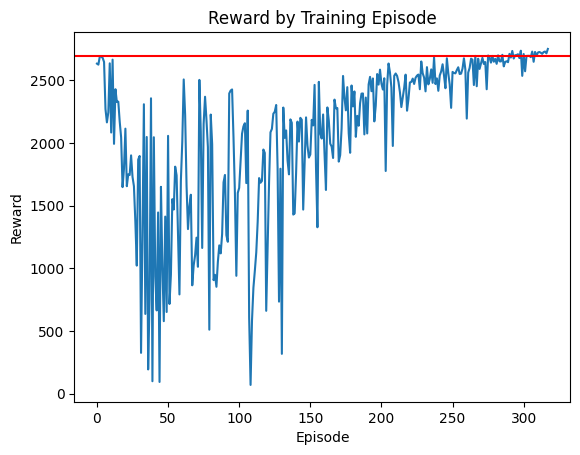

In [13]:
plt.title("Reward by Training Episode")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.plot(ending_ep_rewards)
plt.axhline(y=2700, color='r', linestyle='-')
plt.show()

In [14]:
test_stats = []
num_test_episodes = 15
print("========= Testing =========")

for episode in range(num_test_episodes):
    test_stats.append({
        "num_apples": [],
        "num_dirt": [],
        "pickers": [],
        "cleaners": [],
        "total_reward": 0,
    })

    states, info = env.reset()
    test_stats[-1]["num_apples"].append(info["apple"])
    test_stats[-1]["num_dirt"].append(info["dirt"])
    test_stats[-1]["pickers"].append(info["picker"])
    test_stats[-1]["cleaners"].append(info["cleaner"])

    #states = np.concatenate(list(states.values()), axis=0)
    state = states[agent_ids[0]]

    print(f"info: {info}")

    for step in tqdm(range(num_steps_per_epsiode)):
        actions_list = agentCoordinator.act(env)[0]
        actions = {agent_id: actions_list[i] for i, agent_id in enumerate(agent_ids)}
        next_states, reward, dones, _, info = env.step(actions)
        test_stats[-1]["num_apples"].append(info["apple"])
        test_stats[-1]["num_dirt"].append(info["dirt"])
        test_stats[-1]["pickers"].append(info["picker"])
        test_stats[-1]["cleaners"].append(info["cleaner"])
        #next_states = np.concatenate(list(next_states.values()), axis=0)
        next_state = next_states[agent_ids[0]]
        #reward_graph.append(reward)

        if episode > verbose_episode:
            print(f"========= Step {step} =========")
            print(f"info: {info}")

        state = next_state

        if dones["__all__"]:
            break 

    print(f"ending info: {info}")
    #print(f"reward graph: {reward_graph}")
    print(f"========= End of Test =========")

    test_reward = info["total_apple_consumed"]

    test_stats[-1]["total_reward"] = test_reward

    print(test_reward)

========= Testing =========
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 7171.93it/s]


ending info: {'total_apple_consumed': 2662.259289955739, 'step_apple_consumed': 2.969118294914356, 'apple': 55.42282414892893, 'dirt': 27.181945948582324, 'picker': 8, 'cleaner': 2}
========= End of Test =========
2662.259289955739
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 7266.14it/s]


ending info: {'total_apple_consumed': 2660.547765466774, 'step_apple_consumed': 3.776632938996816, 'apple': 55.6107893676634, 'dirt': 26.97434830561653, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2660.547765466774
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8460.60it/s]


ending info: {'total_apple_consumed': 2656.8487139767253, 'step_apple_consumed': 3.9438886440739838, 'apple': 57.94991409340396, 'dirt': 25.946655877454507, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2656.8487139767253
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8777.10it/s]


ending info: {'total_apple_consumed': 2658.41351828857, 'step_apple_consumed': 3.729615141753869, 'apple': 54.91837494744834, 'dirt': 27.39269841354069, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2658.41351828857
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8437.22it/s]


ending info: {'total_apple_consumed': 2661.7148932736227, 'step_apple_consumed': 3.854908749287221, 'apple': 56.72014736190911, 'dirt': 26.461754162210074, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2661.7148932736227
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8766.86it/s]


ending info: {'total_apple_consumed': 2658.4266129753223, 'step_apple_consumed': 3.8145435667899195, 'apple': 56.1263041225675, 'dirt': 26.817185309171627, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2658.4266129753223
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8646.50it/s]


ending info: {'total_apple_consumed': 2656.703174649699, 'step_apple_consumed': 0.369088803427431, 'apple': 57.74828767962264, 'dirt': 26.07430038830717, 'picker': 1, 'cleaner': 9}
========= End of Test =========
2656.703174649699
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8567.89it/s]


ending info: {'total_apple_consumed': 2661.02902893183, 'step_apple_consumed': 3.778427781156523, 'apple': 55.63260886228673, 'dirt': 27.014858047811245, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2661.02902893183
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 7410.65it/s]


ending info: {'total_apple_consumed': 2659.236902937179, 'step_apple_consumed': 0.7580122666875376, 'apple': 58.82878893174019, 'dirt': 25.573857061330976, 'picker': 2, 'cleaner': 8}
========= End of Test =========
2659.236902937179
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8507.27it/s]


ending info: {'total_apple_consumed': 2660.0493812731747, 'step_apple_consumed': 3.8688154010741442, 'apple': 56.887802982708415, 'dirt': 26.445157904120148, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2660.0493812731747
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8652.73it/s]


ending info: {'total_apple_consumed': 2659.897622855968, 'step_apple_consumed': 0.7393982688969016, 'apple': 57.46160991553958, 'dirt': 26.173274785389278, 'picker': 2, 'cleaner': 8}
========= End of Test =========
2659.897622855968
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8550.97it/s]


ending info: {'total_apple_consumed': 2660.4858838522855, 'step_apple_consumed': 2.220864944847675, 'apple': 56.02107241455695, 'dirt': 26.846634166440246, 'picker': 6, 'cleaner': 4}
========= End of Test =========
2660.4858838522855
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8682.58it/s]


ending info: {'total_apple_consumed': 2661.6868384362047, 'step_apple_consumed': 3.743680067984145, 'apple': 55.125751816020966, 'dirt': 27.26452002967837, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2661.6868384362047
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8637.76it/s]


ending info: {'total_apple_consumed': 2660.0088778588884, 'step_apple_consumed': 3.8497029815389125, 'apple': 56.63971035838801, 'dirt': 26.55523360606308, 'picker': 10, 'cleaner': 0}
========= End of Test =========
2660.0088778588884
info: {'total_apple_consumed': 0, 'step_apple_consumed': 0, 'apple': 0, 'dirt': 78, 'picker': 0, 'cleaner': 0}


100%|█████████▉| 999/1000 [00:00<00:00, 8779.35it/s]

ending info: {'total_apple_consumed': 2658.50188048062, 'step_apple_consumed': 2.225015227440186, 'apple': 56.12407418743277, 'dirt': 26.80463428204151, 'picker': 6, 'cleaner': 4}
========= End of Test =========
2658.50188048062


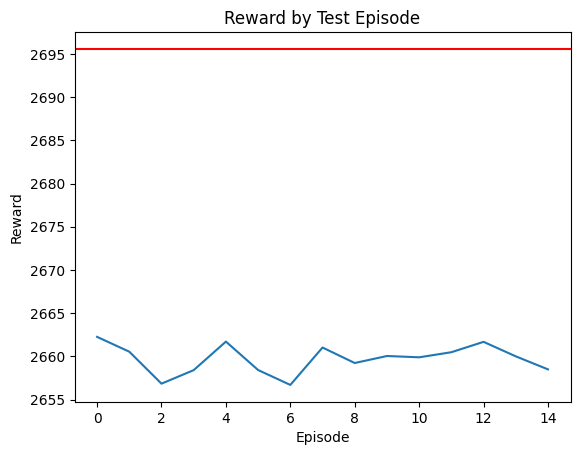

average reward 2659.720692347507


In [15]:
plt.figure()
plt.title("Reward by Test Episode")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.plot([stat['total_reward'] for stat in test_stats])
plt.axhline(y=2700, color='r', linestyle='-')
plt.show()
print('average reward', np.mean([stat['total_reward'] for stat in test_stats]))

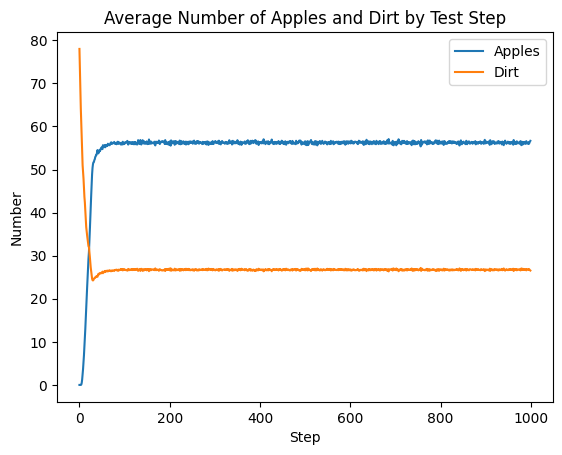

In [16]:
plt.figure()
plt.title("Average Number of Apples and Dirt by Test Step")
plt.xlabel("Step")
plt.ylabel("Number")
avg_num_apples = []
avg_num_dirt = []
for i in range(num_steps_per_epsiode):
    avg_num_apples.append(np.mean([stat['num_apples'][i] for stat in test_stats]))
    avg_num_dirt.append(np.mean([stat['num_dirt'][i] for stat in test_stats]))
plt.plot(avg_num_apples, label="Apples")
plt.plot(avg_num_dirt, label="Dirt")
plt.legend()
plt.show()

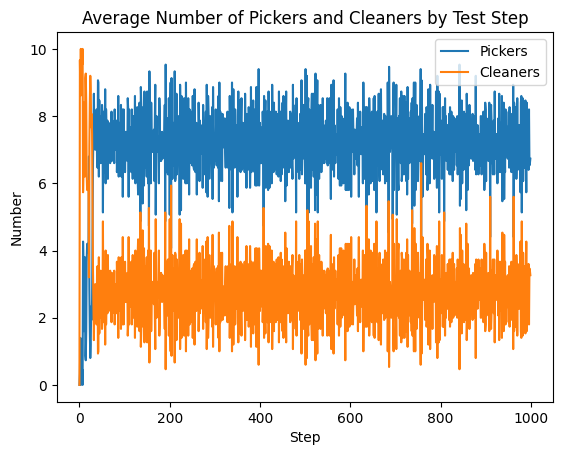

In [17]:
plt.figure()
plt.title("Average Number of Pickers and Cleaners by Test Step")
plt.xlabel("Step")
plt.ylabel("Number")
avg_num_pickers = []
avg_num_cleaners = []
for i in range(num_steps_per_epsiode):
    avg_num_pickers.append(np.mean([stat['pickers'][i] for stat in test_stats]))
    avg_num_cleaners.append(np.mean([stat['cleaners'][i] for stat in test_stats]))
plt.plot(avg_num_pickers, label="Pickers")
plt.plot(avg_num_cleaners, label="Cleaners")
plt.legend()
plt.show()

average number of pickers 7.0979020979020975
average number of cleaners 2.892107892107892


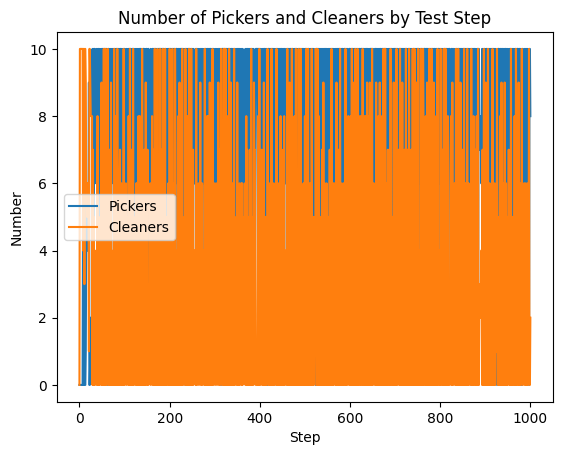

In [18]:
plt.figure()
plt.title("Number of Pickers and Cleaners by Test Step")
plt.xlabel("Step")
plt.ylabel("Number")
episode = test_stats[0]
plt.plot(episode['pickers'], label="Pickers")
plt.plot(episode['cleaners'], label="Cleaners")
print('average number of pickers', np.mean(episode['pickers']))
print('average number of cleaners', np.mean(episode['cleaners']))
plt.legend()
plt.show()

average picker cleaner ratio 1.7130486472591737
average apple dirt ratio 2.0623348905165404


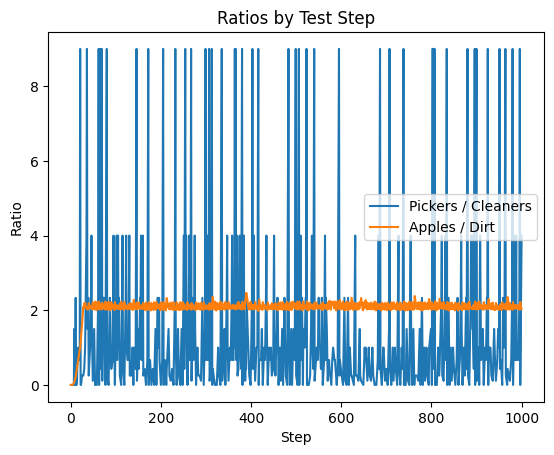

In [19]:
plt.figure()
plt.title("Ratios by Test Step")
plt.xlabel("Step")
plt.ylabel("Ratio")
episode = test_stats[0]
#plt.plot([episode['pickers'][i] / (episode['cleaners'][i] + 1e-1) for i in range(len(episode['pickers']))])

picker_cleaner_ratios = []
picker_cleaner_steps = []
for i, (num_pickers, num_cleaners) in enumerate(zip(episode['pickers'], episode['cleaners'])):
    if num_cleaners > 0:
        picker_cleaner_ratios.append(num_pickers / num_cleaners)
        picker_cleaner_steps.append(i)
print('average picker cleaner ratio', np.mean(picker_cleaner_ratios))
plt.plot(picker_cleaner_steps, picker_cleaner_ratios, label='Pickers / Cleaners')

apple_dirt_ratios = []
apple_dirt_steps = []
for i, (num_apples, num_dirt) in enumerate(zip(episode['num_apples'], episode['num_dirt'])):
    if num_dirt > 0:
        apple_dirt_ratios.append(num_apples / num_dirt)
        apple_dirt_steps.append(i)
plt.plot(apple_dirt_steps, apple_dirt_ratios, label='Apples / Dirt')
print('average apple dirt ratio', np.mean(apple_dirt_ratios))
plt.legend()
plt.show()

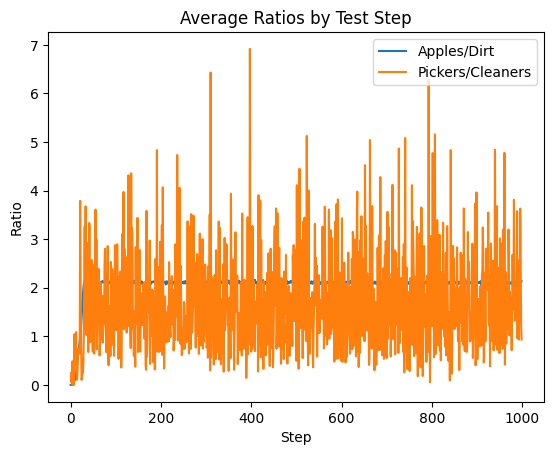

In [20]:
plt.figure()
plt.title("Average Ratios by Test Step")
plt.xlabel("Step")
plt.ylabel("Ratio")
avg_apple_dirt_ratios = []
apple_dirt_steps = []
avg_picker_cleaner_ratios = []
picker_cleaner_steps = []
for i in range(num_steps_per_epsiode):
    #avg_apple_dirt_ratios.append(np.mean([stat['num_apples'][i] / (stat['num_dirt'][i] + 1e-8) for stat in test_stats]))
    #avg_picker_cleaner_ratios.append(np.mean([stat['pickers'][i] / (stat['cleaners'][i]) for stat in test_stats if stat['cleaners'][i] > 0]))
    apple_dirt = []
    picker_cleaner = []
    for stat in test_stats:
        if stat['num_dirt'][i] > 0:
            apple_dirt.append(stat['num_apples'][i] / stat['num_dirt'][i])
        if stat['cleaners'][i] > 0:
            picker_cleaner.append(stat['pickers'][i] / stat['cleaners'][i])
    if len(apple_dirt) > 0:
        avg_apple_dirt_ratios.append(np.mean(apple_dirt))
        apple_dirt_steps.append(i)
    if len(picker_cleaner) > 0:
        avg_picker_cleaner_ratios.append(np.mean(picker_cleaner))
        picker_cleaner_steps.append(i)

plt.plot(apple_dirt_steps, avg_apple_dirt_ratios, label="Apples/Dirt")
plt.plot(picker_cleaner_steps, avg_picker_cleaner_ratios, label="Pickers/Cleaners")
plt.legend()
plt.show()